<a href="https://colab.research.google.com/github/AI4Finance-LLC/FinRL-Library/blob/master/FinRL_single_stock_trading.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Deep Reinforcement Learning for Stock Trading from Scratch: Single Stock Trading

Tutorials to use OpenAI DRL to trade single stock in one Jupyter Notebook | Presented at NeurIPS 2020: Deep RL Workshop

* This blog is based on our paper: FinRL: A Deep Reinforcement Learning Library for Automated Stock Trading in Quantitative Finance, presented at NeurIPS 2020: Deep RL Workshop.
* Check out medium blog for detailed explanations: https://towardsdatascience.com/finrl-for-quantitative-finance-tutorial-for-single-stock-trading-37d6d7c30aac
* Please report any issues to our Github: https://github.com/AI4Finance-LLC/FinRL-Library/issues
* **Pytorch Version** 




## Content

* [1. Problem Definition](#0)
* [2. Getting Started - Load Python packages](#1)
    * [2.1. Install Packages](#1.1)    
    * [2.2. Check Additional Packages](#1.2)
    * [2.3. Import Packages](#1.3)
    * [2.4. Create Folders](#1.4)
* [3. Download Data](#2)
* [4. Preprocess Data](#3)        
    * [4.1. Technical Indicators](#3.1)
    * [4.2. Perform Feature Engineering](#3.2)
* [5.Build Environment](#4)  
    * [5.1. Training & Trade Data Split](#4.1)
    * [5.2. User-defined Environment](#4.2)   
    * [5.3. Initialize Environment](#4.3)    
* [6.Implement DRL Algorithms](#5)  
* [7.Backtesting Performance](#6)  
    * [7.1. BackTestStats](#6.1)
    * [7.2. BackTestPlot](#6.2)   
    * [7.3. Baseline Stats](#6.3)   
    * [7.3. Compare to Stock Market Index](#6.4)             

<a id='0'></a>
# Part 1. Problem Definition

This problem is to design an automated trading solution for single stock trading. We model the stock trading process as a Markov Decision Process (MDP). We then formulate our trading goal as a maximization problem.

The components of the reinforcement learning environment are:


* Action: The action space describes the allowed actions that the agent interacts with the
environment. Normally, a ∈ A includes three actions: a ∈ {−1, 0, 1}, where −1, 0, 1 represent
selling, holding, and buying one stock. Also, an action can be carried upon multiple shares. We use
an action space {−k, ..., −1, 0, 1, ..., k}, where k denotes the number of shares. For example, "Buy
10 shares of AAPL" or "Sell 10 shares of AAPL" are 10 or −10, respectively

* Reward function: r(s, a, s′) is the incentive mechanism for an agent to learn a better action. The change of the portfolio value when action a is taken at state s and arriving at new state s',  i.e., r(s, a, s′) = v′ − v, where v′ and v represent the portfolio
values at state s′ and s, respectively

* State: The state space describes the observations that the agent receives from the environment. Just as a human trader needs to analyze various information before executing a trade, so
our trading agent observes many different features to better learn in an interactive environment.

* Environment: single stock trading for AAPL


The data of the single stock that we will be using for this case study is obtained from Yahoo Finance API. The data contains Open-High-Low-Close price and volume.

We use Apple Inc. stock: AAPL as an example throughout this article, because it is one of the most popular and profitable stocks.

<a id='1'></a>
# Part 2. Getting Started- Load Python Packages

<a id='1.1'></a>
## 2.1. Install all the packages through FinRL library


In [1]:
## install finrl library
!pip install git+https://github.com/AI4Finance-LLC/FinRL-Library.git

  Cloning https://github.com/AI4Finance-LLC/FinRL-Library.git to c:\users\lenovo\appdata\local\temp\pip-req-build-4tikx7ak
  Cloning https://github.com/quantopian/pyfolio.git to c:\users\lenovo\appdata\local\temp\pip-install-4x71q_w8\pyfolio_581fe186dd27498ba0af44f7e27176cd



<a id='1.2'></a>
## 2.2. Check if the additional packages needed are present, if not install them. 
* Yahoo Finance API
* pandas
* numpy
* matplotlib
* stockstats
* OpenAI gym
* stable-baselines
* tensorflow
* pyfolio

<a id='1.3'></a>
## 2.3. Import Packages

In [8]:
!pip3 install pandas

In [1]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
matplotlib.use('Agg')
import datetime

from finrl.config import config
from finrl.marketdata.yahoodownloader import YahooDownloader
from finrl.preprocessing.preprocessors import FeatureEngineer
from finrl.preprocessing.data import data_split
from finrl.env.env_stocktrading import StockTradingEnv
from finrl.model.models import DRLAgent
from finrl.trade.backtest import BackTestStats, BaselineStats, BackTestPlot

import sys
sys.path.append("../FinRL-Library")


C:\Users\Lenovo\Anaconda3\envs\finlr\lib\site-packages\pyfolio\pos.py:27: UserWarning: Module "zipline.assets" not found; multipliers will not be applied to position notionals.
  'Module "zipline.assets" not found; multipliers will not be applied'


In [2]:
#Diable the warnings
import warnings
warnings.filterwarnings('ignore')

<a id='1.4'></a>
## 2.4. Create Folders

In [3]:
import os
if not os.path.exists("./" + config.DATA_SAVE_DIR):
    os.makedirs("./" + config.DATA_SAVE_DIR)
if not os.path.exists("./" + config.TRAINED_MODEL_DIR):
    os.makedirs("./" + config.TRAINED_MODEL_DIR)
if not os.path.exists("./" + config.TENSORBOARD_LOG_DIR):
    os.makedirs("./" + config.TENSORBOARD_LOG_DIR)
if not os.path.exists("./" + config.RESULTS_DIR):
    os.makedirs("./" + config.RESULTS_DIR)

<a id='2'></a>
# Part 3. Download Data
Yahoo Finance is a website that provides stock data, financial news, financial reports, etc. All the data provided by Yahoo Finance is free.
* FinRL uses a class **YahooDownloader** to fetch data from Yahoo Finance API
* Call Limit: Using the Public API (without authentication), you are limited to 2,000 requests per hour per IP (or up to a total of 48,000 requests a day).




-----
class YahooDownloader:
    Provides methods for retrieving daily stock data from
    Yahoo Finance API

    Attributes
    ----------
        start_date : str
            start date of the data (modified from config.py)
        end_date : str
            end date of the data (modified from config.py)
        ticker_list : list
            a list of stock tickers (modified from config.py)

    Methods
    -------
    fetch_data()
        Fetches data from yahoo API


In [4]:
# from config.py start_date is a string
config.START_DATE

'2000-01-01'

In [5]:
# from config.py end_date is a string
config.END_DATE

'2021-01-01'

ticker_list is a list of stock tickers, in a single stock trading case, the list contains only 1 ticker

In [6]:
# Download and save the data in a pandas DataFrame:
data_df = YahooDownloader(start_date = '2009-01-01',
                          end_date = '2021-01-01',
                          ticker_list = ['AAPL']).fetch_data()

[*********************100%***********************]  1 of 1 completed
Shape of DataFrame:  (3022, 8)


In [7]:
data_df.shape

(3022, 8)

In [8]:
data_df.head()

,date,open,high,low,close,volume,tic,day
0,2008-12-31,3.070357,3.133571,3.047857,2.629544,607541200,AAPL,2
1,2009-01-02,3.067143,3.251429,3.041429,2.795913,746015200,AAPL,4
2,2009-01-05,3.327500,3.435000,3.311071,2.913912,1181608400,AAPL,0
3,2009-01-06,3.426786,3.470357,3.299643,2.865849,1289310400,AAPL,1
4,2009-01-07,3.278929,3.303571,3.223572,2.803923,753048800,AAPL,2


In [9]:
data_df=pd.read_csv(r'C:\Users\Lenovo\Desktop\QAM\data_ask_concat.csv')
data_df.rename(columns = {"time": "date"},  
          inplace = True) 
data_df.date = pd.to_datetime(data_df.date)
data_df['day'] = data_df['date'].dt.dayofweek
data_df['tic'] = 'A'
data_df.head()

,date,open,high,low,close,day,tic
0,2018-01-31 13:45:00+00:00,1.24666,1.24702,1.24632,1.24648,2,A
1,2018-01-31 14:00:00+00:00,1.24651,1.24661,1.24454,1.24478,2,A
2,2018-01-31 14:15:00+00:00,1.24478,1.24556,1.24462,1.24531,2,A
3,2018-01-31 14:30:00+00:00,1.24531,1.24555,1.24481,1.24522,2,A
4,2018-01-31 14:45:00+00:00,1.24522,1.24603,1.24516,1.24592,2,A


<a id='3'></a>
# Part 4. Preprocess Data
Data preprocessing is a crucial step for training a high quality machine learning model. We need to check for missing data and do feature engineering in order to convert the data into a model-ready state.
* FinRL uses a class **FeatureEngineer** to preprocess the data
* Add **technical indicators**. In practical trading, various information needs to be taken into account, for example the historical stock prices, current holding shares, technical indicators, etc.


class FeatureEngineer:
Provides methods for preprocessing the stock price data

    Attributes
    ----------
        df: DataFrame
            data downloaded from Yahoo API
        feature_number : int
            number of features we used
        use_technical_indicator : boolean
            we technical indicator or not
        use_turbulence : boolean
            use turbulence index or not

    Methods
    -------
    preprocess_data()
        main method to do the feature engineering

<a id='3.1'></a>

## 4.1 Technical Indicators
* FinRL uses stockstats to calcualte technical indicators such as **Moving Average Convergence Divergence (MACD)**, **Relative Strength Index (RSI)**, **Average Directional Index (ADX)**, **Commodity Channel Index (CCI)** and other various indicators and stats.
* **stockstats**: supplies a wrapper StockDataFrame based on the **pandas.DataFrame** with inline stock statistics/indicators support.



In [10]:
## we store the stockstats technical indicator column names in config.py
tech_indicator_list=config.TECHNICAL_INDICATORS_LIST
print(tech_indicator_list)

['macd', 'boll_ub', 'boll_lb', 'rsi_30', 'cci_30', 'dx_30', 'close_30_sma', 'close_60_sma']


In [11]:
## user can add more technical indicators
## check https://github.com/jealous/stockstats for different names
tech_indicator_list=tech_indicator_list+['kdjk','open_2_sma','boll','close_10.0_le_5_c','wr_10','dma','trix']
print(tech_indicator_list)

['macd', 'boll_ub', 'boll_lb', 'rsi_30', 'cci_30', 'dx_30', 'close_30_sma', 'close_60_sma', 'kdjk', 'open_2_sma', 'boll', 'close_10.0_le_5_c', 'wr_10', 'dma', 'trix']


<a id='3.2'></a>
## 4.2 Perform Feature Engineering

In [12]:
fe = FeatureEngineer(
                    use_technical_indicator=True,
                    tech_indicator_list = tech_indicator_list,
                    use_turbulence=False,
                    user_defined_feature = False)

data_df = fe.preprocess_data(data_df)

Successfully added technical indicators


In [13]:
data_df.head()

,date,open,high,low,close,day,tic,macd,boll_ub,boll_lb,...,dx_30,close_30_sma,close_60_sma,kdjk,open_2_sma,boll,close_10.0_le_5_c,wr_10,dma,trix
0,2018-01-31 13:45:00+00:00,1.24666,1.24702,1.24632,1.24648,2,A,0.000000,1.248034,1.243226,...,100.000000,1.246480,1.246480,40.952381,1.246660,1.246480,1.0,77.142857,0.0,-0.021675
1,2018-01-31 14:00:00+00:00,1.24651,1.24661,1.24454,1.24478,2,A,-0.000038,1.248034,1.243226,...,100.000000,1.245630,1.245630,30.527394,1.246585,1.245630,2.0,90.322581,0.0,-0.021675
2,2018-01-31 14:15:00+00:00,1.24478,1.24556,1.24462,1.24531,2,A,-0.000032,1.247263,1.243784,...,100.000000,1.245523,1.245523,30.701058,1.245645,1.245523,3.0,68.951613,0.0,-0.013508
3,2018-01-31 14:30:00+00:00,1.24531,1.24555,1.24481,1.24522,2,A,-0.000032,1.246900,1.243995,...,100.000000,1.245448,1.245448,29.607157,1.245045,1.245448,4.0,72.580645,0.0,-0.009804
4,2018-01-31 14:45:00+00:00,1.24522,1.24603,1.24516,1.24592,2,A,-0.000003,1.246869,1.244215,...,50.444777,1.245542,1.245542,38.286492,1.245265,1.245542,5.0,44.354839,0.0,-0.006508


<a id='4'></a>
# Part 5. Build Environment
Considering the stochastic and interactive nature of the automated stock trading tasks, a financial task is modeled as a **Markov Decision Process (MDP)** problem. The training process involves observing stock price change, taking an action and reward's calculation to have the agent adjusting its strategy accordingly. By interacting with the environment, the trading agent will derive a trading strategy with the maximized rewards as time proceeds.

Our trading environments, based on OpenAI Gym framework, simulate live stock markets with real market data according to the principle of time-driven simulation.

The action space describes the allowed actions that the agent interacts with the environment. Normally, action a includes three actions: {-1, 0, 1}, where -1, 0, 1 represent selling, holding, and buying one share. Also, an action can be carried upon multiple shares. We use an action space {-k,…,-1, 0, 1, …, k}, where k denotes the number of shares to buy and -k denotes the number of shares to sell. For example, "Buy 10 shares of AAPL" or "Sell 10 shares of AAPL" are 10 or -10, respectively. The continuous action space needs to be normalized to [-1, 1], since the policy is defined on a Gaussian distribution, which needs to be normalized and symmetric.

<a id='4.1'></a>
## 5.1 Training & Trade data split
* Training: 2009-01-01 to 2018-12-31
* Trade: 2019-01-01 to 2020-09-30

In [14]:
#train = data_split(data_df, start = config.START_DATE, end = config.START_TRADE_DATE)
#trade = data_split(data_df, start = config.START_TRADE_DATE, end = config.END_DATE)
train = data_split(data_df, start = '2009-01-01', end = '2019-01-01')
trade = data_split(data_df, start = '2019-01-01', end = '2021-01-01')


In [15]:
## data normalization, this part is optional, have little impact
#feaures_list = list(train.columns)
#feaures_list.remove('date')
#feaures_list.remove('tic')
#feaures_list.remove('close')
#print(feaures_list)
#from sklearn import preprocessing
#data_normaliser = preprocessing.StandardScaler()
#train[feaures_list] = data_normaliser.fit_transform(train[feaures_list])
#trade[feaures_list] = data_normaliser.transform(trade[feaures_list])

<a id='4.2'></a>
## 5.2 User-defined Environment: a simulation environment class 

<a id='4.3'></a>
## 5.3 Initialize Environment
* **stock dimension**: the number of unique stock tickers we use
* **hmax**: the maximum amount of shares to buy or sell
* **initial amount**: the amount of money we use to trade in the begining
* **transaction cost percentage**: a per share rate for every share trade
* **tech_indicator_list**: a list of technical indicator names (modified from config.py)

In [16]:
## we store the stockstats technical indicator column names in config.py
## check https://github.com/jealous/stockstats for different names
tech_indicator_list

['macd',
 'boll_ub',
 'boll_lb',
 'rsi_30',
 'cci_30',
 'dx_30',
 'close_30_sma',
 'close_60_sma',
 'kdjk',
 'open_2_sma',
 'boll',
 'close_10.0_le_5_c',
 'wr_10',
 'dma',
 'trix']

In [17]:
# the stock dimension is 1, because we only use the price data of AAPL.
len(train.tic.unique())

1

In [18]:
stock_dimension = len(train.tic.unique())
state_space = 1 + 2*stock_dimension + len(config.TECHNICAL_INDICATORS_LIST)*stock_dimension
print(f"Stock Dimension: {stock_dimension}, State Space: {state_space}")


Stock Dimension: 1, State Space: 11


In [19]:
env_kwargs = {
    "hmax": 100, 
    "initial_amount": 100000, 
    "buy_cost_pct": 0.001, 
    "sell_cost_pct": 0.001, 
    "state_space": state_space, 
    "stock_dim": stock_dimension, 
    "tech_indicator_list": config.TECHNICAL_INDICATORS_LIST, 
    "action_space": stock_dimension, 
    "reward_scaling": 1e-4
    
}

e_train_gym = StockTradingEnv(df = train, **env_kwargs)


In [20]:
env_train, _ = e_train_gym.get_sb_env()
print(type(env_train))

<class 'stable_baselines3.common.vec_env.dummy_vec_env.DummyVecEnv'>


<a id='5'></a>
# Part 6: Implement DRL Algorithms
* The implementation of the DRL algorithms are based on **OpenAI Baselines** and **Stable Baselines**. Stable Baselines is a fork of OpenAI Baselines, with a major structural refactoring, and code cleanups.
* FinRL library includes fine-tuned standard DRL algorithms, such as DQN, DDPG,
Multi-Agent DDPG, PPO, SAC, A2C and TD3. We also allow users to
design their own DRL algorithms by adapting these DRL algorithms.

In [21]:
agent = DRLAgent(env = env_train)

### Model Training: 5 models, A2C DDPG, PPO, TD3, SAC



### Model 1: A2C

In [22]:
agent = DRLAgent(env = env_train)

A2C_PARAMS = {"n_steps": 5, "ent_coef": 0.005, "learning_rate": 0.0002}
model_a2c = agent.get_model(model_name="a2c",model_kwargs = A2C_PARAMS)

{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.0002}
Using cpu device


In [23]:
trained_a2c = agent.train_model(model=model_a2c, 
                                tb_log_name='a2c',
                                total_timesteps=50000)

Logging to tensorboard_log/a2c\a2c_1
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.79      |
|    total_reward       | -16.3     |
|    total_reward_pct   | -0.0163   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 511       |
|    iterations         | 100       |
|    time_elapsed       | 0         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 99        |
|    policy_loss        | -1.66e-05 |
|    std                | 1.04      |
|    value_loss         | 7.83e-11  |
-------------------------------------
day: 95, episode: 10
begin_total_asset: 100000.00
end_total_asset: 99974.23
total_reward: -25.77
total_cost: 6.41
total_trades: 88
Sharpe: -2.128
-------------------

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.83     |
|    total_reward       | 3.05     |
|    total_reward_pct   | 0.00305  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 560      |
|    iterations         | 1100     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1099     |
|    policy_loss        | 0.000144 |
|    std                | 1.27     |
|    value_loss         | 1.12e-08 |
------------------------------------
day: 95, episode: 60
begin_total_asset: 100000.00
end_total_asset: 99988.11
total_reward: -11.89
total_cost: 5.28
total_trades: 71
Sharpe: -3.928
------------------------------------
| environment/          |          |
|  

day: 95, episode: 110
begin_total_asset: 100000.00
end_total_asset: 99993.34
total_reward: -6.66
total_cost: 6.64
total_trades: 80
Sharpe: -0.865
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.64     |
|    total_reward       | -6.66    |
|    total_reward_pct   | -0.00666 |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 572      |
|    iterations         | 2100     |
|    time_elapsed       | 18       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2099     |
|    policy_loss        | 0.000401 |
|    std                | 1.55     |
|    value_loss         | 3.53e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|  

day: 95, episode: 160
begin_total_asset: 100000.00
end_total_asset: 99974.35
total_reward: -25.65
total_cost: 6.79
total_trades: 78
Sharpe: -2.005
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.56     |
|    total_reward       | -9.37    |
|    total_reward_pct   | -0.00937 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 550      |
|    iterations         | 3100     |
|    time_elapsed       | 28       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3099     |
|    policy_loss        | 4.73e-05 |
|    std                | 1.89     |
|    value_loss         | 4.85e-10 |
------------------------------------
------------------------------------
| environment/          |          |
| 

day: 95, episode: 210
begin_total_asset: 100000.00
end_total_asset: 99994.99
total_reward: -5.01
total_cost: 5.23
total_trades: 66
Sharpe: -5.670
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.27     |
|    total_reward       | -38.6    |
|    total_reward_pct   | -0.0386  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 534      |
|    iterations         | 4100     |
|    time_elapsed       | 38       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4099     |
|    policy_loss        | 1.26e-05 |
|    std                | 2.3      |
|    value_loss         | 5.2e-11  |
------------------------------------
-------------------------------------
| environment/          |           |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.95      |
|    total_reward       | -16       |
|    total_reward_pct   | -0.016    |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 523       |
|    iterations         | 5100      |
|    time_elapsed       | 48        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5099      |
|    policy_loss        | -2.21e-05 |
|    std                | 2.81      |
|    value_loss         | 2.58e-10  |
-------------------------------------
day: 95, episode: 270
begin_total_asset: 100000.00
end_total_asset: 99977.50
total_reward: -22.50
total_cost: 7.51
total_trades: 78
Sharpe: -3.895
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.19     |
|    total_reward       | -2.75    |
|    total_reward_pct   | -0.00275 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 520      |
|    iterations         | 6100     |
|    time_elapsed       | 58       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6099     |
|    policy_loss        | 0.000311 |
|    std                | 3.41     |
|    value_loss         | 1.91e-08 |
------------------------------------
day: 95, episode: 320
begin_total_asset: 100000.00
end_total_asset: 99983.86
total_reward: -16.14
total_cost: 7.95
total_trades: 82
Sharpe: -4.082
------------------------------------
| environment/          |          |
| 

day: 95, episode: 370
begin_total_asset: 100000.00
end_total_asset: 99983.48
total_reward: -16.52
total_cost: 7.21
total_trades: 74
Sharpe: -2.837
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.21     |
|    total_reward       | -16.5    |
|    total_reward_pct   | -0.0165  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 519      |
|    iterations         | 7100     |
|    time_elapsed       | 68       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7099     |
|    policy_loss        | 0.000162 |
|    std                | 4.16     |
|    value_loss         | 4.27e-09 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 420
begin_total_asset: 100000.00
end_total_asset: 99990.53
total_reward: -9.47
total_cost: 7.49
total_trades: 73
Sharpe: -2.642
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.44     |
|    total_reward       | 0.717    |
|    total_reward_pct   | 0.000717 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 515      |
|    iterations         | 8100     |
|    time_elapsed       | 78       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8099     |
|    policy_loss        | 2.84e-05 |
|    std                | 5.07     |
|    value_loss         | 2.03e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|  

day: 95, episode: 470
begin_total_asset: 100000.00
end_total_asset: 99978.93
total_reward: -21.07
total_cost: 7.82
total_trades: 72
Sharpe: -3.478
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.87     |
|    total_reward       | 1.71     |
|    total_reward_pct   | 0.00171  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 511      |
|    iterations         | 9100     |
|    time_elapsed       | 89       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9099     |
|    policy_loss        | 0.000374 |
|    std                | 6.18     |
|    value_loss         | 1.43e-08 |
------------------------------------
day: 95, episode: 480
begin_total_asset: 100000.00
end_total_asset: 99950.60

In [33]:
agent = DRLAgent(env = env_train)

A2C_PARAMS = {"n_steps": 5, "ent_coef": 0.005, "learning_rate": 0.0002}
model_a2c = agent.get_model(model_name="a2c",model_kwargs = A2C_PARAMS)

for i in range(20):
    for j in range(20):
        agent = DRLAgent(env = env_train)
        A2C_PARAMS = {"n_steps": 5, "ent_coef": 0.005+(i-10)/1000, "learning_rate": 0.0002+(j-10)/200000}
        model_a2c = agent.get_model(model_name="a2c",model_kwargs = A2C_PARAMS)
        trained_a2c = agent.train_model(model=model_a2c, 
                                tb_log_name='a2c',
                                total_timesteps=50000)
        print(i,j)

{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.0002}
Using cpu device
{'n_steps': 5, 'ent_coef': -0.005, 'learning_rate': 0.00015000000000000001}
Using cpu device
Logging to tensorboard_log/a2c\a2c_2
day: 95, episode: 2320
begin_total_asset: 100000.00
end_total_asset: 99991.85
total_reward: -8.15
total_cost: 6.43
total_trades: 88
Sharpe: -1.099
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.7      |
|    total_reward       | -49.3    |
|    total_reward_pct   | -0.0493  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 533      |
|    iterations         | 100      |
|    time_elapsed       | 0        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 99       |
|    policy_loss  

day: 95, episode: 2370
begin_total_asset: 100000.00
end_total_asset: 99968.34
total_reward: -31.66
total_cost: 5.72
total_trades: 86
Sharpe: -2.797
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.74      |
|    total_reward       | -15.8     |
|    total_reward_pct   | -0.0158   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 553       |
|    iterations         | 1100      |
|    time_elapsed       | 9         |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1099      |
|    policy_loss        | -4.12e-05 |
|    std                | 0.846     |
|    value_loss         | 1.5e-09   |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.4       |
|    total_reward       | 4.39      |
|    total_reward_pct   | 0.00439   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 567       |
|    iterations         | 2100      |
|    time_elapsed       | 18        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2099      |
|    policy_loss        | -5.14e-05 |
|    std                | 0.729     |
|    value_loss         | 1.03e-09  |
-------------------------------------
day: 95, episode: 2430
begin_total_asset: 100000.00
end_total_asset: 99992.90
total_reward: -7.10
total_cost: 2.71
total_trades: 46
Sharpe: -2.982
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.27     |
|    total_reward       | 3.44     |
|    total_reward_pct   | 0.00344  |
|    total_trades       | 32       |
| time/                 |          |
|    fps                | 555      |
|    iterations         | 3100     |
|    time_elapsed       | 27       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -0.956   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3099     |
|    policy_loss        | 1.63e-06 |
|    std                | 0.629    |
|    value_loss         | 7.11e-12 |
------------------------------------
day: 95, episode: 2480
begin_total_asset: 100000.00
end_total_asset: 99999.30
total_reward: -0.70
total_cost: 0.70
total_trades: 18
Sharpe: -4.886
-------------------------------------
| environment/          |           |


day: 95, episode: 2530
begin_total_asset: 100000.00
end_total_asset: 99999.45
total_reward: -0.55
total_cost: 0.53
total_trades: 22
Sharpe: -4.411
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.526     |
|    total_reward       | -0.547    |
|    total_reward_pct   | -0.000547 |
|    total_trades       | 22        |
| time/                 |           |
|    fps                | 545       |
|    iterations         | 4100      |
|    time_elapsed       | 37        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -0.807    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 4099      |
|    policy_loss        | -1.01e-05 |
|    std                | 0.542     |
|    value_loss         | 9.52e-11  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 2580
begin_total_asset: 100000.00
end_total_asset: 99999.75
total_reward: -0.25
total_cost: 0.26
total_trades: 11
Sharpe: -3.662
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.572     |
|    total_reward       | -0.921    |
|    total_reward_pct   | -0.000921 |
|    total_trades       | 16        |
| time/                 |           |
|    fps                | 536       |
|    iterations         | 5100      |
|    time_elapsed       | 47        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -0.657    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5099      |
|    policy_loss        | -5.08e-05 |
|    std                | 0.467     |
|    value_loss         | 2.21e-08  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 2630
begin_total_asset: 100000.00
end_total_asset: 99999.80
total_reward: -0.20
total_cost: 0.21
total_trades: 9
Sharpe: -3.624
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.201    |
|    total_reward       | -0.21    |
|    total_reward_pct   | -0.00021 |
|    total_trades       | 8        |
| time/                 |          |
|    fps                | 526      |
|    iterations         | 6100     |
|    time_elapsed       | 57       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -0.509   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6099     |
|    policy_loss        | 3.96e-08 |
|    std                | 0.402    |
|    value_loss         | 1.81e-14 |
------------------------------------
-------------------------------------
| environment/          |           |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 525       |
|    iterations         | 7100      |
|    time_elapsed       | 67        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -0.359    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7099      |
|    policy_loss        | -7.16e-09 |
|    std                | 0.347     |
|    value_loss         | 6.02e-16  |
-------------------------------------
day: 95, episode: 2690
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 522      |
|    iterations         | 8100     |
|    time_elapsed       | 77       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -0.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8099     |
|    policy_loss        | 1.78e-08 |
|    std                | 0.299    |
|    value_loss         | 4.78e-15 |
------------------------------------
day: 95, episode: 2740
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_val

day: 95, episode: 2790
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 523       |
|    iterations         | 9100      |
|    time_elapsed       | 86        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -0.0623   |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9099      |
|    policy_loss        | -1.52e-09 |
|    std                | 0.257     |
|    value_loss         | 2.64e-15  |
-------------------------------------
------------------------------------
| environment/          |         

{'n_steps': 5, 'ent_coef': -0.005, 'learning_rate': 0.000155}
Using cpu device
Logging to tensorboard_log/a2c\a2c_3
day: 95, episode: 2840
begin_total_asset: 100000.00
end_total_asset: 99994.81
total_reward: -5.19
total_cost: 5.03
total_trades: 79
Sharpe: -0.909
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.39     |
|    total_reward       | -30.3    |
|    total_reward_pct   | -0.0303  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 379      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 99       |
|    policy_loss        | 0.000218 |
|    std                | 0.97     |
|    value_loss         | 1.9e-08 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3         |
|    total_reward       | -13.4     |
|    total_reward_pct   | -0.0134   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 471       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1099      |
|    policy_loss        | -2.06e-05 |
|    std                | 0.829     |
|    value_loss         | 3.43e-10  |
-------------------------------------
day: 95, episode: 2900
begin_total_asset: 100000.00
end_total_asset: 99990.28
total_reward: -9.72
total_cost: 3.06
total_trades: 60
Sharpe: -2.070
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.571     |
|    total_reward       | 0.0307    |
|    total_reward_pct   | 3.07e-05  |
|    total_trades       | 23        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 2100      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | -3.42e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 2099      |
|    policy_loss        | 7.19e-05  |
|    std                | 0.711     |
|    value_loss         | 1.06e-08  |
-------------------------------------
day: 95, episode: 2950
begin_total_asset: 100000.00
end_total_asset: 99999.87
total_reward: -0.13
total_cost: 1.30
total_trades: 32
Sharpe: -0.143
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.557     |
|    total_reward       | -2.06     |
|    total_reward_pct   | -0.00206  |
|    total_trades       | 18        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 3100      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.924    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 3099      |
|    policy_loss        | -2.19e-05 |
|    std                | 0.609     |
|    value_loss         | 6.25e-10  |
-------------------------------------
day: 95, episode: 3000
begin_total_asset: 100000.00
end_total_asset: 99998.66
total_reward: -1.34
total_cost: 0.67
total_trades: 23
Sharpe: -3.096
-------------------------------------
| environment/   

day: 95, episode: 3050
begin_total_asset: 100000.00
end_total_asset: 100005.81
total_reward: 5.81
total_cost: 1.71
total_trades: 46
Sharpe: 1.179
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.746    |
|    total_reward       | -1.62    |
|    total_reward_pct   | -0.00162 |
|    total_trades       | 29       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -0.769   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4099     |
|    policy_loss        | 6.57e-05 |
|    std                | 0.522    |
|    value_loss         | 1.4e-08  |
------------------------------------
-------------------------------------
| environment/          |           |
|

day: 95, episode: 3100
begin_total_asset: 100000.00
end_total_asset: 99991.25
total_reward: -8.75
total_cost: 3.12
total_trades: 82
Sharpe: -3.280
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.29      |
|    total_reward       | -0.566    |
|    total_reward_pct   | -0.000566 |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 5100      |
|    time_elapsed       | 52        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -0.615    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5099      |
|    policy_loss        | -1.09e-05 |
|    std                | 0.448     |
|    value_loss         | 1.25e-09  |
-------------------------------------
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.33     |
|    total_reward       | -3.39    |
|    total_reward_pct   | -0.00339 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -0.461   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6099     |
|    policy_loss        | 2.68e-05 |
|    std                | 0.384    |
|    value_loss         | 1.49e-09 |
------------------------------------
day: 95, episode: 3160
begin_total_asset: 100000.00
end_total_asset: 99998.58
total_reward: -1.42
total_cost: 1.63
total_trades: 49
Sharpe: -0.961
------------------------------------
| environment/          |          |
| 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.76      |
|    total_reward       | -3        |
|    total_reward_pct   | -0.003    |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 7100      |
|    time_elapsed       | 71        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -0.307    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7099      |
|    policy_loss        | -7.49e-07 |
|    std                | 0.329     |
|    value_loss         | 3.11e-11  |
-------------------------------------
day: 95, episode: 3210
begin_total_asset: 100000.00
end_total_asset: 99994.56
total_reward: -5.44
total_cost: 2.27
total_trades: 80
Sharpe: -2.298
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.867     |
|    total_reward       | -2.26     |
|    total_reward_pct   | -0.00226  |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 8100      |
|    time_elapsed       | 81        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -0.152    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8099      |
|    policy_loss        | -4.49e-06 |
|    std                | 0.282     |
|    value_loss         | 1.04e-09  |
-------------------------------------
day: 95, episode: 3260
begin_total_asset: 100000.00
end_total_asset: 99998.37
total_reward: -1.63
total_cost: 0.62
total_trades: 33
Sharpe: -4.586
-------------------------------------
| environment/   

day: 95, episode: 3310
begin_total_asset: 100000.00
end_total_asset: 99998.95
total_reward: -1.05
total_cost: 0.69
total_trades: 48
Sharpe: -6.762
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.352     |
|    total_reward       | -0.229    |
|    total_reward_pct   | -0.000229 |
|    total_trades       | 36        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 9100      |
|    time_elapsed       | 91        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | 0.00199   |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9099      |
|    policy_loss        | 2.33e-05  |
|    std                | 0.241     |
|    value_loss         | 4.92e-09  |
-------------------------------------
-------------------------------------
| environment/   

{'n_steps': 5, 'ent_coef': -0.005, 'learning_rate': 0.00016}
Using cpu device
Logging to tensorboard_log/a2c\a2c_4
day: 95, episode: 3360
begin_total_asset: 100000.00
end_total_asset: 99991.90
total_reward: -8.10
total_cost: 6.88
total_trades: 89
Sharpe: -0.848
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.92     |
|    total_reward       | -29.8    |
|    total_reward_pct   | -0.0298  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 453      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | -3.6e+10 |
|    learning_rate      | 0.00016  |
|    n_updates          | 99       |
|    policy_loss        | 0.000477 |
|    std                | 0.978    |
|    value_loss         | 1.89e-07 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.2      |
|    total_reward       | -9.19    |
|    total_reward_pct   | -0.00919 |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 1100     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000109 |
|    std                | 0.834    |
|    value_loss         | 1.65e-08 |
------------------------------------
day: 95, episode: 3420
begin_total_asset: 100000.00
end_total_asset: 99990.82
total_reward: -9.18
total_cost: 4.99
total_trades: 78
Sharpe: -2.963
------------------------------------
| environment/          |          |
| 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.8       |
|    total_reward       | 4.24      |
|    total_reward_pct   | 0.00424   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 2100      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2099      |
|    policy_loss        | -5.23e-05 |
|    std                | 0.711     |
|    value_loss         | 2.56e-09  |
-------------------------------------
day: 95, episode: 3470
begin_total_asset: 100000.00
end_total_asset: 99990.09
total_reward: -9.91
total_cost: 3.22
total_trades: 65
Sharpe: -2.289
-------------------------------------
| environment/   

day: 95, episode: 3520
begin_total_asset: 100000.00
end_total_asset: 99997.78
total_reward: -2.22
total_cost: 0.99
total_trades: 29
Sharpe: -1.848
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.988     |
|    total_reward       | -2.22     |
|    total_reward_pct   | -0.00222  |
|    total_trades       | 29        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 3100      |
|    time_elapsed       | 31        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.919    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3099      |
|    policy_loss        | -5.95e-05 |
|    std                | 0.607     |
|    value_loss         | 1.18e-08  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 3570
begin_total_asset: 100000.00
end_total_asset: 99999.84
total_reward: -0.16
total_cost: 0.11
total_trades: 2
Sharpe: -2.208
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0679    |
|    total_reward       | -0.0714   |
|    total_reward_pct   | -7.14e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 4100      |
|    time_elapsed       | 41        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -0.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4099      |
|    policy_loss        | -1.81e-05 |
|    std                | 0.517     |
|    value_loss         | 2.18e-10  |
-------------------------------------
------------------------------------
| environment/     

day: 95, episode: 3620
begin_total_asset: 100000.00
end_total_asset: 100000.02
total_reward: 0.02
total_cost: 0.00
total_trades: 2
Sharpe: 1.465
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0446    |
|    total_reward       | -0.0432   |
|    total_reward_pct   | -4.32e-05 |
|    total_trades       | 5         |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 5100      |
|    time_elapsed       | 50        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -0.601    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5099      |
|    policy_loss        | 4.77e-08  |
|    std                | 0.441     |
|    value_loss         | 1.45e-14  |
-------------------------------------
-------------------------------------
| environment/     

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.056     |
|    total_reward       | -0.0688   |
|    total_reward_pct   | -6.88e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 6000      |
|    time_elapsed       | 60        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -0.458    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5999      |
|    policy_loss        | 1.96e-07  |
|    std                | 0.383     |
|    value_loss         | 1.48e-13  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward

day: 95, episode: 3720
begin_total_asset: 100000.00
end_total_asset: 99999.89
total_reward: -0.11
total_cost: 0.14
total_trades: 5
Sharpe: -2.485
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0353    |
|    total_reward       | -0.0105   |
|    total_reward_pct   | -1.05e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 7000      |
|    time_elapsed       | 69        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -0.299    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 6999      |
|    policy_loss        | -1.87e-05 |
|    std                | 0.326     |
|    value_loss         | 2.84e-10  |
-------------------------------------
-------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 8000      |
|    time_elapsed       | 79        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -0.139    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7999      |
|    policy_loss        | -1.55e-05 |
|    std                | 0.278     |
|    value_loss         | 6.64e-09  |
-------------------------------------
day: 95, episode: 3780
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |         

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0147    |
|    total_reward       | -0.0178   |
|    total_reward_pct   | -1.78e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9000      |
|    time_elapsed       | 89        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | 0.02      |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 8999      |
|    policy_loss        | -3.19e-07 |
|    std                | 0.237     |
|    value_loss         | 1.47e-12  |
-------------------------------------
day: 95, episode: 3830
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 471       |
|    iterations         | 10000     |
|    time_elapsed       | 106       |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | 0.179     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9999      |
|    policy_loss        | -4.23e-08 |
|    std                | 0.202     |
|    value_loss         | 1.91e-14  |
-------------------------------------
{'n_steps': 5, 'ent_coef': -0.005, 'learning_rate': 0.000165}
Using cpu device
Logging to tensorboard_log/a2c\a2c_5
-------------------------------------
| environment/          |           |
|    portf

day: 95, episode: 3930
begin_total_asset: 100000.00
end_total_asset: 99988.59
total_reward: -11.41
total_cost: 3.12
total_trades: 56
Sharpe: -3.431
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.28     |
|    total_reward       | -6.65    |
|    total_reward_pct   | -0.00665 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 306      |
|    iterations         | 1000     |
|    time_elapsed       | 16       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 999      |
|    policy_loss        | 2.4e-05  |
|    std                | 0.857    |
|    value_loss         | 1.35e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 3980
begin_total_asset: 100000.00
end_total_asset: 99995.25
total_reward: -4.75
total_cost: 1.65
total_trades: 43
Sharpe: -3.172
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.81     |
|    total_reward       | 1.8      |
|    total_reward_pct   | 0.0018   |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 329      |
|    iterations         | 2000     |
|    time_elapsed       | 30       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1999     |
|    policy_loss        | 1.15e-05 |
|    std                | 0.727    |
|    value_loss         | 4.95e-11 |
------------------------------------
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.72      |
|    total_reward       | -1.54     |
|    total_reward_pct   | -0.00154  |
|    total_trades       | 38        |
| time/                 |           |
|    fps                | 334       |
|    iterations         | 3000      |
|    time_elapsed       | 44        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.936    |
|    explained_variance | -5.1e+10  |
|    learning_rate      | 0.000165  |
|    n_updates          | 2999      |
|    policy_loss        | -0.000671 |
|    std                | 0.617     |
|    value_loss         | 9.91e-07  |
-------------------------------------
day: 95, episode: 4040
begin_total_asset: 100000.00
end_total_asset: 99994.73
total_reward: -5.27
total_cost: 2.85
total_trades: 57
Sharpe: -3.611
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.23      |
|    total_reward       | -5.54     |
|    total_reward_pct   | -0.00554  |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 341       |
|    iterations         | 4000      |
|    time_elapsed       | 58        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.772    |
|    explained_variance | -3.78e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 3999      |
|    policy_loss        | -8.78e-05 |
|    std                | 0.524     |
|    value_loss         | 4.69e-08  |
-------------------------------------
day: 95, episode: 4090
begin_total_asset: 100000.00
end_total_asset: 99996.36
total_reward: -3.64
total_cost: 1.32
total_trades: 31
Sharpe: -2.468
-------------------------------------
| environment/   

day: 95, episode: 4140
begin_total_asset: 100000.00
end_total_asset: 99997.52
total_reward: -2.48
total_cost: 0.90
total_trades: 31
Sharpe: -2.502
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.896     |
|    total_reward       | -2.48     |
|    total_reward_pct   | -0.00248  |
|    total_trades       | 31        |
| time/                 |           |
|    fps                | 343       |
|    iterations         | 5000      |
|    time_elapsed       | 72        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.609    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4999      |
|    policy_loss        | -9.39e-05 |
|    std                | 0.445     |
|    value_loss         | 4.07e-08  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 4190
begin_total_asset: 100000.00
end_total_asset: 99999.33
total_reward: -0.67
total_cost: 0.19
total_trades: 8
Sharpe: -2.070
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.356    |
|    total_reward       | -1.77    |
|    total_reward_pct   | -0.00177 |
|    total_trades       | 14       |
| time/                 |          |
|    fps                | 353      |
|    iterations         | 6000     |
|    time_elapsed       | 84       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -0.445   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5999     |
|    policy_loss        | 2.42e-05 |
|    std                | 0.377    |
|    value_loss         | 7.65e-10 |
------------------------------------
-------------------------------------
| environment/          |           |
|

day: 95, episode: 4240
begin_total_asset: 100000.00
end_total_asset: 99999.21
total_reward: -0.79
total_cost: 0.27
total_trades: 17
Sharpe: -3.191
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.153     |
|    total_reward       | -0.156    |
|    total_reward_pct   | -0.000156 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 363       |
|    iterations         | 7000      |
|    time_elapsed       | 96        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -0.282    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6999      |
|    policy_loss        | -6.28e-07 |
|    std                | 0.321     |
|    value_loss         | 1.09e-11  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.154     |
|    total_reward       | -0.195    |
|    total_reward_pct   | -0.000195 |
|    total_trades       | 7         |
| time/                 |           |
|    fps                | 366       |
|    iterations         | 7900      |
|    time_elapsed       | 107       |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.134    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 7899      |
|    policy_loss        | -8.53e-07 |
|    std                | 0.277     |
|    value_loss         | 5.91e-09  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.137    |
|    total_reward       | 0.747    |
|    total_reward

day: 95, episode: 4340
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 371      |
|    iterations         | 8900     |
|    time_elapsed       | 119      |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | 0.0301   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8899     |
|    policy_loss        | 2.4e-08  |
|    std                | 0.235    |
|    value_loss         | 9.53e-14 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_val

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 379      |
|    iterations         | 9900     |
|    time_elapsed       | 130      |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | 0.194    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9899     |
|    policy_loss        | 4.74e-08 |
|    std                | 0.199    |
|    value_loss         | 1.5e-14  |
------------------------------------
day: 95, episode: 4400
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_val

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.43     |
|    total_reward       | -14.4    |
|    total_reward_pct   | -0.0144  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 425      |
|    iterations         | 900      |
|    time_elapsed       | 10       |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 899      |
|    policy_loss        | 0.00022  |
|    std                | 0.843    |
|    value_loss         | 4.84e-08 |
------------------------------------
day: 95, episode: 4450
begin_total_asset: 100000.00
end_total_asset: 99984.78
total_reward: -15.22
total_cost: 5.47
total_trades: 83
Sharpe: -2.930
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 5.64      |
|    total_reward       | -68.7     |
|    total_reward_pct   | -0.0687   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 423       |
|    iterations         | 1900      |
|    time_elapsed       | 22        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1899      |
|    policy_loss        | -0.000368 |
|    std                | 0.714     |
|    value_loss         | 4.05e-08  |
-------------------------------------
day: 95, episode: 4500
begin_total_asset: 100000.00
end_total_asset: 99936.79
total_reward: -63.21
total_cost: 6.49
total_trades: 94
Sharpe: -2.148
------------------------------------
| environment/   

day: 95, episode: 4550
begin_total_asset: 100000.00
end_total_asset: 99987.47
total_reward: -12.53
total_cost: 4.03
total_trades: 81
Sharpe: -3.390
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.33      |
|    total_reward       | -3.8      |
|    total_reward_pct   | -0.0038   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 438       |
|    iterations         | 2900      |
|    time_elapsed       | 33        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -0.914    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2899      |
|    policy_loss        | -1.89e-06 |
|    std                | 0.604     |
|    value_loss         | 1.08e-11  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 4600
begin_total_asset: 100000.00
end_total_asset: 99994.63
total_reward: -5.37
total_cost: 3.64
total_trades: 76
Sharpe: -2.114
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.84      |
|    total_reward       | -7.66     |
|    total_reward_pct   | -0.00766  |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 444       |
|    iterations         | 3900      |
|    time_elapsed       | 43        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.745    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000118 |
|    std                | 0.51      |
|    value_loss         | 2.66e-08  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.593     |
|    total_reward       | -0.355    |
|    total_reward_pct   | -0.000355 |
|    total_trades       | 21        |
| time/                 |           |
|    fps                | 456       |
|    iterations         | 4900      |
|    time_elapsed       | 53        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.576    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4899      |
|    policy_loss        | -0.000109 |
|    std                | 0.43      |
|    value_loss         | 4.28e-07  |
-------------------------------------
day: 95, episode: 4660
begin_total_asset: 100000.00
end_total_asset: 99998.26
total_reward: -1.74
total_cost: 0.86
total_trades: 36
Sharpe: -3.054
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.123     |
|    total_reward       | -0.131    |
|    total_reward_pct   | -0.000131 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 462       |
|    iterations         | 5900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -0.407    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5899      |
|    policy_loss        | 7.12e-06  |
|    std                | 0.363     |
|    value_loss         | 2.68e-08  |
-------------------------------------
day: 95, episode: 4710
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 0.02
total_trades: 4
Sharpe: -2.522
-------------------------------------
| environment/    

day: 95, episode: 4760
begin_total_asset: 100000.00
end_total_asset: 100000.49
total_reward: 0.49
total_cost: 0.22
total_trades: 9
Sharpe: 0.684
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.224    |
|    total_reward       | 0.495    |
|    total_reward_pct   | 0.000495 |
|    total_trades       | 9        |
| time/                 |          |
|    fps                | 466      |
|    iterations         | 6900     |
|    time_elapsed       | 73       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -0.237   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6899     |
|    policy_loss        | 5.65e-08 |
|    std                | 0.307    |
|    value_loss         | 4.53e-14 |
------------------------------------
-------------------------------------
| environment/          |           |
| 

day: 95, episode: 4810
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 472       |
|    iterations         | 7900      |
|    time_elapsed       | 83        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.0682   |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 7899      |
|    policy_loss        | -2.62e-08 |
|    std                | 0.259     |
|    value_loss         | 1e-15     |
-------------------------------------
------------------------------------
| environment/          |         

day: 95, episode: 4860
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 474      |
|    iterations         | 8900     |
|    time_elapsed       | 93       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | 0.101    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8899     |
|    policy_loss        | 4.8e-08  |
|    std                | 0.219    |
|    value_loss         | 1.25e-13 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_v

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 9900      |
|    time_elapsed       | 103       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | 0.271     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9899      |
|    policy_loss        | -3.33e-07 |
|    std                | 0.185     |
|    value_loss         | 3.46e-13  |
-------------------------------------
day: 95, episode: 4920
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.27     |
|    total_reward       | -4.49    |
|    total_reward_pct   | -0.00449 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 899      |
|    policy_loss        | 0.000222 |
|    std                | 0.854    |
|    value_loss         | 7.21e-08 |
------------------------------------
day: 95, episode: 4970
begin_total_asset: 100000.00
end_total_asset: 99994.35
total_reward: -5.65
total_cost: 3.26
total_trades: 60
Sharpe: -1.188
------------------------------------
| environment/          |          |
| 

day: 95, episode: 5020
begin_total_asset: 100000.00
end_total_asset: 99994.00
total_reward: -6.00
total_cost: 2.38
total_trades: 45
Sharpe: -2.911
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.38      |
|    total_reward       | -6        |
|    total_reward_pct   | -0.006    |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1899      |
|    policy_loss        | -1.22e-05 |
|    std                | 0.717     |
|    value_loss         | 1.33e-10  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 5070
begin_total_asset: 100000.00
end_total_asset: 99998.68
total_reward: -1.32
total_cost: 1.10
total_trades: 26
Sharpe: -3.579
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.67     |
|    total_reward       | -3.34    |
|    total_reward_pct   | -0.00334 |
|    total_trades       | 33       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 2900     |
|    time_elapsed       | 28       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -0.913   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2899     |
|    policy_loss        | 4.41e-06 |
|    std                | 0.603    |
|    value_loss         | 2.32e-11 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 5120
begin_total_asset: 100000.00
end_total_asset: 99998.38
total_reward: -1.62
total_cost: 0.58
total_trades: 23
Sharpe: -2.571
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.05      |
|    total_reward       | -0.405    |
|    total_reward_pct   | -0.000405 |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 3900      |
|    time_elapsed       | 38        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.738    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3899      |
|    policy_loss        | -0.00054  |
|    std                | 0.506     |
|    value_loss         | 2.67e-07  |
-------------------------------------
day: 95, episode: 5130
begin_total_asset: 100000.00
end

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.507    |
|    total_reward       | -1.36    |
|    total_reward_pct   | -0.00136 |
|    total_trades       | 18       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 4800     |
|    time_elapsed       | 48       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -0.581   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4799     |
|    policy_loss        | 2.99e-06 |
|    std                | 0.433    |
|    value_loss         | 1.54e-11 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.279     |
|    total_reward       | -0.0801   |
|    total_reward_pct   | -8.01e-

day: 95, episode: 5220
begin_total_asset: 100000.00
end_total_asset: 99998.47
total_reward: -1.53
total_cost: 0.57
total_trades: 33
Sharpe: -1.781
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.272    |
|    total_reward       | 0.168    |
|    total_reward_pct   | 0.000168 |
|    total_trades       | 20       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 5800     |
|    time_elapsed       | 57       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -0.407   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5799     |
|    policy_loss        | 2.23e-08 |
|    std                | 0.363    |
|    value_loss         | 1.56e-10 |
------------------------------------
-------------------------------------
| environment/          |           |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 6800     |
|    time_elapsed       | 67       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -0.233   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6799     |
|    policy_loss        | -0.00042 |
|    std                | 0.305    |
|    value_loss         | 1.95e-06 |
------------------------------------
day: 95, episode: 5280
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: -0.00
total_cost: 0.00
total_trades: 2
Sharpe: -2.314
------------------------------------
| environment/          |          |
| 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 7800     |
|    time_elapsed       | 77       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -0.0588  |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7799     |
|    policy_loss        | 1.45e-08 |
|    std                | 0.257    |
|    value_loss         | 4.34e-15 |
------------------------------------
day: 95, episode: 5330
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_val

day: 95, episode: 5380
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 8800     |
|    time_elapsed       | 87       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | 0.116    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8799     |
|    policy_loss        | 2.43e-06 |
|    std                | 0.215    |
|    value_loss         | 3.25e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_val

day: 95, episode: 5430
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 9800     |
|    time_elapsed       | 97       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.29     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9799     |
|    policy_loss        | 1.35e-05 |
|    std                | 0.181    |
|    value_loss         | 1.45e-09 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_v

day: 95, episode: 5480
begin_total_asset: 100000.00
end_total_asset: 99965.29
total_reward: -34.71
total_cost: 5.50
total_trades: 81
Sharpe: -2.513
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.98      |
|    total_reward       | -7.85     |
|    total_reward_pct   | -0.00785  |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.25     |
|    explained_variance | -6.99e+11 |
|    learning_rate      | 0.00018   |
|    n_updates          | 799       |
|    policy_loss        | -6.24e-05 |
|    std                | 0.848     |
|    value_loss         | 4.61e-08  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.17      |
|    total_reward       | -7.6      |
|    total_reward_pct   | -0.0076   |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 1800      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1799      |
|    policy_loss        | -0.000119 |
|    std                | 0.709     |
|    value_loss         | 1.99e-08  |
-------------------------------------
day: 95, episode: 5540
begin_total_asset: 100000.00
end_total_asset: 99994.87
total_reward: -5.13
total_cost: 1.86
total_trades: 42
Sharpe: -2.944
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.148    |
|    total_reward       | -0.27    |
|    total_reward_pct   | -0.00027 |
|    total_trades       | 7        |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 2800     |
|    time_elapsed       | 28       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -0.898   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2799     |
|    policy_loss        | 5.99e-07 |
|    std                | 0.594    |
|    value_loss         | 4.3e-13  |
------------------------------------
day: 95, episode: 5590
begin_total_asset: 100000.00
end_total_asset: 99999.74
total_reward: -0.26
total_cost: 0.22
total_trades: 11
Sharpe: -4.360
-------------------------------------
| environment/          |           |


day: 95, episode: 5640
begin_total_asset: 100000.00
end_total_asset: 99999.90
total_reward: -0.10
total_cost: 0.08
total_trades: 3
Sharpe: -2.635
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0806    |
|    total_reward       | -0.102    |
|    total_reward_pct   | -0.000102 |
|    total_trades       | 3         |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 3800      |
|    time_elapsed       | 38        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.719    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3799      |
|    policy_loss        | -8.61e-07 |
|    std                | 0.496     |
|    value_loss         | 1.81e-12  |
-------------------------------------
-------------------------------------
| environment/    

day: 95, episode: 5690
begin_total_asset: 100000.00
end_total_asset: 99999.46
total_reward: -0.54
total_cost: 0.08
total_trades: 10
Sharpe: -2.050
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 4800      |
|    time_elapsed       | 50        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4799      |
|    policy_loss        | -7.59e-08 |
|    std                | 0.415     |
|    value_loss         | 6.35e-15  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 5740
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.00
total_trades: 2
Sharpe: -1.693
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0318    |
|    total_reward       | -0.0175   |
|    total_reward_pct   | -1.75e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 5800      |
|    time_elapsed       | 60        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -0.361    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5799      |
|    policy_loss        | 3.57e-06  |
|    std                | 0.347     |
|    value_loss         | 3.67e-11  |
-------------------------------------
day: 95, episode: 5750
begin_total_asset: 100000.00
end_

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.174     |
|    total_reward       | -0.157    |
|    total_reward_pct   | -0.000157 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 6800      |
|    time_elapsed       | 69        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -0.182    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6799      |
|    policy_loss        | -9.9e-07  |
|    std                | 0.29      |
|    value_loss         | 7.91e-10  |
-------------------------------------
day: 95, episode: 5800
begin_total_asset: 100000.00
end_total_asset: 99999.90
total_reward: -0.10
total_cost: 0.10
total_trades: 6
Sharpe: -3.602
-------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.154     |
|    total_reward       | -0.117    |
|    total_reward_pct   | -0.000117 |
|    total_trades       | 14        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 7800      |
|    time_elapsed       | 79        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -0.00299  |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7799      |
|    policy_loss        | 0.000149  |
|    std                | 0.243     |
|    value_loss         | 5.48e-07  |
-------------------------------------
day: 95, episode: 5850
begin_total_asset: 100000.00
end_total_asset: 99999.79
total_reward: -0.21
total_cost: 0.16
total_trades: 11
Sharpe: -4.432
-------------------------------------
| environment/   

day: 95, episode: 5900
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 8800     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | 0.176    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8799     |
|    policy_loss        | 9.53e-06 |
|    std                | 0.203    |
|    value_loss         | 6.71e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_val

day: 95, episode: 5950
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 9800     |
|    time_elapsed       | 99       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.355    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9799     |
|    policy_loss        | 1.93e-06 |
|    std                | 0.17     |
|    value_loss         | 8.6e-12  |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_v

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 6.01      |
|    total_reward       | -51.2     |
|    total_reward_pct   | -0.0512   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 799       |
|    policy_loss        | -3.21e-05 |
|    std                | 0.857     |
|    value_loss         | 4.51e-09  |
-------------------------------------
day: 95, episode: 6010
begin_total_asset: 100000.00
end_total_asset: 99945.02
total_reward: -54.98
total_cost: 6.42
total_trades: 93
Sharpe: -2.808
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.33      |
|    total_reward       | -2.77     |
|    total_reward_pct   | -0.00277  |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 1800      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1799      |
|    policy_loss        | -1.95e-05 |
|    std                | 0.714     |
|    value_loss         | 4.31e-10  |
-------------------------------------
day: 95, episode: 6060
begin_total_asset: 100000.00
end_total_asset: 99999.12
total_reward: -0.88
total_cost: 0.71
total_trades: 21
Sharpe: -5.050
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.881    |
|    total_reward       | -0.47    |
|    total_reward_pct   | -0.00047 |
|    total_trades       | 28       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 2800     |
|    time_elapsed       | 27       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -0.899   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2799     |
|    policy_loss        | 4.89e-06 |
|    std                | 0.594    |
|    value_loss         | 8.24e-11 |
------------------------------------
day: 95, episode: 6110
begin_total_asset: 100000.00
end_total_asset: 100005.07
total_reward: 5.07
total_cost: 0.54
total_trades: 24
Sharpe: 1.399
-------------------------------------
| environment/          |           |
|

day: 95, episode: 6160
begin_total_asset: 100000.00
end_total_asset: 99999.64
total_reward: -0.36
total_cost: 0.39
total_trades: 19
Sharpe: -4.000
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.831     |
|    total_reward       | -0.933    |
|    total_reward_pct   | -0.000933 |
|    total_trades       | 26        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 3800      |
|    time_elapsed       | 37        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.716    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 3799      |
|    policy_loss        | 1.48e-06  |
|    std                | 0.495     |
|    value_loss         | 7.49e-12  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 6210
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: -0.00
total_cost: 0.00
total_trades: 2
Sharpe: -2.235
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.0347   |
|    total_reward       | 0.174    |
|    total_reward_pct   | 0.000174 |
|    total_trades       | 3        |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 4800     |
|    time_elapsed       | 47       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -0.532   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4799     |
|    policy_loss        | 5.65e-06 |
|    std                | 0.412    |
|    value_loss         | 1.44e-09 |
------------------------------------
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 5800      |
|    time_elapsed       | 57        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -0.349    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5799      |
|    policy_loss        | -7.66e-07 |
|    std                | 0.343     |
|    value_loss         | 6.35e-12  |
-------------------------------------
day: 95, episode: 6270
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 508      |
|    iterations         | 6800     |
|    time_elapsed       | 66       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -0.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6799     |
|    policy_loss        | 2.15e-07 |
|    std                | 0.287    |
|    value_loss         | 3.22e-13 |
------------------------------------
day: 95, episode: 6320
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_v

day: 95, episode: 6370
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 507       |
|    iterations         | 7800      |
|    time_elapsed       | 76        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | 0.0138    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7799      |
|    policy_loss        | -2.17e-06 |
|    std                | 0.239     |
|    value_loss         | 7.13e-12  |
-------------------------------------
------------------------------------
| environment/          |         

day: 95, episode: 6420
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 8800     |
|    time_elapsed       | 87       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | 0.198    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8799     |
|    policy_loss        | 8.55e-07 |
|    std                | 0.199    |
|    value_loss         | 2.58e-12 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_v

day: 95, episode: 6470
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 9800     |
|    time_elapsed       | 96       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.382    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9799     |
|    policy_loss        | 0.000136 |
|    std                | 0.165    |
|    value_loss         | 3.16e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_val

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.56     |
|    total_reward       | -67.9    |
|    total_reward_pct   | -0.0679  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 699      |
|    policy_loss        | 0.000733 |
|    std                | 0.865    |
|    value_loss         | 8.57e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 6.01      |
|    total_reward       | -60.3     |
|    total_reward_pct   | -0.0603

day: 95, episode: 6570
begin_total_asset: 100000.00
end_total_asset: 99911.37
total_reward: -88.63
total_cost: 6.54
total_trades: 93
Sharpe: -2.018
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.13     |
|    total_reward       | -85.8    |
|    total_reward_pct   | -0.0858  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 1700     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1699     |
|    policy_loss        | 0.0014   |
|    std                | 0.723    |
|    value_loss         | 1.38e-06 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 5.32      |
|    total_reward       | -120      |
|    total_reward_pct   | -0.12     |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 2700      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -0.916    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2699      |
|    policy_loss        | -3.61e-05 |
|    std                | 0.605     |
|    value_loss         | 7.78e-09  |
-------------------------------------
day: 95, episode: 6630
begin_total_asset: 100000.00
end_total_asset: 99926.40
total_reward: -73.60
total_cost: 5.56
total_trades: 93
Sharpe: -1.759
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 4.91     |
|    total_reward       | -105     |
|    total_reward_pct   | -0.105   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 3700     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -0.739   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000184 |
|    std                | 0.507    |
|    value_loss         | 3.05e-07 |
------------------------------------
day: 95, episode: 6680
begin_total_asset: 100000.00
end_total_asset: 99910.92
total_reward: -89.08
total_cost: 4.91
total_trades: 94
Sharpe: -1.920
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.52     |
|    total_reward       | -14.3    |
|    total_reward_pct   | -0.0143  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 4700     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -0.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4699     |
|    policy_loss        | 8e-05    |
|    std                | 0.424    |
|    value_loss         | 9.34e-09 |
------------------------------------
day: 95, episode: 6730
begin_total_asset: 100000.00
end_total_asset: 99989.82
total_reward: -10.18
total_cost: 3.86
total_trades: 89
Sharpe: -1.376
-------------------------------------
| environment/          |           |

day: 95, episode: 6780
begin_total_asset: 100000.00
end_total_asset: 99999.83
total_reward: -0.17
total_cost: 0.13
total_trades: 6
Sharpe: -3.398
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0421    |
|    total_reward       | -0.0955   |
|    total_reward_pct   | -9.55e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 507       |
|    iterations         | 5700      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.372    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 5699      |
|    policy_loss        | -7.32e-06 |
|    std                | 0.351     |
|    value_loss         | 2.06e-07  |
-------------------------------------
-------------------------------------
| environment/    

day: 95, episode: 6830
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 509      |
|    iterations         | 6700     |
|    time_elapsed       | 65       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.184   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6699     |
|    policy_loss        | 2.68e-08 |
|    std                | 0.291    |
|    value_loss         | 6.41e-16 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_val

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 509      |
|    iterations         | 7700     |
|    time_elapsed       | 75       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | 0.0042   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7699     |
|    policy_loss        | 5.43e-08 |
|    std                | 0.241    |
|    value_loss         | 1.02e-13 |
------------------------------------
day: 95, episode: 6890
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_v

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 509      |
|    iterations         | 8700     |
|    time_elapsed       | 85       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | 0.193    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8699     |
|    policy_loss        | 1.59e-07 |
|    std                | 0.2      |
|    value_loss         | 1.21e-13 |
------------------------------------
day: 95, episode: 6940
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_v

day: 95, episode: 6990
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 9700      |
|    time_elapsed       | 97        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | 0.38      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9699      |
|    policy_loss        | -1.35e-08 |
|    std                | 0.165     |
|    value_loss         | 1.43e-15  |
-------------------------------------
------------------------------------
| environment/          |         

day: 95, episode: 7040
begin_total_asset: 100000.00
end_total_asset: 99949.73
total_reward: -50.27
total_cost: 6.45
total_trades: 88
Sharpe: -2.119
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.85      |
|    total_reward       | -31.8     |
|    total_reward_pct   | -0.0318   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 362       |
|    iterations         | 700       |
|    time_elapsed       | 9         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.27     |
|    explained_variance | -4.52e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 699       |
|    policy_loss        | 0.0019    |
|    std                | 0.86      |
|    value_loss         | 1.02e-06  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 7090
begin_total_asset: 100000.00
end_total_asset: 99967.06
total_reward: -32.94
total_cost: 6.15
total_trades: 94
Sharpe: -1.695
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.21     |
|    total_reward       | -33.2    |
|    total_reward_pct   | -0.0332  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 1700     |
|    time_elapsed       | 19       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1699     |
|    policy_loss        | 6.71e-05 |
|    std                | 0.71     |
|    value_loss         | 8.22e-09 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.59     |
|    total_reward       | -1.91    |
|    total_reward_pct   | -0.00191 |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 454      |
|    iterations         | 2700     |
|    time_elapsed       | 29       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -0.884   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 2699     |
|    policy_loss        | 8.24e-06 |
|    std                | 0.586    |
|    value_loss         | 6.14e-11 |
------------------------------------
day: 95, episode: 7150
begin_total_asset: 100000.00
end_total_asset: 99999.13
total_reward: -0.87
total_cost: 1.15
total_trades: 34
Sharpe: -1.770
-------------------------------------
| environment/          |           |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.903    |
|    total_reward       | -1.25    |
|    total_reward_pct   | -0.00125 |
|    total_trades       | 22       |
| time/                 |          |
|    fps                | 468      |
|    iterations         | 3700     |
|    time_elapsed       | 39       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -0.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3699     |
|    policy_loss        | 1.09e-05 |
|    std                | 0.482    |
|    value_loss         | 3.29e-10 |
------------------------------------
day: 95, episode: 7200
begin_total_asset: 100000.00
end_total_asset: 99999.75
total_reward: -0.25
total_cost: 0.25
total_trades: 10
Sharpe: -3.987
------------------------------------
| environment/          |          |
| 

day: 95, episode: 7250
begin_total_asset: 100000.00
end_total_asset: 99999.96
total_reward: -0.04
total_cost: 0.03
total_trades: 6
Sharpe: -2.989
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0342    |
|    total_reward       | -0.0387   |
|    total_reward_pct   | -3.87e-05 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 4700      |
|    time_elapsed       | 49        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.496    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4699      |
|    policy_loss        | 6.9e-08   |
|    std                | 0.397     |
|    value_loss         | 9.6e-14   |
-------------------------------------
-------------------------------------
| environment/    

day: 95, episode: 7300
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.184    |
|    total_reward       | 0.0745   |
|    total_reward_pct   | 7.45e-05 |
|    total_trades       | 14       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 5700     |
|    time_elapsed       | 58       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -0.302   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 5699     |
|    policy_loss        | 1.81e-06 |
|    std                | 0.327    |
|    value_loss         | 3.18e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_val

day: 95, episode: 7350
begin_total_asset: 100000.00
end_total_asset: 99999.24
total_reward: -0.76
total_cost: 1.04
total_trades: 49
Sharpe: -3.116
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.497    |
|    total_reward       | 2.29     |
|    total_reward_pct   | 0.00229  |
|    total_trades       | 36       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 6700     |
|    time_elapsed       | 68       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.108   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6699     |
|    policy_loss        | 2.94e-08 |
|    std                | 0.269    |
|    value_loss         | 3.44e-14 |
------------------------------------
day: 95, episode: 7360
begin_total_asset: 100000.00
end_total_asset: 99999.1

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.373     |
|    total_reward       | -0.527    |
|    total_reward_pct   | -0.000527 |
|    total_trades       | 27        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 7700      |
|    time_elapsed       | 78        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | 0.0864    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7699      |
|    policy_loss        | 8.81e-07  |
|    std                | 0.222     |
|    value_loss         | 4.36e-11  |
-------------------------------------
day: 95, episode: 7410
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: -0.00
total_cost: 0.04
total_trades: 9
Sharpe: -0.077
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.101     |
|    total_reward       | -0.415    |
|    total_reward_pct   | -0.000415 |
|    total_trades       | 11        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 8700      |
|    time_elapsed       | 88        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | 0.28      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8699      |
|    policy_loss        | 0.00214   |
|    std                | 0.183     |
|    value_loss         | 2.5e-05   |
-------------------------------------
day: 95, episode: 7460
begin_total_asset: 100000.00
end_total_asset: 99999.17
total_reward: -0.83
total_cost: 0.27
total_trades: 30
Sharpe: -3.389
-------------------------------------
| environment/   

day: 95, episode: 7510
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 9700     |
|    time_elapsed       | 98       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.475    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9699     |
|    policy_loss        | 1.48e-05 |
|    std                | 0.15     |
|    value_loss         | 5.92e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_val

day: 95, episode: 7560
begin_total_asset: 100000.00
end_total_asset: 99919.23
total_reward: -80.77
total_cost: 6.44
total_trades: 93
Sharpe: -1.551
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.27     |
|    total_reward       | -73.3    |
|    total_reward_pct   | -0.0733  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 510      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 699      |
|    policy_loss        | 0.00357  |
|    std                | 0.869    |
|    value_loss         | 6.22e-06 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 5.85     |
|    total_reward       | -103     |
|    total_reward_pct   | -0.103   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 1700     |
|    time_elapsed       | 17       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1699     |
|    policy_loss        | 0.00078  |
|    std                | 0.718    |
|    value_loss         | 6.98e-07 |
------------------------------------
day: 95, episode: 7620
begin_total_asset: 100000.00
end_total_asset: 99871.33
total_reward: -128.67
total_cost: 6.18
total_trades: 94
Sharpe: -1.981
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.47     |
|    total_reward       | -4.34    |
|    total_reward_pct   | -0.00434 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 2700     |
|    time_elapsed       | 26       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -0.893   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2699     |
|    policy_loss        | -1.7e-05 |
|    std                | 0.591    |
|    value_loss         | 3.57e-10 |
------------------------------------
day: 95, episode: 7670
begin_total_asset: 100000.00
end_total_asset: 100003.35
total_reward: 3.35
total_cost: 2.72
total_trades: 55
Sharpe: 0.622
-------------------------------------
| environment/          |           |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.257     |
|    total_reward       | -0.811    |
|    total_reward_pct   | -0.000811 |
|    total_trades       | 13        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 3700      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.695    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3699      |
|    policy_loss        | 2.05e-05  |
|    std                | 0.485     |
|    value_loss         | 1.24e-09  |
-------------------------------------
day: 95, episode: 7720
begin_total_asset: 100000.00
end_total_asset: 99998.79
total_reward: -1.21
total_cost: 0.33
total_trades: 13
Sharpe: -3.476
-------------------------------------
| environment/   

day: 95, episode: 7770
begin_total_asset: 100000.00
end_total_asset: 99999.85
total_reward: -0.15
total_cost: 0.12
total_trades: 8
Sharpe: -2.965
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0756    |
|    total_reward       | 0.00299   |
|    total_reward_pct   | 2.99e-06  |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 4700      |
|    time_elapsed       | 46        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.496    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4699      |
|    policy_loss        | -2.29e-08 |
|    std                | 0.397     |
|    value_loss         | 1.65e-14  |
-------------------------------------
------------------------------------
| environment/     

day: 95, episode: 7820
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 5700      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.299    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5699      |
|    policy_loss        | -1.19e-09 |
|    std                | 0.326     |
|    value_loss         | 1.67e-14  |
-------------------------------------
------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 6700     |
|    time_elapsed       | 66       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.0998  |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6699     |
|    policy_loss        | 1.04e-07 |
|    std                | 0.267    |
|    value_loss         | 2.84e-13 |
------------------------------------
day: 95, episode: 7880
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_val

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 7700     |
|    time_elapsed       | 75       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | 0.0994   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7699     |
|    policy_loss        | 3.11e-05 |
|    std                | 0.219    |
|    value_loss         | 1.04e-07 |
------------------------------------
day: 95, episode: 7930
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_val

day: 95, episode: 7980
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 509       |
|    iterations         | 8700      |
|    time_elapsed       | 85        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | 0.298     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8699      |
|    policy_loss        | -2.78e-07 |
|    std                | 0.18      |
|    value_loss         | 3.76e-13  |
-------------------------------------
------------------------------------
| environment/          |         

day: 95, episode: 8030
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 9700      |
|    time_elapsed       | 95        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | 0.498     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9699      |
|    policy_loss        | -3.14e-06 |
|    std                | 0.147     |
|    value_loss         | 1.99e-11  |
-------------------------------------
-------------------------------------
| environment/          |        

day: 95, episode: 8080
begin_total_asset: 100000.00
end_total_asset: 99971.66
total_reward: -28.34
total_cost: 4.64
total_trades: 83
Sharpe: -2.616
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 5.9      |
|    total_reward       | -64.6    |
|    total_reward_pct   | -0.0646  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 699      |
|    policy_loss        | 0.00104  |
|    std                | 0.858    |
|    value_loss         | 6.18e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.29     |
|    total_reward       | -48.9    |
|    total_reward_pct   | -0.0489  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 1700     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1699     |
|    policy_loss        | 1.1e-05  |
|    std                | 0.702    |
|    value_loss         | 2.19e-10 |
------------------------------------
day: 95, episode: 8140
begin_total_asset: 100000.00
end_total_asset: 99980.66
total_reward: -19.34
total_cost: 5.25
total_trades: 92
Sharpe: -1.565
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.27     |
|    total_reward       | -16.4    |
|    total_reward_pct   | -0.0164  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 2700     |
|    time_elapsed       | 26       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -0.864   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2699     |
|    policy_loss        | 1.14e-06 |
|    std                | 0.574    |
|    value_loss         | 6.91e-12 |
------------------------------------
day: 95, episode: 8190
begin_total_asset: 100000.00
end_total_asset: 99976.39
total_reward: -23.61
total_cost: 4.92
total_trades: 93
Sharpe: -3.395
-------------------------------------
| environment/          |           |

day: 95, episode: 8240
begin_total_asset: 100000.00
end_total_asset: 99985.12
total_reward: -14.88
total_cost: 3.95
total_trades: 92
Sharpe: -2.211
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.95      |
|    total_reward       | -14.9     |
|    total_reward_pct   | -0.0149   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 3700      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.662    |
|    explained_variance | -3.51e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 3699      |
|    policy_loss        | 4.39e-05  |
|    std                | 0.469     |
|    value_loss         | 1.13e-08  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 8290
begin_total_asset: 100000.00
end_total_asset: 99997.28
total_reward: -2.72
total_cost: 1.62
total_trades: 57
Sharpe: -5.059
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.02     |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 4700     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -0.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4699     |
|    policy_loss        | 2.26e-05 |
|    std                | 0.383    |
|    value_loss         | 1.59e-08 |
------------------------------------
------------------------------------
| environment/          |          |
| 

day: 95, episode: 8340
begin_total_asset: 100000.00
end_total_asset: 99997.04
total_reward: -2.96
total_cost: 1.23
total_trades: 57
Sharpe: -2.944
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.79      |
|    total_reward       | -14.2     |
|    total_reward_pct   | -0.0142   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 5700      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.258    |
|    explained_variance | -3.27e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 5699      |
|    policy_loss        | 3.61e-06  |
|    std                | 0.313     |
|    value_loss         | 1.02e-08  |
-------------------------------------
day: 95, episode: 8350
begin_total_asset: 100000.00
end

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.58      |
|    total_reward       | -0.294    |
|    total_reward_pct   | -0.000294 |
|    total_trades       | 35        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 6700      |
|    time_elapsed       | 66        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -0.0541   |
|    explained_variance | -3.46e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 6699      |
|    policy_loss        | -3.52e-05 |
|    std                | 0.255     |
|    value_loss         | 4.2e-08   |
-------------------------------------
day: 95, episode: 8400
begin_total_asset: 100000.00
end_total_asset: 99999.89
total_reward: -0.11
total_cost: 0.09
total_trades: 8
Sharpe: -4.115
-------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.121     |
|    total_reward       | -0.128    |
|    total_reward_pct   | -0.000128 |
|    total_trades       | 14        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 7700      |
|    time_elapsed       | 76        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | 0.15      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7699      |
|    policy_loss        | -4.93e-09 |
|    std                | 0.208     |
|    value_loss         | 2.26e-16  |
-------------------------------------
day: 95, episode: 8450
begin_total_asset: 100000.00
end_total_asset: 99999.75
total_reward: -0.25
total_cost: 0.25
total_trades: 23
Sharpe: -6.308
-------------------------------------
| environment/   

day: 95, episode: 8500
begin_total_asset: 100000.00
end_total_asset: 99999.94
total_reward: -0.06
total_cost: 0.07
total_trades: 10
Sharpe: -4.094
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0587    |
|    total_reward       | -0.0513   |
|    total_reward_pct   | -5.13e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 8700      |
|    time_elapsed       | 85        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | 0.354     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8699      |
|    policy_loss        | -0.00104  |
|    std                | 0.17      |
|    value_loss         | 4.13e-06  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 8550
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 0.02
total_trades: 4
Sharpe: -2.779
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.023    |
|    total_reward       | 0.278    |
|    total_reward_pct   | 0.000278 |
|    total_trades       | 6        |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 9700     |
|    time_elapsed       | 95       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.558    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9699     |
|    policy_loss        | 2.5e-08  |
|    std                | 0.138    |
|    value_loss         | 2.96e-14 |
------------------------------------
-------------------------------------
| environment/          |           |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.75     |
|    total_reward       | 2.22     |
|    total_reward_pct   | 0.00222  |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 699      |
|    policy_loss        | 8.94e-05 |
|    std                | 0.866    |
|    value_loss         | 5.45e-09 |
------------------------------------
day: 95, episode: 8610
begin_total_asset: 100000.00
end_total_asset: 99997.62
total_reward: -2.38
total_cost: 1.87
total_trades: 44
Sharpe: -8.397
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.14      |
|    total_reward       | -1.33     |
|    total_reward_pct   | -0.00133  |
|    total_trades       | 31        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 1700      |
|    time_elapsed       | 17        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1699      |
|    policy_loss        | -3.37e-07 |
|    std                | 0.703     |
|    value_loss         | 2.73e-13  |
-------------------------------------
day: 95, episode: 8660
begin_total_asset: 100000.00
end_total_asset: 100006.97
total_reward: 6.97
total_cost: 0.94
total_trades: 26
Sharpe: 1.386
------------------------------------
| environment/     

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.655    |
|    total_reward       | -1.86    |
|    total_reward_pct   | -0.00186 |
|    total_trades       | 28       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 2700     |
|    time_elapsed       | 26       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -0.858   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2699     |
|    policy_loss        | 6.47e-08 |
|    std                | 0.57     |
|    value_loss         | 5.46e-16 |
------------------------------------
day: 95, episode: 8710
begin_total_asset: 100000.00
end_total_asset: 99998.11
total_reward: -1.89
total_cost: 1.02
total_trades: 25
Sharpe: -4.237
------------------------------------
| environment/          |          |
| 

day: 95, episode: 8760
begin_total_asset: 100000.00
end_total_asset: 99999.50
total_reward: -0.50
total_cost: 0.47
total_trades: 24
Sharpe: -5.593
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.239     |
|    total_reward       | -0.249    |
|    total_reward_pct   | -0.000249 |
|    total_trades       | 17        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 3700      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3699      |
|    policy_loss        | 8.53e-08  |
|    std                | 0.463     |
|    value_loss         | 6.82e-14  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 8810
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 4700      |
|    time_elapsed       | 46        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.442    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4699      |
|    policy_loss        | -3.33e-07 |
|    std                | 0.376     |
|    value_loss         | 5.61e-14  |
-------------------------------------
-------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 5700      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.234    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5699      |
|    policy_loss        | -5.47e-08 |
|    std                | 0.306     |
|    value_loss         | 2.07e-14  |
-------------------------------------
day: 95, episode: 8870
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 6700     |
|    time_elapsed       | 66       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.0298  |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6699     |
|    policy_loss        | 4.78e-09 |
|    std                | 0.249    |
|    value_loss         | 5.92e-16 |
------------------------------------
day: 95, episode: 8920
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_val

day: 95, episode: 8970
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 7700      |
|    time_elapsed       | 76        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | 0.179     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7699      |
|    policy_loss        | -1.25e-08 |
|    std                | 0.202     |
|    value_loss         | 7.76e-16  |
-------------------------------------
-------------------------------------
| environment/          |        

day: 95, episode: 9020
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 8700      |
|    time_elapsed       | 86        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | 0.388     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8699      |
|    policy_loss        | -0.000111 |
|    std                | 0.164     |
|    value_loss         | 1.12e-07  |
-------------------------------------
-------------------------------------
| environment/          |        

day: 95, episode: 9070
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 507       |
|    iterations         | 9700      |
|    time_elapsed       | 95        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | 0.597     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9699      |
|    policy_loss        | -2.23e-07 |
|    std                | 0.133     |
|    value_loss         | 1.02e-13  |
-------------------------------------
-------------------------------------
| environment/          |        

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.9      |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 699      |
|    policy_loss        | 6.15e-05 |
|    std                | 0.859    |
|    value_loss         | 4.03e-09 |
------------------------------------
day: 95, episode: 9130
begin_total_asset: 100000.00
end_total_asset: 99989.81
total_reward: -10.19
total_cost: 3.02
total_trades: 55
Sharpe: -2.904
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.74     |
|    total_reward       | -1.69    |
|    total_reward_pct   | -0.00169 |
|    total_trades       | 40       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 1700     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1699     |
|    policy_loss        | 1.28e-05 |
|    std                | 0.694    |
|    value_loss         | 2.52e-10 |
------------------------------------
day: 95, episode: 9180
begin_total_asset: 100000.00
end_total_asset: 99997.22
total_reward: -2.78
total_cost: 1.30
total_trades: 35
Sharpe: -2.459
------------------------------------
| environment/          |          |
| 

day: 95, episode: 9230
begin_total_asset: 100000.00
end_total_asset: 99998.94
total_reward: -1.06
total_cost: 2.28
total_trades: 56
Sharpe: -1.477
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.28     |
|    total_reward       | -1.06    |
|    total_reward_pct   | -0.00106 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 509      |
|    iterations         | 2700     |
|    time_elapsed       | 26       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -0.841   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2699     |
|    policy_loss        | 1e-06    |
|    std                | 0.561    |
|    value_loss         | 1.13e-11 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 9280
begin_total_asset: 100000.00
end_total_asset: 99999.28
total_reward: -0.72
total_cost: 0.53
total_trades: 17
Sharpe: -3.514
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.286    |
|    total_reward       | -0.32    |
|    total_reward_pct   | -0.00032 |
|    total_trades       | 12       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3700     |
|    time_elapsed       | 37       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -0.627   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3699     |
|    policy_loss        | 6.02e-05 |
|    std                | 0.453    |
|    value_loss         | 9.7e-09  |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 9330
begin_total_asset: 100000.00
end_total_asset: 99999.63
total_reward: -0.37
total_cost: 0.36
total_trades: 20
Sharpe: -5.279
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.2       |
|    total_reward       | -1.73     |
|    total_reward_pct   | -0.00173  |
|    total_trades       | 33        |
| time/                 |           |
|    fps                | 455       |
|    iterations         | 4700      |
|    time_elapsed       | 51        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.416    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 4699      |
|    policy_loss        | -6.66e-06 |
|    std                | 0.367     |
|    value_loss         | 5.82e-11  |
-------------------------------------
day: 95, episode: 9340
begin_total_asset: 100000.00
end

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0348    |
|    total_reward       | -0.0295   |
|    total_reward_pct   | -2.95e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 437       |
|    iterations         | 5600      |
|    time_elapsed       | 63        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.224    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5599      |
|    policy_loss        | -1.71e-07 |
|    std                | 0.303     |
|    value_loss         | 2.2e-11   |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.072     |
|    total_reward       | -0.0794   |
|    total_r

day: 95, episode: 9430
begin_total_asset: 100000.00
end_total_asset: 99999.44
total_reward: -0.56
total_cost: 0.69
total_trades: 46
Sharpe: -1.127
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.963     |
|    total_reward       | 0.0455    |
|    total_reward_pct   | 4.55e-05  |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 426       |
|    iterations         | 6600      |
|    time_elapsed       | 77        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.0105   |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6599      |
|    policy_loss        | -2.51e-06 |
|    std                | 0.244     |
|    value_loss         | 1.29e-09  |
-------------------------------------
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0581    |
|    total_reward       | -0.0237   |
|    total_reward_pct   | -2.37e-05 |
|    total_trades       | 7         |
| time/                 |           |
|    fps                | 415       |
|    iterations         | 7600      |
|    time_elapsed       | 91        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | 0.203     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 7599      |
|    policy_loss        | -5.23e-07 |
|    std                | 0.198     |
|    value_loss         | 9.47e-13  |
-------------------------------------
day: 95, episode: 9490
begin_total_asset: 100000.00
end_total_asset: 99999.74
total_reward: -0.26
total_cost: 0.20
total_trades: 20
Sharpe: -4.648
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0208    |
|    total_reward       | -0.0329   |
|    total_reward_pct   | -3.29e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 413       |
|    iterations         | 8600      |
|    time_elapsed       | 103       |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | 0.416     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8599      |
|    policy_loss        | -4.1e-05  |
|    std                | 0.16      |
|    value_loss         | 9.13e-09  |
-------------------------------------
day: 95, episode: 9540
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.03
total_trades: 8
Sharpe: -4.145
------------------------------------
| environment/     

day: 95, episode: 9590
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 417       |
|    iterations         | 9600      |
|    time_elapsed       | 115       |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | 0.631     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9599      |
|    policy_loss        | -0.000167 |
|    std                | 0.129     |
|    value_loss         | 4.1e-08   |
-------------------------------------
------------------------------------
| environment/          |         

day: 95, episode: 9640
begin_total_asset: 100000.00
end_total_asset: 99986.44
total_reward: -13.56
total_cost: 5.74
total_trades: 85
Sharpe: -2.932
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.8       |
|    total_reward       | -38.9     |
|    total_reward_pct   | -0.0389   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 448       |
|    iterations         | 600       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.26     |
|    explained_variance | -1.64e+12 |
|    learning_rate      | 0.00022   |
|    n_updates          | 599       |
|    policy_loss        | 0.000124  |
|    std                | 0.857     |
|    value_loss         | 4.76e-08  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 9690
begin_total_asset: 100000.00
end_total_asset: 99989.74
total_reward: -10.26
total_cost: 3.68
total_trades: 70
Sharpe: -2.204
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.65      |
|    total_reward       | -12.5     |
|    total_reward_pct   | -0.0125   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 1600      |
|    time_elapsed       | 17        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1599      |
|    policy_loss        | -7.24e-06 |
|    std                | 0.689     |
|    value_loss         | 5.13e-11  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.157     |
|    total_reward       | -0.116    |
|    total_reward_pct   | -0.000116 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 2500      |
|    time_elapsed       | 27        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -0.851    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2499      |
|    policy_loss        | -0.000347 |
|    std                | 0.566     |
|    value_loss         | 8.47e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.3       |
|    total_reward       | -0.385    |
|    total_r

day: 95, episode: 9790
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 0.01
total_trades: 2
Sharpe: -1.978
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.159     |
|    total_reward       | -0.184    |
|    total_reward_pct   | -0.000184 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 450       |
|    iterations         | 3500      |
|    time_elapsed       | 38        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.632    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 3499      |
|    policy_loss        | 3.61e-05  |
|    std                | 0.455     |
|    value_loss         | 1.26e-08  |
-------------------------------------
-------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.00249   |
|    total_reward       | -0.00268  |
|    total_reward_pct   | -2.68e-06 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 450       |
|    iterations         | 4500      |
|    time_elapsed       | 49        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -0.415    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4499      |
|    policy_loss        | 1.84e-08  |
|    std                | 0.366     |
|    value_loss         | 2.97e-15  |
-------------------------------------
day: 95, episode: 9850
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.02
total_trades: 2
Sharpe: -1.910
-------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.09      |
|    total_reward       | -3.46     |
|    total_reward_pct   | -0.00346  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 448       |
|    iterations         | 5500      |
|    time_elapsed       | 61        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.197    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5499      |
|    policy_loss        | -9.55e-07 |
|    std                | 0.294     |
|    value_loss         | 7.51e-11  |
-------------------------------------
day: 95, episode: 9900
begin_total_asset: 100000.00
end_total_asset: 99999.44
total_reward: -0.56
total_cost: 0.58
total_trades: 30
Sharpe: -7.944
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.0555   |
|    total_reward       | 0.0293   |
|    total_reward_pct   | 2.93e-05 |
|    total_trades       | 8        |
| time/                 |          |
|    fps                | 449      |
|    iterations         | 6500     |
|    time_elapsed       | 72       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | 0.0205   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6499     |
|    policy_loss        | -1.6e-07 |
|    std                | 0.237    |
|    value_loss         | 3.06e-13 |
------------------------------------
day: 95, episode: 9950
begin_total_asset: 100000.00
end_total_asset: 99999.91
total_reward: -0.09
total_cost: 0.05
total_trades: 4
Sharpe: -2.919
-------------------------------------
| environment/          |           |
|

day: 95, episode: 10000
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0129    |
|    total_reward       | -0.0136   |
|    total_reward_pct   | -1.36e-05 |
|    total_trades       | 5         |
| time/                 |           |
|    fps                | 448       |
|    iterations         | 7500      |
|    time_elapsed       | 83        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | 0.24      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7499      |
|    policy_loss        | 1.31e-07  |
|    std                | 0.19      |
|    value_loss         | 4.98e-14  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 10050
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 448       |
|    iterations         | 8500      |
|    time_elapsed       | 94        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | 0.458     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8499      |
|    policy_loss        | -2.74e-08 |
|    std                | 0.153     |
|    value_loss         | 4.44e-14  |
-------------------------------------
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 448       |
|    iterations         | 9500      |
|    time_elapsed       | 105       |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | 0.675     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9499      |
|    policy_loss        | -4.54e-07 |
|    std                | 0.123     |
|    value_loss         | 2.87e-13  |
-------------------------------------
day: 95, episode: 10110
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.23      |
|    total_reward       | -2.76     |
|    total_reward_pct   | -0.00276  |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 448       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 499       |
|    policy_loss        | -2.37e-05 |
|    std                | 0.873     |
|    value_loss         | 4.95e-10  |
-------------------------------------
day: 95, episode: 10160
begin_total_asset: 100000.00
end_total_asset: 99996.17
total_reward: -3.83
total_cost: 4.29
total_trades: 67
Sharpe: -3.489
-------------------------------------
| environment/  

day: 95, episode: 10210
begin_total_asset: 100000.00
end_total_asset: 99989.95
total_reward: -10.05
total_cost: 3.56
total_trades: 70
Sharpe: -3.359
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.56     |
|    total_reward       | -10.1    |
|    total_reward_pct   | -0.0101  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 1500     |
|    time_elapsed       | 16       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00124 |
|    std                | 0.7      |
|    value_loss         | 3.74e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 10260
begin_total_asset: 100000.00
end_total_asset: 99996.51
total_reward: -3.49
total_cost: 1.92
total_trades: 51
Sharpe: -1.490
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.98     |
|    total_reward       | -1.46    |
|    total_reward_pct   | -0.00146 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 2500     |
|    time_elapsed       | 28       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -0.839   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000279 |
|    std                | 0.56     |
|    value_loss         | 7.14e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 10310
begin_total_asset: 100000.00
end_total_asset: 99999.51
total_reward: -0.49
total_cost: 0.52
total_trades: 19
Sharpe: -6.200
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.311     |
|    total_reward       | -0.408    |
|    total_reward_pct   | -0.000408 |
|    total_trades       | 10        |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 3500      |
|    time_elapsed       | 39        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.618    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3499      |
|    policy_loss        | -2.43e-05 |
|    std                | 0.449     |
|    value_loss         | 1.34e-09  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.44      |
|    total_reward       | -0.535    |
|    total_reward_pct   | -0.000535 |
|    total_trades       | 22        |
| time/                 |           |
|    fps                | 446       |
|    iterations         | 4400      |
|    time_elapsed       | 49        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -0.416    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4399      |
|    policy_loss        | 1.87e-05  |
|    std                | 0.367     |
|    value_loss         | 6.41e-09  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.321     |
|    total_reward       | -0.279    |
|    total_r

day: 95, episode: 10410
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.01
total_trades: 2
Sharpe: -2.311
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0171    |
|    total_reward       | -0.0238   |
|    total_reward_pct   | -2.38e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 446       |
|    iterations         | 5400      |
|    time_elapsed       | 60        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.192    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5399      |
|    policy_loss        | 6.77e-08  |
|    std                | 0.293     |
|    value_loss         | 2.64e-14  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.077     |
|    total_reward       | -0.118    |
|    total_reward_pct   | -0.000118 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 448       |
|    iterations         | 6400      |
|    time_elapsed       | 71        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | 0.0287    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 6399      |
|    policy_loss        | 3.23e-08  |
|    std                | 0.235     |
|    value_loss         | 1.26e-14  |
-------------------------------------
day: 95, episode: 10470
begin_total_asset: 100000.00
end_total_asset: 99999.96
total_reward: -0.04
total_cost: 0.01
total_trades: 2
Sharpe: -1.858
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0326    |
|    total_reward       | -0.0534   |
|    total_reward_pct   | -5.34e-05 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 7400      |
|    time_elapsed       | 82        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | 0.253     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7399      |
|    policy_loss        | 2.53e-08  |
|    std                | 0.188     |
|    value_loss         | 6.64e-15  |
-------------------------------------
day: 95, episode: 10520
begin_total_asset: 100000.00
end_total_asset: 99999.95
total_reward: -0.05
total_cost: 0.07
total_trades: 3
Sharpe: -2.249
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.307     |
|    total_reward       | -0.348    |
|    total_reward_pct   | -0.000348 |
|    total_trades       | 33        |
| time/                 |           |
|    fps                | 445       |
|    iterations         | 8400      |
|    time_elapsed       | 94        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | 0.476     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8399      |
|    policy_loss        | 2.28e-06  |
|    std                | 0.15      |
|    value_loss         | 3.88e-11  |
-------------------------------------
day: 95, episode: 10570
begin_total_asset: 100000.00
end_total_asset: 99999.21
total_reward: -0.79
total_cost: 0.33
total_trades: 38
Sharpe: -3.585
------------------------------------
| environment/   

day: 95, episode: 10620
begin_total_asset: 100000.00
end_total_asset: 100000.16
total_reward: 0.16
total_cost: 0.18
total_trades: 22
Sharpe: 0.659
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0881    |
|    total_reward       | -0.288    |
|    total_reward_pct   | -0.000288 |
|    total_trades       | 19        |
| time/                 |           |
|    fps                | 446       |
|    iterations         | 9400      |
|    time_elapsed       | 105       |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | 0.7       |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 9399      |
|    policy_loss        | 7.69e-08  |
|    std                | 0.12      |
|    value_loss         | 1.35e-15  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 10670
begin_total_asset: 100000.00
end_total_asset: 99985.34
total_reward: -14.66
total_cost: 5.57
total_trades: 78
Sharpe: -3.737
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.57      |
|    total_reward       | -3.2      |
|    total_reward_pct   | -0.0032   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 399       |
|    policy_loss        | -2.52e-05 |
|    std                | 0.888     |
|    value_loss         | 3.98e-10  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.07     |
|    total_reward       | -1.91    |
|    total_reward_pct   | -0.00191 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 1400     |
|    time_elapsed       | 16       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1399     |
|    policy_loss        | 1.39e-05 |
|    std                | 0.707    |
|    value_loss         | 5.06e-10 |
------------------------------------
day: 95, episode: 10730
begin_total_asset: 100000.00
end_total_asset: 99999.12
total_reward: -0.88
total_cost: 0.88
total_trades: 31
Sharpe: -2.164
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.12      |
|    total_reward       | -0.682    |
|    total_reward_pct   | -0.000682 |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 415       |
|    iterations         | 2400      |
|    time_elapsed       | 28        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -0.844    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2399      |
|    policy_loss        | 1.44e-05  |
|    std                | 0.563     |
|    value_loss         | 6.69e-10  |
-------------------------------------
day: 95, episode: 10780
begin_total_asset: 100000.00
end_total_asset: 99998.51
total_reward: -1.49
total_cost: 1.15
total_trades: 34
Sharpe: -7.017
-------------------------------------
| environment/  

day: 95, episode: 10830
begin_total_asset: 100000.00
end_total_asset: 99999.52
total_reward: -0.48
total_cost: 0.36
total_trades: 16
Sharpe: -4.987
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.361     |
|    total_reward       | -0.483    |
|    total_reward_pct   | -0.000483 |
|    total_trades       | 16        |
| time/                 |           |
|    fps                | 420       |
|    iterations         | 3400      |
|    time_elapsed       | 40        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -0.615    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3399      |
|    policy_loss        | -0.00241  |
|    std                | 0.448     |
|    value_loss         | 6.4e-06   |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 10880
begin_total_asset: 100000.00
end_total_asset: 100000.18
total_reward: 0.18
total_cost: 0.16
total_trades: 8
Sharpe: 0.946
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0728    |
|    total_reward       | 0.0499    |
|    total_reward_pct   | 4.99e-05  |
|    total_trades       | 9         |
| time/                 |           |
|    fps                | 436       |
|    iterations         | 4400      |
|    time_elapsed       | 50        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -0.387    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 4399      |
|    policy_loss        | -3.85e-06 |
|    std                | 0.356     |
|    value_loss         | 6.27e-11  |
-------------------------------------
------------------------------------
| environment/     

day: 95, episode: 10930
begin_total_asset: 100000.00
end_total_asset: 99999.46
total_reward: -0.54
total_cost: 0.11
total_trades: 8
Sharpe: -1.906
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.103     |
|    total_reward       | -0.113    |
|    total_reward_pct   | -0.000113 |
|    total_trades       | 20        |
| time/                 |           |
|    fps                | 446       |
|    iterations         | 5400      |
|    time_elapsed       | 60        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.159    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5399      |
|    policy_loss        | -4.87e-07 |
|    std                | 0.284     |
|    value_loss         | 7.35e-11  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 456       |
|    iterations         | 6400      |
|    time_elapsed       | 70        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | 0.0686    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6399      |
|    policy_loss        | -1.77e-07 |
|    std                | 0.226     |
|    value_loss         | 2.1e-13   |
-------------------------------------
day: 95, episode: 10990
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.01
total_trades: 2
Sharpe: -2.303
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 461      |
|    iterations         | 7400     |
|    time_elapsed       | 80       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | 0.296    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7399     |
|    policy_loss        | 8.2e-08  |
|    std                | 0.18     |
|    value_loss         | 3.76e-14 |
------------------------------------
day: 95, episode: 11040
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 11090
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 464       |
|    iterations         | 8400      |
|    time_elapsed       | 90        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | 0.525     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8399      |
|    policy_loss        | -3.33e-08 |
|    std                | 0.143     |
|    value_loss         | 4.64e-15  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 11140
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 467       |
|    iterations         | 9400      |
|    time_elapsed       | 100       |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | 0.753     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9399      |
|    policy_loss        | -4.19e-08 |
|    std                | 0.114     |
|    value_loss         | 3.07e-16  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 11190
begin_total_asset: 100000.00
end_total_asset: 99886.69
total_reward: -113.31
total_cost: 6.79
total_trades: 91
Sharpe: -1.689
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.12     |
|    total_reward       | -150     |
|    total_reward_pct   | -0.15    |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 399      |
|    policy_loss        | -0.00494 |
|    std                | 0.895    |
|    value_loss         | 1.45e-05 |
------------------------------------
day: 95, episode: 11200
begin_total_asset: 100000.00
end_total_asset: 998

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.64     |
|    total_reward       | -11.7    |
|    total_reward_pct   | -0.0117  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1399     |
|    policy_loss        | 4.04e-05 |
|    std                | 0.714    |
|    value_loss         | 3.77e-09 |
------------------------------------
day: 95, episode: 11250
begin_total_asset: 100000.00
end_total_asset: 99963.44
total_reward: -36.56
total_cost: 4.69
total_trades: 94
Sharpe: -3.241
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.47     |
|    total_reward       | -2.17    |
|    total_reward_pct   | -0.00217 |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -0.849   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2399     |
|    policy_loss        | 9.5e-07  |
|    std                | 0.565    |
|    value_loss         | 2.82e-12 |
------------------------------------
day: 95, episode: 11300
begin_total_asset: 100000.00
end_total_asset: 99998.12
total_reward: -1.88
total_cost: 1.27
total_trades: 45
Sharpe: -2.047
-------------------------------------
| environment/          |           |

day: 95, episode: 11350
begin_total_asset: 100000.00
end_total_asset: 100001.20
total_reward: 1.20
total_cost: 0.69
total_trades: 36
Sharpe: 1.124
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.42      |
|    total_reward       | -4.1      |
|    total_reward_pct   | -0.0041   |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 3400      |
|    time_elapsed       | 34        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -0.615    |
|    explained_variance | -4.35e+13 |
|    learning_rate      | 0.000235  |
|    n_updates          | 3399      |
|    policy_loss        | 0.00043   |
|    std                | 0.447     |
|    value_loss         | 4.1e-06   |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 11400
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 4400      |
|    time_elapsed       | 44        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -0.382    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4399      |
|    policy_loss        | -3.29e-05 |
|    std                | 0.354     |
|    value_loss         | 5.92e-09  |
-------------------------------------
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0346    |
|    total_reward       | -0.388    |
|    total_reward_pct   | -0.000388 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 5400      |
|    time_elapsed       | 54        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.148    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5399      |
|    policy_loss        | 5.22e-09  |
|    std                | 0.281     |
|    value_loss         | 4.74e-16  |
-------------------------------------
day: 95, episode: 11460
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 6400      |
|    time_elapsed       | 64        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | 0.0849    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 6399      |
|    policy_loss        | -6.98e-06 |
|    std                | 0.222     |
|    value_loss         | 1.81e-09  |
-------------------------------------
day: 95, episode: 11510
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 7400     |
|    time_elapsed       | 74       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | 0.319    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7399     |
|    policy_loss        | 5.05e-08 |
|    std                | 0.176    |
|    value_loss         | 1.31e-14 |
------------------------------------
day: 95, episode: 11560
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 11610
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 8400      |
|    time_elapsed       | 84        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | 0.553     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8399      |
|    policy_loss        | -3.82e-08 |
|    std                | 0.139     |
|    value_loss         | 3.95e-16  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 11660
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 9400     |
|    time_elapsed       | 94       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | 0.784    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9399     |
|    policy_loss        | 8.92e-09 |
|    std                | 0.11     |
|    value_loss         | 6.06e-15 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.98      |
|    total_reward       | -18.5     |
|    total_reward_pct   | -0.0185   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 399       |
|    policy_loss        | -0.000107 |
|    std                | 0.888     |
|    value_loss         | 2.52e-08  |
-------------------------------------
day: 95, episode: 11720
begin_total_asset: 100000.00
end_total_asset: 99922.61
total_reward: -77.39
total_cost: 5.96
total_trades: 92
Sharpe: -2.952
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.14      |
|    total_reward       | -22.1     |
|    total_reward_pct   | -0.0221   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 1400      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1399      |
|    policy_loss        | -2.36e-05 |
|    std                | 0.7       |
|    value_loss         | 5.67e-10  |
-------------------------------------
day: 95, episode: 11770
begin_total_asset: 100000.00
end_total_asset: 99991.15
total_reward: -8.85
total_cost: 4.31
total_trades: 82
Sharpe: -1.652
-------------------------------------
| environment/  

day: 95, episode: 11820
begin_total_asset: 100000.00
end_total_asset: 99998.58
total_reward: -1.42
total_cost: 0.74
total_trades: 21
Sharpe: -4.217
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.745    |
|    total_reward       | -1.42    |
|    total_reward_pct   | -0.00142 |
|    total_trades       | 21       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -0.824   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2399     |
|    policy_loss        | 7e-05    |
|    std                | 0.551    |
|    value_loss         | 3.92e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 11870
begin_total_asset: 100000.00
end_total_asset: 99999.93
total_reward: -0.07
total_cost: 0.08
total_trades: 5
Sharpe: -3.564
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0211    |
|    total_reward       | -0.0178   |
|    total_reward_pct   | -1.78e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 3400      |
|    time_elapsed       | 34        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -0.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3399      |
|    policy_loss        | 6.96e-07  |
|    std                | 0.436     |
|    value_loss         | 1.46e-11  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 11920
begin_total_asset: 100000.00
end_total_asset: 100000.20
total_reward: 0.20
total_cost: 0.00
total_trades: 2
Sharpe: 1.608
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 4400     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -0.352   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4399     |
|    policy_loss        | 0.000762 |
|    std                | 0.344    |
|    value_loss         | 1.03e-05 |
------------------------------------
-------------------------------------
| environment/          |           |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.192     |
|    total_reward       | 2.7       |
|    total_reward_pct   | 0.0027    |
|    total_trades       | 11        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 5400      |
|    time_elapsed       | 55        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.115    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5399      |
|    policy_loss        | -1.23e-06 |
|    std                | 0.271     |
|    value_loss         | 1.38e-11  |
-------------------------------------
day: 95, episode: 11980
begin_total_asset: 100000.00
end_total_asset: 99999.91
total_reward: -0.09
total_cost: 0.07
total_trades: 3
Sharpe: -2.678
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.25      |
|    total_reward       | -0.245    |
|    total_reward_pct   | -0.000245 |
|    total_trades       | 28        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 6400      |
|    time_elapsed       | 65        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | 0.124     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6399      |
|    policy_loss        | 1.02e-06  |
|    std                | 0.214     |
|    value_loss         | 7.41e-12  |
-------------------------------------
day: 95, episode: 12030
begin_total_asset: 100000.00
end_total_asset: 100000.97
total_reward: 0.97
total_cost: 0.32
total_trades: 21
Sharpe: 1.216
-------------------------------------
| environment/   

day: 95, episode: 12080
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 7400      |
|    time_elapsed       | 76        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | 0.361     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7399      |
|    policy_loss        | -5.84e-10 |
|    std                | 0.169     |
|    value_loss         | 6.75e-16  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 12130
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 8400     |
|    time_elapsed       | 87       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | 0.599    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8399     |
|    policy_loss        | 3.56e-08 |
|    std                | 0.133    |
|    value_loss         | 1.84e-13 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 12180
begin_total_asset: 100000.00
end_total_asset: 99981.01
total_reward: -18.99
total_cost: 1.09
total_trades: 86
Sharpe: -2.043
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.22      |
|    total_reward       | -25.7     |
|    total_reward_pct   | -0.0257   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 474       |
|    iterations         | 9400      |
|    time_elapsed       | 98        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | 0.836     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 9399      |
|    policy_loss        | -3.56e-05 |
|    std                | 0.105     |
|    value_loss         | 5.79e-09  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.65      |
|    total_reward       | -48.6     |
|    total_reward_pct   | -0.0486   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 421       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 299       |
|    policy_loss        | -0.000302 |
|    std                | 0.912     |
|    value_loss         | 6.04e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 6.92      |
|    total_reward       | -64.6     |
|    total_r

day: 95, episode: 12280
begin_total_asset: 100000.00
end_total_asset: 99982.73
total_reward: -17.27
total_cost: 4.64
total_trades: 83
Sharpe: -2.907
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.48      |
|    total_reward       | -0.156    |
|    total_reward_pct   | -0.000156 |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 440       |
|    iterations         | 1300      |
|    time_elapsed       | 14        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1299      |
|    policy_loss        | 6.84e-05  |
|    std                | 0.716     |
|    value_loss         | 6.76e-09  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.55     |
|    total_reward       | -1.96    |
|    total_reward_pct   | -0.00196 |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 2300     |
|    time_elapsed       | 26       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -0.843   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2299     |
|    policy_loss        | 4.16e-05 |
|    std                | 0.562    |
|    value_loss         | 3.88e-09 |
------------------------------------
day: 95, episode: 12340
begin_total_asset: 100000.00
end_total_asset: 99998.57
total_reward: -1.43
total_cost: 1.47
total_trades: 41
Sharpe: -8.536
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.16      |
|    total_reward       | -5.48     |
|    total_reward_pct   | -0.00548  |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 431       |
|    iterations         | 3300      |
|    time_elapsed       | 38        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3299      |
|    policy_loss        | -0.000165 |
|    std                | 0.441     |
|    value_loss         | 2.08e-08  |
-------------------------------------
day: 95, episode: 12390
begin_total_asset: 100000.00
end_total_asset: 99999.15
total_reward: -0.85
total_cost: 1.97
total_trades: 55
Sharpe: -0.661
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.37     |
|    total_reward       | -2.17    |
|    total_reward_pct   | -0.00217 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 4300     |
|    time_elapsed       | 49       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -0.357   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4299     |
|    policy_loss        | 4.32e-06 |
|    std                | 0.346    |
|    value_loss         | 1.13e-09 |
------------------------------------
day: 95, episode: 12440
begin_total_asset: 100000.00
end_total_asset: 99998.62
total_reward: -1.38
total_cost: 0.90
total_trades: 40
Sharpe: -5.982
-------------------------------------
| environment/          |           |

day: 95, episode: 12490
begin_total_asset: 100000.00
end_total_asset: 99999.83
total_reward: -0.17
total_cost: 0.20
total_trades: 17
Sharpe: -4.824
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.443     |
|    total_reward       | -2.34     |
|    total_reward_pct   | -0.00234  |
|    total_trades       | 22        |
| time/                 |           |
|    fps                | 434       |
|    iterations         | 5300      |
|    time_elapsed       | 60        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.114    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5299      |
|    policy_loss        | -2.59e-08 |
|    std                | 0.271     |
|    value_loss         | 2.98e-11  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 12540
begin_total_asset: 100000.00
end_total_asset: 99923.32
total_reward: -76.68
total_cost: 2.89
total_trades: 92
Sharpe: -2.010
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.96     |
|    total_reward       | -48.6    |
|    total_reward_pct   | -0.0486  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 435      |
|    iterations         | 6300     |
|    time_elapsed       | 72       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | 0.129    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6299     |
|    policy_loss        | -0.00108 |
|    std                | 0.213    |
|    value_loss         | 5.93e-06 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.795    |
|    total_reward       | -1.05    |
|    total_reward_pct   | -0.00105 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 434      |
|    iterations         | 7200     |
|    time_elapsed       | 82       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | 0.345    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7199     |
|    policy_loss        | -5e-06   |
|    std                | 0.171    |
|    value_loss         | 1.46e-10 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.62      |
|    total_reward       | -1.05     |
|    total_reward_pct   | -0.0010

day: 95, episode: 12640
begin_total_asset: 100000.00
end_total_asset: 99999.05
total_reward: -0.95
total_cost: 0.27
total_trades: 31
Sharpe: -1.599
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.448     |
|    total_reward       | -1.24     |
|    total_reward_pct   | -0.00124  |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 435       |
|    iterations         | 8200      |
|    time_elapsed       | 94        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | 0.589     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 8199      |
|    policy_loss        | -4.19e-06 |
|    std                | 0.134     |
|    value_loss         | 5.83e-11  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 12690
begin_total_asset: 100000.00
end_total_asset: 99998.98
total_reward: -1.02
total_cost: 0.56
total_trades: 68
Sharpe: -0.775
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.87     |
|    total_reward       | -13.9    |
|    total_reward_pct   | -0.0139  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 433      |
|    iterations         | 9200     |
|    time_elapsed       | 106      |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | 0.832    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9199     |
|    policy_loss        | 0.000219 |
|    std                | 0.105    |
|    value_loss         | 5.26e-08 |
------------------------------------
day: 95, episode: 12700
begin_total_asset: 100000.00
end_total_asset: 99999

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.98      |
|    total_reward       | -33.4     |
|    total_reward_pct   | -0.0334   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 408       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 99        |
|    policy_loss        | -0.000372 |
|    std                | 0.977     |
|    value_loss         | 3.59e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.3       |
|    total_reward       | -40.7     |
|    total_r

day: 95, episode: 12790
begin_total_asset: 100000.00
end_total_asset: 99991.90
total_reward: -8.10
total_cost: 5.84
total_trades: 85
Sharpe: -4.281
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.97     |
|    total_reward       | 0.321    |
|    total_reward_pct   | 0.000321 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 437      |
|    iterations         | 1100     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000182 |
|    std                | 0.841    |
|    value_loss         | 1.37e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.18      |
|    total_reward       | -0.751    |
|    total_reward_pct   | -0.000751 |
|    total_trades       | 38        |
| time/                 |           |
|    fps                | 439       |
|    iterations         | 2000      |
|    time_elapsed       | 22        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1999      |
|    policy_loss        | -6.32e-05 |
|    std                | 0.735     |
|    value_loss         | 4.93e-09  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.41      |
|    total_reward       | -1.35     |
|    total_r

day: 95, episode: 12890
begin_total_asset: 100000.00
end_total_asset: 100002.07
total_reward: 2.07
total_cost: 0.34
total_trades: 9
Sharpe: 1.347
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.264     |
|    total_reward       | -0.866    |
|    total_reward_pct   | -0.000866 |
|    total_trades       | 10        |
| time/                 |           |
|    fps                | 432       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.963    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2999      |
|    policy_loss        | 3.94e-06  |
|    std                | 0.633     |
|    value_loss         | 4.9e-11   |
-------------------------------------
-------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 434      |
|    iterations         | 4000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -0.813   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3999     |
|    policy_loss        | 3.42e-06 |
|    std                | 0.546    |
|    value_loss         | 3.28e-11 |
------------------------------------
day: 95, episode: 12950
begin_total_asset: 100000.00
end_total_asset: 99999.96
total_reward: -0.04
total_cost: 0.11
total_trades: 4
Sharpe: -1.262
-------------------------------------
| environment/          |           |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 437      |
|    iterations         | 5000     |
|    time_elapsed       | 57       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -0.664   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4999     |
|    policy_loss        | 3.36e-08 |
|    std                | 0.47     |
|    value_loss         | 4.45e-14 |
------------------------------------
day: 95, episode: 13000
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 436      |
|    iterations         | 6000     |
|    time_elapsed       | 68       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -0.515   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5999     |
|    policy_loss        | -7.7e-10 |
|    std                | 0.405    |
|    value_loss         | 8.5e-18  |
------------------------------------
day: 95, episode: 13050
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 13100
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 437      |
|    iterations         | 7000     |
|    time_elapsed       | 80       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -0.366   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6999     |
|    policy_loss        | 8.81e-09 |
|    std                | 0.349    |
|    value_loss         | 3.27e-15 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 13150
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 438      |
|    iterations         | 8000     |
|    time_elapsed       | 91       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -0.217   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7999     |
|    policy_loss        | 1.76e-08 |
|    std                | 0.301    |
|    value_loss         | 2.61e-14 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 438      |
|    iterations         | 9000     |
|    time_elapsed       | 102      |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -0.0685  |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8999     |
|    policy_loss        | 5.37e-09 |
|    std                | 0.259    |
|    value_loss         | 1.41e-15 |
------------------------------------
day: 95, episode: 13210
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 438      |
|    iterations         | 10000    |
|    time_elapsed       | 113      |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | 0.08     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9999     |
|    policy_loss        | 1.16e-09 |
|    std                | 0.223    |
|    value_loss         | 6.53e-14 |
------------------------------------
{'n_steps': 5, 'ent_coef': -0.003999999999999999, 'learning_rate': 0.000155}
Using cpu device
Logging to tensorboard_log/a2c\a2c_23
day: 95, episode: 13260
begin_total_asset: 100000.00
end_total_asset: 99962.04
total_reward

day: 95, episode: 13310
begin_total_asset: 100000.00
end_total_asset: 99990.45
total_reward: -9.55
total_cost: 3.54
total_trades: 70
Sharpe: -2.605
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.54     |
|    total_reward       | -9.55    |
|    total_reward_pct   | -0.00955 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 437      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 999      |
|    policy_loss        | 0.0015   |
|    std                | 0.846    |
|    value_loss         | 4.31e-06 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 13360
begin_total_asset: 100000.00
end_total_asset: 100000.25
total_reward: 0.25
total_cost: 1.21
total_trades: 38
Sharpe: 0.407
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.99      |
|    total_reward       | -6.54     |
|    total_reward_pct   | -0.00654  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 434       |
|    iterations         | 2000      |
|    time_elapsed       | 23        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.1      |
|    explained_variance | -5.28e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 1999      |
|    policy_loss        | -6.17e-05 |
|    std                | 0.725     |
|    value_loss         | 4.84e-09  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 13410
begin_total_asset: 100000.00
end_total_asset: 99994.32
total_reward: -5.68
total_cost: 1.67
total_trades: 45
Sharpe: -3.162
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.73      |
|    total_reward       | -1.5      |
|    total_reward_pct   | -0.0015   |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 436       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.944    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2999      |
|    policy_loss        | -0.000209 |
|    std                | 0.622     |
|    value_loss         | 3.2e-08   |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.467    |
|    total_reward       | 0.665    |
|    total_reward_pct   | 0.000665 |
|    total_trades       | 23       |
| time/                 |          |
|    fps                | 445      |
|    iterations         | 3900     |
|    time_elapsed       | 43       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -0.806   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00682 |
|    std                | 0.542    |
|    value_loss         | 5.45e-05 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.142     |
|    total_reward       | -0.435    |
|    total_reward_pct   | -0.0004

day: 95, episode: 13510
begin_total_asset: 100000.00
end_total_asset: 99999.76
total_reward: -0.24
total_cost: 0.24
total_trades: 11
Sharpe: -4.937
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.252     |
|    total_reward       | -0.287    |
|    total_reward_pct   | -0.000287 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 456       |
|    iterations         | 4900      |
|    time_elapsed       | 53        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.652    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4899      |
|    policy_loss        | 0.000353  |
|    std                | 0.464     |
|    value_loss         | 1.61e-07  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.00232   |
|    total_reward       | -0.00184  |
|    total_reward_pct   | -1.84e-06 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 462       |
|    iterations         | 5900      |
|    time_elapsed       | 63        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -0.498    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5899      |
|    policy_loss        | -2.95e-08 |
|    std                | 0.398     |
|    value_loss         | 2.53e-16  |
-------------------------------------
day: 95, episode: 13570
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 0.02
total_trades: 2
Sharpe: -2.310
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 468       |
|    iterations         | 6900      |
|    time_elapsed       | 73        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -0.346    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6899      |
|    policy_loss        | -6.16e-10 |
|    std                | 0.342     |
|    value_loss         | 2.04e-16  |
-------------------------------------
day: 95, episode: 13620
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 471       |
|    iterations         | 7900      |
|    time_elapsed       | 83        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.192    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7899      |
|    policy_loss        | -8.27e-10 |
|    std                | 0.293     |
|    value_loss         | 8.94e-17  |
-------------------------------------
day: 95, episode: 13670
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

day: 95, episode: 13720
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 474      |
|    iterations         | 8900     |
|    time_elapsed       | 93       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -0.0396  |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000139 |
|    std                | 0.252    |
|    value_loss         | 5.22e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 13770
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 9900     |
|    time_elapsed       | 103      |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | 0.114    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9899     |
|    policy_loss        | 4.51e-06 |
|    std                | 0.216    |
|    value_loss         | 2.12e-10 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.51     |
|    total_reward       | -40.2    |
|    total_reward_pct   | -0.0402  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 899      |
|    policy_loss        | 0.000892 |
|    std                | 0.856    |
|    value_loss         | 1.1e-06  |
------------------------------------
day: 95, episode: 13830
begin_total_asset: 100000.00
end_total_asset: 99996.77
total_reward: -3.23
total_cost: 5.73
total_trades: 85
Sharpe: -0.394
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3        |
|    total_reward       | 1.36     |
|    total_reward_pct   | 0.00136  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1899     |
|    policy_loss        | 3.43e-05 |
|    std                | 0.73     |
|    value_loss         | 2.31e-09 |
------------------------------------
day: 95, episode: 13880
begin_total_asset: 100000.00
end_total_asset: 99995.20
total_reward: -4.80
total_cost: 2.74
total_trades: 62
Sharpe: -2.037
-------------------------------------
| environment/          |           |

day: 95, episode: 13930
begin_total_asset: 100000.00
end_total_asset: 99998.43
total_reward: -1.57
total_cost: 1.46
total_trades: 40
Sharpe: -2.474
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.46      |
|    total_reward       | -1.57     |
|    total_reward_pct   | -0.00157  |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -0.945    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2899      |
|    policy_loss        | -3.17e-05 |
|    std                | 0.623     |
|    value_loss         | 3.97e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 13980
begin_total_asset: 100000.00
end_total_asset: 99999.80
total_reward: -0.20
total_cost: 0.31
total_trades: 8
Sharpe: -2.649
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0372    |
|    total_reward       | -0.0276   |
|    total_reward_pct   | -2.76e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 3900      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.786    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3899      |
|    policy_loss        | -4.62e-06 |
|    std                | 0.531     |
|    value_loss         | 8.45e-11  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 14030
begin_total_asset: 100000.00
end_total_asset: 99999.91
total_reward: -0.09
total_cost: 0.11
total_trades: 4
Sharpe: -2.469
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.311     |
|    total_reward       | -0.38     |
|    total_reward_pct   | -0.00038  |
|    total_trades       | 11        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 4900      |
|    time_elapsed       | 49        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.627    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4899      |
|    policy_loss        | -0.000199 |
|    std                | 0.453     |
|    value_loss         | 3.23e-07  |
-------------------------------------
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 5900      |
|    time_elapsed       | 59        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -0.467    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5899      |
|    policy_loss        | -7.55e-07 |
|    std                | 0.386     |
|    value_loss         | 1.34e-11  |
-------------------------------------
day: 95, episode: 14090
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -0.308   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6899     |
|    policy_loss        | 3.51e-09 |
|    std                | 0.329    |
|    value_loss         | 1.34e-15 |
------------------------------------
day: 95, episode: 14140
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 14190
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 7900      |
|    time_elapsed       | 79        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.149    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7899      |
|    policy_loss        | -1.17e-08 |
|    std                | 0.281     |
|    value_loss         | 6.79e-14  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 14240
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 8900     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | 0.0104   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8899     |
|    policy_loss        | 3.8e-08  |
|    std                | 0.239    |
|    value_loss         | 5.24e-14 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 14290
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 9900      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | 0.17      |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9899      |
|    policy_loss        | -1.57e-09 |
|    std                | 0.204     |
|    value_loss         | 4.73e-15  |
-------------------------------------
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.39     |
|    total_reward       | -8.61    |
|    total_reward_pct   | -0.00861 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 510      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 899      |
|    policy_loss        | 7.37e-05 |
|    std                | 0.855    |
|    value_loss         | 7.25e-09 |
------------------------------------
day: 95, episode: 14350
begin_total_asset: 100000.00
end_total_asset: 99991.97
total_reward: -8.03
total_cost: 3.85
total_trades: 71
Sharpe: -1.999
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.18      |
|    total_reward       | -9.03     |
|    total_reward_pct   | -0.00903  |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 1900      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1899      |
|    policy_loss        | -3.74e-06 |
|    std                | 0.726     |
|    value_loss         | 1.69e-11  |
-------------------------------------
day: 95, episode: 14400
begin_total_asset: 100000.00
end_total_asset: 99998.21
total_reward: -1.79
total_cost: 1.70
total_trades: 47
Sharpe: -3.098
------------------------------------
| environment/   

day: 95, episode: 14450
begin_total_asset: 100000.00
end_total_asset: 100001.81
total_reward: 1.81
total_cost: 0.97
total_trades: 30
Sharpe: 1.088
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.904    |
|    total_reward       | -0.87    |
|    total_reward_pct   | -0.00087 |
|    total_trades       | 25       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 2900     |
|    time_elapsed       | 28       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -0.934   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2899     |
|    policy_loss        | 1.1e-07  |
|    std                | 0.616    |
|    value_loss         | 6.85e-14 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 14500
begin_total_asset: 100000.00
end_total_asset: 99999.66
total_reward: -0.34
total_cost: 0.48
total_trades: 18
Sharpe: -4.497
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.23      |
|    total_reward       | -7.73     |
|    total_reward_pct   | -0.00773  |
|    total_trades       | 34        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 3900      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.771    |
|    explained_variance | -3.46e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 3899      |
|    policy_loss        | -0.000686 |
|    std                | 0.523     |
|    value_loss         | 2.69e-06  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.861     |
|    total_reward       | -0.948    |
|    total_reward_pct   | -0.000948 |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 4900      |
|    time_elapsed       | 49        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.607    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4899      |
|    policy_loss        | 1.35e-05  |
|    std                | 0.444     |
|    value_loss         | 8.56e-10  |
-------------------------------------
day: 95, episode: 14560
begin_total_asset: 100000.00
end_total_asset: 99999.88
total_reward: -0.12
total_cost: 1.08
total_trades: 40
Sharpe: -0.324
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0648    |
|    total_reward       | -0.0777   |
|    total_reward_pct   | -7.77e-05 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 5900      |
|    time_elapsed       | 58        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -0.443    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5899      |
|    policy_loss        | 2.8e-06   |
|    std                | 0.377     |
|    value_loss         | 8.17e-11  |
-------------------------------------
day: 95, episode: 14610
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.02
total_trades: 4
Sharpe: -2.361
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.203     |
|    total_reward       | -0.219    |
|    total_reward_pct   | -0.000219 |
|    total_trades       | 15        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 6900      |
|    time_elapsed       | 69        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -0.279    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6899      |
|    policy_loss        | -2.81e-05 |
|    std                | 0.32      |
|    value_loss         | 1.22e-07  |
-------------------------------------
day: 95, episode: 14660
begin_total_asset: 100000.00
end_total_asset: 99999.90
total_reward: -0.10
total_cost: 0.12
total_trades: 9
Sharpe: -3.417
-------------------------------------
| environment/   

day: 95, episode: 14710
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -0.115   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7899     |
|    policy_loss        | 2.84e-08 |
|    std                | 0.271    |
|    value_loss         | 1.92e-13 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 14760
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 8900     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | 0.0484   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8899     |
|    policy_loss        | 1.42e-07 |
|    std                | 0.23     |
|    value_loss         | 1.58e-13 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 9900      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | 0.211     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9899      |
|    policy_loss        | -6.63e-09 |
|    std                | 0.196     |
|    value_loss         | 7.79e-16  |
-------------------------------------
day: 95, episode: 14820
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.55     |
|    total_reward       | -16.3    |
|    total_reward_pct   | -0.0163  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 899      |
|    policy_loss        | 0.000596 |
|    std                | 0.847    |
|    value_loss         | 3.14e-07 |
------------------------------------
day: 95, episode: 14870
begin_total_asset: 100000.00
end_total_asset: 99984.78
total_reward: -15.22
total_cost: 5.73
total_trades: 91
Sharpe: -2.163
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.6      |
|    total_reward       | -5.72    |
|    total_reward_pct   | -0.00572 |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 1900     |
|    time_elapsed       | 18       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1899     |
|    policy_loss        | 9.4e-06  |
|    std                | 0.717    |
|    value_loss         | 2.37e-10 |
------------------------------------
day: 95, episode: 14920
begin_total_asset: 100000.00
end_total_asset: 99986.85
total_reward: -13.15
total_cost: 3.40
total_trades: 61
Sharpe: -2.529
-------------------------------------
| environment/          |           

day: 95, episode: 14970
begin_total_asset: 100000.00
end_total_asset: 99994.19
total_reward: -5.81
total_cost: 1.48
total_trades: 43
Sharpe: -3.084
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.12      |
|    total_reward       | 3.13      |
|    total_reward_pct   | 0.00313   |
|    total_trades       | 33        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -0.918    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2899      |
|    policy_loss        | -3.54e-05 |
|    std                | 0.606     |
|    value_loss         | 3.66e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 15020
begin_total_asset: 100000.00
end_total_asset: 100001.71
total_reward: 1.71
total_cost: 2.37
total_trades: 55
Sharpe: 0.611
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.39     |
|    total_reward       | 3.13     |
|    total_reward_pct   | 0.00313  |
|    total_trades       | 40       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -0.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3899     |
|    policy_loss        | 6.64e-05 |
|    std                | 0.512    |
|    value_loss         | 2.58e-09 |
------------------------------------
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.439     |
|    total_reward       | -0.875    |
|    total_reward_pct   | -0.000875 |
|    total_trades       | 16        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 4900      |
|    time_elapsed       | 51        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -0.581    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4899      |
|    policy_loss        | -0.00024  |
|    std                | 0.432     |
|    value_loss         | 7.59e-08  |
-------------------------------------
day: 95, episode: 15080
begin_total_asset: 100000.00
end_total_asset: 99999.89
total_reward: -0.11
total_cost: 0.09
total_trades: 8
Sharpe: -3.698
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.35      |
|    total_reward       | -0.314    |
|    total_reward_pct   | -0.000314 |
|    total_trades       | 21        |
| time/                 |           |
|    fps                | 446       |
|    iterations         | 5900      |
|    time_elapsed       | 65        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -0.412    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5899      |
|    policy_loss        | 1.24e-07  |
|    std                | 0.365     |
|    value_loss         | 1.61e-13  |
-------------------------------------
day: 95, episode: 15130
begin_total_asset: 100000.00
end_total_asset: 99999.70
total_reward: -0.30
total_cost: 0.15
total_trades: 6
Sharpe: -2.575
-------------------------------------
| environment/   

day: 95, episode: 15180
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 415       |
|    iterations         | 6900      |
|    time_elapsed       | 83        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -0.243    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6899      |
|    policy_loss        | -4.39e-08 |
|    std                | 0.308     |
|    value_loss         | 7.24e-13  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 15230
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.01
total_trades: 2
Sharpe: -2.160
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0971    |
|    total_reward       | -0.0912   |
|    total_reward_pct   | -9.12e-05 |
|    total_trades       | 5         |
| time/                 |           |
|    fps                | 408       |
|    iterations         | 7900      |
|    time_elapsed       | 96        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.0734   |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 7899      |
|    policy_loss        | -9.23e-05 |
|    std                | 0.26      |
|    value_loss         | 1.68e-08  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 15280
begin_total_asset: 100000.00
end_total_asset: 99999.36
total_reward: -0.64
total_cost: 0.22
total_trades: 22
Sharpe: -2.662
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.354     |
|    total_reward       | -0.465    |
|    total_reward_pct   | -0.000465 |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 407       |
|    iterations         | 8900      |
|    time_elapsed       | 109       |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | 0.0955    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8899      |
|    policy_loss        | 2.93e-07  |
|    std                | 0.22      |
|    value_loss         | 4.26e-12  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0418    |
|    total_reward       | -0.0638   |
|    total_reward_pct   | -6.38e-05 |
|    total_trades       | 12        |
| time/                 |           |
|    fps                | 390       |
|    iterations         | 9800      |
|    time_elapsed       | 125       |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | 0.248     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9799      |
|    policy_loss        | -8.02e-05 |
|    std                | 0.189     |
|    value_loss         | 2.18e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.223     |
|    total_reward       | -0.383    |
|    total_r

day: 95, episode: 15380
begin_total_asset: 100000.00
end_total_asset: 99991.84
total_reward: -8.16
total_cost: 4.57
total_trades: 89
Sharpe: -1.801
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.87      |
|    total_reward       | -5        |
|    total_reward_pct   | -0.005    |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 353       |
|    iterations         | 800       |
|    time_elapsed       | 11        |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 799       |
|    policy_loss        | -2.74e-05 |
|    std                | 0.855     |
|    value_loss         | 5.61e-10  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.06      |
|    total_reward       | 8.05      |
|    total_reward_pct   | 0.00805   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 399       |
|    iterations         | 1800      |
|    time_elapsed       | 22        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.09     |
|    explained_variance | -2.78e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 1799      |
|    policy_loss        | 8.67e-05  |
|    std                | 0.721     |
|    value_loss         | 9.02e-09  |
-------------------------------------
day: 95, episode: 15440
begin_total_asset: 100000.00
end_total_asset: 99993.56
total_reward: -6.44
total_cost: 2.58
total_trades: 50
Sharpe: -3.042
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.07     |
|    total_reward       | -2.13    |
|    total_reward_pct   | -0.00213 |
|    total_trades       | 36       |
| time/                 |          |
|    fps                | 348      |
|    iterations         | 2800     |
|    time_elapsed       | 40       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -0.919   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2799     |
|    policy_loss        | -2.3e-05 |
|    std                | 0.606    |
|    value_loss         | 8.53e-10 |
------------------------------------
day: 95, episode: 15490
begin_total_asset: 100000.00
end_total_asset: 99998.86
total_reward: -1.14
total_cost: 1.21
total_trades: 36
Sharpe: -5.614
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0058    |
|    total_reward       | -0.00654  |
|    total_reward_pct   | -6.54e-06 |
|    total_trades       | 3         |
| time/                 |           |
|    fps                | 343       |
|    iterations         | 3800      |
|    time_elapsed       | 55        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.746    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3799      |
|    policy_loss        | -7.16e-05 |
|    std                | 0.51      |
|    value_loss         | 3.47e-08  |
-------------------------------------
day: 95, episode: 15540
begin_total_asset: 100000.00
end_total_asset: 99999.71
total_reward: -0.29
total_cost: 0.29
total_trades: 11
Sharpe: -4.466
-------------------------------------
| environment/  

day: 95, episode: 15590
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.04
total_trades: 2
Sharpe: -2.279
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0441    |
|    total_reward       | -0.0401   |
|    total_reward_pct   | -4.01e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 350       |
|    iterations         | 4800      |
|    time_elapsed       | 68        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.573    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4799      |
|    policy_loss        | 2.11e-08  |
|    std                | 0.429     |
|    value_loss         | 2.75e-16  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 15640
begin_total_asset: 100000.00
end_total_asset: 99999.38
total_reward: -0.62
total_cost: 0.06
total_trades: 2
Sharpe: -1.710
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 327      |
|    iterations         | 5800     |
|    time_elapsed       | 88       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -0.403   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5799     |
|    policy_loss        | 4.6e-07  |
|    std                | 0.362    |
|    value_loss         | 4.92e-11 |
------------------------------------
------------------------------------
| environment/          |          |
| 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 328      |
|    iterations         | 6800     |
|    time_elapsed       | 103      |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -0.231   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6799     |
|    policy_loss        | 5.13e-05 |
|    std                | 0.305    |
|    value_loss         | 1.99e-08 |
------------------------------------
day: 95, episode: 15700
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 330      |
|    iterations         | 7800     |
|    time_elapsed       | 117      |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -0.0579  |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7799     |
|    policy_loss        | 2.25e-06 |
|    std                | 0.256    |
|    value_loss         | 1.7e-09  |
------------------------------------
day: 95, episode: 15750
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 15800
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 332       |
|    iterations         | 8800      |
|    time_elapsed       | 132       |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | 0.116     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8799      |
|    policy_loss        | -2.39e-05 |
|    std                | 0.215     |
|    value_loss         | 2.67e-09  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 15850
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 330       |
|    iterations         | 9800      |
|    time_elapsed       | 148       |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | 0.29      |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9799      |
|    policy_loss        | -7.88e-06 |
|    std                | 0.181     |
|    value_loss         | 7.83e-08  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 15900
begin_total_asset: 100000.00
end_total_asset: 99974.42
total_reward: -25.58
total_cost: 5.88
total_trades: 89
Sharpe: -1.936
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.58     |
|    total_reward       | 3.13     |
|    total_reward_pct   | 0.00313  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 351      |
|    iterations         | 800      |
|    time_elapsed       | 11       |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 799      |
|    policy_loss        | 2.13e-05 |
|    std                | 0.853    |
|    value_loss         | 4.11e-10 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.73      |
|    total_reward       | -1.49     |
|    total_reward_pct   | -0.00149  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 343       |
|    iterations         | 1800      |
|    time_elapsed       | 26        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1799      |
|    policy_loss        | -5.83e-06 |
|    std                | 0.713     |
|    value_loss         | 7.9e-11   |
-------------------------------------
day: 95, episode: 15960
begin_total_asset: 100000.00
end_total_asset: 99995.06
total_reward: -4.94
total_cost: 2.15
total_trades: 42
Sharpe: -4.797
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.536     |
|    total_reward       | -0.514    |
|    total_reward_pct   | -0.000514 |
|    total_trades       | 18        |
| time/                 |           |
|    fps                | 339       |
|    iterations         | 2800      |
|    time_elapsed       | 41        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -0.905    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2799      |
|    policy_loss        | 2.97e-06  |
|    std                | 0.598     |
|    value_loss         | 3.1e-11   |
-------------------------------------
day: 95, episode: 16010
begin_total_asset: 100000.00
end_total_asset: 99998.36
total_reward: -1.64
total_cost: 0.83
total_trades: 28
Sharpe: -5.266
------------------------------------
| environment/   

day: 95, episode: 16060
begin_total_asset: 100000.00
end_total_asset: 99998.60
total_reward: -1.40
total_cost: 0.87
total_trades: 36
Sharpe: -1.850
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.872    |
|    total_reward       | -1.4     |
|    total_reward_pct   | -0.0014  |
|    total_trades       | 36       |
| time/                 |          |
|    fps                | 340      |
|    iterations         | 3800     |
|    time_elapsed       | 55       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -0.728   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3799     |
|    policy_loss        | -3e-05   |
|    std                | 0.501    |
|    value_loss         | 2.22e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 16110
begin_total_asset: 100000.00
end_total_asset: 99999.52
total_reward: -0.48
total_cost: 0.46
total_trades: 17
Sharpe: -4.402
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.308     |
|    total_reward       | -0.453    |
|    total_reward_pct   | -0.000453 |
|    total_trades       | 23        |
| time/                 |           |
|    fps                | 341       |
|    iterations         | 4800      |
|    time_elapsed       | 70        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.549    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4799      |
|    policy_loss        | 1.27e-05  |
|    std                | 0.419     |
|    value_loss         | 5.05e-10  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 16160
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.00498   |
|    total_reward       | -0.00516  |
|    total_reward_pct   | -5.16e-06 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 341       |
|    iterations         | 5800      |
|    time_elapsed       | 84        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -0.371    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5799      |
|    policy_loss        | 0.00321   |
|    std                | 0.351     |
|    value_loss         | 2.74e-05  |
-------------------------------------
day: 95, episode: 16170
begin_total_asset: 100000.00
end_total_asset: 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.189     |
|    total_reward       | -0.191    |
|    total_reward_pct   | -0.000191 |
|    total_trades       | 10        |
| time/                 |           |
|    fps                | 341       |
|    iterations         | 6700      |
|    time_elapsed       | 98        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -0.21     |
|    explained_variance | -3.69e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 6699      |
|    policy_loss        | -4.04e-05 |
|    std                | 0.298     |
|    value_loss         | 1.09e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.00916   |
|    total_reward       | -0.0106   |
|    total_r

day: 95, episode: 16260
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 338      |
|    iterations         | 7700     |
|    time_elapsed       | 113      |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -0.0307  |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7699     |
|    policy_loss        | -6e-09   |
|    std                | 0.249    |
|    value_loss         | 7.52e-15 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 336       |
|    iterations         | 8700      |
|    time_elapsed       | 129       |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | 0.148     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8699      |
|    policy_loss        | -9.77e-07 |
|    std                | 0.209     |
|    value_loss         | 1.34e-11  |
-------------------------------------
day: 95, episode: 16320
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 336       |
|    iterations         | 9700      |
|    time_elapsed       | 144       |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | 0.327     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9699      |
|    policy_loss        | -5.53e-08 |
|    std                | 0.174     |
|    value_loss         | 2.75e-14  |
-------------------------------------
day: 95, episode: 16370
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

day: 95, episode: 16420
begin_total_asset: 100000.00
end_total_asset: 99990.49
total_reward: -9.51
total_cost: 3.63
total_trades: 68
Sharpe: -3.025
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.63     |
|    total_reward       | -9.51    |
|    total_reward_pct   | -0.00951 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 347      |
|    iterations         | 700      |
|    time_elapsed       | 10       |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 699      |
|    policy_loss        | 0.000277 |
|    std                | 0.874    |
|    value_loss         | 7.27e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 16470
begin_total_asset: 100000.00
end_total_asset: 99996.28
total_reward: -3.72
total_cost: 2.48
total_trades: 60
Sharpe: -3.226
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.3      |
|    total_reward       | -7.61    |
|    total_reward_pct   | -0.00761 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 314      |
|    iterations         | 1700     |
|    time_elapsed       | 27       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1699     |
|    policy_loss        | 2.91e-05 |
|    std                | 0.729    |
|    value_loss         | 4.55e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 16520
begin_total_asset: 100000.00
end_total_asset: 99999.32
total_reward: -0.68
total_cost: 2.23
total_trades: 51
Sharpe: -0.659
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.16      |
|    total_reward       | -4.14     |
|    total_reward_pct   | -0.00414  |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 323       |
|    iterations         | 2700      |
|    time_elapsed       | 41        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -0.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2699      |
|    policy_loss        | -4.38e-08 |
|    std                | 0.607     |
|    value_loss         | 6.48e-14  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.05     |
|    total_reward       | -3.51    |
|    total_reward_pct   | -0.00351 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 357      |
|    iterations         | 3700     |
|    time_elapsed       | 51       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -0.736   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3699     |
|    policy_loss        | 2.65e-06 |
|    std                | 0.505    |
|    value_loss         | 1.65e-11 |
------------------------------------
day: 95, episode: 16580
begin_total_asset: 100000.00
end_total_asset: 99995.36
total_reward: -4.64
total_cost: 1.56
total_trades: 47
Sharpe: -1.937
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.31     |
|    total_reward       | -2.48    |
|    total_reward_pct   | -0.00248 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 381      |
|    iterations         | 4700     |
|    time_elapsed       | 61       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -0.553   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4699     |
|    policy_loss        | 1.78e-05 |
|    std                | 0.42     |
|    value_loss         | 9.97e-10 |
------------------------------------
day: 95, episode: 16630
begin_total_asset: 100000.00
end_total_asset: 99997.25
total_reward: -2.75
total_cost: 2.15
total_trades: 67
Sharpe: -4.767
------------------------------------
| environment/          |          |
|

day: 95, episode: 16680
begin_total_asset: 100000.00
end_total_asset: 99997.43
total_reward: -2.57
total_cost: 0.96
total_trades: 40
Sharpe: -2.412
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.965     |
|    total_reward       | -2.57     |
|    total_reward_pct   | -0.00257  |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 399       |
|    iterations         | 5700      |
|    time_elapsed       | 71        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.369    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5699      |
|    policy_loss        | -1.06e-06 |
|    std                | 0.35      |
|    value_loss         | 2.7e-11   |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 16730
begin_total_asset: 100000.00
end_total_asset: 99999.87
total_reward: -0.13
total_cost: 0.18
total_trades: 11
Sharpe: -3.194
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.208     |
|    total_reward       | -0.522    |
|    total_reward_pct   | -0.000522 |
|    total_trades       | 19        |
| time/                 |           |
|    fps                | 411       |
|    iterations         | 6700      |
|    time_elapsed       | 81        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -0.185    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6699      |
|    policy_loss        | 3.93e-07  |
|    std                | 0.291     |
|    value_loss         | 2.72e-13  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 16780
begin_total_asset: 100000.00
end_total_asset: 99999.82
total_reward: -0.18
total_cost: 0.19
total_trades: 9
Sharpe: -4.276
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.034     |
|    total_reward       | -0.03     |
|    total_reward_pct   | -3e-05    |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 422       |
|    iterations         | 7700      |
|    time_elapsed       | 91        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -0.00325  |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7699      |
|    policy_loss        | -4.64e-06 |
|    std                | 0.243     |
|    value_loss         | 4.99e-10  |
-------------------------------------
day: 95, episode: 16790
begin_total_asset: 100000.00
en

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 429       |
|    iterations         | 8700      |
|    time_elapsed       | 101       |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | 0.181     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8699      |
|    policy_loss        | -0.000417 |
|    std                | 0.202     |
|    value_loss         | 6.01e-07  |
-------------------------------------
day: 95, episode: 16840
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.04
total_trades: 4
Sharpe: -2.571
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 436      |
|    iterations         | 9700     |
|    time_elapsed       | 111      |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.364    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9699     |
|    policy_loss        | 6.49e-06 |
|    std                | 0.168    |
|    value_loss         | 2.15e-10 |
------------------------------------
day: 95, episode: 16890
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 0.02
total_trades: 2
Sharpe: -2.293
------------------------------------
| environment/          |          |
| 

day: 95, episode: 16940
begin_total_asset: 100000.00
end_total_asset: 99924.57
total_reward: -75.43
total_cost: 7.47
total_trades: 95
Sharpe: -1.405
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.67     |
|    total_reward       | -105     |
|    total_reward_pct   | -0.105   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 699      |
|    policy_loss        | 0.000378 |
|    std                | 0.902    |
|    value_loss         | 1.56e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 16990
begin_total_asset: 100000.00
end_total_asset: 99855.66
total_reward: -144.34
total_cost: 7.48
total_trades: 94
Sharpe: -1.722
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.3      |
|    total_reward       | -132     |
|    total_reward_pct   | -0.132   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 1700     |
|    time_elapsed       | 17       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1699     |
|    policy_loss        | 0.00277  |
|    std                | 0.771    |
|    value_loss         | 8.51e-06 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 6.72     |
|    total_reward       | -164     |
|    total_reward_pct   | -0.164   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 2700     |
|    time_elapsed       | 27       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -0.999   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2699     |
|    policy_loss        | 5.14e-05 |
|    std                | 0.657    |
|    value_loss         | 1.01e-08 |
------------------------------------
day: 95, episode: 17050
begin_total_asset: 100000.00
end_total_asset: 99916.26
total_reward: -83.74
total_cost: 5.77
total_trades: 95
Sharpe: -1.754
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 4.7      |
|    total_reward       | -72.5    |
|    total_reward_pct   | -0.0725  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 3700     |
|    time_elapsed       | 37       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -0.822   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000218 |
|    std                | 0.55     |
|    value_loss         | 1.35e-07 |
------------------------------------
day: 95, episode: 17100
begin_total_asset: 100000.00
end_total_asset: 99919.78
total_reward: -80.22
total_cost: 5.09
total_trades: 92
Sharpe: -2.002
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 7.55     |
|    total_reward       | -213     |
|    total_reward_pct   | -0.213   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 4700     |
|    time_elapsed       | 49       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -0.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4699     |
|    policy_loss        | 0.00114  |
|    std                | 0.468    |
|    value_loss         | 1.27e-06 |
------------------------------------
day: 95, episode: 17150
begin_total_asset: 100000.00
end_total_asset: 99776.84
total_reward: -223.16
total_cost: 7.33
total_trades: 94
Sharpe: -1.983
------------------------------------
| environment/          |          |

day: 95, episode: 17200
begin_total_asset: 100000.00
end_total_asset: 99887.99
total_reward: -112.01
total_cost: 4.92
total_trades: 95
Sharpe: -2.034
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 4.15      |
|    total_reward       | -82.9     |
|    total_reward_pct   | -0.0829   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 474       |
|    iterations         | 5700      |
|    time_elapsed       | 60        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.504    |
|    explained_variance | -5.59e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 5699      |
|    policy_loss        | 0.000813  |
|    std                | 0.4       |
|    value_loss         | 3.66e-06  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 17250
begin_total_asset: 100000.00
end_total_asset: 99958.82
total_reward: -41.18
total_cost: 3.31
total_trades: 93
Sharpe: -1.742
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 3.65     |
|    total_reward       | -62.7    |
|    total_reward_pct   | -0.0627  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 469      |
|    iterations         | 6700     |
|    time_elapsed       | 71       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.322   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6699     |
|    policy_loss        | 1.94e-05 |
|    std                | 0.334    |
|    value_loss         | 2.97e-08 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.51      |
|    total_reward       | -46.7     |
|    total_reward_pct   | -0.0467   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 439       |
|    iterations         | 7700      |
|    time_elapsed       | 87        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -0.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7699      |
|    policy_loss        | -6.03e-05 |
|    std                | 0.278     |
|    value_loss         | 7.53e-07  |
-------------------------------------
day: 95, episode: 17310
begin_total_asset: 100000.00
end_total_asset: 99989.62
total_reward: -10.38
total_cost: 2.32
total_trades: 90
Sharpe: -2.141
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.66      |
|    total_reward       | -5.92     |
|    total_reward_pct   | -0.00592  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 424       |
|    iterations         | 8700      |
|    time_elapsed       | 102       |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | 0.0457    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8699      |
|    policy_loss        | -3.42e-06 |
|    std                | 0.231     |
|    value_loss         | 2.22e-09  |
-------------------------------------
day: 95, episode: 17360
begin_total_asset: 100000.00
end_total_asset: 99983.78
total_reward: -16.22
total_cost: 1.96
total_trades: 94
Sharpe: -1.699
-------------------------------------
| environment/ 

day: 95, episode: 17410
begin_total_asset: 100000.00
end_total_asset: 99995.51
total_reward: -4.49
total_cost: 1.58
total_trades: 90
Sharpe: -1.375
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.58      |
|    total_reward       | -4.49     |
|    total_reward_pct   | -0.00449  |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 410       |
|    iterations         | 9700      |
|    time_elapsed       | 118       |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | 0.232     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9699      |
|    policy_loss        | -9.09e-06 |
|    std                | 0.192     |
|    value_loss         | 1.05e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 17460
begin_total_asset: 100000.00
end_total_asset: 99989.25
total_reward: -10.75
total_cost: 4.87
total_trades: 81
Sharpe: -3.917
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.74     |
|    total_reward       | -15.8    |
|    total_reward_pct   | -0.0158  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 303      |
|    iterations         | 700      |
|    time_elapsed       | 11       |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 699      |
|    policy_loss        | 0.000268 |
|    std                | 0.879    |
|    value_loss         | 3.22e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 17510
begin_total_asset: 100000.00
end_total_asset: 99956.76
total_reward: -43.24
total_cost: 6.07
total_trades: 92
Sharpe: -1.348
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.49     |
|    total_reward       | -29.7    |
|    total_reward_pct   | -0.0297  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 317      |
|    iterations         | 1700     |
|    time_elapsed       | 26       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1699     |
|    policy_loss        | 0.00018  |
|    std                | 0.73     |
|    value_loss         | 9.13e-08 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.44      |
|    total_reward       | -16.2     |
|    total_reward_pct   | -0.0162   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 323       |
|    iterations         | 2700      |
|    time_elapsed       | 41        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -0.918    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2699      |
|    policy_loss        | -3.66e-05 |
|    std                | 0.606     |
|    value_loss         | 2e-09     |
-------------------------------------
day: 95, episode: 17570
begin_total_asset: 100000.00
end_total_asset: 99995.61
total_reward: -4.39
total_cost: 3.12
total_trades: 68
Sharpe: -2.429
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.343     |
|    total_reward       | -0.479    |
|    total_reward_pct   | -0.000479 |
|    total_trades       | 9         |
| time/                 |           |
|    fps                | 327       |
|    iterations         | 3700      |
|    time_elapsed       | 56        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.726    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3699      |
|    policy_loss        | 1.11e-05  |
|    std                | 0.5       |
|    value_loss         | 3.73e-10  |
-------------------------------------
day: 95, episode: 17620
begin_total_asset: 100000.00
end_total_asset: 99998.99
total_reward: -1.01
total_cost: 0.48
total_trades: 15
Sharpe: -3.564
------------------------------------
| environment/   

day: 95, episode: 17670
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 330       |
|    iterations         | 4700      |
|    time_elapsed       | 71        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.533    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4699      |
|    policy_loss        | -4.03e-05 |
|    std                | 0.412     |
|    value_loss         | 4.92e-09  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 17720
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 332       |
|    iterations         | 5700      |
|    time_elapsed       | 85        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5699      |
|    policy_loss        | -3.04e-07 |
|    std                | 0.34      |
|    value_loss         | 1.13e-13  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 17770
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 333      |
|    iterations         | 6700     |
|    time_elapsed       | 100      |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6699     |
|    policy_loss        | -2.6e-08 |
|    std                | 0.281    |
|    value_loss         | 3.85e-15 |
------------------------------------
day: 95, episode: 17780
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_rewar

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 334      |
|    iterations         | 7700     |
|    time_elapsed       | 115      |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | 0.0436   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7699     |
|    policy_loss        | 4.21e-09 |
|    std                | 0.232    |
|    value_loss         | 1.86e-13 |
------------------------------------
day: 95, episode: 17830
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 334      |
|    iterations         | 8700     |
|    time_elapsed       | 129      |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | 0.237    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8699     |
|    policy_loss        | -4.7e-07 |
|    std                | 0.191    |
|    value_loss         | 6.57e-13 |
------------------------------------
day: 95, episode: 17880
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 17930
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 334      |
|    iterations         | 9700     |
|    time_elapsed       | 144      |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.43     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9699     |
|    policy_loss        | 9.17e-08 |
|    std                | 0.157    |
|    value_loss         | 9.42e-15 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 17980
begin_total_asset: 100000.00
end_total_asset: 99979.34
total_reward: -20.66
total_cost: 6.06
total_trades: 92
Sharpe: -1.651
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.76     |
|    total_reward       | -39      |
|    total_reward_pct   | -0.039   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 336      |
|    iterations         | 700      |
|    time_elapsed       | 10       |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 699      |
|    policy_loss        | 0.000109 |
|    std                | 0.866    |
|    value_loss         | 9.06e-09 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.08     |
|    total_reward       | -29.1    |
|    total_reward_pct   | -0.0291  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 337      |
|    iterations         | 1700     |
|    time_elapsed       | 25       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1699     |
|    policy_loss        | 0.000267 |
|    std                | 0.714    |
|    value_loss         | 1.25e-07 |
------------------------------------
day: 95, episode: 18040
begin_total_asset: 100000.00
end_total_asset: 99941.13
total_reward: -58.87
total_cost: 5.33
total_trades: 95
Sharpe: -2.225
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.05      |
|    total_reward       | -3.92     |
|    total_reward_pct   | -0.00392  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 338       |
|    iterations         | 2700      |
|    time_elapsed       | 39        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -0.888    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2699      |
|    policy_loss        | -5.95e-05 |
|    std                | 0.588     |
|    value_loss         | 7.65e-09  |
-------------------------------------
day: 95, episode: 18090
begin_total_asset: 100000.00
end_total_asset: 99998.93
total_reward: -1.07
total_cost: 2.55
total_trades: 70
Sharpe: -0.703
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.89     |
|    total_reward       | 1.94     |
|    total_reward_pct   | 0.00194  |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 337      |
|    iterations         | 3700     |
|    time_elapsed       | 54       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -0.689   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3699     |
|    policy_loss        | 3.44e-06 |
|    std                | 0.482    |
|    value_loss         | 4.42e-11 |
------------------------------------
day: 95, episode: 18140
begin_total_asset: 100000.00
end_total_asset: 99995.14
total_reward: -4.86
total_cost: 1.09
total_trades: 47
Sharpe: -2.242
------------------------------------
| environment/          |          |
|

day: 95, episode: 18190
begin_total_asset: 100000.00
end_total_asset: 99998.25
total_reward: -1.75
total_cost: 1.40
total_trades: 38
Sharpe: -3.872
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.02     |
|    total_reward       | -2.06    |
|    total_reward_pct   | -0.00206 |
|    total_trades       | 39       |
| time/                 |          |
|    fps                | 336      |
|    iterations         | 4700     |
|    time_elapsed       | 69       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -0.492   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4699     |
|    policy_loss        | -2.3e-07 |
|    std                | 0.396    |
|    value_loss         | 5.39e-13 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 18240
begin_total_asset: 100000.00
end_total_asset: 99999.95
total_reward: -0.05
total_cost: 0.06
total_trades: 10
Sharpe: -4.593
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.0435   |
|    total_reward       | -0.05    |
|    total_reward_pct   | -5e-05   |
|    total_trades       | 4        |
| time/                 |          |
|    fps                | 335      |
|    iterations         | 5700     |
|    time_elapsed       | 84       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -0.293   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5699     |
|    policy_loss        | -2.4e-07 |
|    std                | 0.324    |
|    value_loss         | 1.52e-11 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0244    |
|    total_reward       | -0.0296   |
|    total_reward_pct   | -2.96e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 335       |
|    iterations         | 6700      |
|    time_elapsed       | 99        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -0.0937   |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6699      |
|    policy_loss        | 8.56e-08  |
|    std                | 0.266     |
|    value_loss         | 1.43e-13  |
-------------------------------------
day: 95, episode: 18300
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 330      |
|    iterations         | 7700     |
|    time_elapsed       | 116      |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | 0.105    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7699     |
|    policy_loss        | 5.96e-05 |
|    std                | 0.218    |
|    value_loss         | 2.69e-08 |
------------------------------------
day: 95, episode: 18350
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 18400
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 330       |
|    iterations         | 8700      |
|    time_elapsed       | 131       |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | 0.303     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8699      |
|    policy_loss        | -1.42e-07 |
|    std                | 0.179     |
|    value_loss         | 1.38e-12  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 18450
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 330      |
|    iterations         | 9700     |
|    time_elapsed       | 146      |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.502    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9699     |
|    policy_loss        | 0.000383 |
|    std                | 0.146    |
|    value_loss         | 6.6e-07  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 18500
begin_total_asset: 100000.00
end_total_asset: 99996.85
total_reward: -3.15
total_cost: 4.21
total_trades: 73
Sharpe: -2.044
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.59     |
|    total_reward       | -3.51    |
|    total_reward_pct   | -0.00351 |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 327      |
|    iterations         | 700      |
|    time_elapsed       | 10       |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 699      |
|    policy_loss        | 0.00013  |
|    std                | 0.867    |
|    value_loss         | 7.71e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.8       |
|    total_reward       | -6.29     |
|    total_reward_pct   | -0.00629  |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 332       |
|    iterations         | 1600      |
|    time_elapsed       | 24        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1599      |
|    policy_loss        | -0.000135 |
|    std                | 0.724     |
|    value_loss         | 4.53e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.65      |
|    total_reward       | -1.52     |
|    total_r

day: 95, episode: 18600
begin_total_asset: 100000.00
end_total_asset: 99995.47
total_reward: -4.53
total_cost: 2.85
total_trades: 59
Sharpe: -2.790
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.94     |
|    total_reward       | -2.42    |
|    total_reward_pct   | -0.00242 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 333      |
|    iterations         | 2600     |
|    time_elapsed       | 38       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -0.897   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2599     |
|    policy_loss        | 1.73e-05 |
|    std                | 0.593    |
|    value_loss         | 6.7e-10  |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.96      |
|    total_reward       | -2.3      |
|    total_reward_pct   | -0.0023   |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 332       |
|    iterations         | 3600      |
|    time_elapsed       | 54        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.696    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3599      |
|    policy_loss        | -1.95e-06 |
|    std                | 0.485     |
|    value_loss         | 9.2e-12   |
-------------------------------------
day: 95, episode: 18660
begin_total_asset: 100000.00
end_total_asset: 99998.10
total_reward: -1.90
total_cost: 0.80
total_trades: 27
Sharpe: -2.746
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.17      |
|    total_reward       | -0.761    |
|    total_reward_pct   | -0.000761 |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 333       |
|    iterations         | 4600      |
|    time_elapsed       | 68        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -0.493    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4599      |
|    policy_loss        | -7.63e-06 |
|    std                | 0.396     |
|    value_loss         | 1.17e-08  |
-------------------------------------
day: 95, episode: 18710
begin_total_asset: 100000.00
end_total_asset: 99991.51
total_reward: -8.49
total_cost: 2.46
total_trades: 80
Sharpe: -2.364
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.43      |
|    total_reward       | -3.82     |
|    total_reward_pct   | -0.00382  |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 332       |
|    iterations         | 5600      |
|    time_elapsed       | 84        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.297    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5599      |
|    policy_loss        | -1.88e-05 |
|    std                | 0.325     |
|    value_loss         | 3.11e-09  |
-------------------------------------
day: 95, episode: 18760
begin_total_asset: 100000.00
end_total_asset: 99988.92
total_reward: -11.08
total_cost: 2.47
total_trades: 87
Sharpe: -1.961
------------------------------------
| environment/  

day: 95, episode: 18810
begin_total_asset: 100000.00
end_total_asset: 99999.66
total_reward: -0.34
total_cost: 0.37
total_trades: 19
Sharpe: -5.902
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.459     |
|    total_reward       | -0.706    |
|    total_reward_pct   | -0.000706 |
|    total_trades       | 29        |
| time/                 |           |
|    fps                | 332       |
|    iterations         | 6600      |
|    time_elapsed       | 99        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.094    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6599      |
|    policy_loss        | 4.75e-08  |
|    std                | 0.266     |
|    value_loss         | 2.03e-11  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 18860
begin_total_asset: 100000.00
end_total_asset: 99999.87
total_reward: -0.13
total_cost: 0.10
total_trades: 10
Sharpe: -3.175
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.163     |
|    total_reward       | -0.176    |
|    total_reward_pct   | -0.000176 |
|    total_trades       | 10        |
| time/                 |           |
|    fps                | 331       |
|    iterations         | 7600      |
|    time_elapsed       | 114       |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | 0.109     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7599      |
|    policy_loss        | 1.13e-05  |
|    std                | 0.217     |
|    value_loss         | 2.17e-08  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.0304   |
|    total_reward       | 0.0581   |
|    total_reward_pct   | 5.81e-05 |
|    total_trades       | 2        |
| time/                 |          |
|    fps                | 332      |
|    iterations         | 8600     |
|    time_elapsed       | 129      |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | 0.313    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8599     |
|    policy_loss        | 7.77e-07 |
|    std                | 0.177    |
|    value_loss         | 1.16e-12 |
------------------------------------
day: 95, episode: 18920
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 0.02
total_trades: 2
Sharpe: -2.280
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 331       |
|    iterations         | 9600      |
|    time_elapsed       | 144       |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | 0.516     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 9599      |
|    policy_loss        | -6.33e-08 |
|    std                | 0.144     |
|    value_loss         | 4.56e-15  |
-------------------------------------
day: 95, episode: 18970
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

day: 95, episode: 19020
begin_total_asset: 100000.00
end_total_asset: 99991.88
total_reward: -8.12
total_cost: 4.26
total_trades: 76
Sharpe: -3.799
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.26      |
|    total_reward       | -8.12     |
|    total_reward_pct   | -0.00812  |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 327       |
|    iterations         | 600       |
|    time_elapsed       | 9         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.27     |
|    explained_variance | -4.86e+11 |
|    learning_rate      | 0.00021   |
|    n_updates          | 599       |
|    policy_loss        | 0.00011   |
|    std                | 0.863     |
|    value_loss         | 1.5e-08   |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 19070
begin_total_asset: 100000.00
end_total_asset: 99992.71
total_reward: -7.29
total_cost: 4.64
total_trades: 88
Sharpe: -0.860
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5         |
|    total_reward       | -11.6     |
|    total_reward_pct   | -0.0116   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 331       |
|    iterations         | 1600      |
|    time_elapsed       | 24        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1599      |
|    policy_loss        | -6.21e-05 |
|    std                | 0.702     |
|    value_loss         | 1.09e-08  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 19120
begin_total_asset: 100000.00
end_total_asset: 99985.51
total_reward: -14.49
total_cost: 3.84
total_trades: 79
Sharpe: -1.510
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.33      |
|    total_reward       | -5.64     |
|    total_reward_pct   | -0.00564  |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 321       |
|    iterations         | 2600      |
|    time_elapsed       | 40        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -0.857    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 2599      |
|    policy_loss        | -1.08e-06 |
|    std                | 0.57      |
|    value_loss         | 5e-12     |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.69     |
|    total_reward       | -3.61    |
|    total_reward_pct   | -0.00361 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 322      |
|    iterations         | 3500     |
|    time_elapsed       | 54       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -0.671   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3499     |
|    policy_loss        | 0.000131 |
|    std                | 0.473    |
|    value_loss         | 6.93e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.45     |
|    total_reward       | 0.578    |
|    total_reward_pct   | 0.000578 |
|

day: 95, episode: 19220
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.01
total_trades: 2
Sharpe: -1.782
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.117    |
|    total_reward       | 0.224    |
|    total_reward_pct   | 0.000224 |
|    total_trades       | 2        |
| time/                 |          |
|    fps                | 325      |
|    iterations         | 4500     |
|    time_elapsed       | 69       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -0.463   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4499     |
|    policy_loss        | 3.63e-08 |
|    std                | 0.384    |
|    value_loss         | 1.36e-14 |
------------------------------------
------------------------------------
| environment/          |          |
| 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 326      |
|    iterations         | 5500     |
|    time_elapsed       | 84       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.255   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5499     |
|    policy_loss        | 1.74e-08 |
|    std                | 0.312    |
|    value_loss         | 1.5e-13  |
------------------------------------
day: 95, episode: 19280
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 327      |
|    iterations         | 6500     |
|    time_elapsed       | 99       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.0457  |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6499     |
|    policy_loss        | 2.33e-08 |
|    std                | 0.253    |
|    value_loss         | 5.97e-15 |
------------------------------------
day: 95, episode: 19330
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 329       |
|    iterations         | 7500      |
|    time_elapsed       | 113       |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | 0.16      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7499      |
|    policy_loss        | -5.73e-09 |
|    std                | 0.206     |
|    value_loss         | 1.71e-14  |
-------------------------------------
day: 95, episode: 19380
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

day: 95, episode: 19430
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.01
total_trades: 2
Sharpe: -2.224
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.0204   |
|    total_reward       | 0.0187   |
|    total_reward_pct   | 1.87e-05 |
|    total_trades       | 2        |
| time/                 |          |
|    fps                | 328      |
|    iterations         | 8500     |
|    time_elapsed       | 129      |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | 0.368    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8499     |
|    policy_loss        | 2.16e-08 |
|    std                | 0.167    |
|    value_loss         | 6.87e-16 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 19480
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 329      |
|    iterations         | 9500     |
|    time_elapsed       | 144      |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.576    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9499     |
|    policy_loss        | 2.98e-08 |
|    std                | 0.136    |
|    value_loss         | 4.57e-15 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.47      |
|    total_reward       | -20.1     |
|    total_reward_pct   | -0.0201   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 320       |
|    iterations         | 500       |
|    time_elapsed       | 7         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 499       |
|    policy_loss        | -0.000619 |
|    std                | 0.88      |
|    value_loss         | 1.88e-07  |
-------------------------------------
day: 95, episode: 19540
begin_total_asset: 100000.00
end_total_asset: 99993.86
total_reward: -6.14
total_cost: 5.27
total_trades: 80
Sharpe: -1.040
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.1      |
|    total_reward       | -2.62    |
|    total_reward_pct   | -0.00262 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 321      |
|    iterations         | 1500     |
|    time_elapsed       | 23       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1499     |
|    policy_loss        | 0.00122  |
|    std                | 0.711    |
|    value_loss         | 1.84e-06 |
------------------------------------
day: 95, episode: 19590
begin_total_asset: 100000.00
end_total_asset: 99998.80
total_reward: -1.20
total_cost: 2.50
total_trades: 50
Sharpe: -1.178
-------------------------------------
| environment/          |           |

day: 95, episode: 19640
begin_total_asset: 100000.00
end_total_asset: 99999.85
total_reward: -0.15
total_cost: 0.16
total_trades: 11
Sharpe: -3.110
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.165     |
|    total_reward       | -0.15     |
|    total_reward_pct   | -0.00015  |
|    total_trades       | 11        |
| time/                 |           |
|    fps                | 324       |
|    iterations         | 2500      |
|    time_elapsed       | 38        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -0.865    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2499      |
|    policy_loss        | -1.52e-06 |
|    std                | 0.575     |
|    value_loss         | 2.72e-12  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 19690
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 328       |
|    iterations         | 3500      |
|    time_elapsed       | 53        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3499      |
|    policy_loss        | -9.04e-08 |
|    std                | 0.468     |
|    value_loss         | 2.22e-14  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 19740
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 330       |
|    iterations         | 4500      |
|    time_elapsed       | 68        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -0.449    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 4499      |
|    policy_loss        | -9.58e-06 |
|    std                | 0.379     |
|    value_loss         | 1.78e-10  |
-------------------------------------
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 330       |
|    iterations         | 5500      |
|    time_elapsed       | 83        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.238    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5499      |
|    policy_loss        | -2.25e-08 |
|    std                | 0.307     |
|    value_loss         | 5.39e-14  |
-------------------------------------
day: 95, episode: 19800
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 330      |
|    iterations         | 6500     |
|    time_elapsed       | 98       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.0264  |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6499     |
|    policy_loss        | 4.8e-07  |
|    std                | 0.248    |
|    value_loss         | 8.99e-12 |
------------------------------------
day: 95, episode: 19850
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 19900
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 330      |
|    iterations         | 7500     |
|    time_elapsed       | 113      |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | 0.187    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7499     |
|    policy_loss        | 7.1e-11  |
|    std                | 0.201    |
|    value_loss         | 1.91e-18 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 19950
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 330      |
|    iterations         | 8500     |
|    time_elapsed       | 128      |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | 0.401    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8499     |
|    policy_loss        | 1.83e-05 |
|    std                | 0.162    |
|    value_loss         | 1.1e-07  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 20000
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 331       |
|    iterations         | 9500      |
|    time_elapsed       | 143       |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | 0.614     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9499      |
|    policy_loss        | -4.94e-08 |
|    std                | 0.131     |
|    value_loss         | 5.33e-15  |
-------------------------------------
day: 95, episode: 20010
begin_total_asset: 100000.00
end_total_asset: 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 7.01      |
|    total_reward       | -151      |
|    total_reward_pct   | -0.151    |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 335       |
|    iterations         | 400       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 399       |
|    policy_loss        | -0.000966 |
|    std                | 0.916     |
|    value_loss         | 1.62e-06  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.09     |
|    total_reward       | -61.5    |
|    total_reward

day: 95, episode: 20100
begin_total_asset: 100000.00
end_total_asset: 100007.34
total_reward: 7.34
total_cost: 5.15
total_trades: 90
Sharpe: 0.889
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.81      |
|    total_reward       | -23.9     |
|    total_reward_pct   | -0.0239   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 331       |
|    iterations         | 1400      |
|    time_elapsed       | 21        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1399      |
|    policy_loss        | -0.000196 |
|    std                | 0.748     |
|    value_loss         | 6.11e-08  |
-------------------------------------
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.77     |
|    total_reward       | -3.94    |
|    total_reward_pct   | -0.00394 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 332      |
|    iterations         | 2400     |
|    time_elapsed       | 36       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -0.914   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2399     |
|    policy_loss        | 2.86e-05 |
|    std                | 0.603    |
|    value_loss         | 6.07e-09 |
------------------------------------
day: 95, episode: 20160
begin_total_asset: 100000.00
end_total_asset: 99989.31
total_reward: -10.69
total_cost: 3.30
total_trades: 74
Sharpe: -2.522
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.32     |
|    total_reward       | -1.01    |
|    total_reward_pct   | -0.00101 |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 328      |
|    iterations         | 3400     |
|    time_elapsed       | 51       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -0.697   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3399     |
|    policy_loss        | 0.00102  |
|    std                | 0.486    |
|    value_loss         | 2.04e-07 |
------------------------------------
day: 95, episode: 20210
begin_total_asset: 100000.00
end_total_asset: 99998.12
total_reward: -1.88
total_cost: 1.18
total_trades: 39
Sharpe: -1.430
------------------------------------
| environment/          |          |
|

day: 95, episode: 20260
begin_total_asset: 100000.00
end_total_asset: 99999.95
total_reward: -0.05
total_cost: 0.00
total_trades: 4
Sharpe: -1.784
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.00464   |
|    total_reward       | -0.0464   |
|    total_reward_pct   | -4.64e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 329       |
|    iterations         | 4400      |
|    time_elapsed       | 66        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -0.479    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4399      |
|    policy_loss        | -3.81e-06 |
|    std                | 0.391     |
|    value_loss         | 1.77e-10  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 20310
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 329       |
|    iterations         | 5400      |
|    time_elapsed       | 81        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.263    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5399      |
|    policy_loss        | -2.99e-07 |
|    std                | 0.315     |
|    value_loss         | 3.54e-12  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 20360
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.01
total_trades: 2
Sharpe: -2.313
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.00233   |
|    total_reward       | -0.0025   |
|    total_reward_pct   | -2.5e-06  |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 329       |
|    iterations         | 6400      |
|    time_elapsed       | 97        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.044    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 6399      |
|    policy_loss        | -1.39e-07 |
|    std                | 0.253     |
|    value_loss         | 7.71e-13  |
-------------------------------------
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 337      |
|    iterations         | 7400     |
|    time_elapsed       | 109      |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | 0.174    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7399     |
|    policy_loss        | 1.21e-05 |
|    std                | 0.203    |
|    value_loss         | 6.8e-10  |
------------------------------------
day: 95, episode: 20420
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 354      |
|    iterations         | 8400     |
|    time_elapsed       | 118      |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | 0.392    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8399     |
|    policy_loss        | 2.49e-08 |
|    std                | 0.163    |
|    value_loss         | 1.92e-14 |
------------------------------------
day: 95, episode: 20470
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 20520
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 367       |
|    iterations         | 9400      |
|    time_elapsed       | 127       |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | 0.611     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9399      |
|    policy_loss        | -6.91e-05 |
|    std                | 0.131     |
|    value_loss         | 8.46e-09  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 20570
begin_total_asset: 100000.00
end_total_asset: 99928.45
total_reward: -71.55
total_cost: 6.19
total_trades: 93
Sharpe: -1.425
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.3      |
|    total_reward       | -82.8    |
|    total_reward_pct   | -0.0828  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 399      |
|    policy_loss        | -0.00325 |
|    std                | 0.892    |
|    value_loss         | 1.21e-05 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 20620
begin_total_asset: 100000.00
end_total_asset: 99793.16
total_reward: -206.84
total_cost: 8.63
total_trades: 95
Sharpe: -1.857
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 8.28     |
|    total_reward       | -226     |
|    total_reward_pct   | -0.226   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 447      |
|    iterations         | 1400     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1399     |
|    policy_loss        | 0.00214  |
|    std                | 0.76     |
|    value_loss         | 9.73e-06 |
------------------------------------
day: 95, episode: 20630
begin_total_asset: 100000.00
end_total_asset: 997

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 9.23      |
|    total_reward       | -260      |
|    total_reward_pct   | -0.26     |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 443       |
|    iterations         | 2400      |
|    time_elapsed       | 27        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -0.99     |
|    explained_variance | -9.64e+13 |
|    learning_rate      | 0.000225  |
|    n_updates          | 2399      |
|    policy_loss        | 0.00226   |
|    std                | 0.651     |
|    value_loss         | 3.06e-05  |
-------------------------------------
day: 95, episode: 20680
begin_total_asset: 100000.00
end_total_asset: 99708.18
total_reward: -291.82
total_cost: 9.21
total_trades: 95
Sharpe: -1.972
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 8.07     |
|    total_reward       | -213     |
|    total_reward_pct   | -0.213   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 456      |
|    iterations         | 3400     |
|    time_elapsed       | 37       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -0.803   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3399     |
|    policy_loss        | -0.0014  |
|    std                | 0.54     |
|    value_loss         | 1.67e-05 |
------------------------------------
day: 95, episode: 20730
begin_total_asset: 100000.00
end_total_asset: 99742.51
total_reward: -257.49
total_cost: 8.50
total_trades: 94
Sharpe: -2.023
------------------------------------
| environment/          |          |

day: 95, episode: 20780
begin_total_asset: 100000.00
end_total_asset: 99704.79
total_reward: -295.21
total_cost: 10.19
total_trades: 95
Sharpe: -1.906
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 9.85     |
|    total_reward       | -289     |
|    total_reward_pct   | -0.289   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 459      |
|    iterations         | 4400     |
|    time_elapsed       | 47       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -0.626   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4399     |
|    policy_loss        | -0.00367 |
|    std                | 0.453    |
|    value_loss         | 2.68e-05 |
------------------------------------
------------------------------------
| environment/          |          

day: 95, episode: 20830
begin_total_asset: 100000.00
end_total_asset: 99712.51
total_reward: -287.49
total_cost: 9.63
total_trades: 95
Sharpe: -1.934
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 10.7     |
|    total_reward       | -324     |
|    total_reward_pct   | -0.324   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 460      |
|    iterations         | 5400     |
|    time_elapsed       | 58       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5399     |
|    policy_loss        | 0.000297 |
|    std                | 0.387    |
|    value_loss         | 2.04e-06 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 11.2     |
|    total_reward       | -333     |
|    total_reward_pct   | -0.333   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 468      |
|    iterations         | 6400     |
|    time_elapsed       | 68       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -0.312   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6399     |
|    policy_loss        | 8e-05    |
|    std                | 0.331    |
|    value_loss         | 1.68e-05 |
------------------------------------
day: 95, episode: 20890
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
-------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 11.2     |
|    total_reward       | -333     |
|    total_reward_pct   | -0.333   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 7400     |
|    time_elapsed       | 78       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.154   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7399     |
|    policy_loss        | 0.00145  |
|    std                | 0.282    |
|    value_loss         | 6.18e-05 |
------------------------------------
day: 95, episode: 20940
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 11.2     |
|    total_reward       | -333     |
|    total_reward_pct   | -0.333   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 8400     |
|    time_elapsed       | 87       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | 0.0114   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8399     |
|    policy_loss        | -0.00014 |
|    std                | 0.239    |
|    value_loss         | 2.1e-07  |
------------------------------------
day: 95, episode: 20990
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
-------------------------------------
| environment/          |         

day: 95, episode: 21040
begin_total_asset: 100000.00
end_total_asset: 99700.02
total_reward: -299.98
total_cost: 10.29
total_trades: 95
Sharpe: -1.898
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 10.3     |
|    total_reward       | -308     |
|    total_reward_pct   | -0.308   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 9400     |
|    time_elapsed       | 98       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | 0.182    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9399     |
|    policy_loss        | -0.00011 |
|    std                | 0.202    |
|    value_loss         | 1.35e-06 |
------------------------------------
-------------------------------------
| environment/          |         

day: 95, episode: 21090
begin_total_asset: 100000.00
end_total_asset: 99976.46
total_reward: -23.54
total_cost: 5.43
total_trades: 82
Sharpe: -3.300
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.75      |
|    total_reward       | -9.72     |
|    total_reward_pct   | -0.00972  |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 400       |
|    time_elapsed       | 3         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 399       |
|    policy_loss        | -0.000101 |
|    std                | 0.906     |
|    value_loss         | 1.23e-08  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.219     |
|    total_reward       | -0.356    |
|    total_reward_pct   | -0.000356 |
|    total_trades       | 7         |
| time/                 |           |
|    fps                | 523       |
|    iterations         | 1400      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1399      |
|    policy_loss        | -0.000547 |
|    std                | 0.722     |
|    value_loss         | 3.86e-07  |
-------------------------------------
day: 95, episode: 21150
begin_total_asset: 100000.00
end_total_asset: 99999.93
total_reward: -0.07
total_cost: 0.09
total_trades: 2
Sharpe: -2.289
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 519       |
|    iterations         | 2400      |
|    time_elapsed       | 23        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -0.871    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2399      |
|    policy_loss        | -1.02e-07 |
|    std                | 0.578     |
|    value_loss         | 4.64e-14  |
-------------------------------------
day: 95, episode: 21200
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

day: 95, episode: 21250
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 518       |
|    iterations         | 3400      |
|    time_elapsed       | 32        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -0.644    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3399      |
|    policy_loss        | -4.43e-07 |
|    std                | 0.461     |
|    value_loss         | 2.14e-12  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 21300
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 520      |
|    iterations         | 4400     |
|    time_elapsed       | 42       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -0.418   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4399     |
|    policy_loss        | 1.91e-08 |
|    std                | 0.368    |
|    value_loss         | 2.01e-15 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 21350
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 519      |
|    iterations         | 5400     |
|    time_elapsed       | 51       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.192   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5399     |
|    policy_loss        | 1.61e-08 |
|    std                | 0.293    |
|    value_loss         | 2.82e-12 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 521      |
|    iterations         | 6400     |
|    time_elapsed       | 61       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | 0.0332   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6399     |
|    policy_loss        | 8.11e-10 |
|    std                | 0.234    |
|    value_loss         | 4.61e-15 |
------------------------------------
day: 95, episode: 21410
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 520      |
|    iterations         | 7400     |
|    time_elapsed       | 71       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | 0.26     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7399     |
|    policy_loss        | 3.23e-08 |
|    std                | 0.187    |
|    value_loss         | 2.23e-14 |
------------------------------------
day: 95, episode: 21460
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 21510
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 520      |
|    iterations         | 8400     |
|    time_elapsed       | 80       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | 0.486    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8399     |
|    policy_loss        | 2.06e-07 |
|    std                | 0.149    |
|    value_loss         | 1.31e-13 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 21560
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 521      |
|    iterations         | 9400     |
|    time_elapsed       | 90       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | 0.712    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9399     |
|    policy_loss        | 3.15e-08 |
|    std                | 0.119    |
|    value_loss         | 6.54e-16 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 21610
begin_total_asset: 100000.00
end_total_asset: 99956.57
total_reward: -43.43
total_cost: 6.21
total_trades: 90
Sharpe: -2.268
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 6.57      |
|    total_reward       | -50.4     |
|    total_reward_pct   | -0.0504   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 399       |
|    policy_loss        | -0.000661 |
|    std                | 0.894     |
|    value_loss         | 7.12e-07  |
-------------------------------------
day: 95, episode: 21620
begin_total_asset: 100000.00


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.61     |
|    total_reward       | -20.7    |
|    total_reward_pct   | -0.0207  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 516      |
|    iterations         | 1300     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1299     |
|    policy_loss        | 9.45e-06 |
|    std                | 0.729    |
|    value_loss         | 2.27e-10 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.58      |
|    total_reward       | -6.45     |
|    total_reward_pct   | -0.0064

day: 95, episode: 21710
begin_total_asset: 100000.00
end_total_asset: 99999.72
total_reward: -0.28
total_cost: 0.40
total_trades: 20
Sharpe: -1.438
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.727     |
|    total_reward       | -0.941    |
|    total_reward_pct   | -0.000941 |
|    total_trades       | 23        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 2300      |
|    time_elapsed       | 23        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -0.873    |
|    explained_variance | -5.33e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 2299      |
|    policy_loss        | -7.31e-05 |
|    std                | 0.579     |
|    value_loss         | 1.55e-08  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0866    |
|    total_reward       | -0.0885   |
|    total_reward_pct   | -8.85e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 3300      |
|    time_elapsed       | 33        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.642    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 3299      |
|    policy_loss        | -0.000396 |
|    std                | 0.459     |
|    value_loss         | 4.75e-07  |
-------------------------------------
day: 95, episode: 21770
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 4300     |
|    time_elapsed       | 43       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -0.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4299     |
|    policy_loss        | 0.000109 |
|    std                | 0.365    |
|    value_loss         | 9.9e-09  |
------------------------------------
day: 95, episode: 21820
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 21870
begin_total_asset: 100000.00
end_total_asset: 99999.94
total_reward: -0.06
total_cost: 0.07
total_trades: 4
Sharpe: -3.222
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0694    |
|    total_reward       | -0.0647   |
|    total_reward_pct   | -6.47e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 5300      |
|    time_elapsed       | 53        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.179    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5299      |
|    policy_loss        | 7.3e-10   |
|    std                | 0.289     |
|    value_loss         | 7.18e-17  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 21920
begin_total_asset: 100000.00
end_total_asset: 99999.95
total_reward: -0.05
total_cost: 0.04
total_trades: 4
Sharpe: -2.882
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.00467   |
|    total_reward       | -0.00377  |
|    total_reward_pct   | -3.77e-06 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 6300      |
|    time_elapsed       | 62        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | 0.0538    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 6299      |
|    policy_loss        | 3.74e-07  |
|    std                | 0.229     |
|    value_loss         | 1.46e-12  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 21970
begin_total_asset: 100000.00
end_total_asset: 100000.14
total_reward: 0.14
total_cost: 0.17
total_trades: 23
Sharpe: 1.067
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.281     |
|    total_reward       | -0.833    |
|    total_reward_pct   | -0.000833 |
|    total_trades       | 35        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 7300      |
|    time_elapsed       | 72        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | 0.288     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 7299      |
|    policy_loss        | -2.58e-07 |
|    std                | 0.181     |
|    value_loss         | 2.04e-12  |
-------------------------------------
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 8200     |
|    time_elapsed       | 81       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | 0.498    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8199     |
|    policy_loss        | 3.03e-08 |
|    std                | 0.147    |
|    value_loss         | 2.63e-15 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|

day: 95, episode: 22070
begin_total_asset: 100000.00
end_total_asset: 99995.65
total_reward: -4.35
total_cost: 0.93
total_trades: 86
Sharpe: -1.965
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.708     |
|    total_reward       | -4.98     |
|    total_reward_pct   | -0.00498  |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 9200      |
|    time_elapsed       | 91        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | 0.732     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9199      |
|    policy_loss        | -0.000282 |
|    std                | 0.116     |
|    value_loss         | 2.29e-07  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 22120
begin_total_asset: 100000.00
end_total_asset: 99967.97
total_reward: -32.03
total_cost: 6.21
total_trades: 89
Sharpe: -3.389
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.21     |
|    total_reward       | -32      |
|    total_reward_pct   | -0.032   |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 403      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 99       |
|    policy_loss        | 7.56e-05 |
|    std                | 0.952    |
|    value_loss         | 3.35e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 22170
begin_total_asset: 100000.00
end_total_asset: 99990.03
total_reward: -9.97
total_cost: 3.65
total_trades: 65
Sharpe: -4.358
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.62     |
|    total_reward       | -4.6     |
|    total_reward_pct   | -0.0046  |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 459      |
|    iterations         | 1100     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000468 |
|    std                | 0.749    |
|    value_loss         | 2.12e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 22220
begin_total_asset: 100000.00
end_total_asset: 99997.80
total_reward: -2.20
total_cost: 0.82
total_trades: 28
Sharpe: -1.784
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.686    |
|    total_reward       | 3.3      |
|    total_reward_pct   | 0.0033   |
|    total_trades       | 17       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -0.895   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2099     |
|    policy_loss        | 4.1e-07  |
|    std                | 0.592    |
|    value_loss         | 2.71e-13 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.81      |
|    total_reward       | -30.1     |
|    total_reward_pct   | -0.0301   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 3000      |
|    time_elapsed       | 30        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.681    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2999      |
|    policy_loss        | -4.35e-05 |
|    std                | 0.478     |
|    value_loss         | 3.11e-09  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.99     |
|    total_reward       | -42.5    |
|    total_reward

day: 95, episode: 22320
begin_total_asset: 100000.00
end_total_asset: 100001.20
total_reward: 1.20
total_cost: 0.86
total_trades: 37
Sharpe: 0.674
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.57      |
|    total_reward       | -4.58     |
|    total_reward_pct   | -0.00458  |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 432       |
|    iterations         | 4000      |
|    time_elapsed       | 46        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.445    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3999      |
|    policy_loss        | -2.38e-06 |
|    std                | 0.377     |
|    value_loss         | 4.08e-10  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.76      |
|    total_reward       | -1.99     |
|    total_reward_pct   | -0.00199  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 426       |
|    iterations         | 5000      |
|    time_elapsed       | 58        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.208    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 4999      |
|    policy_loss        | -2.57e-07 |
|    std                | 0.298     |
|    value_loss         | 3.94e-12  |
-------------------------------------
day: 95, episode: 22380
begin_total_asset: 100000.00
end_total_asset: 99999.18
total_reward: -0.82
total_cost: 0.77
total_trades: 44
Sharpe: -4.100
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 429       |
|    iterations         | 6000      |
|    time_elapsed       | 69        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | 0.0297    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5999      |
|    policy_loss        | -6.75e-08 |
|    std                | 0.235     |
|    value_loss         | 1.7e-15   |
-------------------------------------
day: 95, episode: 22430
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 430      |
|    iterations         | 7000     |
|    time_elapsed       | 81       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | 0.266    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6999     |
|    policy_loss        | 2.38e-08 |
|    std                | 0.185    |
|    value_loss         | 2.36e-15 |
------------------------------------
day: 95, episode: 22480
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 22530
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 8000     |
|    time_elapsed       | 93       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | 0.505    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7999     |
|    policy_loss        | 3.83e-08 |
|    std                | 0.146    |
|    value_loss         | 9.72e-16 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 22580
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 427       |
|    iterations         | 9000      |
|    time_elapsed       | 105       |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | 0.742     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8999      |
|    policy_loss        | -5.32e-08 |
|    std                | 0.115     |
|    value_loss         | 3.99e-15  |
-------------------------------------
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 424       |
|    iterations         | 10000     |
|    time_elapsed       | 117       |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | 0.978     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 9999      |
|    policy_loss        | -2.02e-12 |
|    std                | 0.091     |
|    value_loss         | 3.61e-24  |
-------------------------------------
{'n_steps': 5, 'ent_coef': -0.003999999999999999, 'learning_rate': 0.000245}
Using cpu device
Logging to tensorboard_log/a2c\a2c_41
day: 95, episode: 22640
begin_total_asset: 100000.00
end_total_asset: 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.92     |
|    total_reward       | -7.68    |
|    total_reward_pct   | -0.00768 |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 312      |
|    iterations         | 1000     |
|    time_elapsed       | 15       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 999      |
|    policy_loss        | 0.00125  |
|    std                | 0.779    |
|    value_loss         | 2.29e-06 |
------------------------------------
day: 95, episode: 22690
begin_total_asset: 100000.00
end_total_asset: 99958.79
total_reward: -41.21
total_cost: 5.38
total_trades: 90
Sharpe: -2.368
-------------------------------------
| environment/          |           

day: 95, episode: 22740
begin_total_asset: 100000.00
end_total_asset: 99998.57
total_reward: -1.43
total_cost: 1.18
total_trades: 35
Sharpe: -4.025
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.18      |
|    total_reward       | -1.43     |
|    total_reward_pct   | -0.00143  |
|    total_trades       | 35        |
| time/                 |           |
|    fps                | 367       |
|    iterations         | 2000      |
|    time_elapsed       | 27        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.929    |
|    explained_variance | -4.25e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 1999      |
|    policy_loss        | 4.79e-05  |
|    std                | 0.613     |
|    value_loss         | 3.23e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 22790
begin_total_asset: 100000.00
end_total_asset: 99993.02
total_reward: -6.98
total_cost: 0.62
total_trades: 19
Sharpe: -2.339
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.69      |
|    total_reward       | -0.714    |
|    total_reward_pct   | -0.000714 |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 389       |
|    iterations         | 3000      |
|    time_elapsed       | 38        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -0.689    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 2999      |
|    policy_loss        | 0.00014   |
|    std                | 0.482     |
|    value_loss         | 1.43e-07  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 22840
begin_total_asset: 100000.00
end_total_asset: 99999.71
total_reward: -0.29
total_cost: 0.68
total_trades: 30
Sharpe: -1.362
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.03      |
|    total_reward       | -0.454    |
|    total_reward_pct   | -0.000454 |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 387       |
|    iterations         | 4000      |
|    time_elapsed       | 51        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.446    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3999      |
|    policy_loss        | -3.38e-06 |
|    std                | 0.378     |
|    value_loss         | 3.24e-11  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.14     |
|    total_reward       | -2.07    |
|    total_reward_pct   | -0.00207 |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 388      |
|    iterations         | 4900     |
|    time_elapsed       | 62       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -0.228   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4899     |
|    policy_loss        | 7.69e-05 |
|    std                | 0.304    |
|    value_loss         | 1.4e-06  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.28     |
|    total_reward       | -5.1     |
|    total_reward_pct   | -0.0051  |
|

day: 95, episode: 22940
begin_total_asset: 100000.00
end_total_asset: 99998.60
total_reward: -1.40
total_cost: 0.66
total_trades: 40
Sharpe: -4.223
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.582     |
|    total_reward       | -0.943    |
|    total_reward_pct   | -0.000943 |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 391       |
|    iterations         | 5900      |
|    time_elapsed       | 75        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | 0.0148    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5899      |
|    policy_loss        | -1.71e-05 |
|    std                | 0.238     |
|    value_loss         | 9.98e-08  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0489    |
|    total_reward       | -0.0105   |
|    total_reward_pct   | -1.05e-05 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 395       |
|    iterations         | 6900      |
|    time_elapsed       | 87        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | 0.253     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6899      |
|    policy_loss        | -2.87e-08 |
|    std                | 0.188     |
|    value_loss         | 1.05e-14  |
-------------------------------------
day: 95, episode: 23000
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.03
total_trades: 8
Sharpe: -3.891
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0992    |
|    total_reward       | -0.0882   |
|    total_reward_pct   | -8.82e-05 |
|    total_trades       | 15        |
| time/                 |           |
|    fps                | 392       |
|    iterations         | 7900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | 0.496     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7899      |
|    policy_loss        | 2.56e-07  |
|    std                | 0.147     |
|    value_loss         | 1.75e-13  |
-------------------------------------
day: 95, episode: 23050
begin_total_asset: 100000.00
end_total_asset: 99999.91
total_reward: -0.09
total_cost: 0.15
total_trades: 22
Sharpe: -2.800
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 399       |
|    iterations         | 8900      |
|    time_elapsed       | 111       |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | 0.739     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 8899      |
|    policy_loss        | -3.66e-08 |
|    std                | 0.115     |
|    value_loss         | 2.56e-15  |
-------------------------------------
day: 95, episode: 23100
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

day: 95, episode: 23150
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 404       |
|    iterations         | 9900      |
|    time_elapsed       | 122       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | 0.982     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 9899      |
|    policy_loss        | -4.61e-08 |
|    std                | 0.0906    |
|    value_loss         | 8.64e-16  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 23200
begin_total_asset: 100000.00
end_total_asset: 99947.07
total_reward: -52.93
total_cost: 6.83
total_trades: 95
Sharpe: -2.072
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.04     |
|    total_reward       | -48.2    |
|    total_reward_pct   | -0.0482  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 414      |
|    iterations         | 900      |
|    time_elapsed       | 10       |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 899      |
|    policy_loss        | 0.00125  |
|    std                | 0.876    |
|    value_loss         | 9.54e-07 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.09     |
|    total_reward       | -12.2    |
|    total_reward_pct   | -0.0122  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 423      |
|    iterations         | 1900     |
|    time_elapsed       | 22       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000143 |
|    std                | 0.765    |
|    value_loss         | 2.24e-08 |
------------------------------------
day: 95, episode: 23260
begin_total_asset: 100000.00
end_total_asset: 99973.98
total_reward: -26.02
total_cost: 5.85
total_trades: 89
Sharpe: -1.901
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.67      |
|    total_reward       | -11.2     |
|    total_reward_pct   | -0.0112   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 421       |
|    iterations         | 2900      |
|    time_elapsed       | 34        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2899      |
|    policy_loss        | -7.79e-05 |
|    std                | 0.662     |
|    value_loss         | 1.03e-08  |
-------------------------------------
day: 95, episode: 23310
begin_total_asset: 100000.00
end_total_asset: 99992.51
total_reward: -7.49
total_cost: 4.10
total_trades: 84
Sharpe: -1.046
-------------------------------------
| environment/  

day: 95, episode: 23360
begin_total_asset: 100000.00
end_total_asset: 99997.54
total_reward: -2.46
total_cost: 2.51
total_trades: 67
Sharpe: -1.217
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.51     |
|    total_reward       | -2.46    |
|    total_reward_pct   | -0.00246 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 389      |
|    iterations         | 3900     |
|    time_elapsed       | 50       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -0.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3899     |
|    policy_loss        | 6.43e-05 |
|    std                | 0.572    |
|    value_loss         | 4.42e-09 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 23410
begin_total_asset: 100000.00
end_total_asset: 100005.68
total_reward: 5.68
total_cost: 1.32
total_trades: 35
Sharpe: 1.404
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.41     |
|    total_reward       | -2.7     |
|    total_reward_pct   | -0.0027  |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 366      |
|    iterations         | 4900     |
|    time_elapsed       | 66       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -0.712   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000492 |
|    std                | 0.493    |
|    value_loss         | 3.76e-07 |
------------------------------------
------------------------------------
| environment/          |          |
| 

day: 95, episode: 23460
begin_total_asset: 100000.00
end_total_asset: 99994.60
total_reward: -5.40
total_cost: 1.85
total_trades: 61
Sharpe: -3.976
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.52      |
|    total_reward       | -3.12     |
|    total_reward_pct   | -0.00312  |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 359       |
|    iterations         | 5900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -0.563    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5899      |
|    policy_loss        | -2.42e-06 |
|    std                | 0.425     |
|    value_loss         | 5e-10     |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.652    |
|    total_reward       | -1.12    |
|    total_reward_pct   | -0.00112 |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 355      |
|    iterations         | 6800     |
|    time_elapsed       | 95       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -0.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6799     |
|    policy_loss        | 3.34e-06 |
|    std                | 0.372    |
|    value_loss         | 1.4e-09  |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.642     |
|    total_reward       | -0.821    |
|    total_reward_pct   | -0.0008

day: 95, episode: 23560
begin_total_asset: 100000.00
end_total_asset: 99999.19
total_reward: -0.81
total_cost: 0.82
total_trades: 37
Sharpe: -9.086
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.733     |
|    total_reward       | -1.66     |
|    total_reward_pct   | -0.00166  |
|    total_trades       | 32        |
| time/                 |           |
|    fps                | 350       |
|    iterations         | 7800      |
|    time_elapsed       | 111       |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -0.282    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7799      |
|    policy_loss        | -6.57e-06 |
|    std                | 0.321     |
|    value_loss         | 1.09e-07  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.701     |
|    total_reward       | -0.81     |
|    total_reward_pct   | -0.00081  |
|    total_trades       | 29        |
| time/                 |           |
|    fps                | 355       |
|    iterations         | 8800      |
|    time_elapsed       | 123       |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -0.134    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8799      |
|    policy_loss        | -1.39e-06 |
|    std                | 0.277     |
|    value_loss         | 3.21e-10  |
-------------------------------------
day: 95, episode: 23620
begin_total_asset: 100000.00
end_total_asset: 99999.56
total_reward: -0.44
total_cost: 0.35
total_trades: 19
Sharpe: -1.814
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.148     |
|    total_reward       | -0.117    |
|    total_reward_pct   | -0.000117 |
|    total_trades       | 10        |
| time/                 |           |
|    fps                | 367       |
|    iterations         | 9800      |
|    time_elapsed       | 133       |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | 0.0134    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9799      |
|    policy_loss        | -5.41e-05 |
|    std                | 0.239     |
|    value_loss         | 5.43e-09  |
-------------------------------------
day: 95, episode: 23670
begin_total_asset: 100000.00
end_total_asset: 100000.57
total_reward: 0.57
total_cost: 0.14
total_trades: 14
Sharpe: 1.515
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.76      |
|    total_reward       | -17       |
|    total_reward_pct   | -0.017    |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 799       |
|    policy_loss        | -2.19e-06 |
|    std                | 0.886     |
|    value_loss         | 1.91e-11  |
-------------------------------------
day: 95, episode: 23720
begin_total_asset: 100000.00
end_total_asset: 99986.37
total_reward: -13.63
total_cost: 5.22
total_trades: 78
Sharpe: -4.521
------------------------------------
| environment/  

day: 95, episode: 23770
begin_total_asset: 100000.00
end_total_asset: 99991.39
total_reward: -8.61
total_cost: 5.17
total_trades: 80
Sharpe: -1.699
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.85      |
|    total_reward       | -36.7     |
|    total_reward_pct   | -0.0367   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 1800      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1799      |
|    policy_loss        | -2.35e-05 |
|    std                | 0.762     |
|    value_loss         | 1.54e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 23820
begin_total_asset: 100000.00
end_total_asset: 99984.25
total_reward: -15.75
total_cost: 3.43
total_trades: 61
Sharpe: -2.719
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.77      |
|    total_reward       | -6.69     |
|    total_reward_pct   | -0.00669  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 2800      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -0.993    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2799      |
|    policy_loss        | -0.000183 |
|    std                | 0.653     |
|    value_loss         | 3.53e-08  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.52     |
|    total_reward       | 0.123    |
|    total_reward_pct   | 0.000123 |
|    total_trades       | 36       |
| time/                 |          |
|    fps                | 427      |
|    iterations         | 3800     |
|    time_elapsed       | 44       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -0.844   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3799     |
|    policy_loss        | 3.85e-06 |
|    std                | 0.563    |
|    value_loss         | 7.43e-11 |
------------------------------------
day: 95, episode: 23880
begin_total_asset: 100000.00
end_total_asset: 99998.64
total_reward: -1.36
total_cost: 0.75
total_trades: 22
Sharpe: -3.098
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.943     |
|    total_reward       | -1.97     |
|    total_reward_pct   | -0.00197  |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 400       |
|    iterations         | 4800      |
|    time_elapsed       | 59        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.691    |
|    explained_variance | -4.99e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 4799      |
|    policy_loss        | -1.33e-05 |
|    std                | 0.483     |
|    value_loss         | 9.36e-10  |
-------------------------------------
day: 95, episode: 23930
begin_total_asset: 100000.00
end_total_asset: 99999.57
total_reward: -0.43
total_cost: 0.41
total_trades: 24
Sharpe: -1.935
-------------------------------------
| environment/  

day: 95, episode: 23980
begin_total_asset: 100000.00
end_total_asset: 99999.91
total_reward: -0.09
total_cost: 0.14
total_trades: 8
Sharpe: -3.287
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.136     |
|    total_reward       | -0.0858   |
|    total_reward_pct   | -8.58e-05 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 387       |
|    iterations         | 5800      |
|    time_elapsed       | 74        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -0.537    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5799      |
|    policy_loss        | 6.82e-07  |
|    std                | 0.414     |
|    value_loss         | 1.06e-09  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 24030
begin_total_asset: 100000.00
end_total_asset: 99999.91
total_reward: -0.09
total_cost: 0.07
total_trades: 8
Sharpe: -3.142
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.131    |
|    total_reward       | 0.0327   |
|    total_reward_pct   | 3.27e-05 |
|    total_trades       | 12       |
| time/                 |          |
|    fps                | 382      |
|    iterations         | 6800     |
|    time_elapsed       | 88       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -0.384   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6799     |
|    policy_loss        | 1.5e-06  |
|    std                | 0.355    |
|    value_loss         | 4.42e-11 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 24080
begin_total_asset: 100000.00
end_total_asset: 99998.77
total_reward: -1.23
total_cost: 0.44
total_trades: 27
Sharpe: -2.714
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.285     |
|    total_reward       | -0.286    |
|    total_reward_pct   | -0.000286 |
|    total_trades       | 22        |
| time/                 |           |
|    fps                | 371       |
|    iterations         | 7800      |
|    time_elapsed       | 105       |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -0.231    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7799      |
|    policy_loss        | -2.04e-06 |
|    std                | 0.305     |
|    value_loss         | 2.52e-11  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.568     |
|    total_reward       | -0.0706   |
|    total_reward_pct   | -7.06e-05 |
|    total_trades       | 31        |
| time/                 |           |
|    fps                | 367       |
|    iterations         | 8700      |
|    time_elapsed       | 118       |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -0.0935   |
|    explained_variance | -5.15e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 8699      |
|    policy_loss        | 0.000181  |
|    std                | 0.266     |
|    value_loss         | 2.51e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.266     |
|    total_reward       | -0.584    |
|    total_r

day: 95, episode: 24180
begin_total_asset: 100000.00
end_total_asset: 99999.85
total_reward: -0.15
total_cost: 0.21
total_trades: 19
Sharpe: -4.304
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.248     |
|    total_reward       | -0.257    |
|    total_reward_pct   | -0.000257 |
|    total_trades       | 15        |
| time/                 |           |
|    fps                | 362       |
|    iterations         | 9700      |
|    time_elapsed       | 133       |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | 0.0587    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9699      |
|    policy_loss        | -4.16e-06 |
|    std                | 0.228     |
|    value_loss         | 1.28e-10  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.88     |
|    total_reward       | -8.25    |
|    total_reward_pct   | -0.00825 |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 328      |
|    iterations         | 700      |
|    time_elapsed       | 10       |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 699      |
|    policy_loss        | 9.88e-06 |
|    std                | 0.894    |
|    value_loss         | 2.68e-11 |
------------------------------------
day: 95, episode: 24240
begin_total_asset: 100000.00
end_total_asset: 99966.25
total_reward: -33.75
total_cost: 5.50
total_trades: 86
Sharpe: -3.386
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.05     |
|    total_reward       | -17.6    |
|    total_reward_pct   | -0.0176  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 339      |
|    iterations         | 1700     |
|    time_elapsed       | 25       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1699     |
|    policy_loss        | 0.000226 |
|    std                | 0.766    |
|    value_loss         | 7.28e-08 |
------------------------------------
day: 95, episode: 24290
begin_total_asset: 100000.00
end_total_asset: 99924.63
total_reward: -75.37
total_cost: 6.18
total_trades: 93
Sharpe: -2.373
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.46      |
|    total_reward       | -8.74     |
|    total_reward_pct   | -0.00874  |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 343       |
|    iterations         | 2700      |
|    time_elapsed       | 39        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2699      |
|    policy_loss        | -5.34e-05 |
|    std                | 0.661     |
|    value_loss         | 2.88e-09  |
-------------------------------------
day: 95, episode: 24340
begin_total_asset: 100000.00
end_total_asset: 99992.98
total_reward: -7.02
total_cost: 4.00
total_trades: 77
Sharpe: -1.682
-------------------------------------
| environment/  

day: 95, episode: 24390
begin_total_asset: 100000.00
end_total_asset: 99997.01
total_reward: -2.99
total_cost: 1.68
total_trades: 41
Sharpe: -4.231
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.774    |
|    total_reward       | -4.55    |
|    total_reward_pct   | -0.00455 |
|    total_trades       | 15       |
| time/                 |          |
|    fps                | 345      |
|    iterations         | 3700     |
|    time_elapsed       | 53       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -0.848   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3699     |
|    policy_loss        | 6.25e-06 |
|    std                | 0.565    |
|    value_loss         | 8.54e-11 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 24440
begin_total_asset: 100000.00
end_total_asset: 99998.64
total_reward: -1.36
total_cost: 1.36
total_trades: 49
Sharpe: -2.486
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.87      |
|    total_reward       | -4.29     |
|    total_reward_pct   | -0.00429  |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 351       |
|    iterations         | 4700      |
|    time_elapsed       | 66        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.689    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4699      |
|    policy_loss        | -5.33e-05 |
|    std                | 0.482     |
|    value_loss         | 1.65e-08  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.18     |
|    total_reward       | -3.8     |
|    total_reward_pct   | -0.0038  |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 345      |
|    iterations         | 5700     |
|    time_elapsed       | 82       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -0.531   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5699     |
|    policy_loss        | 1.16e-06 |
|    std                | 0.411    |
|    value_loss         | 7.67e-11 |
------------------------------------
day: 95, episode: 24500
begin_total_asset: 100000.00
end_total_asset: 99996.39
total_reward: -3.61
total_cost: 0.78
total_trades: 34
Sharpe: -1.753
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.93     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 346      |
|    iterations         | 6700     |
|    time_elapsed       | 96       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.372   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6699     |
|    policy_loss        | 5.61e-05 |
|    std                | 0.351    |
|    value_loss         | 4.44e-09 |
------------------------------------
day: 95, episode: 24550
begin_total_asset: 100000.00
end_total_asset: 99995.58
total_reward: -4.42
total_cost: 1.85
total_trades: 61
Sharpe: -5.293
------------------------------------
| environment/          |          |
|

day: 95, episode: 24600
begin_total_asset: 100000.00
end_total_asset: 99993.25
total_reward: -6.75
total_cost: 2.28
total_trades: 86
Sharpe: -3.093
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.28      |
|    total_reward       | -6.75     |
|    total_reward_pct   | -0.00675  |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 340       |
|    iterations         | 7700      |
|    time_elapsed       | 113       |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -0.215    |
|    explained_variance | -7.44e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 7699      |
|    policy_loss        | 3.15e-06  |
|    std                | 0.3       |
|    value_loss         | 6.16e-09  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 24650
begin_total_asset: 100000.00
end_total_asset: 99999.79
total_reward: -0.21
total_cost: 0.10
total_trades: 6
Sharpe: -2.336
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.129     |
|    total_reward       | -0.151    |
|    total_reward_pct   | -0.000151 |
|    total_trades       | 12        |
| time/                 |           |
|    fps                | 334       |
|    iterations         | 8700      |
|    time_elapsed       | 129       |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -0.0584   |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 8699      |
|    policy_loss        | 0.0017    |
|    std                | 0.257     |
|    value_loss         | 6.23e-05  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 24700
begin_total_asset: 100000.00
end_total_asset: 99999.96
total_reward: -0.04
total_cost: 0.05
total_trades: 6
Sharpe: -2.941
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.203     |
|    total_reward       | -0.214    |
|    total_reward_pct   | -0.000214 |
|    total_trades       | 12        |
| time/                 |           |
|    fps                | 337       |
|    iterations         | 9700      |
|    time_elapsed       | 143       |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | 0.099     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9699      |
|    policy_loss        | -3.21e-05 |
|    std                | 0.219     |
|    value_loss         | 2.25e-08  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.76      |
|    total_reward       | -8.66     |
|    total_reward_pct   | -0.00866  |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 352       |
|    iterations         | 700       |
|    time_elapsed       | 9         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.29     |
|    explained_variance | -3.13e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 699       |
|    policy_loss        | 0.000159  |
|    std                | 0.879     |
|    value_loss         | 4.04e-08  |
-------------------------------------
day: 95, episode: 24760
begin_total_asset: 100000.00
end_total_asset: 99993.18
total_reward: -6.82
total_cost: 2.68
total_trades: 56
Sharpe: -3.864
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.14     |
|    total_reward       | -8.95    |
|    total_reward_pct   | -0.00895 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 353      |
|    iterations         | 1700     |
|    time_elapsed       | 24       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1699     |
|    policy_loss        | 5.09e-05 |
|    std                | 0.749    |
|    value_loss         | 1.24e-09 |
------------------------------------
day: 95, episode: 24810
begin_total_asset: 100000.00
end_total_asset: 99992.00
total_reward: -8.00
total_cost: 3.51
total_trades: 65
Sharpe: -2.181
-------------------------------------
| environment/          |           |

day: 95, episode: 24860
begin_total_asset: 100000.00
end_total_asset: 99999.81
total_reward: -0.19
total_cost: 1.01
total_trades: 39
Sharpe: -0.174
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.01      |
|    total_reward       | -0.194    |
|    total_reward_pct   | -0.000194 |
|    total_trades       | 39        |
| time/                 |           |
|    fps                | 348       |
|    iterations         | 2700      |
|    time_elapsed       | 38        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -0.967    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2699      |
|    policy_loss        | 7.1e-06   |
|    std                | 0.636     |
|    value_loss         | 1.47e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 24910
begin_total_asset: 100000.00
end_total_asset: 100000.01
total_reward: 0.01
total_cost: 0.93
total_trades: 28
Sharpe: 0.012
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.384     |
|    total_reward       | -0.445    |
|    total_reward_pct   | -0.000445 |
|    total_trades       | 12        |
| time/                 |           |
|    fps                | 350       |
|    iterations         | 3700      |
|    time_elapsed       | 52        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.803    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3699      |
|    policy_loss        | 2.78e-08  |
|    std                | 0.54      |
|    value_loss         | 1.05e-14  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 24960
begin_total_asset: 100000.00
end_total_asset: 99998.50
total_reward: -1.50
total_cost: 0.81
total_trades: 34
Sharpe: -3.235
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.316     |
|    total_reward       | -0.413    |
|    total_reward_pct   | -0.000413 |
|    total_trades       | 13        |
| time/                 |           |
|    fps                | 356       |
|    iterations         | 4700      |
|    time_elapsed       | 66        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4699      |
|    policy_loss        | 3.63e-06  |
|    std                | 0.459     |
|    value_loss         | 6.05e-12  |
-------------------------------------
day: 95, episode: 24970
begin_total_asset: 100000.00
e

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.184     |
|    total_reward       | 0.0192    |
|    total_reward_pct   | 1.92e-05  |
|    total_trades       | 7         |
| time/                 |           |
|    fps                | 354       |
|    iterations         | 5600      |
|    time_elapsed       | 79        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.494    |
|    explained_variance | -3.53e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 5599      |
|    policy_loss        | -0.000114 |
|    std                | 0.396     |
|    value_loss         | 4.27e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.345     |
|    total_reward       | -0.243    |
|    total_r

day: 95, episode: 25060
begin_total_asset: 100000.00
end_total_asset: 99997.41
total_reward: -2.59
total_cost: 0.61
total_trades: 24
Sharpe: -1.996
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.269     |
|    total_reward       | -0.179    |
|    total_reward_pct   | -0.000179 |
|    total_trades       | 13        |
| time/                 |           |
|    fps                | 351       |
|    iterations         | 6600      |
|    time_elapsed       | 94        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6599      |
|    policy_loss        | -5.07e-09 |
|    std                | 0.337     |
|    value_loss         | 2.14e-14  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.204     |
|    total_reward       | -0.868    |
|    total_reward_pct   | -0.000868 |
|    total_trades       | 12        |
| time/                 |           |
|    fps                | 353       |
|    iterations         | 7600      |
|    time_elapsed       | 107       |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -0.168    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 7599      |
|    policy_loss        | -2.69e-07 |
|    std                | 0.286     |
|    value_loss         | 2.33e-12  |
-------------------------------------
day: 95, episode: 25120
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 0.02
total_trades: 6
Sharpe: -3.643
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.0093   |
|    total_reward       | -0.01    |
|    total_reward_pct   | -1e-05   |
|    total_trades       | 2        |
| time/                 |          |
|    fps                | 354      |
|    iterations         | 8600     |
|    time_elapsed       | 121      |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -0.00502 |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8599     |
|    policy_loss        | 9.78e-08 |
|    std                | 0.243    |
|    value_loss         | 2.28e-13 |
------------------------------------
day: 95, episode: 25170
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.02
total_trades: 2
Sharpe: -2.224
-------------------------------------
| environment/          |           |


day: 95, episode: 25220
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: -0.00
total_cost: 0.10
total_trades: 11
Sharpe: -0.012
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0955    |
|    total_reward       | -0.000678 |
|    total_reward_pct   | -6.78e-07 |
|    total_trades       | 11        |
| time/                 |           |
|    fps                | 357       |
|    iterations         | 9600      |
|    time_elapsed       | 134       |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | 0.159     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9599      |
|    policy_loss        | -3.13e-08 |
|    std                | 0.206     |
|    value_loss         | 5.04e-14  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 25270
begin_total_asset: 100000.00
end_total_asset: 99982.43
total_reward: -17.57
total_cost: 5.41
total_trades: 82
Sharpe: -1.611
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.5      |
|    total_reward       | -28.8    |
|    total_reward_pct   | -0.0288  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 370      |
|    iterations         | 600      |
|    time_elapsed       | 8        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 599      |
|    policy_loss        | 7.2e-05  |
|    std                | 0.892    |
|    value_loss         | 3.09e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 25320
begin_total_asset: 100000.00
end_total_asset: 99975.71
total_reward: -24.29
total_cost: 5.01
total_trades: 88
Sharpe: -2.725
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.95      |
|    total_reward       | -10.7     |
|    total_reward_pct   | -0.0107   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 404       |
|    iterations         | 1600      |
|    time_elapsed       | 19        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.14     |
|    explained_variance | -1.53e+12 |
|    learning_rate      | 0.00017   |
|    n_updates          | 1599      |
|    policy_loss        | -0.000177 |
|    std                | 0.756     |
|    value_loss         | 1.26e-07  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.05     |
|    total_reward       | -4.16    |
|    total_reward_pct   | -0.00416 |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 418      |
|    iterations         | 2500     |
|    time_elapsed       | 29       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -0.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2499     |
|    policy_loss        | 0.000343 |
|    std                | 0.651    |
|    value_loss         | 5.04e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.32     |
|    total_reward       | -3.17    |
|    total_reward_pct   | -0.00317 |
|

day: 95, episode: 25420
begin_total_asset: 100000.00
end_total_asset: 99997.13
total_reward: -2.87
total_cost: 1.47
total_trades: 39
Sharpe: -3.846
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.34     |
|    total_reward       | -1.65    |
|    total_reward_pct   | -0.00165 |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 432      |
|    iterations         | 3500     |
|    time_elapsed       | 40       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -0.821   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3499     |
|    policy_loss        | 0.000203 |
|    std                | 0.55     |
|    value_loss         | 7.36e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.305     |
|    total_reward       | -0.456    |
|    total_reward_pct   | -0.000456 |
|    total_trades       | 13        |
| time/                 |           |
|    fps                | 441       |
|    iterations         | 4500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -0.653    |
|    explained_variance | -3.78e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 4499      |
|    policy_loss        | -5.26e-05 |
|    std                | 0.465     |
|    value_loss         | 4.59e-08  |
-------------------------------------
day: 95, episode: 25480
begin_total_asset: 100000.00
end_total_asset: 99999.81
total_reward: -0.19
total_cost: 0.20
total_trades: 8
Sharpe: -4.035
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.015     |
|    total_reward       | -0.00974  |
|    total_reward_pct   | -9.74e-06 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 430       |
|    iterations         | 5500      |
|    time_elapsed       | 63        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.485    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5499      |
|    policy_loss        | -4.78e-09 |
|    std                | 0.393     |
|    value_loss         | 1.75e-15  |
-------------------------------------
day: 95, episode: 25530
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 6500     |
|    time_elapsed       | 77       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.317   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6499     |
|    policy_loss        | 4e-08    |
|    std                | 0.332    |
|    value_loss         | 4.68e-15 |
------------------------------------
day: 95, episode: 25580
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 25630
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 411       |
|    iterations         | 7500      |
|    time_elapsed       | 91        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -0.148    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 7499      |
|    policy_loss        | -2.82e-08 |
|    std                | 0.28      |
|    value_loss         | 1.74e-15  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 25680
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 413       |
|    iterations         | 8500      |
|    time_elapsed       | 102       |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | 0.0199    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8499      |
|    policy_loss        | -3.46e-08 |
|    std                | 0.237     |
|    value_loss         | 3.01e-15  |
-------------------------------------
------------------------------------
| environment/          |        

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 9500     |
|    time_elapsed       | 113      |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.189    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9499     |
|    policy_loss        | 1.98e-05 |
|    std                | 0.2      |
|    value_loss         | 5.84e-09 |
------------------------------------
day: 95, episode: 25740
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.78      |
|    total_reward       | -7.35     |
|    total_reward_pct   | -0.00735  |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 321       |
|    iterations         | 500       |
|    time_elapsed       | 7         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 499       |
|    policy_loss        | -0.000223 |
|    std                | 0.903     |
|    value_loss         | 6.31e-08  |
-------------------------------------
day: 95, episode: 25790
begin_total_asset: 100000.00
end_total_asset: 99989.87
total_reward: -10.13
total_cost: 5.19
total_trades: 79
Sharpe: -1.472
-------------------------------------
| environment/ 

day: 95, episode: 25840
begin_total_asset: 100000.00
end_total_asset: 100001.27
total_reward: 1.27
total_cost: 2.91
total_trades: 58
Sharpe: 0.438
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.91     |
|    total_reward       | 1.27     |
|    total_reward_pct   | 0.00127  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 348      |
|    iterations         | 1500     |
|    time_elapsed       | 21       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1499     |
|    policy_loss        | 7.13e-05 |
|    std                | 0.761    |
|    value_loss         | 4.64e-09 |
------------------------------------
------------------------------------
| environment/          |          |
| 

day: 95, episode: 25890
begin_total_asset: 100000.00
end_total_asset: 100004.09
total_reward: 4.09
total_cost: 2.44
total_trades: 56
Sharpe: 0.959
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.46     |
|    total_reward       | -4       |
|    total_reward_pct   | -0.004   |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 353      |
|    iterations         | 2500     |
|    time_elapsed       | 35       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -0.972   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000138 |
|    std                | 0.64     |
|    value_loss         | 1.76e-08 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 25940
begin_total_asset: 100000.00
end_total_asset: 99995.28
total_reward: -4.72
total_cost: 1.56
total_trades: 44
Sharpe: -2.679
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.62     |
|    total_reward       | -1.91    |
|    total_reward_pct   | -0.00191 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 350      |
|    iterations         | 3500     |
|    time_elapsed       | 49       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -0.799   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3499     |
|    policy_loss        | 8.37e-06 |
|    std                | 0.538    |
|    value_loss         | 1.98e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.73      |
|    total_reward       | 0.269     |
|    total_reward_pct   | 0.000269  |
|    total_trades       | 33        |
| time/                 |           |
|    fps                | 341       |
|    iterations         | 4400      |
|    time_elapsed       | 64        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -0.643    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4399      |
|    policy_loss        | -0.000101 |
|    std                | 0.46      |
|    value_loss         | 9.15e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.568     |
|    total_reward       | -0.724    |
|    total_r

day: 95, episode: 26040
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.04
total_trades: 2
Sharpe: -2.033
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0832    |
|    total_reward       | -0.0916   |
|    total_reward_pct   | -9.16e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 350       |
|    iterations         | 5400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5399      |
|    policy_loss        | -2.79e-06 |
|    std                | 0.387     |
|    value_loss         | 4.8e-10   |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0387    |
|    total_reward       | -0.0246   |
|    total_reward_pct   | -2.46e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 347       |
|    iterations         | 6400      |
|    time_elapsed       | 91        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.299    |
|    explained_variance | -4.5e+10  |
|    learning_rate      | 0.000175  |
|    n_updates          | 6399      |
|    policy_loss        | -8.26e-07 |
|    std                | 0.326     |
|    value_loss         | 3.41e-09  |
-------------------------------------
day: 95, episode: 26100
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 346      |
|    iterations         | 7400     |
|    time_elapsed       | 106      |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.126   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7399     |
|    policy_loss        | 2.87e-09 |
|    std                | 0.275    |
|    value_loss         | 2.05e-14 |
------------------------------------
day: 95, episode: 26150
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 349       |
|    iterations         | 8400      |
|    time_elapsed       | 120       |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | 0.0463    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8399      |
|    policy_loss        | -3.51e-07 |
|    std                | 0.231     |
|    value_loss         | 4.28e-14  |
-------------------------------------
day: 95, episode: 26200
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

day: 95, episode: 26250
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 347      |
|    iterations         | 9400     |
|    time_elapsed       | 135      |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | 0.214    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9399     |
|    policy_loss        | 6.78e-08 |
|    std                | 0.195    |
|    value_loss         | 9.22e-15 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 26300
begin_total_asset: 100000.00
end_total_asset: 99978.79
total_reward: -21.21
total_cost: 6.35
total_trades: 90
Sharpe: -1.186
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.71      |
|    total_reward       | -27.2     |
|    total_reward_pct   | -0.0272   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 327       |
|    iterations         | 400       |
|    time_elapsed       | 6         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 399       |
|    policy_loss        | -0.000558 |
|    std                | 0.945     |
|    value_loss         | 9.61e-07  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 5.76     |
|    total_reward       | -59.1    |
|    total_reward_pct   | -0.0591  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 344      |
|    iterations         | 1400     |
|    time_elapsed       | 20       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1399     |
|    policy_loss        | 0.00143  |
|    std                | 0.806    |
|    value_loss         | 1.19e-06 |
------------------------------------
day: 95, episode: 26360
begin_total_asset: 100000.00
end_total_asset: 99926.87
total_reward: -73.13
total_cost: 6.47
total_trades: 93
Sharpe: -2.095
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.39     |
|    total_reward       | -75.3    |
|    total_reward_pct   | -0.0753  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 349      |
|    iterations         | 2400     |
|    time_elapsed       | 34       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2399     |
|    policy_loss        | 0.000768 |
|    std                | 0.696    |
|    value_loss         | 1.5e-06  |
------------------------------------
day: 95, episode: 26410
begin_total_asset: 100000.00
end_total_asset: 99908.47
total_reward: -91.53
total_cost: 6.17
total_trades: 93
Sharpe: -1.998
------------------------------------
| environment/          |          |


day: 95, episode: 26460
begin_total_asset: 100000.00
end_total_asset: 99992.55
total_reward: -7.45
total_cost: 4.14
total_trades: 79
Sharpe: -1.935
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.14     |
|    total_reward       | -7.45    |
|    total_reward_pct   | -0.00745 |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 353      |
|    iterations         | 3400     |
|    time_elapsed       | 48       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -0.887   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3399     |
|    policy_loss        | 2.22e-05 |
|    std                | 0.587    |
|    value_loss         | 7.07e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 26510
begin_total_asset: 100000.00
end_total_asset: 99998.35
total_reward: -1.65
total_cost: 2.03
total_trades: 52
Sharpe: -1.363
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.67      |
|    total_reward       | -6.35     |
|    total_reward_pct   | -0.00635  |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 349       |
|    iterations         | 4400      |
|    time_elapsed       | 63        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -0.709    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4399      |
|    policy_loss        | -0.000293 |
|    std                | 0.492     |
|    value_loss         | 7.79e-07  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 26560
begin_total_asset: 100000.00
end_total_asset: 99999.05
total_reward: -0.95
total_cost: 0.87
total_trades: 30
Sharpe: -6.924
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.386     |
|    total_reward       | -0.195    |
|    total_reward_pct   | -0.000195 |
|    total_trades       | 14        |
| time/                 |           |
|    fps                | 349       |
|    iterations         | 5400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.532    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5399      |
|    policy_loss        | -1.37e-08 |
|    std                | 0.412     |
|    value_loss         | 1.96e-14  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 347      |
|    iterations         | 6300     |
|    time_elapsed       | 90       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -0.371   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6299     |
|    policy_loss        | 1.5e-06  |
|    std                | 0.351    |
|    value_loss         | 2.73e-11 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.1       |
|    total_reward       | -0.054    |
|    total_reward_pct   | -5.4e-0

day: 95, episode: 26660
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 345      |
|    iterations         | 7300     |
|    time_elapsed       | 105      |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -0.196   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7299     |
|    policy_loss        | 1.23e-06 |
|    std                | 0.294    |
|    value_loss         | 1.92e-12 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 347       |
|    iterations         | 8300      |
|    time_elapsed       | 119       |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -0.0185   |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8299      |
|    policy_loss        | -8.74e-08 |
|    std                | 0.246     |
|    value_loss         | 1.22e-13  |
-------------------------------------
day: 95, episode: 26720
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 348       |
|    iterations         | 9300      |
|    time_elapsed       | 133       |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.16      |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9299      |
|    policy_loss        | -6.19e-06 |
|    std                | 0.206     |
|    value_loss         | 3.91e-10  |
-------------------------------------
day: 95, episode: 26770
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.87      |
|    total_reward       | -41.7     |
|    total_reward_pct   | -0.0417   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 414       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 299       |
|    policy_loss        | -9.25e-06 |
|    std                | 0.93      |
|    value_loss         | 4.37e-10  |
-------------------------------------
day: 95, episode: 26820
begin_total_asset: 100000.00
end_total_asset: 99951.42
total_reward: -48.58
total_cost: 6.53
total_trades: 93
Sharpe: -2.193
------------------------------------
| environment/  

day: 95, episode: 26870
begin_total_asset: 100000.00
end_total_asset: 99968.25
total_reward: -31.75
total_cost: 5.31
total_trades: 81
Sharpe: -2.543
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.27     |
|    total_reward       | -42      |
|    total_reward_pct   | -0.042   |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 463      |
|    iterations         | 1300     |
|    time_elapsed       | 14       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1299     |
|    policy_loss        | 0.00014  |
|    std                | 0.785    |
|    value_loss         | 2.69e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 26920
begin_total_asset: 100000.00
end_total_asset: 99997.88
total_reward: -2.12
total_cost: 4.68
total_trades: 80
Sharpe: -0.692
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.14     |
|    total_reward       | -5.92    |
|    total_reward_pct   | -0.00592 |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 400      |
|    iterations         | 2300     |
|    time_elapsed       | 28       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -0.997   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2299     |
|    policy_loss        | 7.41e-05 |
|    std                | 0.656    |
|    value_loss         | 1.18e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.54     |
|    total_reward       | -4.62    |
|    total_reward_pct   | -0.00462 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 384      |
|    iterations         | 3300     |
|    time_elapsed       | 42       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -0.817   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3299     |
|    policy_loss        | 1.81e-06 |
|    std                | 0.547    |
|    value_loss         | 1.35e-11 |
------------------------------------
day: 95, episode: 26980
begin_total_asset: 100000.00
end_total_asset: 100004.16
total_reward: 4.16
total_cost: 2.43
total_trades: 61
Sharpe: 0.965
------------------------------------
| environment/          |          |
| 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.17      |
|    total_reward       | -3.51     |
|    total_reward_pct   | -0.00351  |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 380       |
|    iterations         | 4300      |
|    time_elapsed       | 56        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.635    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 4299      |
|    policy_loss        | -1.36e-05 |
|    std                | 0.456     |
|    value_loss         | 2.1e-10   |
-------------------------------------
day: 95, episode: 27030
begin_total_asset: 100000.00
end_total_asset: 99997.20
total_reward: -2.80
total_cost: 1.64
total_trades: 60
Sharpe: -4.905
------------------------------------
| environment/   

day: 95, episode: 27080
begin_total_asset: 100000.00
end_total_asset: 100000.61
total_reward: 0.61
total_cost: 0.35
total_trades: 24
Sharpe: 1.098
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.355    |
|    total_reward       | 0.608    |
|    total_reward_pct   | 0.000608 |
|    total_trades       | 24       |
| time/                 |          |
|    fps                | 377      |
|    iterations         | 5300     |
|    time_elapsed       | 70       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -0.454   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5299     |
|    policy_loss        | 5.73e-07 |
|    std                | 0.381    |
|    value_loss         | 5.93e-12 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 27130
begin_total_asset: 100000.00
end_total_asset: 99999.69
total_reward: -0.31
total_cost: 0.22
total_trades: 11
Sharpe: -3.796
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.235     |
|    total_reward       | -0.0631   |
|    total_reward_pct   | -6.31e-05 |
|    total_trades       | 16        |
| time/                 |           |
|    fps                | 374       |
|    iterations         | 6300      |
|    time_elapsed       | 84        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.272    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6299      |
|    policy_loss        | -4.84e-05 |
|    std                | 0.318     |
|    value_loss         | 3.63e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 27180
begin_total_asset: 100000.00
end_total_asset: 99999.91
total_reward: -0.09
total_cost: 0.07
total_trades: 2
Sharpe: -2.279
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.00242   |
|    total_reward       | -0.00339  |
|    total_reward_pct   | -3.39e-06 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 374       |
|    iterations         | 7300      |
|    time_elapsed       | 97        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -0.0893   |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7299      |
|    policy_loss        | -6.18e-07 |
|    std                | 0.265     |
|    value_loss         | 1.22e-12  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 372       |
|    iterations         | 8300      |
|    time_elapsed       | 111       |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.0888    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8299      |
|    policy_loss        | -4.11e-09 |
|    std                | 0.221     |
|    value_loss         | 1e-13     |
-------------------------------------
day: 95, episode: 27240
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 372       |
|    iterations         | 9300      |
|    time_elapsed       | 124       |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.268     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9299      |
|    policy_loss        | -0.000151 |
|    std                | 0.185     |
|    value_loss         | 3.38e-07  |
-------------------------------------
day: 95, episode: 27290
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

day: 95, episode: 27340
begin_total_asset: 100000.00
end_total_asset: 99968.91
total_reward: -31.09
total_cost: 6.17
total_trades: 86
Sharpe: -2.615
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.17      |
|    total_reward       | -31.1     |
|    total_reward_pct   | -0.0311   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 344       |
|    iterations         | 300       |
|    time_elapsed       | 4         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 299       |
|    policy_loss        | -4.87e-05 |
|    std                | 0.952     |
|    value_loss         | 2.77e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 27390
begin_total_asset: 100000.00
end_total_asset: 99993.18
total_reward: -6.82
total_cost: 4.91
total_trades: 89
Sharpe: -0.818
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.1      |
|    total_reward       | -58.4    |
|    total_reward_pct   | -0.0584  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 336      |
|    iterations         | 1300     |
|    time_elapsed       | 19       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1299     |
|    policy_loss        | 0.000108 |
|    std                | 0.793    |
|    value_loss         | 2.3e-08  |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 27440
begin_total_asset: 100000.00
end_total_asset: 99975.95
total_reward: -24.05
total_cost: 4.68
total_trades: 91
Sharpe: -2.732
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.29     |
|    total_reward       | -11.6    |
|    total_reward_pct   | -0.0116  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 342      |
|    iterations         | 2300     |
|    time_elapsed       | 33       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1       |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2299     |
|    policy_loss        | 1.55e-05 |
|    std                | 0.659    |
|    value_loss         | 4.72e-10 |
------------------------------------
day: 95, episode: 27450
begin_total_asset: 100000.00
end_total_asset: 9999

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.18     |
|    total_reward       | -7.52    |
|    total_reward_pct   | -0.00752 |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 336      |
|    iterations         | 3300     |
|    time_elapsed       | 49       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -0.816   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3299     |
|    policy_loss        | 4.86e-05 |
|    std                | 0.547    |
|    value_loss         | 1.17e-08 |
------------------------------------
day: 95, episode: 27500
begin_total_asset: 100000.00
end_total_asset: 99978.59
total_reward: -21.41
total_cost: 4.98
total_trades: 90
Sharpe: -2.133
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.47      |
|    total_reward       | -2.74     |
|    total_reward_pct   | -0.00274  |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 335       |
|    iterations         | 4300      |
|    time_elapsed       | 64        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.629    |
|    explained_variance | -3.67e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 4299      |
|    policy_loss        | 1.01e-05  |
|    std                | 0.454     |
|    value_loss         | 1.76e-10  |
-------------------------------------
day: 95, episode: 27550
begin_total_asset: 100000.00
end_total_asset: 99998.10
total_reward: -1.90
total_cost: 1.29
total_trades: 33
Sharpe: -2.458
-------------------------------------
| environment/  

day: 95, episode: 27600
begin_total_asset: 100000.00
end_total_asset: 99999.10
total_reward: -0.90
total_cost: 0.35
total_trades: 22
Sharpe: -3.271
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.399    |
|    total_reward       | -0.58    |
|    total_reward_pct   | -0.00058 |
|    total_trades       | 20       |
| time/                 |          |
|    fps                | 332      |
|    iterations         | 5300     |
|    time_elapsed       | 79       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -0.442   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5299     |
|    policy_loss        | 1.66e-09 |
|    std                | 0.376    |
|    value_loss         | 1.13e-14 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 27650
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.03
total_trades: 4
Sharpe: -2.859
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.201     |
|    total_reward       | -0.225    |
|    total_reward_pct   | -0.000225 |
|    total_trades       | 13        |
| time/                 |           |
|    fps                | 336       |
|    iterations         | 6300      |
|    time_elapsed       | 93        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.254    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 6299      |
|    policy_loss        | -0.00585  |
|    std                | 0.312     |
|    value_loss         | 7.17e-05  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0222    |
|    total_reward       | -0.0292   |
|    total_reward_pct   | -2.92e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 340       |
|    iterations         | 7300      |
|    time_elapsed       | 107       |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -0.066    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7299      |
|    policy_loss        | -5.71e-06 |
|    std                | 0.258     |
|    value_loss         | 1.29e-10  |
-------------------------------------
day: 95, episode: 27710
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.007     |
|    total_reward       | -0.00934  |
|    total_reward_pct   | -9.34e-06 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 342       |
|    iterations         | 8300      |
|    time_elapsed       | 121       |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.122     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8299      |
|    policy_loss        | 0.000127  |
|    std                | 0.214     |
|    value_loss         | 6.11e-07  |
-------------------------------------
day: 95, episode: 27760
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0148    |
|    total_reward       | -0.0195   |
|    total_reward_pct   | -1.95e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 341       |
|    iterations         | 9300      |
|    time_elapsed       | 136       |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.308     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9299      |
|    policy_loss        | 3.79e-05  |
|    std                | 0.178     |
|    value_loss         | 3.02e-09  |
-------------------------------------
day: 95, episode: 27810
begin_total_asset: 100000.00
end_total_asset: 100001.11
total_reward: 1.11
total_cost: 0.09
total_trades: 6
Sharpe: 1.513
------------------------------------
| environment/     

day: 95, episode: 27860
begin_total_asset: 100000.00
end_total_asset: 99989.45
total_reward: -10.55
total_cost: 4.57
total_trades: 76
Sharpe: -3.095
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.94      |
|    total_reward       | -5.53     |
|    total_reward_pct   | -0.00553  |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 352       |
|    iterations         | 300       |
|    time_elapsed       | 4         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 299       |
|    policy_loss        | -4.75e-05 |
|    std                | 0.931     |
|    value_loss         | 9.01e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 27910
begin_total_asset: 100000.00
end_total_asset: 99998.19
total_reward: -1.81
total_cost: 1.37
total_trades: 29
Sharpe: -3.915
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.35      |
|    total_reward       | 4.99      |
|    total_reward_pct   | 0.00499   |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 350       |
|    iterations         | 1300      |
|    time_elapsed       | 18        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1299      |
|    policy_loss        | -1.05e-05 |
|    std                | 0.771     |
|    value_loss         | 1.02e-10  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.84     |
|    total_reward       | -3.22    |
|    total_reward_pct   | -0.00322 |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 348      |
|    iterations         | 2300     |
|    time_elapsed       | 33       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -0.969   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 2299     |
|    policy_loss        | -0.00032 |
|    std                | 0.638    |
|    value_loss         | 1.08e-07 |
------------------------------------
day: 95, episode: 27970
begin_total_asset: 100000.00
end_total_asset: 99992.54
total_reward: -7.46
total_cost: 2.61
total_trades: 64
Sharpe: -3.331
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.476     |
|    total_reward       | -0.453    |
|    total_reward_pct   | -0.000453 |
|    total_trades       | 14        |
| time/                 |           |
|    fps                | 354       |
|    iterations         | 3300      |
|    time_elapsed       | 46        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.778    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3299      |
|    policy_loss        | -2.33e-05 |
|    std                | 0.527     |
|    value_loss         | 9.13e-10  |
-------------------------------------
day: 95, episode: 28020
begin_total_asset: 100000.00
end_total_asset: 99999.81
total_reward: -0.19
total_cost: 0.17
total_trades: 12
Sharpe: -5.467
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.396     |
|    total_reward       | -0.238    |
|    total_reward_pct   | -0.000238 |
|    total_trades       | 12        |
| time/                 |           |
|    fps                | 359       |
|    iterations         | 4300      |
|    time_elapsed       | 59        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.586    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4299      |
|    policy_loss        | -7.32e-06 |
|    std                | 0.435     |
|    value_loss         | 4.32e-11  |
-------------------------------------
day: 95, episode: 28070
begin_total_asset: 100000.00
end_total_asset: 99999.36
total_reward: -0.64
total_cost: 0.62
total_trades: 20
Sharpe: -1.736
-------------------------------------
| environment/  

day: 95, episode: 28120
begin_total_asset: 100000.00
end_total_asset: 100000.37
total_reward: 0.37
total_cost: 0.85
total_trades: 32
Sharpe: 0.451
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.561     |
|    total_reward       | -1.88     |
|    total_reward_pct   | -0.00188  |
|    total_trades       | 29        |
| time/                 |           |
|    fps                | 351       |
|    iterations         | 5300      |
|    time_elapsed       | 75        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.393    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5299      |
|    policy_loss        | -4.48e-06 |
|    std                | 0.358     |
|    value_loss         | 7.99e-11  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 28170
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.05
total_trades: 4
Sharpe: -2.477
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.293     |
|    total_reward       | -0.259    |
|    total_reward_pct   | -0.000259 |
|    total_trades       | 20        |
| time/                 |           |
|    fps                | 353       |
|    iterations         | 6300      |
|    time_elapsed       | 89        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.201    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6299      |
|    policy_loss        | 0.000266  |
|    std                | 0.296     |
|    value_loss         | 7.23e-05  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.677     |
|    total_reward       | -0.765    |
|    total_reward_pct   | -0.000765 |
|    total_trades       | 38        |
| time/                 |           |
|    fps                | 353       |
|    iterations         | 7200      |
|    time_elapsed       | 101       |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -0.0272   |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7199      |
|    policy_loss        | 8.4e-08   |
|    std                | 0.249     |
|    value_loss         | 2.77e-12  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.522     |
|    total_reward       | -3.2      |
|    total_r

day: 95, episode: 28270
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 351       |
|    iterations         | 8200      |
|    time_elapsed       | 116       |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | 0.166     |
|    explained_variance | -4.22e+13 |
|    learning_rate      | 0.000195  |
|    n_updates          | 8199      |
|    policy_loss        | 0.00253   |
|    std                | 0.205     |
|    value_loss         | 0.000254  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 28320
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 351      |
|    iterations         | 9200     |
|    time_elapsed       | 130      |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | 0.356    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9199     |
|    policy_loss        | 3.01e-08 |
|    std                | 0.169    |
|    value_loss         | 1.48e-13 |
------------------------------------
day: 95, episode: 28330
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_rewar

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.13      |
|    total_reward       | -12.3     |
|    total_reward_pct   | -0.0123   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 365       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 199       |
|    policy_loss        | -4.51e-05 |
|    std                | 0.942     |
|    value_loss         | 7.45e-09  |
-------------------------------------
day: 95, episode: 28380
begin_total_asset: 100000.00
end_total_asset: 99987.28
total_reward: -12.72
total_cost: 4.85
total_trades: 81
Sharpe: -2.341
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.43      |
|    total_reward       | -3.93     |
|    total_reward_pct   | -0.00393  |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 376       |
|    iterations         | 1200      |
|    time_elapsed       | 15        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1199      |
|    policy_loss        | -5.76e-05 |
|    std                | 0.773     |
|    value_loss         | 4.99e-09  |
-------------------------------------
day: 95, episode: 28430
begin_total_asset: 100000.00
end_total_asset: 99996.28
total_reward: -3.72
total_cost: 4.65
total_trades: 87
Sharpe: -0.449
------------------------------------
| environment/   

day: 95, episode: 28480
begin_total_asset: 100000.00
end_total_asset: 99999.77
total_reward: -0.23
total_cost: 0.26
total_trades: 9
Sharpe: -3.505
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.172     |
|    total_reward       | -0.187    |
|    total_reward_pct   | -0.000187 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 378       |
|    iterations         | 2200      |
|    time_elapsed       | 29        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -0.965    |
|    explained_variance | -4.8e+10  |
|    learning_rate      | 0.0002    |
|    n_updates          | 2199      |
|    policy_loss        | -3.02e-05 |
|    std                | 0.635     |
|    value_loss         | 3.66e-09  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 28530
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0365    |
|    total_reward       | -0.037    |
|    total_reward_pct   | -3.7e-05  |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 379       |
|    iterations         | 3200      |
|    time_elapsed       | 42        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -0.773    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3199      |
|    policy_loss        | -3.51e-10 |
|    std                | 0.524     |
|    value_loss         | 3.61e-15  |
-------------------------------------
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 374       |
|    iterations         | 4200      |
|    time_elapsed       | 56        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -0.577    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4199      |
|    policy_loss        | -3.09e-08 |
|    std                | 0.431     |
|    value_loss         | 1.62e-14  |
-------------------------------------
day: 95, episode: 28590
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 374      |
|    iterations         | 5200     |
|    time_elapsed       | 69       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -0.383   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5199     |
|    policy_loss        | 9.79e-08 |
|    std                | 0.355    |
|    value_loss         | 8.4e-14  |
------------------------------------
day: 95, episode: 28640
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 369      |
|    iterations         | 6200     |
|    time_elapsed       | 83       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -0.192   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6199     |
|    policy_loss        | 4.86e-08 |
|    std                | 0.293    |
|    value_loss         | 2.99e-13 |
------------------------------------
day: 95, episode: 28690
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 28740
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 362       |
|    iterations         | 7200      |
|    time_elapsed       | 99        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -0.00231  |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7199      |
|    policy_loss        | -7.17e-08 |
|    std                | 0.242     |
|    value_loss         | 1.69e-13  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 28790
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 362      |
|    iterations         | 8200     |
|    time_elapsed       | 113      |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | 0.194    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8199     |
|    policy_loss        | 0.00495  |
|    std                | 0.199    |
|    value_loss         | 0.000139 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 363      |
|    iterations         | 9200     |
|    time_elapsed       | 126      |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | 0.391    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9199     |
|    policy_loss        | -0       |
|    std                | 0.164    |
|    value_loss         | 0        |
------------------------------------
day: 95, episode: 28850
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.8       |
|    total_reward       | -35.3     |
|    total_reward_pct   | -0.0353   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 334       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | -4.08e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 199       |
|    policy_loss        | 0.000257  |
|    std                | 0.96      |
|    value_loss         | 1.76e-07  |
-------------------------------------
day: 95, episode: 28900
begin_total_asset: 100000.00
end_total_asset: 99965.51
total_reward: -34.49
total_cost: 6.32
total_trades: 89
Sharpe: -1.807
------------------------------------
| environment/  

day: 95, episode: 28950
begin_total_asset: 100000.00
end_total_asset: 99986.95
total_reward: -13.05
total_cost: 5.48
total_trades: 83
Sharpe: -2.769
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.48     |
|    total_reward       | -13.1    |
|    total_reward_pct   | -0.0131  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 373      |
|    iterations         | 1200     |
|    time_elapsed       | 16       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1199     |
|    policy_loss        | 1.34e-05 |
|    std                | 0.835    |
|    value_loss         | 2.37e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 29000
begin_total_asset: 100000.00
end_total_asset: 99996.73
total_reward: -3.27
total_cost: 4.96
total_trades: 86
Sharpe: -0.384
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.88     |
|    total_reward       | -3.88    |
|    total_reward_pct   | -0.00388 |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 361      |
|    iterations         | 2200     |
|    time_elapsed       | 30       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2199     |
|    policy_loss        | 0.000136 |
|    std                | 0.714    |
|    value_loss         | 6.12e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 29050
begin_total_asset: 100000.00
end_total_asset: 99994.78
total_reward: -5.22
total_cost: 4.22
total_trades: 86
Sharpe: -0.913
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.87      |
|    total_reward       | -40.5     |
|    total_reward_pct   | -0.0405   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 362       |
|    iterations         | 3200      |
|    time_elapsed       | 44        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -0.897    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3199      |
|    policy_loss        | -3.99e-06 |
|    std                | 0.593     |
|    value_loss         | 5.36e-10  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.37      |
|    total_reward       | -5.59     |
|    total_reward_pct   | -0.00559  |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 358       |
|    iterations         | 4200      |
|    time_elapsed       | 58        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -0.698    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4199      |
|    policy_loss        | -1.97e-05 |
|    std                | 0.486     |
|    value_loss         | 1.41e-09  |
-------------------------------------
day: 95, episode: 29110
begin_total_asset: 100000.00
end_total_asset: 99995.36
total_reward: -4.64
total_cost: 2.34
total_trades: 65
Sharpe: -2.168
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.24      |
|    total_reward       | -2.77     |
|    total_reward_pct   | -0.00277  |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 351       |
|    iterations         | 5200      |
|    time_elapsed       | 73        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.496    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5199      |
|    policy_loss        | -3.02e-05 |
|    std                | 0.397     |
|    value_loss         | 9.71e-08  |
-------------------------------------
day: 95, episode: 29160
begin_total_asset: 100000.00
end_total_asset: 99996.18
total_reward: -3.82
total_cost: 2.76
total_trades: 85
Sharpe: -2.531
-------------------------------------
| environment/  

day: 95, episode: 29210
begin_total_asset: 100000.00
end_total_asset: 99995.17
total_reward: -4.83
total_cost: 1.64
total_trades: 72
Sharpe: -3.440
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.64      |
|    total_reward       | -4.83     |
|    total_reward_pct   | -0.00483  |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 350       |
|    iterations         | 6200      |
|    time_elapsed       | 88        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -0.294    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6199      |
|    policy_loss        | -1.35e-06 |
|    std                | 0.325     |
|    value_loss         | 1.79e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 29260
begin_total_asset: 100000.00
end_total_asset: 100002.43
total_reward: 2.43
total_cost: 1.65
total_trades: 74
Sharpe: 0.682
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.52     |
|    total_reward       | -1.53    |
|    total_reward_pct   | -0.00153 |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 351      |
|    iterations         | 7200     |
|    time_elapsed       | 102      |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -0.0914  |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7199     |
|    policy_loss        | 2.11e-05 |
|    std                | 0.265    |
|    value_loss         | 1.74e-09 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 29310
begin_total_asset: 100000.00
end_total_asset: 99999.86
total_reward: -0.14
total_cost: 0.12
total_trades: 13
Sharpe: -3.554
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.453     |
|    total_reward       | -1.29     |
|    total_reward_pct   | -0.00129  |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 353       |
|    iterations         | 8200      |
|    time_elapsed       | 116       |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | 0.111     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8199      |
|    policy_loss        | -1.64e-06 |
|    std                | 0.217     |
|    value_loss         | 5.29e-11  |
-------------------------------------
day: 95, episode: 29320
begin_total_asset: 100000.00
e

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.25     |
|    total_reward       | -4.75    |
|    total_reward_pct   | -0.00475 |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 354      |
|    iterations         | 9100     |
|    time_elapsed       | 128      |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | 0.293    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9099     |
|    policy_loss        | 2.13e-05 |
|    std                | 0.18     |
|    value_loss         | 3.28e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.45     |
|    total_reward       | -20      |
|    total_reward_pct   | -0.02    |
|

{'n_steps': 5, 'ent_coef': -0.003, 'learning_rate': 0.00021}
Using cpu device
Logging to tensorboard_log/a2c\a2c_54
day: 95, episode: 29410
begin_total_asset: 100000.00
end_total_asset: 99901.72
total_reward: -98.28
total_cost: 6.49
total_trades: 94
Sharpe: -2.578
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.42      |
|    total_reward       | -25.5     |
|    total_reward_pct   | -0.0255   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 361       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 99        |
|    policy_loss        | -2.07e-05 |
|    std                | 0.966     |
|    value_lo

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.92     |
|    total_reward       | -22      |
|    total_reward_pct   | -0.022   |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 347      |
|    iterations         | 1000     |
|    time_elapsed       | 14       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 999      |
|    policy_loss        | 0.0026   |
|    std                | 0.805    |
|    value_loss         | 6.89e-06 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.76      |
|    total_reward       | -0.848    |
|    total_reward_pct   | -0.0008

day: 95, episode: 29510
begin_total_asset: 100000.00
end_total_asset: 99896.42
total_reward: -103.58
total_cost: 6.42
total_trades: 95
Sharpe: -1.624
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 7.22     |
|    total_reward       | -193     |
|    total_reward_pct   | -0.193   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 356      |
|    iterations         | 2000     |
|    time_elapsed       | 28       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1999     |
|    policy_loss        | -0.00295 |
|    std                | 0.674    |
|    value_loss         | 1.17e-05 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 6.36     |
|    total_reward       | -180     |
|    total_reward_pct   | -0.18    |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 360      |
|    iterations         | 3000     |
|    time_elapsed       | 41       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -0.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2999     |
|    policy_loss        | 0.000346 |
|    std                | 0.583    |
|    value_loss         | 7.16e-07 |
------------------------------------
day: 95, episode: 29570
begin_total_asset: 100000.00
end_total_asset: 99847.84
total_reward: -152.16
total_cost: 5.89
total_trades: 94
Sharpe: -2.004
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 5.7       |
|    total_reward       | -147      |
|    total_reward_pct   | -0.147    |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 351       |
|    iterations         | 4000      |
|    time_elapsed       | 56        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -0.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3999      |
|    policy_loss        | -0.000172 |
|    std                | 0.487     |
|    value_loss         | 1.94e-07  |
-------------------------------------
day: 95, episode: 29620
begin_total_asset: 100000.00
end_total_asset: 99871.75
total_reward: -128.25
total_cost: 5.27
total_trades: 95
Sharpe: -1.844
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 4.91      |
|    total_reward       | -125      |
|    total_reward_pct   | -0.125    |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 345       |
|    iterations         | 5000      |
|    time_elapsed       | 72        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -0.521    |
|    explained_variance | -6.36e+11 |
|    learning_rate      | 0.00021   |
|    n_updates          | 4999      |
|    policy_loss        | -0.000554 |
|    std                | 0.407     |
|    value_loss         | 2.82e-06  |
-------------------------------------
day: 95, episode: 29670
begin_total_asset: 100000.00
end_total_asset: 99895.66
total_reward: -104.34
total_cost: 4.48
total_trades: 93
Sharpe: -2.009
------------------------------------
| environment/ 

day: 95, episode: 29720
begin_total_asset: 100000.00
end_total_asset: 99887.19
total_reward: -112.81
total_cost: 4.43
total_trades: 93
Sharpe: -1.945
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 4.35      |
|    total_reward       | -117      |
|    total_reward_pct   | -0.117    |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 351       |
|    iterations         | 6000      |
|    time_elapsed       | 85        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -0.358    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5999      |
|    policy_loss        | -5.58e-05 |
|    std                | 0.346     |
|    value_loss         | 4.74e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 29770
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 1.42
total_trades: 76
Sharpe: 0.001
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.79      |
|    total_reward       | -6.19     |
|    total_reward_pct   | -0.00619  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 354       |
|    iterations         | 7000      |
|    time_elapsed       | 98        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -0.165    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6999      |
|    policy_loss        | -6.96e-07 |
|    std                | 0.285     |
|    value_loss         | 1.96e-11  |
-------------------------------------
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.09     |
|    total_reward       | -7.08    |
|    total_reward_pct   | -0.00708 |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 355      |
|    iterations         | 8000     |
|    time_elapsed       | 112      |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | 0.0425   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7999     |
|    policy_loss        | 6.15e-06 |
|    std                | 0.232    |
|    value_loss         | 3.56e-10 |
------------------------------------
day: 95, episode: 29830
begin_total_asset: 100000.00
end_total_asset: 99996.96
total_reward: -3.04
total_cost: 1.17
total_trades: 75
Sharpe: -2.574
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.8      |
|    total_reward       | 1.27     |
|    total_reward_pct   | 0.00127  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 356      |
|    iterations         | 9000     |
|    time_elapsed       | 126      |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | 0.251    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8999     |
|    policy_loss        | 8.39e-06 |
|    std                | 0.188    |
|    value_loss         | 5.57e-10 |
------------------------------------
day: 95, episode: 29880
begin_total_asset: 100000.00
end_total_asset: 99998.26
total_reward: -1.74
total_cost: 0.72
total_trades: 56
Sharpe: -4.976
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0814    |
|    total_reward       | 0.0788    |
|    total_reward_pct   | 7.88e-05  |
|    total_trades       | 14        |
| time/                 |           |
|    fps                | 356       |
|    iterations         | 10000     |
|    time_elapsed       | 140       |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | 0.46      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9999      |
|    policy_loss        | -5.11e-05 |
|    std                | 0.153     |
|    value_loss         | 9.02e-09  |
-------------------------------------
{'n_steps': 5, 'ent_coef': -0.003, 'learning_rate': 0.00021500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_55
------------------------------------
| environment/          |         

day: 95, episode: 29980
begin_total_asset: 100000.00
end_total_asset: 99998.54
total_reward: -1.46
total_cost: 1.32
total_trades: 32
Sharpe: -6.115
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.28     |
|    total_reward       | -1.41    |
|    total_reward_pct   | -0.00141 |
|    total_trades       | 29       |
| time/                 |          |
|    fps                | 438      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 999      |
|    policy_loss        | 3.35e-05 |
|    std                | 0.789    |
|    value_loss         | 5.04e-09 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 30030
begin_total_asset: 100000.00
end_total_asset: 99998.39
total_reward: -1.61
total_cost: 1.38
total_trades: 30
Sharpe: -7.486
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.13      |
|    total_reward       | -2.7      |
|    total_reward_pct   | -0.0027   |
|    total_trades       | 33        |
| time/                 |           |
|    fps                | 399       |
|    iterations         | 2000      |
|    time_elapsed       | 25        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -0.974    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1999      |
|    policy_loss        | -5.57e-05 |
|    std                | 0.641     |
|    value_loss         | 8.77e-09  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.41      |
|    total_reward       | -6.37     |
|    total_reward_pct   | -0.00637  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 387       |
|    iterations         | 2900      |
|    time_elapsed       | 37        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -0.785    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2899      |
|    policy_loss        | -4.12e-05 |
|    std                | 0.53      |
|    value_loss         | 9.78e-09  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.44      |
|    total_reward       | -1.38     |
|    total_r

day: 95, episode: 30130
begin_total_asset: 100000.00
end_total_asset: 100004.72
total_reward: 4.72
total_cost: 1.57
total_trades: 53
Sharpe: 1.238
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.3       |
|    total_reward       | -5.68     |
|    total_reward_pct   | -0.00568  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 370       |
|    iterations         | 3900      |
|    time_elapsed       | 52        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.576    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3899      |
|    policy_loss        | -0.000269 |
|    std                | 0.43      |
|    value_loss         | 3.54e-07  |
-------------------------------------
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.979    |
|    total_reward       | -1.73    |
|    total_reward_pct   | -0.00173 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 368      |
|    iterations         | 4900     |
|    time_elapsed       | 66       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -0.363   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4899     |
|    policy_loss        | 6.08e-07 |
|    std                | 0.348    |
|    value_loss         | 3.53e-11 |
------------------------------------
day: 95, episode: 30190
begin_total_asset: 100000.00
end_total_asset: 99998.94
total_reward: -1.06
total_cost: 0.99
total_trades: 46
Sharpe: -7.451
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.636    |
|    total_reward       | -1.42    |
|    total_reward_pct   | -0.00142 |
|    total_trades       | 32       |
| time/                 |          |
|    fps                | 365      |
|    iterations         | 5900     |
|    time_elapsed       | 80       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -0.151   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5899     |
|    policy_loss        | 2.33e-09 |
|    std                | 0.281    |
|    value_loss         | 1.95e-14 |
------------------------------------
day: 95, episode: 30240
begin_total_asset: 100000.00
end_total_asset: 99999.69
total_reward: -0.31
total_cost: 0.29
total_trades: 21
Sharpe: -4.737
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.261    |
|    total_reward       | 0.0556   |
|    total_reward_pct   | 5.56e-05 |
|    total_trades       | 14       |
| time/                 |          |
|    fps                | 371      |
|    iterations         | 6900     |
|    time_elapsed       | 92       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | 0.0583   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6899     |
|    policy_loss        | -6e-06   |
|    std                | 0.228    |
|    value_loss         | 2.91e-10 |
------------------------------------
day: 95, episode: 30290
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 30340
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0163    |
|    total_reward       | -0.011    |
|    total_reward_pct   | -1.1e-05  |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 366       |
|    iterations         | 7900      |
|    time_elapsed       | 107       |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | 0.269     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 7899      |
|    policy_loss        | -7.78e-09 |
|    std                | 0.185     |
|    value_loss         | 6e-15     |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 30390
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.01
total_trades: 2
Sharpe: -1.877
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.211     |
|    total_reward       | -0.823    |
|    total_reward_pct   | -0.000823 |
|    total_trades       | 19        |
| time/                 |           |
|    fps                | 367       |
|    iterations         | 8900      |
|    time_elapsed       | 120       |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | 0.481     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8899      |
|    policy_loss        | -1.1e-07  |
|    std                | 0.149     |
|    value_loss         | 8.11e-14  |
-------------------------------------
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.36      |
|    total_reward       | -25.4     |
|    total_reward_pct   | -0.0254   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 369       |
|    iterations         | 9900      |
|    time_elapsed       | 133       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | 0.693     |
|    explained_variance | -1.57e+11 |
|    learning_rate      | 0.000215  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000103 |
|    std                | 0.121     |
|    value_loss         | 4.73e-08  |
-------------------------------------
day: 95, episode: 30450
begin_total_asset: 100000.00
end_total_asset: 99955.85
total_reward: -44.15
total_cost: 1.59
total_trades: 89
Sharpe: -1.876
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.3       |
|    total_reward       | -17.2     |
|    total_reward_pct   | -0.0172   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 284       |
|    iterations         | 900       |
|    time_elapsed       | 15        |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 899       |
|    policy_loss        | -1.83e-05 |
|    std                | 0.822     |
|    value_loss         | 5.09e-10  |
-------------------------------------
day: 95, episode: 30500
begin_total_asset: 100000.00
end_total_asset: 99978.06
total_reward: -21.94
total_cost: 4.50
total_trades: 78
Sharpe: -2.887
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.93      |
|    total_reward       | -3.46     |
|    total_reward_pct   | -0.00346  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 315       |
|    iterations         | 1900      |
|    time_elapsed       | 30        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1899      |
|    policy_loss        | -1.41e-05 |
|    std                | 0.666     |
|    value_loss         | 3.88e-10  |
-------------------------------------
day: 95, episode: 30550
begin_total_asset: 100000.00
end_total_asset: 99998.21
total_reward: -1.79
total_cost: 2.47
total_trades: 52
Sharpe: -0.607
------------------------------------
| environment/   

day: 95, episode: 30600
begin_total_asset: 100000.00
end_total_asset: 99995.65
total_reward: -4.35
total_cost: 2.23
total_trades: 57
Sharpe: -1.985
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.2       |
|    total_reward       | 2.04      |
|    total_reward_pct   | 0.00204   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 348       |
|    iterations         | 2900      |
|    time_elapsed       | 41        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -0.797    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2899      |
|    policy_loss        | -5.58e-06 |
|    std                | 0.537     |
|    value_loss         | 4.52e-11  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 30650
begin_total_asset: 100000.00
end_total_asset: 99988.48
total_reward: -11.52
total_cost: 3.69
total_trades: 92
Sharpe: -1.691
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.36      |
|    total_reward       | -8.08     |
|    total_reward_pct   | -0.00808  |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 359       |
|    iterations         | 3900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -0.582    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000377 |
|    std                | 0.433     |
|    value_loss         | 3.48e-07  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.57      |
|    total_reward       | -0.0797   |
|    total_reward_pct   | -7.97e-05 |
|    total_trades       | 25        |
| time/                 |           |
|    fps                | 358       |
|    iterations         | 4800      |
|    time_elapsed       | 66        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.391    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4799      |
|    policy_loss        | 3.05e-05  |
|    std                | 0.358     |
|    value_loss         | 8.97e-10  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.355     |
|    total_reward       | -0.403    |
|    total_r

day: 95, episode: 30750
begin_total_asset: 100000.00
end_total_asset: 99998.64
total_reward: -1.36
total_cost: 0.11
total_trades: 5
Sharpe: -1.737
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.262     |
|    total_reward       | -0.248    |
|    total_reward_pct   | -0.000248 |
|    total_trades       | 11        |
| time/                 |           |
|    fps                | 355       |
|    iterations         | 5800      |
|    time_elapsed       | 81        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -0.178    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5799      |
|    policy_loss        | -1.66e-05 |
|    std                | 0.289     |
|    value_loss         | 1.09e-09  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 30800
begin_total_asset: 100000.00
end_total_asset: 100001.15
total_reward: 1.15
total_cost: 1.42
total_trades: 67
Sharpe: 0.595
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.41      |
|    total_reward       | -6.53     |
|    total_reward_pct   | -0.00653  |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 351       |
|    iterations         | 6800      |
|    time_elapsed       | 96        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | 0.036     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 6799      |
|    policy_loss        | -0.000258 |
|    std                | 0.233     |
|    value_loss         | 5.16e-07  |
-------------------------------------
day: 95, episode: 30810
begin_total_asset: 100000.00
en

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.46      |
|    total_reward       | -1.95     |
|    total_reward_pct   | -0.00195  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 356       |
|    iterations         | 7800      |
|    time_elapsed       | 109       |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | 0.252     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7799      |
|    policy_loss        | -3.63e-06 |
|    std                | 0.188     |
|    value_loss         | 1.51e-10  |
-------------------------------------
day: 95, episode: 30860
begin_total_asset: 100000.00
end_total_asset: 99998.76
total_reward: -1.24
total_cost: 1.07
total_trades: 71
Sharpe: -1.060
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 362       |
|    iterations         | 8800      |
|    time_elapsed       | 121       |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | 0.468     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8799      |
|    policy_loss        | -6.62e-09 |
|    std                | 0.151     |
|    value_loss         | 2.65e-14  |
-------------------------------------
day: 95, episode: 30910
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

day: 95, episode: 30960
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 365      |
|    iterations         | 9800     |
|    time_elapsed       | 134      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.676    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9799     |
|    policy_loss        | 2.91e-07 |
|    std                | 0.123    |
|    value_loss         | 1.61e-13 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 31010
begin_total_asset: 100000.00
end_total_asset: 99998.22
total_reward: -1.78
total_cost: 2.65
total_trades: 55
Sharpe: -1.562
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.5      |
|    total_reward       | -7.8     |
|    total_reward_pct   | -0.0078  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 800      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 799      |
|    policy_loss        | 2.08e-05 |
|    std                | 0.843    |
|    value_loss         | 9.22e-10 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.785     |
|    total_reward       | -0.892    |
|    total_reward_pct   | -0.000892 |
|    total_trades       | 17        |
| time/                 |           |
|    fps                | 373       |
|    iterations         | 1800      |
|    time_elapsed       | 24        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 1799      |
|    policy_loss        | -5.84e-05 |
|    std                | 0.68      |
|    value_loss         | 4.38e-09  |
-------------------------------------
day: 95, episode: 31070
begin_total_asset: 100000.00
end_total_asset: 99999.69
total_reward: -0.31
total_cost: 0.38
total_trades: 16
Sharpe: -2.327
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.273     |
|    total_reward       | -0.412    |
|    total_reward_pct   | -0.000412 |
|    total_trades       | 9         |
| time/                 |           |
|    fps                | 370       |
|    iterations         | 2800      |
|    time_elapsed       | 37        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -0.811    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2799      |
|    policy_loss        | -2.33e-08 |
|    std                | 0.545     |
|    value_loss         | 8.06e-15  |
-------------------------------------
day: 95, episode: 31120
begin_total_asset: 100000.00
end_total_asset: 99999.74
total_reward: -0.26
total_cost: 0.20
total_trades: 12
Sharpe: -4.628
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.22      |
|    total_reward       | -0.253    |
|    total_reward_pct   | -0.000253 |
|    total_trades       | 11        |
| time/                 |           |
|    fps                | 373       |
|    iterations         | 3800      |
|    time_elapsed       | 50        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.592    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3799      |
|    policy_loss        | 1.08e-07  |
|    std                | 0.437     |
|    value_loss         | 1.45e-13  |
-------------------------------------
day: 95, episode: 31170
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.03
total_trades: 2
Sharpe: -2.310
-------------------------------------
| environment/   

day: 95, episode: 31220
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 0.01
total_trades: 2
Sharpe: -2.224
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 374      |
|    iterations         | 4800     |
|    time_elapsed       | 64       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -0.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4799     |
|    policy_loss        | -1e-07   |
|    std                | 0.35     |
|    value_loss         | 4.49e-13 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 31270
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 375      |
|    iterations         | 5800     |
|    time_elapsed       | 77       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -0.148   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5799     |
|    policy_loss        | 0.000888 |
|    std                | 0.281    |
|    value_loss         | 3.47e-05 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 381      |
|    iterations         | 6800     |
|    time_elapsed       | 89       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | 0.0704   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6799     |
|    policy_loss        | 6.29e-06 |
|    std                | 0.225    |
|    value_loss         | 3.55e-11 |
------------------------------------
day: 95, episode: 31330
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 388       |
|    iterations         | 7800      |
|    time_elapsed       | 100       |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | 0.29      |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7799      |
|    policy_loss        | -2.35e-07 |
|    std                | 0.181     |
|    value_loss         | 7.44e-13  |
-------------------------------------
day: 95, episode: 31380
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

day: 95, episode: 31430
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 387       |
|    iterations         | 8800      |
|    time_elapsed       | 113       |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | 0.513     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8799      |
|    policy_loss        | -1.62e-07 |
|    std                | 0.145     |
|    value_loss         | 8.97e-14  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 31480
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 390      |
|    iterations         | 9800     |
|    time_elapsed       | 125      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.733    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9799     |
|    policy_loss        | -6.6e-08 |
|    std                | 0.116    |
|    value_loss         | 1.16e-14 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 31530
begin_total_asset: 100000.00
end_total_asset: 99982.88
total_reward: -17.12
total_cost: 5.61
total_trades: 79
Sharpe: -2.021
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.22      |
|    total_reward       | -23.9     |
|    total_reward_pct   | -0.0239   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 457       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 799       |
|    policy_loss        | -0.000175 |
|    std                | 0.825     |
|    value_loss         | 4.41e-08  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.77      |
|    total_reward       | -31.1     |
|    total_reward_pct   | -0.0311   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 434       |
|    iterations         | 1800      |
|    time_elapsed       | 20        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1799      |
|    policy_loss        | -0.000122 |
|    std                | 0.663     |
|    value_loss         | 2.97e-08  |
-------------------------------------
day: 95, episode: 31590
begin_total_asset: 100000.00
end_total_asset: 99984.88
total_reward: -15.12
total_cost: 5.30
total_trades: 91
Sharpe: -1.523
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.41      |
|    total_reward       | -2.43     |
|    total_reward_pct   | -0.00243  |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 351       |
|    iterations         | 2800      |
|    time_elapsed       | 39        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -0.785    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2799      |
|    policy_loss        | -3.02e-05 |
|    std                | 0.53      |
|    value_loss         | 6.74e-09  |
-------------------------------------
day: 95, episode: 31640
begin_total_asset: 100000.00
end_total_asset: 99994.43
total_reward: -5.57
total_cost: 2.77
total_trades: 65
Sharpe: -2.355
-------------------------------------
| environment/  

day: 95, episode: 31690
begin_total_asset: 100000.00
end_total_asset: 99999.65
total_reward: -0.35
total_cost: 0.08
total_trades: 6
Sharpe: -1.958
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0817    |
|    total_reward       | -0.352    |
|    total_reward_pct   | -0.000352 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 344       |
|    iterations         | 3800      |
|    time_elapsed       | 55        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.559    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3799      |
|    policy_loss        | 3.45e-08  |
|    std                | 0.423     |
|    value_loss         | 5.96e-15  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 31740
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.03
total_trades: 4
Sharpe: -2.563
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.293     |
|    total_reward       | -0.278    |
|    total_reward_pct   | -0.000278 |
|    total_trades       | 12        |
| time/                 |           |
|    fps                | 341       |
|    iterations         | 4800      |
|    time_elapsed       | 70        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.332    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 4799      |
|    policy_loss        | -3.13e-07 |
|    std                | 0.337     |
|    value_loss         | 2.02e-11  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 31790
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 306       |
|    iterations         | 5800      |
|    time_elapsed       | 94        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -0.107    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5799      |
|    policy_loss        | -1.02e-07 |
|    std                | 0.269     |
|    value_loss         | 6.87e-11  |
-------------------------------------
day: 95, episode: 31800
begin_total_asset: 100000.00
end_total_asset: 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 299      |
|    iterations         | 6800     |
|    time_elapsed       | 113      |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | 0.12     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6799     |
|    policy_loss        | -0       |
|    std                | 0.215    |
|    value_loss         | 0        |
------------------------------------
day: 95, episode: 31850
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 298      |
|    iterations         | 7800     |
|    time_elapsed       | 130      |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | 0.347    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7799     |
|    policy_loss        | 1.94e-08 |
|    std                | 0.171    |
|    value_loss         | 2.75e-15 |
------------------------------------
day: 95, episode: 31900
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 31950
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 297       |
|    iterations         | 8800      |
|    time_elapsed       | 147       |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | 0.572     |
|    explained_variance | -5.29e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 8799      |
|    policy_loss        | -4.66e-05 |
|    std                | 0.137     |
|    value_loss         | 4.03e-09  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 32000
begin_total_asset: 100000.00
end_total_asset: 99917.32
total_reward: -82.68
total_cost: 2.16
total_trades: 94
Sharpe: -2.159
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.43     |
|    total_reward       | -48      |
|    total_reward_pct   | -0.048   |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 280      |
|    iterations         | 9800     |
|    time_elapsed       | 174      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.8      |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9799     |
|    policy_loss        | 0.000101 |
|    std                | 0.109    |
|    value_loss         | 1.08e-07 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.64      |
|    total_reward       | -18.6     |
|    total_reward_pct   | -0.0186   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 337       |
|    iterations         | 800       |
|    time_elapsed       | 11        |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 799       |
|    policy_loss        | -3.79e-05 |
|    std                | 0.832     |
|    value_loss         | 2.51e-09  |
-------------------------------------
day: 95, episode: 32060
begin_total_asset: 100000.00
end_total_asset: 100000.33
total_reward: 0.33
total_cost: 3.61
total_trades: 69
Sharpe: 0.072
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.24     |
|    total_reward       | -17.3    |
|    total_reward_pct   | -0.0173  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 316      |
|    iterations         | 1800     |
|    time_elapsed       | 28       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1799     |
|    policy_loss        | 6.23e-05 |
|    std                | 0.661    |
|    value_loss         | 6.12e-09 |
------------------------------------
day: 95, episode: 32110
begin_total_asset: 100000.00
end_total_asset: 99996.22
total_reward: -3.78
total_cost: 2.20
total_trades: 51
Sharpe: -1.827
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.337     |
|    total_reward       | -0.332    |
|    total_reward_pct   | -0.000332 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 298       |
|    iterations         | 2800      |
|    time_elapsed       | 46        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -0.779    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2799      |
|    policy_loss        | -6.23e-06 |
|    std                | 0.527     |
|    value_loss         | 6.98e-11  |
-------------------------------------
day: 95, episode: 32160
begin_total_asset: 100000.00
end_total_asset: 99999.68
total_reward: -0.32
total_cost: 0.08
total_trades: 2
Sharpe: -1.854
-------------------------------------
| environment/   

day: 95, episode: 32210
begin_total_asset: 100000.00
end_total_asset: 99999.95
total_reward: -0.05
total_cost: 0.04
total_trades: 2
Sharpe: -2.280
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 282      |
|    iterations         | 3800     |
|    time_elapsed       | 67       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -0.548   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3799     |
|    policy_loss        | -3.4e-06 |
|    std                | 0.418    |
|    value_loss         | 1.18e-11 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 32260
begin_total_asset: 100000.00
end_total_asset: 100000.06
total_reward: 0.06
total_cost: 0.05
total_trades: 8
Sharpe: 1.256
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.357     |
|    total_reward       | -0.43     |
|    total_reward_pct   | -0.00043  |
|    total_trades       | 19        |
| time/                 |           |
|    fps                | 275       |
|    iterations         | 4800      |
|    time_elapsed       | 87        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.317    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4799      |
|    policy_loss        | -2.07e-06 |
|    std                | 0.332     |
|    value_loss         | 1.7e-11   |
-------------------------------------
-------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.06      |
|    total_reward       | -2.29     |
|    total_reward_pct   | -0.00229  |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 275       |
|    iterations         | 5700      |
|    time_elapsed       | 103       |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.111    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5699      |
|    policy_loss        | -3.61e-05 |
|    std                | 0.27      |
|    value_loss         | 2.82e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 2.45      |
|    total_reward       | -61.1     |
|    total_r

day: 95, episode: 32360
begin_total_asset: 100000.00
end_total_asset: 99999.63
total_reward: -0.37
total_cost: 0.25
total_trades: 24
Sharpe: -6.132
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.276     |
|    total_reward       | 0.321     |
|    total_reward_pct   | 0.000321  |
|    total_trades       | 23        |
| time/                 |           |
|    fps                | 260       |
|    iterations         | 6700      |
|    time_elapsed       | 128       |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | 0.12      |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 6699      |
|    policy_loss        | -0.000119 |
|    std                | 0.215     |
|    value_loss         | 1.3e-07   |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 32410
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: -0.00
total_cost: 0.00
total_trades: 2
Sharpe: -2.310
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 236      |
|    iterations         | 7700     |
|    time_elapsed       | 163      |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | 0.351    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7699     |
|    policy_loss        | 9.01e-06 |
|    std                | 0.17     |
|    value_loss         | 6.46e-10 |
------------------------------------
day: 95, episode: 32420
begin_total_asset: 100000.00
end_total_asset: 10000

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 215       |
|    iterations         | 8700      |
|    time_elapsed       | 201       |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | 0.583     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8699      |
|    policy_loss        | -1.69e-06 |
|    std                | 0.135     |
|    value_loss         | 5.44e-12  |
-------------------------------------
day: 95, episode: 32470
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 200      |
|    iterations         | 9700     |
|    time_elapsed       | 242      |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.817    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9699     |
|    policy_loss        | 0.000555 |
|    std                | 0.107    |
|    value_loss         | 1.28e-06 |
------------------------------------
day: 95, episode: 32520
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 32570
begin_total_asset: 100000.00
end_total_asset: 99978.40
total_reward: -21.60
total_cost: 5.74
total_trades: 88
Sharpe: -2.939
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.21     |
|    total_reward       | -6.78    |
|    total_reward_pct   | -0.00678 |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 118      |
|    iterations         | 700      |
|    time_elapsed       | 29       |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 699      |
|    policy_loss        | 0.00181  |
|    std                | 0.865    |
|    value_loss         | 2.26e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 32620
begin_total_asset: 100000.00
end_total_asset: 99996.18
total_reward: -3.82
total_cost: 4.24
total_trades: 85
Sharpe: -1.587
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.41      |
|    total_reward       | -4.1      |
|    total_reward_pct   | -0.0041   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 121       |
|    iterations         | 1700      |
|    time_elapsed       | 70        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1699      |
|    policy_loss        | -1.07e-05 |
|    std                | 0.689     |
|    value_loss         | 2.54e-10  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.59      |
|    total_reward       | -2        |
|    total_reward_pct   | -0.002    |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 143       |
|    iterations         | 2700      |
|    time_elapsed       | 93        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -0.811    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2699      |
|    policy_loss        | -1.46e-05 |
|    std                | 0.544     |
|    value_loss         | 1.95e-09  |
-------------------------------------
day: 95, episode: 32680
begin_total_asset: 100000.00
end_total_asset: 99993.15
total_reward: -6.85
total_cost: 3.18
total_trades: 81
Sharpe: -3.715
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.511     |
|    total_reward       | -0.528    |
|    total_reward_pct   | -0.000528 |
|    total_trades       | 17        |
| time/                 |           |
|    fps                | 134       |
|    iterations         | 3700      |
|    time_elapsed       | 137       |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.575    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3699      |
|    policy_loss        | 2.13e-08  |
|    std                | 0.43      |
|    value_loss         | 1.53e-15  |
-------------------------------------
day: 95, episode: 32730
begin_total_asset: 100000.00
end_total_asset: 99999.76
total_reward: -0.24
total_cost: 0.49
total_trades: 16
Sharpe: -1.879
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.711    |
|    total_reward       | -0.82    |
|    total_reward_pct   | -0.00082 |
|    total_trades       | 35       |
| time/                 |          |
|    fps                | 124      |
|    iterations         | 4700     |
|    time_elapsed       | 188      |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -0.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4699     |
|    policy_loss        | 5.81e-06 |
|    std                | 0.34     |
|    value_loss         | 1.48e-10 |
------------------------------------
day: 95, episode: 32780
begin_total_asset: 100000.00
end_total_asset: 99998.84
total_reward: -1.16
total_cost: 1.83
total_trades: 65
Sharpe: -1.987
------------------------------------
| environment/          |          |
|

day: 95, episode: 32830
begin_total_asset: 100000.00
end_total_asset: 99999.68
total_reward: -0.32
total_cost: 0.35
total_trades: 22
Sharpe: -6.407
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.466     |
|    total_reward       | -0.509    |
|    total_reward_pct   | -0.000509 |
|    total_trades       | 29        |
| time/                 |           |
|    fps                | 120       |
|    iterations         | 5700      |
|    time_elapsed       | 235       |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.104    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5699      |
|    policy_loss        | -9.01e-08 |
|    std                | 0.268     |
|    value_loss         | 1.86e-12  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 32880
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: -0.00
total_cost: 0.00
total_trades: 2
Sharpe: -2.273
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 124       |
|    iterations         | 6700      |
|    time_elapsed       | 268       |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | 0.134     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6699      |
|    policy_loss        | -3.91e-08 |
|    std                | 0.212     |
|    value_loss         | 2.05e-14  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 133       |
|    iterations         | 7700      |
|    time_elapsed       | 288       |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | 0.369     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7699      |
|    policy_loss        | -1.63e-06 |
|    std                | 0.167     |
|    value_loss         | 1.51e-11  |
-------------------------------------
day: 95, episode: 32940
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 136       |
|    iterations         | 8700      |
|    time_elapsed       | 317       |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | 0.606     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8699      |
|    policy_loss        | -3.38e-06 |
|    std                | 0.132     |
|    value_loss         | 2.88e-11  |
-------------------------------------
day: 95, episode: 32990
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

day: 95, episode: 33040
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 141      |
|    iterations         | 9700     |
|    time_elapsed       | 341      |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.843    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9699     |
|    policy_loss        | 2.24e-06 |
|    std                | 0.104    |
|    value_loss         | 1.01e-11 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 33090
begin_total_asset: 100000.00
end_total_asset: 99990.02
total_reward: -9.98
total_cost: 3.25
total_trades: 64
Sharpe: -3.056
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.75     |
|    total_reward       | -5.48    |
|    total_reward_pct   | -0.00548 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 269      |
|    iterations         | 700      |
|    time_elapsed       | 12       |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 699      |
|    policy_loss        | 0.00143  |
|    std                | 0.826    |
|    value_loss         | 2.29e-06 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 33140
begin_total_asset: 100000.00
end_total_asset: 99997.47
total_reward: -2.53
total_cost: 1.23
total_trades: 28
Sharpe: -3.118
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.927     |
|    total_reward       | -0.682    |
|    total_reward_pct   | -0.000682 |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 264       |
|    iterations         | 1700      |
|    time_elapsed       | 32        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -0.991    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1699      |
|    policy_loss        | 0.000139  |
|    std                | 0.652     |
|    value_loss         | 2.79e-08  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.253    |
|    total_reward       | 0.12     |
|    total_reward_pct   | 0.00012  |
|    total_trades       | 13       |
| time/                 |          |
|    fps                | 219      |
|    iterations         | 2600     |
|    time_elapsed       | 59       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -0.786   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2599     |
|    policy_loss        | 0.000194 |
|    std                | 0.531    |
|    value_loss         | 1.52e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.438     |
|    total_reward       | -0.317    |
|    total_reward_pct   | -0.0003

day: 95, episode: 33240
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.21      |
|    total_reward       | -0.251    |
|    total_reward_pct   | -0.000251 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 192       |
|    iterations         | 3600      |
|    time_elapsed       | 93        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.551    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3599      |
|    policy_loss        | 0.000409  |
|    std                | 0.42      |
|    value_loss         | 3.02e-07  |
-------------------------------------
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 180      |
|    iterations         | 4600     |
|    time_elapsed       | 127      |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.318   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4599     |
|    policy_loss        | 5.63e-06 |
|    std                | 0.332    |
|    value_loss         | 4.3e-10  |
------------------------------------
day: 95, episode: 33300
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 172      |
|    iterations         | 5600     |
|    time_elapsed       | 162      |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -0.076   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5599     |
|    policy_loss        | 3.91e-08 |
|    std                | 0.261    |
|    value_loss         | 2.79e-13 |
------------------------------------
day: 95, episode: 33350
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 167      |
|    iterations         | 6600     |
|    time_elapsed       | 196      |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | 0.164    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6599     |
|    policy_loss        | 8.06e-08 |
|    std                | 0.205    |
|    value_loss         | 3.36e-14 |
------------------------------------
day: 95, episode: 33400
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 33450
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 164      |
|    iterations         | 7600     |
|    time_elapsed       | 230      |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | 0.407    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7599     |
|    policy_loss        | 2.87e-08 |
|    std                | 0.161    |
|    value_loss         | 7.35e-15 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 33500
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 167      |
|    iterations         | 8600     |
|    time_elapsed       | 256      |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | 0.647    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8599     |
|    policy_loss        | 1.45e-07 |
|    std                | 0.127    |
|    value_loss         | 1.27e-13 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 176       |
|    iterations         | 9600      |
|    time_elapsed       | 271       |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | 0.889     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 9599      |
|    policy_loss        | -3.47e-07 |
|    std                | 0.0995    |
|    value_loss         | 2.35e-13  |
-------------------------------------
day: 95, episode: 33560
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.35     |
|    total_reward       | -30.5    |
|    total_reward_pct   | -0.0305  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 203      |
|    iterations         | 600      |
|    time_elapsed       | 14       |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 599      |
|    policy_loss        | 0.000193 |
|    std                | 0.928    |
|    value_loss         | 4.58e-08 |
------------------------------------
day: 95, episode: 33610
begin_total_asset: 100000.00
end_total_asset: 99966.79
total_reward: -33.21
total_cost: 6.41
total_trades: 93
Sharpe: -1.604
------------------------------------
| environment/          |          |


day: 95, episode: 33660
begin_total_asset: 100000.00
end_total_asset: 99977.88
total_reward: -22.12
total_cost: 4.35
total_trades: 73
Sharpe: -2.197
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.35      |
|    total_reward       | -22.1     |
|    total_reward_pct   | -0.0221   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 166       |
|    iterations         | 1600      |
|    time_elapsed       | 47        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1599      |
|    policy_loss        | -2.78e-05 |
|    std                | 0.82      |
|    value_loss         | 5.74e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 33710
begin_total_asset: 100000.00
end_total_asset: 99973.60
total_reward: -26.40
total_cost: 5.46
total_trades: 90
Sharpe: -2.658
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.87     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 158      |
|    iterations         | 2600     |
|    time_elapsed       | 82       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2599     |
|    policy_loss        | -0.00041 |
|    std                | 0.734    |
|    value_loss         | 4.51e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 33760
begin_total_asset: 100000.00
end_total_asset: 99996.94
total_reward: -3.06
total_cost: 2.92
total_trades: 60
Sharpe: -1.545
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.96      |
|    total_reward       | -4.98     |
|    total_reward_pct   | -0.00498  |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 154       |
|    iterations         | 3600      |
|    time_elapsed       | 116       |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.968    |
|    explained_variance | -5.8e+10  |
|    learning_rate      | 0.00015   |
|    n_updates          | 3599      |
|    policy_loss        | -5.35e-05 |
|    std                | 0.637     |
|    value_loss         | 1.21e-09  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.26      |
|    total_reward       | -1.28     |
|    total_reward_pct   | -0.00128  |
|    total_trades       | 31        |
| time/                 |           |
|    fps                | 152       |
|    iterations         | 4500      |
|    time_elapsed       | 147       |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -0.837    |
|    explained_variance | -4.2e+10  |
|    learning_rate      | 0.00015   |
|    n_updates          | 4499      |
|    policy_loss        | -3.29e-05 |
|    std                | 0.559     |
|    value_loss         | 3.55e-09  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.61     |
|    total_reward       | -4.42    |
|    total_reward

day: 95, episode: 33860
begin_total_asset: 100000.00
end_total_asset: 100003.64
total_reward: 3.64
total_cost: 0.79
total_trades: 30
Sharpe: 1.349
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.732    |
|    total_reward       | -0.76    |
|    total_reward_pct   | -0.00076 |
|    total_trades       | 24       |
| time/                 |          |
|    fps                | 151      |
|    iterations         | 5500     |
|    time_elapsed       | 181      |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5499     |
|    policy_loss        | 8.27e-05 |
|    std                | 0.482    |
|    value_loss         | 5.22e-08 |
------------------------------------
------------------------------------
| environment/          |          |
| 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.875     |
|    total_reward       | -1.36     |
|    total_reward_pct   | -0.00136  |
|    total_trades       | 32        |
| time/                 |           |
|    fps                | 151       |
|    iterations         | 6500      |
|    time_elapsed       | 214       |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -0.544    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6499      |
|    policy_loss        | -2.11e-05 |
|    std                | 0.417     |
|    value_loss         | 4.2e-09   |
-------------------------------------
day: 95, episode: 33920
begin_total_asset: 100000.00
end_total_asset: 99997.92
total_reward: -2.08
total_cost: 1.17
total_trades: 39
Sharpe: -2.877
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.962     |
|    total_reward       | -2.05     |
|    total_reward_pct   | -0.00205  |
|    total_trades       | 39        |
| time/                 |           |
|    fps                | 150       |
|    iterations         | 7500      |
|    time_elapsed       | 249       |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -0.397    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7499      |
|    policy_loss        | -3.59e-06 |
|    std                | 0.36      |
|    value_loss         | 4.85e-11  |
-------------------------------------
day: 95, episode: 33970
begin_total_asset: 100000.00
end_total_asset: 100001.25
total_reward: 1.25
total_cost: 0.84
total_trades: 34
Sharpe: 0.709
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 152       |
|    iterations         | 8500      |
|    time_elapsed       | 277       |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -0.249    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8499      |
|    policy_loss        | -6.44e-08 |
|    std                | 0.31      |
|    value_loss         | 2.21e-14  |
-------------------------------------
day: 95, episode: 34020
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

day: 95, episode: 34070
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 161       |
|    iterations         | 9500      |
|    time_elapsed       | 293       |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -0.102    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9499      |
|    policy_loss        | -5.15e-09 |
|    std                | 0.268     |
|    value_loss         | 7.76e-16  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 34120
begin_total_asset: 100000.00
end_total_asset: 99942.15
total_reward: -57.85
total_cost: 6.18
total_trades: 93
Sharpe: -2.401
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.61      |
|    total_reward       | -14.4     |
|    total_reward_pct   | -0.0144   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 222       |
|    iterations         | 500       |
|    time_elapsed       | 11        |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 499       |
|    policy_loss        | -0.000461 |
|    std                | 0.957     |
|    value_loss         | 1.56e-07  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.85     |
|    total_reward       | -140     |
|    total_reward_pct   | -0.14    |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 165      |
|    iterations         | 1500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1499     |
|    policy_loss        | 0.00509  |
|    std                | 0.87     |
|    value_loss         | 7.97e-06 |
------------------------------------
day: 95, episode: 34180
begin_total_asset: 100000.00
end_total_asset: 99899.04
total_reward: -100.96
total_cost: 6.98
total_trades: 93
Sharpe: -1.761
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 7.11     |
|    total_reward       | -152     |
|    total_reward_pct   | -0.152   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 155      |
|    iterations         | 2500     |
|    time_elapsed       | 80       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2499     |
|    policy_loss        | 0.00125  |
|    std                | 0.808    |
|    value_loss         | 1.47e-06 |
------------------------------------
day: 95, episode: 34230
begin_total_asset: 100000.00
end_total_asset: 99861.99
total_reward: -138.01
total_cost: 7.54
total_trades: 95
Sharpe: -1.917
------------------------------------
| environment/          |          |

day: 95, episode: 34280
begin_total_asset: 100000.00
end_total_asset: 99950.45
total_reward: -49.55
total_cost: 7.08
total_trades: 95
Sharpe: -1.366
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.08      |
|    total_reward       | -49.6     |
|    total_reward_pct   | -0.0496   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 153       |
|    iterations         | 3500      |
|    time_elapsed       | 113       |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.12     |
|    explained_variance | -2.19e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 3499      |
|    policy_loss        | 9.46e-05  |
|    std                | 0.745     |
|    value_loss         | 1.85e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 34330
begin_total_asset: 100000.00
end_total_asset: 99845.82
total_reward: -154.18
total_cost: 7.13
total_trades: 94
Sharpe: -1.717
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 6.64      |
|    total_reward       | -148      |
|    total_reward_pct   | -0.148    |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 152       |
|    iterations         | 4500      |
|    time_elapsed       | 147       |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -1.02     |
|    explained_variance | -3.47e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 4499      |
|    policy_loss        | -0.000107 |
|    std                | 0.672     |
|    value_loss         | 2.25e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 34380
begin_total_asset: 100000.00
end_total_asset: 99886.89
total_reward: -113.11
total_cost: 5.55
total_trades: 94
Sharpe: -2.030
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.02     |
|    total_reward       | -92.8    |
|    total_reward_pct   | -0.0928  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 150      |
|    iterations         | 5500     |
|    time_elapsed       | 182      |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.907   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5499     |
|    policy_loss        | 0.00105  |
|    std                | 0.599    |
|    value_loss         | 1.01e-06 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.86     |
|    total_reward       | -1.01    |
|    total_reward_pct   | -0.00101 |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 150      |
|    iterations         | 6500     |
|    time_elapsed       | 216      |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.771   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6499     |
|    policy_loss        | 2.91e-05 |
|    std                | 0.523    |
|    value_loss         | 9.66e-10 |
------------------------------------
day: 95, episode: 34440
begin_total_asset: 100000.00
end_total_asset: 99979.57
total_reward: -20.43
total_cost: 3.78
total_trades: 81
Sharpe: -3.459
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.02      |
|    total_reward       | -11.5     |
|    total_reward_pct   | -0.0115   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 150       |
|    iterations         | 7500      |
|    time_elapsed       | 249       |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -0.619    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7499      |
|    policy_loss        | -2.71e-05 |
|    std                | 0.449     |
|    value_loss         | 4.66e-10  |
-------------------------------------
day: 95, episode: 34490
begin_total_asset: 100000.00
end_total_asset: 99996.37
total_reward: -3.63
total_cost: 3.12
total_trades: 89
Sharpe: -1.044
------------------------------------
| environment/   

day: 95, episode: 34540
begin_total_asset: 100000.00
end_total_asset: 99995.06
total_reward: -4.94
total_cost: 1.71
total_trades: 69
Sharpe: -3.089
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.71      |
|    total_reward       | -4.94     |
|    total_reward_pct   | -0.00494  |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 150       |
|    iterations         | 8500      |
|    time_elapsed       | 281       |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -0.466    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8499      |
|    policy_loss        | -3.36e-06 |
|    std                | 0.386     |
|    value_loss         | 2.35e-11  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 34590
begin_total_asset: 100000.00
end_total_asset: 99999.43
total_reward: -0.57
total_cost: 0.51
total_trades: 29
Sharpe: -6.164
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.55     |
|    total_reward       | -1.07    |
|    total_reward_pct   | -0.00107 |
|    total_trades       | 25       |
| time/                 |          |
|    fps                | 150      |
|    iterations         | 9500     |
|    time_elapsed       | 315      |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -0.314   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9499     |
|    policy_loss        | 4.69e-05 |
|    std                | 0.331    |
|    value_loss         | 1.64e-09 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 34640
begin_total_asset: 100000.00
end_total_asset: 99962.92
total_reward: -37.08
total_cost: 6.35
total_trades: 89
Sharpe: -2.908
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.43      |
|    total_reward       | -2.45     |
|    total_reward_pct   | -0.00245  |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 148       |
|    iterations         | 500       |
|    time_elapsed       | 16        |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 499       |
|    policy_loss        | -8.36e-05 |
|    std                | 0.956     |
|    value_loss         | 3.65e-09  |
-------------------------------------
day: 95, episode: 34650
begin_total_asset: 100000.00


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.44     |
|    total_reward       | -7.48    |
|    total_reward_pct   | -0.00748 |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 149      |
|    iterations         | 1500     |
|    time_elapsed       | 50       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1499     |
|    policy_loss        | -0.00218 |
|    std                | 0.818    |
|    value_loss         | 5.88e-06 |
------------------------------------
day: 95, episode: 34700
begin_total_asset: 100000.00
end_total_asset: 99995.38
total_reward: -4.62
total_cost: 5.22
total_trades: 79
Sharpe: -1.000
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.08     |
|    total_reward       | -6.29    |
|    total_reward_pct   | -0.00629 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 160      |
|    iterations         | 2500     |
|    time_elapsed       | 78       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.06    |
|    explained_variance | -3.6e+10 |
|    learning_rate      | 0.00016  |
|    n_updates          | 2499     |
|    policy_loss        | -0.00016 |
|    std                | 0.7      |
|    value_loss         | 4.45e-08 |
------------------------------------
day: 95, episode: 34750
begin_total_asset: 100000.00
end_total_asset: 99993.17
total_reward: -6.83
total_cost: 3.26
total_trades: 65
Sharpe: -2.429
-------------------------------------
| environment/          |           |

day: 95, episode: 34800
begin_total_asset: 100000.00
end_total_asset: 99996.51
total_reward: -3.49
total_cost: 1.85
total_trades: 43
Sharpe: -4.518
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.5      |
|    total_reward       | -1.56    |
|    total_reward_pct   | -0.00156 |
|    total_trades       | 37       |
| time/                 |          |
|    fps                | 184      |
|    iterations         | 3500     |
|    time_elapsed       | 94       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -0.909   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3499     |
|    policy_loss        | 1.92e-06 |
|    std                | 0.6      |
|    value_loss         | 3.77e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 34850
begin_total_asset: 100000.00
end_total_asset: 99998.04
total_reward: -1.96
total_cost: 2.22
total_trades: 52
Sharpe: -4.380
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.48     |
|    total_reward       | -3.97    |
|    total_reward_pct   | -0.00397 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 202      |
|    iterations         | 4500     |
|    time_elapsed       | 110      |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -0.753   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4499     |
|    policy_loss        | 0.00012  |
|    std                | 0.514    |
|    value_loss         | 3.41e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.822    |
|    total_reward       | -1.62    |
|    total_reward_pct   | -0.00162 |
|    total_trades       | 25       |
| time/                 |          |
|    fps                | 209      |
|    iterations         | 5500     |
|    time_elapsed       | 131      |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.598   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5499     |
|    policy_loss        | 8.31e-07 |
|    std                | 0.44     |
|    value_loss         | 3.34e-12 |
------------------------------------
day: 95, episode: 34910
begin_total_asset: 100000.00
end_total_asset: 99999.12
total_reward: -0.88
total_cost: 0.60
total_trades: 28
Sharpe: -3.789
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.705     |
|    total_reward       | -1.06     |
|    total_reward_pct   | -0.00106  |
|    total_trades       | 29        |
| time/                 |           |
|    fps                | 200       |
|    iterations         | 6500      |
|    time_elapsed       | 161       |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -0.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 6499      |
|    policy_loss        | -8.93e-06 |
|    std                | 0.376     |
|    value_loss         | 2.03e-10  |
-------------------------------------
day: 95, episode: 34960
begin_total_asset: 100000.00
end_total_asset: 99999.79
total_reward: -0.21
total_cost: 0.20
total_trades: 9
Sharpe: -3.566
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.01      |
|    total_reward       | -4.68     |
|    total_reward_pct   | -0.00468  |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 191       |
|    iterations         | 7500      |
|    time_elapsed       | 195       |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -0.284    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7499      |
|    policy_loss        | -4.33e-08 |
|    std                | 0.321     |
|    value_loss         | 6.45e-12  |
-------------------------------------
day: 95, episode: 35010
begin_total_asset: 100000.00
end_total_asset: 100000.58
total_reward: 0.58
total_cost: 0.38
total_trades: 25
Sharpe: 1.045
------------------------------------
| environment/    

day: 95, episode: 35060
begin_total_asset: 100000.00
end_total_asset: 99998.39
total_reward: -1.61
total_cost: 0.84
total_trades: 50
Sharpe: -5.308
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.686    |
|    total_reward       | -1.03    |
|    total_reward_pct   | -0.00103 |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 184      |
|    iterations         | 8500     |
|    time_elapsed       | 230      |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -0.129   |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8499     |
|    policy_loss        | 8.84e-06 |
|    std                | 0.275    |
|    value_loss         | 2.13e-09 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 35110
begin_total_asset: 100000.00
end_total_asset: 99999.56
total_reward: -0.44
total_cost: 0.55
total_trades: 40
Sharpe: -2.961
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.27      |
|    total_reward       | 1.03      |
|    total_reward_pct   | 0.00103   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 178       |
|    iterations         | 9500      |
|    time_elapsed       | 265       |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | 0.029     |
|    explained_variance | -4.67e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 9499      |
|    policy_loss        | -5.06e-06 |
|    std                | 0.235     |
|    value_loss         | 3.77e-09  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.47      |
|    total_reward       | -2.49     |
|    total_reward_pct   | -0.00249  |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 151       |
|    iterations         | 500       |
|    time_elapsed       | 16        |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 499       |
|    policy_loss        | -0.000468 |
|    std                | 0.914     |
|    value_loss         | 2.13e-07  |
-------------------------------------
day: 95, episode: 35170
begin_total_asset: 100000.00
end_total_asset: 99956.94
total_reward: -43.06
total_cost: 6.25
total_trades: 89
Sharpe: -2.376
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.95     |
|    total_reward       | -14      |
|    total_reward_pct   | -0.014   |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 144      |
|    iterations         | 1500     |
|    time_elapsed       | 52       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00326 |
|    std                | 0.788    |
|    value_loss         | 9.45e-06 |
------------------------------------
day: 95, episode: 35220
begin_total_asset: 100000.00
end_total_asset: 99997.43
total_reward: -2.57
total_cost: 4.73
total_trades: 82
Sharpe: -0.476
-------------------------------------
| environment/          |           |

day: 95, episode: 35270
begin_total_asset: 100000.00
end_total_asset: 99985.65
total_reward: -14.35
total_cost: 4.24
total_trades: 82
Sharpe: -1.402
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.24     |
|    total_reward       | -14.3    |
|    total_reward_pct   | -0.0143  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 144      |
|    iterations         | 2500     |
|    time_elapsed       | 86       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000303 |
|    std                | 0.672    |
|    value_loss         | 8.34e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 35320
begin_total_asset: 100000.00
end_total_asset: 99988.68
total_reward: -11.32
total_cost: 4.40
total_trades: 89
Sharpe: -2.013
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.21      |
|    total_reward       | -18.2     |
|    total_reward_pct   | -0.0182   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 151       |
|    iterations         | 3500      |
|    time_elapsed       | 115       |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.868    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3499      |
|    policy_loss        | -0.000107 |
|    std                | 0.576     |
|    value_loss         | 3.5e-09   |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 35370
begin_total_asset: 100000.00
end_total_asset: 99999.93
total_reward: -0.07
total_cost: 1.64
total_trades: 61
Sharpe: -0.029
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.15     |
|    total_reward       | -6.55    |
|    total_reward_pct   | -0.00655 |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 164      |
|    iterations         | 4500     |
|    time_elapsed       | 137      |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -0.708   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4499     |
|    policy_loss        | 1.88e-05 |
|    std                | 0.491    |
|    value_loss         | 4.5e-09  |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 174      |
|    iterations         | 5400     |
|    time_elapsed       | 154      |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.566   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5399     |
|    policy_loss        | -0.001   |
|    std                | 0.426    |
|    value_loss         | 1.48e-06 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0      

day: 95, episode: 35470
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 169      |
|    iterations         | 6400     |
|    time_elapsed       | 189      |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -0.406   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6399     |
|    policy_loss        | 1.02e-07 |
|    std                | 0.363    |
|    value_loss         | 1.22e-13 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 165       |
|    iterations         | 7400      |
|    time_elapsed       | 223       |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -0.245    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 7399      |
|    policy_loss        | -2.13e-05 |
|    std                | 0.309     |
|    value_loss         | 1.35e-09  |
-------------------------------------
day: 95, episode: 35530
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0181    |
|    total_reward       | -0.0157   |
|    total_reward_pct   | -1.57e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 162       |
|    iterations         | 8400      |
|    time_elapsed       | 257       |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -0.0839   |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8399      |
|    policy_loss        | -9.5e-09  |
|    std                | 0.263     |
|    value_loss         | 2.4e-14   |
-------------------------------------
day: 95, episode: 35580
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 161      |
|    iterations         | 9400     |
|    time_elapsed       | 291      |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | 0.0757   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9399     |
|    policy_loss        | 4.8e-06  |
|    std                | 0.224    |
|    value_loss         | 6.67e-09 |
------------------------------------
day: 95, episode: 35630
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 35680
begin_total_asset: 100000.00
end_total_asset: 99961.63
total_reward: -38.37
total_cost: 7.11
total_trades: 92
Sharpe: -2.943
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.04     |
|    total_reward       | -5.97    |
|    total_reward_pct   | -0.00597 |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 151      |
|    iterations         | 400      |
|    time_elapsed       | 13       |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 399      |
|    policy_loss        | -0.00051 |
|    std                | 0.926    |
|    value_loss         | 6.51e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 35730
begin_total_asset: 100000.00
end_total_asset: 99986.54
total_reward: -13.46
total_cost: 5.24
total_trades: 88
Sharpe: -2.873
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.7      |
|    total_reward       | -15.7    |
|    total_reward_pct   | -0.0157  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 161      |
|    iterations         | 1400     |
|    time_elapsed       | 43       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1399     |
|    policy_loss        | 1.13e-05 |
|    std                | 0.788    |
|    value_loss         | 1.87e-10 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.78     |
|    total_reward       | -5.48    |
|    total_reward_pct   | -0.00548 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 198      |
|    iterations         | 2300     |
|    time_elapsed       | 57       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2299     |
|    policy_loss        | 3.65e-05 |
|    std                | 0.685    |
|    value_loss         | 7.93e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.3      |
|    total_reward       | -17.2    |
|    total_reward_pct   | -0.0172  |
|

day: 95, episode: 35830
begin_total_asset: 100000.00
end_total_asset: 99999.81
total_reward: -0.19
total_cost: 0.21
total_trades: 8
Sharpe: -2.694
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.748     |
|    total_reward       | -2.09     |
|    total_reward_pct   | -0.00209  |
|    total_trades       | 32        |
| time/                 |           |
|    fps                | 216       |
|    iterations         | 3300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.877    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3299      |
|    policy_loss        | -7.67e-05 |
|    std                | 0.582     |
|    value_loss         | 2.63e-08  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 35880
begin_total_asset: 100000.00
end_total_asset: 99999.83
total_reward: -0.17
total_cost: 0.18
total_trades: 6
Sharpe: -3.336
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 203      |
|    iterations         | 4300     |
|    time_elapsed       | 105      |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -0.716   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4299     |
|    policy_loss        | 1.24e-07 |
|    std                | 0.495    |
|    value_loss         | 1.44e-13 |
------------------------------------
day: 95, episode: 35890
begin_total_asset: 100000.00
end_total_asset: 99999.

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 187       |
|    iterations         | 5300      |
|    time_elapsed       | 141       |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5299      |
|    policy_loss        | -4.65e-08 |
|    std                | 0.419     |
|    value_loss         | 4.22e-14  |
-------------------------------------
day: 95, episode: 35940
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 0.01
total_trades: 2
Sharpe: -2.168
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 179       |
|    iterations         | 6300      |
|    time_elapsed       | 175       |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.389    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6299      |
|    policy_loss        | -1.19e-05 |
|    std                | 0.357     |
|    value_loss         | 2.53e-07  |
-------------------------------------
day: 95, episode: 35990
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

day: 95, episode: 36040
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 174      |
|    iterations         | 7300     |
|    time_elapsed       | 209      |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -0.226   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7299     |
|    policy_loss        | 4.66e-08 |
|    std                | 0.303    |
|    value_loss         | 1.4e-13  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 36090
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 173       |
|    iterations         | 8300      |
|    time_elapsed       | 239       |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -0.0646   |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8299      |
|    policy_loss        | -1.07e-12 |
|    std                | 0.258     |
|    value_loss         | 2.31e-22  |
-------------------------------------
------------------------------------
| environment/          |        

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 179      |
|    iterations         | 9300     |
|    time_elapsed       | 258      |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | 0.105    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9299     |
|    policy_loss        | -0       |
|    std                | 0.218    |
|    value_loss         | 0        |
------------------------------------
day: 95, episode: 36150
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.59     |
|    total_reward       | -10.6    |
|    total_reward_pct   | -0.0106  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 233      |
|    iterations         | 300      |
|    time_elapsed       | 6        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 299      |
|    policy_loss        | -6.2e-05 |
|    std                | 0.934    |
|    value_loss         | 1.04e-09 |
------------------------------------
day: 95, episode: 36200
begin_total_asset: 100000.00
end_total_asset: 99960.99
total_reward: -39.01
total_cost: 5.54
total_trades: 86
Sharpe: -2.822
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.03     |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 264      |
|    iterations         | 1300     |
|    time_elapsed       | 24       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1299     |
|    policy_loss        | -7.5e-06 |
|    std                | 0.802    |
|    value_loss         | 3.45e-11 |
------------------------------------
day: 95, episode: 36250
begin_total_asset: 100000.00
end_total_asset: 100001.17
total_reward: 1.17
total_cost: 3.70
total_trades: 64
Sharpe: 0.431
-------------------------------------
| environment/          |           |


day: 95, episode: 36300
begin_total_asset: 100000.00
end_total_asset: 99998.91
total_reward: -1.09
total_cost: 2.10
total_trades: 45
Sharpe: -1.645
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.14      |
|    total_reward       | -3.06     |
|    total_reward_pct   | -0.00306  |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 259       |
|    iterations         | 2300      |
|    time_elapsed       | 44        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 2299      |
|    policy_loss        | -9.74e-06 |
|    std                | 0.677     |
|    value_loss         | 8.13e-11  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 36350
begin_total_asset: 100000.00
end_total_asset: 99999.53
total_reward: -0.47
total_cost: 0.41
total_trades: 14
Sharpe: -3.947
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.734     |
|    total_reward       | -0.907    |
|    total_reward_pct   | -0.000907 |
|    total_trades       | 22        |
| time/                 |           |
|    fps                | 256       |
|    iterations         | 3300      |
|    time_elapsed       | 64        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.857    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3299      |
|    policy_loss        | -7.53e-08 |
|    std                | 0.57      |
|    value_loss         | 1.09e-14  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.236     |
|    total_reward       | -0.257    |
|    total_reward_pct   | -0.000257 |
|    total_trades       | 10        |
| time/                 |           |
|    fps                | 261       |
|    iterations         | 4200      |
|    time_elapsed       | 80        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -0.702    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4199      |
|    policy_loss        | 4.5e-06   |
|    std                | 0.488     |
|    value_loss         | 5.75e-12  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.233     |
|    total_reward       | -0.359    |
|    total_r

day: 95, episode: 36450
begin_total_asset: 100000.00
end_total_asset: 99998.99
total_reward: -1.01
total_cost: 0.61
total_trades: 31
Sharpe: -6.485
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.478     |
|    total_reward       | 0.268     |
|    total_reward_pct   | 0.000268  |
|    total_trades       | 21        |
| time/                 |           |
|    fps                | 262       |
|    iterations         | 5200      |
|    time_elapsed       | 99        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.539    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5199      |
|    policy_loss        | -3.87e-06 |
|    std                | 0.415     |
|    value_loss         | 4.86e-11  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 36500
begin_total_asset: 100000.00
end_total_asset: 99997.30
total_reward: -2.70
total_cost: 1.48
total_trades: 52
Sharpe: -1.793
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.614     |
|    total_reward       | -0.586    |
|    total_reward_pct   | -0.000586 |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 265       |
|    iterations         | 6200      |
|    time_elapsed       | 116       |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -0.369    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6199      |
|    policy_loss        | -1.1e-07  |
|    std                | 0.35      |
|    value_loss         | 1.84e-11  |
-------------------------------------
day: 95, episode: 36510
begin_total_asset: 100000.00
e

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.494     |
|    total_reward       | 4.35      |
|    total_reward_pct   | 0.00435   |
|    total_trades       | 24        |
| time/                 |           |
|    fps                | 265       |
|    iterations         | 7100      |
|    time_elapsed       | 133       |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -0.215    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7099      |
|    policy_loss        | -4.54e-05 |
|    std                | 0.3       |
|    value_loss         | 5.43e-09  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.407     |
|    total_reward       | -1.49     |
|    total_r

day: 95, episode: 36600
begin_total_asset: 100000.00
end_total_asset: 99999.69
total_reward: -0.31
total_cost: 0.34
total_trades: 23
Sharpe: -5.452
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.11      |
|    total_reward       | -0.102    |
|    total_reward_pct   | -0.000102 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 267       |
|    iterations         | 8100      |
|    time_elapsed       | 151       |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -0.0423   |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8099      |
|    policy_loss        | -2.71e-07 |
|    std                | 0.252     |
|    value_loss         | 8.14e-13  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0331    |
|    total_reward       | -0.369    |
|    total_reward_pct   | -0.000369 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 268       |
|    iterations         | 9000      |
|    time_elapsed       | 167       |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | 0.112     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8999      |
|    policy_loss        | -5.28e-09 |
|    std                | 0.216     |
|    value_loss         | 1.64e-15  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.051    |
|    total_reward       | 0.0731   |
|    total_reward

day: 95, episode: 36700
begin_total_asset: 100000.00
end_total_asset: 99999.87
total_reward: -0.13
total_cost: 0.16
total_trades: 17
Sharpe: -1.887
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.199     |
|    total_reward       | -0.414    |
|    total_reward_pct   | -0.000414 |
|    total_trades       | 18        |
| time/                 |           |
|    fps                | 267       |
|    iterations         | 10000     |
|    time_elapsed       | 187       |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | 0.286     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9999      |
|    policy_loss        | -1.19e-06 |
|    std                | 0.182     |
|    value_loss         | 5.56e-12  |
-------------------------------------
{'n_steps': 5, 'ent_coef': -0.002, 'learning_rate': 0.

day: 95, episode: 36750
begin_total_asset: 100000.00
end_total_asset: 99986.04
total_reward: -13.96
total_cost: 4.90
total_trades: 79
Sharpe: -1.607
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.56     |
|    total_reward       | -7.18    |
|    total_reward_pct   | -0.00718 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 171      |
|    iterations         | 1000     |
|    time_elapsed       | 29       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 999      |
|    policy_loss        | 0.000401 |
|    std                | 0.827    |
|    value_loss         | 5.47e-07 |
------------------------------------
day: 95, episode: 36760
begin_total_asset: 100000.00
end_total_asset: 9996

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.23      |
|    total_reward       | -7.05     |
|    total_reward_pct   | -0.00705  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 175       |
|    iterations         | 1900      |
|    time_elapsed       | 54        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1899      |
|    policy_loss        | -2.89e-05 |
|    std                | 0.712     |
|    value_loss         | 1.46e-09  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.79     |
|    total_reward       | 1.64     |
|    total_reward

day: 95, episode: 36850
begin_total_asset: 100000.00
end_total_asset: 99999.37
total_reward: -0.63
total_cost: 0.33
total_trades: 14
Sharpe: -1.926
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.371     |
|    total_reward       | -0.543    |
|    total_reward_pct   | -0.000543 |
|    total_trades       | 12        |
| time/                 |           |
|    fps                | 206       |
|    iterations         | 2900      |
|    time_elapsed       | 70        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -0.905    |
|    explained_variance | -4.12e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 2899      |
|    policy_loss        | -1.38e-05 |
|    std                | 0.598     |
|    value_loss         | 1.94e-10  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 220      |
|    iterations         | 3800     |
|    time_elapsed       | 86       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -0.746   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3799     |
|    policy_loss        | 6.34e-05 |
|    std                | 0.51     |
|    value_loss         | 6.93e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|

day: 95, episode: 36950
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 230       |
|    iterations         | 4800      |
|    time_elapsed       | 104       |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -0.575    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4799      |
|    policy_loss        | -4.43e-08 |
|    std                | 0.43      |
|    value_loss         | 1.23e-13  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 37000
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 232       |
|    iterations         | 5800      |
|    time_elapsed       | 124       |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -0.402    |
|    explained_variance | -5.79e+13 |
|    learning_rate      | 0.00018   |
|    n_updates          | 5799      |
|    policy_loss        | -0.000113 |
|    std                | 0.361     |
|    value_loss         | 8.5e-08   |
-------------------------------------
day: 95, episode: 37010
begin_total_asset: 100000.00
end_total_asset: 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 239      |
|    iterations         | 6800     |
|    time_elapsed       | 141      |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -0.225   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6799     |
|    policy_loss        | 2.31e-08 |
|    std                | 0.303    |
|    value_loss         | 3.19e-15 |
------------------------------------
day: 95, episode: 37060
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 243      |
|    iterations         | 7800     |
|    time_elapsed       | 160      |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -0.0496  |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7799     |
|    policy_loss        | 5.06e-13 |
|    std                | 0.254    |
|    value_loss         | 7.65e-21 |
------------------------------------
day: 95, episode: 37110
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 37160
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 246      |
|    iterations         | 8800     |
|    time_elapsed       | 178      |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | 0.129    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8799     |
|    policy_loss        | -0       |
|    std                | 0.213    |
|    value_loss         | 0        |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 37210
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 249      |
|    iterations         | 9800     |
|    time_elapsed       | 196      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.308    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9799     |
|    policy_loss        | -0       |
|    std                | 0.178    |
|    value_loss         | 0        |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.53      |
|    total_reward       | -3.77     |
|    total_reward_pct   | -0.00377  |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 250       |
|    iterations         | 800       |
|    time_elapsed       | 15        |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 799       |
|    policy_loss        | -8.27e-05 |
|    std                | 0.855     |
|    value_loss         | 7.88e-09  |
-------------------------------------
day: 95, episode: 37270
begin_total_asset: 100000.00
end_total_asset: 99993.69
total_reward: -6.31
total_cost: 4.17
total_trades: 67
Sharpe: -3.177
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.29      |
|    total_reward       | -0.841    |
|    total_reward_pct   | -0.000841 |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 230       |
|    iterations         | 1800      |
|    time_elapsed       | 39        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1799      |
|    policy_loss        | -1.48e-05 |
|    std                | 0.713     |
|    value_loss         | 4e-10     |
-------------------------------------
day: 95, episode: 37320
begin_total_asset: 100000.00
end_total_asset: 99999.21
total_reward: -0.79
total_cost: 1.41
total_trades: 34
Sharpe: -1.490
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.987    |
|    total_reward       | -5.4     |
|    total_reward_pct   | -0.0054  |
|    total_trades       | 28       |
| time/                 |          |
|    fps                | 203      |
|    iterations         | 2800     |
|    time_elapsed       | 68       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -0.904   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2799     |
|    policy_loss        | 3.2e-07  |
|    std                | 0.597    |
|    value_loss         | 1.11e-12 |
------------------------------------
day: 95, episode: 37370
begin_total_asset: 100000.00
end_total_asset: 99999.06
total_reward: -0.94
total_cost: 0.45
total_trades: 15
Sharpe: -3.350
-------------------------------------
| environment/          |           |

day: 95, episode: 37420
begin_total_asset: 100000.00
end_total_asset: 99997.90
total_reward: -2.10
total_cost: 0.69
total_trades: 25
Sharpe: -2.854
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.216     |
|    total_reward       | -3.02     |
|    total_reward_pct   | -0.00302  |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 210       |
|    iterations         | 3800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -0.728    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 3799      |
|    policy_loss        | -2.26e-06 |
|    std                | 0.501     |
|    value_loss         | 2.53e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 37470
begin_total_asset: 100000.00
end_total_asset: 99999.85
total_reward: -0.15
total_cost: 0.30
total_trades: 14
Sharpe: -1.690
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.541    |
|    total_reward       | -1.36    |
|    total_reward_pct   | -0.00136 |
|    total_trades       | 23       |
| time/                 |          |
|    fps                | 221      |
|    iterations         | 4800     |
|    time_elapsed       | 108      |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -0.554   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4799     |
|    policy_loss        | 0.000101 |
|    std                | 0.421    |
|    value_loss         | 9.05e-09 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.412     |
|    total_reward       | -0.486    |
|    total_reward_pct   | -0.000486 |
|    total_trades       | 26        |
| time/                 |           |
|    fps                | 229       |
|    iterations         | 5800      |
|    time_elapsed       | 126       |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -0.373    |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5799      |
|    policy_loss        | -1.08e-06 |
|    std                | 0.351     |
|    value_loss         | 4.76e-12  |
-------------------------------------
day: 95, episode: 37530
begin_total_asset: 100000.00
end_total_asset: 99999.48
total_reward: -0.52
total_cost: 0.86
total_trades: 40
Sharpe: -2.449
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.508    |
|    total_reward       | -0.69    |
|    total_reward_pct   | -0.00069 |
|    total_trades       | 23       |
| time/                 |          |
|    fps                | 236      |
|    iterations         | 6800     |
|    time_elapsed       | 143      |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -0.192   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6799     |
|    policy_loss        | 4.05e-05 |
|    std                | 0.293    |
|    value_loss         | 4.08e-07 |
------------------------------------
day: 95, episode: 37580
begin_total_asset: 100000.00
end_total_asset: 99994.55
total_reward: -5.45
total_cost: 1.07
total_trades: 48
Sharpe: -2.830
-------------------------------------
| environment/          |           |

day: 95, episode: 37630
begin_total_asset: 100000.00
end_total_asset: 99999.56
total_reward: -0.44
total_cost: 0.21
total_trades: 18
Sharpe: -2.785
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.214     |
|    total_reward       | -0.44     |
|    total_reward_pct   | -0.00044  |
|    total_trades       | 18        |
| time/                 |           |
|    fps                | 238       |
|    iterations         | 7800      |
|    time_elapsed       | 163       |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -0.0108   |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7799      |
|    policy_loss        | -1.07e-05 |
|    std                | 0.245     |
|    value_loss         | 1.43e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 37680
begin_total_asset: 100000.00
end_total_asset: 99999.95
total_reward: -0.05
total_cost: 0.05
total_trades: 2
Sharpe: -2.313
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.077     |
|    total_reward       | -0.0743   |
|    total_reward_pct   | -7.43e-05 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 243       |
|    iterations         | 8800      |
|    time_elapsed       | 180       |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | 0.169     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8799      |
|    policy_loss        | 2.48e-05  |
|    std                | 0.204     |
|    value_loss         | 3.13e-09  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 37730
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 246      |
|    iterations         | 9800     |
|    time_elapsed       | 198      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | 0.349    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9799     |
|    policy_loss        | 6.13e-08 |
|    std                | 0.171    |
|    value_loss         | 1e-13    |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.04     |
|    total_reward       | -3.82    |
|    total_reward_pct   | -0.00382 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 272      |
|    iterations         | 700      |
|    time_elapsed       | 12       |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 699      |
|    policy_loss        | 1.07e-05 |
|    std                | 0.861    |
|    value_loss         | 1.2e-10  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.45     |
|    total_reward       | 2.8      |
|    total_reward_pct   | 0.0028   |
|

day: 95, episode: 37830
begin_total_asset: 100000.00
end_total_asset: 99998.29
total_reward: -1.71
total_cost: 1.85
total_trades: 35
Sharpe: -5.845
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.06     |
|    total_reward       | -1.11    |
|    total_reward_pct   | -0.00111 |
|    total_trades       | 21       |
| time/                 |          |
|    fps                | 277      |
|    iterations         | 1700     |
|    time_elapsed       | 30       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1699     |
|    policy_loss        | 0.000149 |
|    std                | 0.716    |
|    value_loss         | 3.07e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.247     |
|    total_reward       | -0.377    |
|    total_reward_pct   | -0.000377 |
|    total_trades       | 9         |
| time/                 |           |
|    fps                | 271       |
|    iterations         | 2700      |
|    time_elapsed       | 49        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -0.899    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2699      |
|    policy_loss        | 6.06e-07  |
|    std                | 0.595     |
|    value_loss         | 9.07e-13  |
-------------------------------------
day: 95, episode: 37890
begin_total_asset: 100000.00
end_total_asset: 99999.73
total_reward: -0.27
total_cost: 0.34
total_trades: 8
Sharpe: -4.424
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.63      |
|    total_reward       | -0.386    |
|    total_reward_pct   | -0.000386 |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 274       |
|    iterations         | 3700      |
|    time_elapsed       | 67        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.713    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3699      |
|    policy_loss        | 4.62e-05  |
|    std                | 0.493     |
|    value_loss         | 6.66e-09  |
-------------------------------------
day: 95, episode: 37940
begin_total_asset: 100000.00
end_total_asset: 99997.25
total_reward: -2.75
total_cost: 1.23
total_trades: 42
Sharpe: -2.463
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.125     |
|    total_reward       | -0.238    |
|    total_reward_pct   | -0.000238 |
|    total_trades       | 7         |
| time/                 |           |
|    fps                | 272       |
|    iterations         | 4700      |
|    time_elapsed       | 86        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.526    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4699      |
|    policy_loss        | 2.95e-08  |
|    std                | 0.409     |
|    value_loss         | 1.95e-13  |
-------------------------------------
day: 95, episode: 37990
begin_total_asset: 100000.00
end_total_asset: 100000.32
total_reward: 0.32
total_cost: 0.24
total_trades: 8
Sharpe: 0.913
-------------------------------------
| environment/    

day: 95, episode: 38040
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 272      |
|    iterations         | 5700     |
|    time_elapsed       | 104      |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -0.347   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5699     |
|    policy_loss        | 1.03e-07 |
|    std                | 0.342    |
|    value_loss         | 1.28e-13 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 38090
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 262      |
|    iterations         | 6700     |
|    time_elapsed       | 127      |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -0.168   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6699     |
|    policy_loss        | -0       |
|    std                | 0.286    |
|    value_loss         | 0        |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 251      |
|    iterations         | 7700     |
|    time_elapsed       | 153      |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | 0.0215   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7699     |
|    policy_loss        | -0       |
|    std                | 0.237    |
|    value_loss         | 0        |
------------------------------------
day: 95, episode: 38150
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 245      |
|    iterations         | 8700     |
|    time_elapsed       | 177      |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | 0.211    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8699     |
|    policy_loss        | -0       |
|    std                | 0.196    |
|    value_loss         | 0        |
------------------------------------
day: 95, episode: 38200
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 38250
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 245      |
|    iterations         | 9700     |
|    time_elapsed       | 197      |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | 0.4      |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9699     |
|    policy_loss        | -0       |
|    std                | 0.162    |
|    value_loss         | 0        |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 38300
begin_total_asset: 100000.00
end_total_asset: 99982.83
total_reward: -17.17
total_cost: 4.98
total_trades: 80
Sharpe: -3.548
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.68     |
|    total_reward       | -23.8    |
|    total_reward_pct   | -0.0238  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 302      |
|    iterations         | 700      |
|    time_elapsed       | 11       |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 699      |
|    policy_loss        | 0.000512 |
|    std                | 0.867    |
|    value_loss         | 2.32e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 38350
begin_total_asset: 100000.00
end_total_asset: 99996.09
total_reward: -3.91
total_cost: 4.07
total_trades: 77
Sharpe: -1.582
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.64     |
|    total_reward       | -12.9    |
|    total_reward_pct   | -0.0129  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 207      |
|    iterations         | 1700     |
|    time_elapsed       | 40       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1699     |
|    policy_loss        | 4.47e-05 |
|    std                | 0.72     |
|    value_loss         | 4.66e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.47     |
|    total_reward       | -2       |
|    total_reward_pct   | -0.002   |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 210      |
|    iterations         | 2700     |
|    time_elapsed       | 64       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -0.901   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 2699     |
|    policy_loss        | 2.14e-05 |
|    std                | 0.595    |
|    value_loss         | 1.41e-09 |
------------------------------------
day: 95, episode: 38410
begin_total_asset: 100000.00
end_total_asset: 99991.78
total_reward: -8.22
total_cost: 2.67
total_trades: 65
Sharpe: -3.266
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.6       |
|    total_reward       | -6.74     |
|    total_reward_pct   | -0.00674  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 197       |
|    iterations         | 3700      |
|    time_elapsed       | 93        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.713    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3699      |
|    policy_loss        | -1.48e-05 |
|    std                | 0.494     |
|    value_loss         | 8.38e-11  |
-------------------------------------
day: 95, episode: 38460
begin_total_asset: 100000.00
end_total_asset: 99997.10
total_reward: -2.90
total_cost: 1.70
total_trades: 51
Sharpe: -6.660
-------------------------------------
| environment/  

day: 95, episode: 38510
begin_total_asset: 100000.00
end_total_asset: 99999.21
total_reward: -0.79
total_cost: 0.89
total_trades: 47
Sharpe: -0.461
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.888     |
|    total_reward       | -0.791    |
|    total_reward_pct   | -0.000791 |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 179       |
|    iterations         | 4700      |
|    time_elapsed       | 130       |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.521    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4699      |
|    policy_loss        | 1.71e-05  |
|    std                | 0.407     |
|    value_loss         | 1.3e-09   |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 38560
begin_total_asset: 100000.00
end_total_asset: 100000.17
total_reward: 0.17
total_cost: 0.39
total_trades: 23
Sharpe: 0.473
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.622     |
|    total_reward       | -0.772    |
|    total_reward_pct   | -0.000772 |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 175       |
|    iterations         | 5700      |
|    time_elapsed       | 162       |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -0.329    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5699      |
|    policy_loss        | 1.86e-05  |
|    std                | 0.336     |
|    value_loss         | 1.78e-09  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 38610
begin_total_asset: 100000.00
end_total_asset: 99999.91
total_reward: -0.09
total_cost: 0.31
total_trades: 18
Sharpe: -0.311
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.398     |
|    total_reward       | -0.44     |
|    total_reward_pct   | -0.00044  |
|    total_trades       | 24        |
| time/                 |           |
|    fps                | 181       |
|    iterations         | 6700      |
|    time_elapsed       | 184       |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -0.137    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6699      |
|    policy_loss        | -4.61e-08 |
|    std                | 0.277     |
|    value_loss         | 3.4e-13   |
-------------------------------------
day: 95, episode: 38620
begin_total_asset: 100000.00
e

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.878     |
|    total_reward       | -0.703    |
|    total_reward_pct   | -0.000703 |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 184       |
|    iterations         | 7600      |
|    time_elapsed       | 206       |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | 0.0367    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7599      |
|    policy_loss        | -9.91e-05 |
|    std                | 0.233     |
|    value_loss         | 1.04e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.505     |
|    total_reward       | -0.958    |
|    total_r

day: 95, episode: 38710
begin_total_asset: 100000.00
end_total_asset: 99999.81
total_reward: -0.19
total_cost: 0.19
total_trades: 13
Sharpe: -4.793
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0629    |
|    total_reward       | -0.0177   |
|    total_reward_pct   | -1.77e-05 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 183       |
|    iterations         | 8600      |
|    time_elapsed       | 234       |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | 0.227     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8599      |
|    policy_loss        | 4.43e-10  |
|    std                | 0.193     |
|    value_loss         | 5e-17     |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 186       |
|    iterations         | 9500      |
|    time_elapsed       | 254       |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | 0.398     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9499      |
|    policy_loss        | -1.71e-07 |
|    std                | 0.163     |
|    value_loss         | 2.1e-13   |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.032     |
|    total_reward       | -0.0365   |
|    total_r

day: 95, episode: 38810
begin_total_asset: 100000.00
end_total_asset: 99935.62
total_reward: -64.38
total_cost: 6.54
total_trades: 95
Sharpe: -2.356
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.42      |
|    total_reward       | -18.8     |
|    total_reward_pct   | -0.0188   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 214       |
|    iterations         | 500       |
|    time_elapsed       | 11        |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 499       |
|    policy_loss        | -0.000222 |
|    std                | 0.905     |
|    value_loss         | 6.39e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 38860
begin_total_asset: 100000.00
end_total_asset: 99990.16
total_reward: -9.84
total_cost: 3.82
total_trades: 63
Sharpe: -2.926
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.29      |
|    total_reward       | -25.8     |
|    total_reward_pct   | -0.0258   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 182       |
|    iterations         | 1500      |
|    time_elapsed       | 41        |
|    total_timesteps    | 7500      |
| train/                |           |
|    entropy_loss       | -1.13     |
|    explained_variance | -4.99e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1499      |
|    policy_loss        | -0.00357  |
|    std                | 0.751     |
|    value_loss         | 1.55e-05  |
-------------------------------------
day: 95, episode: 38870
begin_total_asset: 100000.00
e

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.582     |
|    total_reward       | 0.268     |
|    total_reward_pct   | 0.000268  |
|    total_trades       | 20        |
| time/                 |           |
|    fps                | 154       |
|    iterations         | 2500      |
|    time_elapsed       | 80        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -0.945    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2499      |
|    policy_loss        | -0.000109 |
|    std                | 0.622     |
|    value_loss         | 5.82e-09  |
-------------------------------------
day: 95, episode: 38920
begin_total_asset: 100000.00
end_total_asset: 99999.96
total_reward: -0.04
total_cost: 0.74
total_trades: 22
Sharpe: -0.078
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.359    |
|    total_reward       | 5.1      |
|    total_reward_pct   | 0.0051   |
|    total_trades       | 15       |
| time/                 |          |
|    fps                | 161      |
|    iterations         | 3500     |
|    time_elapsed       | 108      |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -0.754   |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3499     |
|    policy_loss        | 2.04e-05 |
|    std                | 0.514    |
|    value_loss         | 1.71e-09 |
------------------------------------
day: 95, episode: 38970
begin_total_asset: 100000.00
end_total_asset: 100000.49
total_reward: 0.49
total_cost: 0.73
total_trades: 21
Sharpe: 0.692
-------------------------------------
| environment/          |           |


day: 95, episode: 39020
begin_total_asset: 100000.00
end_total_asset: 99996.87
total_reward: -3.13
total_cost: 1.17
total_trades: 33
Sharpe: -2.780
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.653    |
|    total_reward       | -1.04    |
|    total_reward_pct   | -0.00104 |
|    total_trades       | 23       |
| time/                 |          |
|    fps                | 180      |
|    iterations         | 4500     |
|    time_elapsed       | 124      |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -0.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4499     |
|    policy_loss        | 0.000163 |
|    std                | 0.424    |
|    value_loss         | 3.18e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 39070
begin_total_asset: 100000.00
end_total_asset: 99999.23
total_reward: -0.77
total_cost: 0.73
total_trades: 36
Sharpe: -7.661
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.653     |
|    total_reward       | -0.926    |
|    total_reward_pct   | -0.000926 |
|    total_trades       | 33        |
| time/                 |           |
|    fps                | 195       |
|    iterations         | 5500      |
|    time_elapsed       | 140       |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.367    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5499      |
|    policy_loss        | -5.05e-06 |
|    std                | 0.349     |
|    value_loss         | 1.59e-08  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.38      |
|    total_reward       | -0.664    |
|    total_reward_pct   | -0.000664 |
|    total_trades       | 22        |
| time/                 |           |
|    fps                | 205       |
|    iterations         | 6500      |
|    time_elapsed       | 157       |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -0.172    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6499      |
|    policy_loss        | 4.87e-08  |
|    std                | 0.287     |
|    value_loss         | 5.14e-15  |
-------------------------------------
day: 95, episode: 39130
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 0.15
total_trades: 16
Sharpe: -0.503
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.378     |
|    total_reward       | -0.579    |
|    total_reward_pct   | -0.000579 |
|    total_trades       | 23        |
| time/                 |           |
|    fps                | 214       |
|    iterations         | 7500      |
|    time_elapsed       | 174       |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | 0.0237    |
|    explained_variance | -3.83e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 7499      |
|    policy_loss        | -5.14e-05 |
|    std                | 0.236     |
|    value_loss         | 4.66e-08  |
-------------------------------------
day: 95, episode: 39180
begin_total_asset: 100000.00
end_total_asset: 99999.95
total_reward: -0.05
total_cost: 0.06
total_trades: 12
Sharpe: -4.147
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0257    |
|    total_reward       | -0.0172   |
|    total_reward_pct   | -1.72e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 220       |
|    iterations         | 8500      |
|    time_elapsed       | 193       |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | 0.221     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8499      |
|    policy_loss        | 2.01e-08  |
|    std                | 0.194     |
|    value_loss         | 6.98e-14  |
-------------------------------------
day: 95, episode: 39230
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

day: 95, episode: 39280
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 221      |
|    iterations         | 9500     |
|    time_elapsed       | 214      |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.416    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9499     |
|    policy_loss        | 2.6e-08  |
|    std                | 0.16     |
|    value_loss         | 1.16e-15 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 39330
begin_total_asset: 100000.00
end_total_asset: 99959.41
total_reward: -40.59
total_cost: 7.20
total_trades: 92
Sharpe: -2.045
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.23      |
|    total_reward       | -85.2     |
|    total_reward_pct   | -0.0852   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 208       |
|    iterations         | 500       |
|    time_elapsed       | 11        |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 499       |
|    policy_loss        | -0.000559 |
|    std                | 0.896     |
|    value_loss         | 2.51e-07  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.06     |
|    total_reward       | -37.8    |
|    total_reward_pct   | -0.0378  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 211      |
|    iterations         | 1500     |
|    time_elapsed       | 35       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1499     |
|    policy_loss        | 0.003    |
|    std                | 0.759    |
|    value_loss         | 1e-05    |
------------------------------------
day: 95, episode: 39390
begin_total_asset: 100000.00
end_total_asset: 99876.03
total_reward: -123.97
total_cost: 6.34
total_trades: 92
Sharpe: -1.967
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.91     |
|    total_reward       | -121     |
|    total_reward_pct   | -0.121   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 195      |
|    iterations         | 2500     |
|    time_elapsed       | 63       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -0.994   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2499     |
|    policy_loss        | 0.00134  |
|    std                | 0.654    |
|    value_loss         | 3.06e-06 |
------------------------------------
day: 95, episode: 39440
begin_total_asset: 100000.00
end_total_asset: 99891.60
total_reward: -108.40
total_cost: 5.79
total_trades: 94
Sharpe: -2.140
-------------------------------------
| environment/          |          

day: 95, episode: 39490
begin_total_asset: 100000.00
end_total_asset: 99991.61
total_reward: -8.39
total_cost: 3.84
total_trades: 89
Sharpe: -1.768
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.84      |
|    total_reward       | -8.39     |
|    total_reward_pct   | -0.00839  |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 186       |
|    iterations         | 3500      |
|    time_elapsed       | 93        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.819    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3499      |
|    policy_loss        | -4.74e-05 |
|    std                | 0.549     |
|    value_loss         | 5.43e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 39540
begin_total_asset: 100000.00
end_total_asset: 99997.31
total_reward: -2.69
total_cost: 1.79
total_trades: 51
Sharpe: -3.097
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.01     |
|    total_reward       | -6.25    |
|    total_reward_pct   | -0.00625 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 199      |
|    iterations         | 4500     |
|    time_elapsed       | 112      |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -0.618   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4499     |
|    policy_loss        | 5.82e-05 |
|    std                | 0.449    |
|    value_loss         | 3.36e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 39590
begin_total_asset: 100000.00
end_total_asset: 99996.63
total_reward: -3.37
total_cost: 1.19
total_trades: 46
Sharpe: -4.254
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.793     |
|    total_reward       | -1.83     |
|    total_reward_pct   | -0.00183  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 203       |
|    iterations         | 5500      |
|    time_elapsed       | 134       |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.417    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5499      |
|    policy_loss        | -3.12e-06 |
|    std                | 0.367     |
|    value_loss         | 1.28e-10  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0603    |
|    total_reward       | -0.0548   |
|    total_reward_pct   | -5.48e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 205       |
|    iterations         | 6400      |
|    time_elapsed       | 155       |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.234    |
|    explained_variance | -4.79e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 6399      |
|    policy_loss        | -2.25e-06 |
|    std                | 0.306     |
|    value_loss         | 9.16e-10  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.232     |
|    total_reward       | -0.219    |
|    total_r

day: 95, episode: 39690
begin_total_asset: 100000.00
end_total_asset: 99999.93
total_reward: -0.07
total_cost: 0.07
total_trades: 4
Sharpe: -3.281
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0304    |
|    total_reward       | -0.0418   |
|    total_reward_pct   | -4.18e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 211       |
|    iterations         | 7400      |
|    time_elapsed       | 175       |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -0.033    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7399      |
|    policy_loss        | -3.02e-07 |
|    std                | 0.25      |
|    value_loss         | 1.53e-08  |
-------------------------------------
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.226     |
|    total_reward       | -0.242    |
|    total_reward_pct   | -0.000242 |
|    total_trades       | 26        |
| time/                 |           |
|    fps                | 214       |
|    iterations         | 8400      |
|    time_elapsed       | 195       |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | 0.169     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8399      |
|    policy_loss        | 1.25e-05  |
|    std                | 0.204     |
|    value_loss         | 3.04e-09  |
-------------------------------------
day: 95, episode: 39750
begin_total_asset: 100000.00
end_total_asset: 99999.68
total_reward: -0.32
total_cost: 0.18
total_trades: 21
Sharpe: -3.280
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.03      |
|    total_reward       | -0.723    |
|    total_reward_pct   | -0.000723 |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 219       |
|    iterations         | 9400      |
|    time_elapsed       | 214       |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | 0.372     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 9399      |
|    policy_loss        | -2.11e-05 |
|    std                | 0.167     |
|    value_loss         | 2.77e-09  |
-------------------------------------
day: 95, episode: 39800
begin_total_asset: 100000.00
end_total_asset: 99964.37
total_reward: -35.63
total_cost: 1.75
total_trades: 88
Sharpe: -1.721
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 6.37      |
|    total_reward       | -118      |
|    total_reward_pct   | -0.118    |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 276       |
|    iterations         | 400       |
|    time_elapsed       | 7         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 399       |
|    policy_loss        | -0.000225 |
|    std                | 0.929     |
|    value_loss         | 1.22e-07  |
-------------------------------------
day: 95, episode: 39850
begin_total_asset: 100000.00
end_total_asset: 99982.33
total_reward: -17.67
total_cost: 5.90
total_trades: 90
Sharpe: -2.453
-------------------------------------
| environment/ 

day: 95, episode: 39900
begin_total_asset: 100000.00
end_total_asset: 99849.18
total_reward: -150.82
total_cost: 6.61
total_trades: 95
Sharpe: -2.081
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.57     |
|    total_reward       | -117     |
|    total_reward_pct   | -0.117   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 265      |
|    iterations         | 1400     |
|    time_elapsed       | 26       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1399     |
|    policy_loss        | 0.00114  |
|    std                | 0.778    |
|    value_loss         | 2.03e-06 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 39950
begin_total_asset: 100000.00
end_total_asset: 99815.93
total_reward: -184.07
total_cost: 6.85
total_trades: 94
Sharpe: -2.193
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.58     |
|    total_reward       | -122     |
|    total_reward_pct   | -0.122   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 257      |
|    iterations         | 2400     |
|    time_elapsed       | 46       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2399     |
|    policy_loss        | 0.00111  |
|    std                | 0.678    |
|    value_loss         | 6.61e-06 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 7.57     |
|    total_reward       | -239     |
|    total_reward_pct   | -0.239   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 255      |
|    iterations         | 3400     |
|    time_elapsed       | 66       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -0.914   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000215 |
|    std                | 0.603    |
|    value_loss         | 1.89e-07 |
------------------------------------
day: 95, episode: 40010
begin_total_asset: 100000.00
end_total_asset: 99834.33
total_reward: -165.67
total_cost: 6.69
total_trades: 95
Sharpe: -2.100
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 5.23      |
|    total_reward       | -122      |
|    total_reward_pct   | -0.122    |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 260       |
|    iterations         | 4400      |
|    time_elapsed       | 84        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -0.767    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4399      |
|    policy_loss        | -0.000812 |
|    std                | 0.521     |
|    value_loss         | 3.92e-06  |
-------------------------------------
day: 95, episode: 40060
begin_total_asset: 100000.00
end_total_asset: 99905.26
total_reward: -94.74
total_cost: 5.09
total_trades: 91
Sharpe: -2.013
------------------------------------
| environment/  

day: 95, episode: 40110
begin_total_asset: 100000.00
end_total_asset: 99735.06
total_reward: -264.94
total_cost: 8.47
total_trades: 95
Sharpe: -2.006
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 8.47     |
|    total_reward       | -265     |
|    total_reward_pct   | -0.265   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 267      |
|    iterations         | 5400     |
|    time_elapsed       | 101      |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.624   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5399     |
|    policy_loss        | 0.000747 |
|    std                | 0.452    |
|    value_loss         | 1.49e-06 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 40160
begin_total_asset: 100000.00
end_total_asset: 99854.00
total_reward: -146.00
total_cost: 5.64
total_trades: 94
Sharpe: -1.907
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 5.41      |
|    total_reward       | -103      |
|    total_reward_pct   | -0.103    |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 253       |
|    iterations         | 6400      |
|    time_elapsed       | 126       |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.493    |
|    explained_variance | -5.54e+12 |
|    learning_rate      | 0.00021   |
|    n_updates          | 6399      |
|    policy_loss        | -0.000212 |
|    std                | 0.396     |
|    value_loss         | 1.96e-06  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 40210
begin_total_asset: 100000.00
end_total_asset: 99913.13
total_reward: -86.87
total_cost: 3.48
total_trades: 95
Sharpe: -1.974
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 4.04     |
|    total_reward       | -106     |
|    total_reward_pct   | -0.106   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 239      |
|    iterations         | 7400     |
|    time_elapsed       | 154      |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.324   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7399     |
|    policy_loss        | 9.08e-05 |
|    std                | 0.335    |
|    value_loss         | 2.55e-06 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 11        |
|    total_reward       | -328      |
|    total_reward_pct   | -0.328    |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 238       |
|    iterations         | 8400      |
|    time_elapsed       | 176       |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -0.195    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8399      |
|    policy_loss        | -0.000124 |
|    std                | 0.294     |
|    value_loss         | 1.58e-07  |
-------------------------------------
day: 95, episode: 40270
begin_total_asset: 100000.00
end_total_asset: 99680.26
total_reward: -319.74
total_cost: 10.87
total_trades: 95
Sharpe: -1.915
------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 11.2     |
|    total_reward       | -333     |
|    total_reward_pct   | -0.333   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 237      |
|    iterations         | 9400     |
|    time_elapsed       | 198      |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -0.109   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9399     |
|    policy_loss        | -0.00014 |
|    std                | 0.27     |
|    value_loss         | 2.12e-06 |
------------------------------------
day: 95, episode: 40320
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
-------------------------------------
| environment/          |         

day: 95, episode: 40370
begin_total_asset: 100000.00
end_total_asset: 99981.14
total_reward: -18.86
total_cost: 5.69
total_trades: 85
Sharpe: -1.806
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.69      |
|    total_reward       | -18.9     |
|    total_reward_pct   | -0.0189   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 136       |
|    iterations         | 400       |
|    time_elapsed       | 14        |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 399       |
|    policy_loss        | -4.06e-05 |
|    std                | 0.909     |
|    value_loss         | 3.84e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 40420
begin_total_asset: 100000.00
end_total_asset: 99988.91
total_reward: -11.09
total_cost: 4.57
total_trades: 85
Sharpe: -3.453
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.34      |
|    total_reward       | -26.5     |
|    total_reward_pct   | -0.0265   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 155       |
|    iterations         | 1400      |
|    time_elapsed       | 44        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1399      |
|    policy_loss        | -8.37e-05 |
|    std                | 0.743     |
|    value_loss         | 4.55e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 40470
begin_total_asset: 100000.00
end_total_asset: 99998.95
total_reward: -1.05
total_cost: 1.46
total_trades: 37
Sharpe: -2.115
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.24     |
|    total_reward       | 7.93     |
|    total_reward_pct   | 0.00793  |
|    total_trades       | 40       |
| time/                 |          |
|    fps                | 161      |
|    iterations         | 2400     |
|    time_elapsed       | 74       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -0.915   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2399     |
|    policy_loss        | 4.17e-07 |
|    std                | 0.604    |
|    value_loss         | 9.17e-13 |
------------------------------------
day: 95, episode: 40480
begin_total_asset: 100000.00
end_total_asset: 99993

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.827    |
|    total_reward       | 0.0949   |
|    total_reward_pct   | 9.49e-05 |
|    total_trades       | 29       |
| time/                 |          |
|    fps                | 163      |
|    iterations         | 3400     |
|    time_elapsed       | 104      |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -0.706   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3399     |
|    policy_loss        | 0.000173 |
|    std                | 0.49     |
|    value_loss         | 8.14e-07 |
------------------------------------
day: 95, episode: 40530
begin_total_asset: 100000.00
end_total_asset: 99998.92
total_reward: -1.08
total_cost: 1.68
total_trades: 47
Sharpe: -1.976
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.356    |
|    total_reward       | 3.24     |
|    total_reward_pct   | 0.00324  |
|    total_trades       | 17       |
| time/                 |          |
|    fps                | 164      |
|    iterations         | 4400     |
|    time_elapsed       | 133      |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -0.497   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4399     |
|    policy_loss        | 0.000298 |
|    std                | 0.398    |
|    value_loss         | 1.79e-06 |
------------------------------------
day: 95, episode: 40580
begin_total_asset: 100000.00
end_total_asset: 100003.61
total_reward: 3.61
total_cost: 0.55
total_trades: 22
Sharpe: 1.436
------------------------------------
| environment/          |          |
| 

day: 95, episode: 40630
begin_total_asset: 100000.00
end_total_asset: 99999.07
total_reward: -0.93
total_cost: 0.50
total_trades: 22
Sharpe: -3.812
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.485     |
|    total_reward       | -0.509    |
|    total_reward_pct   | -0.000509 |
|    total_trades       | 22        |
| time/                 |           |
|    fps                | 173       |
|    iterations         | 5400      |
|    time_elapsed       | 155       |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.285    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5399      |
|    policy_loss        | -1.41e-05 |
|    std                | 0.322     |
|    value_loss         | 6.91e-10  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 40680
begin_total_asset: 100000.00
end_total_asset: 99995.29
total_reward: -4.71
total_cost: 1.78
total_trades: 80
Sharpe: -1.783
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.52      |
|    total_reward       | -4.4      |
|    total_reward_pct   | -0.0044   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 183       |
|    iterations         | 6400      |
|    time_elapsed       | 174       |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.0766   |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6399      |
|    policy_loss        | -1.54e-06 |
|    std                | 0.261     |
|    value_loss         | 8.14e-10  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 187      |
|    iterations         | 7400     |
|    time_elapsed       | 197      |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | 0.134    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7399     |
|    policy_loss        | 0.000103 |
|    std                | 0.212    |
|    value_loss         | 8.77e-08 |
------------------------------------
day: 95, episode: 40740
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 182      |
|    iterations         | 8400     |
|    time_elapsed       | 229      |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | 0.345    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8399     |
|    policy_loss        | 3.23e-06 |
|    std                | 0.171    |
|    value_loss         | 2.17e-10 |
------------------------------------
day: 95, episode: 40790
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 175      |
|    iterations         | 9400     |
|    time_elapsed       | 267      |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | 0.552    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9399     |
|    policy_loss        | 3.74e-08 |
|    std                | 0.139    |
|    value_loss         | 3.8e-15  |
------------------------------------
day: 95, episode: 40840
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 40890
begin_total_asset: 100000.00
end_total_asset: 99983.25
total_reward: -16.75
total_cost: 4.14
total_trades: 74
Sharpe: -3.376
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.59      |
|    total_reward       | -2.63     |
|    total_reward_pct   | -0.00263  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 153       |
|    iterations         | 400       |
|    time_elapsed       | 12        |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 399       |
|    policy_loss        | -6.09e-06 |
|    std                | 0.914     |
|    value_loss         | 4.74e-11  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 40940
begin_total_asset: 100000.00
end_total_asset: 99994.96
total_reward: -5.04
total_cost: 2.64
total_trades: 51
Sharpe: -3.807
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.06     |
|    total_reward       | -4.55    |
|    total_reward_pct   | -0.00455 |
|    total_trades       | 21       |
| time/                 |          |
|    fps                | 182      |
|    iterations         | 1400     |
|    time_elapsed       | 38       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1399     |
|    policy_loss        | 2.83e-06 |
|    std                | 0.739    |
|    value_loss         | 1.67e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.95      |
|    total_reward       | 2.84      |
|    total_reward_pct   | 0.00284   |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 169       |
|    iterations         | 2400      |
|    time_elapsed       | 70        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -0.904    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2399      |
|    policy_loss        | -3.85e-05 |
|    std                | 0.597     |
|    value_loss         | 1.27e-09  |
-------------------------------------
day: 95, episode: 41000
begin_total_asset: 100000.00
end_total_asset: 99996.56
total_reward: -3.44
total_cost: 1.77
total_trades: 52
Sharpe: -4.328
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.347    |
|    total_reward       | 2.31     |
|    total_reward_pct   | 0.00231  |
|    total_trades       | 22       |
| time/                 |          |
|    fps                | 162      |
|    iterations         | 3400     |
|    time_elapsed       | 104      |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -0.694   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3399     |
|    policy_loss        | 1.05e-06 |
|    std                | 0.484    |
|    value_loss         | 1.45e-11 |
------------------------------------
day: 95, episode: 41050
begin_total_asset: 100000.00
end_total_asset: 99999.35
total_reward: -0.65
total_cost: 0.71
total_trades: 25
Sharpe: -4.075
-------------------------------------
| environment/          |           |

day: 95, episode: 41100
begin_total_asset: 100000.00
end_total_asset: 99999.59
total_reward: -0.41
total_cost: 0.27
total_trades: 10
Sharpe: -4.139
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.273     |
|    total_reward       | -0.406    |
|    total_reward_pct   | -0.000406 |
|    total_trades       | 10        |
| time/                 |           |
|    fps                | 159       |
|    iterations         | 4400      |
|    time_elapsed       | 137       |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -0.483    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4399      |
|    policy_loss        | 2.29e-06  |
|    std                | 0.392     |
|    value_loss         | 1.17e-11  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 41150
begin_total_asset: 100000.00
end_total_asset: 99999.92
total_reward: -0.08
total_cost: 0.09
total_trades: 6
Sharpe: -3.717
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.292     |
|    total_reward       | -0.375    |
|    total_reward_pct   | -0.000375 |
|    total_trades       | 12        |
| time/                 |           |
|    fps                | 161       |
|    iterations         | 5400      |
|    time_elapsed       | 167       |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.269    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5399      |
|    policy_loss        | 2.91e-08  |
|    std                | 0.316     |
|    value_loss         | 6.54e-14  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 41200
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: -0.00
total_cost: 0.01
total_trades: 2
Sharpe: -2.003
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.166     |
|    total_reward       | -0.105    |
|    total_reward_pct   | -0.000105 |
|    total_trades       | 15        |
| time/                 |           |
|    fps                | 174       |
|    iterations         | 6400      |
|    time_elapsed       | 183       |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.0571   |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 6399      |
|    policy_loss        | -0.000171 |
|    std                | 0.256     |
|    value_loss         | 3.53e-07  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.144     |
|    total_reward       | -0.161    |
|    total_reward_pct   | -0.000161 |
|    total_trades       | 16        |
| time/                 |           |
|    fps                | 183       |
|    iterations         | 7300      |
|    time_elapsed       | 198       |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | 0.138     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7299      |
|    policy_loss        | -9.4e-07  |
|    std                | 0.211     |
|    value_loss         | 5.66e-10  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.061     |
|    total_reward       | -0.0725   |
|    total_r

day: 95, episode: 41300
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.02
total_trades: 6
Sharpe: 0.296
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 183      |
|    iterations         | 8300     |
|    time_elapsed       | 226      |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | 0.355    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8299     |
|    policy_loss        | -5.1e-07 |
|    std                | 0.17     |
|    value_loss         | 5.57e-12 |
------------------------------------
------------------------------------
| environment/          |          |
|  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0136    |
|    total_reward       | -0.0168   |
|    total_reward_pct   | -1.68e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 181       |
|    iterations         | 9300      |
|    time_elapsed       | 256       |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.571     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9299      |
|    policy_loss        | 0.000197  |
|    std                | 0.137     |
|    value_loss         | 7.21e-08  |
-------------------------------------
day: 95, episode: 41360
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.04      |
|    total_reward       | -28.4     |
|    total_reward_pct   | -0.0284   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 165       |
|    iterations         | 300       |
|    time_elapsed       | 9         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 299       |
|    policy_loss        | -0.000214 |
|    std                | 0.934     |
|    value_loss         | 1.86e-08  |
-------------------------------------
day: 95, episode: 41410
begin_total_asset: 100000.00
end_total_asset: 100002.36
total_reward: 2.36
total_cost: 6.20
total_trades: 90
Sharpe: 0.326
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.48      |
|    total_reward       | 3.61      |
|    total_reward_pct   | 0.00361   |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 216       |
|    iterations         | 1300      |
|    time_elapsed       | 30        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 1299      |
|    policy_loss        | -8.58e-06 |
|    std                | 0.765     |
|    value_loss         | 6.96e-11  |
-------------------------------------
day: 95, episode: 41460
begin_total_asset: 100000.00
end_total_asset: 99999.79
total_reward: -0.21
total_cost: 1.74
total_trades: 42
Sharpe: -0.118
-------------------------------------
| environment/  

day: 95, episode: 41510
begin_total_asset: 100000.00
end_total_asset: 99999.47
total_reward: -0.53
total_cost: 0.55
total_trades: 14
Sharpe: -4.487
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.633     |
|    total_reward       | -0.64     |
|    total_reward_pct   | -0.00064  |
|    total_trades       | 10        |
| time/                 |           |
|    fps                | 238       |
|    iterations         | 2300      |
|    time_elapsed       | 48        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -0.936    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2299      |
|    policy_loss        | -3.09e-06 |
|    std                | 0.617     |
|    value_loss         | 8.32e-12  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 41560
begin_total_asset: 100000.00
end_total_asset: 99999.53
total_reward: -0.47
total_cost: 0.60
total_trades: 16
Sharpe: -1.767
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0943    |
|    total_reward       | -0.0899   |
|    total_reward_pct   | -8.99e-05 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 194       |
|    iterations         | 3300      |
|    time_elapsed       | 84        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.726    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3299      |
|    policy_loss        | -1.01e-07 |
|    std                | 0.5       |
|    value_loss         | 6.03e-14  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.271     |
|    total_reward       | 0.201     |
|    total_reward_pct   | 0.000201  |
|    total_trades       | 18        |
| time/                 |           |
|    fps                | 186       |
|    iterations         | 4300      |
|    time_elapsed       | 115       |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.506    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4299      |
|    policy_loss        | -2.97e-06 |
|    std                | 0.401     |
|    value_loss         | 1.16e-09  |
-------------------------------------
day: 95, episode: 41620
begin_total_asset: 100000.00
end_total_asset: 99999.56
total_reward: -0.44
total_cost: 0.29
total_trades: 15
Sharpe: -4.639
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.00682   |
|    total_reward       | -0.0106   |
|    total_reward_pct   | -1.06e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 180       |
|    iterations         | 5300      |
|    time_elapsed       | 147       |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.286    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5299      |
|    policy_loss        | -2.18e-08 |
|    std                | 0.322     |
|    value_loss         | 1.7e-14   |
-------------------------------------
day: 95, episode: 41670
begin_total_asset: 100000.00
end_total_asset: 100000.03
total_reward: 0.03
total_cost: 0.03
total_trades: 4
Sharpe: 0.762
-------------------------------------
| environment/    

day: 95, episode: 41720
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 188       |
|    iterations         | 6300      |
|    time_elapsed       | 166       |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.0673   |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 6299      |
|    policy_loss        | -9.92e-05 |
|    std                | 0.259     |
|    value_loss         | 8.07e-08  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 41770
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 192      |
|    iterations         | 7300     |
|    time_elapsed       | 189      |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | 0.127    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7299     |
|    policy_loss        | 4.43e-07 |
|    std                | 0.213    |
|    value_loss         | 2.29e-12 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 41820
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0185    |
|    total_reward       | -0.103    |
|    total_reward_pct   | -0.000103 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 199       |
|    iterations         | 8300      |
|    time_elapsed       | 207       |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.33      |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8299      |
|    policy_loss        | 0.000604  |
|    std                | 0.174     |
|    value_loss         | 1.79e-06  |
-------------------------------------
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 207       |
|    iterations         | 9300      |
|    time_elapsed       | 223       |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.547     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 9299      |
|    policy_loss        | -1.43e-08 |
|    std                | 0.14      |
|    value_loss         | 2.16e-14  |
-------------------------------------
day: 95, episode: 41880
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.13      |
|    total_reward       | -12.3     |
|    total_reward_pct   | -0.0123   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 285       |
|    iterations         | 300       |
|    time_elapsed       | 5         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 299       |
|    policy_loss        | -2.59e-06 |
|    std                | 0.923     |
|    value_loss         | 9.22e-12  |
-------------------------------------
day: 95, episode: 41930
begin_total_asset: 100000.00
end_total_asset: 99985.65
total_reward: -14.35
total_cost: 5.06
total_trades: 73
Sharpe: -2.054
-------------------------------------
| environment/ 

day: 95, episode: 41980
begin_total_asset: 100000.00
end_total_asset: 99982.65
total_reward: -17.35
total_cost: 3.84
total_trades: 70
Sharpe: -3.976
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.84      |
|    total_reward       | -17.3     |
|    total_reward_pct   | -0.0173   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 297       |
|    iterations         | 1300      |
|    time_elapsed       | 21        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1299      |
|    policy_loss        | -6.48e-06 |
|    std                | 0.742     |
|    value_loss         | 1.13e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 42030
begin_total_asset: 100000.00
end_total_asset: 99999.63
total_reward: -0.37
total_cost: 2.25
total_trades: 52
Sharpe: -0.228
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.71     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 292      |
|    iterations         | 2300     |
|    time_elapsed       | 39       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -0.915   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2299     |
|    policy_loss        | 1.83e-06 |
|    std                | 0.604    |
|    value_loss         | 7.62e-12 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 42080
begin_total_asset: 100000.00
end_total_asset: 100001.99
total_reward: 1.99
total_cost: 3.24
total_trades: 76
Sharpe: 0.350
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.52      |
|    total_reward       | -23.1     |
|    total_reward_pct   | -0.0231   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 287       |
|    iterations         | 3300      |
|    time_elapsed       | 57        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.706    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3299      |
|    policy_loss        | -2.17e-05 |
|    std                | 0.49      |
|    value_loss         | 2.43e-10  |
-------------------------------------
day: 95, episode: 42090
begin_total_asset: 100000.00
en

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.963    |
|    total_reward       | -1.98    |
|    total_reward_pct   | -0.00198 |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 291      |
|    iterations         | 4200     |
|    time_elapsed       | 72       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -0.503   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4199     |
|    policy_loss        | 2.35e-06 |
|    std                | 0.4      |
|    value_loss         | 6e-11    |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.993    |
|    total_reward       | -1.43    |
|    total_reward_pct   | -0.00143 |
|

day: 95, episode: 42180
begin_total_asset: 100000.00
end_total_asset: 99999.50
total_reward: -0.50
total_cost: 0.65
total_trades: 29
Sharpe: -4.320
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.29      |
|    total_reward       | -2.27     |
|    total_reward_pct   | -0.00227  |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 289       |
|    iterations         | 5200      |
|    time_elapsed       | 89        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5199      |
|    policy_loss        | -4.81e-07 |
|    std                | 0.32      |
|    value_loss         | 4.88e-11  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.251     |
|    total_reward       | -0.237    |
|    total_reward_pct   | -0.000237 |
|    total_trades       | 21        |
| time/                 |           |
|    fps                | 291       |
|    iterations         | 6200      |
|    time_elapsed       | 106       |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -0.055    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6199      |
|    policy_loss        | 1.36e-06  |
|    std                | 0.256     |
|    value_loss         | 2.68e-08  |
-------------------------------------
day: 95, episode: 42240
begin_total_asset: 100000.00
end_total_asset: 99997.05
total_reward: -2.95
total_cost: 0.77
total_trades: 38
Sharpe: -2.808
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0162    |
|    total_reward       | -0.0152   |
|    total_reward_pct   | -1.52e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 289       |
|    iterations         | 7200      |
|    time_elapsed       | 124       |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | 0.171     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 7199      |
|    policy_loss        | -3.26e-09 |
|    std                | 0.204     |
|    value_loss         | 8.63e-15  |
-------------------------------------
day: 95, episode: 42290
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

day: 95, episode: 42340
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 292       |
|    iterations         | 8200      |
|    time_elapsed       | 139       |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | 0.397     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8199      |
|    policy_loss        | -0.000146 |
|    std                | 0.163     |
|    value_loss         | 8.88e-08  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 42390
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 292       |
|    iterations         | 9200      |
|    time_elapsed       | 157       |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | 0.623     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9199      |
|    policy_loss        | -1.23e-06 |
|    std                | 0.13      |
|    value_loss         | 8.63e-12  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 42440
begin_total_asset: 100000.00
end_total_asset: 99986.32
total_reward: -13.68
total_cost: 4.96
total_trades: 79
Sharpe: -3.248
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.39     |
|    total_reward       | -42.7    |
|    total_reward_pct   | -0.0427  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 238      |
|    iterations         | 200      |
|    time_elapsed       | 4        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 199      |
|    policy_loss        | -0.00119 |
|    std                | 0.941    |
|    value_loss         | 4.14e-06 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.01     |
|    total_reward       | -6.02    |
|    total_reward_pct   | -0.00602 |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 295      |
|    iterations         | 1200     |
|    time_elapsed       | 20       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1199     |
|    policy_loss        | 1.79e-05 |
|    std                | 0.757    |
|    value_loss         | 4.08e-10 |
------------------------------------
day: 95, episode: 42500
begin_total_asset: 100000.00
end_total_asset: 99996.55
total_reward: -3.45
total_cost: 2.03
total_trades: 43
Sharpe: -4.340
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.22     |
|    total_reward       | -1.92    |
|    total_reward_pct   | -0.00192 |
|    total_trades       | 30       |
| time/                 |          |
|    fps                | 286      |
|    iterations         | 2200     |
|    time_elapsed       | 38       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -0.915   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2199     |
|    policy_loss        | 4.7e-05  |
|    std                | 0.604    |
|    value_loss         | 1.82e-09 |
------------------------------------
day: 95, episode: 42550
begin_total_asset: 100000.00
end_total_asset: 99997.60
total_reward: -2.40
total_cost: 1.19
total_trades: 36
Sharpe: -4.033
-------------------------------------
| environment/          |           |

day: 95, episode: 42600
begin_total_asset: 100000.00
end_total_asset: 99998.94
total_reward: -1.06
total_cost: 0.60
total_trades: 17
Sharpe: -3.844
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.602    |
|    total_reward       | -1.06    |
|    total_reward_pct   | -0.00106 |
|    total_trades       | 17       |
| time/                 |          |
|    fps                | 274      |
|    iterations         | 3200     |
|    time_elapsed       | 58       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -0.689   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3199     |
|    policy_loss        | 9.64e-05 |
|    std                | 0.482    |
|    value_loss         | 1.54e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 42650
begin_total_asset: 100000.00
end_total_asset: 99999.94
total_reward: -0.06
total_cost: 0.06
total_trades: 2
Sharpe: -2.310
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0909    |
|    total_reward       | -0.0613   |
|    total_reward_pct   | -6.13e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 276       |
|    iterations         | 4200      |
|    time_elapsed       | 75        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -0.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4199      |
|    policy_loss        | -7.01e-09 |
|    std                | 0.383     |
|    value_loss         | 2.05e-16  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 42700
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 280       |
|    iterations         | 5200      |
|    time_elapsed       | 92        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.234    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5199      |
|    policy_loss        | -1.05e-08 |
|    std                | 0.306     |
|    value_loss         | 6.4e-16   |
-------------------------------------
day: 95, episode: 42710
begin_total_asset: 100000.00
end_total_asset: 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 285      |
|    iterations         | 6200     |
|    time_elapsed       | 108      |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -0.00403 |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6199     |
|    policy_loss        | 1.7e-08  |
|    std                | 0.243    |
|    value_loss         | 7.91e-16 |
------------------------------------
day: 95, episode: 42760
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 266       |
|    iterations         | 7200      |
|    time_elapsed       | 135       |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | 0.226     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 7199      |
|    policy_loss        | -5.14e-09 |
|    std                | 0.193     |
|    value_loss         | 2.02e-16  |
-------------------------------------
day: 95, episode: 42810
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

day: 95, episode: 42860
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 230      |
|    iterations         | 8200     |
|    time_elapsed       | 177      |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | 0.451    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8199     |
|    policy_loss        | 6.82e-08 |
|    std                | 0.154    |
|    value_loss         | 7.43e-12 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 42910
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 214      |
|    iterations         | 9200     |
|    time_elapsed       | 214      |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | 0.68     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9199     |
|    policy_loss        | 1.73e-07 |
|    std                | 0.123    |
|    value_loss         | 5.6e-14  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.06      |
|    total_reward       | -55.7     |
|    total_reward_pct   | -0.0557   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 180       |
|    iterations         | 200       |
|    time_elapsed       | 5         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 199       |
|    policy_loss        | -0.000959 |
|    std                | 0.948     |
|    value_loss         | 1.48e-06  |
-------------------------------------
day: 95, episode: 42970
begin_total_asset: 100000.00
end_total_asset: 99893.15
total_reward: -106.85
total_cost: 6.50
total_trades: 92
Sharpe: -2.190
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.43      |
|    total_reward       | -14.6     |
|    total_reward_pct   | -0.0146   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 93        |
|    iterations         | 1200      |
|    time_elapsed       | 64        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1199      |
|    policy_loss        | -6.12e-05 |
|    std                | 0.771     |
|    value_loss         | 4.85e-09  |
-------------------------------------
day: 95, episode: 43020
begin_total_asset: 100000.00
end_total_asset: 99994.72
total_reward: -5.28
total_cost: 4.04
total_trades: 66
Sharpe: -0.899
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.97     |
|    total_reward       | -5.16    |
|    total_reward_pct   | -0.00516 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 97       |
|    iterations         | 2200     |
|    time_elapsed       | 112      |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -0.933   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2199     |
|    policy_loss        | 5.17e-05 |
|    std                | 0.615    |
|    value_loss         | 3.97e-09 |
------------------------------------
day: 95, episode: 43070
begin_total_asset: 100000.00
end_total_asset: 99991.18
total_reward: -8.82
total_cost: 2.31
total_trades: 58
Sharpe: -2.772
------------------------------------
| environment/          |          |
|

day: 95, episode: 43120
begin_total_asset: 100000.00
end_total_asset: 99997.35
total_reward: -2.65
total_cost: 2.38
total_trades: 62
Sharpe: -1.905
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.49      |
|    total_reward       | -5.95     |
|    total_reward_pct   | -0.00595  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 114       |
|    iterations         | 3200      |
|    time_elapsed       | 139       |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -0.702    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3199      |
|    policy_loss        | -4.63e-06 |
|    std                | 0.488     |
|    value_loss         | 4.17e-09  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 43170
begin_total_asset: 100000.00
end_total_asset: 99981.15
total_reward: -18.85
total_cost: 3.09
total_trades: 91
Sharpe: -1.782
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.74      |
|    total_reward       | -19.3     |
|    total_reward_pct   | -0.0193   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 117       |
|    iterations         | 4200      |
|    time_elapsed       | 178       |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -0.472    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 4199      |
|    policy_loss        | -5.45e-05 |
|    std                | 0.388     |
|    value_loss         | 1.54e-07  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.3       |
|    total_reward       | -5.68     |
|    total_reward_pct   | -0.00568  |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 125       |
|    iterations         | 5200      |
|    time_elapsed       | 207       |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.242    |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5199      |
|    policy_loss        | -4.94e-05 |
|    std                | 0.308     |
|    value_loss         | 2.79e-08  |
-------------------------------------
day: 95, episode: 43230
begin_total_asset: 100000.00
end_total_asset: 99992.95
total_reward: -7.05
total_cost: 2.15
total_trades: 81
Sharpe: -2.674
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.214     |
|    total_reward       | -0.338    |
|    total_reward_pct   | -0.000338 |
|    total_trades       | 16        |
| time/                 |           |
|    fps                | 128       |
|    iterations         | 6200      |
|    time_elapsed       | 242       |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -0.00713  |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6199      |
|    policy_loss        | -5.58e-06 |
|    std                | 0.244     |
|    value_loss         | 4.19e-10  |
-------------------------------------
day: 95, episode: 43280
begin_total_asset: 100000.00
end_total_asset: 99999.63
total_reward: -0.37
total_cost: 0.27
total_trades: 20
Sharpe: -2.586
-------------------------------------
| environment/  

day: 95, episode: 43330
begin_total_asset: 100000.00
end_total_asset: 99999.94
total_reward: -0.06
total_cost: 0.07
total_trades: 2
Sharpe: -2.289
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0658    |
|    total_reward       | -0.0571   |
|    total_reward_pct   | -5.71e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 130       |
|    iterations         | 7200      |
|    time_elapsed       | 276       |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | 0.228     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7199      |
|    policy_loss        | -4.44e-06 |
|    std                | 0.193     |
|    value_loss         | 7.93e-11  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 43380
begin_total_asset: 100000.00
end_total_asset: 99999.36
total_reward: -0.64
total_cost: 0.42
total_trades: 36
Sharpe: -5.294
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.27      |
|    total_reward       | -0.143    |
|    total_reward_pct   | -0.000143 |
|    total_trades       | 29        |
| time/                 |           |
|    fps                | 132       |
|    iterations         | 8200      |
|    time_elapsed       | 310       |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | 0.463     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8199      |
|    policy_loss        | 2.84e-06  |
|    std                | 0.152     |
|    value_loss         | 1.06e-10  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 43430
begin_total_asset: 100000.00
end_total_asset: 99995.55
total_reward: -4.45
total_cost: 0.99
total_trades: 85
Sharpe: -1.738
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.25     |
|    total_reward       | -44.7    |
|    total_reward_pct   | -0.0447  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 128      |
|    iterations         | 9200     |
|    time_elapsed       | 358      |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | 0.695    |
|    explained_variance | -3.5e+10 |
|    learning_rate      | 0.00024  |
|    n_updates          | 9199     |
|    policy_loss        | -0.00184 |
|    std                | 0.121    |
|    value_loss         | 3.24e-06 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.97     |
|    total_reward       | 1.81     |
|    total_reward_pct   | 0.00181  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 139      |
|    iterations         | 100      |
|    time_elapsed       | 3        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 99       |
|    policy_loss        | 0.000397 |
|    std                | 0.961    |
|    value_loss         | 7.78e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.89      |
|    total_reward       | -23       |
|    total_reward_pct   | -0.023 

day: 95, episode: 43530
begin_total_asset: 100000.00
end_total_asset: 99991.06
total_reward: -8.94
total_cost: 2.63
total_trades: 61
Sharpe: -2.179
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.82     |
|    total_reward       | -4.77    |
|    total_reward_pct   | -0.00477 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 132      |
|    iterations         | 1100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1099     |
|    policy_loss        | 0.00104  |
|    std                | 0.759    |
|    value_loss         | 1.29e-06 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 5.38     |
|    total_reward       | -101     |
|    total_reward_pct   | -0.101   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 122      |
|    iterations         | 2100     |
|    time_elapsed       | 85       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -0.913   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2099     |
|    policy_loss        | 0.00012  |
|    std                | 0.603    |
|    value_loss         | 5.48e-08 |
------------------------------------
day: 95, episode: 43590
begin_total_asset: 100000.00
end_total_asset: 99989.40
total_reward: -10.60
total_cost: 3.80
total_trades: 77
Sharpe: -2.561
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.79      |
|    total_reward       | -3.1      |
|    total_reward_pct   | -0.0031   |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 129       |
|    iterations         | 3100      |
|    time_elapsed       | 119       |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -0.683    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3099      |
|    policy_loss        | -0.000168 |
|    std                | 0.479     |
|    value_loss         | 1.14e-07  |
-------------------------------------
day: 95, episode: 43640
begin_total_asset: 100000.00
end_total_asset: 99998.80
total_reward: -1.20
total_cost: 1.29
total_trades: 38
Sharpe: -3.287
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.964     |
|    total_reward       | -1.3      |
|    total_reward_pct   | -0.0013   |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 128       |
|    iterations         | 4100      |
|    time_elapsed       | 159       |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -0.448    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4099      |
|    policy_loss        | -5.04e-05 |
|    std                | 0.378     |
|    value_loss         | 1.26e-07  |
-------------------------------------
day: 95, episode: 43690
begin_total_asset: 100000.00
end_total_asset: 99999.05
total_reward: -0.95
total_cost: 0.54
total_trades: 36
Sharpe: -4.470
-------------------------------------
| environment/  

day: 95, episode: 43740
begin_total_asset: 100000.00
end_total_asset: 99999.96
total_reward: -0.04
total_cost: 0.08
total_trades: 12
Sharpe: -1.064
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.15      |
|    total_reward       | -0.188    |
|    total_reward_pct   | -0.000188 |
|    total_trades       | 10        |
| time/                 |           |
|    fps                | 122       |
|    iterations         | 5100      |
|    time_elapsed       | 207       |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -0.215    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5099      |
|    policy_loss        | -1.14e-05 |
|    std                | 0.3       |
|    value_loss         | 1.18e-10  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 43790
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 123      |
|    iterations         | 6100     |
|    time_elapsed       | 246      |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | 0.0242   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6099     |
|    policy_loss        | 1.92e-09 |
|    std                | 0.236    |
|    value_loss         | 6.22e-16 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 121       |
|    iterations         | 7100      |
|    time_elapsed       | 293       |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | 0.256     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7099      |
|    policy_loss        | -5.27e-08 |
|    std                | 0.187     |
|    value_loss         | 1.04e-14  |
-------------------------------------
day: 95, episode: 43850
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 119       |
|    iterations         | 8100      |
|    time_elapsed       | 338       |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | 0.497     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 8099      |
|    policy_loss        | -1.65e-07 |
|    std                | 0.147     |
|    value_loss         | 3.76e-14  |
-------------------------------------
day: 95, episode: 43900
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 120       |
|    iterations         | 9100      |
|    time_elapsed       | 378       |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | 0.731     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 9099      |
|    policy_loss        | -4.29e-05 |
|    std                | 0.116     |
|    value_loss         | 7.78e-09  |
-------------------------------------
day: 95, episode: 43950
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: -0.00
total_cost: 0.00
total_trades: 2
Sharpe: -2.313
-------------------------------------
| environment/  

{'n_steps': 5, 'ent_coef': -0.001, 'learning_rate': 0.00015000000000000001}
Using cpu device
Logging to tensorboard_log/a2c\a2c_82
day: 95, episode: 44000
begin_total_asset: 100000.00
end_total_asset: 99995.32
total_reward: -4.68
total_cost: 5.97
total_trades: 92
Sharpe: -0.406
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.5       |
|    total_reward       | -44.7     |
|    total_reward_pct   | -0.0447   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 110       |
|    iterations         | 100       |
|    time_elapsed       | 4         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | -4.62e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 99        |
|    policy_loss        | 0.00373   |
|    std                | 0.99      |

day: 95, episode: 44050
begin_total_asset: 100000.00
end_total_asset: 99973.26
total_reward: -26.74
total_cost: 6.29
total_trades: 88
Sharpe: -2.138
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.41     |
|    total_reward       | -19.2    |
|    total_reward_pct   | -0.0192  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 171      |
|    iterations         | 1100     |
|    time_elapsed       | 32       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1099     |
|    policy_loss        | 3.01e-05 |
|    std                | 0.907    |
|    value_loss         | 8.45e-10 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.53     |
|    total_reward       | -31.6    |
|    total_reward_pct   | -0.0316  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 164      |
|    iterations         | 2100     |
|    time_elapsed       | 63       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000103 |
|    std                | 0.813    |
|    value_loss         | 2.2e-08  |
------------------------------------
day: 95, episode: 44110
begin_total_asset: 100000.00
end_total_asset: 99984.76
total_reward: -15.24
total_cost: 4.77
total_trades: 83
Sharpe: -2.479
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.87     |
|    total_reward       | -20.3    |
|    total_reward_pct   | -0.0203  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 166      |
|    iterations         | 3100     |
|    time_elapsed       | 93       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3099     |
|    policy_loss        | 0.000473 |
|    std                | 0.716    |
|    value_loss         | 1.93e-07 |
------------------------------------
day: 95, episode: 44160
begin_total_asset: 100000.00
end_total_asset: 99996.87
total_reward: -3.13
total_cost: 2.82
total_trades: 58
Sharpe: -2.179
-------------------------------------
| environment/          |           |

day: 95, episode: 44210
begin_total_asset: 100000.00
end_total_asset: 99998.61
total_reward: -1.39
total_cost: 2.09
total_trades: 44
Sharpe: -1.295
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.09     |
|    total_reward       | -1.39    |
|    total_reward_pct   | -0.00139 |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 166      |
|    iterations         | 4100     |
|    time_elapsed       | 123      |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -0.942   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4099     |
|    policy_loss        | 3.9e-06  |
|    std                | 0.62     |
|    value_loss         | 3.42e-11 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 44260
begin_total_asset: 100000.00
end_total_asset: 99998.48
total_reward: -1.52
total_cost: 1.76
total_trades: 53
Sharpe: -2.083
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.14      |
|    total_reward       | -3.04     |
|    total_reward_pct   | -0.00304  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 169       |
|    iterations         | 5100      |
|    time_elapsed       | 150       |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -0.797    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5099      |
|    policy_loss        | -8.35e-07 |
|    std                | 0.537     |
|    value_loss         | 9.39e-12  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 44310
begin_total_asset: 100000.00
end_total_asset: 99999.68
total_reward: -0.32
total_cost: 0.25
total_trades: 8
Sharpe: -4.332
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.209    |
|    total_reward       | -0.22    |
|    total_reward_pct   | -0.00022 |
|    total_trades       | 8        |
| time/                 |          |
|    fps                | 172      |
|    iterations         | 6100     |
|    time_elapsed       | 176      |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -0.655   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6099     |
|    policy_loss        | 9.54e-07 |
|    std                | 0.466    |
|    value_loss         | 4.63e-12 |
------------------------------------
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.505     |
|    total_reward       | -1.56     |
|    total_reward_pct   | -0.00156  |
|    total_trades       | 19        |
| time/                 |           |
|    fps                | 172       |
|    iterations         | 7000      |
|    time_elapsed       | 203       |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -0.525    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6999      |
|    policy_loss        | -4.85e-06 |
|    std                | 0.409     |
|    value_loss         | 2.55e-11  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.874     |
|    total_reward       | 1.9       |
|    total_r

day: 95, episode: 44410
begin_total_asset: 100000.00
end_total_asset: 99999.29
total_reward: -0.71
total_cost: 0.15
total_trades: 9
Sharpe: -1.684
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 168       |
|    iterations         | 8000      |
|    time_elapsed       | 237       |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -0.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7999      |
|    policy_loss        | -1.28e-06 |
|    std                | 0.357     |
|    value_loss         | 6.46e-11  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0193    |
|    total_reward       | -0.0229   |
|    total_reward_pct   | -2.29e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 168       |
|    iterations         | 8900      |
|    time_elapsed       | 263       |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -0.277    |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8899      |
|    policy_loss        | 5.72e-09  |
|    std                | 0.319     |
|    value_loss         | 1.99e-15  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0385    |
|    total_reward       | -0.0469   |
|    total_r

day: 95, episode: 44510
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.01
total_trades: 2
Sharpe: -2.178
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 170      |
|    iterations         | 9900     |
|    time_elapsed       | 290      |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -0.137   |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9899     |
|    policy_loss        | -1.1e-06 |
|    std                | 0.277    |
|    value_loss         | 1.08e-12 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 44560
begin_total_asset: 100000.00
end_total_asset: 99982.19
total_reward: -17.81
total_cost: 6.18
total_trades: 85
Sharpe: -2.942
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.54     |
|    total_reward       | -60.5    |
|    total_reward_pct   | -0.0605  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 187      |
|    iterations         | 900      |
|    time_elapsed       | 24       |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 899      |
|    policy_loss        | 0.00131  |
|    std                | 0.902    |
|    value_loss         | 1.63e-06 |
------------------------------------
day: 95, episode: 44570
begin_total_asset: 100000.00
end_total_asset: 1000

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6        |
|    total_reward       | -48.9    |
|    total_reward_pct   | -0.0489  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 160      |
|    iterations         | 1900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1899     |
|    policy_loss        | -4e-05   |
|    std                | 0.797    |
|    value_loss         | 8.81e-10 |
------------------------------------
day: 95, episode: 44620
begin_total_asset: 100000.00
end_total_asset: 100003.60
total_reward: 3.60
total_cost: 4.20
total_trades: 75
Sharpe: 0.547
------------------------------------
| environment/          |          |
| 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.58      |
|    total_reward       | -1.86     |
|    total_reward_pct   | -0.00186  |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 160       |
|    iterations         | 2900      |
|    time_elapsed       | 90        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2899      |
|    policy_loss        | -5.14e-05 |
|    std                | 0.693     |
|    value_loss         | 3.28e-09  |
-------------------------------------
day: 95, episode: 44670
begin_total_asset: 100000.00
end_total_asset: 99998.18
total_reward: -1.82
total_cost: 1.87
total_trades: 38
Sharpe: -4.141
-------------------------------------
| environment/  

day: 95, episode: 44720
begin_total_asset: 100000.00
end_total_asset: 99996.54
total_reward: -3.46
total_cost: 2.24
total_trades: 52
Sharpe: -5.432
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.68     |
|    total_reward       | -0.42    |
|    total_reward_pct   | -0.00042 |
|    total_trades       | 39       |
| time/                 |          |
|    fps                | 166      |
|    iterations         | 3900     |
|    time_elapsed       | 117      |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -0.912   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00547 |
|    std                | 0.602    |
|    value_loss         | 3.19e-05 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 44770
begin_total_asset: 100000.00
end_total_asset: 99999.20
total_reward: -0.80
total_cost: 0.55
total_trades: 21
Sharpe: -3.240
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.849    |
|    total_reward       | -1.4     |
|    total_reward_pct   | -0.0014  |
|    total_trades       | 27       |
| time/                 |          |
|    fps                | 169      |
|    iterations         | 4900     |
|    time_elapsed       | 144      |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -0.771   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000199 |
|    std                | 0.523    |
|    value_loss         | 6.76e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.26     |
|    total_reward       | -1.29    |
|    total_reward_pct   | -0.00129 |
|    total_trades       | 17       |
| time/                 |          |
|    fps                | 172      |
|    iterations         | 5900     |
|    time_elapsed       | 171      |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -0.625   |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5899     |
|    policy_loss        | 9.43e-07 |
|    std                | 0.452    |
|    value_loss         | 3.06e-12 |
------------------------------------
day: 95, episode: 44830
begin_total_asset: 100000.00
end_total_asset: 99999.70
total_reward: -0.30
total_cost: 0.44
total_trades: 22
Sharpe: -3.450
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.586     |
|    total_reward       | -1.41     |
|    total_reward_pct   | -0.00141  |
|    total_trades       | 22        |
| time/                 |           |
|    fps                | 174       |
|    iterations         | 6900      |
|    time_elapsed       | 198       |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -0.473    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6899      |
|    policy_loss        | -3.22e-06 |
|    std                | 0.388     |
|    value_loss         | 1.57e-10  |
-------------------------------------
day: 95, episode: 44880
begin_total_asset: 100000.00
end_total_asset: 99999.65
total_reward: -0.35
total_cost: 0.54
total_trades: 22
Sharpe: -2.222
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.105     |
|    total_reward       | -0.0938   |
|    total_reward_pct   | -9.38e-05 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 174       |
|    iterations         | 7900      |
|    time_elapsed       | 226       |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -0.331    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7899      |
|    policy_loss        | -3.6e-06  |
|    std                | 0.337     |
|    value_loss         | 6.1e-12   |
-------------------------------------
day: 95, episode: 44930
begin_total_asset: 100000.00
end_total_asset: 99999.91
total_reward: -0.09
total_cost: 0.09
total_trades: 8
Sharpe: -3.750
-------------------------------------
| environment/   

day: 95, episode: 44980
begin_total_asset: 100000.00
end_total_asset: 99998.98
total_reward: -1.02
total_cost: 0.35
total_trades: 21
Sharpe: -2.866
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0849    |
|    total_reward       | -0.0821   |
|    total_reward_pct   | -8.21e-05 |
|    total_trades       | 7         |
| time/                 |           |
|    fps                | 160       |
|    iterations         | 8900      |
|    time_elapsed       | 276       |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -0.183    |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8899      |
|    policy_loss        | -1.61e-06 |
|    std                | 0.29      |
|    value_loss         | 1.27e-11  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 45030
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.00687   |
|    total_reward       | -0.00999  |
|    total_reward_pct   | -9.99e-06 |
|    total_trades       | 1         |
| time/                 |           |
|    fps                | 163       |
|    iterations         | 9900      |
|    time_elapsed       | 302       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -0.0483   |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9899      |
|    policy_loss        | 5.12e-06  |
|    std                | 0.254     |
|    value_loss         | 2.02e-07  |
-------------------------------------
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.03     |
|    total_reward       | -3.62    |
|    total_reward_pct   | -0.00362 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 151      |
|    iterations         | 800      |
|    time_elapsed       | 26       |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 799      |
|    policy_loss        | 9.73e-05 |
|    std                | 0.896    |
|    value_loss         | 6.31e-09 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.1       |
|    total_reward       | -0.162    |
|    total_reward_pct   | -0.0001

day: 95, episode: 45130
begin_total_asset: 100000.00
end_total_asset: 99995.40
total_reward: -4.60
total_cost: 2.55
total_trades: 41
Sharpe: -3.139
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.14      |
|    total_reward       | -2.06     |
|    total_reward_pct   | -0.00206  |
|    total_trades       | 41        |
| time/                 |           |
|    fps                | 168       |
|    iterations         | 1800      |
|    time_elapsed       | 53        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1799      |
|    policy_loss        | -0.000165 |
|    std                | 0.788     |
|    value_loss         | 1.23e-08  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 45180
begin_total_asset: 100000.00
end_total_asset: 99999.45
total_reward: -0.55
total_cost: 0.44
total_trades: 18
Sharpe: -5.444
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.645     |
|    total_reward       | -0.632    |
|    total_reward_pct   | -0.000632 |
|    total_trades       | 13        |
| time/                 |           |
|    fps                | 188       |
|    iterations         | 2800      |
|    time_elapsed       | 74        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2799      |
|    policy_loss        | 9.66e-07  |
|    std                | 0.68      |
|    value_loss         | 1.63e-12  |
-------------------------------------
day: 95, episode: 45190
begin_total_asset: 100000.00
e

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.19      |
|    total_reward       | -0.204    |
|    total_reward_pct   | -0.000204 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 197       |
|    iterations         | 3700      |
|    time_elapsed       | 93        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -0.903    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3699      |
|    policy_loss        | -7.57e-06 |
|    std                | 0.597     |
|    value_loss         | 3.1e-11   |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.558     |
|    total_reward       | 0.122     |
|    total_r

day: 95, episode: 45280
begin_total_asset: 100000.00
end_total_asset: 99999.62
total_reward: -0.38
total_cost: 0.25
total_trades: 12
Sharpe: -3.854
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.447     |
|    total_reward       | -0.345    |
|    total_reward_pct   | -0.000345 |
|    total_trades       | 16        |
| time/                 |           |
|    fps                | 206       |
|    iterations         | 4700      |
|    time_elapsed       | 113       |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -0.758    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4699      |
|    policy_loss        | -1.18e-05 |
|    std                | 0.516     |
|    value_loss         | 2.45e-10  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.17      |
|    total_reward       | -1.55     |
|    total_reward_pct   | -0.00155  |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 209       |
|    iterations         | 5600      |
|    time_elapsed       | 133       |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.631    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5599      |
|    policy_loss        | -0.000199 |
|    std                | 0.455     |
|    value_loss         | 2.55e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.17      |
|    total_reward       | -1.32     |
|    total_r

day: 95, episode: 45380
begin_total_asset: 100000.00
end_total_asset: 99995.54
total_reward: -4.46
total_cost: 1.36
total_trades: 45
Sharpe: -4.009
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.826     |
|    total_reward       | -1.34     |
|    total_reward_pct   | -0.00134  |
|    total_trades       | 34        |
| time/                 |           |
|    fps                | 212       |
|    iterations         | 6600      |
|    time_elapsed       | 155       |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 6599      |
|    policy_loss        | -3.48e-06 |
|    std                | 0.391     |
|    value_loss         | 2.01e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 45430
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0628    |
|    total_reward       | -0.0893   |
|    total_reward_pct   | -8.93e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 215       |
|    iterations         | 7600      |
|    time_elapsed       | 175       |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -0.335    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7599      |
|    policy_loss        | -2.76e-08 |
|    std                | 0.338     |
|    value_loss         | 4.05e-15  |
-------------------------------------
day: 95, episode: 45440
begin_total_asset: 100000.00
end_total_asset: 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 211       |
|    iterations         | 8600      |
|    time_elapsed       | 203       |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -0.188    |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 8599      |
|    policy_loss        | -1.63e-08 |
|    std                | 0.292     |
|    value_loss         | 4.76e-15  |
-------------------------------------
day: 95, episode: 45490
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 212       |
|    iterations         | 9600      |
|    time_elapsed       | 225       |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -0.0454   |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9599      |
|    policy_loss        | -1.77e-07 |
|    std                | 0.253     |
|    value_loss         | 2.07e-11  |
-------------------------------------
day: 95, episode: 45540
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

day: 95, episode: 45590
begin_total_asset: 100000.00
end_total_asset: 99974.44
total_reward: -25.56
total_cost: 5.92
total_trades: 85
Sharpe: -2.980
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.93     |
|    total_reward       | -16.4    |
|    total_reward_pct   | -0.0164  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 218      |
|    iterations         | 600      |
|    time_elapsed       | 13       |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 599      |
|    policy_loss        | 0.00042  |
|    std                | 0.921    |
|    value_loss         | 1.85e-07 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 45640
begin_total_asset: 100000.00
end_total_asset: 99994.53
total_reward: -5.47
total_cost: 4.15
total_trades: 80
Sharpe: -1.034
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.09      |
|    total_reward       | -6.2      |
|    total_reward_pct   | -0.0062   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 243       |
|    iterations         | 1600      |
|    time_elapsed       | 32        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1599      |
|    policy_loss        | -2.16e-05 |
|    std                | 0.801     |
|    value_loss         | 3.35e-10  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.86      |
|    total_reward       | -4.36     |
|    total_reward_pct   | -0.00436  |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 238       |
|    iterations         | 2600      |
|    time_elapsed       | 54        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2599      |
|    policy_loss        | -7.07e-05 |
|    std                | 0.694     |
|    value_loss         | 7.74e-09  |
-------------------------------------
day: 95, episode: 45700
begin_total_asset: 100000.00
end_total_asset: 99995.54
total_reward: -4.46
total_cost: 2.73
total_trades: 49
Sharpe: -4.660
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.2       |
|    total_reward       | -1.39     |
|    total_reward_pct   | -0.00139  |
|    total_trades       | 41        |
| time/                 |           |
|    fps                | 235       |
|    iterations         | 3600      |
|    time_elapsed       | 76        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.903    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3599      |
|    policy_loss        | -0.000265 |
|    std                | 0.597     |
|    value_loss         | 1.2e-07   |
-------------------------------------
day: 95, episode: 45750
begin_total_asset: 100000.00
end_total_asset: 99997.26
total_reward: -2.74
total_cost: 2.25
total_trades: 48
Sharpe: -4.569
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.409     |
|    total_reward       | -0.537    |
|    total_reward_pct   | -0.000537 |
|    total_trades       | 18        |
| time/                 |           |
|    fps                | 240       |
|    iterations         | 4600      |
|    time_elapsed       | 95        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -0.746    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4599      |
|    policy_loss        | 6.46e-07  |
|    std                | 0.51      |
|    value_loss         | 1.97e-12  |
-------------------------------------
day: 95, episode: 45800
begin_total_asset: 100000.00
end_total_asset: 99999.47
total_reward: -0.53
total_cost: 0.45
total_trades: 18
Sharpe: -5.555
-------------------------------------
| environment/  

day: 95, episode: 45850
begin_total_asset: 100000.00
end_total_asset: 99999.42
total_reward: -0.58
total_cost: 0.31
total_trades: 7
Sharpe: -2.202
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 241       |
|    iterations         | 5600      |
|    time_elapsed       | 115       |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5599      |
|    policy_loss        | -2.74e-08 |
|    std                | 0.437     |
|    value_loss         | 3.58e-15  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 45900
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 241       |
|    iterations         | 6600      |
|    time_elapsed       | 136       |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.435    |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6599      |
|    policy_loss        | -2.74e-08 |
|    std                | 0.374     |
|    value_loss         | 2.55e-15  |
-------------------------------------
------------------------------------
| environment/          |        

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 243      |
|    iterations         | 7600     |
|    time_elapsed       | 156      |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -0.278   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7599     |
|    policy_loss        | -0       |
|    std                | 0.319    |
|    value_loss         | 0        |
------------------------------------
day: 95, episode: 45960
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 244      |
|    iterations         | 8600     |
|    time_elapsed       | 176      |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -0.114   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8599     |
|    policy_loss        | -0       |
|    std                | 0.271    |
|    value_loss         | 0        |
------------------------------------
day: 95, episode: 46010
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 46060
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 241      |
|    iterations         | 9600     |
|    time_elapsed       | 198      |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | 0.0489   |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9599     |
|    policy_loss        | -0       |
|    std                | 0.23     |
|    value_loss         | 0        |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 46110
begin_total_asset: 100000.00
end_total_asset: 99975.45
total_reward: -24.55
total_cost: 5.34
total_trades: 88
Sharpe: -3.291
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.85     |
|    total_reward       | -16.8    |
|    total_reward_pct   | -0.0168  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 229      |
|    iterations         | 600      |
|    time_elapsed       | 13       |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 599      |
|    policy_loss        | 0.000697 |
|    std                | 0.958    |
|    value_loss         | 2.8e-07  |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 46160
begin_total_asset: 100000.00
end_total_asset: 99991.75
total_reward: -8.25
total_cost: 4.45
total_trades: 65
Sharpe: -3.363
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.23      |
|    total_reward       | -1.9      |
|    total_reward_pct   | -0.0019   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 231       |
|    iterations         | 1600      |
|    time_elapsed       | 34        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1599      |
|    policy_loss        | -0.000321 |
|    std                | 0.824     |
|    value_loss         | 8.34e-08  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.659    |
|    total_reward       | -2.66    |
|    total_reward_pct   | -0.00266 |
|    total_trades       | 24       |
| time/                 |          |
|    fps                | 234      |
|    iterations         | 2600     |
|    time_elapsed       | 55       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2599     |
|    policy_loss        | 0.000347 |
|    std                | 0.706    |
|    value_loss         | 8.65e-08 |
------------------------------------
day: 95, episode: 46220
begin_total_asset: 100000.00
end_total_asset: 99999.64
total_reward: -0.36
total_cost: 0.38
total_trades: 11
Sharpe: -4.003
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.299     |
|    total_reward       | -0.348    |
|    total_reward_pct   | -0.000348 |
|    total_trades       | 10        |
| time/                 |           |
|    fps                | 218       |
|    iterations         | 3600      |
|    time_elapsed       | 82        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -0.912    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3599      |
|    policy_loss        | -2.48e-07 |
|    std                | 0.602     |
|    value_loss         | 2.33e-14  |
-------------------------------------
day: 95, episode: 46270
begin_total_asset: 100000.00
end_total_asset: 99999.87
total_reward: -0.13
total_cost: 0.15
total_trades: 10
Sharpe: -4.549
------------------------------------
| environment/   

day: 95, episode: 46320
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 195       |
|    iterations         | 4600      |
|    time_elapsed       | 117       |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -0.759    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4599      |
|    policy_loss        | -1.07e-07 |
|    std                | 0.517     |
|    value_loss         | 3.17e-14  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 46370
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 183      |
|    iterations         | 5600     |
|    time_elapsed       | 152      |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -0.595   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5599     |
|    policy_loss        | 4.91e-09 |
|    std                | 0.439    |
|    value_loss         | 2.6e-14  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 46420
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 187      |
|    iterations         | 6600     |
|    time_elapsed       | 175      |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -0.435   |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6599     |
|    policy_loss        | 9.98e-09 |
|    std                | 0.374    |
|    value_loss         | 1.77e-16 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 189       |
|    iterations         | 7600      |
|    time_elapsed       | 200       |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -0.272    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 7599      |
|    policy_loss        | -9.01e-05 |
|    std                | 0.318     |
|    value_loss         | 1.19e-07  |
-------------------------------------
day: 95, episode: 46480
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 186       |
|    iterations         | 8600      |
|    time_elapsed       | 230       |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -0.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8599      |
|    policy_loss        | -5.61e-08 |
|    std                | 0.273     |
|    value_loss         | 1.41e-13  |
-------------------------------------
day: 95, episode: 46530
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

day: 95, episode: 46580
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 186       |
|    iterations         | 9600      |
|    time_elapsed       | 256       |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | 0.0401    |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9599      |
|    policy_loss        | -9.72e-08 |
|    std                | 0.232     |
|    value_loss         | 3.26e-15  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 46630
begin_total_asset: 100000.00
end_total_asset: 99930.05
total_reward: -69.95
total_cost: 5.77
total_trades: 89
Sharpe: -2.562
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7        |
|    total_reward       | -107     |
|    total_reward_pct   | -0.107   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 183      |
|    iterations         | 600      |
|    time_elapsed       | 16       |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 599      |
|    policy_loss        | 0.000321 |
|    std                | 0.932    |
|    value_loss         | 2.16e-07 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 6.65      |
|    total_reward       | -102      |
|    total_reward_pct   | -0.102    |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 207       |
|    iterations         | 1600      |
|    time_elapsed       | 38        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1599      |
|    policy_loss        | -0.000227 |
|    std                | 0.854     |
|    value_loss         | 8.81e-08  |
-------------------------------------
day: 95, episode: 46690
begin_total_asset: 100000.00
end_total_asset: 99968.75
total_reward: -31.25
total_cost: 6.42
total_trades: 91
Sharpe: -1.614
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.84      |
|    total_reward       | -26       |
|    total_reward_pct   | -0.026    |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 210       |
|    iterations         | 2600      |
|    time_elapsed       | 61        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000103 |
|    std                | 0.765     |
|    value_loss         | 5.18e-08  |
-------------------------------------
day: 95, episode: 46740
begin_total_asset: 100000.00
end_total_asset: 99959.11
total_reward: -40.89
total_cost: 5.32
total_trades: 88
Sharpe: -2.958
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.36      |
|    total_reward       | -31.7     |
|    total_reward_pct   | -0.0317   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 211       |
|    iterations         | 3600      |
|    time_elapsed       | 84        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3599      |
|    policy_loss        | -0.000214 |
|    std                | 0.669     |
|    value_loss         | 5.63e-08  |
-------------------------------------
day: 95, episode: 46790
begin_total_asset: 100000.00
end_total_asset: 99984.90
total_reward: -15.10
total_cost: 4.03
total_trades: 70
Sharpe: -3.362
------------------------------------
| environment/  

day: 95, episode: 46840
begin_total_asset: 100000.00
end_total_asset: 99994.94
total_reward: -5.06
total_cost: 1.62
total_trades: 43
Sharpe: -3.304
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.51     |
|    total_reward       | -2.99    |
|    total_reward_pct   | -0.00299 |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 214      |
|    iterations         | 4600     |
|    time_elapsed       | 107      |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.869   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4599     |
|    policy_loss        | 0.000163 |
|    std                | 0.577    |
|    value_loss         | 2.05e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 46890
begin_total_asset: 100000.00
end_total_asset: 99996.49
total_reward: -3.51
total_cost: 0.99
total_trades: 32
Sharpe: -2.157
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.4       |
|    total_reward       | -2.5      |
|    total_reward_pct   | -0.0025   |
|    total_trades       | 35        |
| time/                 |           |
|    fps                | 217       |
|    iterations         | 5600      |
|    time_elapsed       | 128       |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.707    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5599      |
|    policy_loss        | -6.12e-05 |
|    std                | 0.491     |
|    value_loss         | 3.49e-09  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 214       |
|    iterations         | 6600      |
|    time_elapsed       | 153       |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -0.547    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6599      |
|    policy_loss        | -8.32e-08 |
|    std                | 0.418     |
|    value_loss         | 7.67e-14  |
-------------------------------------
day: 95, episode: 46950
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.399     |
|    total_reward       | -0.238    |
|    total_reward_pct   | -0.000238 |
|    total_trades       | 22        |
| time/                 |           |
|    fps                | 217       |
|    iterations         | 7600      |
|    time_elapsed       | 174       |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -0.388    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7599      |
|    policy_loss        | 4.38e-08  |
|    std                | 0.357     |
|    value_loss         | 1.37e-14  |
-------------------------------------
day: 95, episode: 47000
begin_total_asset: 100000.00
end_total_asset: 99998.31
total_reward: -1.69
total_cost: 0.35
total_trades: 12
Sharpe: -1.998
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.121     |
|    total_reward       | -0.129    |
|    total_reward_pct   | -0.000129 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 218       |
|    iterations         | 8600      |
|    time_elapsed       | 196       |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -0.224    |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8599      |
|    policy_loss        | -5.58e-09 |
|    std                | 0.303     |
|    value_loss         | 4.11e-14  |
-------------------------------------
day: 95, episode: 47050
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 0.03
total_trades: 4
Sharpe: -3.237
-------------------------------------
| environment/   

day: 95, episode: 47100
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 225      |
|    iterations         | 9600     |
|    time_elapsed       | 212      |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -0.058   |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9599     |
|    policy_loss        | 1.46e-08 |
|    std                | 0.256    |
|    value_loss         | 9.58e-14 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 47150
begin_total_asset: 100000.00
end_total_asset: 99995.56
total_reward: -4.44
total_cost: 5.10
total_trades: 77
Sharpe: -0.540
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.52     |
|    total_reward       | -12.9    |
|    total_reward_pct   | -0.0129  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 208      |
|    iterations         | 600      |
|    time_elapsed       | 14       |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 599      |
|    policy_loss        | 1.81e-05 |
|    std                | 0.903    |
|    value_loss         | 4.07e-10 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.29      |
|    total_reward       | -1.92     |
|    total_reward_pct   | -0.00192  |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 231       |
|    iterations         | 1600      |
|    time_elapsed       | 34        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1599      |
|    policy_loss        | -2.56e-05 |
|    std                | 0.763     |
|    value_loss         | 1.17e-09  |
-------------------------------------
day: 95, episode: 47210
begin_total_asset: 100000.00
end_total_asset: 100000.72
total_reward: 0.72
total_cost: 2.73
total_trades: 55
Sharpe: 0.245
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.84      |
|    total_reward       | -9.68     |
|    total_reward_pct   | -0.00968  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 257       |
|    iterations         | 2600      |
|    time_elapsed       | 50        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -0.996    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2599      |
|    policy_loss        | -1.69e-05 |
|    std                | 0.655     |
|    value_loss         | 1.46e-10  |
-------------------------------------
day: 95, episode: 47260
begin_total_asset: 100000.00
end_total_asset: 99997.85
total_reward: -2.15
total_cost: 2.46
total_trades: 57
Sharpe: -2.225
-------------------------------------
| environment/  

day: 95, episode: 47310
begin_total_asset: 100000.00
end_total_asset: 99998.89
total_reward: -1.11
total_cost: 1.67
total_trades: 49
Sharpe: -1.505
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.67     |
|    total_reward       | -1.11    |
|    total_reward_pct   | -0.00111 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 263      |
|    iterations         | 3600     |
|    time_elapsed       | 68       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -0.835   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3599     |
|    policy_loss        | -1.6e-05 |
|    std                | 0.558    |
|    value_loss         | 1.21e-09 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 47360
begin_total_asset: 100000.00
end_total_asset: 99999.64
total_reward: -0.36
total_cost: 0.29
total_trades: 13
Sharpe: -4.517
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.549    |
|    total_reward       | 0.221    |
|    total_reward_pct   | 0.000221 |
|    total_trades       | 20       |
| time/                 |          |
|    fps                | 265      |
|    iterations         | 4600     |
|    time_elapsed       | 86       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -0.678   |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4599     |
|    policy_loss        | 9.67e-06 |
|    std                | 0.476    |
|    value_loss         | 1.99e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 47410
begin_total_asset: 100000.00
end_total_asset: 100000.31
total_reward: 0.31
total_cost: 0.28
total_trades: 13
Sharpe: 0.849
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.162     |
|    total_reward       | -0.206    |
|    total_reward_pct   | -0.000206 |
|    total_trades       | 10        |
| time/                 |           |
|    fps                | 247       |
|    iterations         | 5600      |
|    time_elapsed       | 113       |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -0.512    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5599      |
|    policy_loss        | 5.63e-07  |
|    std                | 0.404     |
|    value_loss         | 4.59e-12  |
-------------------------------------
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 251       |
|    iterations         | 6500      |
|    time_elapsed       | 129       |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -0.366    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6499      |
|    policy_loss        | -8.41e-09 |
|    std                | 0.349     |
|    value_loss         | 3.45e-14  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0868    |
|    total_reward       | -0.0801   |
|    total_r

day: 95, episode: 47510
begin_total_asset: 100000.00
end_total_asset: 99999.87
total_reward: -0.13
total_cost: 0.09
total_trades: 4
Sharpe: -2.359
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.049     |
|    total_reward       | -0.185    |
|    total_reward_pct   | -0.000185 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 256       |
|    iterations         | 7500      |
|    time_elapsed       | 146       |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -0.198    |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7499      |
|    policy_loss        | -4.5e-09  |
|    std                | 0.295     |
|    value_loss         | 5.14e-15  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 262       |
|    iterations         | 8500      |
|    time_elapsed       | 162       |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -0.0332   |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8499      |
|    policy_loss        | -4.07e-05 |
|    std                | 0.25      |
|    value_loss         | 9.49e-09  |
-------------------------------------
day: 95, episode: 47570
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 265      |
|    iterations         | 9500     |
|    time_elapsed       | 178      |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.13     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9499     |
|    policy_loss        | 1.97e-08 |
|    std                | 0.212    |
|    value_loss         | 5.71e-15 |
------------------------------------
day: 95, episode: 47620
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 47670
begin_total_asset: 100000.00
end_total_asset: 99949.83
total_reward: -50.17
total_cost: 7.19
total_trades: 93
Sharpe: -1.854
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.19      |
|    total_reward       | -50.2     |
|    total_reward_pct   | -0.0502   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 292       |
|    iterations         | 500       |
|    time_elapsed       | 8         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 499       |
|    policy_loss        | -0.000532 |
|    std                | 0.947     |
|    value_loss         | 1.68e-07  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 47720
begin_total_asset: 100000.00
end_total_asset: 99957.99
total_reward: -42.01
total_cost: 7.44
total_trades: 95
Sharpe: -1.266
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.81     |
|    total_reward       | -28.5    |
|    total_reward_pct   | -0.0285  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 281      |
|    iterations         | 1500     |
|    time_elapsed       | 26       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1499     |
|    policy_loss        | 0.00182  |
|    std                | 0.87     |
|    value_loss         | 2.03e-06 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 47770
begin_total_asset: 100000.00
end_total_asset: 99765.73
total_reward: -234.27
total_cost: 8.57
total_trades: 94
Sharpe: -1.960
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 8.24     |
|    total_reward       | -224     |
|    total_reward_pct   | -0.224   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 285      |
|    iterations         | 2500     |
|    time_elapsed       | 43       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2499     |
|    policy_loss        | 0.00208  |
|    std                | 0.8      |
|    value_loss         | 3.83e-06 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.97e+04  |
|    total_cost         | 9.04      |
|    total_reward       | -264      |
|    total_reward_pct   | -0.264    |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 278       |
|    iterations         | 3500      |
|    time_elapsed       | 62        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 3499      |
|    policy_loss        | -0.000863 |
|    std                | 0.769     |
|    value_loss         | 1.52e-07  |
-------------------------------------
day: 95, episode: 47830
begin_total_asset: 100000.00
end_total_asset: 99763.57
total_reward: -236.43
total_cost: 9.04
total_trades: 95
Sharpe: -1.837
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 8.79     |
|    total_reward       | -238     |
|    total_reward_pct   | -0.238   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 279      |
|    iterations         | 4500     |
|    time_elapsed       | 80       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -1.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4499     |
|    policy_loss        | -0.00123 |
|    std                | 0.736    |
|    value_loss         | 7.12e-07 |
------------------------------------
day: 95, episode: 47880
begin_total_asset: 100000.00
end_total_asset: 99734.59
total_reward: -265.41
total_cost: 8.84
total_trades: 95
Sharpe: -1.964
------------------------------------
| environment/          |          |

day: 95, episode: 47930
begin_total_asset: 100000.00
end_total_asset: 99702.46
total_reward: -297.54
total_cost: 9.73
total_trades: 95
Sharpe: -1.924
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 9.73     |
|    total_reward       | -298     |
|    total_reward_pct   | -0.298   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 279      |
|    iterations         | 5500     |
|    time_elapsed       | 98       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -1.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5499     |
|    policy_loss        | 0.00294  |
|    std                | 0.692    |
|    value_loss         | 6.6e-06  |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 47980
begin_total_asset: 100000.00
end_total_asset: 99680.11
total_reward: -319.89
total_cost: 10.29
total_trades: 95
Sharpe: -1.968
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 10.1     |
|    total_reward       | -282     |
|    total_reward_pct   | -0.282   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 277      |
|    iterations         | 6500     |
|    time_elapsed       | 117      |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.999   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6499     |
|    policy_loss        | 0.00142  |
|    std                | 0.657    |
|    value_loss         | 3.95e-06 |
------------------------------------
-------------------------------------
| environment/          |         

day: 95, episode: 48030
begin_total_asset: 100000.00
end_total_asset: 99728.24
total_reward: -271.76
total_cost: 9.55
total_trades: 95
Sharpe: -1.950
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 9.13     |
|    total_reward       | -263     |
|    total_reward_pct   | -0.263   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 276      |
|    iterations         | 7500     |
|    time_elapsed       | 135      |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -0.957   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7499     |
|    policy_loss        | 0.000332 |
|    std                | 0.63     |
|    value_loss         | 3.19e-07 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 8.86     |
|    total_reward       | -263     |
|    total_reward_pct   | -0.263   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 276      |
|    iterations         | 8500     |
|    time_elapsed       | 153      |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -0.907   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8499     |
|    policy_loss        | 0.000878 |
|    std                | 0.599    |
|    value_loss         | 2.01e-06 |
------------------------------------
day: 95, episode: 48090
begin_total_asset: 100000.00
end_total_asset: 99711.11
total_reward: -288.89
total_cost: 9.58
total_trades: 95
Sharpe: -1.933
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.97e+04 |
|    total_cost         | 10.1     |
|    total_reward       | -307     |
|    total_reward_pct   | -0.307   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 278      |
|    iterations         | 9500     |
|    time_elapsed       | 170      |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -0.866   |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9499     |
|    policy_loss        | 0.000769 |
|    std                | 0.575    |
|    value_loss         | 5.23e-07 |
------------------------------------
day: 95, episode: 48140
begin_total_asset: 100000.00
end_total_asset: 99696.99
total_reward: -303.01
total_cost: 10.00
total_trades: 95
Sharpe: -1.928
------------------------------------
| environment/          |          

day: 95, episode: 48190
begin_total_asset: 100000.00
end_total_asset: 99942.92
total_reward: -57.08
total_cost: 6.87
total_trades: 94
Sharpe: -2.847
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.09     |
|    total_reward       | -33.3    |
|    total_reward_pct   | -0.0333  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 200      |
|    iterations         | 500      |
|    time_elapsed       | 12       |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 499      |
|    policy_loss        | -0.00123 |
|    std                | 0.936    |
|    value_loss         | 5.16e-07 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 48240
begin_total_asset: 100000.00
end_total_asset: 99962.88
total_reward: -37.12
total_cost: 5.96
total_trades: 89
Sharpe: -2.611
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.96     |
|    total_reward       | -44.2    |
|    total_reward_pct   | -0.0442  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 216      |
|    iterations         | 1500     |
|    time_elapsed       | 34       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1499     |
|    policy_loss        | -0.00428 |
|    std                | 0.798    |
|    value_loss         | 5.6e-06  |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.35      |
|    total_reward       | -5.96     |
|    total_reward_pct   | -0.00596  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 245       |
|    iterations         | 2500      |
|    time_elapsed       | 50        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2499      |
|    policy_loss        | -0.000726 |
|    std                | 0.682     |
|    value_loss         | 2.89e-07  |
-------------------------------------
day: 95, episode: 48300
begin_total_asset: 100000.00
end_total_asset: 99995.56
total_reward: -4.44
total_cost: 2.10
total_trades: 49
Sharpe: -3.904
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.56     |
|    total_reward       | -0.64    |
|    total_reward_pct   | -0.00064 |
|    total_trades       | 12       |
| time/                 |          |
|    fps                | 267      |
|    iterations         | 3500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -0.862   |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3499     |
|    policy_loss        | 2.34e-06 |
|    std                | 0.573    |
|    value_loss         | 1.62e-11 |
------------------------------------
day: 95, episode: 48350
begin_total_asset: 100000.00
end_total_asset: 99999.89
total_reward: -0.11
total_cost: 0.43
total_trades: 15
Sharpe: -0.568
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 268       |
|    iterations         | 4500      |
|    time_elapsed       | 83        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -0.691    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4499      |
|    policy_loss        | -1.89e-09 |
|    std                | 0.483     |
|    value_loss         | 1.26e-17  |
-------------------------------------
day: 95, episode: 48400
begin_total_asset: 100000.00
end_total_asset: 99999.91
total_reward: -0.09
total_cost: 0.07
total_trades: 2
Sharpe: -2.228
-------------------------------------
| environment/   

day: 95, episode: 48450
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0422    |
|    total_reward       | -0.0578   |
|    total_reward_pct   | -5.78e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 269       |
|    iterations         | 5500      |
|    time_elapsed       | 102       |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -0.515    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 5499      |
|    policy_loss        | 0.000193  |
|    std                | 0.405     |
|    value_loss         | 4.17e-07  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 48500
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 268      |
|    iterations         | 6500     |
|    time_elapsed       | 121      |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -0.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6499     |
|    policy_loss        | 2.38e-07 |
|    std                | 0.34     |
|    value_loss         | 7.58e-13 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 267       |
|    iterations         | 7500      |
|    time_elapsed       | 140       |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -0.171    |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7499      |
|    policy_loss        | -1.64e-07 |
|    std                | 0.287     |
|    value_loss         | 1.22e-11  |
-------------------------------------
day: 95, episode: 48560
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 266      |
|    iterations         | 8500     |
|    time_elapsed       | 159      |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | 0.00405  |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8499     |
|    policy_loss        | -3.1e-08 |
|    std                | 0.241    |
|    value_loss         | 7.52e-14 |
------------------------------------
day: 95, episode: 48610
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 270      |
|    iterations         | 9500     |
|    time_elapsed       | 175      |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | 0.183    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9499     |
|    policy_loss        | 8.11e-07 |
|    std                | 0.202    |
|    value_loss         | 6.7e-12  |
------------------------------------
day: 95, episode: 48660
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 48710
begin_total_asset: 100000.00
end_total_asset: 99945.73
total_reward: -54.27
total_cost: 7.72
total_trades: 93
Sharpe: -1.643
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 6.9       |
|    total_reward       | -82       |
|    total_reward_pct   | -0.082    |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 209       |
|    iterations         | 500       |
|    time_elapsed       | 11        |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 499       |
|    policy_loss        | -0.000504 |
|    std                | 0.958     |
|    value_loss         | 1.52e-07  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 48760
begin_total_asset: 100000.00
end_total_asset: 99935.86
total_reward: -64.14
total_cost: 6.72
total_trades: 95
Sharpe: -1.814
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.3      |
|    total_reward       | -91.9    |
|    total_reward_pct   | -0.0919  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 181      |
|    iterations         | 1500     |
|    time_elapsed       | 41       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1499     |
|    policy_loss        | 0.00405  |
|    std                | 0.866    |
|    value_loss         | 3.03e-05 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.74      |
|    total_reward       | -6.2      |
|    total_reward_pct   | -0.0062   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 158       |
|    iterations         | 2500      |
|    time_elapsed       | 79        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.13     |
|    explained_variance | -2.98e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 2499      |
|    policy_loss        | 0.000134  |
|    std                | 0.751     |
|    value_loss         | 4.15e-08  |
-------------------------------------
day: 95, episode: 48820
begin_total_asset: 100000.00
end_total_asset: 99966.55
total_reward: -33.45
total_cost: 5.96
total_trades: 88
Sharpe: -2.255
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.41      |
|    total_reward       | -12.6     |
|    total_reward_pct   | -0.0126   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 149       |
|    iterations         | 3500      |
|    time_elapsed       | 117       |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -0.967    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3499      |
|    policy_loss        | -8.92e-05 |
|    std                | 0.636     |
|    value_loss         | 4.96e-09  |
-------------------------------------
day: 95, episode: 48870
begin_total_asset: 100000.00
end_total_asset: 100010.64
total_reward: 10.64
total_cost: 3.92
total_trades: 82
Sharpe: 1.642
------------------------------------
| environment/   

day: 95, episode: 48920
begin_total_asset: 100000.00
end_total_asset: 99998.25
total_reward: -1.75
total_cost: 1.69
total_trades: 40
Sharpe: -2.286
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.69      |
|    total_reward       | -1.75     |
|    total_reward_pct   | -0.00175  |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 145       |
|    iterations         | 4500      |
|    time_elapsed       | 154       |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -0.789    |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4499      |
|    policy_loss        | -8.79e-06 |
|    std                | 0.533     |
|    value_loss         | 3.03e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 48970
begin_total_asset: 100000.00
end_total_asset: 99998.15
total_reward: -1.85
total_cost: 1.38
total_trades: 54
Sharpe: -4.437
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.33     |
|    total_reward       | -11.9    |
|    total_reward_pct   | -0.0119  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 144      |
|    iterations         | 5500     |
|    time_elapsed       | 190      |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -0.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 5499     |
|    policy_loss        | 2.92e-05 |
|    std                | 0.445    |
|    value_loss         | 8.2e-09  |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 49020
begin_total_asset: 100000.00
end_total_asset: 99999.32
total_reward: -0.68
total_cost: 0.73
total_trades: 33
Sharpe: -8.602
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.546     |
|    total_reward       | -0.54     |
|    total_reward_pct   | -0.00054  |
|    total_trades       | 27        |
| time/                 |           |
|    fps                | 143       |
|    iterations         | 6500      |
|    time_elapsed       | 226       |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -0.431    |
|    explained_variance | -4.53e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 6499      |
|    policy_loss        | -3.9e-05  |
|    std                | 0.372     |
|    value_loss         | 1.38e-08  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 143      |
|    iterations         | 7400     |
|    time_elapsed       | 258      |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.267   |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7399     |
|    policy_loss        | 4.98e-06 |
|    std                | 0.316    |
|    value_loss         | 2.99e-09 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0558    |
|    total_reward       | -0.214    |
|    total_reward_pct   | -0.0002

day: 95, episode: 49120
begin_total_asset: 100000.00
end_total_asset: 99999.89
total_reward: -0.11
total_cost: 0.03
total_trades: 2
Sharpe: -1.858
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.0908   |
|    total_reward       | -0.098   |
|    total_reward_pct   | -9.8e-05 |
|    total_trades       | 4        |
| time/                 |          |
|    fps                | 143      |
|    iterations         | 8400     |
|    time_elapsed       | 293      |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -0.0778  |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8399     |
|    policy_loss        | 6.77e-09 |
|    std                | 0.261    |
|    value_loss         | 9.8e-16  |
------------------------------------
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 142       |
|    iterations         | 9400      |
|    time_elapsed       | 328       |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | 0.101     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9399      |
|    policy_loss        | -6.44e-08 |
|    std                | 0.219     |
|    value_loss         | 3.29e-14  |
-------------------------------------
day: 95, episode: 49180
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.76     |
|    total_reward       | -1.43    |
|    total_reward_pct   | -0.00143 |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 145      |
|    iterations         | 400      |
|    time_elapsed       | 13       |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 399      |
|    policy_loss        | -7.3e-06 |
|    std                | 0.933    |
|    value_loss         | 4.85e-11 |
------------------------------------
day: 95, episode: 49230
begin_total_asset: 100000.00
end_total_asset: 99976.32
total_reward: -23.68
total_cost: 4.84
total_trades: 72
Sharpe: -2.790
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.08     |
|    total_reward       | -6.53    |
|    total_reward_pct   | -0.00653 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 147      |
|    iterations         | 1400     |
|    time_elapsed       | 47       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1399     |
|    policy_loss        | 3.67e-06 |
|    std                | 0.795    |
|    value_loss         | 2.39e-11 |
------------------------------------
day: 95, episode: 49280
begin_total_asset: 100000.00
end_total_asset: 99996.67
total_reward: -3.33
total_cost: 3.04
total_trades: 51
Sharpe: -7.629
------------------------------------
| environment/          |          |
|

day: 95, episode: 49330
begin_total_asset: 100000.00
end_total_asset: 99998.94
total_reward: -1.06
total_cost: 1.12
total_trades: 31
Sharpe: -6.891
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.04      |
|    total_reward       | -1.99     |
|    total_reward_pct   | -0.00199  |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 142       |
|    iterations         | 2400      |
|    time_elapsed       | 84        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2399      |
|    policy_loss        | -7.88e-06 |
|    std                | 0.665     |
|    value_loss         | 4.47e-11  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 49380
begin_total_asset: 100000.00
end_total_asset: 99993.98
total_reward: -6.02
total_cost: 2.41
total_trades: 57
Sharpe: -3.232
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.89      |
|    total_reward       | -7.61     |
|    total_reward_pct   | -0.00761  |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 140       |
|    iterations         | 3400      |
|    time_elapsed       | 121       |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -0.829    |
|    explained_variance | -4.34e+13 |
|    learning_rate      | 0.0002    |
|    n_updates          | 3399      |
|    policy_loss        | 0.000463  |
|    std                | 0.554     |
|    value_loss         | 4.08e-06  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.64      |
|    total_reward       | -15.4     |
|    total_reward_pct   | -0.0154   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 138       |
|    iterations         | 4400      |
|    time_elapsed       | 158       |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -0.659    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4399      |
|    policy_loss        | -0.000201 |
|    std                | 0.468     |
|    value_loss         | 5.89e-07  |
-------------------------------------
day: 95, episode: 49440
begin_total_asset: 100000.00
end_total_asset: 99977.63
total_reward: -22.37
total_cost: 3.96
total_trades: 89
Sharpe: -2.758
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.11      |
|    total_reward       | 2.63      |
|    total_reward_pct   | 0.00263   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 139       |
|    iterations         | 5400      |
|    time_elapsed       | 193       |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -0.483    |
|    explained_variance | -7.24e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 5399      |
|    policy_loss        | 5.96e-05  |
|    std                | 0.392     |
|    value_loss         | 1.66e-08  |
-------------------------------------
day: 95, episode: 49490
begin_total_asset: 100000.00
end_total_asset: 99992.88
total_reward: -7.12
total_cost: 1.27
total_trades: 55
Sharpe: -1.976
-------------------------------------
| environment/  

day: 95, episode: 49540
begin_total_asset: 100000.00
end_total_asset: 99999.59
total_reward: -0.41
total_cost: 0.18
total_trades: 11
Sharpe: -2.684
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.181     |
|    total_reward       | -0.412    |
|    total_reward_pct   | -0.000412 |
|    total_trades       | 11        |
| time/                 |           |
|    fps                | 142       |
|    iterations         | 6400      |
|    time_elapsed       | 224       |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.299    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6399      |
|    policy_loss        | 4.25e-08  |
|    std                | 0.326     |
|    value_loss         | 4.74e-14  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 49590
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 151       |
|    iterations         | 7400      |
|    time_elapsed       | 244       |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -0.117    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7399      |
|    policy_loss        | -2.88e-05 |
|    std                | 0.272     |
|    value_loss         | 9.41e-08  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 49640
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 156       |
|    iterations         | 8400      |
|    time_elapsed       | 268       |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | 0.0682    |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8399      |
|    policy_loss        | -3.26e-08 |
|    std                | 0.226     |
|    value_loss         | 8.24e-13  |
-------------------------------------
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 155       |
|    iterations         | 9400      |
|    time_elapsed       | 302       |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | 0.23      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9399      |
|    policy_loss        | -3.76e-08 |
|    std                | 0.192     |
|    value_loss         | 7.21e-15  |
-------------------------------------
day: 95, episode: 49700
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.23      |
|    total_reward       | -24.4     |
|    total_reward_pct   | -0.0244   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 135       |
|    iterations         | 400       |
|    time_elapsed       | 14        |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 399       |
|    policy_loss        | -0.000985 |
|    std                | 0.945     |
|    value_loss         | 1.32e-06  |
-------------------------------------
day: 95, episode: 49750
begin_total_asset: 100000.00
end_total_asset: 99979.16
total_reward: -20.84
total_cost: 7.00
total_trades: 90
Sharpe: -2.970
------------------------------------
| environment/  

day: 95, episode: 49800
begin_total_asset: 100000.00
end_total_asset: 99992.55
total_reward: -7.45
total_cost: 3.65
total_trades: 65
Sharpe: -3.868
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.65      |
|    total_reward       | -7.45     |
|    total_reward_pct   | -0.00745  |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 134       |
|    iterations         | 1400      |
|    time_elapsed       | 52        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1399      |
|    policy_loss        | -5.21e-06 |
|    std                | 0.79      |
|    value_loss         | 4.55e-11  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 49850
begin_total_asset: 100000.00
end_total_asset: 99999.87
total_reward: -0.13
total_cost: 1.11
total_trades: 30
Sharpe: -0.206
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.76     |
|    total_reward       | -6.45    |
|    total_reward_pct   | -0.00645 |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 135      |
|    iterations         | 2400     |
|    time_elapsed       | 88       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2399     |
|    policy_loss        | 4.62e-05 |
|    std                | 0.668    |
|    value_loss         | 4.78e-09 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 49900
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.166     |
|    total_reward       | -0.0571   |
|    total_reward_pct   | -5.71e-05 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 137       |
|    iterations         | 3400      |
|    time_elapsed       | 123       |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -0.826    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3399      |
|    policy_loss        | -6.58e-05 |
|    std                | 0.552     |
|    value_loss         | 3.43e-09  |
-------------------------------------
day: 95, episode: 49910
begin_total_asset: 100000.00
end_total_asset: 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 145       |
|    iterations         | 4400      |
|    time_elapsed       | 151       |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -0.656    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4399      |
|    policy_loss        | -1.08e-07 |
|    std                | 0.466     |
|    value_loss         | 1.11e-13  |
-------------------------------------
day: 95, episode: 49960
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 157      |
|    iterations         | 5400     |
|    time_elapsed       | 170      |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -0.484   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5399     |
|    policy_loss        | 3.85e-08 |
|    std                | 0.393    |
|    value_loss         | 3.23e-15 |
------------------------------------
day: 95, episode: 50010
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 50060
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 168       |
|    iterations         | 6400      |
|    time_elapsed       | 189       |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -0.296    |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6399      |
|    policy_loss        | -6.15e-09 |
|    std                | 0.325     |
|    value_loss         | 1.3e-14   |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 50110
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 168      |
|    iterations         | 7400     |
|    time_elapsed       | 220      |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -0.101   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7399     |
|    policy_loss        | 1.78e-07 |
|    std                | 0.268    |
|    value_loss         | 3.34e-12 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 166      |
|    iterations         | 8400     |
|    time_elapsed       | 252      |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | 0.0957   |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8399     |
|    policy_loss        | 2.5e-08  |
|    std                | 0.22     |
|    value_loss         | 9.49e-14 |
------------------------------------
day: 95, episode: 50170
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 165       |
|    iterations         | 9400      |
|    time_elapsed       | 283       |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | 0.282     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 9399      |
|    policy_loss        | -1.96e-07 |
|    std                | 0.182     |
|    value_loss         | 2.12e-13  |
-------------------------------------
day: 95, episode: 50220
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.33      |
|    total_reward       | -24.4     |
|    total_reward_pct   | -0.0244   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 164       |
|    iterations         | 400       |
|    time_elapsed       | 12        |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 399       |
|    policy_loss        | -2.78e-07 |
|    std                | 0.951     |
|    value_loss         | 4.87e-13  |
-------------------------------------
day: 95, episode: 50270
begin_total_asset: 100000.00
end_total_asset: 100001.48
total_reward: 1.48
total_cost: 3.47
total_trades: 52
Sharpe: 0.194
-------------------------------------
| environment/   

day: 95, episode: 50320
begin_total_asset: 100000.00
end_total_asset: 99993.75
total_reward: -6.25
total_cost: 2.36
total_trades: 45
Sharpe: -2.215
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.02     |
|    total_reward       | -3.59    |
|    total_reward_pct   | -0.00359 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 161      |
|    iterations         | 1400     |
|    time_elapsed       | 43       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1399     |
|    policy_loss        | 3.04e-05 |
|    std                | 0.788    |
|    value_loss         | 8.31e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 50370
begin_total_asset: 100000.00
end_total_asset: 100002.16
total_reward: 2.16
total_cost: 0.48
total_trades: 15
Sharpe: 1.355
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.823     |
|    total_reward       | -1.37     |
|    total_reward_pct   | -0.00137  |
|    total_trades       | 23        |
| time/                 |           |
|    fps                | 162       |
|    iterations         | 2400      |
|    time_elapsed       | 74        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -0.981    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 2399      |
|    policy_loss        | -1.44e-08 |
|    std                | 0.645     |
|    value_loss         | 3.39e-14  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0975    |
|    total_reward       | -0.122    |
|    total_reward_pct   | -0.000122 |
|    total_trades       | 5         |
| time/                 |           |
|    fps                | 167       |
|    iterations         | 3300      |
|    time_elapsed       | 98        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.803    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3299      |
|    policy_loss        | 0.000143  |
|    std                | 0.54      |
|    value_loss         | 3.75e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward

day: 95, episode: 50470
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.028     |
|    total_reward       | -0.00926  |
|    total_reward_pct   | -9.26e-06 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 185       |
|    iterations         | 4300      |
|    time_elapsed       | 116       |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.611    |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4299      |
|    policy_loss        | -3.07e-08 |
|    std                | 0.446     |
|    value_loss         | 3.09e-15  |
-------------------------------------
-------------------------------------
| environment/          |       

day: 95, episode: 50520
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 203      |
|    iterations         | 5300     |
|    time_elapsed       | 130      |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -0.419   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5299     |
|    policy_loss        | 5.12e-08 |
|    std                | 0.368    |
|    value_loss         | 6.56e-16 |
------------------------------------
day: 95, episode: 50530
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_rewar

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 219      |
|    iterations         | 6300     |
|    time_elapsed       | 143      |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -0.227   |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6299     |
|    policy_loss        | -5.9e-09 |
|    std                | 0.304    |
|    value_loss         | 3.59e-14 |
------------------------------------
day: 95, episode: 50580
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 232      |
|    iterations         | 7300     |
|    time_elapsed       | 157      |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -0.0253  |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7299     |
|    policy_loss        | 5.83e-06 |
|    std                | 0.248    |
|    value_loss         | 3.82e-10 |
------------------------------------
day: 95, episode: 50630
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 50680
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 247      |
|    iterations         | 8300     |
|    time_elapsed       | 167      |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | 0.169    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8299     |
|    policy_loss        | 5.6e-05  |
|    std                | 0.204    |
|    value_loss         | 1.63e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 50730
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 257      |
|    iterations         | 9300     |
|    time_elapsed       | 180      |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | 0.352    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9299     |
|    policy_loss        | -6.9e-06 |
|    std                | 0.17     |
|    value_loss         | 9.69e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.45      |
|    total_reward       | -12.2     |
|    total_reward_pct   | -0.0122   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 386       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | -3.05e+11 |
|    learning_rate      | 0.000215  |
|    n_updates          | 299       |
|    policy_loss        | -8.86e-05 |
|    std                | 0.963     |
|    value_loss         | 4.54e-09  |
-------------------------------------
day: 95, episode: 50790
begin_total_asset: 100000.00
end_total_asset: 99962.51
total_reward: -37.49
total_cost: 5.69
total_trades: 91
Sharpe: -3.325
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.87     |
|    total_reward       | -12.1    |
|    total_reward_pct   | -0.0121  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 469      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1299     |
|    policy_loss        | 4.64e-05 |
|    std                | 0.817    |
|    value_loss         | 4e-09    |
------------------------------------
day: 95, episode: 50840
begin_total_asset: 100000.00
end_total_asset: 99995.86
total_reward: -4.14
total_cost: 2.99
total_trades: 52
Sharpe: -3.135
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.05     |
|    total_reward       | -2.26    |
|    total_reward_pct   | -0.00226 |
|    total_trades       | 31       |
| time/                 |          |
|    fps                | 457      |
|    iterations         | 2300     |
|    time_elapsed       | 25       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2299     |
|    policy_loss        | 2.05e-06 |
|    std                | 0.683    |
|    value_loss         | 5.6e-12  |
------------------------------------
day: 95, episode: 50890
begin_total_asset: 100000.00
end_total_asset: 99999.17
total_reward: -0.83
total_cost: 0.86
total_trades: 22
Sharpe: -2.823
-------------------------------------
| environment/          |           |

day: 95, episode: 50940
begin_total_asset: 100000.00
end_total_asset: 100000.17
total_reward: 0.17
total_cost: 0.26
total_trades: 4
Sharpe: 0.776
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.079     |
|    total_reward       | -0.304    |
|    total_reward_pct   | -0.000304 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 471       |
|    iterations         | 3300      |
|    time_elapsed       | 35        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.843    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3299      |
|    policy_loss        | -3.3e-07  |
|    std                | 0.562     |
|    value_loss         | 4.31e-13  |
-------------------------------------
-------------------------------------
| environment/    

day: 95, episode: 50990
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.01
total_trades: 2
Sharpe: -2.308
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 474      |
|    iterations         | 4300     |
|    time_elapsed       | 45       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -0.655   |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4299     |
|    policy_loss        | 1.19e-07 |
|    std                | 0.466    |
|    value_loss         | 8.22e-14 |
------------------------------------
------------------------------------
| environment/          |          |
| 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 5300      |
|    time_elapsed       | 55        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.461    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5299      |
|    policy_loss        | -2.51e-07 |
|    std                | 0.384     |
|    value_loss         | 3.1e-13   |
-------------------------------------
day: 95, episode: 51050
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 6300      |
|    time_elapsed       | 65        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.274    |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6299      |
|    policy_loss        | -2.07e-07 |
|    std                | 0.318     |
|    value_loss         | 2.9e-12   |
-------------------------------------
day: 95, episode: 51100
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

day: 95, episode: 51150
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 7300      |
|    time_elapsed       | 74        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -0.0774   |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 7299      |
|    policy_loss        | -4.34e-08 |
|    std                | 0.261     |
|    value_loss         | 9.47e-15  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 51200
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 8300      |
|    time_elapsed       | 84        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.119     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8299      |
|    policy_loss        | -3.06e-08 |
|    std                | 0.215     |
|    value_loss         | 1.56e-15  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 51250
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 9300      |
|    time_elapsed       | 94        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.313     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9299      |
|    policy_loss        | -2.06e-08 |
|    std                | 0.177     |
|    value_loss         | 1.15e-14  |
-------------------------------------
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.11     |
|    total_reward       | -10.7    |
|    total_reward_pct   | -0.0107  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 300      |
|    time_elapsed       | 3        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 299      |
|    policy_loss        | 1.35e-05 |
|    std                | 0.962    |
|    value_loss         | 2.17e-10 |
------------------------------------
day: 95, episode: 51310
begin_total_asset: 100000.00
end_total_asset: 99984.10
total_reward: -15.90
total_cost: 5.26
total_trades: 80
Sharpe: -0.910
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.64      |
|    total_reward       | -9.89     |
|    total_reward_pct   | -0.00989  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 1300      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1299      |
|    policy_loss        | -9.46e-06 |
|    std                | 0.807     |
|    value_loss         | 1.23e-10  |
-------------------------------------
day: 95, episode: 51360
begin_total_asset: 100000.00
end_total_asset: 100006.85
total_reward: 6.85
total_cost: 3.65
total_trades: 63
Sharpe: 1.224
-------------------------------------
| environment/   

day: 95, episode: 51410
begin_total_asset: 100000.00
end_total_asset: 100002.16
total_reward: 2.16
total_cost: 1.64
total_trades: 41
Sharpe: 1.413
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.64      |
|    total_reward       | 2.16      |
|    total_reward_pct   | 0.00216   |
|    total_trades       | 41        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 2300      |
|    time_elapsed       | 22        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2299      |
|    policy_loss        | -1.71e-06 |
|    std                | 0.673     |
|    value_loss         | 1.68e-12  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 51460
begin_total_asset: 100000.00
end_total_asset: 99998.65
total_reward: -1.35
total_cost: 1.68
total_trades: 48
Sharpe: -1.856
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.803     |
|    total_reward       | -2.76     |
|    total_reward_pct   | -0.00276  |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 3300      |
|    time_elapsed       | 32        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.842    |
|    explained_variance | -5.76e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 3299      |
|    policy_loss        | -7.03e-05 |
|    std                | 0.562     |
|    value_loss         | 1.72e-08  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 51510
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.02
total_trades: 2
Sharpe: -2.224
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 4300      |
|    time_elapsed       | 42        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -0.659    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4299      |
|    policy_loss        | -4.93e-06 |
|    std                | 0.468     |
|    value_loss         | 3.32e-10  |
-------------------------------------
day: 95, episode: 51520
begin_total_asset: 100000.00
en

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 5300     |
|    time_elapsed       | 52       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -0.498   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5299     |
|    policy_loss        | 4.61e-08 |
|    std                | 0.398    |
|    value_loss         | 1.35e-15 |
------------------------------------
day: 95, episode: 51570
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 6300     |
|    time_elapsed       | 62       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -0.308   |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6299     |
|    policy_loss        | 5.72e-07 |
|    std                | 0.329    |
|    value_loss         | 2.32e-12 |
------------------------------------
day: 95, episode: 51620
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 51670
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 7300      |
|    time_elapsed       | 72        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -0.113    |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7299      |
|    policy_loss        | -1.18e-07 |
|    std                | 0.271     |
|    value_loss         | 1.39e-13  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 51720
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 8300     |
|    time_elapsed       | 81       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | 0.07     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8299     |
|    policy_loss        | 1.4e-08  |
|    std                | 0.226    |
|    value_loss         | 1.16e-14 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 9300      |
|    time_elapsed       | 91        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.264     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9299      |
|    policy_loss        | -1.96e-06 |
|    std                | 0.186     |
|    value_loss         | 1.34e-11  |
-------------------------------------
day: 95, episode: 51780
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.91     |
|    total_reward       | -4.19    |
|    total_reward_pct   | -0.00419 |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 300      |
|    time_elapsed       | 3        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 299      |
|    policy_loss        | -0.00017 |
|    std                | 0.938    |
|    value_loss         | 1.44e-08 |
------------------------------------
day: 95, episode: 51830
begin_total_asset: 100000.00
end_total_asset: 99997.03
total_reward: -2.97
total_cost: 2.59
total_trades: 41
Sharpe: -4.375
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.1      |
|    total_reward       | -2.44    |
|    total_reward_pct   | -0.00244 |
|    total_trades       | 26       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 1300     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1299     |
|    policy_loss        | 0.000395 |
|    std                | 0.781    |
|    value_loss         | 1.55e-07 |
------------------------------------
day: 95, episode: 51880
begin_total_asset: 100000.00
end_total_asset: 99999.26
total_reward: -0.74
total_cost: 0.77
total_trades: 15
Sharpe: -5.835
------------------------------------
| environment/          |          |
|

day: 95, episode: 51930
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: -0.00
total_cost: 0.00
total_trades: 2
Sharpe: -1.425
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0858    |
|    total_reward       | -0.101    |
|    total_reward_pct   | -0.000101 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 508       |
|    iterations         | 2300      |
|    time_elapsed       | 22        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -0.986    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2299      |
|    policy_loss        | 5.94e-09  |
|    std                | 0.648     |
|    value_loss         | 2.06e-14  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 51980
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 3300      |
|    time_elapsed       | 32        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -0.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3299      |
|    policy_loss        | -4.12e-08 |
|    std                | 0.533     |
|    value_loss         | 5.12e-14  |
-------------------------------------
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 4300     |
|    time_elapsed       | 43       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -0.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4299     |
|    policy_loss        | -3.9e-08 |
|    std                | 0.437    |
|    value_loss         | 6.38e-16 |
------------------------------------
day: 95, episode: 52040
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 5300      |
|    time_elapsed       | 53        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.422    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5299      |
|    policy_loss        | -1.57e-09 |
|    std                | 0.369     |
|    value_loss         | 2.45e-15  |
-------------------------------------
day: 95, episode: 52090
begin_total_asset: 100000.00
end_total_asset: 99999.96
total_reward: -0.04
total_cost: 0.03
total_trades: 2
Sharpe: -2.293
------------------------------------
| environment/    

day: 95, episode: 52140
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 6300     |
|    time_elapsed       | 63       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -0.231   |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6299     |
|    policy_loss        | 4.36e-07 |
|    std                | 0.305    |
|    value_loss         | 1.98e-12 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 52190
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 7300      |
|    time_elapsed       | 73        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -0.0758   |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7299      |
|    policy_loss        | -5.67e-07 |
|    std                | 0.261     |
|    value_loss         | 1.08e-12  |
-------------------------------------
------------------------------------
| environment/          |        

day: 95, episode: 52240
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 8300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.0988    |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8299      |
|    policy_loss        | -2.42e-07 |
|    std                | 0.219     |
|    value_loss         | 1.25e-12  |
-------------------------------------
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 9300      |
|    time_elapsed       | 96        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.297     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 9299      |
|    policy_loss        | -2.91e-05 |
|    std                | 0.18      |
|    value_loss         | 2.99e-09  |
-------------------------------------
day: 95, episode: 52300
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.25      |
|    total_reward       | -98.8     |
|    total_reward_pct   | -0.0988   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 436       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 299       |
|    policy_loss        | -0.000338 |
|    std                | 0.97      |
|    value_loss         | 6.27e-08  |
-------------------------------------
day: 95, episode: 52350
begin_total_asset: 100000.00
end_total_asset: 99879.45
total_reward: -120.55
total_cost: 6.76
total_trades: 94
Sharpe: -2.203
-------------------------------------
| environment/

day: 95, episode: 52400
begin_total_asset: 100000.00
end_total_asset: 99977.63
total_reward: -22.37
total_cost: 6.37
total_trades: 84
Sharpe: -2.843
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.37      |
|    total_reward       | -22.4     |
|    total_reward_pct   | -0.0224   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 439       |
|    iterations         | 1300      |
|    time_elapsed       | 14        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1299      |
|    policy_loss        | -6.42e-06 |
|    std                | 0.836     |
|    value_loss         | 2.43e-11  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 52450
begin_total_asset: 100000.00
end_total_asset: 99994.57
total_reward: -5.43
total_cost: 3.74
total_trades: 77
Sharpe: -1.207
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.9       |
|    total_reward       | -34.8     |
|    total_reward_pct   | -0.0348   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 439       |
|    iterations         | 2300      |
|    time_elapsed       | 26        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.09     |
|    explained_variance | -3.01e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 2299      |
|    policy_loss        | 3.2e-05   |
|    std                | 0.723     |
|    value_loss         | 2.1e-09   |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 52500
begin_total_asset: 100000.00
end_total_asset: 99895.59
total_reward: -104.41
total_cost: 5.46
total_trades: 92
Sharpe: -2.253
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.02     |
|    total_reward       | -25.5    |
|    total_reward_pct   | -0.0255  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 3300     |
|    time_elapsed       | 37       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -0.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3299     |
|    policy_loss        | 0.000876 |
|    std                | 0.613    |
|    value_loss         | 1.27e-06 |
------------------------------------
day: 95, episode: 52510
begin_total_asset: 100000.00
end_total_asset: 999

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.69     |
|    total_reward       | 3.73     |
|    total_reward_pct   | 0.00373  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 4300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -0.773   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4299     |
|    policy_loss        | -3.3e-05 |
|    std                | 0.524    |
|    value_loss         | 1.63e-09 |
------------------------------------
day: 95, episode: 52560
begin_total_asset: 100000.00
end_total_asset: 99993.56
total_reward: -6.44
total_cost: 3.91
total_trades: 88
Sharpe: -1.322
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.89      |
|    total_reward       | -10.3     |
|    total_reward_pct   | -0.0103   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 440       |
|    iterations         | 5300      |
|    time_elapsed       | 60        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -0.587    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5299      |
|    policy_loss        | -4.24e-06 |
|    std                | 0.435     |
|    value_loss         | 1e-09     |
-------------------------------------
day: 95, episode: 52610
begin_total_asset: 100000.00
end_total_asset: 99998.24
total_reward: -1.76
total_cost: 1.65
total_trades: 49
Sharpe: -1.945
------------------------------------
| environment/   

day: 95, episode: 52660
begin_total_asset: 100000.00
end_total_asset: 100000.94
total_reward: 0.94
total_cost: 1.29
total_trades: 65
Sharpe: 0.720
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.18      |
|    total_reward       | -15.3     |
|    total_reward_pct   | -0.0153   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 441       |
|    iterations         | 6300      |
|    time_elapsed       | 71        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -0.402    |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6299      |
|    policy_loss        | -0.000113 |
|    std                | 0.362     |
|    value_loss         | 3.12e-08  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 52710
begin_total_asset: 100000.00
end_total_asset: 99992.59
total_reward: -7.41
total_cost: 2.38
total_trades: 85
Sharpe: -2.850
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.35     |
|    total_reward       | -3.79    |
|    total_reward_pct   | -0.00379 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 7300     |
|    time_elapsed       | 82       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -0.198   |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7299     |
|    policy_loss        | 5.06e-07 |
|    std                | 0.295    |
|    value_loss         | 1.1e-09  |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.031     |
|    total_reward       | -0.0522   |
|    total_reward_pct   | -5.22e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 443       |
|    iterations         | 8300      |
|    time_elapsed       | 93        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | 0.000726  |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8299      |
|    policy_loss        | -2.78e-07 |
|    std                | 0.242     |
|    value_loss         | 1.2e-12   |
-------------------------------------
day: 95, episode: 52770
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.01
total_trades: 2
Sharpe: -2.267
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 443       |
|    iterations         | 9300      |
|    time_elapsed       | 104       |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | 0.193     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9299      |
|    policy_loss        | -9.47e-09 |
|    std                | 0.199     |
|    value_loss         | 2.62e-15  |
-------------------------------------
day: 95, episode: 52820
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.6       |
|    total_reward       | -45.7     |
|    total_reward_pct   | -0.0457   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 427       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 299       |
|    policy_loss        | -6.75e-05 |
|    std                | 0.971     |
|    value_loss         | 3.4e-09   |
-------------------------------------
day: 95, episode: 52870
begin_total_asset: 100000.00
end_total_asset: 99973.04
total_reward: -26.96
total_cost: 6.09
total_trades: 94
Sharpe: -3.108
-------------------------------------
| environment/ 

day: 95, episode: 52920
begin_total_asset: 100000.00
end_total_asset: 99926.12
total_reward: -73.88
total_cost: 6.61
total_trades: 93
Sharpe: -1.658
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.45      |
|    total_reward       | -44       |
|    total_reward_pct   | -0.044    |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 441       |
|    iterations         | 1300      |
|    time_elapsed       | 14        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.22     |
|    explained_variance | -6.95e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 1299      |
|    policy_loss        | 0.000289  |
|    std                | 0.823     |
|    value_loss         | 8.05e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 52970
begin_total_asset: 100000.00
end_total_asset: 99881.40
total_reward: -118.60
total_cost: 6.19
total_trades: 94
Sharpe: -2.213
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 5.85     |
|    total_reward       | -66.4    |
|    total_reward_pct   | -0.0664  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 2300     |
|    time_elapsed       | 25       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000288 |
|    std                | 0.713    |
|    value_loss         | 8.81e-08 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 7.13     |
|    total_reward       | -215     |
|    total_reward_pct   | -0.215   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 3300     |
|    time_elapsed       | 37       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -0.978   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3299     |
|    policy_loss        | 0.00236  |
|    std                | 0.643    |
|    value_loss         | 8.63e-06 |
------------------------------------
day: 95, episode: 53030
begin_total_asset: 100000.00
end_total_asset: 99789.14
total_reward: -210.86
total_cost: 7.12
total_trades: 95
Sharpe: -2.100
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 6.35     |
|    total_reward       | -168     |
|    total_reward_pct   | -0.168   |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 4300     |
|    time_elapsed       | 48       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -0.883   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4299     |
|    policy_loss        | 0.00072  |
|    std                | 0.585    |
|    value_loss         | 4.19e-07 |
------------------------------------
day: 95, episode: 53080
begin_total_asset: 100000.00
end_total_asset: 99911.74
total_reward: -88.26
total_cost: 5.86
total_trades: 92
Sharpe: -1.773
-------------------------------------
| environment/          |           

day: 95, episode: 53130
begin_total_asset: 100000.00
end_total_asset: 99759.55
total_reward: -240.45
total_cost: 7.66
total_trades: 93
Sharpe: -1.998
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 7.66     |
|    total_reward       | -240     |
|    total_reward_pct   | -0.24    |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 5300     |
|    time_elapsed       | 59       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -0.798   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5299     |
|    policy_loss        | -0.00103 |
|    std                | 0.537    |
|    value_loss         | 1.66e-06 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 53180
begin_total_asset: 100000.00
end_total_asset: 99913.04
total_reward: -86.96
total_cost: 4.86
total_trades: 93
Sharpe: -1.974
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 4.94     |
|    total_reward       | -98.3    |
|    total_reward_pct   | -0.0983  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 6300     |
|    time_elapsed       | 70       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -0.706   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6299     |
|    policy_loss        | 0.00134  |
|    std                | 0.49     |
|    value_loss         | 6.34e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 53230
begin_total_asset: 100000.00
end_total_asset: 99952.84
total_reward: -47.16
total_cost: 4.04
total_trades: 94
Sharpe: -1.685
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 4.1      |
|    total_reward       | -77.1    |
|    total_reward_pct   | -0.0771  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 442      |
|    iterations         | 7300     |
|    time_elapsed       | 82       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -0.555   |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7299     |
|    policy_loss        | 0.000421 |
|    std                | 0.421    |
|    value_loss         | 2.24e-06 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 6.76      |
|    total_reward       | -191      |
|    total_reward_pct   | -0.191    |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 442       |
|    iterations         | 8300      |
|    time_elapsed       | 93        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -0.414    |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8299      |
|    policy_loss        | -7.71e-05 |
|    std                | 0.366     |
|    value_loss         | 5.55e-08  |
-------------------------------------
day: 95, episode: 53290
begin_total_asset: 100000.00
end_total_asset: 99785.63
total_reward: -214.37
total_cost: 7.49
total_trades: 95
Sharpe: -1.858
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.71     |
|    total_reward       | -9.79    |
|    total_reward_pct   | -0.00979 |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 9300     |
|    time_elapsed       | 104      |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -0.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9299     |
|    policy_loss        | 0.000117 |
|    std                | 0.33     |
|    value_loss         | 4.34e-08 |
------------------------------------
day: 95, episode: 53340
begin_total_asset: 100000.00
end_total_asset: 99995.45
total_reward: -4.55
total_cost: 1.76
total_trades: 74
Sharpe: -3.782
-------------------------------------
| environment/          |           |

day: 95, episode: 53390
begin_total_asset: 100000.00
end_total_asset: 99959.20
total_reward: -40.80
total_cost: 6.94
total_trades: 93
Sharpe: -2.505
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.94      |
|    total_reward       | -40.8     |
|    total_reward_pct   | -0.0408   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 439       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 299       |
|    policy_loss        | -4.91e-05 |
|    std                | 0.944     |
|    value_loss         | 4.79e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 53440
begin_total_asset: 100000.00
end_total_asset: 99972.68
total_reward: -27.32
total_cost: 5.69
total_trades: 82
Sharpe: -3.150
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.19      |
|    total_reward       | -25.8     |
|    total_reward_pct   | -0.0258   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 444       |
|    iterations         | 1300      |
|    time_elapsed       | 14        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.2      |
|    explained_variance | -3.76e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 1299      |
|    policy_loss        | 7.94e-05  |
|    std                | 0.802     |
|    value_loss         | 1.2e-08   |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 53490
begin_total_asset: 100000.00
end_total_asset: 99990.37
total_reward: -9.63
total_cost: 4.51
total_trades: 79
Sharpe: -2.838
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.39     |
|    total_reward       | -20.2    |
|    total_reward_pct   | -0.0202  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 446      |
|    iterations         | 2300     |
|    time_elapsed       | 25       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2299     |
|    policy_loss        | 4.51e-05 |
|    std                | 0.676    |
|    value_loss         | 1.41e-09 |
------------------------------------
day: 95, episode: 53500
begin_total_asset: 100000.00
end_total_asset: 99941

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.34     |
|    total_reward       | -1.44    |
|    total_reward_pct   | -0.00144 |
|    total_trades       | 33       |
| time/                 |          |
|    fps                | 447      |
|    iterations         | 3200     |
|    time_elapsed       | 35       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -0.839   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3199     |
|    policy_loss        | 6.86e-06 |
|    std                | 0.56     |
|    value_loss         | 8.85e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.48     |
|    total_reward       | -1.24    |
|    total_reward_pct   | -0.00124 |
|

day: 95, episode: 53590
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 1.26
total_trades: 40
Sharpe: 0.004
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.06     |
|    total_reward       | -2.24    |
|    total_reward_pct   | -0.00224 |
|    total_trades       | 41       |
| time/                 |          |
|    fps                | 448      |
|    iterations         | 4200     |
|    time_elapsed       | 46       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -0.647   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4199     |
|    policy_loss        | 2.66e-05 |
|    std                | 0.462    |
|    value_loss         | 1.88e-09 |
------------------------------------
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.108     |
|    total_reward       | -0.422    |
|    total_reward_pct   | -0.000422 |
|    total_trades       | 7         |
| time/                 |           |
|    fps                | 449       |
|    iterations         | 5200      |
|    time_elapsed       | 57        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.466    |
|    explained_variance | -3.94e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 5199      |
|    policy_loss        | -1.68e-05 |
|    std                | 0.385     |
|    value_loss         | 7.43e-10  |
-------------------------------------
day: 95, episode: 53650
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 0.02
total_trades: 2
Sharpe: -2.289
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 448      |
|    iterations         | 6200     |
|    time_elapsed       | 69       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -0.261   |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6199     |
|    policy_loss        | 3.77e-09 |
|    std                | 0.314    |
|    value_loss         | 7.62e-16 |
------------------------------------
day: 95, episode: 53700
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: -0.00
total_cost: 0.00
total_trades: 2
Sharpe: -2.131
------------------------------------
| environment/          |          |
|

day: 95, episode: 53750
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 448      |
|    iterations         | 7200     |
|    time_elapsed       | 80       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -0.0396  |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7199     |
|    policy_loss        | 2.24e-08 |
|    std                | 0.252    |
|    value_loss         | 1.5e-14  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 53800
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 446      |
|    iterations         | 8200     |
|    time_elapsed       | 91       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | 0.188    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8199     |
|    policy_loss        | 7.5e-06  |
|    std                | 0.2      |
|    value_loss         | 1.15e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 53850
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 447      |
|    iterations         | 9200     |
|    time_elapsed       | 102      |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | 0.353    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9199     |
|    policy_loss        | -1.5e-08 |
|    std                | 0.17     |
|    value_loss         | 3.69e-16 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.56      |
|    total_reward       | -10.2     |
|    total_reward_pct   | -0.0102   |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 424       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 199       |
|    policy_loss        | -3.15e-05 |
|    std                | 0.952     |
|    value_loss         | 6.27e-09  |
-------------------------------------
day: 95, episode: 53910
begin_total_asset: 100000.00
end_total_asset: 99992.36
total_reward: -7.64
total_cost: 3.94
total_trades: 67
Sharpe: -4.333
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.65      |
|    total_reward       | -14.2     |
|    total_reward_pct   | -0.0142   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 445       |
|    iterations         | 1200      |
|    time_elapsed       | 13        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000454 |
|    std                | 0.793     |
|    value_loss         | 2.04e-07  |
-------------------------------------
day: 95, episode: 53960
begin_total_asset: 100000.00
end_total_asset: 99987.15
total_reward: -12.85
total_cost: 4.85
total_trades: 79
Sharpe: -1.603
-------------------------------------
| environment/ 

day: 95, episode: 54010
begin_total_asset: 100000.00
end_total_asset: 99999.03
total_reward: -0.97
total_cost: 1.81
total_trades: 66
Sharpe: -1.789
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.81      |
|    total_reward       | -0.968    |
|    total_reward_pct   | -0.000968 |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 2200      |
|    time_elapsed       | 24        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -0.986    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 2199      |
|    policy_loss        | -9.05e-06 |
|    std                | 0.649     |
|    value_loss         | 1.01e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 54060
begin_total_asset: 100000.00
end_total_asset: 99997.60
total_reward: -2.40
total_cost: 0.89
total_trades: 23
Sharpe: -3.682
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.4      |
|    total_reward       | -1.65    |
|    total_reward_pct   | -0.00165 |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 448      |
|    iterations         | 3200     |
|    time_elapsed       | 35       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -0.761   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3199     |
|    policy_loss        | 1.82e-06 |
|    std                | 0.518    |
|    value_loss         | 1.43e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 54110
begin_total_asset: 100000.00
end_total_asset: 100001.46
total_reward: 1.46
total_cost: 0.07
total_trades: 8
Sharpe: 1.589
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.00249   |
|    total_reward       | -0.00196  |
|    total_reward_pct   | -1.96e-06 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 449       |
|    iterations         | 4200      |
|    time_elapsed       | 46        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -0.539    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4199      |
|    policy_loss        | 3.03e-07  |
|    std                | 0.415     |
|    value_loss         | 1.08e-13  |
-------------------------------------
-------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 449       |
|    iterations         | 5200      |
|    time_elapsed       | 57        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -0.316    |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5199      |
|    policy_loss        | -2.65e-10 |
|    std                | 0.332     |
|    value_loss         | 1.26e-14  |
-------------------------------------
day: 95, episode: 54170
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 448      |
|    iterations         | 6200     |
|    time_elapsed       | 69       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -0.116   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6199     |
|    policy_loss        | 8.86e-09 |
|    std                | 0.272    |
|    value_loss         | 3.63e-15 |
------------------------------------
day: 95, episode: 54220
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |           |
|    portfolio_

day: 95, episode: 54270
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 449      |
|    iterations         | 7200     |
|    time_elapsed       | 80       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | 0.0877   |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7199     |
|    policy_loss        | 7.34e-09 |
|    std                | 0.222    |
|    value_loss         | 2.41e-14 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 54320
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 449      |
|    iterations         | 8200     |
|    time_elapsed       | 91       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | 0.311    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8199     |
|    policy_loss        | 7.51e-07 |
|    std                | 0.177    |
|    value_loss         | 2.85e-12 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 54370
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.01
total_trades: 4
Sharpe: -2.897
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0477    |
|    total_reward       | -0.0623   |
|    total_reward_pct   | -6.23e-05 |
|    total_trades       | 12        |
| time/                 |           |
|    fps                | 449       |
|    iterations         | 9200      |
|    time_elapsed       | 102       |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | 0.538     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 9199      |
|    policy_loss        | 3.81e-08  |
|    std                | 0.141     |
|    value_loss         | 9e-15     |
-------------------------------------
day: 95, episode: 54380
begin_total_asset: 100000.00
en

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.09     |
|    total_reward       | -7.4     |
|    total_reward_pct   | -0.0074  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 394      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 99       |
|    policy_loss        | 8.75e-05 |
|    std                | 1        |
|    value_loss         | 2.9e-09  |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.72      |
|    total_reward       | -12.5     |
|    total_reward_pct   | -0.0125

day: 95, episode: 54470
begin_total_asset: 100000.00
end_total_asset: 99994.20
total_reward: -5.80
total_cost: 3.73
total_trades: 59
Sharpe: -3.370
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.88     |
|    total_reward       | -20.1    |
|    total_reward_pct   | -0.0201  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 1100     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000116 |
|    std                | 1        |
|    value_loss         | 1.23e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.65      |
|    total_reward       | -3.41     |
|    total_reward_pct   | -0.00341  |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 445       |
|    iterations         | 2000      |
|    time_elapsed       | 22        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -4.68e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 1999      |
|    policy_loss        | 0.00107   |
|    std                | 1         |
|    value_loss         | 9.07e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.01      |
|    total_reward       | -0.862    |
|    total_r

day: 95, episode: 54570
begin_total_asset: 100000.00
end_total_asset: 99998.54
total_reward: -1.46
total_cost: 3.06
total_trades: 51
Sharpe: -1.428
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.66      |
|    total_reward       | -2.9      |
|    total_reward_pct   | -0.0029   |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 446       |
|    iterations         | 3000      |
|    time_elapsed       | 33        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2999      |
|    policy_loss        | -0.000128 |
|    std                | 0.999     |
|    value_loss         | 1.16e-08  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.3      |
|    total_reward       | -1.18    |
|    total_reward_pct   | -0.00118 |
|    total_trades       | 28       |
| time/                 |          |
|    fps                | 446      |
|    iterations         | 4000     |
|    time_elapsed       | 44       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3999     |
|    policy_loss        | 1.95e-05 |
|    std                | 0.996    |
|    value_loss         | 2.92e-10 |
------------------------------------
day: 95, episode: 54630
begin_total_asset: 100000.00
end_total_asset: 99990.19
total_reward: -9.81
total_cost: 1.76
total_trades: 38
Sharpe: -2.459
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.66      |
|    total_reward       | -0.871    |
|    total_reward_pct   | -0.000871 |
|    total_trades       | 25        |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 5000      |
|    time_elapsed       | 55        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | -3.61e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 4999      |
|    policy_loss        | 8.67e-06  |
|    std                | 0.994     |
|    value_loss         | 9.72e-11  |
-------------------------------------
day: 95, episode: 54680
begin_total_asset: 100000.00
end_total_asset: 99998.60
total_reward: -1.40
total_cost: 0.86
total_trades: 19
Sharpe: -3.925
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.9       |
|    total_reward       | -2.2      |
|    total_reward_pct   | -0.0022   |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 6000      |
|    time_elapsed       | 66        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5999      |
|    policy_loss        | -1.34e-06 |
|    std                | 0.986     |
|    value_loss         | 3.29e-12  |
-------------------------------------
day: 95, episode: 54730
begin_total_asset: 100000.00
end_total_asset: 99996.07
total_reward: -3.93
total_cost: 1.15
total_trades: 22
Sharpe: -3.133
-------------------------------------
| environment/  

day: 95, episode: 54780
begin_total_asset: 100000.00
end_total_asset: 99994.25
total_reward: -5.75
total_cost: 2.38
total_trades: 42
Sharpe: -3.467
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.33     |
|    total_reward       | -1.33    |
|    total_reward_pct   | -0.00133 |
|    total_trades       | 26       |
| time/                 |          |
|    fps                | 448      |
|    iterations         | 7000     |
|    time_elapsed       | 78       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6999     |
|    policy_loss        | -2.1e-08 |
|    std                | 0.98     |
|    value_loss         | 1.16e-14 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 54830
begin_total_asset: 100000.00
end_total_asset: 99992.27
total_reward: -7.73
total_cost: 2.84
total_trades: 47
Sharpe: -2.878
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.73     |
|    total_reward       | -3.02    |
|    total_reward_pct   | -0.00302 |
|    total_trades       | 40       |
| time/                 |          |
|    fps                | 448      |
|    iterations         | 8000     |
|    time_elapsed       | 89       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7999     |
|    policy_loss        | 1.95e-05 |
|    std                | 0.978    |
|    value_loss         | 2.54e-10 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.89      |
|    total_reward       | -0.898    |
|    total_reward_pct   | -0.000898 |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 448       |
|    iterations         | 9000      |
|    time_elapsed       | 100       |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8999      |
|    policy_loss        | -1.93e-05 |
|    std                | 0.974     |
|    value_loss         | 2.54e-10  |
-------------------------------------
day: 95, episode: 54890
begin_total_asset: 100000.00
end_total_asset: 100004.98
total_reward: 4.98
total_cost: 2.99
total_trades: 47
Sharpe: 0.801
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.24      |
|    total_reward       | -5.77     |
|    total_reward_pct   | -0.00577  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 448       |
|    iterations         | 10000     |
|    time_elapsed       | 111       |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9999      |
|    policy_loss        | -8.04e-05 |
|    std                | 0.973     |
|    value_loss         | 7.1e-09   |
-------------------------------------
{'n_steps': 5, 'ent_coef': 0.0, 'learning_rate': 0.000155}
Using cpu device
Logging to tensorboard_log/a2c\a2c_103
day: 95, episode: 54940
begin_total_asset: 100000.00
end_total_asset: 99941.57
total_re

day: 95, episode: 54990
begin_total_asset: 100000.00
end_total_asset: 99990.17
total_reward: -9.83
total_cost: 4.67
total_trades: 69
Sharpe: -2.375
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.67     |
|    total_reward       | -9.83    |
|    total_reward_pct   | -0.00983 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 999      |
|    policy_loss        | 0.00135  |
|    std                | 1        |
|    value_loss         | 1.02e-06 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 55040
begin_total_asset: 100000.00
end_total_asset: 99995.62
total_reward: -4.38
total_cost: 2.23
total_trades: 37
Sharpe: -3.695
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.33     |
|    total_reward       | -7.76    |
|    total_reward_pct   | -0.00776 |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 437      |
|    iterations         | 2000     |
|    time_elapsed       | 22       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1999     |
|    policy_loss        | 0.000278 |
|    std                | 0.999    |
|    value_loss         | 3.78e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 55090
begin_total_asset: 100000.00
end_total_asset: 99994.33
total_reward: -5.67
total_cost: 1.50
total_trades: 20
Sharpe: -2.180
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.846     |
|    total_reward       | -0.807    |
|    total_reward_pct   | -0.000807 |
|    total_trades       | 17        |
| time/                 |           |
|    fps                | 439       |
|    iterations         | 3000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2999      |
|    policy_loss        | -3.68e-05 |
|    std                | 0.995     |
|    value_loss         | 5.58e-10  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.636    |
|    total_reward       | 0.328    |
|    total_reward_pct   | 0.000328 |
|    total_trades       | 16       |
| time/                 |          |
|    fps                | 442      |
|    iterations         | 4000     |
|    time_elapsed       | 45       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3999     |
|    policy_loss        | 7.59e-06 |
|    std                | 0.993    |
|    value_loss         | 4.96e-11 |
------------------------------------
day: 95, episode: 55150
begin_total_asset: 100000.00
end_total_asset: 99998.36
total_reward: -1.64
total_cost: 1.19
total_trades: 24
Sharpe: -6.581
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.453     |
|    total_reward       | 1.47      |
|    total_reward_pct   | 0.00147   |
|    total_trades       | 10        |
| time/                 |           |
|    fps                | 443       |
|    iterations         | 5000      |
|    time_elapsed       | 56        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | -3.82e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 4999      |
|    policy_loss        | 6.16e-05  |
|    std                | 0.988     |
|    value_loss         | 3.12e-09  |
-------------------------------------
day: 95, episode: 55200
begin_total_asset: 100000.00
end_total_asset: 99998.39
total_reward: -1.61
total_cost: 1.18
total_trades: 26
Sharpe: -5.699
------------------------------------
| environment/   

day: 95, episode: 55250
begin_total_asset: 100000.00
end_total_asset: 99999.31
total_reward: -0.69
total_cost: 0.85
total_trades: 19
Sharpe: -4.337
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.854     |
|    total_reward       | -0.693    |
|    total_reward_pct   | -0.000693 |
|    total_trades       | 19        |
| time/                 |           |
|    fps                | 445       |
|    iterations         | 6000      |
|    time_elapsed       | 67        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5999      |
|    policy_loss        | 8.61e-07  |
|    std                | 0.987     |
|    value_loss         | 5.74e-13  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 55300
begin_total_asset: 100000.00
end_total_asset: 99999.83
total_reward: -0.17
total_cost: 0.27
total_trades: 6
Sharpe: -2.656
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.834     |
|    total_reward       | -1.02     |
|    total_reward_pct   | -0.00102  |
|    total_trades       | 21        |
| time/                 |           |
|    fps                | 445       |
|    iterations         | 7000      |
|    time_elapsed       | 78        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6999      |
|    policy_loss        | -1.15e-07 |
|    std                | 0.981     |
|    value_loss         | 2.49e-14  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 55350
begin_total_asset: 100000.00
end_total_asset: 99999.44
total_reward: -0.56
total_cost: 0.45
total_trades: 6
Sharpe: -3.782
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.455     |
|    total_reward       | -0.524    |
|    total_reward_pct   | -0.000524 |
|    total_trades       | 9         |
| time/                 |           |
|    fps                | 446       |
|    iterations         | 8000      |
|    time_elapsed       | 89        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7999      |
|    policy_loss        | 4.09e-07  |
|    std                | 0.976     |
|    value_loss         | 4.29e-13  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.223     |
|    total_reward       | -0.725    |
|    total_reward_pct   | -0.000725 |
|    total_trades       | 7         |
| time/                 |           |
|    fps                | 446       |
|    iterations         | 8900      |
|    time_elapsed       | 99        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8899      |
|    policy_loss        | -3.85e-05 |
|    std                | 0.982     |
|    value_loss         | 8.5e-10   |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.602     |
|    total_reward       | -0.832    |
|    total_r

day: 95, episode: 55450
begin_total_asset: 100000.00
end_total_asset: 99999.51
total_reward: -0.49
total_cost: 0.60
total_trades: 12
Sharpe: -4.407
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.558     |
|    total_reward       | -0.532    |
|    total_reward_pct   | -0.000532 |
|    total_trades       | 13        |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 9900      |
|    time_elapsed       | 110       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9899      |
|    policy_loss        | -3.59e-06 |
|    std                | 0.987     |
|    value_loss         | 1.23e-11  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.53      |
|    total_reward       | -9.75     |
|    total_reward_pct   | -0.00975  |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 438       |
|    iterations         | 900       |
|    time_elapsed       | 10        |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -4.41e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 899       |
|    policy_loss        | 0.000128  |
|    std                | 1         |
|    value_loss         | 1.29e-08  |
-------------------------------------
day: 95, episode: 55510
begin_total_asset: 100000.00
end_total_asset: 99988.43
total_reward: -11.57
total_cost: 4.36
total_trades: 70
Sharpe: -2.847
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.31      |
|    total_reward       | -19.6     |
|    total_reward_pct   | -0.0196   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 441       |
|    iterations         | 1900      |
|    time_elapsed       | 21        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1899      |
|    policy_loss        | -1.96e-05 |
|    std                | 1         |
|    value_loss         | 1.75e-10  |
-------------------------------------
day: 95, episode: 55560
begin_total_asset: 100000.00
end_total_asset: 99996.51
total_reward: -3.49
total_cost: 4.79
total_trades: 69
Sharpe: -1.259
------------------------------------
| environment/   

day: 95, episode: 55610
begin_total_asset: 100000.00
end_total_asset: 100000.99
total_reward: 0.99
total_cost: 3.28
total_trades: 52
Sharpe: 0.464
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.28      |
|    total_reward       | 0.993     |
|    total_reward_pct   | 0.000993  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 445       |
|    iterations         | 2900      |
|    time_elapsed       | 32        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -5.83e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000141 |
|    std                | 0.998     |
|    value_loss         | 1.72e-08  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 55660
begin_total_asset: 100000.00
end_total_asset: 99986.88
total_reward: -13.12
total_cost: 3.06
total_trades: 46
Sharpe: -2.813
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.21     |
|    total_reward       | -1.06    |
|    total_reward_pct   | -0.00106 |
|    total_trades       | 34       |
| time/                 |          |
|    fps                | 457      |
|    iterations         | 3900     |
|    time_elapsed       | 42       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3899     |
|    policy_loss        | -0.0028  |
|    std                | 1        |
|    value_loss         | 3.89e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 55710
begin_total_asset: 100000.00
end_total_asset: 99993.71
total_reward: -6.29
total_cost: 1.98
total_trades: 29
Sharpe: -1.689
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.52     |
|    total_reward       | -4.23    |
|    total_reward_pct   | -0.00423 |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 465      |
|    iterations         | 4900     |
|    time_elapsed       | 52       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4899     |
|    policy_loss        | 8.71e-07 |
|    std                | 0.993    |
|    value_loss         | 6.53e-13 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.41     |
|    total_reward       | -6.06    |
|    total_reward_pct   | -0.00606 |
|    total_trades       | 24       |
| time/                 |          |
|    fps                | 471      |
|    iterations         | 5900     |
|    time_elapsed       | 62       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5899     |
|    policy_loss        | 2.72e-06 |
|    std                | 0.988    |
|    value_loss         | 1.06e-11 |
------------------------------------
day: 95, episode: 55770
begin_total_asset: 100000.00
end_total_asset: 99998.53
total_reward: -1.47
total_cost: 1.40
total_trades: 26
Sharpe: -5.498
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.03     |
|    total_reward       | -2.27    |
|    total_reward_pct   | -0.00227 |
|    total_trades       | 13       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 6900     |
|    time_elapsed       | 72       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6899     |
|    policy_loss        | 1.21e-05 |
|    std                | 0.994    |
|    value_loss         | 1.05e-10 |
------------------------------------
day: 95, episode: 55820
begin_total_asset: 100000.00
end_total_asset: 99998.15
total_reward: -1.85
total_cost: 1.18
total_trades: 23
Sharpe: -3.915
-------------------------------------
| environment/          |           |

day: 95, episode: 55870
begin_total_asset: 100000.00
end_total_asset: 99998.80
total_reward: -1.20
total_cost: 0.83
total_trades: 17
Sharpe: -4.665
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.83     |
|    total_reward       | -1.2     |
|    total_reward_pct   | -0.0012  |
|    total_trades       | 17       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 7900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7899     |
|    policy_loss        | -0.00046 |
|    std                | 0.987    |
|    value_loss         | 1.18e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 55920
begin_total_asset: 100000.00
end_total_asset: 99999.81
total_reward: -0.19
total_cost: 0.06
total_trades: 6
Sharpe: -2.194
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.172     |
|    total_reward       | -0.138    |
|    total_reward_pct   | -0.000138 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 8900      |
|    time_elapsed       | 93        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | -4.27e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 8899      |
|    policy_loss        | -0.00028  |
|    std                | 0.98      |
|    value_loss         | 5.18e-08  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 55970
begin_total_asset: 100000.00
end_total_asset: 99999.79
total_reward: -0.21
total_cost: 0.17
total_trades: 4
Sharpe: -2.526
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.482     |
|    total_reward       | -0.546    |
|    total_reward_pct   | -0.000546 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 9900      |
|    time_elapsed       | 103       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9899      |
|    policy_loss        | -3.05e-07 |
|    std                | 0.982     |
|    value_loss         | 1.96e-13  |
-------------------------------------
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.72     |
|    total_reward       | 0.237    |
|    total_reward_pct   | 0.000237 |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 899      |
|    policy_loss        | 0.000703 |
|    std                | 0.999    |
|    value_loss         | 2.84e-07 |
------------------------------------
day: 95, episode: 56030
begin_total_asset: 100000.00
end_total_asset: 99975.60
total_reward: -24.40
total_cost: 5.65
total_trades: 75
Sharpe: -1.779
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.94     |
|    total_reward       | -2.87    |
|    total_reward_pct   | -0.00287 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 1900     |
|    time_elapsed       | 18       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1899     |
|    policy_loss        | -0.00026 |
|    std                | 0.999    |
|    value_loss         | 4.58e-08 |
------------------------------------
day: 95, episode: 56080
begin_total_asset: 100000.00
end_total_asset: 99995.81
total_reward: -4.19
total_cost: 4.35
total_trades: 71
Sharpe: -1.667
------------------------------------
| environment/          |          |
|

day: 95, episode: 56130
begin_total_asset: 100000.00
end_total_asset: 99997.82
total_reward: -2.18
total_cost: 2.95
total_trades: 44
Sharpe: -1.587
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.69      |
|    total_reward       | -7.24     |
|    total_reward_pct   | -0.00724  |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 2900      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2899      |
|    policy_loss        | -7.75e-05 |
|    std                | 0.995     |
|    value_loss         | 4.17e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 56180
begin_total_asset: 100000.00
end_total_asset: 99991.68
total_reward: -8.32
total_cost: 3.42
total_trades: 45
Sharpe: -2.666
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.02     |
|    total_reward       | -1.52    |
|    total_reward_pct   | -0.00152 |
|    total_trades       | 25       |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 3900     |
|    time_elapsed       | 38       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3899     |
|    policy_loss        | 0.00569  |
|    std                | 0.989    |
|    value_loss         | 1.86e-05 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.772     |
|    total_reward       | -0.712    |
|    total_reward_pct   | -0.000712 |
|    total_trades       | 24        |
| time/                 |           |
|    fps                | 508       |
|    iterations         | 4900      |
|    time_elapsed       | 48        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4899      |
|    policy_loss        | 0.000212  |
|    std                | 0.985     |
|    value_loss         | 3.15e-08  |
-------------------------------------
day: 95, episode: 56240
begin_total_asset: 100000.00
end_total_asset: 99999.69
total_reward: -0.31
total_cost: 1.97
total_trades: 39
Sharpe: -0.403
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.886     |
|    total_reward       | -2.52     |
|    total_reward_pct   | -0.00252  |
|    total_trades       | 17        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 5900      |
|    time_elapsed       | 58        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5899      |
|    policy_loss        | -2.28e-05 |
|    std                | 0.981     |
|    value_loss         | 2.79e-10  |
-------------------------------------
day: 95, episode: 56290
begin_total_asset: 100000.00
end_total_asset: 99998.30
total_reward: -1.70
total_cost: 1.39
total_trades: 26
Sharpe: -6.186
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.54      |
|    total_reward       | -2.91     |
|    total_reward_pct   | -0.00291  |
|    total_trades       | 33        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 6900      |
|    time_elapsed       | 68        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6899      |
|    policy_loss        | -1.93e-05 |
|    std                | 0.971     |
|    value_loss         | 3.41e-10  |
-------------------------------------
day: 95, episode: 56340
begin_total_asset: 100000.00
end_total_asset: 99994.69
total_reward: -5.31
total_cost: 1.67
total_trades: 27
Sharpe: -2.142
-------------------------------------
| environment/  

day: 95, episode: 56390
begin_total_asset: 100000.00
end_total_asset: 99997.69
total_reward: -2.31
total_cost: 2.39
total_trades: 43
Sharpe: -8.867
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.92     |
|    total_reward       | -1.97    |
|    total_reward_pct   | -0.00197 |
|    total_trades       | 29       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 7900     |
|    time_elapsed       | 78       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000407 |
|    std                | 0.969    |
|    value_loss         | 6.67e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 56440
begin_total_asset: 100000.00
end_total_asset: 99999.34
total_reward: -0.66
total_cost: 1.45
total_trades: 30
Sharpe: -1.250
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.39     |
|    total_reward       | -4.68    |
|    total_reward_pct   | -0.00468 |
|    total_trades       | 29       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 8900     |
|    time_elapsed       | 88       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8899     |
|    policy_loss        | 1.87e-05 |
|    std                | 0.963    |
|    value_loss         | 4.07e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.29      |
|    total_reward       | -1.42     |
|    total_reward_pct   | -0.00142  |
|    total_trades       | 24        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 9900      |
|    time_elapsed       | 97        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9899      |
|    policy_loss        | -4.56e-06 |
|    std                | 0.961     |
|    value_loss         | 1.96e-11  |
-------------------------------------
day: 95, episode: 56500
begin_total_asset: 100000.00
end_total_asset: 99992.85
total_reward: -7.15
total_cost: 1.67
total_trades: 34
Sharpe: -2.583
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.66      |
|    total_reward       | -18.7     |
|    total_reward_pct   | -0.0187   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 900       |
|    time_elapsed       | 9         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 899       |
|    policy_loss        | -5.53e-05 |
|    std                | 0.997     |
|    value_loss         | 8.17e-10  |
-------------------------------------
day: 95, episode: 56550
begin_total_asset: 100000.00
end_total_asset: 99981.11
total_reward: -18.89
total_cost: 5.94
total_trades: 82
Sharpe: -1.586
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.26     |
|    total_reward       | -10.6    |
|    total_reward_pct   | -0.0106  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000153 |
|    std                | 0.993    |
|    value_loss         | 1.99e-08 |
------------------------------------
day: 95, episode: 56600
begin_total_asset: 100000.00
end_total_asset: 99994.01
total_reward: -5.99
total_cost: 3.51
total_trades: 65
Sharpe: -3.006
-------------------------------------
| environment/          |           |

day: 95, episode: 56650
begin_total_asset: 100000.00
end_total_asset: 99991.50
total_reward: -8.50
total_cost: 1.33
total_trades: 27
Sharpe: -2.778
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.59     |
|    total_reward       | -5.41    |
|    total_reward_pct   | -0.00541 |
|    total_trades       | 24       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 2900     |
|    time_elapsed       | 28       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2899     |
|    policy_loss        | 2.45e-06 |
|    std                | 0.99     |
|    value_loss         | 5.09e-12 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 56700
begin_total_asset: 100000.00
end_total_asset: 99996.19
total_reward: -3.81
total_cost: 1.56
total_trades: 27
Sharpe: -2.700
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.69     |
|    total_reward       | -2.73    |
|    total_reward_pct   | -0.00273 |
|    total_trades       | 28       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3899     |
|    policy_loss        | 3.87e-06 |
|    std                | 0.986    |
|    value_loss         | 1.31e-11 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.69     |
|    total_reward       | -1.97    |
|    total_reward_pct   | -0.00197 |
|    total_trades       | 32       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 4900     |
|    time_elapsed       | 48       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4899     |
|    policy_loss        | 0.00014  |
|    std                | 0.982    |
|    value_loss         | 1.42e-08 |
------------------------------------
day: 95, episode: 56760
begin_total_asset: 100000.00
end_total_asset: 99992.40
total_reward: -7.60
total_cost: 2.36
total_trades: 33
Sharpe: -2.519
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.949     |
|    total_reward       | -2.48     |
|    total_reward_pct   | -0.00248  |
|    total_trades       | 21        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 5900      |
|    time_elapsed       | 58        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5899      |
|    policy_loss        | -5.66e-05 |
|    std                | 0.977     |
|    value_loss         | 3.45e-09  |
-------------------------------------
day: 95, episode: 56810
begin_total_asset: 100000.00
end_total_asset: 99997.94
total_reward: -2.06
total_cost: 0.75
total_trades: 19
Sharpe: -3.096
-------------------------------------
| environment/  

day: 95, episode: 56860
begin_total_asset: 100000.00
end_total_asset: 99997.54
total_reward: -2.46
total_cost: 1.54
total_trades: 27
Sharpe: -5.986
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.54      |
|    total_reward       | -2.46     |
|    total_reward_pct   | -0.00246  |
|    total_trades       | 27        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 6900      |
|    time_elapsed       | 68        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6899      |
|    policy_loss        | -5.37e-06 |
|    std                | 0.98      |
|    value_loss         | 2.97e-11  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 56910
begin_total_asset: 100000.00
end_total_asset: 99997.02
total_reward: -2.98
total_cost: 0.78
total_trades: 14
Sharpe: -2.042
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.103     |
|    total_reward       | -0.139    |
|    total_reward_pct   | -0.000139 |
|    total_trades       | 6         |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 7900      |
|    time_elapsed       | 78        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 7899      |
|    policy_loss        | 1.07e-06  |
|    std                | 0.976     |
|    value_loss         | 8.91e-13  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 56960
begin_total_asset: 100000.00
end_total_asset: 99998.64
total_reward: -1.36
total_cost: 1.09
total_trades: 23
Sharpe: -6.121
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.486     |
|    total_reward       | -0.596    |
|    total_reward_pct   | -0.000596 |
|    total_trades       | 12        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 8900      |
|    time_elapsed       | 88        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8899      |
|    policy_loss        | 8.14e-05  |
|    std                | 0.977     |
|    value_loss         | 6.31e-09  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0285    |
|    total_reward       | -0.522    |
|    total_reward_pct   | -0.000522 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9800      |
|    time_elapsed       | 97        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9799      |
|    policy_loss        | 1.32e-05  |
|    std                | 0.977     |
|    value_loss         | 1.85e-10  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.188     |
|    total_reward       | -0.299    |
|    total_r

day: 95, episode: 57060
begin_total_asset: 100000.00
end_total_asset: 99991.43
total_reward: -8.57
total_cost: 4.90
total_trades: 74
Sharpe: -3.613
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.66      |
|    total_reward       | -29       |
|    total_reward_pct   | -0.029    |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 800       |
|    time_elapsed       | 7         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | -2.98e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 799       |
|    policy_loss        | 5.97e-06  |
|    std                | 0.995     |
|    value_loss         | 4.08e-11  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.26      |
|    total_reward       | -1.74     |
|    total_reward_pct   | -0.00174  |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 1800      |
|    time_elapsed       | 17        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -3.19e+11 |
|    learning_rate      | 0.000175  |
|    n_updates          | 1799      |
|    policy_loss        | -7.51e-05 |
|    std                | 0.998     |
|    value_loss         | 3.59e-09  |
-------------------------------------
day: 95, episode: 57120
begin_total_asset: 100000.00
end_total_asset: 99994.46
total_reward: -5.54
total_cost: 3.88
total_trades: 72
Sharpe: -2.074
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.96      |
|    total_reward       | -3.59     |
|    total_reward_pct   | -0.00359  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 507       |
|    iterations         | 2800      |
|    time_elapsed       | 27        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 2799      |
|    policy_loss        | -3.95e-05 |
|    std                | 1         |
|    value_loss         | 4.79e-10  |
-------------------------------------
day: 95, episode: 57170
begin_total_asset: 100000.00
end_total_asset: 99998.62
total_reward: -1.38
total_cost: 2.23
total_trades: 43
Sharpe: -1.150
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.31     |
|    total_reward       | -1.82    |
|    total_reward_pct   | -0.00182 |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 3800     |
|    time_elapsed       | 37       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3799     |
|    policy_loss        | 3.45e-05 |
|    std                | 1        |
|    value_loss         | 5.12e-10 |
------------------------------------
day: 95, episode: 57220
begin_total_asset: 100000.00
end_total_asset: 99999.29
total_reward: -0.71
total_cost: 2.37
total_trades: 37
Sharpe: -0.667
------------------------------------
| environment/          |          |
|

day: 95, episode: 57270
begin_total_asset: 100000.00
end_total_asset: 100000.88
total_reward: 0.88
total_cost: 1.25
total_trades: 29
Sharpe: 0.615
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.83     |
|    total_reward       | -1.76    |
|    total_reward_pct   | -0.00176 |
|    total_trades       | 35       |
| time/                 |          |
|    fps                | 508      |
|    iterations         | 4800     |
|    time_elapsed       | 47       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4799     |
|    policy_loss        | 5.02e-05 |
|    std                | 0.997    |
|    value_loss         | 1.8e-09  |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 57320
begin_total_asset: 100000.00
end_total_asset: 100003.19
total_reward: 3.19
total_cost: 3.10
total_trades: 52
Sharpe: 1.090
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.89     |
|    total_reward       | 6.16     |
|    total_reward_pct   | 0.00616  |
|    total_trades       | 40       |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 5800     |
|    time_elapsed       | 57       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5799     |
|    policy_loss        | 0.000119 |
|    std                | 0.993    |
|    value_loss         | 2.55e-08 |
------------------------------------
-------------------------------------
| environment/          |           |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.3      |
|    total_reward       | 0.177    |
|    total_reward_pct   | 0.000177 |
|    total_trades       | 22       |
| time/                 |          |
|    fps                | 508      |
|    iterations         | 6800     |
|    time_elapsed       | 66       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6799     |
|    policy_loss        | 0.000257 |
|    std                | 0.993    |
|    value_loss         | 7.48e-08 |
------------------------------------
day: 95, episode: 57380
begin_total_asset: 100000.00
end_total_asset: 100005.46
total_reward: 5.46
total_cost: 1.72
total_trades: 25
Sharpe: 1.289
------------------------------------
| environment/          |          |
| 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.07      |
|    total_reward       | -0.26     |
|    total_reward_pct   | -0.00026  |
|    total_trades       | 18        |
| time/                 |           |
|    fps                | 508       |
|    iterations         | 7800      |
|    time_elapsed       | 76        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7799      |
|    policy_loss        | -0.000879 |
|    std                | 0.99      |
|    value_loss         | 5.11e-07  |
-------------------------------------
day: 95, episode: 57430
begin_total_asset: 100000.00
end_total_asset: 99999.13
total_reward: -0.87
total_cost: 0.93
total_trades: 27
Sharpe: -3.850
-------------------------------------
| environment/  

day: 95, episode: 57480
begin_total_asset: 100000.00
end_total_asset: 100007.74
total_reward: 7.74
total_cost: 1.30
total_trades: 18
Sharpe: 1.246
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.3      |
|    total_reward       | 7.74     |
|    total_reward_pct   | 0.00774  |
|    total_trades       | 18       |
| time/                 |          |
|    fps                | 508      |
|    iterations         | 8800     |
|    time_elapsed       | 86       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8799     |
|    policy_loss        | -0.00014 |
|    std                | 0.986    |
|    value_loss         | 2.54e-08 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 57530
begin_total_asset: 100000.00
end_total_asset: 100001.10
total_reward: 1.10
total_cost: 0.23
total_trades: 4
Sharpe: 1.479
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.134     |
|    total_reward       | 0.149     |
|    total_reward_pct   | 0.000149  |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 509       |
|    iterations         | 9800      |
|    time_elapsed       | 96        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9799      |
|    policy_loss        | -3.74e-05 |
|    std                | 0.991     |
|    value_loss         | 1.17e-09  |
-------------------------------------
-------------------------------------
| environment/    

day: 95, episode: 57580
begin_total_asset: 100000.00
end_total_asset: 99946.15
total_reward: -53.85
total_cost: 7.10
total_trades: 92
Sharpe: -2.396
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.89      |
|    total_reward       | -25.3     |
|    total_reward_pct   | -0.0253   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 799       |
|    policy_loss        | -0.000779 |
|    std                | 1         |
|    value_loss         | 4.16e-07  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.49     |
|    total_reward       | -26.3    |
|    total_reward_pct   | -0.0263  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 1800     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1799     |
|    policy_loss        | 6.23e-07 |
|    std                | 1        |
|    value_loss         | 1.15e-11 |
------------------------------------
day: 95, episode: 57640
begin_total_asset: 100000.00
end_total_asset: 99982.69
total_reward: -17.31
total_cost: 5.28
total_trades: 76
Sharpe: -4.087
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.53      |
|    total_reward       | -8.45     |
|    total_reward_pct   | -0.00845  |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 2800      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2799      |
|    policy_loss        | -0.000146 |
|    std                | 0.998     |
|    value_loss         | 4.18e-08  |
-------------------------------------
day: 95, episode: 57690
begin_total_asset: 100000.00
end_total_asset: 99988.77
total_reward: -11.23
total_cost: 4.51
total_trades: 73
Sharpe: -3.321
-------------------------------------
| environment/ 

day: 95, episode: 57740
begin_total_asset: 100000.00
end_total_asset: 99983.54
total_reward: -16.46
total_cost: 6.35
total_trades: 83
Sharpe: -2.650
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.35      |
|    total_reward       | -16.5     |
|    total_reward_pct   | -0.0165   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 3800      |
|    time_elapsed       | 38        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3799      |
|    policy_loss        | -0.000177 |
|    std                | 0.994     |
|    value_loss         | 2.6e-08   |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 57790
begin_total_asset: 100000.00
end_total_asset: 99996.76
total_reward: -3.24
total_cost: 2.10
total_trades: 42
Sharpe: -5.714
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.89     |
|    total_reward       | -5.29    |
|    total_reward_pct   | -0.00529 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 4800     |
|    time_elapsed       | 47       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4799     |
|    policy_loss        | 7.25e-05 |
|    std                | 0.996    |
|    value_loss         | 5.35e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 57840
begin_total_asset: 100000.00
end_total_asset: 99998.54
total_reward: -1.46
total_cost: 1.04
total_trades: 23
Sharpe: -4.095
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.26      |
|    total_reward       | -2        |
|    total_reward_pct   | -0.002    |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 5800      |
|    time_elapsed       | 57        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5799      |
|    policy_loss        | -4.98e-06 |
|    std                | 0.992     |
|    value_loss         | 2.78e-11  |
-------------------------------------
day: 95, episode: 57850
begin_total_asset: 100000.00
e

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.7      |
|    total_reward       | -3.24    |
|    total_reward_pct   | -0.00324 |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 6800     |
|    time_elapsed       | 67       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6799     |
|    policy_loss        | 2.86e-06 |
|    std                | 0.986    |
|    value_loss         | 9.23e-12 |
------------------------------------
day: 95, episode: 57900
begin_total_asset: 100000.00
end_total_asset: 99993.24
total_reward: -6.76
total_cost: 3.17
total_trades: 62
Sharpe: -3.914
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.56      |
|    total_reward       | -8.84     |
|    total_reward_pct   | -0.00884  |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 7800      |
|    time_elapsed       | 77        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7799      |
|    policy_loss        | -0.000101 |
|    std                | 0.98      |
|    value_loss         | 5.71e-09  |
-------------------------------------
day: 95, episode: 57950
begin_total_asset: 100000.00
end_total_asset: 99995.80
total_reward: -4.20
total_cost: 2.45
total_trades: 38
Sharpe: -1.437
-------------------------------------
| environment/  

day: 95, episode: 58000
begin_total_asset: 100000.00
end_total_asset: 99999.04
total_reward: -0.96
total_cost: 2.71
total_trades: 47
Sharpe: -0.782
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.87     |
|    total_reward       | -1.96    |
|    total_reward_pct   | -0.00196 |
|    total_trades       | 34       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 8800     |
|    time_elapsed       | 87       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8799     |
|    policy_loss        | 2.52e-05 |
|    std                | 0.971    |
|    value_loss         | 8.47e-10 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 58050
begin_total_asset: 100000.00
end_total_asset: 99999.40
total_reward: -0.60
total_cost: 0.75
total_trades: 19
Sharpe: -5.389
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.649     |
|    total_reward       | -2.52     |
|    total_reward_pct   | -0.00252  |
|    total_trades       | 15        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9800      |
|    time_elapsed       | 97        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9799      |
|    policy_loss        | -1.11e-05 |
|    std                | 0.965     |
|    value_loss         | 7.44e-11  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.12      |
|    total_reward       | -10.9     |
|    total_reward_pct   | -0.0109   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 799       |
|    policy_loss        | -0.000163 |
|    std                | 1         |
|    value_loss         | 3.92e-08  |
-------------------------------------
day: 95, episode: 58110
begin_total_asset: 100000.00
end_total_asset: 99977.80
total_reward: -22.20
total_cost: 6.03
total_trades: 87
Sharpe: -1.500
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.36     |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 1800     |
|    time_elapsed       | 18       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1799     |
|    policy_loss        | -0.00034 |
|    std                | 0.999    |
|    value_loss         | 1.59e-07 |
------------------------------------
day: 95, episode: 58160
begin_total_asset: 100000.00
end_total_asset: 99998.66
total_reward: -1.34
total_cost: 4.75
total_trades: 76
Sharpe: -0.384
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.77      |
|    total_reward       | -34.8     |
|    total_reward_pct   | -0.0348   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 2800      |
|    time_elapsed       | 27        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -1.13e+12 |
|    learning_rate      | 0.000185  |
|    n_updates          | 2799      |
|    policy_loss        | -9.1e-05  |
|    std                | 0.997     |
|    value_loss         | 2.36e-08  |
-------------------------------------
day: 95, episode: 58210
begin_total_asset: 100000.00
end_total_asset: 99975.50
total_reward: -24.50
total_cost: 6.57
total_trades: 84
Sharpe: -3.325
-------------------------------------
| environment/ 

day: 95, episode: 58260
begin_total_asset: 100000.00
end_total_asset: 99989.61
total_reward: -10.39
total_cost: 4.80
total_trades: 77
Sharpe: -3.061
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.6      |
|    total_reward       | -14.9    |
|    total_reward_pct   | -0.0149  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 3800     |
|    time_elapsed       | 37       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3799     |
|    policy_loss        | -0.00045 |
|    std                | 0.995    |
|    value_loss         | 9e-08    |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 58310
begin_total_asset: 100000.00
end_total_asset: 100002.85
total_reward: 2.85
total_cost: 4.86
total_trades: 70
Sharpe: 0.433
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.26     |
|    total_reward       | -5.08    |
|    total_reward_pct   | -0.00508 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 4800     |
|    time_elapsed       | 47       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4799     |
|    policy_loss        | 5.22e-05 |
|    std                | 0.992    |
|    value_loss         | 4.84e-09 |
------------------------------------
------------------------------------
| environment/          |          |
| 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.37     |
|    total_reward       | -2.9     |
|    total_reward_pct   | -0.0029  |
|    total_trades       | 27       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 5800     |
|    time_elapsed       | 58       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5799     |
|    policy_loss        | 3.19e-05 |
|    std                | 0.987    |
|    value_loss         | 1.49e-09 |
------------------------------------
day: 95, episode: 58370
begin_total_asset: 100000.00
end_total_asset: 99998.80
total_reward: -1.20
total_cost: 1.43
total_trades: 23
Sharpe: -5.534
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.23      |
|    total_reward       | -5.18     |
|    total_reward_pct   | -0.00518  |
|    total_trades       | 23        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 6800      |
|    time_elapsed       | 67        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6799      |
|    policy_loss        | -0.000303 |
|    std                | 0.984     |
|    value_loss         | 7.21e-08  |
-------------------------------------
day: 95, episode: 58420
begin_total_asset: 100000.00
end_total_asset: 99997.74
total_reward: -2.26
total_cost: 1.36
total_trades: 26
Sharpe: -4.319
-------------------------------------
| environment/  

day: 95, episode: 58470
begin_total_asset: 100000.00
end_total_asset: 99999.62
total_reward: -0.38
total_cost: 0.33
total_trades: 8
Sharpe: -2.951
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.333     |
|    total_reward       | -0.377    |
|    total_reward_pct   | -0.000377 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 7800      |
|    time_elapsed       | 77        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7799      |
|    policy_loss        | -1.63e-06 |
|    std                | 0.981     |
|    value_loss         | 1.95e-12  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 58520
begin_total_asset: 100000.00
end_total_asset: 99999.78
total_reward: -0.22
total_cost: 0.23
total_trades: 8
Sharpe: -3.474
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.327     |
|    total_reward       | -0.344    |
|    total_reward_pct   | -0.000344 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 8800      |
|    time_elapsed       | 87        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8799      |
|    policy_loss        | 4.98e-05  |
|    std                | 0.981     |
|    value_loss         | 2.28e-09  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 58570
begin_total_asset: 100000.00
end_total_asset: 99999.15
total_reward: -0.85
total_cost: 0.75
total_trades: 12
Sharpe: -4.039
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.563     |
|    total_reward       | -0.605    |
|    total_reward_pct   | -0.000605 |
|    total_trades       | 11        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9800      |
|    time_elapsed       | 97        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9799      |
|    policy_loss        | 0.000141  |
|    std                | 0.983     |
|    value_loss         | 1.74e-08  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.67     |
|    total_reward       | 4.27     |
|    total_reward_pct   | 0.00427  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 699      |
|    policy_loss        | 0.000209 |
|    std                | 0.998    |
|    value_loss         | 3.06e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.65     |
|    total_reward       | -19      |
|    total_reward_pct   | -0.019   |
|

day: 95, episode: 58670
begin_total_asset: 100000.00
end_total_asset: 99991.92
total_reward: -8.08
total_cost: 5.10
total_trades: 79
Sharpe: -2.186
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.54     |
|    total_reward       | -34.3    |
|    total_reward_pct   | -0.0343  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 1700     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1699     |
|    policy_loss        | 0.000127 |
|    std                | 1        |
|    value_loss         | 1.03e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.51      |
|    total_reward       | -18.1     |
|    total_reward_pct   | -0.0181   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 2700      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2699      |
|    policy_loss        | -0.000117 |
|    std                | 0.997     |
|    value_loss         | 8.1e-09   |
-------------------------------------
day: 95, episode: 58730
begin_total_asset: 100000.00
end_total_asset: 99995.42
total_reward: -4.58
total_cost: 4.42
total_trades: 78
Sharpe: -2.577
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.9      |
|    total_reward       | -1.62    |
|    total_reward_pct   | -0.00162 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 3700     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3699     |
|    policy_loss        | 7.77e-05 |
|    std                | 0.997    |
|    value_loss         | 4.92e-09 |
------------------------------------
day: 95, episode: 58780
begin_total_asset: 100000.00
end_total_asset: 99998.95
total_reward: -1.05
total_cost: 3.91
total_trades: 66
Sharpe: -0.869
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.28      |
|    total_reward       | -2.7      |
|    total_reward_pct   | -0.0027   |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 4700      |
|    time_elapsed       | 46        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4699      |
|    policy_loss        | -9.02e-06 |
|    std                | 0.989     |
|    value_loss         | 3.61e-11  |
-------------------------------------
day: 95, episode: 58830
begin_total_asset: 100000.00
end_total_asset: 99993.90
total_reward: -6.10
total_cost: 2.63
total_trades: 45
Sharpe: -3.699
------------------------------------
| environment/   

day: 95, episode: 58880
begin_total_asset: 100000.00
end_total_asset: 100000.82
total_reward: 0.82
total_cost: 2.90
total_trades: 38
Sharpe: 0.194
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.27     |
|    total_reward       | -6.29    |
|    total_reward_pct   | -0.00629 |
|    total_trades       | 36       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 5700     |
|    time_elapsed       | 56       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5699     |
|    policy_loss        | 0.000148 |
|    std                | 0.994    |
|    value_loss         | 6.25e-09 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 58930
begin_total_asset: 100000.00
end_total_asset: 99998.98
total_reward: -1.02
total_cost: 0.93
total_trades: 19
Sharpe: -0.559
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.28      |
|    total_reward       | -0.385    |
|    total_reward_pct   | -0.000385 |
|    total_trades       | 23        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 6700      |
|    time_elapsed       | 66        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 6699      |
|    policy_loss        | -2.12e-05 |
|    std                | 0.993     |
|    value_loss         | 5.7e-10   |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0269    |
|    total_reward       | -0.0296   |
|    total_reward_pct   | -2.96e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 7700      |
|    time_elapsed       | 76        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7699      |
|    policy_loss        | 1.12e-07  |
|    std                | 0.982     |
|    value_loss         | 4.66e-14  |
-------------------------------------
day: 95, episode: 58990
begin_total_asset: 100000.00
end_total_asset: 100000.61
total_reward: 0.61
total_cost: 0.34
total_trades: 10
Sharpe: 1.077
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.728     |
|    total_reward       | -0.399    |
|    total_reward_pct   | -0.000399 |
|    total_trades       | 17        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 8700      |
|    time_elapsed       | 86        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8699      |
|    policy_loss        | -0.00315  |
|    std                | 0.993     |
|    value_loss         | 7.22e-06  |
-------------------------------------
day: 95, episode: 59040
begin_total_asset: 100000.00
end_total_asset: 99999.50
total_reward: -0.50
total_cost: 0.50
total_trades: 16
Sharpe: -5.241
-------------------------------------
| environment/  

day: 95, episode: 59090
begin_total_asset: 100000.00
end_total_asset: 99999.86
total_reward: -0.14
total_cost: 0.18
total_trades: 7
Sharpe: -2.402
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.176     |
|    total_reward       | -0.139    |
|    total_reward_pct   | -0.000139 |
|    total_trades       | 7         |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9700      |
|    time_elapsed       | 96        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9699      |
|    policy_loss        | -3.66e-05 |
|    std                | 0.988     |
|    value_loss         | 9.69e-10  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 59140
begin_total_asset: 100000.00
end_total_asset: 99948.90
total_reward: -51.10
total_cost: 6.93
total_trades: 90
Sharpe: -2.293
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.63     |
|    total_reward       | -42.3    |
|    total_reward_pct   | -0.0423  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 699      |
|    policy_loss        | 0.000791 |
|    std                | 1        |
|    value_loss         | 4.65e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 59190
begin_total_asset: 100000.00
end_total_asset: 99924.38
total_reward: -75.62
total_cost: 7.04
total_trades: 95
Sharpe: -2.068
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.58     |
|    total_reward       | -10.3    |
|    total_reward_pct   | -0.0103  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 1700     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1699     |
|    policy_loss        | 8.66e-05 |
|    std                | 0.997    |
|    value_loss         | 5.26e-09 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.74      |
|    total_reward       | -45.7     |
|    total_reward_pct   | -0.0457   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 2700      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2699      |
|    policy_loss        | -0.000185 |
|    std                | 1         |
|    value_loss         | 1.86e-08  |
-------------------------------------
day: 95, episode: 59250
begin_total_asset: 100000.00
end_total_asset: 99919.30
total_reward: -80.70
total_cost: 6.89
total_trades: 95
Sharpe: -2.158
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.09     |
|    total_reward       | -26.1    |
|    total_reward_pct   | -0.0261  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 3700     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3699     |
|    policy_loss        | 1.67e-05 |
|    std                | 1.01     |
|    value_loss         | 2.82e-10 |
------------------------------------
day: 95, episode: 59300
begin_total_asset: 100000.00
end_total_asset: 99915.37
total_reward: -84.63
total_cost: 6.66
total_trades: 94
Sharpe: -2.215
------------------------------------
| environment/          |          |


day: 95, episode: 59350
begin_total_asset: 100000.00
end_total_asset: 99876.31
total_reward: -123.69
total_cost: 7.16
total_trades: 91
Sharpe: -2.169
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.16     |
|    total_reward       | -124     |
|    total_reward_pct   | -0.124   |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 4700     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4699     |
|    policy_loss        | 0.000741 |
|    std                | 1.01     |
|    value_loss         | 3.78e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 59400
begin_total_asset: 100000.00
end_total_asset: 99857.20
total_reward: -142.80
total_cost: 7.41
total_trades: 94
Sharpe: -1.904
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 8.04     |
|    total_reward       | -170     |
|    total_reward_pct   | -0.17    |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 5700     |
|    time_elapsed       | 56       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 5699     |
|    policy_loss        | 0.00374  |
|    std                | 0.999    |
|    value_loss         | 4.4e-06  |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 59450
begin_total_asset: 100000.00
end_total_asset: 99807.38
total_reward: -192.62
total_cost: 8.43
total_trades: 94
Sharpe: -1.859
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 8.14      |
|    total_reward       | -154      |
|    total_reward_pct   | -0.154    |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 6700      |
|    time_elapsed       | 66        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -1.62e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 6699      |
|    policy_loss        | 0.001     |
|    std                | 1         |
|    value_loss         | 1.12e-06  |
-------------------------------------
day: 95, episode: 59460
begin_total_asset: 100000.00

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.2      |
|    total_reward       | -138     |
|    total_reward_pct   | -0.138   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 7700     |
|    time_elapsed       | 76       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7699     |
|    policy_loss        | -0.00067 |
|    std                | 1        |
|    value_loss         | 3.95e-07 |
------------------------------------
day: 95, episode: 59510
begin_total_asset: 100000.00
end_total_asset: 99895.63
total_reward: -104.37
total_cost: 7.51
total_trades: 93
Sharpe: -2.021
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.68     |
|    total_reward       | -70.8    |
|    total_reward_pct   | -0.0708  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 8700     |
|    time_elapsed       | 86       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8699     |
|    policy_loss        | 0.0033   |
|    std                | 0.996    |
|    value_loss         | 6.23e-06 |
------------------------------------
day: 95, episode: 59560
begin_total_asset: 100000.00
end_total_asset: 99966.20
total_reward: -33.80
total_cost: 6.69
total_trades: 92
Sharpe: -1.625
-------------------------------------
| environment/          |           

day: 95, episode: 59610
begin_total_asset: 100000.00
end_total_asset: 99991.92
total_reward: -8.08
total_cost: 4.81
total_trades: 75
Sharpe: -1.055
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.02     |
|    total_reward       | -1.81    |
|    total_reward_pct   | -0.00181 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 9700     |
|    time_elapsed       | 96       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9699     |
|    policy_loss        | 0.000542 |
|    std                | 0.995    |
|    value_loss         | 1.39e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 59660
begin_total_asset: 100000.00
end_total_asset: 99972.48
total_reward: -27.52
total_cost: 5.29
total_trades: 80
Sharpe: -2.990
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.76      |
|    total_reward       | -8.66     |
|    total_reward_pct   | -0.00866  |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 700       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | -5.04e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 699       |
|    policy_loss        | 0.000275  |
|    std                | 1         |
|    value_loss         | 6.58e-08  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.61     |
|    total_reward       | -13.6    |
|    total_reward_pct   | -0.0136  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 1700     |
|    time_elapsed       | 17       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1699     |
|    policy_loss        | 0.000494 |
|    std                | 0.993    |
|    value_loss         | 1.49e-07 |
------------------------------------
day: 95, episode: 59720
begin_total_asset: 100000.00
end_total_asset: 99996.68
total_reward: -3.32
total_cost: 3.05
total_trades: 55
Sharpe: -4.015
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.82      |
|    total_reward       | -17       |
|    total_reward_pct   | -0.017    |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 2700      |
|    time_elapsed       | 27        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2699      |
|    policy_loss        | -5.16e-07 |
|    std                | 0.989     |
|    value_loss         | 9.4e-13   |
-------------------------------------
day: 95, episode: 59770
begin_total_asset: 100000.00
end_total_asset: 99990.71
total_reward: -9.29
total_cost: 3.90
total_trades: 63
Sharpe: -2.992
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.9       |
|    total_reward       | -5.31     |
|    total_reward_pct   | -0.00531  |
|    total_trades       | 34        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 3700      |
|    time_elapsed       | 37        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3699      |
|    policy_loss        | -6.97e-05 |
|    std                | 0.991     |
|    value_loss         | 5.33e-09  |
-------------------------------------
day: 95, episode: 59820
begin_total_asset: 100000.00
end_total_asset: 100002.67
total_reward: 2.67
total_cost: 3.21
total_trades: 50
Sharpe: 0.397
-------------------------------------
| environment/   

day: 95, episode: 59870
begin_total_asset: 100000.00
end_total_asset: 99998.29
total_reward: -1.71
total_cost: 1.68
total_trades: 25
Sharpe: -7.125
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.08     |
|    total_reward       | -1.22    |
|    total_reward_pct   | -0.00122 |
|    total_trades       | 27       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 4700     |
|    time_elapsed       | 47       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4699     |
|    policy_loss        | -2.6e-05 |
|    std                | 0.993    |
|    value_loss         | 3.35e-10 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 59920
begin_total_asset: 100000.00
end_total_asset: 100000.20
total_reward: 0.20
total_cost: 0.26
total_trades: 8
Sharpe: 0.857
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.193     |
|    total_reward       | -0.4      |
|    total_reward_pct   | -0.0004   |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 5700      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5699      |
|    policy_loss        | -1.71e-05 |
|    std                | 0.994     |
|    value_loss         | 7.19e-11  |
-------------------------------------
------------------------------------
| environment/     

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.488    |
|    total_reward       | -2.23    |
|    total_reward_pct   | -0.00223 |
|    total_trades       | 14       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 6700     |
|    time_elapsed       | 66       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6699     |
|    policy_loss        | 3.63e-07 |
|    std                | 0.993    |
|    value_loss         | 1.17e-13 |
------------------------------------
day: 95, episode: 59980
begin_total_asset: 100000.00
end_total_asset: 99999.64
total_reward: -0.36
total_cost: 0.39
total_trades: 11
Sharpe: -4.437
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.605     |
|    total_reward       | -0.862    |
|    total_reward_pct   | -0.000862 |
|    total_trades       | 15        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 7700      |
|    time_elapsed       | 76        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7699      |
|    policy_loss        | -6.38e-05 |
|    std                | 0.982     |
|    value_loss         | 2.8e-09   |
-------------------------------------
day: 95, episode: 60030
begin_total_asset: 100000.00
end_total_asset: 99995.95
total_reward: -4.05
total_cost: 1.10
total_trades: 26
Sharpe: -2.798
------------------------------------
| environment/   

day: 95, episode: 60080
begin_total_asset: 100000.00
end_total_asset: 99999.78
total_reward: -0.22
total_cost: 0.25
total_trades: 15
Sharpe: -4.211
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.247     |
|    total_reward       | -0.223    |
|    total_reward_pct   | -0.000223 |
|    total_trades       | 15        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 8700      |
|    time_elapsed       | 86        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8699      |
|    policy_loss        | 0.00115   |
|    std                | 0.975     |
|    value_loss         | 1.1e-06   |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 60130
begin_total_asset: 100000.00
end_total_asset: 99999.50
total_reward: -0.50
total_cost: 0.31
total_trades: 15
Sharpe: -3.714
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.501     |
|    total_reward       | -0.759    |
|    total_reward_pct   | -0.000759 |
|    total_trades       | 14        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 9700      |
|    time_elapsed       | 96        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | -4.91e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 9699      |
|    policy_loss        | 0.000103  |
|    std                | 0.984     |
|    value_loss         | 1.49e-08  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 60180
begin_total_asset: 100000.00
end_total_asset: 99980.69
total_reward: -19.31
total_cost: 7.31
total_trades: 95
Sharpe: -1.952
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.91     |
|    total_reward       | -68.4    |
|    total_reward_pct   | -0.0684  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 699      |
|    policy_loss        | 0.00101  |
|    std                | 1.01     |
|    value_loss         | 4.14e-07 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.01     |
|    total_reward       | -148     |
|    total_reward_pct   | -0.148   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 1700     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1699     |
|    policy_loss        | 0.00531  |
|    std                | 1.01     |
|    value_loss         | 6.48e-06 |
------------------------------------
day: 95, episode: 60240
begin_total_asset: 100000.00
end_total_asset: 99819.84
total_reward: -180.16
total_cost: 8.46
total_trades: 94
Sharpe: -1.826
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 7.9      |
|    total_reward       | -187     |
|    total_reward_pct   | -0.187   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 2700     |
|    time_elapsed       | 26       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2699     |
|    policy_loss        | 0.0105   |
|    std                | 1.01     |
|    value_loss         | 8.23e-05 |
------------------------------------
day: 95, episode: 60290
begin_total_asset: 100000.00
end_total_asset: 99939.38
total_reward: -60.62
total_cost: 6.96
total_trades: 95
Sharpe: -1.651
------------------------------------
| environment/          |          |


day: 95, episode: 60340
begin_total_asset: 100000.00
end_total_asset: 99938.86
total_reward: -61.14
total_cost: 6.55
total_trades: 91
Sharpe: -2.201
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.55     |
|    total_reward       | -61.1    |
|    total_reward_pct   | -0.0611  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 3700     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3699     |
|    policy_loss        | 5.62e-05 |
|    std                | 1        |
|    value_loss         | 3.63e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 60390
begin_total_asset: 100000.00
end_total_asset: 99990.06
total_reward: -9.94
total_cost: 6.30
total_trades: 83
Sharpe: -1.807
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.01     |
|    total_reward       | -5.4     |
|    total_reward_pct   | -0.0054  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 4700     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4699     |
|    policy_loss        | 8.47e-06 |
|    std                | 0.998    |
|    value_loss         | 9.41e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 60440
begin_total_asset: 100000.00
end_total_asset: 99980.54
total_reward: -19.46
total_cost: 4.86
total_trades: 79
Sharpe: -3.284
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.38      |
|    total_reward       | 0.866     |
|    total_reward_pct   | 0.000866  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 5700      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5699      |
|    policy_loss        | -1.92e-06 |
|    std                | 0.984     |
|    value_loss         | 1.1e-11   |
-------------------------------------
day: 95, episode: 60450
begin_total_asset: 100000.00


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.11      |
|    total_reward       | -25       |
|    total_reward_pct   | -0.025    |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 6600      |
|    time_elapsed       | 65        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6599      |
|    policy_loss        | -0.000138 |
|    std                | 0.985     |
|    value_loss         | 7.54e-09  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.77      |
|    total_reward       | -12.5     |
|    total_r

day: 95, episode: 60540
begin_total_asset: 100000.00
end_total_asset: 100003.55
total_reward: 3.55
total_cost: 3.00
total_trades: 47
Sharpe: 0.882
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.68     |
|    total_reward       | -5.9     |
|    total_reward_pct   | -0.0059  |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 7600     |
|    time_elapsed       | 75       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7599     |
|    policy_loss        | 4.45e-05 |
|    std                | 0.981    |
|    value_loss         | 1.88e-09 |
------------------------------------
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.62      |
|    total_reward       | -0.879    |
|    total_reward_pct   | -0.000879 |
|    total_trades       | 18        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 8600      |
|    time_elapsed       | 85        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8599      |
|    policy_loss        | -4.38e-05 |
|    std                | 0.978     |
|    value_loss         | 8.05e-10  |
-------------------------------------
day: 95, episode: 60600
begin_total_asset: 100000.00
end_total_asset: 99999.19
total_reward: -0.81
total_cost: 1.00
total_trades: 18
Sharpe: -1.336
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.623     |
|    total_reward       | -0.703    |
|    total_reward_pct   | -0.000703 |
|    total_trades       | 14        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9600      |
|    time_elapsed       | 95        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | -4.11e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 9599      |
|    policy_loss        | 3.17e-05  |
|    std                | 0.972     |
|    value_loss         | 7.75e-10  |
-------------------------------------
day: 95, episode: 60650
begin_total_asset: 100000.00
end_total_asset: 99997.69
total_reward: -2.31
total_cost: 0.98
total_trades: 20
Sharpe: -2.066
-------------------------------------
| environment/  

day: 95, episode: 60700
begin_total_asset: 100000.00
end_total_asset: 99981.25
total_reward: -18.75
total_cost: 5.80
total_trades: 77
Sharpe: -1.865
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.8      |
|    total_reward       | -18.7    |
|    total_reward_pct   | -0.0187  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 599      |
|    policy_loss        | 0.00068  |
|    std                | 1        |
|    value_loss         | 6.01e-07 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 60750
begin_total_asset: 100000.00
end_total_asset: 99988.50
total_reward: -11.50
total_cost: 4.05
total_trades: 70
Sharpe: -3.819
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.98      |
|    total_reward       | -10.7     |
|    total_reward_pct   | -0.0107   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 1600      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1599      |
|    policy_loss        | -6.85e-05 |
|    std                | 1         |
|    value_loss         | 1.15e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 60800
begin_total_asset: 100000.00
end_total_asset: 100000.70
total_reward: 0.70
total_cost: 4.09
total_trades: 71
Sharpe: 0.305
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.32      |
|    total_reward       | -1.45     |
|    total_reward_pct   | -0.00145  |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 2600      |
|    time_elapsed       | 25        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 2599      |
|    policy_loss        | -0.000483 |
|    std                | 1         |
|    value_loss         | 4.35e-07  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.15      |
|    total_reward       | -8.31     |
|    total_reward_pct   | -0.00831  |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 3600      |
|    time_elapsed       | 35        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3599      |
|    policy_loss        | -2.38e-05 |
|    std                | 0.993     |
|    value_loss         | 4.25e-10  |
-------------------------------------
day: 95, episode: 60860
begin_total_asset: 100000.00
end_total_asset: 99994.03
total_reward: -5.97
total_cost: 3.57
total_trades: 62
Sharpe: -2.886
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.93     |
|    total_reward       | -1.71    |
|    total_reward_pct   | -0.00171 |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 4600     |
|    time_elapsed       | 45       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4599     |
|    policy_loss        | 4.05e-05 |
|    std                | 0.989    |
|    value_loss         | 1.43e-09 |
------------------------------------
day: 95, episode: 60910
begin_total_asset: 100000.00
end_total_asset: 99996.85
total_reward: -3.15
total_cost: 2.07
total_trades: 44
Sharpe: -3.642
------------------------------------
| environment/          |          |
|

day: 95, episode: 60960
begin_total_asset: 100000.00
end_total_asset: 99995.07
total_reward: -4.93
total_cost: 6.02
total_trades: 80
Sharpe: -0.530
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.02      |
|    total_reward       | -4.93     |
|    total_reward_pct   | -0.00493  |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 5600      |
|    time_elapsed       | 55        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5599      |
|    policy_loss        | -3.35e-05 |
|    std                | 0.987     |
|    value_loss         | 4.63e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 61010
begin_total_asset: 100000.00
end_total_asset: 99998.89
total_reward: -1.11
total_cost: 1.74
total_trades: 28
Sharpe: -3.282
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.05     |
|    total_reward       | -4.31    |
|    total_reward_pct   | -0.00431 |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 6600     |
|    time_elapsed       | 65       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6599     |
|    policy_loss        | 9.74e-06 |
|    std                | 0.973    |
|    value_loss         | 1.02e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 61060
begin_total_asset: 100000.00
end_total_asset: 99988.08
total_reward: -11.92
total_cost: 3.55
total_trades: 62
Sharpe: -3.051
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.73      |
|    total_reward       | -4.97     |
|    total_reward_pct   | -0.00497  |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 7600      |
|    time_elapsed       | 74        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7599      |
|    policy_loss        | -5.53e-05 |
|    std                | 0.97      |
|    value_loss         | 2.62e-09  |
-------------------------------------
day: 95, episode: 61070
begin_total_asset: 100000.00


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.08      |
|    total_reward       | -8.4      |
|    total_reward_pct   | -0.0084   |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 8600      |
|    time_elapsed       | 85        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8599      |
|    policy_loss        | -2.94e-05 |
|    std                | 0.974     |
|    value_loss         | 6.39e-10  |
-------------------------------------
day: 95, episode: 61120
begin_total_asset: 100000.00
end_total_asset: 99997.42
total_reward: -2.58
total_cost: 3.46
total_trades: 55
Sharpe: -1.504
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.6      |
|    total_reward       | -4.66    |
|    total_reward_pct   | -0.00466 |
|    total_trades       | 28       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 9600     |
|    time_elapsed       | 95       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9599     |
|    policy_loss        | 8.93e-05 |
|    std                | 0.974    |
|    value_loss         | 7.06e-09 |
------------------------------------
day: 95, episode: 61170
begin_total_asset: 100000.00
end_total_asset: 99998.64
total_reward: -1.36
total_cost: 0.89
total_trades: 23
Sharpe: -3.995
-------------------------------------
| environment/          |           |

day: 95, episode: 61220
begin_total_asset: 100000.00
end_total_asset: 99984.97
total_reward: -15.03
total_cost: 6.48
total_trades: 86
Sharpe: -2.155
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.75     |
|    total_reward       | -28.2    |
|    total_reward_pct   | -0.0282  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 600      |
|    time_elapsed       | 5        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 599      |
|    policy_loss        | 8.12e-05 |
|    std                | 1        |
|    value_loss         | 1.15e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 61270
begin_total_asset: 100000.00
end_total_asset: 99987.70
total_reward: -12.30
total_cost: 4.95
total_trades: 74
Sharpe: -4.858
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.82     |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 1600     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1599     |
|    policy_loss        | 9e-06    |
|    std                | 0.988    |
|    value_loss         | 1.24e-10 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.84      |
|    total_reward       | -18.3     |
|    total_reward_pct   | -0.0183   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000247 |
|    std                | 0.971     |
|    value_loss         | 7.52e-08  |
-------------------------------------
day: 95, episode: 61330
begin_total_asset: 100000.00
end_total_asset: 99955.48
total_reward: -44.52
total_cost: 7.34
total_trades: 92
Sharpe: -2.969
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.95     |
|    total_reward       | -4.61    |
|    total_reward_pct   | -0.00461 |
|    total_trades       | 32       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 3600     |
|    time_elapsed       | 35       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3599     |
|    policy_loss        | 0.00062  |
|    std                | 0.974    |
|    value_loss         | 1.28e-07 |
------------------------------------
day: 95, episode: 61380
begin_total_asset: 100000.00
end_total_asset: 99998.36
total_reward: -1.64
total_cost: 1.22
total_trades: 21
Sharpe: -2.104
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.65      |
|    total_reward       | -0.48     |
|    total_reward_pct   | -0.00048  |
|    total_trades       | 30        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 4600      |
|    time_elapsed       | 45        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 4599      |
|    policy_loss        | -5.17e-05 |
|    std                | 0.973     |
|    value_loss         | 1.7e-09   |
-------------------------------------
day: 95, episode: 61430
begin_total_asset: 100000.00
end_total_asset: 99998.25
total_reward: -1.75
total_cost: 1.47
total_trades: 26
Sharpe: -6.055
------------------------------------
| environment/   

day: 95, episode: 61480
begin_total_asset: 100000.00
end_total_asset: 100005.45
total_reward: 5.45
total_cost: 3.99
total_trades: 58
Sharpe: 0.869
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.55      |
|    total_reward       | -4.68     |
|    total_reward_pct   | -0.00468  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 5600      |
|    time_elapsed       | 55        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | -2.12e+11 |
|    learning_rate      | 0.000215  |
|    n_updates          | 5599      |
|    policy_loss        | -1.55e-05 |
|    std                | 0.969     |
|    value_loss         | 8.74e-10  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 61530
begin_total_asset: 100000.00
end_total_asset: 99998.31
total_reward: -1.69
total_cost: 2.66
total_trades: 48
Sharpe: -1.037
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.61     |
|    total_reward       | -3.71    |
|    total_reward_pct   | -0.00371 |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 6600     |
|    time_elapsed       | 65       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -1.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6599     |
|    policy_loss        | 9.24e-06 |
|    std                | 0.956    |
|    value_loss         | 4.31e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.46      |
|    total_reward       | -3.08     |
|    total_reward_pct   | -0.00308  |
|    total_trades       | 39        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 7600      |
|    time_elapsed       | 75        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | -9.49e+06 |
|    learning_rate      | 0.000215  |
|    n_updates          | 7599      |
|    policy_loss        | 0.000107  |
|    std                | 0.956     |
|    value_loss         | 8.09e-09  |
-------------------------------------
day: 95, episode: 61590
begin_total_asset: 100000.00
end_total_asset: 99998.66
total_reward: -1.34
total_cost: 1.34
total_trades: 30
Sharpe: -6.772
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.652     |
|    total_reward       | -0.643    |
|    total_reward_pct   | -0.000643 |
|    total_trades       | 20        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 8600      |
|    time_elapsed       | 84        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8599      |
|    policy_loss        | -1.09e-05 |
|    std                | 0.952     |
|    value_loss         | 6.76e-11  |
-------------------------------------
day: 95, episode: 61640
begin_total_asset: 100000.00
end_total_asset: 99998.92
total_reward: -1.08
total_cost: 0.99
total_trades: 25
Sharpe: -3.775
-------------------------------------
| environment/  

day: 95, episode: 61690
begin_total_asset: 100000.00
end_total_asset: 99994.39
total_reward: -5.61
total_cost: 2.31
total_trades: 43
Sharpe: -3.293
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.31     |
|    total_reward       | -5.61    |
|    total_reward_pct   | -0.00561 |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 9600     |
|    time_elapsed       | 94       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -1.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9599     |
|    policy_loss        | 2e-05    |
|    std                | 0.95     |
|    value_loss         | 5.34e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 61740
begin_total_asset: 100000.00
end_total_asset: 99996.81
total_reward: -3.19
total_cost: 4.15
total_trades: 61
Sharpe: -0.441
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.76     |
|    total_reward       | -29.5    |
|    total_reward_pct   | -0.0295  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | -3.4e+10 |
|    learning_rate      | 0.00022  |
|    n_updates          | 599      |
|    policy_loss        | -0.00101 |
|    std                | 1        |
|    value_loss         | 7.7e-07  |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 61790
begin_total_asset: 100000.00
end_total_asset: 100006.41
total_reward: 6.41
total_cost: 3.03
total_trades: 57
Sharpe: 1.019
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.49      |
|    total_reward       | 4.67      |
|    total_reward_pct   | 0.00467   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1599      |
|    policy_loss        | -2.38e-06 |
|    std                | 0.998     |
|    value_loss         | 3.78e-12  |
-------------------------------------
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.68      |
|    total_reward       | -11       |
|    total_reward_pct   | -0.011    |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2599      |
|    policy_loss        | -9.55e-05 |
|    std                | 0.998     |
|    value_loss         | 5.55e-09  |
-------------------------------------
day: 95, episode: 61850
begin_total_asset: 100000.00
end_total_asset: 99991.29
total_reward: -8.71
total_cost: 2.44
total_trades: 42
Sharpe: -2.604
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.754     |
|    total_reward       | -0.101    |
|    total_reward_pct   | -0.000101 |
|    total_trades       | 16        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 3599      |
|    policy_loss        | 0.000153  |
|    std                | 0.996     |
|    value_loss         | 2.06e-08  |
-------------------------------------
day: 95, episode: 61900
begin_total_asset: 100000.00
end_total_asset: 99993.22
total_reward: -6.78
total_cost: 2.28
total_trades: 37
Sharpe: -2.488
-------------------------------------
| environment/  

day: 95, episode: 61950
begin_total_asset: 100000.00
end_total_asset: 99999.26
total_reward: -0.74
total_cost: 0.36
total_trades: 11
Sharpe: -3.388
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.363     |
|    total_reward       | -0.741    |
|    total_reward_pct   | -0.000741 |
|    total_trades       | 11        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 4600      |
|    time_elapsed       | 46        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4599      |
|    policy_loss        | -1.3e-07  |
|    std                | 0.991     |
|    value_loss         | 3.28e-15  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 62000
begin_total_asset: 100000.00
end_total_asset: 99998.13
total_reward: -1.87
total_cost: 1.38
total_trades: 26
Sharpe: -3.619
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.18      |
|    total_reward       | -1        |
|    total_reward_pct   | -0.001    |
|    total_trades       | 25        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 5600      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5599      |
|    policy_loss        | -3.21e-06 |
|    std                | 0.986     |
|    value_loss         | 4.94e-12  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 62050
begin_total_asset: 100000.00
end_total_asset: 99999.42
total_reward: -0.58
total_cost: 0.52
total_trades: 11
Sharpe: -4.956
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0955    |
|    total_reward       | -0.0608   |
|    total_reward_pct   | -6.08e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 6600      |
|    time_elapsed       | 65        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 6599      |
|    policy_loss        | 0.000193  |
|    std                | 0.981     |
|    value_loss         | 4.39e-08  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 7600     |
|    time_elapsed       | 75       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7599     |
|    policy_loss        | 5.75e-07 |
|    std                | 0.972    |
|    value_loss         | 5.11e-13 |
------------------------------------
day: 95, episode: 62110
begin_total_asset: 100000.00
end_total_asset: 99999.91
total_reward: -0.09
total_cost: 0.08
total_trades: 2
Sharpe: -2.310
-------------------------------------
| environment/          |           |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.658    |
|    total_reward       | -2.47    |
|    total_reward_pct   | -0.00247 |
|    total_trades       | 14       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 8600     |
|    time_elapsed       | 85       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -1.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8599     |
|    policy_loss        | 2.22e-08 |
|    std                | 0.966    |
|    value_loss         | 1.59e-15 |
------------------------------------
day: 95, episode: 62160
begin_total_asset: 100000.00
end_total_asset: 99999.62
total_reward: -0.38
total_cost: 0.45
total_trades: 8
Sharpe: -4.179
-------------------------------------
| environment/          |           |


day: 95, episode: 62210
begin_total_asset: 100000.00
end_total_asset: 99999.93
total_reward: -0.07
total_cost: 0.09
total_trades: 2
Sharpe: -2.251
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.543     |
|    total_reward       | -4.71     |
|    total_reward_pct   | -0.00471  |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 9600      |
|    time_elapsed       | 95        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9599      |
|    policy_loss        | -7.93e-06 |
|    std                | 0.968     |
|    value_loss         | 2.59e-11  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 62260
begin_total_asset: 100000.00
end_total_asset: 99984.62
total_reward: -15.38
total_cost: 5.18
total_trades: 74
Sharpe: -2.600
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.75      |
|    total_reward       | -7.36     |
|    total_reward_pct   | -0.00736  |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 600       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 599       |
|    policy_loss        | -5.95e-05 |
|    std                | 1         |
|    value_loss         | 8.38e-10  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.71      |
|    total_reward       | -5.27     |
|    total_reward_pct   | -0.00527  |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 1600      |
|    time_elapsed       | 15        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 1599      |
|    policy_loss        | -0.000368 |
|    std                | 1         |
|    value_loss         | 5.55e-08  |
-------------------------------------
day: 95, episode: 62320
begin_total_asset: 100000.00
end_total_asset: 99994.63
total_reward: -5.37
total_cost: 3.64
total_trades: 52
Sharpe: -4.877
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.38     |
|    total_reward       | -4.22    |
|    total_reward_pct   | -0.00422 |
|    total_trades       | 28       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 2600     |
|    time_elapsed       | 25       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2599     |
|    policy_loss        | 0.000128 |
|    std                | 1        |
|    value_loss         | 1.44e-08 |
------------------------------------
day: 95, episode: 62370
begin_total_asset: 100000.00
end_total_asset: 99997.22
total_reward: -2.78
total_cost: 1.87
total_trades: 37
Sharpe: -4.702
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.81     |
|    total_reward       | -3.1     |
|    total_reward_pct   | -0.0031  |
|    total_trades       | 34       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 3600     |
|    time_elapsed       | 35       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3599     |
|    policy_loss        | 0.000294 |
|    std                | 0.993    |
|    value_loss         | 4.43e-08 |
------------------------------------
day: 95, episode: 62420
begin_total_asset: 100000.00
end_total_asset: 99995.64
total_reward: -4.36
total_cost: 1.55
total_trades: 26
Sharpe: -2.504
------------------------------------
| environment/          |          |
|

day: 95, episode: 62470
begin_total_asset: 100000.00
end_total_asset: 99997.17
total_reward: -2.83
total_cost: 0.54
total_trades: 14
Sharpe: -1.616
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.35      |
|    total_reward       | -1.24     |
|    total_reward_pct   | -0.00124  |
|    total_trades       | 26        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 4600      |
|    time_elapsed       | 46        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4599      |
|    policy_loss        | -2.05e-05 |
|    std                | 0.993     |
|    value_loss         | 1.45e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 62520
begin_total_asset: 100000.00
end_total_asset: 99999.65
total_reward: -0.35
total_cost: 0.30
total_trades: 8
Sharpe: -3.611
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.574     |
|    total_reward       | -0.714    |
|    total_reward_pct   | -0.000714 |
|    total_trades       | 16        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 5600      |
|    time_elapsed       | 55        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5599      |
|    policy_loss        | -3.2e-05  |
|    std                | 0.99      |
|    value_loss         | 3.1e-10   |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.262     |
|    total_reward       | -0.369    |
|    total_reward_pct   | -0.000369 |
|    total_trades       | 7         |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 6600      |
|    time_elapsed       | 65        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 6599      |
|    policy_loss        | 2.53e-06  |
|    std                | 0.98      |
|    value_loss         | 3.74e-12  |
-------------------------------------
day: 95, episode: 62580
begin_total_asset: 100000.00
end_total_asset: 99999.79
total_reward: -0.21
total_cost: 0.10
total_trades: 6
Sharpe: -2.552
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.696     |
|    total_reward       | -0.274    |
|    total_reward_pct   | -0.000274 |
|    total_trades       | 16        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 7600      |
|    time_elapsed       | 75        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7599      |
|    policy_loss        | 5.33e-05  |
|    std                | 0.988     |
|    value_loss         | 1.9e-09   |
-------------------------------------
day: 95, episode: 62630
begin_total_asset: 100000.00
end_total_asset: 99999.49
total_reward: -0.51
total_cost: 0.48
total_trades: 10
Sharpe: -3.259
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 8600      |
|    time_elapsed       | 85        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | -4.74e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 8599      |
|    policy_loss        | 0.00025   |
|    std                | 0.984     |
|    value_loss         | 5.77e-08  |
-------------------------------------
day: 95, episode: 62680
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

day: 95, episode: 62730
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 9600     |
|    time_elapsed       | 95       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9599     |
|    policy_loss        | 8.37e-08 |
|    std                | 0.983    |
|    value_loss         | 9.28e-15 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_va

day: 95, episode: 62780
begin_total_asset: 100000.00
end_total_asset: 99994.89
total_reward: -5.11
total_cost: 3.12
total_trades: 51
Sharpe: -3.445
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.71     |
|    total_reward       | -6.74    |
|    total_reward_pct   | -0.00674 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 599      |
|    policy_loss        | -0.00173 |
|    std                | 1        |
|    value_loss         | 3.22e-06 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.23     |
|    total_reward       | -4.87    |
|    total_reward_pct   | -0.00487 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 1600     |
|    time_elapsed       | 15       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1599     |
|    policy_loss        | 2.28e-05 |
|    std                | 0.99     |
|    value_loss         | 2.45e-10 |
------------------------------------
day: 95, episode: 62840
begin_total_asset: 100000.00
end_total_asset: 99998.09
total_reward: -1.91
total_cost: 2.28
total_trades: 43
Sharpe: -2.612
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.46      |
|    total_reward       | -2.25     |
|    total_reward_pct   | -0.00225  |
|    total_trades       | 35        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2599      |
|    policy_loss        | -5.06e-06 |
|    std                | 0.989     |
|    value_loss         | 2.06e-11  |
-------------------------------------
day: 95, episode: 62890
begin_total_asset: 100000.00
end_total_asset: 99999.41
total_reward: -0.59
total_cost: 1.13
total_trades: 26
Sharpe: -0.901
------------------------------------
| environment/   

day: 95, episode: 62940
begin_total_asset: 100000.00
end_total_asset: 99998.32
total_reward: -1.68
total_cost: 1.04
total_trades: 24
Sharpe: -1.974
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.04      |
|    total_reward       | -1.68     |
|    total_reward_pct   | -0.00168  |
|    total_trades       | 24        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 3600      |
|    time_elapsed       | 35        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3599      |
|    policy_loss        | -0.000492 |
|    std                | 0.982     |
|    value_loss         | 1.53e-07  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 62990
begin_total_asset: 100000.00
end_total_asset: 100000.91
total_reward: 0.91
total_cost: 0.25
total_trades: 4
Sharpe: 1.405
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.624     |
|    total_reward       | 1.25      |
|    total_reward_pct   | 0.00125   |
|    total_trades       | 12        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 4600      |
|    time_elapsed       | 45        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 4599      |
|    policy_loss        | -2.37e-06 |
|    std                | 0.987     |
|    value_loss         | 5.02e-12  |
-------------------------------------
------------------------------------
| environment/     

day: 95, episode: 63040
begin_total_asset: 100000.00
end_total_asset: 99999.74
total_reward: -0.26
total_cost: 0.24
total_trades: 5
Sharpe: -2.867
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0936    |
|    total_reward       | -0.0925   |
|    total_reward_pct   | -9.25e-05 |
|    total_trades       | 3         |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 5600      |
|    time_elapsed       | 55        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5599      |
|    policy_loss        | 1.17e-07  |
|    std                | 0.986     |
|    value_loss         | 2.31e-14  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0163    |
|    total_reward       | -0.00951  |
|    total_reward_pct   | -9.51e-06 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 6600      |
|    time_elapsed       | 65        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | -3.62e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 6599      |
|    policy_loss        | 0.000398  |
|    std                | 0.977     |
|    value_loss         | 1.76e-07  |
-------------------------------------
day: 95, episode: 63100
begin_total_asset: 100000.00
end_total_asset: 99999.74
total_reward: -0.26
total_cost: 0.20
total_trades: 5
Sharpe: -2.622
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0872    |
|    total_reward       | -0.0627   |
|    total_reward_pct   | -6.27e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 7600      |
|    time_elapsed       | 75        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 7599      |
|    policy_loss        | -1.41e-07 |
|    std                | 0.968     |
|    value_loss         | 4.24e-15  |
-------------------------------------
day: 95, episode: 63150
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
-------------------------------------
| environment/          |       

day: 95, episode: 63200
begin_total_asset: 100000.00
end_total_asset: 99999.97
total_reward: -0.03
total_cost: 0.02
total_trades: 2
Sharpe: -2.306
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0244    |
|    total_reward       | -0.0269   |
|    total_reward_pct   | -2.69e-05 |
|    total_trades       | 2         |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 8600      |
|    time_elapsed       | 85        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8599      |
|    policy_loss        | 6.11e-07  |
|    std                | 0.961     |
|    value_loss         | 1.44e-13  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 63250
begin_total_asset: 100000.00
end_total_asset: 99998.86
total_reward: -1.14
total_cost: 0.53
total_trades: 8
Sharpe: -2.589
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.397     |
|    total_reward       | -0.472    |
|    total_reward_pct   | -0.000472 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 9600      |
|    time_elapsed       | 95        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -1.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9599      |
|    policy_loss        | 0.000403  |
|    std                | 0.952     |
|    value_loss         | 2.02e-07  |
-------------------------------------
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.14     |
|    total_reward       | -37.4    |
|    total_reward_pct   | -0.0374  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 599      |
|    policy_loss        | 0.000172 |
|    std                | 1.01     |
|    value_loss         | 1.68e-08 |
------------------------------------
day: 95, episode: 63310
begin_total_asset: 100000.00
end_total_asset: 99963.86
total_reward: -36.14
total_cost: 6.58
total_trades: 88
Sharpe: -2.656
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.76     |
|    total_reward       | -19.6    |
|    total_reward_pct   | -0.0196  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 1600     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1599     |
|    policy_loss        | -8.9e-05 |
|    std                | 1.01     |
|    value_loss         | 4.68e-09 |
------------------------------------
day: 95, episode: 63360
begin_total_asset: 100000.00
end_total_asset: 99942.08
total_reward: -57.92
total_cost: 6.96
total_trades: 93
Sharpe: -3.082
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.91      |
|    total_reward       | -4.6      |
|    total_reward_pct   | -0.0046   |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000141 |
|    std                | 0.995     |
|    value_loss         | 1.61e-08  |
-------------------------------------
day: 95, episode: 63410
begin_total_asset: 100000.00
end_total_asset: 100004.73
total_reward: 4.73
total_cost: 3.30
total_trades: 47
Sharpe: 0.735
-------------------------------------
| environment/   

day: 95, episode: 63460
begin_total_asset: 100000.00
end_total_asset: 99997.93
total_reward: -2.07
total_cost: 2.17
total_trades: 40
Sharpe: -6.612
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.63      |
|    total_reward       | -1.17     |
|    total_reward_pct   | -0.00117  |
|    total_trades       | 35        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 3600      |
|    time_elapsed       | 35        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | -5.13e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 3599      |
|    policy_loss        | -0.000155 |
|    std                | 0.985     |
|    value_loss         | 1.85e-08  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 63510
begin_total_asset: 100000.00
end_total_asset: 99995.72
total_reward: -4.28
total_cost: 3.72
total_trades: 53
Sharpe: -2.239
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.99      |
|    total_reward       | -9.02     |
|    total_reward_pct   | -0.00902  |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 4600      |
|    time_elapsed       | 46        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4599      |
|    policy_loss        | -2.99e-05 |
|    std                | 0.981     |
|    value_loss         | 6.23e-10  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.15     |
|    total_reward       | -1.61    |
|    total_reward_pct   | -0.00161 |
|    total_trades       | 17       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 5600     |
|    time_elapsed       | 55       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5599     |
|    policy_loss        | -3e-06   |
|    std                | 0.976    |
|    value_loss         | 1.19e-11 |
------------------------------------
day: 95, episode: 63570
begin_total_asset: 100000.00
end_total_asset: 99997.93
total_reward: -2.07
total_cost: 1.09
total_trades: 22
Sharpe: -4.421
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.758     |
|    total_reward       | -0.781    |
|    total_reward_pct   | -0.000781 |
|    total_trades       | 14        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 6600      |
|    time_elapsed       | 65        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 6599      |
|    policy_loss        | 2.09e-05  |
|    std                | 0.974     |
|    value_loss         | 3.25e-10  |
-------------------------------------
day: 95, episode: 63620
begin_total_asset: 100000.00
end_total_asset: 99999.57
total_reward: -0.43
total_cost: 0.44
total_trades: 10
Sharpe: -4.400
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.26      |
|    total_reward       | -7.81     |
|    total_reward_pct   | -0.00781  |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 7600      |
|    time_elapsed       | 75        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 7599      |
|    policy_loss        | -3.51e-06 |
|    std                | 0.976     |
|    value_loss         | 9.7e-12   |
-------------------------------------
day: 95, episode: 63670
begin_total_asset: 100000.00
end_total_asset: 99998.99
total_reward: -1.01
total_cost: 1.03
total_trades: 20
Sharpe: -5.502
-------------------------------------
| environment/  

day: 95, episode: 63720
begin_total_asset: 100000.00
end_total_asset: 99999.42
total_reward: -0.58
total_cost: 0.60
total_trades: 13
Sharpe: -4.188
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.641     |
|    total_reward       | -0.677    |
|    total_reward_pct   | -0.000677 |
|    total_trades       | 13        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 8600      |
|    time_elapsed       | 85        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | -3.75e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 8599      |
|    policy_loss        | -0.000104 |
|    std                | 0.978     |
|    value_loss         | 1.14e-08  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 63770
begin_total_asset: 100000.00
end_total_asset: 100002.03
total_reward: 2.03
total_cost: 0.44
total_trades: 12
Sharpe: 0.942
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.0716    |
|    total_reward       | -0.0693   |
|    total_reward_pct   | -6.93e-05 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 9600      |
|    time_elapsed       | 95        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -1.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9599      |
|    policy_loss        | -1.31e-05 |
|    std                | 0.977     |
|    value_loss         | 1.2e-10   |
-------------------------------------
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.74     |
|    total_reward       | -36.6    |
|    total_reward_pct   | -0.0366  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 444      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 599      |
|    policy_loss        | 2.12e-06 |
|    std                | 1.01     |
|    value_loss         | 5.1e-10  |
------------------------------------
day: 95, episode: 63830
begin_total_asset: 100000.00
end_total_asset: 99921.65
total_reward: -78.35
total_cost: 7.08
total_trades: 93
Sharpe: -2.584
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.84      |
|    total_reward       | -5.82     |
|    total_reward_pct   | -0.00582  |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1599      |
|    policy_loss        | -0.000801 |
|    std                | 1         |
|    value_loss         | 8.28e-08  |
-------------------------------------
day: 95, episode: 63880
begin_total_asset: 100000.00
end_total_asset: 99982.90
total_reward: -17.10
total_cost: 5.20
total_trades: 81
Sharpe: -2.838
------------------------------------
| environment/  

day: 95, episode: 63930
begin_total_asset: 100000.00
end_total_asset: 99994.06
total_reward: -5.94
total_cost: 3.65
total_trades: 62
Sharpe: -2.622
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.65      |
|    total_reward       | -5.94     |
|    total_reward_pct   | -0.00594  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2599      |
|    policy_loss        | -0.000423 |
|    std                | 0.993     |
|    value_loss         | 1.73e-07  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 63980
begin_total_asset: 100000.00
end_total_asset: 99997.69
total_reward: -2.31
total_cost: 1.26
total_trades: 25
Sharpe: -3.080
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.22     |
|    total_reward       | -1       |
|    total_reward_pct   | -0.001   |
|    total_trades       | 26       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 3600     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -1.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3599     |
|    policy_loss        | 0.00059  |
|    std                | 0.981    |
|    value_loss         | 2.47e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 64030
begin_total_asset: 100000.00
end_total_asset: 100001.93
total_reward: 1.93
total_cost: 1.35
total_trades: 25
Sharpe: 1.074
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.23      |
|    total_reward       | -1.04     |
|    total_reward_pct   | -0.00104  |
|    total_trades       | 23        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 4600      |
|    time_elapsed       | 46        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 4599      |
|    policy_loss        | -1.76e-05 |
|    std                | 0.972     |
|    value_loss         | 1.18e-10  |
-------------------------------------
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.509     |
|    total_reward       | 4.84      |
|    total_reward_pct   | 0.00484   |
|    total_trades       | 9         |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 5500      |
|    time_elapsed       | 55        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -1.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5499      |
|    policy_loss        | -3.53e-07 |
|    std                | 0.969     |
|    value_loss         | 8.33e-14  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.687     |
|    total_reward       | -2.96     |
|    total_r

day: 95, episode: 64130
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: -0.00
total_cost: 0.00
total_trades: 2
Sharpe: -1.877
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.109     |
|    total_reward       | -0.136    |
|    total_reward_pct   | -0.000136 |
|    total_trades       | 4         |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 6500      |
|    time_elapsed       | 65        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6499      |
|    policy_loss        | 2.95e-09  |
|    std                | 0.963     |
|    value_loss         | 1.38e-14  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0         |
|    total_reward       | 0         |
|    total_reward_pct   | 0         |
|    total_trades       | 0         |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 7500      |
|    time_elapsed       | 74        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7499      |
|    policy_loss        | -9.49e-09 |
|    std                | 0.963     |
|    value_loss         | 6.42e-16  |
-------------------------------------
day: 95, episode: 64190
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
------------------------------------
| environment/          |        

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.305     |
|    total_reward       | -0.467    |
|    total_reward_pct   | -0.000467 |
|    total_trades       | 8         |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 8500      |
|    time_elapsed       | 84        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -1.38     |
|    explained_variance | -4.3e+10  |
|    learning_rate      | 0.00024   |
|    n_updates          | 8499      |
|    policy_loss        | -0.00024  |
|    std                | 0.965     |
|    value_loss         | 5.23e-08  |
-------------------------------------
day: 95, episode: 64240
begin_total_asset: 100000.00
end_total_asset: 99999.88
total_reward: -0.12
total_cost: 0.30
total_trades: 8
Sharpe: -1.353
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0        |
|    total_reward       | 0        |
|    total_reward_pct   | 0        |
|    total_trades       | 0        |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 9500     |
|    time_elapsed       | 94       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -1.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9499     |
|    policy_loss        | 3.42e-06 |
|    std                | 0.97     |
|    value_loss         | 1.13e-11 |
------------------------------------
day: 95, episode: 64290
begin_total_asset: 100000.00
end_total_asset: 99999.46
total_reward: -0.54
total_cost: 0.58
total_trades: 15
Sharpe: -4.930
------------------------------------
| environment/          |          |
|

day: 95, episode: 64340
begin_total_asset: 100000.00
end_total_asset: 100001.49
total_reward: 1.49
total_cost: 4.09
total_trades: 70
Sharpe: 0.245
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.01      |
|    total_reward       | -9.32     |
|    total_reward_pct   | -0.00932  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 499       |
|    policy_loss        | -6.53e-05 |
|    std                | 1.01      |
|    value_loss         | 3.55e-09  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 64390
begin_total_asset: 100000.00
end_total_asset: 99997.08
total_reward: -2.92
total_cost: 2.80
total_trades: 46
Sharpe: -6.362
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.69     |
|    total_reward       | -2.17    |
|    total_reward_pct   | -0.00217 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1499     |
|    policy_loss        | 0.0039   |
|    std                | 1        |
|    value_loss         | 6.67e-06 |
------------------------------------
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.72     |
|    total_reward       | -1.72    |
|    total_reward_pct   | -0.00172 |
|    total_trades       | 33       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 2500     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000394 |
|    std                | 0.999    |
|    value_loss         | 7.15e-08 |
------------------------------------
day: 95, episode: 64450
begin_total_asset: 100000.00
end_total_asset: 99996.51
total_reward: -3.49
total_cost: 1.76
total_trades: 35
Sharpe: -2.939
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.264     |
|    total_reward       | -0.246    |
|    total_reward_pct   | -0.000246 |
|    total_trades       | 7         |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 3500      |
|    time_elapsed       | 35        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3499      |
|    policy_loss        | 1.28e-06  |
|    std                | 0.995     |
|    value_loss         | 1.66e-12  |
-------------------------------------
day: 95, episode: 64500
begin_total_asset: 100000.00
end_total_asset: 99998.44
total_reward: -1.56
total_cost: 0.71
total_trades: 17
Sharpe: -3.440
-------------------------------------
| environment/  

day: 95, episode: 64550
begin_total_asset: 100000.00
end_total_asset: 99996.40
total_reward: -3.60
total_cost: 2.03
total_trades: 35
Sharpe: -2.463
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.03     |
|    total_reward       | -3.6     |
|    total_reward_pct   | -0.0036  |
|    total_trades       | 35       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -1.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4499     |
|    policy_loss        | 1.74e-05 |
|    std                | 0.998    |
|    value_loss         | 3.08e-10 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 64600
begin_total_asset: 100000.00
end_total_asset: 99997.06
total_reward: -2.94
total_cost: 1.56
total_trades: 34
Sharpe: -3.320
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.26      |
|    total_reward       | -0.614    |
|    total_reward_pct   | -0.000614 |
|    total_trades       | 21        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 5500      |
|    time_elapsed       | 54        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5499      |
|    policy_loss        | -8.87e-06 |
|    std                | 1         |
|    value_loss         | 6.67e-11  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 64650
begin_total_asset: 100000.00
end_total_asset: 99998.28
total_reward: -1.72
total_cost: 0.95
total_trades: 18
Sharpe: -3.404
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.508     |
|    total_reward       | -0.533    |
|    total_reward_pct   | -0.000533 |
|    total_trades       | 14        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 6500      |
|    time_elapsed       | 64        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6499      |
|    policy_loss        | -0.000149 |
|    std                | 1         |
|    value_loss         | 2.04e-08  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.16      |
|    total_reward       | 0.291     |
|    total_reward_pct   | 0.000291  |
|    total_trades       | 21        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 7400      |
|    time_elapsed       | 73        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7399      |
|    policy_loss        | -5.65e-05 |
|    std                | 1         |
|    value_loss         | 2.19e-09  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 0.772    |
|    total_reward       | -3.77    |
|    total_reward

day: 95, episode: 64750
begin_total_asset: 100000.00
end_total_asset: 99998.62
total_reward: -1.38
total_cost: 0.92
total_trades: 24
Sharpe: -4.084
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.949     |
|    total_reward       | -0.376    |
|    total_reward_pct   | -0.000376 |
|    total_trades       | 20        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 8400      |
|    time_elapsed       | 83        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -1.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 8399      |
|    policy_loss        | -6.13e-05 |
|    std                | 1.01      |
|    value_loss         | 2.78e-09  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 0.463     |
|    total_reward       | -1.19     |
|    total_reward_pct   | -0.00119  |
|    total_trades       | 7         |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9400      |
|    time_elapsed       | 93        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -1.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 9399      |
|    policy_loss        | -6.81e-07 |
|    std                | 1         |
|    value_loss         | 5.3e-13   |
-------------------------------------
day: 95, episode: 64810
begin_total_asset: 100000.00
end_total_asset: 99999.96
total_reward: -0.04
total_cost: 0.05
total_trades: 4
Sharpe: -2.245
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.81      |
|    total_reward       | -4.8      |
|    total_reward_pct   | -0.0048   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 399       |
|    policy_loss        | -0.000501 |
|    std                | 1.04      |
|    value_loss         | 2.99e-07  |
-------------------------------------
day: 95, episode: 64860
begin_total_asset: 100000.00
end_total_asset: 99993.08
total_reward: -6.92
total_cost: 6.16
total_trades: 88
Sharpe: -0.797
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.85      |
|    total_reward       | -8.24     |
|    total_reward_pct   | -0.00824  |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 1400      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1399      |
|    policy_loss        | -0.000418 |
|    std                | 1.19      |
|    value_loss         | 8.69e-08  |
-------------------------------------
day: 95, episode: 64910
begin_total_asset: 100000.00
end_total_asset: 99993.60
total_reward: -6.40
total_cost: 3.22
total_trades: 57
Sharpe: -3.143
-------------------------------------
| environment/  

day: 95, episode: 64960
begin_total_asset: 100000.00
end_total_asset: 99998.65
total_reward: -1.35
total_cost: 3.29
total_trades: 48
Sharpe: -1.117
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.55     |
|    total_reward       | -6.57    |
|    total_reward_pct   | -0.00657 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 2400     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2399     |
|    policy_loss        | 4.99e-05 |
|    std                | 1.36     |
|    value_loss         | 1.09e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 65010
begin_total_asset: 100000.00
end_total_asset: 99997.23
total_reward: -2.77
total_cost: 2.20
total_trades: 32
Sharpe: -5.128
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.92     |
|    total_reward       | -7.33    |
|    total_reward_pct   | -0.00733 |
|    total_trades       | 27       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 3400     |
|    time_elapsed       | 33       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000748 |
|    std                | 1.55     |
|    value_loss         | 6.15e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.91      |
|    total_reward       | -5.78     |
|    total_reward_pct   | -0.00578  |
|    total_trades       | 41        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 4400      |
|    time_elapsed       | 43        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 4399      |
|    policy_loss        | -1.64e-05 |
|    std                | 1.78      |
|    value_loss         | 7.46e-11  |
-------------------------------------
day: 95, episode: 65070
begin_total_asset: 100000.00
end_total_asset: 99996.23
total_reward: -3.77
total_cost: 3.67
total_trades: 52
Sharpe: -3.192
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.19     |
|    total_reward       | -4.06    |
|    total_reward_pct   | -0.00406 |
|    total_trades       | 41       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 5400     |
|    time_elapsed       | 53       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5399     |
|    policy_loss        | 0.000468 |
|    std                | 2.03     |
|    value_loss         | 4.23e-08 |
------------------------------------
day: 95, episode: 65120
begin_total_asset: 100000.00
end_total_asset: 99994.42
total_reward: -5.58
total_cost: 3.61
total_trades: 41
Sharpe: -3.039
-------------------------------------
| environment/          |           |

day: 95, episode: 65170
begin_total_asset: 100000.00
end_total_asset: 100003.12
total_reward: 3.12
total_cost: 2.60
total_trades: 33
Sharpe: 0.474
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.6       |
|    total_reward       | 3.12      |
|    total_reward_pct   | 0.00312   |
|    total_trades       | 33        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 6400      |
|    time_elapsed       | 63        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6399      |
|    policy_loss        | -1.18e-05 |
|    std                | 2.31      |
|    value_loss         | 4.76e-11  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 65220
begin_total_asset: 100000.00
end_total_asset: 99998.28
total_reward: -1.72
total_cost: 1.80
total_trades: 25
Sharpe: -5.098
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.57     |
|    total_reward       | -5.43    |
|    total_reward_pct   | -0.00543 |
|    total_trades       | 35       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 7400     |
|    time_elapsed       | 73       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7399     |
|    policy_loss        | -0.00111 |
|    std                | 2.62     |
|    value_loss         | 1.87e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 65270
begin_total_asset: 100000.00
end_total_asset: 99993.66
total_reward: -6.34
total_cost: 4.93
total_trades: 50
Sharpe: -5.013
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.74      |
|    total_reward       | -2.68     |
|    total_reward_pct   | -0.00268  |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 8400      |
|    time_elapsed       | 83        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8399      |
|    policy_loss        | -0.000377 |
|    std                | 3.02      |
|    value_loss         | 3.11e-08  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.16      |
|    total_reward       | -9.65     |
|    total_reward_pct   | -0.00965  |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 9400      |
|    time_elapsed       | 93        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9399      |
|    policy_loss        | -2.52e-05 |
|    std                | 3.47      |
|    value_loss         | 1.44e-10  |
-------------------------------------
day: 95, episode: 65330
begin_total_asset: 100000.00
end_total_asset: 99992.96
total_reward: -7.04
total_cost: 3.82
total_trades: 42
Sharpe: -3.907
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.15      |
|    total_reward       | -7.03     |
|    total_reward_pct   | -0.00703  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | -6.96e+13 |
|    learning_rate      | 0.000155  |
|    n_updates          | 399       |
|    policy_loss        | -0.000284 |
|    std                | 1.05      |
|    value_loss         | 1.02e-07  |
-------------------------------------
day: 95, episode: 65380
begin_total_asset: 100000.00
end_total_asset: 99995.94
total_reward: -4.06
total_cost: 4.84
total_trades: 74
Sharpe: -0.645
-------------------------------------
| environment/  

day: 95, episode: 65430
begin_total_asset: 100000.00
end_total_asset: 99990.38
total_reward: -9.62
total_cost: 5.21
total_trades: 76
Sharpe: -1.063
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.21      |
|    total_reward       | -9.62     |
|    total_reward_pct   | -0.00962  |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 1400      |
|    time_elapsed       | 13        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1399      |
|    policy_loss        | -1.82e-05 |
|    std                | 1.21      |
|    value_loss         | 2.71e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 65480
begin_total_asset: 100000.00
end_total_asset: 99972.43
total_reward: -27.57
total_cost: 6.26
total_trades: 82
Sharpe: -3.360
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.5      |
|    total_reward       | -11.6    |
|    total_reward_pct   | -0.0116  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 2400     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2399     |
|    policy_loss        | 6.89e-05 |
|    std                | 1.38     |
|    value_loss         | 4.07e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 65530
begin_total_asset: 100000.00
end_total_asset: 99987.61
total_reward: -12.39
total_cost: 6.52
total_trades: 83
Sharpe: -2.599
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.44     |
|    total_reward       | -32.8    |
|    total_reward_pct   | -0.0328  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 3400     |
|    time_elapsed       | 33       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3399     |
|    policy_loss        | 0.0039   |
|    std                | 1.6      |
|    value_loss         | 9.82e-06 |
------------------------------------
day: 95, episode: 65540
begin_total_asset: 100000.00
end_total_asset: 9996

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.31      |
|    total_reward       | -20.1     |
|    total_reward_pct   | -0.0201   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 4300      |
|    time_elapsed       | 42        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4299      |
|    policy_loss        | -2.15e-05 |
|    std                | 1.81      |
|    value_loss         | 8.4e-11   |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.13     |
|    total_reward       | 1.3      |
|    total_reward

day: 95, episode: 65630
begin_total_asset: 100000.00
end_total_asset: 99988.24
total_reward: -11.76
total_cost: 4.38
total_trades: 58
Sharpe: -2.050
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.6       |
|    total_reward       | -3.46     |
|    total_reward_pct   | -0.00346  |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 5300      |
|    time_elapsed       | 52        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000216 |
|    std                | 2.07      |
|    value_loss         | 9.94e-09  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.71     |
|    total_reward       | -14.8    |
|    total_reward_pct   | -0.0148  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 6300     |
|    time_elapsed       | 62       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6299     |
|    policy_loss        | 0.000168 |
|    std                | 2.38     |
|    value_loss         | 7.15e-09 |
------------------------------------
day: 95, episode: 65690
begin_total_asset: 100000.00
end_total_asset: 99982.66
total_reward: -17.34
total_cost: 7.35
total_trades: 76
Sharpe: -1.476
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.56     |
|    total_reward       | -15.2    |
|    total_reward_pct   | -0.0152  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 7300     |
|    time_elapsed       | 71       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7299     |
|    policy_loss        | 0.000196 |
|    std                | 2.75     |
|    value_loss         | 1.15e-08 |
------------------------------------
day: 95, episode: 65740
begin_total_asset: 100000.00
end_total_asset: 100001.34
total_reward: 1.34
total_cost: 5.87
total_trades: 66
Sharpe: 0.204
-------------------------------------
| environment/          |           |


day: 95, episode: 65790
begin_total_asset: 100000.00
end_total_asset: 99988.44
total_reward: -11.56
total_cost: 4.45
total_trades: 48
Sharpe: -2.396
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.45     |
|    total_reward       | -11.6    |
|    total_reward_pct   | -0.0116  |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 8300     |
|    time_elapsed       | 81       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8299     |
|    policy_loss        | 3.8e-05  |
|    std                | 3.18     |
|    value_loss         | 4.34e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 65840
begin_total_asset: 100000.00
end_total_asset: 99993.69
total_reward: -6.31
total_cost: 5.37
total_trades: 54
Sharpe: -3.437
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.84      |
|    total_reward       | -7.11     |
|    total_reward_pct   | -0.00711  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 9300      |
|    time_elapsed       | 91        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -2.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9299      |
|    policy_loss        | -0.000139 |
|    std                | 3.68      |
|    value_loss         | 1.91e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 65890
begin_total_asset: 100000.00
end_total_asset: 99971.98
total_reward: -28.02
total_cost: 5.92
total_trades: 90
Sharpe: -2.403
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.4       |
|    total_reward       | -46.2     |
|    total_reward_pct   | -0.0462   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 299       |
|    policy_loss        | -0.000371 |
|    std                | 1.04      |
|    value_loss         | 3.89e-08  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.18      |
|    total_reward       | -10.3     |
|    total_reward_pct   | -0.0103   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1199      |
|    policy_loss        | -4.22e-06 |
|    std                | 1.18      |
|    value_loss         | 3.83e-11  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.54      |
|    total_reward       | -26.1     |
|    total_r

day: 95, episode: 65990
begin_total_asset: 100000.00
end_total_asset: 99993.16
total_reward: -6.84
total_cost: 4.67
total_trades: 59
Sharpe: -3.770
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.97     |
|    total_reward       | 6.95     |
|    total_reward_pct   | 0.00695  |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 2200     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2199     |
|    policy_loss        | 0.000117 |
|    std                | 1.37     |
|    value_loss         | 9.54e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.36     |
|    total_reward       | -2.6     |
|    total_reward_pct   | -0.0026  |
|    total_trades       | 32       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 3200     |
|    time_elapsed       | 31       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3199     |
|    policy_loss        | -7.6e-06 |
|    std                | 1.58     |
|    value_loss         | 2.08e-11 |
------------------------------------
day: 95, episode: 66050
begin_total_asset: 100000.00
end_total_asset: 99983.88
total_reward: -16.12
total_cost: 3.86
total_trades: 44
Sharpe: -3.809
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.95      |
|    total_reward       | -1.38     |
|    total_reward_pct   | -0.00138  |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 4200      |
|    time_elapsed       | 41        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4199      |
|    policy_loss        | -4.95e-05 |
|    std                | 1.83      |
|    value_loss         | 1.29e-09  |
-------------------------------------
day: 95, episode: 66100
begin_total_asset: 100000.00
end_total_asset: 99992.20
total_reward: -7.80
total_cost: 3.47
total_trades: 40
Sharpe: -4.335
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.44     |
|    total_reward       | -8.28    |
|    total_reward_pct   | -0.00828 |
|    total_trades       | 41       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 5200     |
|    time_elapsed       | 51       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5199     |
|    policy_loss        | 0.000151 |
|    std                | 2.13     |
|    value_loss         | 4.33e-09 |
------------------------------------
day: 95, episode: 66150
begin_total_asset: 100000.00
end_total_asset: 99995.99
total_reward: -4.01
total_cost: 3.36
total_trades: 45
Sharpe: -5.676
-------------------------------------
| environment/          |           |

day: 95, episode: 66200
begin_total_asset: 100000.00
end_total_asset: 99986.75
total_reward: -13.25
total_cost: 3.39
total_trades: 42
Sharpe: -2.973
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.62     |
|    total_reward       | -9.19    |
|    total_reward_pct   | -0.00919 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 6200     |
|    time_elapsed       | 61       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6199     |
|    policy_loss        | 2.76e-05 |
|    std                | 2.46     |
|    value_loss         | 1.72e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 66250
begin_total_asset: 100000.00
end_total_asset: 99992.29
total_reward: -7.71
total_cost: 4.01
total_trades: 49
Sharpe: -3.252
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.76     |
|    total_reward       | -16.8    |
|    total_reward_pct   | -0.0168  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 7200     |
|    time_elapsed       | 71       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7199     |
|    policy_loss        | -6.6e-05 |
|    std                | 2.86     |
|    value_loss         | 5.64e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.83     |
|    total_reward       | -7       |
|    total_reward_pct   | -0.007   |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 8200     |
|    time_elapsed       | 81       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00153  |
|    std                | 3.32     |
|    value_loss         | 9.67e-07 |
------------------------------------
day: 95, episode: 66310
begin_total_asset: 100000.00
end_total_asset: 99998.62
total_reward: -1.38
total_cost: 5.32
total_trades: 53
Sharpe: -0.197
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.78     |
|    total_reward       | 2.45     |
|    total_reward_pct   | 0.00245  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 9200     |
|    time_elapsed       | 91       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9199     |
|    policy_loss        | -0.00107 |
|    std                | 3.87     |
|    value_loss         | 1.86e-07 |
------------------------------------
day: 95, episode: 66360
begin_total_asset: 100000.00
end_total_asset: 99986.74
total_reward: -13.26
total_cost: 5.65
total_trades: 58
Sharpe: -4.590
-------------------------------------
| environment/          |           

day: 95, episode: 66410
begin_total_asset: 100000.00
end_total_asset: 99978.15
total_reward: -21.85
total_cost: 6.35
total_trades: 88
Sharpe: -2.119
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.35      |
|    total_reward       | -21.9     |
|    total_reward_pct   | -0.0219   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 469       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 199       |
|    policy_loss        | -7.06e-05 |
|    std                | 1.03      |
|    value_loss         | 8.74e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 66460
begin_total_asset: 100000.00
end_total_asset: 99951.55
total_reward: -48.45
total_cost: 6.86
total_trades: 87
Sharpe: -2.772
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.91     |
|    total_reward       | -44.3    |
|    total_reward_pct   | -0.0443  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1199     |
|    policy_loss        | 0.000319 |
|    std                | 1.16     |
|    value_loss         | 2.79e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 66510
begin_total_asset: 100000.00
end_total_asset: 99986.44
total_reward: -13.56
total_cost: 6.91
total_trades: 87
Sharpe: -1.013
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.5      |
|    total_reward       | -9.87    |
|    total_reward_pct   | -0.00987 |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 2200     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2199     |
|    policy_loss        | 6.63e-05 |
|    std                | 1.32     |
|    value_loss         | 9.8e-09  |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.52     |
|    total_reward       | -38.9    |
|    total_reward_pct   | -0.0389  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 3200     |
|    time_elapsed       | 32       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3199     |
|    policy_loss        | -7.3e-05 |
|    std                | 1.51     |
|    value_loss         | 9.61e-09 |
------------------------------------
day: 95, episode: 66570
begin_total_asset: 100000.00
end_total_asset: 99951.90
total_reward: -48.10
total_cost: 8.51
total_trades: 95
Sharpe: -2.385
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.86      |
|    total_reward       | -42.4     |
|    total_reward_pct   | -0.0424   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 4200      |
|    time_elapsed       | 41        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -1.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4199      |
|    policy_loss        | -1.75e-05 |
|    std                | 1.73      |
|    value_loss         | 1.96e-10  |
-------------------------------------
day: 95, episode: 66620
begin_total_asset: 100000.00
end_total_asset: 99986.99
total_reward: -13.01
total_cost: 6.62
total_trades: 80
Sharpe: -2.848
------------------------------------
| environment/  

day: 95, episode: 66670
begin_total_asset: 100000.00
end_total_asset: 99993.64
total_reward: -6.36
total_cost: 3.40
total_trades: 42
Sharpe: -2.380
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.4      |
|    total_reward       | -6.36    |
|    total_reward_pct   | -0.00636 |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 5200     |
|    time_elapsed       | 51       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5199     |
|    policy_loss        | -3.5e-05 |
|    std                | 2.01     |
|    value_loss         | 4.22e-10 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 66720
begin_total_asset: 100000.00
end_total_asset: 99998.51
total_reward: -1.49
total_cost: 4.97
total_trades: 68
Sharpe: -0.384
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.12     |
|    total_reward       | -7.81    |
|    total_reward_pct   | -0.00781 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 6200     |
|    time_elapsed       | 61       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6199     |
|    policy_loss        | -4.8e-05 |
|    std                | 2.33     |
|    value_loss         | 5.74e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 66770
begin_total_asset: 100000.00
end_total_asset: 99998.16
total_reward: -1.84
total_cost: 4.16
total_trades: 49
Sharpe: -0.870
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.42      |
|    total_reward       | -11.4     |
|    total_reward_pct   | -0.0114   |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 7200      |
|    time_elapsed       | 71        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 7199      |
|    policy_loss        | -6.43e-05 |
|    std                | 2.71      |
|    value_loss         | 5.03e-10  |
-------------------------------------
day: 95, episode: 66780
begin_total_asset: 100000.00
e

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.26     |
|    total_reward       | 5.67     |
|    total_reward_pct   | 0.00567  |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 8100     |
|    time_elapsed       | 80       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8099     |
|    policy_loss        | 3.2e-05  |
|    std                | 3.11     |
|    value_loss         | 1.7e-10  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.42     |
|    total_reward       | -3.15    |
|    total_reward_pct   | -0.00315 |
|

day: 95, episode: 66870
begin_total_asset: 100000.00
end_total_asset: 99996.91
total_reward: -3.09
total_cost: 3.20
total_trades: 33
Sharpe: -9.086
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.79      |
|    total_reward       | -3.92     |
|    total_reward_pct   | -0.00392  |
|    total_trades       | 39        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9100      |
|    time_elapsed       | 90        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9099      |
|    policy_loss        | -1.77e-05 |
|    std                | 3.64      |
|    value_loss         | 1.19e-10  |
-------------------------------------
------------------------------------
| environment/   

{'n_steps': 5, 'ent_coef': 0.001, 'learning_rate': 0.00017}
Using cpu device
Logging to tensorboard_log/a2c\a2c_126
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.22     |
|    total_reward       | -15.8    |
|    total_reward_pct   | -0.0158  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 378      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 99       |
|    policy_loss        | 0.000112 |
|    std                | 1.02     |
|    value_loss         | 3.14e-09 |
------------------------------------
day: 95, episode: 66930
begin_total_asset: 100000.00
end_total_asset: 99988.95
total_reward: -11.05
total_c

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.28      |
|    total_reward       | -24.9     |
|    total_reward_pct   | -0.0249   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1099      |
|    policy_loss        | -6.92e-05 |
|    std                | 1.15      |
|    value_loss         | 3.06e-09  |
-------------------------------------
day: 95, episode: 66980
begin_total_asset: 100000.00
end_total_asset: 99992.00
total_reward: -8.00
total_cost: 6.04
total_trades: 81
Sharpe: -1.090
-------------------------------------
| environment/  

day: 95, episode: 67030
begin_total_asset: 100000.00
end_total_asset: 99985.70
total_reward: -14.30
total_cost: 6.36
total_trades: 77
Sharpe: -1.684
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.36     |
|    total_reward       | -14.3    |
|    total_reward_pct   | -0.0143  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2099     |
|    policy_loss        | 0.00038  |
|    std                | 1.33     |
|    value_loss         | 7.55e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 67080
begin_total_asset: 100000.00
end_total_asset: 99991.16
total_reward: -8.84
total_cost: 4.32
total_trades: 65
Sharpe: -3.420
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.71      |
|    total_reward       | -24.6     |
|    total_reward_pct   | -0.0246   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 3100      |
|    time_elapsed       | 30        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3099      |
|    policy_loss        | -1.18e-05 |
|    std                | 1.55      |
|    value_loss         | 1.41e-10  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 67130
begin_total_asset: 100000.00
end_total_asset: 99995.06
total_reward: -4.94
total_cost: 3.70
total_trades: 49
Sharpe: -1.910
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.1      |
|    total_reward       | -6.33    |
|    total_reward_pct   | -0.00633 |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 4100     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000102 |
|    std                | 1.8      |
|    value_loss         | 2.23e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.79      |
|    total_reward       | -18.2     |
|    total_reward_pct   | -0.0182   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 5100      |
|    time_elapsed       | 50        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5099      |
|    policy_loss        | -0.000137 |
|    std                | 2.1       |
|    value_loss         | 5.14e-09  |
-------------------------------------
day: 95, episode: 67190
begin_total_asset: 100000.00
end_total_asset: 99987.08
total_reward: -12.92
total_cost: 6.02
total_trades: 67
Sharpe: -3.710
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.13     |
|    total_reward       | -15      |
|    total_reward_pct   | -0.015   |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 6100     |
|    time_elapsed       | 60       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000264 |
|    std                | 2.46     |
|    value_loss         | 1.21e-08 |
------------------------------------
day: 95, episode: 67240
begin_total_asset: 100000.00
end_total_asset: 99987.90
total_reward: -12.10
total_cost: 5.01
total_trades: 58
Sharpe: -3.471
-------------------------------------
| environment/          |           

day: 95, episode: 67290
begin_total_asset: 100000.00
end_total_asset: 99991.08
total_reward: -8.92
total_cost: 7.50
total_trades: 79
Sharpe: -1.038
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.5      |
|    total_reward       | -8.92    |
|    total_reward_pct   | -0.00892 |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 7100     |
|    time_elapsed       | 70       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7099     |
|    policy_loss        | 4.15e-06 |
|    std                | 2.86     |
|    value_loss         | 3.29e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 67340
begin_total_asset: 100000.00
end_total_asset: 99991.68
total_reward: -8.32
total_cost: 6.70
total_trades: 69
Sharpe: -2.148
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.86     |
|    total_reward       | -25.1    |
|    total_reward_pct   | -0.0251  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 8100     |
|    time_elapsed       | 80       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8099     |
|    policy_loss        | -1.7e-05 |
|    std                | 3.33     |
|    value_loss         | 7.67e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 67390
begin_total_asset: 100000.00
end_total_asset: 99970.74
total_reward: -29.26
total_cost: 6.08
total_trades: 60
Sharpe: -4.159
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.74      |
|    total_reward       | -17.4     |
|    total_reward_pct   | -0.0174   |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 9100      |
|    time_elapsed       | 90        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9099      |
|    policy_loss        | -4.37e-05 |
|    std                | 3.9       |
|    value_loss         | 3.44e-10  |
-------------------------------------
day: 95, episode: 67400
begin_total_asset: 100000.00


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.01     |
|    total_reward       | -11.9    |
|    total_reward_pct   | -0.0119  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 10000    |
|    time_elapsed       | 99       |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9999     |
|    policy_loss        | 2.85e-05 |
|    std                | 4.51     |
|    value_loss         | 2.25e-10 |
------------------------------------
{'n_steps': 5, 'ent_coef': 0.001, 'learning_rate': 0.000175}
Using cpu device
Logging to tensorboard_log/a2c\a2c_127
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05 

day: 95, episode: 67490
begin_total_asset: 100000.00
end_total_asset: 99983.84
total_reward: -16.16
total_cost: 6.92
total_trades: 86
Sharpe: -1.428
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.44     |
|    total_reward       | -8.96    |
|    total_reward_pct   | -0.00896 |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 999      |
|    policy_loss        | 0.00134  |
|    std                | 1.19     |
|    value_loss         | 2.77e-06 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.12      |
|    total_reward       | 1.98      |
|    total_reward_pct   | 0.00198   |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 2000      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | -3.61e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 1999      |
|    policy_loss        | 0.00015   |
|    std                | 1.38      |
|    value_loss         | 1.21e-08  |
-------------------------------------
day: 95, episode: 67550
begin_total_asset: 100000.00
end_total_asset: 99998.44
total_reward: -1.56
total_cost: 1.50
total_trades: 31
Sharpe: -1.499
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.75     |
|    total_reward       | -9.64    |
|    total_reward_pct   | -0.00964 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 3000     |
|    time_elapsed       | 29       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2999     |
|    policy_loss        | 8.66e-05 |
|    std                | 1.58     |
|    value_loss         | 2.1e-09  |
------------------------------------
day: 95, episode: 67600
begin_total_asset: 100000.00
end_total_asset: 99989.76
total_reward: -10.24
total_cost: 5.31
total_trades: 69
Sharpe: -4.477
------------------------------------
| environment/          |          |


day: 95, episode: 67650
begin_total_asset: 100000.00
end_total_asset: 99996.27
total_reward: -3.73
total_cost: 2.39
total_trades: 32
Sharpe: -2.362
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.39     |
|    total_reward       | -3.73    |
|    total_reward_pct   | -0.00373 |
|    total_trades       | 32       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 4000     |
|    time_elapsed       | 39       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3999     |
|    policy_loss        | 0.000219 |
|    std                | 1.86     |
|    value_loss         | 1.59e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 67700
begin_total_asset: 100000.00
end_total_asset: 99991.82
total_reward: -8.18
total_cost: 3.63
total_trades: 39
Sharpe: -2.519
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.1      |
|    total_reward       | -11.7    |
|    total_reward_pct   | -0.0117  |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 5000     |
|    time_elapsed       | 49       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4999     |
|    policy_loss        | -0.00037 |
|    std                | 2.17     |
|    value_loss         | 7.16e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 67750
begin_total_asset: 100000.00
end_total_asset: 99993.95
total_reward: -6.05
total_cost: 2.64
total_trades: 30
Sharpe: -3.064
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.37     |
|    total_reward       | 5.03     |
|    total_reward_pct   | 0.00503  |
|    total_trades       | 37       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 6000     |
|    time_elapsed       | 59       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5999     |
|    policy_loss        | -0.00107 |
|    std                | 2.55     |
|    value_loss         | 1.73e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.44     |
|    total_reward       | -6.9     |
|    total_reward_pct   | -0.0069  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 7000     |
|    time_elapsed       | 69       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6999     |
|    policy_loss        | 0.000112 |
|    std                | 2.98     |
|    value_loss         | 2.83e-09 |
------------------------------------
day: 95, episode: 67810
begin_total_asset: 100000.00
end_total_asset: 100001.30
total_reward: 1.30
total_cost: 2.54
total_trades: 25
Sharpe: 0.546
------------------------------------
| environment/          |          |
| 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.08     |
|    total_reward       | -3.71    |
|    total_reward_pct   | -0.00371 |
|    total_trades       | 35       |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 8000     |
|    time_elapsed       | 78       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7999     |
|    policy_loss        | 2.09e-05 |
|    std                | 3.5      |
|    value_loss         | 7.53e-11 |
------------------------------------
day: 95, episode: 67860
begin_total_asset: 100000.00
end_total_asset: 99997.54
total_reward: -2.46
total_cost: 2.65
total_trades: 27
Sharpe: -2.920
------------------------------------
| environment/          |          |
|

day: 95, episode: 67910
begin_total_asset: 100000.00
end_total_asset: 99972.15
total_reward: -27.85
total_cost: 5.02
total_trades: 47
Sharpe: -3.071
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.02     |
|    total_reward       | -27.8    |
|    total_reward_pct   | -0.0278  |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 9000     |
|    time_elapsed       | 89       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8999     |
|    policy_loss        | -0.00014 |
|    std                | 4.13     |
|    value_loss         | 4.05e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 67960
begin_total_asset: 100000.00
end_total_asset: 99993.33
total_reward: -6.67
total_cost: 2.75
total_trades: 26
Sharpe: -2.511
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.31      |
|    total_reward       | -0.881    |
|    total_reward_pct   | -0.000881 |
|    total_trades       | 35        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 10000     |
|    time_elapsed       | 98        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9999      |
|    policy_loss        | -0.000445 |
|    std                | 4.86      |
|    value_loss         | 3.87e-08  |
-------------------------------------
{'n_steps': 5, 'ent_coef': 0.001, 'learning_rate': 0.0

day: 95, episode: 68010
begin_total_asset: 100000.00
end_total_asset: 99980.12
total_reward: -19.88
total_cost: 5.31
total_trades: 79
Sharpe: -3.045
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.67     |
|    total_reward       | -20.7    |
|    total_reward_pct   | -0.0207  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 999      |
|    policy_loss        | 0.00839  |
|    std                | 1.15     |
|    value_loss         | 4.87e-05 |
------------------------------------
day: 95, episode: 68020
begin_total_asset: 100000.00
end_total_asset: 9999

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.89      |
|    total_reward       | -4.69     |
|    total_reward_pct   | -0.00469  |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 2000      |
|    time_elapsed       | 19        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | -4.85e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 1999      |
|    policy_loss        | -0.00017  |
|    std                | 1.34      |
|    value_loss         | 1.58e-08  |
-------------------------------------
day: 95, episode: 68070
begin_total_asset: 100000.00
end_total_asset: 99979.54
total_reward: -20.46
total_cost: 7.16
total_trades: 84
Sharpe: -2.539
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.54     |
|    total_reward       | -11.2    |
|    total_reward_pct   | -0.0112  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 3000     |
|    time_elapsed       | 29       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2999     |
|    policy_loss        | 0.000142 |
|    std                | 1.58     |
|    value_loss         | 1.17e-08 |
------------------------------------
day: 95, episode: 68120
begin_total_asset: 100000.00
end_total_asset: 99979.45
total_reward: -20.55
total_cost: 5.99
total_trades: 65
Sharpe: -3.951
------------------------------------
| environment/          |          |


day: 95, episode: 68170
begin_total_asset: 100000.00
end_total_asset: 99988.20
total_reward: -11.80
total_cost: 4.45
total_trades: 55
Sharpe: -3.108
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.44      |
|    total_reward       | -14.7     |
|    total_reward_pct   | -0.0147   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 4000      |
|    time_elapsed       | 39        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3999      |
|    policy_loss        | -0.000532 |
|    std                | 1.85      |
|    value_loss         | 1.3e-07   |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 68220
begin_total_asset: 100000.00
end_total_asset: 99981.70
total_reward: -18.30
total_cost: 5.70
total_trades: 66
Sharpe: -3.690
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.63     |
|    total_reward       | -13.6    |
|    total_reward_pct   | -0.0136  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 5000     |
|    time_elapsed       | 49       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4999     |
|    policy_loss        | 3.42e-05 |
|    std                | 2.18     |
|    value_loss         | 4.52e-10 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.39      |
|    total_reward       | -8.11     |
|    total_reward_pct   | -0.00811  |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 507       |
|    iterations         | 6000      |
|    time_elapsed       | 59        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | -2.16e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 5999      |
|    policy_loss        | 4.28e-05  |
|    std                | 2.56      |
|    value_loss         | 5.44e-10  |
-------------------------------------
day: 95, episode: 68280
begin_total_asset: 100000.00
end_total_asset: 99992.25
total_reward: -7.75
total_cost: 4.09
total_trades: 48
Sharpe: -3.554
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.62      |
|    total_reward       | -6.82     |
|    total_reward_pct   | -0.00682  |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 507       |
|    iterations         | 7000      |
|    time_elapsed       | 68        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6999      |
|    policy_loss        | -2.24e-06 |
|    std                | 3.02      |
|    value_loss         | 1.82e-11  |
-------------------------------------
day: 95, episode: 68330
begin_total_asset: 100000.00
end_total_asset: 99993.50
total_reward: -6.50
total_cost: 7.97
total_trades: 81
Sharpe: -0.794
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.57     |
|    total_reward       | -14.9    |
|    total_reward_pct   | -0.0149  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 507      |
|    iterations         | 8000     |
|    time_elapsed       | 78       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7999     |
|    policy_loss        | 1.09e-05 |
|    std                | 3.49     |
|    value_loss         | 9.97e-11 |
------------------------------------
day: 95, episode: 68380
begin_total_asset: 100000.00
end_total_asset: 99987.58
total_reward: -12.42
total_cost: 6.54
total_trades: 70
Sharpe: -2.824
------------------------------------
| environment/          |          |


day: 95, episode: 68430
begin_total_asset: 100000.00
end_total_asset: 99991.51
total_reward: -8.49
total_cost: 6.46
total_trades: 67
Sharpe: -4.852
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.9      |
|    total_reward       | -11.2    |
|    total_reward_pct   | -0.0112  |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 508      |
|    iterations         | 9000     |
|    time_elapsed       | 88       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -2.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8999     |
|    policy_loss        | -4e-05   |
|    std                | 4.12     |
|    value_loss         | 1.03e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 68480
begin_total_asset: 100000.00
end_total_asset: 99984.39
total_reward: -15.61
total_cost: 6.01
total_trades: 58
Sharpe: -1.623
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.83      |
|    total_reward       | -13.7     |
|    total_reward_pct   | -0.0137   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 508       |
|    iterations         | 10000     |
|    time_elapsed       | 98        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | -6.66e+11 |
|    learning_rate      | 0.00018   |
|    n_updates          | 9999      |
|    policy_loss        | -0.000787 |
|    std                | 4.84      |
|    value_loss         | 9.58e-08  |
-------------------------------------
{'n_steps': 5, 'ent_coef': 0.001, 'learning_rate': 0.

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.62     |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 1000     |
|    time_elapsed       | 9        |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 999      |
|    policy_loss        | 0.00114  |
|    std                | 1.12     |
|    value_loss         | 2.45e-06 |
------------------------------------
day: 95, episode: 68540
begin_total_asset: 100000.00
end_total_asset: 99985.66
total_reward: -14.34
total_cost: 4.66
total_trades: 66
Sharpe: -3.561
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.85     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 2000     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1999     |
|    policy_loss        | 0.00181  |
|    std                | 1.31     |
|    value_loss         | 9.66e-07 |
------------------------------------
day: 95, episode: 68590
begin_total_asset: 100000.00
end_total_asset: 99989.99
total_reward: -10.01
total_cost: 5.46
total_trades: 67
Sharpe: -3.708
-------------------------------------
| environment/          |           

day: 95, episode: 68640
begin_total_asset: 100000.00
end_total_asset: 99995.29
total_reward: -4.71
total_cost: 4.43
total_trades: 64
Sharpe: -1.693
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.43      |
|    total_reward       | -4.71     |
|    total_reward_pct   | -0.00471  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 3000      |
|    time_elapsed       | 30        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2999      |
|    policy_loss        | -0.000982 |
|    std                | 1.55      |
|    value_loss         | 3.67e-07  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 68690
begin_total_asset: 100000.00
end_total_asset: 99993.97
total_reward: -6.03
total_cost: 3.54
total_trades: 46
Sharpe: -2.553
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.72     |
|    total_reward       | -25.2    |
|    total_reward_pct   | -0.0252  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 4000     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3999     |
|    policy_loss        | 2.05e-05 |
|    std                | 1.82     |
|    value_loss         | 1.73e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 68740
begin_total_asset: 100000.00
end_total_asset: 99981.77
total_reward: -18.23
total_cost: 6.40
total_trades: 75
Sharpe: -2.438
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.95     |
|    total_reward       | -2.74    |
|    total_reward_pct   | -0.00274 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 5000     |
|    time_elapsed       | 49       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4999     |
|    policy_loss        | 0.000141 |
|    std                | 2.11     |
|    value_loss         | 3.35e-09 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.76      |
|    total_reward       | -20.1     |
|    total_reward_pct   | -0.0201   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 5900      |
|    time_elapsed       | 58        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5899      |
|    policy_loss        | -0.000283 |
|    std                | 2.44      |
|    value_loss         | 1.82e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.33     |
|    total_reward       | -19.5    |
|    total_reward

day: 95, episode: 68840
begin_total_asset: 100000.00
end_total_asset: 99999.29
total_reward: -0.71
total_cost: 6.68
total_trades: 69
Sharpe: -0.098
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.31      |
|    total_reward       | -21.7     |
|    total_reward_pct   | -0.0217   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 6900      |
|    time_elapsed       | 68        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6899      |
|    policy_loss        | -7.42e-05 |
|    std                | 2.87      |
|    value_loss         | 9.14e-10  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.66     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 7900     |
|    time_elapsed       | 78       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7899     |
|    policy_loss        | 0.00212  |
|    std                | 3.36     |
|    value_loss         | 9.31e-07 |
------------------------------------
day: 95, episode: 68900
begin_total_asset: 100000.00
end_total_asset: 99996.54
total_reward: -3.46
total_cost: 5.73
total_trades: 57
Sharpe: -1.242
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.32     |
|    total_reward       | -16.5    |
|    total_reward_pct   | -0.0165  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 8900     |
|    time_elapsed       | 88       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8899     |
|    policy_loss        | 1.46e-05 |
|    std                | 3.96     |
|    value_loss         | 7.15e-11 |
------------------------------------
day: 95, episode: 68950
begin_total_asset: 100000.00
end_total_asset: 99992.59
total_reward: -7.41
total_cost: 5.01
total_trades: 54
Sharpe: -2.027
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.5       |
|    total_reward       | -9.66     |
|    total_reward_pct   | -0.00966  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9900      |
|    time_elapsed       | 98        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -2.95     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000137 |
|    std                | 4.63      |
|    value_loss         | 1.95e-09  |
-------------------------------------
day: 95, episode: 69000
begin_total_asset: 100000.00
end_total_asset: 99986.77
total_reward: -13.23
total_cost: 5.39
total_trades: 55
Sharpe: -4.084
-------------------------------------
| environment/ 

day: 95, episode: 69050
begin_total_asset: 100000.00
end_total_asset: 99990.25
total_reward: -9.75
total_cost: 6.08
total_trades: 87
Sharpe: -1.300
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.77     |
|    total_reward       | 0.261    |
|    total_reward_pct   | 0.000261 |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 899      |
|    policy_loss        | 0.00119  |
|    std                | 1.15     |
|    value_loss         | 4.65e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 69100
begin_total_asset: 100000.00
end_total_asset: 99988.61
total_reward: -11.39
total_cost: 5.08
total_trades: 62
Sharpe: -2.301
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.26      |
|    total_reward       | -12.7     |
|    total_reward_pct   | -0.0127   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 1900      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1899      |
|    policy_loss        | -1.56e-07 |
|    std                | 1.33      |
|    value_loss         | 1.67e-11  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.86      |
|    total_reward       | -9.38     |
|    total_reward_pct   | -0.00938  |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 2900      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000852 |
|    std                | 1.52      |
|    value_loss         | 2.27e-07  |
-------------------------------------
day: 95, episode: 69160
begin_total_asset: 100000.00
end_total_asset: 99986.83
total_reward: -13.17
total_cost: 6.34
total_trades: 75
Sharpe: -3.903
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.47     |
|    total_reward       | 8.57     |
|    total_reward_pct   | 0.00857  |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 3900     |
|    time_elapsed       | 38       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00322 |
|    std                | 1.77     |
|    value_loss         | 3.51e-06 |
------------------------------------
day: 95, episode: 69210
begin_total_asset: 100000.00
end_total_asset: 99972.99
total_reward: -27.01
total_cost: 5.99
total_trades: 64
Sharpe: -2.757
-------------------------------------
| environment/          |           

day: 95, episode: 69260
begin_total_asset: 100000.00
end_total_asset: 99992.98
total_reward: -7.02
total_cost: 4.03
total_trades: 51
Sharpe: -3.970
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.03     |
|    total_reward       | -7.02    |
|    total_reward_pct   | -0.00702 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 4900     |
|    time_elapsed       | 48       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000885 |
|    std                | 2.08     |
|    value_loss         | 2.76e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 69310
begin_total_asset: 100000.00
end_total_asset: 99995.14
total_reward: -4.86
total_cost: 5.00
total_trades: 50
Sharpe: -0.685
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.94     |
|    total_reward       | -18.5    |
|    total_reward_pct   | -0.0185  |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 5900     |
|    time_elapsed       | 58       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5899     |
|    policy_loss        | 0.0006   |
|    std                | 2.47     |
|    value_loss         | 1.11e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 69360
begin_total_asset: 100000.00
end_total_asset: 99998.22
total_reward: -1.78
total_cost: 6.49
total_trades: 69
Sharpe: -0.264
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.79      |
|    total_reward       | -19.4     |
|    total_reward_pct   | -0.0194   |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 6900      |
|    time_elapsed       | 68        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 6899      |
|    policy_loss        | -1.21e-05 |
|    std                | 2.91      |
|    value_loss         | 3.23e-11  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.23     |
|    total_reward       | 3.28     |
|    total_reward_pct   | 0.00328  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 7900     |
|    time_elapsed       | 78       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7899     |
|    policy_loss        | 0.00302  |
|    std                | 3.44     |
|    value_loss         | 7.83e-07 |
------------------------------------
day: 95, episode: 69420
begin_total_asset: 100000.00
end_total_asset: 99991.43
total_reward: -8.57
total_cost: 6.32
total_trades: 66
Sharpe: -0.998
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.43     |
|    total_reward       | -7.15    |
|    total_reward_pct   | -0.00715 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 8900     |
|    time_elapsed       | 88       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8899     |
|    policy_loss        | 9.45e-05 |
|    std                | 4.04     |
|    value_loss         | 1.28e-09 |
------------------------------------
day: 95, episode: 69470
begin_total_asset: 100000.00
end_total_asset: 99982.97
total_reward: -17.03
total_cost: 6.13
total_trades: 61
Sharpe: -2.990
-------------------------------------
| environment/          |           

day: 95, episode: 69520
begin_total_asset: 100000.00
end_total_asset: 100004.25
total_reward: 4.25
total_cost: 4.30
total_trades: 45
Sharpe: 0.621
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.3      |
|    total_reward       | 4.25     |
|    total_reward_pct   | 0.00425  |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 9900     |
|    time_elapsed       | 98       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9899     |
|    policy_loss        | 1.59e-05 |
|    std                | 4.81     |
|    value_loss         | 3.59e-10 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 69570
begin_total_asset: 100000.00
end_total_asset: 99894.53
total_reward: -105.47
total_cost: 7.06
total_trades: 94
Sharpe: -2.118
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.42     |
|    total_reward       | -25.5    |
|    total_reward_pct   | -0.0255  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 899      |
|    policy_loss        | 0.00102  |
|    std                | 1.09     |
|    value_loss         | 6.73e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 69620
begin_total_asset: 100000.00
end_total_asset: 99891.95
total_reward: -108.05
total_cost: 8.10
total_trades: 94
Sharpe: -2.478
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.31      |
|    total_reward       | -63.1     |
|    total_reward_pct   | -0.0631   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 1900      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000151 |
|    std                | 1.25      |
|    value_loss         | 1.45e-08  |
-------------------------------------
day: 95, episode: 69630
begin_total_asset: 100000.00

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.48      |
|    total_reward       | -37.4     |
|    total_reward_pct   | -0.0374   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 2900      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2899      |
|    policy_loss        | -9.11e-06 |
|    std                | 1.46      |
|    value_loss         | 3.61e-11  |
-------------------------------------
day: 95, episode: 69680
begin_total_asset: 100000.00
end_total_asset: 99988.35
total_reward: -11.65
total_cost: 6.67
total_trades: 79
Sharpe: -1.450
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.46     |
|    total_reward       | -17.1    |
|    total_reward_pct   | -0.0171  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 3900     |
|    time_elapsed       | 38       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00824 |
|    std                | 1.72     |
|    value_loss         | 2.73e-05 |
------------------------------------
day: 95, episode: 69730
begin_total_asset: 100000.00
end_total_asset: 99969.69
total_reward: -30.31
total_cost: 7.53
total_trades: 83
Sharpe: -3.874
------------------------------------
| environment/          |          |


day: 95, episode: 69780
begin_total_asset: 100000.00
end_total_asset: 99995.00
total_reward: -5.00
total_cost: 6.17
total_trades: 66
Sharpe: -0.719
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.78     |
|    total_reward       | -4.52    |
|    total_reward_pct   | -0.00452 |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 4900     |
|    time_elapsed       | 48       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000193 |
|    std                | 2.05     |
|    value_loss         | 1.23e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 69830
begin_total_asset: 100000.00
end_total_asset: 99984.54
total_reward: -15.46
total_cost: 6.20
total_trades: 65
Sharpe: -4.554
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.58      |
|    total_reward       | -13.2     |
|    total_reward_pct   | -0.0132   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 5900      |
|    time_elapsed       | 58        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5899      |
|    policy_loss        | -0.000113 |
|    std                | 2.45      |
|    value_loss         | 2.31e-09  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.9       |
|    total_reward       | -0.00658  |
|    total_reward_pct   | -6.58e-06 |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 6900      |
|    time_elapsed       | 68        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6899      |
|    policy_loss        | 0.000684  |
|    std                | 2.92      |
|    value_loss         | 5.68e-08  |
-------------------------------------
day: 95, episode: 69890
begin_total_asset: 100000.00
end_total_asset: 99982.55
total_reward: -17.45
total_cost: 7.05
total_trades: 72
Sharpe: -2.212
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.74     |
|    total_reward       | -38.9    |
|    total_reward_pct   | -0.0389  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 7900     |
|    time_elapsed       | 78       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000752 |
|    std                | 3.48     |
|    value_loss         | 1.28e-07 |
------------------------------------
day: 95, episode: 69940
begin_total_asset: 100000.00
end_total_asset: 99981.44
total_reward: -18.56
total_cost: 8.65
total_trades: 85
Sharpe: -2.159
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.29     |
|    total_reward       | -4.68    |
|    total_reward_pct   | -0.00468 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 8900     |
|    time_elapsed       | 88       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000107 |
|    std                | 4.06     |
|    value_loss         | 1.73e-09 |
------------------------------------
day: 95, episode: 69990
begin_total_asset: 100000.00
end_total_asset: 99986.32
total_reward: -13.68
total_cost: 8.28
total_trades: 81
Sharpe: -1.519
-------------------------------------
| environment/          |           

day: 95, episode: 70040
begin_total_asset: 100000.00
end_total_asset: 99991.78
total_reward: -8.22
total_cost: 7.85
total_trades: 75
Sharpe: -4.287
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.43      |
|    total_reward       | -18.4     |
|    total_reward_pct   | -0.0184   |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 9900      |
|    time_elapsed       | 98        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -2.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000242 |
|    std                | 4.82      |
|    value_loss         | 9.75e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 70090
begin_total_asset: 100000.00
end_total_asset: 99874.23
total_reward: -125.77
total_cost: 7.85
total_trades: 95
Sharpe: -2.347
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.11     |
|    total_reward       | -149     |
|    total_reward_pct   | -0.149   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 899      |
|    policy_loss        | 0.00201  |
|    std                | 1.12     |
|    value_loss         | 3.19e-06 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.66     |
|    total_reward       | -66.2    |
|    total_reward_pct   | -0.0662  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1899     |
|    policy_loss        | -3.7e-05 |
|    std                | 1.25     |
|    value_loss         | 1.91e-09 |
------------------------------------
day: 95, episode: 70150
begin_total_asset: 100000.00
end_total_asset: 99975.03
total_reward: -24.97
total_cost: 6.95
total_trades: 90
Sharpe: -1.639
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.16      |
|    total_reward       | -51.3     |
|    total_reward_pct   | -0.0513   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2899      |
|    policy_loss        | -9.38e-05 |
|    std                | 1.42      |
|    value_loss         | 5.73e-09  |
-------------------------------------
day: 95, episode: 70200
begin_total_asset: 100000.00
end_total_asset: 99943.83
total_reward: -56.17
total_cost: 8.40
total_trades: 92
Sharpe: -2.389
------------------------------------
| environment/  

day: 95, episode: 70250
begin_total_asset: 100000.00
end_total_asset: 99956.36
total_reward: -43.64
total_cost: 8.58
total_trades: 95
Sharpe: -1.888
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.58     |
|    total_reward       | -43.6    |
|    total_reward_pct   | -0.0436  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 3900     |
|    time_elapsed       | 38       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3899     |
|    policy_loss        | 0.00335  |
|    std                | 1.64     |
|    value_loss         | 2.62e-06 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 70300
begin_total_asset: 100000.00
end_total_asset: 99968.48
total_reward: -31.52
total_cost: 7.09
total_trades: 79
Sharpe: -2.201
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.83     |
|    total_reward       | -7.64    |
|    total_reward_pct   | -0.00764 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4899     |
|    policy_loss        | 0.000334 |
|    std                | 1.88     |
|    value_loss         | 3.65e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 70350
begin_total_asset: 100000.00
end_total_asset: 99973.46
total_reward: -26.54
total_cost: 6.98
total_trades: 78
Sharpe: -2.601
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.2       |
|    total_reward       | -8.15     |
|    total_reward_pct   | -0.00815  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 5900      |
|    time_elapsed       | 58        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5899      |
|    policy_loss        | -3.32e-05 |
|    std                | 2.23      |
|    value_loss         | 2.67e-10  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.47      |
|    total_reward       | -10.7     |
|    total_reward_pct   | -0.0107   |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 6800      |
|    time_elapsed       | 67        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6799      |
|    policy_loss        | -0.000747 |
|    std                | 2.59      |
|    value_loss         | 1.75e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.28     |
|    total_reward       | -19.7    |
|    total_reward

day: 95, episode: 70450
begin_total_asset: 100000.00
end_total_asset: 99986.36
total_reward: -13.64
total_cost: 5.26
total_trades: 56
Sharpe: -4.073
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.11     |
|    total_reward       | -2.84    |
|    total_reward_pct   | -0.00284 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 7800     |
|    time_elapsed       | 77       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7799     |
|    policy_loss        | 0.000464 |
|    std                | 3.09     |
|    value_loss         | 1.06e-07 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.65      |
|    total_reward       | -15.5     |
|    total_reward_pct   | -0.0155   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 8800      |
|    time_elapsed       | 87        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | -3.71e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 8799      |
|    policy_loss        | 5.22e-05  |
|    std                | 3.73      |
|    value_loss         | 4.8e-10   |
-------------------------------------
day: 95, episode: 70510
begin_total_asset: 100000.00
end_total_asset: 99976.07
total_reward: -23.93
total_cost: 8.26
total_trades: 84
Sharpe: -2.086
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.39      |
|    total_reward       | -15.3     |
|    total_reward_pct   | -0.0153   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 9800      |
|    time_elapsed       | 97        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -2.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9799      |
|    policy_loss        | -0.000635 |
|    std                | 4.49      |
|    value_loss         | 7.82e-08  |
-------------------------------------
day: 95, episode: 70560
begin_total_asset: 100000.00
end_total_asset: 99984.35
total_reward: -15.65
total_cost: 5.77
total_trades: 59
Sharpe: -3.838
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.21      |
|    total_reward       | -4.22     |
|    total_reward_pct   | -0.00422  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 700       |
|    time_elapsed       | 7         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 699       |
|    policy_loss        | -0.000204 |
|    std                | 1.15      |
|    value_loss         | 2.43e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.17     |
|    total_reward       | -8.47    |
|    total_reward

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.02     |
|    total_reward       | -5.6     |
|    total_reward_pct   | -0.0056  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 1700     |
|    time_elapsed       | 17       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1699     |
|    policy_loss        | 0.000124 |
|    std                | 1.36     |
|    value_loss         | 6.82e-09 |
------------------------------------
day: 95, episode: 70660
begin_total_asset: 100000.00
end_total_asset: 99998.57
total_reward: -1.43
total_cost: 3.63
total_trades: 50
Sharpe: -0.405
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.66     |
|    total_reward       | -6.61    |
|    total_reward_pct   | -0.00661 |
|    total_trades       | 22       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 2700     |
|    time_elapsed       | 27       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2699     |
|    policy_loss        | 6.23e-05 |
|    std                | 1.63     |
|    value_loss         | 1.12e-09 |
------------------------------------
day: 95, episode: 70710
begin_total_asset: 100000.00
end_total_asset: 99995.27
total_reward: -4.73
total_cost: 1.81
total_trades: 23
Sharpe: -3.035
-------------------------------------
| environment/          |           |

day: 95, episode: 70760
begin_total_asset: 100000.00
end_total_asset: 99993.21
total_reward: -6.79
total_cost: 3.43
total_trades: 37
Sharpe: -3.657
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.43     |
|    total_reward       | -6.79    |
|    total_reward_pct   | -0.00679 |
|    total_trades       | 37       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 3700     |
|    time_elapsed       | 37       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3699     |
|    policy_loss        | 0.000291 |
|    std                | 1.94     |
|    value_loss         | 2.88e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 70810
begin_total_asset: 100000.00
end_total_asset: 99996.86
total_reward: -3.14
total_cost: 4.70
total_trades: 50
Sharpe: -0.410
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.49      |
|    total_reward       | -20.2     |
|    total_reward_pct   | -0.0202   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 4700      |
|    time_elapsed       | 47        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -2.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4699      |
|    policy_loss        | -2.48e-05 |
|    std                | 2.32      |
|    value_loss         | 1.39e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 70860
begin_total_asset: 100000.00
end_total_asset: 99995.50
total_reward: -4.50
total_cost: 3.81
total_trades: 42
Sharpe: -5.450
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.41     |
|    total_reward       | -6.26    |
|    total_reward_pct   | -0.00626 |
|    total_trades       | 40       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 5700     |
|    time_elapsed       | 57       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5699     |
|    policy_loss        | 4.03e-05 |
|    std                | 2.77     |
|    value_loss         | 4e-10    |
------------------------------------
day: 95, episode: 70870
begin_total_asset: 100000.00
end_total_asset: 99988

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.05      |
|    total_reward       | -10.2     |
|    total_reward_pct   | -0.0102   |
|    total_trades       | 43        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 6700      |
|    time_elapsed       | 66        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6699      |
|    policy_loss        | -6.37e-05 |
|    std                | 3.33      |
|    value_loss         | 6.14e-10  |
-------------------------------------
day: 95, episode: 70920
begin_total_asset: 100000.00
end_total_asset: 99986.82
total_reward: -13.18
total_cost: 6.00
total_trades: 57
Sharpe: -3.631
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.01     |
|    total_reward       | -4.69    |
|    total_reward_pct   | -0.00469 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 7700     |
|    time_elapsed       | 76       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7699     |
|    policy_loss        | 6.19e-06 |
|    std                | 3.99     |
|    value_loss         | 6.59e-12 |
------------------------------------
day: 95, episode: 70970
begin_total_asset: 100000.00
end_total_asset: 99991.48
total_reward: -8.52
total_cost: 5.16
total_trades: 57
Sharpe: -3.473
-------------------------------------
| environment/          |           |

day: 95, episode: 71020
begin_total_asset: 100000.00
end_total_asset: 99979.50
total_reward: -20.50
total_cost: 6.26
total_trades: 56
Sharpe: -2.621
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.54     |
|    total_reward       | -15      |
|    total_reward_pct   | -0.015   |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 8700     |
|    time_elapsed       | 86       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8699     |
|    policy_loss        | -0.00155 |
|    std                | 4.83     |
|    value_loss         | 3.45e-07 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 71070
begin_total_asset: 100000.00
end_total_asset: 100002.29
total_reward: 2.29
total_cost: 6.23
total_trades: 59
Sharpe: 0.354
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.29     |
|    total_reward       | -1.32    |
|    total_reward_pct   | -0.00132 |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 9700     |
|    time_elapsed       | 96       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9699     |
|    policy_loss        | 5.53e-05 |
|    std                | 5.86     |
|    value_loss         | 4.68e-10 |
------------------------------------
-------------------------------------
| environment/          |           |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.21     |
|    total_reward       | -28.8    |
|    total_reward_pct   | -0.0288  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 700      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 699      |
|    policy_loss        | 0.00153  |
|    std                | 1.12     |
|    value_loss         | 2.25e-06 |
------------------------------------
day: 95, episode: 71130
begin_total_asset: 100000.00
end_total_asset: 99963.09
total_reward: -36.91
total_cost: 6.59
total_trades: 87
Sharpe: -2.471
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.3      |
|    total_reward       | -25.9    |
|    total_reward_pct   | -0.0259  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 1700     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1699     |
|    policy_loss        | 6.31e-05 |
|    std                | 1.31     |
|    value_loss         | 1.88e-09 |
------------------------------------
day: 95, episode: 71180
begin_total_asset: 100000.00
end_total_asset: 99961.10
total_reward: -38.90
total_cost: 8.23
total_trades: 92
Sharpe: -2.136
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.29     |
|    total_reward       | -39.4    |
|    total_reward_pct   | -0.0394  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 2700     |
|    time_elapsed       | 26       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2699     |
|    policy_loss        | 2.71e-07 |
|    std                | 1.55     |
|    value_loss         | 5.63e-11 |
------------------------------------
day: 95, episode: 71230
begin_total_asset: 100000.00
end_total_asset: 99989.49
total_reward: -10.51
total_cost: 5.12
total_trades: 69
Sharpe: -3.645
-------------------------------------
| environment/          |           

day: 95, episode: 71280
begin_total_asset: 100000.00
end_total_asset: 99991.11
total_reward: -8.89
total_cost: 4.76
total_trades: 58
Sharpe: -4.580
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.73     |
|    total_reward       | -19.1    |
|    total_reward_pct   | -0.0191  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 3700     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3699     |
|    policy_loss        | 5.19e-05 |
|    std                | 1.85     |
|    value_loss         | 6.02e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 71330
begin_total_asset: 100000.00
end_total_asset: 99985.50
total_reward: -14.50
total_cost: 6.38
total_trades: 74
Sharpe: -2.012
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.8      |
|    total_reward       | -1.73    |
|    total_reward_pct   | -0.00173 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 4700     |
|    time_elapsed       | 47       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4699     |
|    policy_loss        | 0.000305 |
|    std                | 2.21     |
|    value_loss         | 7.74e-09 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.22      |
|    total_reward       | -14.4     |
|    total_reward_pct   | -0.0144   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 5700      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5699      |
|    policy_loss        | -4.15e-05 |
|    std                | 2.67      |
|    value_loss         | 3.02e-10  |
-------------------------------------
day: 95, episode: 71390
begin_total_asset: 100000.00
end_total_asset: 99972.85
total_reward: -27.15
total_cost: 7.59
total_trades: 76
Sharpe: -3.786
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.84      |
|    total_reward       | -6.28     |
|    total_reward_pct   | -0.00628  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 6700      |
|    time_elapsed       | 66        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6699      |
|    policy_loss        | -9.28e-05 |
|    std                | 3.2       |
|    value_loss         | 1.34e-09  |
-------------------------------------
day: 95, episode: 71440
begin_total_asset: 100000.00
end_total_asset: 99980.84
total_reward: -19.16
total_cost: 6.18
total_trades: 69
Sharpe: -2.567
-------------------------------------
| environment/ 

day: 95, episode: 71490
begin_total_asset: 100000.00
end_total_asset: 100005.74
total_reward: 5.74
total_cost: 5.43
total_trades: 55
Sharpe: 1.057
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.43     |
|    total_reward       | 5.74     |
|    total_reward_pct   | 0.00574  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 7700     |
|    time_elapsed       | 76       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7699     |
|    policy_loss        | -0.00047 |
|    std                | 3.82     |
|    value_loss         | 3.93e-08 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 71540
begin_total_asset: 100000.00
end_total_asset: 99986.84
total_reward: -13.16
total_cost: 7.92
total_trades: 73
Sharpe: -1.316
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.1      |
|    total_reward       | -5.9     |
|    total_reward_pct   | -0.0059  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 8700     |
|    time_elapsed       | 86       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8699     |
|    policy_loss        | -0.00494 |
|    std                | 4.65     |
|    value_loss         | 2.66e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 71590
begin_total_asset: 100000.00
end_total_asset: 99980.51
total_reward: -19.49
total_cost: 7.98
total_trades: 79
Sharpe: -3.928
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.84      |
|    total_reward       | -2.4      |
|    total_reward_pct   | -0.0024   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 9700      |
|    time_elapsed       | 97        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9699      |
|    policy_loss        | -0.000119 |
|    std                | 5.55      |
|    value_loss         | 1.76e-09  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.03     |
|    total_reward       | -14.6    |
|    total_reward_pct   | -0.0146  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 599      |
|    policy_loss        | 0.00016  |
|    std                | 1.04     |
|    value_loss         | 5.41e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.83     |
|    total_reward       | -35.1    |
|    total_reward_pct   | -0.0351  |
|

day: 95, episode: 71690
begin_total_asset: 100000.00
end_total_asset: 99987.41
total_reward: -12.59
total_cost: 6.27
total_trades: 80
Sharpe: -1.098
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.2       |
|    total_reward       | -32.1     |
|    total_reward_pct   | -0.0321   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1599      |
|    policy_loss        | -4.52e-05 |
|    std                | 1.23      |
|    value_loss         | 1.34e-09  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.91      |
|    total_reward       | -5.49     |
|    total_reward_pct   | -0.00549  |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000573 |
|    std                | 1.48      |
|    value_loss         | 2.84e-07  |
-------------------------------------
day: 95, episode: 71750
begin_total_asset: 100000.00
end_total_asset: 99993.88
total_reward: -6.12
total_cost: 4.20
total_trades: 53
Sharpe: -6.192
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.34      |
|    total_reward       | -20.5     |
|    total_reward_pct   | -0.0205   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 3600      |
|    time_elapsed       | 35        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | -7.71e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 3599      |
|    policy_loss        | -1.26e-05 |
|    std                | 1.77      |
|    value_loss         | 3.1e-10   |
-------------------------------------
day: 95, episode: 71800
begin_total_asset: 100000.00
end_total_asset: 99994.93
total_reward: -5.07
total_cost: 6.50
total_trades: 77
Sharpe: -0.668
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.9      |
|    total_reward       | -11.3    |
|    total_reward_pct   | -0.0113  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 4600     |
|    time_elapsed       | 45       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4599     |
|    policy_loss        | 1.69e-05 |
|    std                | 2.15     |
|    value_loss         | 7.93e-11 |
------------------------------------
day: 95, episode: 71850
begin_total_asset: 100000.00
end_total_asset: 99995.24
total_reward: -4.76
total_cost: 6.73
total_trades: 78
Sharpe: -0.666
------------------------------------
| environment/          |          |
|

day: 95, episode: 71900
begin_total_asset: 100000.00
end_total_asset: 100004.98
total_reward: 4.98
total_cost: 5.19
total_trades: 64
Sharpe: 0.776
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.88     |
|    total_reward       | -2.09    |
|    total_reward_pct   | -0.00209 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 5600     |
|    time_elapsed       | 55       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5599     |
|    policy_loss        | 4.78e-05 |
|    std                | 2.61     |
|    value_loss         | 4.9e-10  |
------------------------------------
------------------------------------
| environment/          |          |
| 

day: 95, episode: 71950
begin_total_asset: 100000.00
end_total_asset: 99984.85
total_reward: -15.15
total_cost: 5.15
total_trades: 55
Sharpe: -3.017
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.64      |
|    total_reward       | -12.1     |
|    total_reward_pct   | -0.0121   |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 6600      |
|    time_elapsed       | 65        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6599      |
|    policy_loss        | -0.000293 |
|    std                | 3.15      |
|    value_loss         | 1.99e-08  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.96      |
|    total_reward       | -14.7     |
|    total_reward_pct   | -0.0147   |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 7600      |
|    time_elapsed       | 76        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 7599      |
|    policy_loss        | -8.87e-05 |
|    std                | 3.76      |
|    value_loss         | 1.12e-09  |
-------------------------------------
day: 95, episode: 72010
begin_total_asset: 100000.00
end_total_asset: 100008.14
total_reward: 8.14
total_cost: 6.29
total_trades: 63
Sharpe: 1.163
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.35      |
|    total_reward       | -0.318    |
|    total_reward_pct   | -0.000318 |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 8600      |
|    time_elapsed       | 86        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8599      |
|    policy_loss        | -7.87e-05 |
|    std                | 4.58      |
|    value_loss         | 4.91e-10  |
-------------------------------------
day: 95, episode: 72060
begin_total_asset: 100000.00
end_total_asset: 99994.27
total_reward: -5.73
total_cost: 4.22
total_trades: 45
Sharpe: -6.489
------------------------------------
| environment/   

day: 95, episode: 72110
begin_total_asset: 100000.00
end_total_asset: 99981.70
total_reward: -18.30
total_cost: 6.75
total_trades: 64
Sharpe: -3.552
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.75     |
|    total_reward       | -18.3    |
|    total_reward_pct   | -0.0183  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 9600     |
|    time_elapsed       | 95       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9599     |
|    policy_loss        | 5.86e-05 |
|    std                | 5.57     |
|    value_loss         | 3.82e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 72160
begin_total_asset: 100000.00
end_total_asset: 99995.42
total_reward: -4.58
total_cost: 3.33
total_trades: 59
Sharpe: -2.773
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.28      |
|    total_reward       | -11.7     |
|    total_reward_pct   | -0.0117   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 600       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.52     |
|    explained_variance | -3.55e+11 |
|    learning_rate      | 0.00022   |
|    n_updates          | 599       |
|    policy_loss        | 7.22e-05  |
|    std                | 1.11      |
|    value_loss         | 2.82e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 72210
begin_total_asset: 100000.00
end_total_asset: 99997.18
total_reward: -2.82
total_cost: 2.74
total_trades: 41
Sharpe: -1.823
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.73      |
|    total_reward       | -3.3      |
|    total_reward_pct   | -0.0033   |
|    total_trades       | 28        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1599      |
|    policy_loss        | -3.95e-05 |
|    std                | 1.33      |
|    value_loss         | 1.17e-09  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.38      |
|    total_reward       | -7.31     |
|    total_reward_pct   | -0.00731  |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2599      |
|    policy_loss        | -1.23e-05 |
|    std                | 1.61      |
|    value_loss         | 4.71e-11  |
-------------------------------------
day: 95, episode: 72270
begin_total_asset: 100000.00
end_total_asset: 99998.26
total_reward: -1.74
total_cost: 3.15
total_trades: 42
Sharpe: -1.308
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.75      |
|    total_reward       | -7.12     |
|    total_reward_pct   | -0.00712  |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 3600      |
|    time_elapsed       | 35        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 3599      |
|    policy_loss        | -0.000207 |
|    std                | 1.97      |
|    value_loss         | 1.64e-08  |
-------------------------------------
day: 95, episode: 72320
begin_total_asset: 100000.00
end_total_asset: 100000.42
total_reward: 0.42
total_cost: 4.90
total_trades: 61
Sharpe: 0.064
-------------------------------------
| environment/   

day: 95, episode: 72370
begin_total_asset: 100000.00
end_total_asset: 99996.46
total_reward: -3.54
total_cost: 3.98
total_trades: 48
Sharpe: -4.216
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.98     |
|    total_reward       | -3.54    |
|    total_reward_pct   | -0.00354 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 4600     |
|    time_elapsed       | 45       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4599     |
|    policy_loss        | 3.35e-05 |
|    std                | 2.41     |
|    value_loss         | 9.54e-10 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 72420
begin_total_asset: 100000.00
end_total_asset: 100002.32
total_reward: 2.32
total_cost: 6.51
total_trades: 66
Sharpe: 0.313
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.3       |
|    total_reward       | -8.26     |
|    total_reward_pct   | -0.00826  |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 5600      |
|    time_elapsed       | 55        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5599      |
|    policy_loss        | -0.000118 |
|    std                | 2.93      |
|    value_loss         | 4.69e-09  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 72470
begin_total_asset: 100000.00
end_total_asset: 100004.76
total_reward: 4.76
total_cost: 5.93
total_trades: 65
Sharpe: 0.824
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.91      |
|    total_reward       | -11.6     |
|    total_reward_pct   | -0.0116   |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 6600      |
|    time_elapsed       | 65        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | -3.82e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 6599      |
|    policy_loss        | -5.21e-05 |
|    std                | 3.56      |
|    value_loss         | 4.54e-10  |
-------------------------------------
-------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.28      |
|    total_reward       | -6.9      |
|    total_reward_pct   | -0.0069   |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 7500      |
|    time_elapsed       | 74        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | -7.63e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 7499      |
|    policy_loss        | -0.000152 |
|    std                | 4.23      |
|    value_loss         | 2.7e-09   |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.44     |
|    total_reward       | -5.77    |
|    total_reward

day: 95, episode: 72570
begin_total_asset: 100000.00
end_total_asset: 100000.56
total_reward: 0.56
total_cost: 5.45
total_trades: 52
Sharpe: 0.087
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.14     |
|    total_reward       | -10      |
|    total_reward_pct   | -0.01    |
|    total_trades       | 36       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 8500     |
|    time_elapsed       | 84       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8499     |
|    policy_loss        | 1.78e-05 |
|    std                | 5.17     |
|    value_loss         | 4.58e-11 |
------------------------------------
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.31      |
|    total_reward       | -6.24     |
|    total_reward_pct   | -0.00624  |
|    total_trades       | 43        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9500      |
|    time_elapsed       | 94        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9499      |
|    policy_loss        | -1.58e-06 |
|    std                | 6.29      |
|    value_loss         | 4.66e-13  |
-------------------------------------
day: 95, episode: 72630
begin_total_asset: 100000.00
end_total_asset: 99998.24
total_reward: -1.76
total_cost: 6.02
total_trades: 53
Sharpe: -0.241
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.61      |
|    total_reward       | -15.9     |
|    total_reward_pct   | -0.0159   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 447       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 499       |
|    policy_loss        | -0.000482 |
|    std                | 1.07      |
|    value_loss         | 6.65e-08  |
-------------------------------------
day: 95, episode: 72680
begin_total_asset: 100000.00
end_total_asset: 99985.16
total_reward: -14.84
total_cost: 4.85
total_trades: 67
Sharpe: -2.485
-------------------------------------
| environment/ 

day: 95, episode: 72730
begin_total_asset: 100000.00
end_total_asset: 99981.83
total_reward: -18.17
total_cost: 6.75
total_trades: 88
Sharpe: -1.793
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.75     |
|    total_reward       | -18.2    |
|    total_reward_pct   | -0.0182  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 474      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00135 |
|    std                | 1.26     |
|    value_loss         | 4e-07    |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 72780
begin_total_asset: 100000.00
end_total_asset: 99998.01
total_reward: -1.99
total_cost: 4.16
total_trades: 54
Sharpe: -0.580
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.56      |
|    total_reward       | -18.7     |
|    total_reward_pct   | -0.0187   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 2500      |
|    time_elapsed       | 25        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2499      |
|    policy_loss        | -2.42e-05 |
|    std                | 1.51      |
|    value_loss         | 3.41e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 72830
begin_total_asset: 100000.00
end_total_asset: 99992.87
total_reward: -7.13
total_cost: 5.30
total_trades: 63
Sharpe: -1.956
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.6      |
|    total_reward       | -9.2     |
|    total_reward_pct   | -0.0092  |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 3500     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3499     |
|    policy_loss        | 6.43e-06 |
|    std                | 1.84     |
|    value_loss         | 1.45e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.46      |
|    total_reward       | -4        |
|    total_reward_pct   | -0.004    |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 4500      |
|    time_elapsed       | 45        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | -4.33e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 4499      |
|    policy_loss        | 0.000418  |
|    std                | 2.24      |
|    value_loss         | 5.48e-08  |
-------------------------------------
day: 95, episode: 72890
begin_total_asset: 100000.00
end_total_asset: 99983.59
total_reward: -16.41
total_cost: 6.77
total_trades: 72
Sharpe: -1.502
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.57     |
|    total_reward       | -9.4     |
|    total_reward_pct   | -0.0094  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5499     |
|    policy_loss        | 0.000237 |
|    std                | 2.71     |
|    value_loss         | 1.41e-08 |
------------------------------------
day: 95, episode: 72940
begin_total_asset: 100000.00
end_total_asset: 99980.53
total_reward: -19.47
total_cost: 6.40
total_trades: 70
Sharpe: -2.414
------------------------------------
| environment/          |          |


day: 95, episode: 72990
begin_total_asset: 100000.00
end_total_asset: 99984.80
total_reward: -15.20
total_cost: 6.52
total_trades: 70
Sharpe: -3.900
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.52     |
|    total_reward       | -15.2    |
|    total_reward_pct   | -0.0152  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 6500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000209 |
|    std                | 3.34     |
|    value_loss         | 8.14e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 73040
begin_total_asset: 100000.00
end_total_asset: 100005.26
total_reward: 5.26
total_cost: 5.99
total_trades: 60
Sharpe: 0.845
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.64      |
|    total_reward       | -12.8     |
|    total_reward_pct   | -0.0128   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 7500      |
|    time_elapsed       | 75        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7499      |
|    policy_loss        | -2.53e-06 |
|    std                | 4.11      |
|    value_loss         | 1.11e-11  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 73090
begin_total_asset: 100000.00
end_total_asset: 99995.70
total_reward: -4.30
total_cost: 5.48
total_trades: 59
Sharpe: -1.740
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.73      |
|    total_reward       | 5.73      |
|    total_reward_pct   | 0.00573   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 8500      |
|    time_elapsed       | 85        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | -3.17e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 8499      |
|    policy_loss        | 0.00016   |
|    std                | 4.99      |
|    value_loss         | 2.93e-09  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.52     |
|    total_reward       | -9.28    |
|    total_reward_pct   | -0.00928 |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 9500     |
|    time_elapsed       | 95       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9499     |
|    policy_loss        | 7.53e-05 |
|    std                | 6.12     |
|    value_loss         | 8.69e-10 |
------------------------------------
day: 95, episode: 73150
begin_total_asset: 100000.00
end_total_asset: 99985.65
total_reward: -14.35
total_cost: 8.98
total_trades: 83
Sharpe: -2.363
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.39     |
|    total_reward       | -34.2    |
|    total_reward_pct   | -0.0342  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 500      |
|    time_elapsed       | 5        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 499      |
|    policy_loss        | -0.00276 |
|    std                | 1.11     |
|    value_loss         | 3.23e-06 |
------------------------------------
day: 95, episode: 73200
begin_total_asset: 100000.00
end_total_asset: 99995.23
total_reward: -4.77
total_cost: 6.26
total_trades: 82
Sharpe: -0.783
-------------------------------------
| environment/          |           |

day: 95, episode: 73250
begin_total_asset: 100000.00
end_total_asset: 99999.12
total_reward: -0.88
total_cost: 6.41
total_trades: 82
Sharpe: -0.118
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.68      |
|    total_reward       | -0.796    |
|    total_reward_pct   | -0.000796 |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 1500      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7500      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | -5.29e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 1499      |
|    policy_loss        | -0.00633  |
|    std                | 1.32      |
|    value_loss         | 1.65e-05  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 73300
begin_total_asset: 100000.00
end_total_asset: 99996.00
total_reward: -4.00
total_cost: 5.26
total_trades: 66
Sharpe: -2.011
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.87     |
|    total_reward       | -4.93    |
|    total_reward_pct   | -0.00493 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 2500     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2499     |
|    policy_loss        | 0.000911 |
|    std                | 1.57     |
|    value_loss         | 4.68e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.56     |
|    total_reward       | -10.2    |
|    total_reward_pct   | -0.0102  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 3500     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3499     |
|    policy_loss        | 0.000337 |
|    std                | 1.88     |
|    value_loss         | 3.25e-08 |
------------------------------------
day: 95, episode: 73360
begin_total_asset: 100000.00
end_total_asset: 100004.58
total_reward: 4.58
total_cost: 4.61
total_trades: 57
Sharpe: 0.742
------------------------------------
| environment/          |          |
| 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4        |
|    total_reward       | -5.5     |
|    total_reward_pct   | -0.0055  |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4499     |
|    policy_loss        | 0.000199 |
|    std                | 2.26     |
|    value_loss         | 6.25e-09 |
------------------------------------
day: 95, episode: 73410
begin_total_asset: 100000.00
end_total_asset: 99994.17
total_reward: -5.83
total_cost: 3.26
total_trades: 36
Sharpe: -2.308
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.14      |
|    total_reward       | -2.91     |
|    total_reward_pct   | -0.00291  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 5500      |
|    time_elapsed       | 55        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5499      |
|    policy_loss        | -2.68e-05 |
|    std                | 2.75      |
|    value_loss         | 1.89e-10  |
-------------------------------------
day: 95, episode: 73460
begin_total_asset: 100000.00
end_total_asset: 99999.64
total_reward: -0.36
total_cost: 3.09
total_trades: 41
Sharpe: -0.259
------------------------------------
| environment/   

day: 95, episode: 73510
begin_total_asset: 100000.00
end_total_asset: 100005.40
total_reward: 5.40
total_cost: 2.70
total_trades: 33
Sharpe: 1.033
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.9      |
|    total_reward       | -5.83    |
|    total_reward_pct   | -0.00583 |
|    total_trades       | 39       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 6500     |
|    time_elapsed       | 64       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6499     |
|    policy_loss        | 0.000463 |
|    std                | 3.39     |
|    value_loss         | 3.71e-08 |
------------------------------------
------------------------------------
| environment/          |          |
| 

day: 95, episode: 73560
begin_total_asset: 100000.00
end_total_asset: 100002.08
total_reward: 2.08
total_cost: 4.54
total_trades: 45
Sharpe: 0.328
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.61     |
|    total_reward       | -1.41    |
|    total_reward_pct   | -0.00141 |
|    total_trades       | 26       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 7500     |
|    time_elapsed       | 74       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7499     |
|    policy_loss        | -3.5e-05 |
|    std                | 4.16     |
|    value_loss         | 1.69e-10 |
------------------------------------
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.56      |
|    total_reward       | -7.82     |
|    total_reward_pct   | -0.00782  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 8500      |
|    time_elapsed       | 84        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8499      |
|    policy_loss        | -3.33e-05 |
|    std                | 5.08      |
|    value_loss         | 1.77e-10  |
-------------------------------------
day: 95, episode: 73620
begin_total_asset: 100000.00
end_total_asset: 99990.69
total_reward: -9.31
total_cost: 3.50
total_trades: 37
Sharpe: -3.304
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.61     |
|    total_reward       | -11.8    |
|    total_reward_pct   | -0.0118  |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 9500     |
|    time_elapsed       | 94       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9499     |
|    policy_loss        | 2.79e-05 |
|    std                | 6.23     |
|    value_loss         | 1.77e-10 |
------------------------------------
day: 95, episode: 73670
begin_total_asset: 100000.00
end_total_asset: 99994.06
total_reward: -5.94
total_cost: 5.40
total_trades: 52
Sharpe: -6.182
------------------------------------
| environment/          |          |
|

day: 95, episode: 73720
begin_total_asset: 100000.00
end_total_asset: 99993.73
total_reward: -6.27
total_cost: 5.70
total_trades: 82
Sharpe: -0.772
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.7      |
|    total_reward       | -6.27    |
|    total_reward_pct   | -0.00627 |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 500      |
|    time_elapsed       | 5        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 499      |
|    policy_loss        | 2.78e-06 |
|    std                | 1.05     |
|    value_loss         | 4.03e-12 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 73770
begin_total_asset: 100000.00
end_total_asset: 99994.10
total_reward: -5.90
total_cost: 5.95
total_trades: 81
Sharpe: -0.990
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.71     |
|    total_reward       | -16.7    |
|    total_reward_pct   | -0.0167  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00097 |
|    std                | 1.24     |
|    value_loss         | 4.41e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 73820
begin_total_asset: 100000.00
end_total_asset: 99997.08
total_reward: -2.92
total_cost: 7.05
total_trades: 83
Sharpe: -0.411
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.08     |
|    total_reward       | -24.4    |
|    total_reward_pct   | -0.0244  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2499     |
|    policy_loss        | 0.00116  |
|    std                | 1.49     |
|    value_loss         | 3.84e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.36     |
|    total_reward       | 1.51     |
|    total_reward_pct   | 0.00151  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 3500     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3499     |
|    policy_loss        | 0.000155 |
|    std                | 1.81     |
|    value_loss         | 6.84e-09 |
------------------------------------
day: 95, episode: 73880
begin_total_asset: 100000.00
end_total_asset: 99981.63
total_reward: -18.37
total_cost: 5.74
total_trades: 74
Sharpe: -5.279
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.72     |
|    total_reward       | -8.93    |
|    total_reward_pct   | -0.00893 |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4499     |
|    policy_loss        | 0.000553 |
|    std                | 2.15     |
|    value_loss         | 9.96e-08 |
------------------------------------
day: 95, episode: 73930
begin_total_asset: 100000.00
end_total_asset: 99990.55
total_reward: -9.45
total_cost: 5.01
total_trades: 58
Sharpe: -2.795
------------------------------------
| environment/          |          |
|

day: 95, episode: 73980
begin_total_asset: 100000.00
end_total_asset: 99983.08
total_reward: -16.92
total_cost: 3.17
total_trades: 31
Sharpe: -2.800
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.17     |
|    total_reward       | -16.9    |
|    total_reward_pct   | -0.0169  |
|    total_trades       | 31       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5499     |
|    policy_loss        | -1.9e-06 |
|    std                | 2.64     |
|    value_loss         | 8.49e-13 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 74030
begin_total_asset: 100000.00
end_total_asset: 100004.62
total_reward: 4.62
total_cost: 5.49
total_trades: 54
Sharpe: 0.684
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.42     |
|    total_reward       | 0.825    |
|    total_reward_pct   | 0.000825 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 6500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000173 |
|    std                | 3.24     |
|    value_loss         | 7.73e-09 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 74080
begin_total_asset: 100000.00
end_total_asset: 99992.17
total_reward: -7.83
total_cost: 5.18
total_trades: 56
Sharpe: -3.931
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.45     |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 7500     |
|    time_elapsed       | 75       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7499     |
|    policy_loss        | 7.55e-05 |
|    std                | 4        |
|    value_loss         | 8.7e-10  |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.05      |
|    total_reward       | -11.7     |
|    total_reward_pct   | -0.0117   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 8500      |
|    time_elapsed       | 85        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8499      |
|    policy_loss        | -6.72e-06 |
|    std                | 4.96      |
|    value_loss         | 2.87e-11  |
-------------------------------------
day: 95, episode: 74140
begin_total_asset: 100000.00
end_total_asset: 99995.13
total_reward: -4.87
total_cost: 4.41
total_trades: 43
Sharpe: -8.498
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.04     |
|    total_reward       | -18.4    |
|    total_reward_pct   | -0.0184  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 9500     |
|    time_elapsed       | 95       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9499     |
|    policy_loss        | -2.3e-05 |
|    std                | 6.17     |
|    value_loss         | 1.11e-10 |
------------------------------------
day: 95, episode: 74190
begin_total_asset: 100000.00
end_total_asset: 99996.09
total_reward: -3.91
total_cost: 5.76
total_trades: 57
Sharpe: -3.428
-------------------------------------
| environment/          |           |

day: 95, episode: 74240
begin_total_asset: 100000.00
end_total_asset: 99887.43
total_reward: -112.57
total_cost: 7.15
total_trades: 90
Sharpe: -2.069
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.8      |
|    total_reward       | -68.9    |
|    total_reward_pct   | -0.0689  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 500      |
|    time_elapsed       | 5        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 499      |
|    policy_loss        | -0.00398 |
|    std                | 1.03     |
|    value_loss         | 5.98e-06 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 74290
begin_total_asset: 100000.00
end_total_asset: 99827.74
total_reward: -172.26
total_cost: 7.79
total_trades: 95
Sharpe: -2.019
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 8.17     |
|    total_reward       | -179     |
|    total_reward_pct   | -0.179   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1499     |
|    policy_loss        | 0.00782  |
|    std                | 1.11     |
|    value_loss         | 2.65e-05 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.57     |
|    total_reward       | -64.7    |
|    total_reward_pct   | -0.0647  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2499     |
|    policy_loss        | 0.00359  |
|    std                | 1.25     |
|    value_loss         | 8.81e-06 |
------------------------------------
day: 95, episode: 74350
begin_total_asset: 100000.00
end_total_asset: 99973.17
total_reward: -26.83
total_cost: 7.56
total_trades: 92
Sharpe: -2.494
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.91      |
|    total_reward       | -62.2     |
|    total_reward_pct   | -0.0622   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 3500      |
|    time_elapsed       | 35        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3499      |
|    policy_loss        | -0.000162 |
|    std                | 1.47      |
|    value_loss         | 5.66e-09  |
-------------------------------------
day: 95, episode: 74400
begin_total_asset: 100000.00
end_total_asset: 99961.89
total_reward: -38.11
total_cost: 7.92
total_trades: 91
Sharpe: -1.923
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.09     |
|    total_reward       | -2.74    |
|    total_reward_pct   | -0.00274 |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4499     |
|    policy_loss        | 0.00135  |
|    std                | 1.76     |
|    value_loss         | 7.1e-07  |
------------------------------------
day: 95, episode: 74450
begin_total_asset: 100000.00
end_total_asset: 99931.56
total_reward: -68.44
total_cost: 8.59
total_trades: 92
Sharpe: -2.291
------------------------------------
| environment/          |          |


day: 95, episode: 74500
begin_total_asset: 100000.00
end_total_asset: 99954.45
total_reward: -45.55
total_cost: 7.80
total_trades: 89
Sharpe: -2.595
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.95     |
|    total_reward       | -21.1    |
|    total_reward_pct   | -0.0211  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5499     |
|    policy_loss        | 0.000274 |
|    std                | 2.12     |
|    value_loss         | 2.48e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 74550
begin_total_asset: 100000.00
end_total_asset: 99983.08
total_reward: -16.92
total_cost: 7.20
total_trades: 80
Sharpe: -2.359
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.39     |
|    total_reward       | 1.53     |
|    total_reward_pct   | 0.00153  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 6500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6499     |
|    policy_loss        | 5.64e-05 |
|    std                | 2.56     |
|    value_loss         | 6.03e-10 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.49      |
|    total_reward       | -26.8     |
|    total_reward_pct   | -0.0268   |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 7500      |
|    time_elapsed       | 75        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7499      |
|    policy_loss        | -8.89e-05 |
|    std                | 3.18      |
|    value_loss         | 1.25e-09  |
-------------------------------------
day: 95, episode: 74610
begin_total_asset: 100000.00
end_total_asset: 99983.58
total_reward: -16.42
total_cost: 5.69
total_trades: 60
Sharpe: -2.604
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.43     |
|    total_reward       | -20.5    |
|    total_reward_pct   | -0.0205  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 8500     |
|    time_elapsed       | 85       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8499     |
|    policy_loss        | 0.000156 |
|    std                | 3.93     |
|    value_loss         | 3.16e-09 |
------------------------------------
day: 95, episode: 74660
begin_total_asset: 100000.00
end_total_asset: 99983.15
total_reward: -16.85
total_cost: 4.49
total_trades: 52
Sharpe: -3.022
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.9       |
|    total_reward       | -3.01     |
|    total_reward_pct   | -0.00301  |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 9500      |
|    time_elapsed       | 95        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 9499      |
|    policy_loss        | -1.59e-05 |
|    std                | 4.87      |
|    value_loss         | 4.71e-11  |
-------------------------------------
day: 95, episode: 74710
begin_total_asset: 100000.00
end_total_asset: 99958.98
total_reward: -41.02
total_cost: 7.60
total_trades: 72
Sharpe: -2.528
------------------------------------
| environment/  

day: 95, episode: 74760
begin_total_asset: 100000.00
end_total_asset: 99969.00
total_reward: -31.00
total_cost: 5.92
total_trades: 78
Sharpe: -2.607
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.5       |
|    total_reward       | -16.2     |
|    total_reward_pct   | -0.0162   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 499       |
|    policy_loss        | -1.65e-05 |
|    std                | 1.1       |
|    value_loss         | 1.21e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 74810
begin_total_asset: 100000.00
end_total_asset: 99979.16
total_reward: -20.84
total_cost: 5.20
total_trades: 62
Sharpe: -2.377
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.44      |
|    total_reward       | -11.3     |
|    total_reward_pct   | -0.0113   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 1500      |
|    time_elapsed       | 15        |
|    total_timesteps    | 7500      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1499      |
|    policy_loss        | -0.000101 |
|    std                | 1.33      |
|    value_loss         | 6.41e-09  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.87     |
|    total_reward       | -3.63    |
|    total_reward_pct   | -0.00363 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000106 |
|    std                | 1.62     |
|    value_loss         | 1.93e-09 |
------------------------------------
day: 95, episode: 74870
begin_total_asset: 100000.00
end_total_asset: 99983.50
total_reward: -16.50
total_cost: 5.37
total_trades: 58
Sharpe: -3.920
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.74      |
|    total_reward       | -8.91     |
|    total_reward_pct   | -0.00891  |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 3500      |
|    time_elapsed       | 35        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3499      |
|    policy_loss        | -0.000115 |
|    std                | 2         |
|    value_loss         | 2.06e-09  |
-------------------------------------
day: 95, episode: 74920
begin_total_asset: 100000.00
end_total_asset: 100000.47
total_reward: 0.47
total_cost: 3.92
total_trades: 46
Sharpe: 0.315
-------------------------------------
| environment/   

day: 95, episode: 74970
begin_total_asset: 100000.00
end_total_asset: 99992.73
total_reward: -7.27
total_cost: 5.18
total_trades: 61
Sharpe: -2.174
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.18     |
|    total_reward       | -7.27    |
|    total_reward_pct   | -0.00727 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 4500     |
|    time_elapsed       | 44       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4499     |
|    policy_loss        | 0.000945 |
|    std                | 2.46     |
|    value_loss         | 2.64e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 75020
begin_total_asset: 100000.00
end_total_asset: 100001.85
total_reward: 1.85
total_cost: 7.33
total_trades: 76
Sharpe: 0.249
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.39     |
|    total_reward       | -3.53    |
|    total_reward_pct   | -0.00353 |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 5500     |
|    time_elapsed       | 54       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5499     |
|    policy_loss        | 0.000358 |
|    std                | 3.02     |
|    value_loss         | 3.52e-08 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 75070
begin_total_asset: 100000.00
end_total_asset: 99986.04
total_reward: -13.96
total_cost: 6.77
total_trades: 69
Sharpe: -3.047
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.13      |
|    total_reward       | -34.5     |
|    total_reward_pct   | -0.0345   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 6500      |
|    time_elapsed       | 64        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6499      |
|    policy_loss        | -1.43e-05 |
|    std                | 3.72      |
|    value_loss         | 6.7e-11   |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.61      |
|    total_reward       | -10.6     |
|    total_reward_pct   | -0.0106   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 7500      |
|    time_elapsed       | 74        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7499      |
|    policy_loss        | -0.000328 |
|    std                | 4.55      |
|    value_loss         | 9.13e-09  |
-------------------------------------
day: 95, episode: 75130
begin_total_asset: 100000.00
end_total_asset: 100000.39
total_reward: 0.39
total_cost: 7.27
total_trades: 67
Sharpe: 0.067
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.19     |
|    total_reward       | -19.7    |
|    total_reward_pct   | -0.0197  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 8500     |
|    time_elapsed       | 84       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8499     |
|    policy_loss        | 0.00026  |
|    std                | 5.62     |
|    value_loss         | 1.07e-08 |
------------------------------------
day: 95, episode: 75180
begin_total_asset: 100000.00
end_total_asset: 99998.34
total_reward: -1.66
total_cost: 6.68
total_trades: 65
Sharpe: -0.245
-------------------------------------
| environment/          |           |

day: 95, episode: 75230
begin_total_asset: 100000.00
end_total_asset: 99990.49
total_reward: -9.51
total_cost: 7.70
total_trades: 70
Sharpe: -0.975
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.7       |
|    total_reward       | -9.51     |
|    total_reward_pct   | -0.00951  |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 9500      |
|    time_elapsed       | 94        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.36     |
|    explained_variance | -3.67e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 9499      |
|    policy_loss        | 0.00113   |
|    std                | 6.99      |
|    value_loss         | 1.76e-07  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 75280
begin_total_asset: 100000.00
end_total_asset: 99991.00
total_reward: -9.00
total_cost: 6.03
total_trades: 85
Sharpe: -0.711
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.04      |
|    total_reward       | -12.5     |
|    total_reward_pct   | -0.0125   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 499       |
|    policy_loss        | -8.92e-05 |
|    std                | 1.08      |
|    value_loss         | 4.16e-09  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 75330
begin_total_asset: 100000.00
end_total_asset: 99995.74
total_reward: -4.26
total_cost: 4.90
total_trades: 69
Sharpe: -0.537
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.41      |
|    total_reward       | -0.955    |
|    total_reward_pct   | -0.000955 |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 1500      |
|    time_elapsed       | 15        |
|    total_timesteps    | 7500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1499      |
|    policy_loss        | -0.000128 |
|    std                | 1.25      |
|    value_loss         | 5.9e-09   |
-------------------------------------
day: 95, episode: 75340
begin_total_asset: 100000.00
e

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.51     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2499     |
|    policy_loss        | 7.53e-06 |
|    std                | 1.44     |
|    value_loss         | 9.75e-11 |
------------------------------------
day: 95, episode: 75390
begin_total_asset: 100000.00
end_total_asset: 99985.51
total_reward: -14.49
total_cost: 6.87
total_trades: 81
Sharpe: -1.879
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.29      |
|    total_reward       | -6.39     |
|    total_reward_pct   | -0.00639  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 3500      |
|    time_elapsed       | 35        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3499      |
|    policy_loss        | -2.47e-05 |
|    std                | 1.67      |
|    value_loss         | 2.43e-10  |
-------------------------------------
day: 95, episode: 75440
begin_total_asset: 100000.00
end_total_asset: 99993.33
total_reward: -6.67
total_cost: 3.69
total_trades: 52
Sharpe: -2.670
-------------------------------------
| environment/  

day: 95, episode: 75490
begin_total_asset: 100000.00
end_total_asset: 99990.64
total_reward: -9.36
total_cost: 5.08
total_trades: 64
Sharpe: -4.480
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.48     |
|    total_reward       | -4.22    |
|    total_reward_pct   | -0.00422 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4499     |
|    policy_loss        | 0.000154 |
|    std                | 1.93     |
|    value_loss         | 5.56e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 75540
begin_total_asset: 100000.00
end_total_asset: 99994.52
total_reward: -5.48
total_cost: 5.99
total_trades: 66
Sharpe: -0.945
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.6       |
|    total_reward       | -8.87     |
|    total_reward_pct   | -0.00887  |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 5500      |
|    time_elapsed       | 55        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.22     |
|    explained_variance | -3.78e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 5499      |
|    policy_loss        | 9.91e-05  |
|    std                | 2.23      |
|    value_loss         | 3.32e-09  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.34     |
|    total_reward       | -6.96    |
|    total_reward_pct   | -0.00696 |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 6500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6499     |
|    policy_loss        | 9.92e-05 |
|    std                | 2.58     |
|    value_loss         | 1.96e-09 |
------------------------------------
day: 95, episode: 75600
begin_total_asset: 100000.00
end_total_asset: 99984.79
total_reward: -15.21
total_cost: 5.51
total_trades: 56
Sharpe: -3.136
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.06      |
|    total_reward       | -6.62     |
|    total_reward_pct   | -0.00662  |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 7500      |
|    time_elapsed       | 75        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7499      |
|    policy_loss        | -0.000123 |
|    std                | 2.99      |
|    value_loss         | 3.56e-09  |
-------------------------------------
day: 95, episode: 75650
begin_total_asset: 100000.00
end_total_asset: 99986.60
total_reward: -13.40
total_cost: 7.55
total_trades: 72
Sharpe: -3.923
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.75     |
|    total_reward       | -11.7    |
|    total_reward_pct   | -0.0117  |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 8500     |
|    time_elapsed       | 85       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8499     |
|    policy_loss        | 9.38e-05 |
|    std                | 3.46     |
|    value_loss         | 1.29e-09 |
------------------------------------
day: 95, episode: 75700
begin_total_asset: 100000.00
end_total_asset: 99981.67
total_reward: -18.33
total_cost: 7.04
total_trades: 69
Sharpe: -3.133
------------------------------------
| environment/          |          |


day: 95, episode: 75750
begin_total_asset: 100000.00
end_total_asset: 99981.97
total_reward: -18.03
total_cost: 6.79
total_trades: 68
Sharpe: -4.235
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.3      |
|    total_reward       | -13.3    |
|    total_reward_pct   | -0.0133  |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 9500     |
|    time_elapsed       | 95       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9499     |
|    policy_loss        | 0.0001   |
|    std                | 4.01     |
|    value_loss         | 2.23e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 75800
begin_total_asset: 100000.00
end_total_asset: 99964.98
total_reward: -35.02
total_cost: 5.64
total_trades: 77
Sharpe: -2.393
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.28     |
|    total_reward       | -24.7    |
|    total_reward_pct   | -0.0247  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 500      |
|    time_elapsed       | 5        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 499      |
|    policy_loss        | 2.06e-05 |
|    std                | 1.06     |
|    value_loss         | 5.79e-10 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.94     |
|    total_reward       | -23.5    |
|    total_reward_pct   | -0.0235  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00299 |
|    std                | 1.23     |
|    value_loss         | 5.61e-06 |
------------------------------------
day: 95, episode: 75860
begin_total_asset: 100000.00
end_total_asset: 99987.89
total_reward: -12.11
total_cost: 6.63
total_trades: 85
Sharpe: -4.765
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.59     |
|    total_reward       | -19.7    |
|    total_reward_pct   | -0.0197  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000987 |
|    std                | 1.43     |
|    value_loss         | 4.64e-07 |
------------------------------------
day: 95, episode: 75910
begin_total_asset: 100000.00
end_total_asset: 99984.28
total_reward: -15.72
total_cost: 5.37
total_trades: 71
Sharpe: -4.091
------------------------------------
| environment/          |          |


day: 95, episode: 75960
begin_total_asset: 100000.00
end_total_asset: 100005.78
total_reward: 5.78
total_cost: 5.09
total_trades: 66
Sharpe: 0.885
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.09     |
|    total_reward       | 5.78     |
|    total_reward_pct   | 0.00578  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 3500     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3499     |
|    policy_loss        | 0.000235 |
|    std                | 1.66     |
|    value_loss         | 2.55e-08 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 76010
begin_total_asset: 100000.00
end_total_asset: 99997.17
total_reward: -2.83
total_cost: 4.37
total_trades: 53
Sharpe: -2.741
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.29      |
|    total_reward       | -12.2     |
|    total_reward_pct   | -0.0122   |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 4500      |
|    time_elapsed       | 45        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4499      |
|    policy_loss        | -0.000405 |
|    std                | 1.93      |
|    value_loss         | 4.87e-08  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 76060
begin_total_asset: 100000.00
end_total_asset: 100003.03
total_reward: 3.03
total_cost: 3.98
total_trades: 45
Sharpe: 0.455
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.13     |
|    total_reward       | -3.19    |
|    total_reward_pct   | -0.00319 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5499     |
|    policy_loss        | 3.27e-05 |
|    std                | 2.25     |
|    value_loss         | 3.44e-10 |
------------------------------------
-------------------------------------
| environment/          |           |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.83     |
|    total_reward       | -7.03    |
|    total_reward_pct   | -0.00703 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 6500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6499     |
|    policy_loss        | 7.28e-06 |
|    std                | 2.61     |
|    value_loss         | 5.76e-11 |
------------------------------------
day: 95, episode: 76120
begin_total_asset: 100000.00
end_total_asset: 99993.31
total_reward: -6.69
total_cost: 4.88
total_trades: 58
Sharpe: -3.332
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.21      |
|    total_reward       | -8.62     |
|    total_reward_pct   | -0.00862  |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 7500      |
|    time_elapsed       | 75        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7499      |
|    policy_loss        | -0.000108 |
|    std                | 3.04      |
|    value_loss         | 1.38e-09  |
-------------------------------------
day: 95, episode: 76170
begin_total_asset: 100000.00
end_total_asset: 99989.77
total_reward: -10.23
total_cost: 3.48
total_trades: 39
Sharpe: -3.244
------------------------------------
| environment/  

day: 95, episode: 76220
begin_total_asset: 100000.00
end_total_asset: 99990.77
total_reward: -9.23
total_cost: 4.50
total_trades: 47
Sharpe: -2.997
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.5       |
|    total_reward       | -9.23     |
|    total_reward_pct   | -0.00923  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 8500      |
|    time_elapsed       | 85        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | -1.73e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 8499      |
|    policy_loss        | 2.29e-05  |
|    std                | 3.54      |
|    value_loss         | 1.55e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 76270
begin_total_asset: 100000.00
end_total_asset: 99986.73
total_reward: -13.27
total_cost: 6.48
total_trades: 66
Sharpe: -3.200
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.77      |
|    total_reward       | 4.69      |
|    total_reward_pct   | 0.00469   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 9500      |
|    time_elapsed       | 95        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -2.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9499      |
|    policy_loss        | -3.26e-06 |
|    std                | 4.11      |
|    value_loss         | 1.71e-11  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 76320
begin_total_asset: 100000.00
end_total_asset: 99965.49
total_reward: -34.51
total_cost: 7.12
total_trades: 90
Sharpe: -1.757
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.86     |
|    total_reward       | -35.5    |
|    total_reward_pct   | -0.0355  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 500      |
|    time_elapsed       | 5        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 499      |
|    policy_loss        | -0.0014  |
|    std                | 1.07     |
|    value_loss         | 8.66e-07 |
------------------------------------
day: 95, episode: 76330
begin_total_asset: 100000.00
end_total_asset: 9989

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.78     |
|    total_reward       | -38.8    |
|    total_reward_pct   | -0.0388  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1499     |
|    policy_loss        | 0.00137  |
|    std                | 1.23     |
|    value_loss         | 9e-07    |
------------------------------------
day: 95, episode: 76380
begin_total_asset: 100000.00
end_total_asset: 100000.81
total_reward: 0.81
total_cost: 6.89
total_trades: 86
Sharpe: 0.088
------------------------------------
| environment/          |          |
| 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.33     |
|    total_reward       | -42.4    |
|    total_reward_pct   | -0.0424  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2499     |
|    policy_loss        | 0.00218  |
|    std                | 1.42     |
|    value_loss         | 7.9e-07  |
------------------------------------
day: 95, episode: 76430
begin_total_asset: 100000.00
end_total_asset: 99983.63
total_reward: -16.37
total_cost: 7.19
total_trades: 90
Sharpe: -3.589
-------------------------------------
| environment/          |           

day: 95, episode: 76480
begin_total_asset: 100000.00
end_total_asset: 99965.63
total_reward: -34.37
total_cost: 7.62
total_trades: 92
Sharpe: -2.244
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.57     |
|    total_reward       | -9.68    |
|    total_reward_pct   | -0.00968 |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 3500     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3499     |
|    policy_loss        | 3.28e-05 |
|    std                | 1.65     |
|    value_loss         | 5.54e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 76530
begin_total_asset: 100000.00
end_total_asset: 99985.44
total_reward: -14.56
total_cost: 7.30
total_trades: 80
Sharpe: -1.107
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.94     |
|    total_reward       | -22      |
|    total_reward_pct   | -0.022   |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4499     |
|    policy_loss        | 0.000215 |
|    std                | 1.92     |
|    value_loss         | 1.34e-08 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.03     |
|    total_reward       | -13.1    |
|    total_reward_pct   | -0.0131  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5499     |
|    policy_loss        | 0.000236 |
|    std                | 2.22     |
|    value_loss         | 1.21e-08 |
------------------------------------
day: 95, episode: 76590
begin_total_asset: 100000.00
end_total_asset: 99978.86
total_reward: -21.14
total_cost: 7.59
total_trades: 87
Sharpe: -2.226
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.96     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 6500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6499     |
|    policy_loss        | 5.11e-05 |
|    std                | 2.59     |
|    value_loss         | 4.13e-10 |
------------------------------------
day: 95, episode: 76640
begin_total_asset: 100000.00
end_total_asset: 100001.68
total_reward: 1.68
total_cost: 6.18
total_trades: 67
Sharpe: 0.224
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.4       |
|    total_reward       | -23       |
|    total_reward_pct   | -0.023    |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 7500      |
|    time_elapsed       | 75        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7499      |
|    policy_loss        | -2.71e-05 |
|    std                | 3.02      |
|    value_loss         | 1.52e-10  |
-------------------------------------
day: 95, episode: 76690
begin_total_asset: 100000.00
end_total_asset: 99978.29
total_reward: -21.71
total_cost: 7.08
total_trades: 70
Sharpe: -2.268
-------------------------------------
| environment/ 

day: 95, episode: 76740
begin_total_asset: 100000.00
end_total_asset: 99980.13
total_reward: -19.87
total_cost: 8.78
total_trades: 84
Sharpe: -1.818
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.5      |
|    total_reward       | -15.4    |
|    total_reward_pct   | -0.0154  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 8500     |
|    time_elapsed       | 86       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8499     |
|    policy_loss        | 0.000418 |
|    std                | 3.53     |
|    value_loss         | 2.33e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 76790
begin_total_asset: 100000.00
end_total_asset: 99960.49
total_reward: -39.51
total_cost: 8.40
total_trades: 77
Sharpe: -2.612
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.22     |
|    total_reward       | -14.1    |
|    total_reward_pct   | -0.0141  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 9500     |
|    time_elapsed       | 95       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000112 |
|    std                | 4.12     |
|    value_loss         | 2.51e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.27     |
|    total_reward       | -94      |
|    total_reward_pct   | -0.094   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 500      |
|    time_elapsed       | 5        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | -0.017   |
|    learning_rate      | 0.000165 |
|    n_updates          | 499      |
|    policy_loss        | 0.0021   |
|    std                | 1.05     |
|    value_loss         | 8.14e-06 |
------------------------------------
day: 95, episode: 76850
begin_total_asset: 100000.00
end_total_asset: 99989.09
total_reward: -10.91
total_cost: 6.61
total_trades: 81
Sharpe: -1.521
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.15     |
|    total_reward       | -14.8    |
|    total_reward_pct   | -0.0148  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00495 |
|    std                | 1.22     |
|    value_loss         | 3.78e-06 |
------------------------------------
day: 95, episode: 76900
begin_total_asset: 100000.00
end_total_asset: 99976.92
total_reward: -23.08
total_cost: 6.43
total_trades: 91
Sharpe: -2.313
-------------------------------------
| environment/          |           

day: 95, episode: 76950
begin_total_asset: 100000.00
end_total_asset: 99994.91
total_reward: -5.09
total_cost: 5.17
total_trades: 69
Sharpe: -2.749
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.17     |
|    total_reward       | -5.09    |
|    total_reward_pct   | -0.00509 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2499     |
|    policy_loss        | 3.2e-05  |
|    std                | 1.42     |
|    value_loss         | 4.63e-10 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 77000
begin_total_asset: 100000.00
end_total_asset: 99989.76
total_reward: -10.24
total_cost: 4.38
total_trades: 58
Sharpe: -3.886
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.68      |
|    total_reward       | 6.32      |
|    total_reward_pct   | 0.00632   |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 3500      |
|    time_elapsed       | 35        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3499      |
|    policy_loss        | -1.47e-06 |
|    std                | 1.67      |
|    value_loss         | 3.09e-11  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 77050
begin_total_asset: 100000.00
end_total_asset: 99995.74
total_reward: -4.26
total_cost: 2.48
total_trades: 35
Sharpe: -1.941
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.05      |
|    total_reward       | 9.39      |
|    total_reward_pct   | 0.00939   |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 4500      |
|    time_elapsed       | 45        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4499      |
|    policy_loss        | -0.000249 |
|    std                | 1.95      |
|    value_loss         | 1.78e-08  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.47     |
|    total_reward       | -57.4    |
|    total_reward_pct   | -0.0574  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 5400     |
|    time_elapsed       | 54       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5399     |
|    policy_loss        | 0.000178 |
|    std                | 2.25     |
|    value_loss         | 1.86e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.06     |
|    total_reward       | -13.9    |
|    total_reward_pct   | -0.0139  |
|

day: 95, episode: 77150
begin_total_asset: 100000.00
end_total_asset: 99999.70
total_reward: -0.30
total_cost: 5.04
total_trades: 60
Sharpe: -0.064
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.13      |
|    total_reward       | -6.55     |
|    total_reward_pct   | -0.00655  |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 6400      |
|    time_elapsed       | 64        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6399      |
|    policy_loss        | -8.32e-05 |
|    std                | 2.63      |
|    value_loss         | 1.35e-08  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.04     |
|    total_reward       | -1.87    |
|    total_reward_pct   | -0.00187 |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 7400     |
|    time_elapsed       | 74       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7399     |
|    policy_loss        | -0.00152 |
|    std                | 3.08     |
|    value_loss         | 6.63e-07 |
------------------------------------
day: 95, episode: 77210
begin_total_asset: 100000.00
end_total_asset: 99995.39
total_reward: -4.61
total_cost: 6.33
total_trades: 65
Sharpe: -0.602
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.54      |
|    total_reward       | -24.2     |
|    total_reward_pct   | -0.0242   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 8400      |
|    time_elapsed       | 83        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8399      |
|    policy_loss        | -0.000522 |
|    std                | 3.62      |
|    value_loss         | 6.23e-08  |
-------------------------------------
day: 95, episode: 77260
begin_total_asset: 100000.00
end_total_asset: 99996.56
total_reward: -3.44
total_cost: 5.67
total_trades: 59
Sharpe: -0.489
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.88     |
|    total_reward       | -22.9    |
|    total_reward_pct   | -0.0229  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 9400     |
|    time_elapsed       | 93       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9399     |
|    policy_loss        | 0.00012  |
|    std                | 4.25     |
|    value_loss         | 5.17e-09 |
------------------------------------
day: 95, episode: 77310
begin_total_asset: 100000.00
end_total_asset: 100002.25
total_reward: 2.25
total_cost: 6.99
total_trades: 68
Sharpe: 0.287
------------------------------------
| environment/          |          |
| 

day: 95, episode: 77360
begin_total_asset: 100000.00
end_total_asset: 99947.37
total_reward: -52.63
total_cost: 6.90
total_trades: 93
Sharpe: -2.832
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.01     |
|    total_reward       | -21.3    |
|    total_reward_pct   | -0.0213  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 399      |
|    policy_loss        | -0.00018 |
|    std                | 1.03     |
|    value_loss         | 4.49e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 77410
begin_total_asset: 100000.00
end_total_asset: 99990.96
total_reward: -9.04
total_cost: 5.80
total_trades: 85
Sharpe: -1.404
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.6       |
|    total_reward       | -20.7     |
|    total_reward_pct   | -0.0207   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 1400      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | -1.29e+11 |
|    learning_rate      | 0.00017   |
|    n_updates          | 1399      |
|    policy_loss        | 1.89e-05  |
|    std                | 1.18      |
|    value_loss         | 4.56e-10  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.34     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2399     |
|    policy_loss        | 0.000436 |
|    std                | 1.38     |
|    value_loss         | 7.29e-08 |
------------------------------------
day: 95, episode: 77470
begin_total_asset: 100000.00
end_total_asset: 99990.52
total_reward: -9.48
total_cost: 5.59
total_trades: 79
Sharpe: -1.132
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.11     |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 3400     |
|    time_elapsed       | 34       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000459 |
|    std                | 1.58     |
|    value_loss         | 2.11e-07 |
------------------------------------
day: 95, episode: 77520
begin_total_asset: 100000.00
end_total_asset: 99936.93
total_reward: -63.07
total_cost: 7.16
total_trades: 86
Sharpe: -2.333
-------------------------------------
| environment/          |           

day: 95, episode: 77570
begin_total_asset: 100000.00
end_total_asset: 99980.03
total_reward: -19.97
total_cost: 7.42
total_trades: 83
Sharpe: -1.912
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.42      |
|    total_reward       | -20       |
|    total_reward_pct   | -0.02     |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 4400      |
|    time_elapsed       | 44        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4399      |
|    policy_loss        | -0.000699 |
|    std                | 1.85      |
|    value_loss         | 3.05e-07  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 77620
begin_total_asset: 100000.00
end_total_asset: 99980.09
total_reward: -19.91
total_cost: 6.80
total_trades: 72
Sharpe: -3.131
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.09      |
|    total_reward       | -15.2     |
|    total_reward_pct   | -0.0152   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 5400      |
|    time_elapsed       | 54        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | -1.49e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 5399      |
|    policy_loss        | -0.000148 |
|    std                | 2.17      |
|    value_loss         | 6.82e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 77670
begin_total_asset: 100000.00
end_total_asset: 99986.30
total_reward: -13.70
total_cost: 6.47
total_trades: 72
Sharpe: -2.887
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.86      |
|    total_reward       | -16.5     |
|    total_reward_pct   | -0.0165   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 6400      |
|    time_elapsed       | 64        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | -1.56e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 6399      |
|    policy_loss        | 1.37e-05  |
|    std                | 2.55      |
|    value_loss         | 1.05e-10  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.82      |
|    total_reward       | -0.365    |
|    total_reward_pct   | -0.000365 |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 7400      |
|    time_elapsed       | 74        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 7399      |
|    policy_loss        | 8.19e-06  |
|    std                | 2.99      |
|    value_loss         | 4.94e-11  |
-------------------------------------
day: 95, episode: 77730
begin_total_asset: 100000.00
end_total_asset: 99992.73
total_reward: -7.27
total_cost: 7.54
total_trades: 73
Sharpe: -2.445
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.95     |
|    total_reward       | -92.7    |
|    total_reward_pct   | -0.0927  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 8400     |
|    time_elapsed       | 84       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8399     |
|    policy_loss        | 1.08e-05 |
|    std                | 3.5      |
|    value_loss         | 4.88e-11 |
------------------------------------
day: 95, episode: 77780
begin_total_asset: 100000.00
end_total_asset: 99983.48
total_reward: -16.52
total_cost: 9.22
total_trades: 91
Sharpe: -1.820
------------------------------------
| environment/          |          |


day: 95, episode: 77830
begin_total_asset: 100000.00
end_total_asset: 99975.47
total_reward: -24.53
total_cost: 9.24
total_trades: 85
Sharpe: -2.177
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.24      |
|    total_reward       | -24.5     |
|    total_reward_pct   | -0.0245   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 9400      |
|    time_elapsed       | 94        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9399      |
|    policy_loss        | -2.21e-05 |
|    std                | 4.08      |
|    value_loss         | 1.85e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 77880
begin_total_asset: 100000.00
end_total_asset: 99953.84
total_reward: -46.16
total_cost: 6.96
total_trades: 91
Sharpe: -2.413
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.96     |
|    total_reward       | -17.7    |
|    total_reward_pct   | -0.0177  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 399      |
|    policy_loss        | -0.00125 |
|    std                | 1.08     |
|    value_loss         | 1.95e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 77930
begin_total_asset: 100000.00
end_total_asset: 99986.65
total_reward: -13.35
total_cost: 4.83
total_trades: 65
Sharpe: -4.072
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.65     |
|    total_reward       | -40.2    |
|    total_reward_pct   | -0.0402  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1399     |
|    policy_loss        | 6.11e-05 |
|    std                | 1.27     |
|    value_loss         | 2.09e-09 |
------------------------------------
day: 95, episode: 77940
begin_total_asset: 100000.00
end_total_asset: 9998

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.56     |
|    total_reward       | -13.3    |
|    total_reward_pct   | -0.0133  |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 2400     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2399     |
|    policy_loss        | 3.52e-05 |
|    std                | 1.5      |
|    value_loss         | 4.11e-10 |
------------------------------------
day: 95, episode: 77990
begin_total_asset: 100000.00
end_total_asset: 100006.23
total_reward: 6.23
total_cost: 3.64
total_trades: 50
Sharpe: 1.004
------------------------------------
| environment/          |          |
| 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.09     |
|    total_reward       | 0.187    |
|    total_reward_pct   | 0.000187 |
|    total_trades       | 17       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 3400     |
|    time_elapsed       | 33       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3399     |
|    policy_loss        | 0.00123  |
|    std                | 1.78     |
|    value_loss         | 1.23e-06 |
------------------------------------
day: 95, episode: 78040
begin_total_asset: 100000.00
end_total_asset: 99997.45
total_reward: -2.55
total_cost: 2.44
total_trades: 34
Sharpe: -7.575
------------------------------------
| environment/          |          |
|

day: 95, episode: 78090
begin_total_asset: 100000.00
end_total_asset: 99998.03
total_reward: -1.97
total_cost: 1.91
total_trades: 21
Sharpe: -3.138
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.43     |
|    total_reward       | 0.967    |
|    total_reward_pct   | 0.000967 |
|    total_trades       | 32       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 4400     |
|    time_elapsed       | 44       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4399     |
|    policy_loss        | 0.00194  |
|    std                | 2.12     |
|    value_loss         | 7.75e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 78140
begin_total_asset: 100000.00
end_total_asset: 99998.03
total_reward: -1.97
total_cost: 1.82
total_trades: 22
Sharpe: -7.583
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.09      |
|    total_reward       | -4.72     |
|    total_reward_pct   | -0.00472  |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 5400      |
|    time_elapsed       | 54        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5399      |
|    policy_loss        | -0.000299 |
|    std                | 2.51      |
|    value_loss         | 2.23e-08  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.88     |
|    total_reward       | 7.15     |
|    total_reward_pct   | 0.00715  |
|    total_trades       | 34       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 6400     |
|    time_elapsed       | 64       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6399     |
|    policy_loss        | 3.44e-05 |
|    std                | 2.97     |
|    value_loss         | 3.51e-10 |
------------------------------------
day: 95, episode: 78200
begin_total_asset: 100000.00
end_total_asset: 100000.63
total_reward: 0.63
total_cost: 5.09
total_trades: 55
Sharpe: 0.099
------------------------------------
| environment/          |          |
| 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.21      |
|    total_reward       | -12.8     |
|    total_reward_pct   | -0.0128   |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 7400      |
|    time_elapsed       | 74        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | -6.86e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 7399      |
|    policy_loss        | -0.00035  |
|    std                | 3.53      |
|    value_loss         | 2.35e-08  |
-------------------------------------
day: 95, episode: 78250
begin_total_asset: 100000.00
end_total_asset: 99990.10
total_reward: -9.90
total_cost: 5.43
total_trades: 53
Sharpe: -4.964
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.76     |
|    total_reward       | -5.25    |
|    total_reward_pct   | -0.00525 |
|    total_trades       | 33       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 8400     |
|    time_elapsed       | 84       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8399     |
|    policy_loss        | 8.02e-05 |
|    std                | 4.18     |
|    value_loss         | 1.01e-09 |
------------------------------------
day: 95, episode: 78300
begin_total_asset: 100000.00
end_total_asset: 99992.34
total_reward: -7.66
total_cost: 4.98
total_trades: 53
Sharpe: -5.694
------------------------------------
| environment/          |          |
|

day: 95, episode: 78350
begin_total_asset: 100000.00
end_total_asset: 99991.22
total_reward: -8.78
total_cost: 5.05
total_trades: 49
Sharpe: -4.488
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.36      |
|    total_reward       | -1.68     |
|    total_reward_pct   | -0.00168  |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 9400      |
|    time_elapsed       | 94        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9399      |
|    policy_loss        | -0.000206 |
|    std                | 4.95      |
|    value_loss         | 4.86e-09  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 78400
begin_total_asset: 100000.00
end_total_asset: 99952.14
total_reward: -47.86
total_cost: 7.19
total_trades: 93
Sharpe: -1.998
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.25     |
|    total_reward       | -56.8    |
|    total_reward_pct   | -0.0568  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 399      |
|    policy_loss        | -0.00236 |
|    std                | 1.03     |
|    value_loss         | 4.37e-06 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.39     |
|    total_reward       | -38      |
|    total_reward_pct   | -0.038   |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 1400     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1399     |
|    policy_loss        | 0.000125 |
|    std                | 1.21     |
|    value_loss         | 3.24e-08 |
------------------------------------
day: 95, episode: 78460
begin_total_asset: 100000.00
end_total_asset: 100000.40
total_reward: 0.40
total_cost: 7.30
total_trades: 85
Sharpe: 0.053
------------------------------------
| environment/          |          |
| 

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.35     |
|    total_reward       | -50.5    |
|    total_reward_pct   | -0.0505  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 2400     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2399     |
|    policy_loss        | 0.000755 |
|    std                | 1.44     |
|    value_loss         | 1.04e-07 |
------------------------------------
day: 95, episode: 78510
begin_total_asset: 100000.00
end_total_asset: 99971.98
total_reward: -28.02
total_cost: 6.98
total_trades: 85
Sharpe: -1.998
------------------------------------
| environment/          |          |


day: 95, episode: 78560
begin_total_asset: 100000.00
end_total_asset: 99979.06
total_reward: -20.94
total_cost: 6.34
total_trades: 73
Sharpe: -2.821
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.34     |
|    total_reward       | -20.9    |
|    total_reward_pct   | -0.0209  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 3400     |
|    time_elapsed       | 33       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3399     |
|    policy_loss        | 0.00288  |
|    std                | 1.71     |
|    value_loss         | 2.87e-06 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 78610
begin_total_asset: 100000.00
end_total_asset: 99994.62
total_reward: -5.38
total_cost: 4.21
total_trades: 55
Sharpe: -2.842
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.31      |
|    total_reward       | -11.7     |
|    total_reward_pct   | -0.0117   |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 4400      |
|    time_elapsed       | 43        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | -6.75e+09 |
|    learning_rate      | 0.00018   |
|    n_updates          | 4399      |
|    policy_loss        | -6.28e-06 |
|    std                | 2.03      |
|    value_loss         | 3.17e-11  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 78660
begin_total_asset: 100000.00
end_total_asset: 99996.52
total_reward: -3.48
total_cost: 6.54
total_trades: 72
Sharpe: -0.427
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.38      |
|    total_reward       | 7.37      |
|    total_reward_pct   | 0.00737   |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 5400      |
|    time_elapsed       | 53        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5399      |
|    policy_loss        | -2.95e-05 |
|    std                | 2.42      |
|    value_loss         | 2.19e-10  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.11      |
|    total_reward       | -7.65     |
|    total_reward_pct   | -0.00765  |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 6400      |
|    time_elapsed       | 63        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6399      |
|    policy_loss        | -0.000222 |
|    std                | 2.88      |
|    value_loss         | 2.17e-08  |
-------------------------------------
day: 95, episode: 78720
begin_total_asset: 100000.00
end_total_asset: 99990.20
total_reward: -9.80
total_cost: 5.26
total_trades: 61
Sharpe: -3.866
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.98      |
|    total_reward       | -21.5     |
|    total_reward_pct   | -0.0215   |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 7400      |
|    time_elapsed       | 73        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7399      |
|    policy_loss        | -0.000213 |
|    std                | 3.4       |
|    value_loss         | 7.72e-09  |
-------------------------------------
day: 95, episode: 78770
begin_total_asset: 100000.00
end_total_asset: 99995.13
total_reward: -4.87
total_cost: 5.30
total_trades: 58
Sharpe: -0.546
-------------------------------------
| environment/  

day: 95, episode: 78820
begin_total_asset: 100000.00
end_total_asset: 99985.97
total_reward: -14.03
total_cost: 5.05
total_trades: 53
Sharpe: -2.971
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.05      |
|    total_reward       | -14       |
|    total_reward_pct   | -0.014    |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 8400      |
|    time_elapsed       | 83        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8399      |
|    policy_loss        | -1.28e-07 |
|    std                | 4.02      |
|    value_loss         | 3.35e-11  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 78870
begin_total_asset: 100000.00
end_total_asset: 99997.82
total_reward: -2.18
total_cost: 3.54
total_trades: 38
Sharpe: -2.571
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.04      |
|    total_reward       | -13       |
|    total_reward_pct   | -0.013    |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9400      |
|    time_elapsed       | 93        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9399      |
|    policy_loss        | -8.73e-05 |
|    std                | 4.79      |
|    value_loss         | 9.18e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 78920
begin_total_asset: 100000.00
end_total_asset: 99981.06
total_reward: -18.94
total_cost: 5.52
total_trades: 78
Sharpe: -4.113
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.11      |
|    total_reward       | -35.4     |
|    total_reward_pct   | -0.0354   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 469       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | -6.81e+14 |
|    learning_rate      | 0.000185  |
|    n_updates          | 399       |
|    policy_loss        | -0.00201  |
|    std                | 1.09      |
|    value_loss         | 4.07e-06  |
-------------------------------------
day: 95, episode: 78930
begin_total_asset: 100000.00


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.41      |
|    total_reward       | -12.7     |
|    total_reward_pct   | -0.0127   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 1400      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | -1.73e+11 |
|    learning_rate      | 0.000185  |
|    n_updates          | 1399      |
|    policy_loss        | 2.21e-05  |
|    std                | 1.29      |
|    value_loss         | 7.46e-10  |
-------------------------------------
day: 95, episode: 78980
begin_total_asset: 100000.00
end_total_asset: 100000.09
total_reward: 0.09
total_cost: 6.44
total_trades: 79
Sharpe: 0.028
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.55     |
|    total_reward       | -19.2    |
|    total_reward_pct   | -0.0192  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2399     |
|    policy_loss        | 0.000142 |
|    std                | 1.54     |
|    value_loss         | 1.02e-08 |
------------------------------------
day: 95, episode: 79030
begin_total_asset: 100000.00
end_total_asset: 99977.77
total_reward: -22.23
total_cost: 6.73
total_trades: 79
Sharpe: -5.145
------------------------------------
| environment/          |          |


day: 95, episode: 79080
begin_total_asset: 100000.00
end_total_asset: 100006.19
total_reward: 6.19
total_cost: 5.29
total_trades: 71
Sharpe: 0.995
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.69      |
|    total_reward       | -2.56     |
|    total_reward_pct   | -0.00256  |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 3400      |
|    time_elapsed       | 33        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | -4.04e+13 |
|    learning_rate      | 0.000185  |
|    n_updates          | 3399      |
|    policy_loss        | 0.00166   |
|    std                | 1.85      |
|    value_loss         | 1.33e-06  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 79130
begin_total_asset: 100000.00
end_total_asset: 99999.19
total_reward: -0.81
total_cost: 6.54
total_trades: 81
Sharpe: -0.147
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.08      |
|    total_reward       | -14.7     |
|    total_reward_pct   | -0.0147   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 4400      |
|    time_elapsed       | 43        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 4399      |
|    policy_loss        | -1.22e-05 |
|    std                | 2.21      |
|    value_loss         | 3.12e-11  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.6       |
|    total_reward       | -22.9     |
|    total_reward_pct   | -0.0229   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 5400      |
|    time_elapsed       | 53        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5399      |
|    policy_loss        | -6.73e-05 |
|    std                | 2.62      |
|    value_loss         | 9.31e-10  |
-------------------------------------
day: 95, episode: 79190
begin_total_asset: 100000.00
end_total_asset: 99993.93
total_reward: -6.07
total_cost: 7.35
total_trades: 78
Sharpe: -0.910
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.74     |
|    total_reward       | -40.1    |
|    total_reward_pct   | -0.0401  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 6400     |
|    time_elapsed       | 63       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6399     |
|    policy_loss        | -0.00149 |
|    std                | 3.13     |
|    value_loss         | 4.4e-07  |
------------------------------------
day: 95, episode: 79240
begin_total_asset: 100000.00
end_total_asset: 99989.69
total_reward: -10.31
total_cost: 7.97
total_trades: 82
Sharpe: -1.235
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.26     |
|    total_reward       | -20.2    |
|    total_reward_pct   | -0.0202  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 7400     |
|    time_elapsed       | 73       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7399     |
|    policy_loss        | -0.00199 |
|    std                | 3.71     |
|    value_loss         | 6.67e-07 |
------------------------------------
day: 95, episode: 79290
begin_total_asset: 100000.00
end_total_asset: 99980.08
total_reward: -19.92
total_cost: 9.21
total_trades: 87
Sharpe: -1.515
-------------------------------------
| environment/          |           

day: 95, episode: 79340
begin_total_asset: 100000.00
end_total_asset: 99954.32
total_reward: -45.68
total_cost: 9.79
total_trades: 92
Sharpe: -2.360
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.99      |
|    total_reward       | -15.9     |
|    total_reward_pct   | -0.0159   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 506       |
|    iterations         | 8400      |
|    time_elapsed       | 82        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8399      |
|    policy_loss        | -0.000187 |
|    std                | 4.43      |
|    value_loss         | 3.95e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 79390
begin_total_asset: 100000.00
end_total_asset: 99989.25
total_reward: -10.75
total_cost: 7.58
total_trades: 73
Sharpe: -2.758
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.81     |
|    total_reward       | -19.4    |
|    total_reward_pct   | -0.0194  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 506      |
|    iterations         | 9400     |
|    time_elapsed       | 92       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9399     |
|    policy_loss        | 9.77e-05 |
|    std                | 5.29     |
|    value_loss         | 6.56e-09 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.73      |
|    total_reward       | -14       |
|    total_reward_pct   | -0.014    |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 425       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 399       |
|    policy_loss        | -0.000176 |
|    std                | 1.06      |
|    value_loss         | 5.41e-08  |
-------------------------------------
day: 95, episode: 79450
begin_total_asset: 100000.00
end_total_asset: 99987.87
total_reward: -12.13
total_cost: 6.42
total_trades: 92
Sharpe: -1.168
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.1      |
|    total_reward       | -15.9    |
|    total_reward_pct   | -0.0159  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 471      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1399     |
|    policy_loss        | 5.46e-05 |
|    std                | 1.26     |
|    value_loss         | 2.82e-09 |
------------------------------------
day: 95, episode: 79500
begin_total_asset: 100000.00
end_total_asset: 99962.99
total_reward: -37.01
total_cost: 6.24
total_trades: 87
Sharpe: -2.542
------------------------------------
| environment/          |          |


day: 95, episode: 79550
begin_total_asset: 100000.00
end_total_asset: 99983.67
total_reward: -16.33
total_cost: 5.15
total_trades: 66
Sharpe: -3.451
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.15     |
|    total_reward       | -16.3    |
|    total_reward_pct   | -0.0163  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2399     |
|    policy_loss        | 0.000128 |
|    std                | 1.51     |
|    value_loss         | 8.99e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 79600
begin_total_asset: 100000.00
end_total_asset: 99985.98
total_reward: -14.02
total_cost: 6.62
total_trades: 77
Sharpe: -3.652
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.77     |
|    total_reward       | -9.28    |
|    total_reward_pct   | -0.00928 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 3400     |
|    time_elapsed       | 34       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3399     |
|    policy_loss        | 0.00191  |
|    std                | 1.81     |
|    value_loss         | 1.33e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 79650
begin_total_asset: 100000.00
end_total_asset: 99985.12
total_reward: -14.88
total_cost: 6.10
total_trades: 70
Sharpe: -3.941
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.48     |
|    total_reward       | -5.62    |
|    total_reward_pct   | -0.00562 |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 4400     |
|    time_elapsed       | 44       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4399     |
|    policy_loss        | -0.00107 |
|    std                | 2.16     |
|    value_loss         | 1.73e-07 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.07     |
|    total_reward       | -9.92    |
|    total_reward_pct   | -0.00992 |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 5400     |
|    time_elapsed       | 54       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5399     |
|    policy_loss        | 0.00139  |
|    std                | 2.58     |
|    value_loss         | 2.43e-07 |
------------------------------------
day: 95, episode: 79710
begin_total_asset: 100000.00
end_total_asset: 99981.85
total_reward: -18.15
total_cost: 8.77
total_trades: 86
Sharpe: -2.199
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.8      |
|    total_reward       | -2.19    |
|    total_reward_pct   | -0.00219 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 6400     |
|    time_elapsed       | 64       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6399     |
|    policy_loss        | -1.2e-05 |
|    std                | 3.06     |
|    value_loss         | 6.84e-11 |
------------------------------------
day: 95, episode: 79760
begin_total_asset: 100000.00
end_total_asset: 99998.50
total_reward: -1.50
total_cost: 7.32
total_trades: 74
Sharpe: -0.211
------------------------------------
| environment/          |          |
|

day: 95, episode: 79810
begin_total_asset: 100000.00
end_total_asset: 99988.01
total_reward: -11.99
total_cost: 5.68
total_trades: 64
Sharpe: -3.809
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.68     |
|    total_reward       | -12      |
|    total_reward_pct   | -0.012   |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 7400     |
|    time_elapsed       | 74       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7399     |
|    policy_loss        | -0.00024 |
|    std                | 3.67     |
|    value_loss         | 1.48e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 79860
begin_total_asset: 100000.00
end_total_asset: 99989.44
total_reward: -10.56
total_cost: 4.93
total_trades: 51
Sharpe: -3.432
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.83      |
|    total_reward       | -2.67     |
|    total_reward_pct   | -0.00267  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 8400      |
|    time_elapsed       | 84        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8399      |
|    policy_loss        | -0.000449 |
|    std                | 4.41      |
|    value_loss         | 2.98e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 79910
begin_total_asset: 100000.00
end_total_asset: 99985.35
total_reward: -14.65
total_cost: 6.27
total_trades: 62
Sharpe: -3.103
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 10.3     |
|    total_reward       | -54.9    |
|    total_reward_pct   | -0.0549  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 9400     |
|    time_elapsed       | 93       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9399     |
|    policy_loss        | 7.5e-05  |
|    std                | 5.28     |
|    value_loss         | 2.83e-09 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.65      |
|    total_reward       | -14.1     |
|    total_reward_pct   | -0.0141   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 299       |
|    policy_loss        | -0.000337 |
|    std                | 1.08      |
|    value_loss         | 4.14e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.46      |
|    total_reward       | -16       |
|    total_r

day: 95, episode: 80010
begin_total_asset: 100000.00
end_total_asset: 99926.54
total_reward: -73.46
total_cost: 6.92
total_trades: 87
Sharpe: -2.371
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.9      |
|    total_reward       | -9.22    |
|    total_reward_pct   | -0.00922 |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1299     |
|    policy_loss        | 0.000267 |
|    std                | 1.29     |
|    value_loss         | 4.06e-08 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5        |
|    total_reward       | -14.9    |
|    total_reward_pct   | -0.0149  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 2300     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000216 |
|    std                | 1.55     |
|    value_loss         | 1.69e-08 |
------------------------------------
day: 95, episode: 80070
begin_total_asset: 100000.00
end_total_asset: 99996.40
total_reward: -3.60
total_cost: 3.68
total_trades: 51
Sharpe: -2.398
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.58     |
|    total_reward       | -3.48    |
|    total_reward_pct   | -0.00348 |
|    total_trades       | 32       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 3300     |
|    time_elapsed       | 33       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3299     |
|    policy_loss        | 1.91e-05 |
|    std                | 1.88     |
|    value_loss         | 1.6e-10  |
------------------------------------
day: 95, episode: 80120
begin_total_asset: 100000.00
end_total_asset: 99995.36
total_reward: -4.64
total_cost: 5.63
total_trades: 60
Sharpe: -0.670
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.09     |
|    total_reward       | -11.5    |
|    total_reward_pct   | -0.0115  |
|    total_trades       | 36       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 4300     |
|    time_elapsed       | 43       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4299     |
|    policy_loss        | -9.1e-05 |
|    std                | 2.27     |
|    value_loss         | 2.22e-09 |
------------------------------------
day: 95, episode: 80170
begin_total_asset: 100000.00
end_total_asset: 100008.60
total_reward: 8.60
total_cost: 2.42
total_trades: 34
Sharpe: 1.389
------------------------------------
| environment/          |          |
| 

day: 95, episode: 80220
begin_total_asset: 100000.00
end_total_asset: 99999.81
total_reward: -0.19
total_cost: 4.40
total_trades: 50
Sharpe: -0.027
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.77      |
|    total_reward       | -6.78     |
|    total_reward_pct   | -0.00678  |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 5300      |
|    time_elapsed       | 53        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000194 |
|    std                | 2.74      |
|    value_loss         | 7.04e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 80270
begin_total_asset: 100000.00
end_total_asset: 99995.50
total_reward: -4.50
total_cost: 5.15
total_trades: 54
Sharpe: -4.685
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.18     |
|    total_reward       | 2.99     |
|    total_reward_pct   | 0.00299  |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 6300     |
|    time_elapsed       | 63       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6299     |
|    policy_loss        | -0.0231  |
|    std                | 3.3      |
|    value_loss         | 9.3e-05  |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.04      |
|    total_reward       | -18.7     |
|    total_reward_pct   | -0.0187   |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 7300      |
|    time_elapsed       | 72        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7299      |
|    policy_loss        | -0.000189 |
|    std                | 3.99      |
|    value_loss         | 4.53e-09  |
-------------------------------------
day: 95, episode: 80330
begin_total_asset: 100000.00
end_total_asset: 99992.24
total_reward: -7.76
total_cost: 5.86
total_trades: 59
Sharpe: -2.640
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.94      |
|    total_reward       | -4.08     |
|    total_reward_pct   | -0.00408  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 8300      |
|    time_elapsed       | 82        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8299      |
|    policy_loss        | -0.000222 |
|    std                | 4.82      |
|    value_loss         | 1.01e-08  |
-------------------------------------
day: 95, episode: 80380
begin_total_asset: 100000.00
end_total_asset: 99991.00
total_reward: -9.00
total_cost: 6.05
total_trades: 58
Sharpe: -3.228
------------------------------------
| environment/   

day: 95, episode: 80430
begin_total_asset: 100000.00
end_total_asset: 99992.80
total_reward: -7.20
total_cost: 6.88
total_trades: 63
Sharpe: -1.659
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.88     |
|    total_reward       | -7.2     |
|    total_reward_pct   | -0.0072  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 9300     |
|    time_elapsed       | 92       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9299     |
|    policy_loss        | 5.3e-05  |
|    std                | 5.84     |
|    value_loss         | 2.79e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 80480
begin_total_asset: 100000.00
end_total_asset: 99978.45
total_reward: -21.55
total_cost: 6.83
total_trades: 89
Sharpe: -2.572
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.19      |
|    total_reward       | -19       |
|    total_reward_pct   | -0.019    |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 299       |
|    policy_loss        | -0.000262 |
|    std                | 1.07      |
|    value_loss         | 4.42e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 80530
begin_total_asset: 100000.00
end_total_asset: 99987.17
total_reward: -12.83
total_cost: 5.19
total_trades: 73
Sharpe: -3.120
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.31     |
|    total_reward       | -21.4    |
|    total_reward_pct   | -0.0214  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1299     |
|    policy_loss        | 0.000118 |
|    std                | 1.3      |
|    value_loss         | 9.69e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.13     |
|    total_reward       | -12.1    |
|    total_reward_pct   | -0.0121  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2299     |
|    policy_loss        | 0.00017  |
|    std                | 1.56     |
|    value_loss         | 8.6e-09  |
------------------------------------
day: 95, episode: 80590
begin_total_asset: 100000.00
end_total_asset: 99995.44
total_reward: -4.56
total_cost: 3.29
total_trades: 46
Sharpe: -5.660
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.28      |
|    total_reward       | -5.12     |
|    total_reward_pct   | -0.00512  |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 3300      |
|    time_elapsed       | 32        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3299      |
|    policy_loss        | -1.05e-05 |
|    std                | 1.88      |
|    value_loss         | 3.23e-11  |
-------------------------------------
day: 95, episode: 80640
begin_total_asset: 100000.00
end_total_asset: 99992.61
total_reward: -7.39
total_cost: 2.38
total_trades: 36
Sharpe: -2.661
------------------------------------
| environment/   

day: 95, episode: 80690
begin_total_asset: 100000.00
end_total_asset: 100000.88
total_reward: 0.88
total_cost: 5.17
total_trades: 60
Sharpe: 0.131
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.17     |
|    total_reward       | 0.875    |
|    total_reward_pct   | 0.000875 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 4300     |
|    time_elapsed       | 42       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4299     |
|    policy_loss        | 3.91e-06 |
|    std                | 2.29     |
|    value_loss         | 2.24e-11 |
------------------------------------
------------------------------------
| environment/          |          |
| 

day: 95, episode: 80740
begin_total_asset: 100000.00
end_total_asset: 99989.97
total_reward: -10.03
total_cost: 4.83
total_trades: 57
Sharpe: -3.087
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.87      |
|    total_reward       | 5.05      |
|    total_reward_pct   | 0.00505   |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 5300      |
|    time_elapsed       | 52        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5299      |
|    policy_loss        | -2.41e-05 |
|    std                | 2.78      |
|    value_loss         | 1.29e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 80790
begin_total_asset: 100000.00
end_total_asset: 99999.83
total_reward: -0.17
total_cost: 3.16
total_trades: 39
Sharpe: -0.081
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.64     |
|    total_reward       | -11.7    |
|    total_reward_pct   | -0.0117  |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 6300     |
|    time_elapsed       | 63       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6299     |
|    policy_loss        | -0.0103  |
|    std                | 3.37     |
|    value_loss         | 1.67e-05 |
------------------------------------
day: 95, episode: 80800
begin_total_asset: 100000.00
end_total_asset: 99992

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.39      |
|    total_reward       | -9.37     |
|    total_reward_pct   | -0.00937  |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 7300      |
|    time_elapsed       | 72        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7299      |
|    policy_loss        | -0.000857 |
|    std                | 4.07      |
|    value_loss         | 1.06e-07  |
-------------------------------------
day: 95, episode: 80850
begin_total_asset: 100000.00
end_total_asset: 100005.12
total_reward: 5.12
total_cost: 3.36
total_trades: 34
Sharpe: 0.800
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.56     |
|    total_reward       | -7.87    |
|    total_reward_pct   | -0.00787 |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 8300     |
|    time_elapsed       | 82       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8299     |
|    policy_loss        | 9.55e-05 |
|    std                | 4.95     |
|    value_loss         | 9.24e-10 |
------------------------------------
day: 95, episode: 80900
begin_total_asset: 100000.00
end_total_asset: 99989.60
total_reward: -10.40
total_cost: 7.03
total_trades: 64
Sharpe: -5.026
-------------------------------------
| environment/          |           

day: 95, episode: 80950
begin_total_asset: 100000.00
end_total_asset: 100000.46
total_reward: 0.46
total_cost: 5.75
total_trades: 55
Sharpe: 0.160
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.44      |
|    total_reward       | 3.12      |
|    total_reward_pct   | 0.00312   |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 9300      |
|    time_elapsed       | 92        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -3.21     |
|    explained_variance | -1.18e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 9299      |
|    policy_loss        | 5.74e-05  |
|    std                | 6.01      |
|    value_loss         | 3.87e-10  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 81000
begin_total_asset: 100000.00
end_total_asset: 99931.82
total_reward: -68.18
total_cost: 6.25
total_trades: 94
Sharpe: -2.155
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.37      |
|    total_reward       | -17.9     |
|    total_reward_pct   | -0.0179   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 474       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 299       |
|    policy_loss        | -2.04e-05 |
|    std                | 1.03      |
|    value_loss         | 1.19e-09  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.13     |
|    total_reward       | -36      |
|    total_reward_pct   | -0.036   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | -0.00497 |
|    learning_rate      | 0.000205 |
|    n_updates          | 1299     |
|    policy_loss        | -0.00161 |
|    std                | 1.19     |
|    value_loss         | 1.06e-05 |
------------------------------------
day: 95, episode: 81060
begin_total_asset: 100000.00
end_total_asset: 99978.88
total_reward: -21.12
total_cost: 6.58
total_trades: 86
Sharpe: -2.192
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.74     |
|    total_reward       | -16.7    |
|    total_reward_pct   | -0.0167  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 2300     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2299     |
|    policy_loss        | 8.88e-05 |
|    std                | 1.39     |
|    value_loss         | 3.75e-09 |
------------------------------------
day: 95, episode: 81110
begin_total_asset: 100000.00
end_total_asset: 99992.22
total_reward: -7.78
total_cost: 5.77
total_trades: 81
Sharpe: -0.879
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.16     |
|    total_reward       | -40.7    |
|    total_reward_pct   | -0.0407  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 3300     |
|    time_elapsed       | 32       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3299     |
|    policy_loss        | 0.000611 |
|    std                | 1.68     |
|    value_loss         | 7.9e-08  |
------------------------------------
day: 95, episode: 81160
begin_total_asset: 100000.00
end_total_asset: 99980.45
total_reward: -19.55
total_cost: 7.01
total_trades: 85
Sharpe: -1.957
------------------------------------
| environment/          |          |


day: 95, episode: 81210
begin_total_asset: 100000.00
end_total_asset: 99969.54
total_reward: -30.46
total_cost: 8.08
total_trades: 90
Sharpe: -2.738
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.82     |
|    total_reward       | -17.1    |
|    total_reward_pct   | -0.0171  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 4300     |
|    time_elapsed       | 42       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4299     |
|    policy_loss        | 0.000119 |
|    std                | 2.01     |
|    value_loss         | 4.82e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 81260
begin_total_asset: 100000.00
end_total_asset: 99988.21
total_reward: -11.79
total_cost: 7.75
total_trades: 82
Sharpe: -1.289
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.25      |
|    total_reward       | -14.5     |
|    total_reward_pct   | -0.0145   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 5300      |
|    time_elapsed       | 52        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000146 |
|    std                | 2.41      |
|    value_loss         | 4.07e-09  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.05     |
|    total_reward       | -29.1    |
|    total_reward_pct   | -0.0291  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 6300     |
|    time_elapsed       | 62       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6299     |
|    policy_loss        | -0.00439 |
|    std                | 2.9      |
|    value_loss         | 3.77e-06 |
------------------------------------
day: 95, episode: 81320
begin_total_asset: 100000.00
end_total_asset: 99997.87
total_reward: -2.13
total_cost: 7.90
total_trades: 78
Sharpe: -0.282
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.33     |
|    total_reward       | -13.5    |
|    total_reward_pct   | -0.0135  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 7300     |
|    time_elapsed       | 72       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7299     |
|    policy_loss        | 1.42e-05 |
|    std                | 3.52     |
|    value_loss         | 1.14e-10 |
------------------------------------
day: 95, episode: 81370
begin_total_asset: 100000.00
end_total_asset: 99962.63
total_reward: -37.37
total_cost: 8.49
total_trades: 87
Sharpe: -3.163
------------------------------------
| environment/          |          |


day: 95, episode: 81420
begin_total_asset: 100000.00
end_total_asset: 99978.76
total_reward: -21.24
total_cost: 7.91
total_trades: 78
Sharpe: -3.267
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.91     |
|    total_reward       | -21.2    |
|    total_reward_pct   | -0.0212  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 8300     |
|    time_elapsed       | 82       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8299     |
|    policy_loss        | 1.36e-05 |
|    std                | 4.3      |
|    value_loss         | 5.83e-11 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 81470
begin_total_asset: 100000.00
end_total_asset: 99995.76
total_reward: -4.24
total_cost: 6.30
total_trades: 61
Sharpe: -0.532
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.31     |
|    total_reward       | -16.1    |
|    total_reward_pct   | -0.0161  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 9300     |
|    time_elapsed       | 92       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9299     |
|    policy_loss        | 2.35e-06 |
|    std                | 5.25     |
|    value_loss         | 1.6e-11  |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 81520
begin_total_asset: 100000.00
end_total_asset: 99973.56
total_reward: -26.44
total_cost: 5.81
total_trades: 84
Sharpe: -2.463
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.17      |
|    total_reward       | -30.9     |
|    total_reward_pct   | -0.0309   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 468       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 299       |
|    policy_loss        | -0.000105 |
|    std                | 1.06      |
|    value_loss         | 7.64e-09  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.08     |
|    total_reward       | -74.6    |
|    total_reward_pct   | -0.0746  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 1200     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1199     |
|    policy_loss        | 0.000232 |
|    std                | 1.25     |
|    value_loss         | 3.39e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.55      |
|    total_reward       | -26.4     |
|    total_reward_pct   | -0.0264

day: 95, episode: 81620
begin_total_asset: 100000.00
end_total_asset: 99950.14
total_reward: -49.86
total_cost: 7.28
total_trades: 90
Sharpe: -2.540
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.74     |
|    total_reward       | -83      |
|    total_reward_pct   | -0.083   |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2199     |
|    policy_loss        | 5.51e-05 |
|    std                | 1.51     |
|    value_loss         | 6.01e-09 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.96      |
|    total_reward       | -18.9     |
|    total_reward_pct   | -0.0189   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 3200      |
|    time_elapsed       | 31        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3199      |
|    policy_loss        | -0.000817 |
|    std                | 1.83      |
|    value_loss         | 2.02e-07  |
-------------------------------------
day: 95, episode: 81680
begin_total_asset: 100000.00
end_total_asset: 99968.35
total_reward: -31.65
total_cost: 7.68
total_trades: 85
Sharpe: -1.872
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.15      |
|    total_reward       | -30.7     |
|    total_reward_pct   | -0.0307   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 4200      |
|    time_elapsed       | 41        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4199      |
|    policy_loss        | -0.000242 |
|    std                | 2.24      |
|    value_loss         | 2.99e-08  |
-------------------------------------
day: 95, episode: 81730
begin_total_asset: 100000.00
end_total_asset: 99955.96
total_reward: -44.04
total_cost: 8.04
total_trades: 87
Sharpe: -3.753
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.13      |
|    total_reward       | -18.7     |
|    total_reward_pct   | -0.0187   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 5200      |
|    time_elapsed       | 51        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5199      |
|    policy_loss        | -0.000509 |
|    std                | 2.74      |
|    value_loss         | 9.08e-08  |
-------------------------------------
day: 95, episode: 81780
begin_total_asset: 100000.00
end_total_asset: 99980.07
total_reward: -19.93
total_cost: 8.17
total_trades: 82
Sharpe: -2.784
-------------------------------------
| environment/ 

day: 95, episode: 81830
begin_total_asset: 100000.00
end_total_asset: 99976.06
total_reward: -23.94
total_cost: 8.30
total_trades: 83
Sharpe: -2.261
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.41     |
|    total_reward       | -11.3    |
|    total_reward_pct   | -0.0113  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 6200     |
|    time_elapsed       | 61       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6199     |
|    policy_loss        | 0.000126 |
|    std                | 3.35     |
|    value_loss         | 2.58e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 81880
begin_total_asset: 100000.00
end_total_asset: 99988.34
total_reward: -11.66
total_cost: 6.99
total_trades: 73
Sharpe: -2.839
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 10.2     |
|    total_reward       | -46.4    |
|    total_reward_pct   | -0.0464  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 7200     |
|    time_elapsed       | 71       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7199     |
|    policy_loss        | 4.45e-05 |
|    std                | 4.1      |
|    value_loss         | 1.26e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.13     |
|    total_reward       | -31.2    |
|    total_reward_pct   | -0.0312  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 8200     |
|    time_elapsed       | 81       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00177  |
|    std                | 5.03     |
|    value_loss         | 8.03e-07 |
------------------------------------
day: 95, episode: 81940
begin_total_asset: 100000.00
end_total_asset: 99958.07
total_reward: -41.93
total_cost: 8.90
total_trades: 81
Sharpe: -2.811
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.51     |
|    total_reward       | -12      |
|    total_reward_pct   | -0.012   |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 9200     |
|    time_elapsed       | 91       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9199     |
|    policy_loss        | 4.65e-05 |
|    std                | 6.17     |
|    value_loss         | 3.32e-10 |
------------------------------------
day: 95, episode: 81990
begin_total_asset: 100000.00
end_total_asset: 100003.54
total_reward: 3.54
total_cost: 7.94
total_trades: 75
Sharpe: 0.521
------------------------------------
| environment/          |          |
| 

day: 95, episode: 82040
begin_total_asset: 100000.00
end_total_asset: 99960.54
total_reward: -39.46
total_cost: 6.54
total_trades: 88
Sharpe: -2.203
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.54      |
|    total_reward       | -39.5     |
|    total_reward_pct   | -0.0395   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 199       |
|    policy_loss        | -0.000689 |
|    std                | 1.05      |
|    value_loss         | 1.3e-06   |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 82090
begin_total_asset: 100000.00
end_total_asset: 100004.25
total_reward: 4.25
total_cost: 5.76
total_trades: 69
Sharpe: 0.618
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.14      |
|    total_reward       | -10.3     |
|    total_reward_pct   | -0.0103   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000274 |
|    std                | 1.28      |
|    value_loss         | 6.18e-08  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 82140
begin_total_asset: 100000.00
end_total_asset: 99984.57
total_reward: -15.43
total_cost: 4.28
total_trades: 59
Sharpe: -2.661
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.49      |
|    total_reward       | -12.4     |
|    total_reward_pct   | -0.0124   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 2200      |
|    time_elapsed       | 22        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2199      |
|    policy_loss        | -4.48e-05 |
|    std                | 1.57      |
|    value_loss         | 1.2e-09   |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.26      |
|    total_reward       | -8.11     |
|    total_reward_pct   | -0.00811  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 3100      |
|    time_elapsed       | 31        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3099      |
|    policy_loss        | -2.17e-05 |
|    std                | 1.89      |
|    value_loss         | 1.07e-10  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.27     |
|    total_reward       | -8.85    |
|    total_reward

day: 95, episode: 82240
begin_total_asset: 100000.00
end_total_asset: 99963.79
total_reward: -36.21
total_cost: 6.95
total_trades: 81
Sharpe: -3.330
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.18     |
|    total_reward       | -13.9    |
|    total_reward_pct   | -0.0139  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4099     |
|    policy_loss        | 0.000137 |
|    std                | 2.33     |
|    value_loss         | 3.45e-09 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.52      |
|    total_reward       | 2.18      |
|    total_reward_pct   | 0.00218   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 5100      |
|    time_elapsed       | 50        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5099      |
|    policy_loss        | -7.91e-05 |
|    std                | 2.86      |
|    value_loss         | 1.54e-09  |
-------------------------------------
day: 95, episode: 82300
begin_total_asset: 100000.00
end_total_asset: 99986.69
total_reward: -13.31
total_cost: 6.64
total_trades: 72
Sharpe: -1.471
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.96     |
|    total_reward       | -12.9    |
|    total_reward_pct   | -0.0129  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 6100     |
|    time_elapsed       | 60       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6099     |
|    policy_loss        | 2.77e-05 |
|    std                | 3.51     |
|    value_loss         | 1.77e-10 |
------------------------------------
day: 95, episode: 82350
begin_total_asset: 100000.00
end_total_asset: 99986.27
total_reward: -13.73
total_cost: 5.12
total_trades: 57
Sharpe: -2.689
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.29     |
|    total_reward       | -15.7    |
|    total_reward_pct   | -0.0157  |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 7100     |
|    time_elapsed       | 70       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7099     |
|    policy_loss        | 5.61e-05 |
|    std                | 4.31     |
|    value_loss         | 5.65e-10 |
------------------------------------
day: 95, episode: 82400
begin_total_asset: 100000.00
end_total_asset: 100004.22
total_reward: 4.22
total_cost: 4.46
total_trades: 45
Sharpe: 0.591
-------------------------------------
| environment/          |           |


day: 95, episode: 82450
begin_total_asset: 100000.00
end_total_asset: 99982.60
total_reward: -17.40
total_cost: 7.50
total_trades: 71
Sharpe: -2.314
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.5       |
|    total_reward       | -2.44     |
|    total_reward_pct   | -0.00244  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 8100      |
|    time_elapsed       | 80        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.09     |
|    explained_variance | -1.05e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 8099      |
|    policy_loss        | -6.5e-06  |
|    std                | 5.31      |
|    value_loss         | 3.65e-11  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 82500
begin_total_asset: 100000.00
end_total_asset: 99976.57
total_reward: -23.43
total_cost: 7.36
total_trades: 69
Sharpe: -3.109
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.61      |
|    total_reward       | -29.7     |
|    total_reward_pct   | -0.0297   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 9100      |
|    time_elapsed       | 90        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9099      |
|    policy_loss        | -8.72e-05 |
|    std                | 6.55      |
|    value_loss         | 5.25e-10  |
-------------------------------------
------------------------------------
| environment/  

{'n_steps': 5, 'ent_coef': 0.002, 'learning_rate': 0.00022}
Using cpu device
Logging to tensorboard_log/a2c\a2c_156
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.12      |
|    total_reward       | -29.2     |
|    total_reward_pct   | -0.0292   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 470       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 99        |
|    policy_loss        | -4.79e-05 |
|    std                | 1.02      |
|    value_loss         | 6.76e-10  |
-------------------------------------
day: 95, episode: 82560
begin_total_asset: 100000.00
end_total_asset: 99971.32
total_r

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.23     |
|    total_reward       | 2.5      |
|    total_reward_pct   | 0.0025   |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000367 |
|    std                | 1.26     |
|    value_loss         | 1.91e-08 |
------------------------------------
day: 95, episode: 82610
begin_total_asset: 100000.00
end_total_asset: 99994.62
total_reward: -5.38
total_cost: 4.06
total_trades: 58
Sharpe: -6.218
------------------------------------
| environment/          |          |
|

day: 95, episode: 82660
begin_total_asset: 100000.00
end_total_asset: 99990.05
total_reward: -9.95
total_cost: 5.64
total_trades: 73
Sharpe: -3.764
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.64      |
|    total_reward       | -9.95     |
|    total_reward_pct   | -0.00995  |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 2100      |
|    time_elapsed       | 20        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2099      |
|    policy_loss        | -0.000198 |
|    std                | 1.56      |
|    value_loss         | 1.05e-08  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 82710
begin_total_asset: 100000.00
end_total_asset: 99980.88
total_reward: -19.12
total_cost: 7.28
total_trades: 75
Sharpe: -2.559
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.66      |
|    total_reward       | -27       |
|    total_reward_pct   | -0.027    |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 3100      |
|    time_elapsed       | 30        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | -3.14e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 3099      |
|    policy_loss        | 0.000653  |
|    std                | 1.93      |
|    value_loss         | 1.63e-07  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 82760
begin_total_asset: 100000.00
end_total_asset: 99997.87
total_reward: -2.13
total_cost: 4.58
total_trades: 53
Sharpe: -0.596
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.87     |
|    total_reward       | -27.4    |
|    total_reward_pct   | -0.0274  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 4100     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000584 |
|    std                | 2.39     |
|    value_loss         | 4.34e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.01     |
|    total_reward       | -9.39    |
|    total_reward_pct   | -0.00939 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 5100     |
|    time_elapsed       | 50       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5099     |
|    policy_loss        | 7.56e-05 |
|    std                | 2.95     |
|    value_loss         | 1.67e-09 |
------------------------------------
day: 95, episode: 82820
begin_total_asset: 100000.00
end_total_asset: 100001.03
total_reward: 1.03
total_cost: 5.45
total_trades: 62
Sharpe: 0.151
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.89      |
|    total_reward       | -17.5     |
|    total_reward_pct   | -0.0175   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 6100      |
|    time_elapsed       | 60        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 6099      |
|    policy_loss        | -6.03e-05 |
|    std                | 3.66      |
|    value_loss         | 6.55e-10  |
-------------------------------------
day: 95, episode: 82870
begin_total_asset: 100000.00
end_total_asset: 99992.60
total_reward: -7.40
total_cost: 8.76
total_trades: 81
Sharpe: -0.786
------------------------------------
| environment/   

day: 95, episode: 82920
begin_total_asset: 100000.00
end_total_asset: 100000.52
total_reward: 0.52
total_cost: 7.46
total_trades: 72
Sharpe: 0.072
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.46      |
|    total_reward       | 0.519     |
|    total_reward_pct   | 0.000519  |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 7100      |
|    time_elapsed       | 70        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7099      |
|    policy_loss        | -4.58e-05 |
|    std                | 4.53      |
|    value_loss         | 1.98e-10  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 82970
begin_total_asset: 100000.00
end_total_asset: 99989.50
total_reward: -10.50
total_cost: 5.84
total_trades: 56
Sharpe: -1.214
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.74      |
|    total_reward       | -22.9     |
|    total_reward_pct   | -0.0229   |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 8100      |
|    time_elapsed       | 80        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8099      |
|    policy_loss        | -8.16e-06 |
|    std                | 5.62      |
|    value_loss         | 3.81e-11  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 83020
begin_total_asset: 100000.00
end_total_asset: 99967.88
total_reward: -32.12
total_cost: 8.84
total_trades: 84
Sharpe: -2.828
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.31      |
|    total_reward       | -0.136    |
|    total_reward_pct   | -0.000136 |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 9100      |
|    time_elapsed       | 90        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9099      |
|    policy_loss        | -7.41e-05 |
|    std                | 6.96      |
|    value_loss         | 9.08e-10  |
-------------------------------------
day: 95, episode: 83030
begin_total_asset: 100000.00


{'n_steps': 5, 'ent_coef': 0.002, 'learning_rate': 0.00022500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_157
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.51     |
|    total_reward       | -30.8    |
|    total_reward_pct   | -0.0308  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 465      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 99       |
|    policy_loss        | 0.00069  |
|    std                | 1.01     |
|    value_loss         | 3.11e-07 |
------------------------------------
day: 95, episode: 83080
begin_total_asset: 100000.00
end_total_asset: 99983.59
total_reward:

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.36      |
|    total_reward       | -28.5     |
|    total_reward_pct   | -0.0285   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | -1.36e+11 |
|    learning_rate      | 0.000225  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000194 |
|    std                | 1.19      |
|    value_loss         | 1.54e-08  |
-------------------------------------
day: 95, episode: 83130
begin_total_asset: 100000.00
end_total_asset: 99957.68
total_reward: -42.32
total_cost: 7.22
total_trades: 94
Sharpe: -2.061
------------------------------------
| environment/  

day: 95, episode: 83180
begin_total_asset: 100000.00
end_total_asset: 99888.79
total_reward: -111.21
total_cost: 8.18
total_trades: 95
Sharpe: -2.188
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.08      |
|    total_reward       | -19.3     |
|    total_reward_pct   | -0.0193   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 2100      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | -6.28e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 2099      |
|    policy_loss        | 8.21e-05  |
|    std                | 1.42      |
|    value_loss         | 3.98e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 83230
begin_total_asset: 100000.00
end_total_asset: 99932.29
total_reward: -67.71
total_cost: 8.24
total_trades: 90
Sharpe: -2.604
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.83     |
|    total_reward       | -30.6    |
|    total_reward_pct   | -0.0306  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 3100     |
|    time_elapsed       | 30       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3099     |
|    policy_loss        | 0.00113  |
|    std                | 1.7      |
|    value_loss         | 4.51e-07 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.27      |
|    total_reward       | -4.63     |
|    total_reward_pct   | -0.00463  |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 4100      |
|    time_elapsed       | 40        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4099      |
|    policy_loss        | -1.69e-05 |
|    std                | 2.09      |
|    value_loss         | 1.37e-10  |
-------------------------------------
day: 95, episode: 83290
begin_total_asset: 100000.00
end_total_asset: 99984.57
total_reward: -15.43
total_cost: 7.44
total_trades: 85
Sharpe: -1.428
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.31     |
|    total_reward       | -60.7    |
|    total_reward_pct   | -0.0607  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 5100     |
|    time_elapsed       | 50       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5099     |
|    policy_loss        | 0.000126 |
|    std                | 2.59     |
|    value_loss         | 4.84e-09 |
------------------------------------
day: 95, episode: 83340
begin_total_asset: 100000.00
end_total_asset: 99974.37
total_reward: -25.63
total_cost: 6.66
total_trades: 70
Sharpe: -2.771
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.2      |
|    total_reward       | -10.5    |
|    total_reward_pct   | -0.0105  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 6100     |
|    time_elapsed       | 60       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6099     |
|    policy_loss        | 0.000261 |
|    std                | 3.19     |
|    value_loss         | 1.5e-08  |
------------------------------------
day: 95, episode: 83390
begin_total_asset: 100000.00
end_total_asset: 99986.85
total_reward: -13.15
total_cost: 6.70
total_trades: 67
Sharpe: -1.326
-------------------------------------
| environment/          |           

day: 95, episode: 83440
begin_total_asset: 100000.00
end_total_asset: 99995.16
total_reward: -4.84
total_cost: 6.88
total_trades: 65
Sharpe: -3.825
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.66     |
|    total_reward       | 4.21     |
|    total_reward_pct   | 0.00421  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 7100     |
|    time_elapsed       | 70       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7099     |
|    policy_loss        | 7.57e-05 |
|    std                | 3.98     |
|    value_loss         | 1.02e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 83490
begin_total_asset: 100000.00
end_total_asset: 99976.40
total_reward: -23.60
total_cost: 9.41
total_trades: 88
Sharpe: -1.767
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.9       |
|    total_reward       | -5.76     |
|    total_reward_pct   | -0.00576  |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 8100      |
|    time_elapsed       | 80        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.01     |
|    explained_variance | -2.92e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 8099      |
|    policy_loss        | -3.77e-05 |
|    std                | 4.93      |
|    value_loss         | 1.48e-10  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.37      |
|    total_reward       | -30.5     |
|    total_reward_pct   | -0.0305   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 9100      |
|    time_elapsed       | 90        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 9099      |
|    policy_loss        | -7.58e-06 |
|    std                | 6.09      |
|    value_loss         | 6.97e-11  |
-------------------------------------
day: 95, episode: 83550
begin_total_asset: 100000.00
end_total_asset: 99981.69
total_reward: -18.31
total_cost: 8.22
total_trades: 74
Sharpe: -3.532
-------------------------------------
| environment/ 

{'n_steps': 5, 'ent_coef': 0.002, 'learning_rate': 0.00023}
Using cpu device
Logging to tensorboard_log/a2c\a2c_158
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.21     |
|    total_reward       | -32      |
|    total_reward_pct   | -0.032   |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 391      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 99       |
|    policy_loss        | 0.000509 |
|    std                | 1.04     |
|    value_loss         | 7.47e-08 |
------------------------------------
day: 95, episode: 83600
begin_total_asset: 100000.00
end_total_asset: 99956.50
total_reward: -43.50
total_c

day: 95, episode: 83650
begin_total_asset: 100000.00
end_total_asset: 99992.84
total_reward: -7.16
total_cost: 6.73
total_trades: 89
Sharpe: -0.825
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.73      |
|    total_reward       | -7.16     |
|    total_reward_pct   | -0.00716  |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1099      |
|    policy_loss        | -8.89e-05 |
|    std                | 1.28      |
|    value_loss         | 2.4e-09   |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 83700
begin_total_asset: 100000.00
end_total_asset: 99924.73
total_reward: -75.27
total_cost: 8.37
total_trades: 94
Sharpe: -2.909
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.59     |
|    total_reward       | -39.5    |
|    total_reward_pct   | -0.0395  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000549 |
|    std                | 1.57     |
|    value_loss         | 1.27e-07 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 83750
begin_total_asset: 100000.00
end_total_asset: 99977.15
total_reward: -22.85
total_cost: 7.88
total_trades: 92
Sharpe: -1.959
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.02     |
|    total_reward       | 1.82     |
|    total_reward_pct   | 0.00182  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3099     |
|    policy_loss        | 0.000639 |
|    std                | 1.91     |
|    value_loss         | 9.3e-08  |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8        |
|    total_reward       | -58.5    |
|    total_reward_pct   | -0.0585  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 4100     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000158 |
|    std                | 2.37     |
|    value_loss         | 4.93e-09 |
------------------------------------
day: 95, episode: 83810
begin_total_asset: 100000.00
end_total_asset: 99982.42
total_reward: -17.58
total_cost: 7.45
total_trades: 79
Sharpe: -2.746
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.72     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 5100     |
|    time_elapsed       | 50       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5099     |
|    policy_loss        | -0.00121 |
|    std                | 2.93     |
|    value_loss         | 4.17e-07 |
------------------------------------
day: 95, episode: 83860
begin_total_asset: 100000.00
end_total_asset: 99937.04
total_reward: -62.96
total_cost: 9.37
total_trades: 93
Sharpe: -2.500
------------------------------------
| environment/          |          |


day: 95, episode: 83910
begin_total_asset: 100000.00
end_total_asset: 99885.26
total_reward: -114.74
total_cost: 9.61
total_trades: 93
Sharpe: -2.623
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.61     |
|    total_reward       | -115     |
|    total_reward_pct   | -0.115   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 6100     |
|    time_elapsed       | 60       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6099     |
|    policy_loss        | 3.6e-05  |
|    std                | 3.64     |
|    value_loss         | 2.76e-10 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 83960
begin_total_asset: 100000.00
end_total_asset: 99991.54
total_reward: -8.46
total_cost: 6.64
total_trades: 68
Sharpe: -1.935
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.08     |
|    total_reward       | -41.7    |
|    total_reward_pct   | -0.0417  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 7100     |
|    time_elapsed       | 70       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7099     |
|    policy_loss        | 0.00037  |
|    std                | 4.5      |
|    value_loss         | 2.38e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 84010
begin_total_asset: 100000.00
end_total_asset: 99970.87
total_reward: -29.13
total_cost: 7.75
total_trades: 83
Sharpe: -2.645
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.8      |
|    total_reward       | -9.43    |
|    total_reward_pct   | -0.00943 |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 8100     |
|    time_elapsed       | 80       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8099     |
|    policy_loss        | 0.000516 |
|    std                | 5.53     |
|    value_loss         | 4e-08    |
------------------------------------
day: 95, episode: 84020
begin_total_asset: 100000.00
end_total_asset: 9993

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 9.48      |
|    total_reward       | -52.9     |
|    total_reward_pct   | -0.0529   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9100      |
|    time_elapsed       | 90        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9099      |
|    policy_loss        | -0.000348 |
|    std                | 6.88      |
|    value_loss         | 1.42e-08  |
-------------------------------------
day: 95, episode: 84070
begin_total_asset: 100000.00
end_total_asset: 99931.35
total_reward: -68.65
total_cost: 10.75
total_trades: 95
Sharpe: -2.459
-------------------------------------
| environment/

{'n_steps': 5, 'ent_coef': 0.002, 'learning_rate': 0.00023500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_159
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.25     |
|    total_reward       | -53.3    |
|    total_reward_pct   | -0.0533  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 467      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 99       |
|    policy_loss        | 0.00217  |
|    std                | 1.04     |
|    value_loss         | 3.18e-06 |
------------------------------------
day: 95, episode: 84120
begin_total_asset: 100000.00
end_total_asset: 99969.52
total_reward:

day: 95, episode: 84170
begin_total_asset: 100000.00
end_total_asset: 99972.98
total_reward: -27.02
total_cost: 7.41
total_trades: 91
Sharpe: -3.376
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.47      |
|    total_reward       | -19.1     |
|    total_reward_pct   | -0.0191   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000751 |
|    std                | 1.28      |
|    value_loss         | 2.5e-07   |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 84220
begin_total_asset: 100000.00
end_total_asset: 99981.06
total_reward: -18.94
total_cost: 7.11
total_trades: 83
Sharpe: -1.527
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.89     |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2099     |
|    policy_loss        | 3.07e-05 |
|    std                | 1.58     |
|    value_loss         | 2.7e-10  |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.67     |
|    total_reward       | -2.35    |
|    total_reward_pct   | -0.00235 |
|    total_trades       | 41       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3099     |
|    policy_loss        | 0.00114  |
|    std                | 1.97     |
|    value_loss         | 2.89e-07 |
------------------------------------
day: 95, episode: 84280
begin_total_asset: 100000.00
end_total_asset: 99992.52
total_reward: -7.48
total_cost: 5.70
total_trades: 66
Sharpe: -1.775
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.6      |
|    total_reward       | -2.48    |
|    total_reward_pct   | -0.00248 |
|    total_trades       | 41       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4099     |
|    policy_loss        | 0.00184  |
|    std                | 2.47     |
|    value_loss         | 7.68e-07 |
------------------------------------
day: 95, episode: 84330
begin_total_asset: 100000.00
end_total_asset: 99993.10
total_reward: -6.90
total_cost: 3.11
total_trades: 36
Sharpe: -3.562
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.05     |
|    total_reward       | -5.89    |
|    total_reward_pct   | -0.00589 |
|    total_trades       | 35       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 5100     |
|    time_elapsed       | 51       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5099     |
|    policy_loss        | 0.000171 |
|    std                | 3.1      |
|    value_loss         | 6.27e-09 |
------------------------------------
day: 95, episode: 84380
begin_total_asset: 100000.00
end_total_asset: 99997.01
total_reward: -2.99
total_cost: 3.01
total_trades: 31
Sharpe: -4.289
-------------------------------------
| environment/          |           |

day: 95, episode: 84430
begin_total_asset: 100000.00
end_total_asset: 100000.19
total_reward: 0.19
total_cost: 2.50
total_trades: 31
Sharpe: 0.128
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.53     |
|    total_reward       | -3.57    |
|    total_reward_pct   | -0.00357 |
|    total_trades       | 36       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 6100     |
|    time_elapsed       | 60       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6099     |
|    policy_loss        | 9.45e-05 |
|    std                | 3.89     |
|    value_loss         | 1.86e-09 |
------------------------------------
------------------------------------
| environment/          |          |
| 

day: 95, episode: 84480
begin_total_asset: 100000.00
end_total_asset: 100008.19
total_reward: 8.19
total_cost: 3.65
total_trades: 37
Sharpe: 1.324
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.85     |
|    total_reward       | -5.39    |
|    total_reward_pct   | -0.00539 |
|    total_trades       | 30       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 7100     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7099     |
|    policy_loss        | 2.69e-05 |
|    std                | 4.9      |
|    value_loss         | 9.29e-11 |
------------------------------------
-------------------------------------
| environment/          |           |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.07     |
|    total_reward       | -6.72    |
|    total_reward_pct   | -0.00672 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 8100     |
|    time_elapsed       | 80       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8099     |
|    policy_loss        | 4.09e-05 |
|    std                | 6.15     |
|    value_loss         | 2.99e-10 |
------------------------------------
day: 95, episode: 84540
begin_total_asset: 100000.00
end_total_asset: 99985.17
total_reward: -14.83
total_cost: 6.35
total_trades: 57
Sharpe: -1.330
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.19     |
|    total_reward       | -16.4    |
|    total_reward_pct   | -0.0164  |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 9100     |
|    time_elapsed       | 90       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9099     |
|    policy_loss        | 0.000113 |
|    std                | 7.72     |
|    value_loss         | 1.38e-09 |
------------------------------------
day: 95, episode: 84590
begin_total_asset: 100000.00
end_total_asset: 100005.56
total_reward: 5.56
total_cost: 4.93
total_trades: 44
Sharpe: 0.901
------------------------------------
| environment/          |          |
| 

{'n_steps': 5, 'ent_coef': 0.002, 'learning_rate': 0.00024}
Using cpu device
Logging to tensorboard_log/a2c\a2c_160
day: 95, episode: 84640
begin_total_asset: 100000.00
end_total_asset: 99984.72
total_reward: -15.28
total_cost: 5.41
total_trades: 80
Sharpe: -1.963
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.41     |
|    total_reward       | -15.3    |
|    total_reward_pct   | -0.0153  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 462      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 99       |
|    policy_loss        | 0.00279  |
|    std                | 1.04     |
|    value_loss         | 7.14e-

day: 95, episode: 84690
begin_total_asset: 100000.00
end_total_asset: 99982.56
total_reward: -17.44
total_cost: 4.67
total_trades: 63
Sharpe: -2.411
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.59      |
|    total_reward       | 0.69      |
|    total_reward_pct   | 0.00069   |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1099      |
|    policy_loss        | -5.43e-06 |
|    std                | 1.29      |
|    value_loss         | 1.76e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 84740
begin_total_asset: 100000.00
end_total_asset: 99972.69
total_reward: -27.31
total_cost: 7.58
total_trades: 89
Sharpe: -3.179
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.3      |
|    total_reward       | -16.9    |
|    total_reward_pct   | -0.0169  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 2100     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2099     |
|    policy_loss        | 7.57e-05 |
|    std                | 1.62     |
|    value_loss         | 2.09e-09 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.26     |
|    total_reward       | -42.9    |
|    total_reward_pct   | -0.0429  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 3100     |
|    time_elapsed       | 30       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3099     |
|    policy_loss        | 0.00175  |
|    std                | 2.03     |
|    value_loss         | 1.09e-06 |
------------------------------------
day: 95, episode: 84800
begin_total_asset: 100000.00
end_total_asset: 99989.86
total_reward: -10.14
total_cost: 6.96
total_trades: 82
Sharpe: -1.743
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.13     |
|    total_reward       | -12.7    |
|    total_reward_pct   | -0.0127  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 4100     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000632 |
|    std                | 2.54     |
|    value_loss         | 8.45e-08 |
------------------------------------
day: 95, episode: 84850
begin_total_asset: 100000.00
end_total_asset: 99972.42
total_reward: -27.58
total_cost: 7.25
total_trades: 79
Sharpe: -3.063
-------------------------------------
| environment/          |           

day: 95, episode: 84900
begin_total_asset: 100000.00
end_total_asset: 99997.23
total_reward: -2.77
total_cost: 6.39
total_trades: 65
Sharpe: -0.381
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.39     |
|    total_reward       | -2.77    |
|    total_reward_pct   | -0.00277 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 5100     |
|    time_elapsed       | 51       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5099     |
|    policy_loss        | 3.82e-06 |
|    std                | 3.2      |
|    value_loss         | 4.83e-11 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 84950
begin_total_asset: 100000.00
end_total_asset: 99996.71
total_reward: -3.29
total_cost: 5.75
total_trades: 58
Sharpe: -0.388
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.33     |
|    total_reward       | -28.6    |
|    total_reward_pct   | -0.0286  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6099     |
|    policy_loss        | 6.86e-05 |
|    std                | 4.04     |
|    value_loss         | 7.45e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 85000
begin_total_asset: 100000.00
end_total_asset: 99977.43
total_reward: -22.57
total_cost: 8.65
total_trades: 78
Sharpe: -1.831
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.57     |
|    total_reward       | -42.8    |
|    total_reward_pct   | -0.0428  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 7100     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -3.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7099     |
|    policy_loss        | 0.000298 |
|    std                | 5.09     |
|    value_loss         | 9.87e-09 |
------------------------------------
day: 95, episode: 85010
begin_total_asset: 100000.00
end_total_asset: 9998

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.31     |
|    total_reward       | -7.11    |
|    total_reward_pct   | -0.00711 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 8100     |
|    time_elapsed       | 81       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8099     |
|    policy_loss        | 0.00193  |
|    std                | 6.42     |
|    value_loss         | 4.31e-07 |
------------------------------------
day: 95, episode: 85060
begin_total_asset: 100000.00
end_total_asset: 99984.99
total_reward: -15.01
total_cost: 9.08
total_trades: 81
Sharpe: -1.002
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.38      |
|    total_reward       | -26.7     |
|    total_reward_pct   | -0.0267   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 9100      |
|    time_elapsed       | 91        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 9099      |
|    policy_loss        | -0.000214 |
|    std                | 8.08      |
|    value_loss         | 3.14e-09  |
-------------------------------------
day: 95, episode: 85110
begin_total_asset: 100000.00
end_total_asset: 99926.61
total_reward: -73.39
total_cost: 9.51
total_trades: 84
Sharpe: -2.919
------------------------------------
| environment/  

{'n_steps': 5, 'ent_coef': 0.002, 'learning_rate': 0.000245}
Using cpu device
Logging to tensorboard_log/a2c\a2c_161
day: 95, episode: 85160
begin_total_asset: 100000.00
end_total_asset: 99957.36
total_reward: -42.64
total_cost: 6.31
total_trades: 85
Sharpe: -3.140
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.31     |
|    total_reward       | -25.8    |
|    total_reward_pct   | -0.0258  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 471      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 99       |
|    policy_loss        | 0.000943 |
|    std                | 1.04     |
|    value_loss         | 4.65e

day: 95, episode: 85210
begin_total_asset: 100000.00
end_total_asset: 99987.26
total_reward: -12.74
total_cost: 4.80
total_trades: 72
Sharpe: -3.194
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.83      |
|    total_reward       | -11.8     |
|    total_reward_pct   | -0.0118   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 1100      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1099      |
|    policy_loss        | -7.53e-05 |
|    std                | 1.27      |
|    value_loss         | 2.64e-09  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.4      |
|    total_reward       | -6.22    |
|    total_reward_pct   | -0.00622 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 2100     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2099     |
|    policy_loss        | 0.00101  |
|    std                | 1.59     |
|    value_loss         | 3.3e-07  |
------------------------------------
day: 95, episode: 85270
begin_total_asset: 100000.00
end_total_asset: 100006.53
total_reward: 6.53
total_cost: 3.32
total_trades: 42
Sharpe: 0.992
------------------------------------
| environment/          |          |
| 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.54      |
|    total_reward       | -19       |
|    total_reward_pct   | -0.019    |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 3100      |
|    time_elapsed       | 30        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | -3.13e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 3099      |
|    policy_loss        | 0.000453  |
|    std                | 2         |
|    value_loss         | 5.23e-08  |
-------------------------------------
day: 95, episode: 85320
begin_total_asset: 100000.00
end_total_asset: 99986.16
total_reward: -13.84
total_cost: 5.85
total_trades: 71
Sharpe: -1.416
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.12     |
|    total_reward       | -34.3    |
|    total_reward_pct   | -0.0343  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 4100     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4099     |
|    policy_loss        | 0.000126 |
|    std                | 2.53     |
|    value_loss         | 3.16e-09 |
------------------------------------
day: 95, episode: 85370
begin_total_asset: 100000.00
end_total_asset: 99981.70
total_reward: -18.30
total_cost: 6.04
total_trades: 72
Sharpe: -4.371
-------------------------------------
| environment/          |           

day: 95, episode: 85420
begin_total_asset: 100000.00
end_total_asset: 99979.18
total_reward: -20.82
total_cost: 8.06
total_trades: 83
Sharpe: -2.592
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.58      |
|    total_reward       | -52.2     |
|    total_reward_pct   | -0.0522   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 505       |
|    iterations         | 5100      |
|    time_elapsed       | 50        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5099      |
|    policy_loss        | -4.48e-05 |
|    std                | 3.21      |
|    value_loss         | 4.06e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 85470
begin_total_asset: 100000.00
end_total_asset: 99980.26
total_reward: -19.74
total_cost: 7.88
total_trades: 78
Sharpe: -1.346
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.57     |
|    total_reward       | -60.5    |
|    total_reward_pct   | -0.0605  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 504      |
|    iterations         | 6100     |
|    time_elapsed       | 60       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6099     |
|    policy_loss        | 0.000226 |
|    std                | 3.94     |
|    value_loss         | 1.12e-08 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.54     |
|    total_reward       | -16.3    |
|    total_reward_pct   | -0.0163  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 505      |
|    iterations         | 7100     |
|    time_elapsed       | 70       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7099     |
|    policy_loss        | 0.000693 |
|    std                | 4.99     |
|    value_loss         | 5.61e-08 |
------------------------------------
day: 95, episode: 85530
begin_total_asset: 100000.00
end_total_asset: 99962.43
total_reward: -37.57
total_cost: 9.55
total_trades: 87
Sharpe: -2.847
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.44     |
|    total_reward       | -22.6    |
|    total_reward_pct   | -0.0226  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 8100     |
|    time_elapsed       | 80       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8099     |
|    policy_loss        | 0.00227  |
|    std                | 6.31     |
|    value_loss         | 6.33e-07 |
------------------------------------
day: 95, episode: 85580
begin_total_asset: 100000.00
end_total_asset: 99906.03
total_reward: -93.97
total_cost: 10.72
total_trades: 95
Sharpe: -2.294
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.38     |
|    total_reward       | -31.1    |
|    total_reward_pct   | -0.0311  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 9100     |
|    time_elapsed       | 90       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9099     |
|    policy_loss        | -0.00066 |
|    std                | 8.01     |
|    value_loss         | 4.62e-08 |
------------------------------------
day: 95, episode: 85630
begin_total_asset: 100000.00
end_total_asset: 99991.65
total_reward: -8.35
total_cost: 8.85
total_trades: 77
Sharpe: -0.794
------------------------------------
| environment/          |          |
|

{'n_steps': 5, 'ent_coef': 0.003, 'learning_rate': 0.00015000000000000001}
Using cpu device
Logging to tensorboard_log/a2c\a2c_162
day: 95, episode: 85680
begin_total_asset: 100000.00
end_total_asset: 99973.43
total_reward: -26.57
total_cost: 6.06
total_trades: 86
Sharpe: -2.681
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.58     |
|    total_reward       | -58.4    |
|    total_reward_pct   | -0.0584  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 458      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 99       |
|    policy_loss        | 1.87e-05 |
|    std                | 1.03     |
|    value_loss  

day: 95, episode: 85730
begin_total_asset: 100000.00
end_total_asset: 99930.59
total_reward: -69.41
total_cost: 7.38
total_trades: 91
Sharpe: -2.149
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7         |
|    total_reward       | -24.7     |
|    total_reward_pct   | -0.0247   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1099      |
|    policy_loss        | -0.000606 |
|    std                | 1.19      |
|    value_loss         | 1.45e-07  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.79     |
|    total_reward       | -42.6    |
|    total_reward_pct   | -0.0426  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000493 |
|    std                | 1.38     |
|    value_loss         | 1.3e-07  |
------------------------------------
day: 95, episode: 85790
begin_total_asset: 100000.00
end_total_asset: 99977.63
total_reward: -22.37
total_cost: 6.18
total_trades: 81
Sharpe: -2.464
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.3      |
|    total_reward       | -11.7    |
|    total_reward_pct   | -0.0117  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 3100     |
|    time_elapsed       | 30       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3099     |
|    policy_loss        | 0.000989 |
|    std                | 1.6      |
|    value_loss         | 5.55e-07 |
------------------------------------
day: 95, episode: 85840
begin_total_asset: 100000.00
end_total_asset: 99982.94
total_reward: -17.06
total_cost: 4.97
total_trades: 65
Sharpe: -2.677
-------------------------------------
| environment/          |           

day: 95, episode: 85890
begin_total_asset: 100000.00
end_total_asset: 100006.68
total_reward: 6.68
total_cost: 4.89
total_trades: 65
Sharpe: 1.051
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.89     |
|    total_reward       | 6.68     |
|    total_reward_pct   | 0.00668  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 4100     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4099     |
|    policy_loss        | 1.99e-06 |
|    std                | 1.85     |
|    value_loss         | 1.81e-11 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 85940
begin_total_asset: 100000.00
end_total_asset: 99981.98
total_reward: -18.02
total_cost: 5.99
total_trades: 63
Sharpe: -3.501
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.09      |
|    total_reward       | 4.22      |
|    total_reward_pct   | 0.00422   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 5100      |
|    time_elapsed       | 50        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5099      |
|    policy_loss        | -8.24e-05 |
|    std                | 2.15      |
|    value_loss         | 1.55e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 85990
begin_total_asset: 100000.00
end_total_asset: 99994.98
total_reward: -5.02
total_cost: 5.22
total_trades: 64
Sharpe: -2.990
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.03      |
|    total_reward       | -12.1     |
|    total_reward_pct   | -0.0121   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 6100      |
|    time_elapsed       | 60        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6099      |
|    policy_loss        | -2.49e-05 |
|    std                | 2.48      |
|    value_loss         | 1.46e-10  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.58     |
|    total_reward       | -1.69    |
|    total_reward_pct   | -0.00169 |
|    total_trades       | 32       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 7000     |
|    time_elapsed       | 69       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6999     |
|    policy_loss        | 1.21e-05 |
|    std                | 2.84     |
|    value_loss         | 7.46e-11 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.93      |
|    total_reward       | -3.8      |
|    total_reward_pct   | -0.0038

day: 95, episode: 86090
begin_total_asset: 100000.00
end_total_asset: 100007.35
total_reward: 7.35
total_cost: 3.48
total_trades: 41
Sharpe: 1.189
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.59      |
|    total_reward       | -4.54     |
|    total_reward_pct   | -0.00454  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 8000      |
|    time_elapsed       | 79        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7999      |
|    policy_loss        | -5.25e-05 |
|    std                | 3.29      |
|    value_loss         | 1.06e-09  |
-------------------------------------
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.31      |
|    total_reward       | -5.58     |
|    total_reward_pct   | -0.00558  |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9000      |
|    time_elapsed       | 89        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -2.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8999      |
|    policy_loss        | -1.13e-05 |
|    std                | 3.81      |
|    value_loss         | 3.44e-11  |
-------------------------------------
day: 95, episode: 86150
begin_total_asset: 100000.00
end_total_asset: 99998.43
total_reward: -1.57
total_cost: 3.97
total_trades: 41
Sharpe: -0.223
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.65      |
|    total_reward       | -3.71     |
|    total_reward_pct   | -0.00371  |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 10000     |
|    time_elapsed       | 99        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9999      |
|    policy_loss        | -0.000432 |
|    std                | 4.43      |
|    value_loss         | 4.4e-08   |
-------------------------------------
{'n_steps': 5, 'ent_coef': 0.003, 'learning_rate': 0.000155}
Using cpu device
Logging to tensorboard_log/a2c\a2c_163
day: 95, episode: 86200
begin_total_asset: 100000.00
end_total_asset: 99976.99
total_

day: 95, episode: 86250
begin_total_asset: 100000.00
end_total_asset: 99960.93
total_reward: -39.07
total_cost: 7.19
total_trades: 94
Sharpe: -2.427
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.19      |
|    total_reward       | -39.1     |
|    total_reward_pct   | -0.0391   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 461       |
|    iterations         | 1000      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 999       |
|    policy_loss        | -0.000121 |
|    std                | 1.18      |
|    value_loss         | 6.29e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 86300
begin_total_asset: 100000.00
end_total_asset: 99939.97
total_reward: -60.03
total_cost: 7.80
total_trades: 93
Sharpe: -1.809
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.56      |
|    total_reward       | -0.515    |
|    total_reward_pct   | -0.000515 |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 2000      |
|    time_elapsed       | 20        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1999      |
|    policy_loss        | -0.000904 |
|    std                | 1.36      |
|    value_loss         | 3.01e-07  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 86350
begin_total_asset: 100000.00
end_total_asset: 99979.05
total_reward: -20.95
total_cost: 6.52
total_trades: 85
Sharpe: -2.630
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.13     |
|    total_reward       | -43.5    |
|    total_reward_pct   | -0.0435  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 3000     |
|    time_elapsed       | 30       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2999     |
|    policy_loss        | 0.00052  |
|    std                | 1.59     |
|    value_loss         | 1.66e-07 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.42      |
|    total_reward       | -10.6     |
|    total_reward_pct   | -0.0106   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 4000      |
|    time_elapsed       | 40        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 3999      |
|    policy_loss        | -0.000483 |
|    std                | 1.84      |
|    value_loss         | 1.76e-07  |
-------------------------------------
day: 95, episode: 86410
begin_total_asset: 100000.00
end_total_asset: 99997.06
total_reward: -2.94
total_cost: 6.68
total_trades: 77
Sharpe: -0.339
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.55     |
|    total_reward       | -16.5    |
|    total_reward_pct   | -0.0165  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 5000     |
|    time_elapsed       | 50       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4999     |
|    policy_loss        | 3.33e-05 |
|    std                | 2.14     |
|    value_loss         | 3.98e-10 |
------------------------------------
day: 95, episode: 86460
begin_total_asset: 100000.00
end_total_asset: 100002.09
total_reward: 2.09
total_cost: 6.54
total_trades: 72
Sharpe: 0.271
------------------------------------
| environment/          |          |
| 

day: 95, episode: 86510
begin_total_asset: 100000.00
end_total_asset: 99995.02
total_reward: -4.98
total_cost: 7.58
total_trades: 75
Sharpe: -0.629
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.58      |
|    total_reward       | -4.98     |
|    total_reward_pct   | -0.00498  |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 6000      |
|    time_elapsed       | 60        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5999      |
|    policy_loss        | -0.000122 |
|    std                | 2.49      |
|    value_loss         | 4.91e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 86560
begin_total_asset: 100000.00
end_total_asset: 99990.35
total_reward: -9.65
total_cost: 6.35
total_trades: 73
Sharpe: -3.307
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.21     |
|    total_reward       | -13.1    |
|    total_reward_pct   | -0.0131  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 7000     |
|    time_elapsed       | 70       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6999     |
|    policy_loss        | 9.09e-05 |
|    std                | 2.9      |
|    value_loss         | 9.25e-09 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 86610
begin_total_asset: 100000.00
end_total_asset: 99973.99
total_reward: -26.01
total_cost: 6.65
total_trades: 65
Sharpe: -3.722
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.52      |
|    total_reward       | -19       |
|    total_reward_pct   | -0.019    |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 8000      |
|    time_elapsed       | 80        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7999      |
|    policy_loss        | -0.000214 |
|    std                | 3.39      |
|    value_loss         | 6.57e-09  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.37     |
|    total_reward       | -18.7    |
|    total_reward_pct   | -0.0187  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 8900     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000147 |
|    std                | 3.88     |
|    value_loss         | 2.96e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.56     |
|    total_reward       | -20.4    |
|    total_reward_pct   | -0.0204  |
|

day: 95, episode: 86710
begin_total_asset: 100000.00
end_total_asset: 99987.90
total_reward: -12.10
total_cost: 5.79
total_trades: 56
Sharpe: -1.113
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.93      |
|    total_reward       | 4.78      |
|    total_reward_pct   | 0.00478   |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 9900      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9899      |
|    policy_loss        | -8.18e-05 |
|    std                | 4.53      |
|    value_loss         | 7.84e-10  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.13     |
|    total_reward       | -13.2    |
|    total_reward_pct   | -0.0132  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 899      |
|    policy_loss        | 0.000768 |
|    std                | 1.17     |
|    value_loss         | 3.97e-07 |
------------------------------------
day: 95, episode: 86770
begin_total_asset: 100000.00
end_total_asset: 99968.74
total_reward: -31.26
total_cost: 4.89
total_trades: 76
Sharpe: -2.551
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.45      |
|    total_reward       | -2.82     |
|    total_reward_pct   | -0.00282  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 1900      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1899      |
|    policy_loss        | -5.47e-05 |
|    std                | 1.37      |
|    value_loss         | 8.06e-10  |
-------------------------------------
day: 95, episode: 86820
begin_total_asset: 100000.00
end_total_asset: 100001.78
total_reward: 1.78
total_cost: 3.47
total_trades: 50
Sharpe: 0.265
------------------------------------
| environment/    

day: 95, episode: 86870
begin_total_asset: 100000.00
end_total_asset: 99987.64
total_reward: -12.36
total_cost: 3.93
total_trades: 54
Sharpe: -1.940
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.93      |
|    total_reward       | -12.4     |
|    total_reward_pct   | -0.0124   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2899      |
|    policy_loss        | -5.86e-05 |
|    std                | 1.6       |
|    value_loss         | 1.37e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 86920
begin_total_asset: 100000.00
end_total_asset: 99994.93
total_reward: -5.07
total_cost: 3.39
total_trades: 47
Sharpe: -2.651
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.17     |
|    total_reward       | -2.48    |
|    total_reward_pct   | -0.00248 |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3899     |
|    policy_loss        | 0.00173  |
|    std                | 1.88     |
|    value_loss         | 1.2e-06  |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 86970
begin_total_asset: 100000.00
end_total_asset: 99997.99
total_reward: -2.01
total_cost: 3.06
total_trades: 42
Sharpe: -2.408
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.84      |
|    total_reward       | -5.95     |
|    total_reward_pct   | -0.00595  |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 4900      |
|    time_elapsed       | 49        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4899      |
|    policy_loss        | -2.27e-05 |
|    std                | 2.2       |
|    value_loss         | 1.51e-10  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.39      |
|    total_reward       | -7.85     |
|    total_reward_pct   | -0.00785  |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 5900      |
|    time_elapsed       | 59        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5899      |
|    policy_loss        | -7.44e-05 |
|    std                | 2.58      |
|    value_loss         | 1.37e-09  |
-------------------------------------
day: 95, episode: 87030
begin_total_asset: 100000.00
end_total_asset: 100000.58
total_reward: 0.58
total_cost: 2.99
total_trades: 34
Sharpe: 0.078
------------------------------------
| environment/    

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.02      |
|    total_reward       | -8.93     |
|    total_reward_pct   | -0.00893  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 6900      |
|    time_elapsed       | 69        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | -1.54e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 6899      |
|    policy_loss        | 7.84e-05  |
|    std                | 3.02      |
|    value_loss         | 1.58e-09  |
-------------------------------------
day: 95, episode: 87080
begin_total_asset: 100000.00
end_total_asset: 100003.20
total_reward: 3.20
total_cost: 5.63
total_trades: 61
Sharpe: 0.514
------------------------------------
| environment/    

day: 95, episode: 87130
begin_total_asset: 100000.00
end_total_asset: 99997.05
total_reward: -2.95
total_cost: 4.55
total_trades: 45
Sharpe: -3.020
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.55     |
|    total_reward       | -2.95    |
|    total_reward_pct   | -0.00295 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7899     |
|    policy_loss        | 0.00111  |
|    std                | 3.54     |
|    value_loss         | 2.09e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 87180
begin_total_asset: 100000.00
end_total_asset: 99989.11
total_reward: -10.89
total_cost: 5.88
total_trades: 60
Sharpe: -4.520
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.69      |
|    total_reward       | 2.44      |
|    total_reward_pct   | 0.00244   |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 8900      |
|    time_elapsed       | 89        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 8899      |
|    policy_loss        | -5.71e-05 |
|    std                | 4.15      |
|    value_loss         | 6.39e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 87230
begin_total_asset: 100000.00
end_total_asset: 99992.00
total_reward: -8.00
total_cost: 5.52
total_trades: 54
Sharpe: -4.155
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.43      |
|    total_reward       | -4.74     |
|    total_reward_pct   | -0.00474  |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 9900      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9899      |
|    policy_loss        | -2.33e-05 |
|    std                | 4.86      |
|    value_loss         | 2.12e-10  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.11     |
|    total_reward       | -53.5    |
|    total_reward_pct   | -0.0535  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 899      |
|    policy_loss        | 0.000822 |
|    std                | 1.15     |
|    value_loss         | 6.74e-07 |
------------------------------------
day: 95, episode: 87290
begin_total_asset: 100000.00
end_total_asset: 99887.00
total_reward: -113.00
total_cost: 8.46
total_trades: 94
Sharpe: -2.177
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.86      |
|    total_reward       | -61.9     |
|    total_reward_pct   | -0.0619   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 1900      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000756 |
|    std                | 1.34      |
|    value_loss         | 2.02e-07  |
-------------------------------------
day: 95, episode: 87340
begin_total_asset: 100000.00
end_total_asset: 99937.10
total_reward: -62.90
total_cost: 7.26
total_trades: 90
Sharpe: -1.736
------------------------------------
| environment/  

day: 95, episode: 87390
begin_total_asset: 100000.00
end_total_asset: 99923.61
total_reward: -76.39
total_cost: 9.24
total_trades: 93
Sharpe: -2.796
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.73     |
|    total_reward       | -2.6     |
|    total_reward_pct   | -0.0026  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 2900     |
|    time_elapsed       | 28       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2899     |
|    policy_loss        | -0.00121 |
|    std                | 1.57     |
|    value_loss         | 5.83e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 87440
begin_total_asset: 100000.00
end_total_asset: 99991.84
total_reward: -8.16
total_cost: 7.18
total_trades: 86
Sharpe: -0.810
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.54      |
|    total_reward       | -71.3     |
|    total_reward_pct   | -0.0713   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 3900      |
|    time_elapsed       | 38        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | -4.73e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 3899      |
|    policy_loss        | -0.000143 |
|    std                | 1.84      |
|    value_loss         | 8.63e-09  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.61     |
|    total_reward       | -13.3    |
|    total_reward_pct   | -0.0133  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 4900     |
|    time_elapsed       | 48       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4899     |
|    policy_loss        | 5.5e-05  |
|    std                | 2.16     |
|    value_loss         | 4.82e-10 |
------------------------------------
day: 95, episode: 87500
begin_total_asset: 100000.00
end_total_asset: 99956.91
total_reward: -43.09
total_cost: 8.78
total_trades: 92
Sharpe: -1.605
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.33      |
|    total_reward       | -27.2     |
|    total_reward_pct   | -0.0272   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 5900      |
|    time_elapsed       | 58        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5899      |
|    policy_loss        | -6.39e-05 |
|    std                | 2.54      |
|    value_loss         | 5.24e-10  |
-------------------------------------
day: 95, episode: 87550
begin_total_asset: 100000.00
end_total_asset: 99977.20
total_reward: -22.80
total_cost: 6.57
total_trades: 69
Sharpe: -2.102
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.87     |
|    total_reward       | -9.49    |
|    total_reward_pct   | -0.00949 |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6899     |
|    policy_loss        | 0.00125  |
|    std                | 2.99     |
|    value_loss         | 3.74e-07 |
------------------------------------
day: 95, episode: 87600
begin_total_asset: 100000.00
end_total_asset: 99983.14
total_reward: -16.86
total_cost: 7.54
total_trades: 77
Sharpe: -1.569
------------------------------------
| environment/          |          |


day: 95, episode: 87650
begin_total_asset: 100000.00
end_total_asset: 99996.64
total_reward: -3.36
total_cost: 7.83
total_trades: 78
Sharpe: -0.496
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.38     |
|    total_reward       | -11      |
|    total_reward_pct   | -0.011   |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7899     |
|    policy_loss        | 0.00448  |
|    std                | 3.51     |
|    value_loss         | 2.57e-06 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 87700
begin_total_asset: 100000.00
end_total_asset: 99982.51
total_reward: -17.49
total_cost: 9.11
total_trades: 86
Sharpe: -2.112
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.7      |
|    total_reward       | -18.2    |
|    total_reward_pct   | -0.0182  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 8900     |
|    time_elapsed       | 88       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8899     |
|    policy_loss        | 5.86e-05 |
|    std                | 4.12     |
|    value_loss         | 7.91e-10 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 9.6       |
|    total_reward       | -71.3     |
|    total_reward_pct   | -0.0713   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 9900      |
|    time_elapsed       | 98        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000252 |
|    std                | 4.84      |
|    value_loss         | 9.57e-09  |
-------------------------------------
day: 95, episode: 87760
begin_total_asset: 100000.00
end_total_asset: 99981.42
total_reward: -18.58
total_cost: 8.18
total_trades: 84
Sharpe: -1.530
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.8      |
|    total_reward       | -51.1    |
|    total_reward_pct   | -0.0511  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 899      |
|    policy_loss        | 0.00156  |
|    std                | 1.16     |
|    value_loss         | 5.11e-07 |
------------------------------------
day: 95, episode: 87810
begin_total_asset: 100000.00
end_total_asset: 99907.70
total_reward: -92.30
total_cost: 8.30
total_trades: 95
Sharpe: -2.064
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.46      |
|    total_reward       | -14.3     |
|    total_reward_pct   | -0.0143   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1899      |
|    policy_loss        | -1.55e-05 |
|    std                | 1.36      |
|    value_loss         | 1.49e-10  |
-------------------------------------
day: 95, episode: 87860
begin_total_asset: 100000.00
end_total_asset: 99993.85
total_reward: -6.15
total_cost: 5.27
total_trades: 71
Sharpe: -2.679
------------------------------------
| environment/   

day: 95, episode: 87910
begin_total_asset: 100000.00
end_total_asset: 99988.58
total_reward: -11.42
total_cost: 6.08
total_trades: 72
Sharpe: -2.803
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.7       |
|    total_reward       | -13.9     |
|    total_reward_pct   | -0.0139   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000126 |
|    std                | 1.61      |
|    value_loss         | 5.46e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 87960
begin_total_asset: 100000.00
end_total_asset: 99986.82
total_reward: -13.18
total_cost: 5.70
total_trades: 66
Sharpe: -2.850
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.19     |
|    total_reward       | -7.02    |
|    total_reward_pct   | -0.00702 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00124 |
|    std                | 1.91     |
|    value_loss         | 6.49e-07 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.26     |
|    total_reward       | -1.6     |
|    total_reward_pct   | -0.0016  |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4899     |
|    policy_loss        | -0.00016 |
|    std                | 2.25     |
|    value_loss         | 9.31e-09 |
------------------------------------
day: 95, episode: 88020
begin_total_asset: 100000.00
end_total_asset: 99991.51
total_reward: -8.49
total_cost: 3.30
total_trades: 41
Sharpe: -2.792
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.46      |
|    total_reward       | 2.8       |
|    total_reward_pct   | 0.0028    |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 5900      |
|    time_elapsed       | 58        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5899      |
|    policy_loss        | -3.37e-07 |
|    std                | 2.67      |
|    value_loss         | 3.54e-11  |
-------------------------------------
day: 95, episode: 88070
begin_total_asset: 100000.00
end_total_asset: 99996.71
total_reward: -3.29
total_cost: 5.24
total_trades: 57
Sharpe: -1.886
------------------------------------
| environment/   

day: 95, episode: 88120
begin_total_asset: 100000.00
end_total_asset: 99997.62
total_reward: -2.38
total_cost: 3.74
total_trades: 40
Sharpe: -2.888
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.74     |
|    total_reward       | -2.38    |
|    total_reward_pct   | -0.00238 |
|    total_trades       | 40       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6899     |
|    policy_loss        | 7.5e-06  |
|    std                | 3.16     |
|    value_loss         | 4.05e-11 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 88170
begin_total_asset: 100000.00
end_total_asset: 99991.73
total_reward: -8.27
total_cost: 5.73
total_trades: 55
Sharpe: -2.113
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.47     |
|    total_reward       | -1.93    |
|    total_reward_pct   | -0.00193 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7899     |
|    policy_loss        | 3.44e-05 |
|    std                | 3.73     |
|    value_loss         | 1.32e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 88220
begin_total_asset: 100000.00
end_total_asset: 99975.88
total_reward: -24.12
total_cost: 7.17
total_trades: 72
Sharpe: -2.736
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.1       |
|    total_reward       | -4.47     |
|    total_reward_pct   | -0.00447  |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 8900      |
|    time_elapsed       | 88        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | -2.31e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 8899      |
|    policy_loss        | 0.000113  |
|    std                | 4.41      |
|    value_loss         | 1.79e-09  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.27      |
|    total_reward       | -11       |
|    total_reward_pct   | -0.011    |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 9800      |
|    time_elapsed       | 98        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9799      |
|    policy_loss        | -0.000136 |
|    std                | 5.13      |
|    value_loss         | 2.22e-09  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.04      |
|    total_reward       | 4.37      |
|    total_r

day: 95, episode: 88320
begin_total_asset: 100000.00
end_total_asset: 99879.74
total_reward: -120.26
total_cost: 7.66
total_trades: 94
Sharpe: -1.991
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.74      |
|    total_reward       | -110      |
|    total_reward_pct   | -0.11     |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 799       |
|    policy_loss        | -0.000405 |
|    std                | 1.08      |
|    value_loss         | 7.33e-07  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.9      |
|    total_reward       | -62.7    |
|    total_reward_pct   | -0.0627  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 1800     |
|    time_elapsed       | 17       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1799     |
|    policy_loss        | 0.00289  |
|    std                | 1.22     |
|    value_loss         | 4.07e-06 |
------------------------------------
day: 95, episode: 88380
begin_total_asset: 100000.00
end_total_asset: 99923.66
total_reward: -76.34
total_cost: 7.77
total_trades: 92
Sharpe: -2.578
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.69     |
|    total_reward       | -50.5    |
|    total_reward_pct   | -0.0505  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 2800     |
|    time_elapsed       | 28       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2799     |
|    policy_loss        | -0.00156 |
|    std                | 1.36     |
|    value_loss         | 4.13e-06 |
------------------------------------
day: 95, episode: 88430
begin_total_asset: 100000.00
end_total_asset: 99926.90
total_reward: -73.10
total_cost: 7.96
total_trades: 94
Sharpe: -2.515
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.67     |
|    total_reward       | -116     |
|    total_reward_pct   | -0.116   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 3800     |
|    time_elapsed       | 38       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3799     |
|    policy_loss        | 0.00104  |
|    std                | 1.54     |
|    value_loss         | 8.62e-07 |
------------------------------------
day: 95, episode: 88480
begin_total_asset: 100000.00
end_total_asset: 99906.02
total_reward: -93.98
total_cost: 8.43
total_trades: 93
Sharpe: -2.455
------------------------------------
| environment/          |          |


day: 95, episode: 88530
begin_total_asset: 100000.00
end_total_asset: 99998.67
total_reward: -1.33
total_cost: 8.38
total_trades: 92
Sharpe: -0.129
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.7      |
|    total_reward       | -72.8    |
|    total_reward_pct   | -0.0728  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 4800     |
|    time_elapsed       | 47       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4799     |
|    policy_loss        | 0.000387 |
|    std                | 1.82     |
|    value_loss         | 6.88e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 88580
begin_total_asset: 100000.00
end_total_asset: 99952.97
total_reward: -47.03
total_cost: 7.61
total_trades: 85
Sharpe: -2.038
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.13     |
|    total_reward       | -36.2    |
|    total_reward_pct   | -0.0362  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 5800     |
|    time_elapsed       | 58       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5799     |
|    policy_loss        | 0.00463  |
|    std                | 2.16     |
|    value_loss         | 1.02e-05 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.68      |
|    total_reward       | -10.4     |
|    total_reward_pct   | -0.0104   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 6800      |
|    time_elapsed       | 67        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6799      |
|    policy_loss        | -4.88e-05 |
|    std                | 2.56      |
|    value_loss         | 6e-10     |
-------------------------------------
day: 95, episode: 88640
begin_total_asset: 100000.00
end_total_asset: 99968.75
total_reward: -31.25
total_cost: 8.45
total_trades: 88
Sharpe: -2.388
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.37      |
|    total_reward       | -11.1     |
|    total_reward_pct   | -0.0111   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 7800      |
|    time_elapsed       | 77        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.53     |
|    explained_variance | -3.81e+11 |
|    learning_rate      | 0.000175  |
|    n_updates          | 7799      |
|    policy_loss        | 0.000774  |
|    std                | 3.03      |
|    value_loss         | 2.2e-07   |
-------------------------------------
day: 95, episode: 88690
begin_total_asset: 100000.00
end_total_asset: 99982.02
total_reward: -17.98
total_cost: 6.93
total_trades: 73
Sharpe: -3.342
------------------------------------
| environment/  

day: 95, episode: 88740
begin_total_asset: 100000.00
end_total_asset: 99978.58
total_reward: -21.42
total_cost: 7.74
total_trades: 79
Sharpe: -3.004
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.74     |
|    total_reward       | -21.4    |
|    total_reward_pct   | -0.0214  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 8800     |
|    time_elapsed       | 87       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8799     |
|    policy_loss        | -0.00206 |
|    std                | 3.6      |
|    value_loss         | 1.79e-06 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 88790
begin_total_asset: 100000.00
end_total_asset: 100000.09
total_reward: 0.09
total_cost: 5.53
total_trades: 55
Sharpe: 0.030
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.93      |
|    total_reward       | -28.1     |
|    total_reward_pct   | -0.0281   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 9800      |
|    time_elapsed       | 97        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -2.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9799      |
|    policy_loss        | -0.000123 |
|    std                | 4.27      |
|    value_loss         | 1.89e-09  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 88840
begin_total_asset: 100000.00
end_total_asset: 100003.79
total_reward: 3.79
total_cost: 4.84
total_trades: 72
Sharpe: 0.557
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.15      |
|    total_reward       | -5.76     |
|    total_reward_pct   | -0.00576  |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 799       |
|    policy_loss        | -0.000339 |
|    std                | 1.17      |
|    value_loss         | 9.6e-08   |
-------------------------------------
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.12     |
|    total_reward       | -36.2    |
|    total_reward_pct   | -0.0362  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 1700     |
|    time_elapsed       | 17       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1699     |
|    policy_loss        | 0.000654 |
|    std                | 1.37     |
|    value_loss         | 1.99e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.5       |
|    total_reward       | -15.5     |
|    total_reward_pct   | -0.0155

day: 95, episode: 88940
begin_total_asset: 100000.00
end_total_asset: 99997.58
total_reward: -2.42
total_cost: 6.39
total_trades: 78
Sharpe: -0.333
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.61      |
|    total_reward       | 3.91      |
|    total_reward_pct   | 0.00391   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 2700      |
|    time_elapsed       | 27        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2699      |
|    policy_loss        | -0.000222 |
|    std                | 1.63      |
|    value_loss         | 1.96e-08  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.07     |
|    total_reward       | -8.79    |
|    total_reward_pct   | -0.00879 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3700     |
|    time_elapsed       | 37       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000281 |
|    std                | 1.94     |
|    value_loss         | 2.55e-08 |
------------------------------------
day: 95, episode: 89000
begin_total_asset: 100000.00
end_total_asset: 99994.39
total_reward: -5.61
total_cost: 4.00
total_trades: 48
Sharpe: -2.629
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.41     |
|    total_reward       | -7.18    |
|    total_reward_pct   | -0.00718 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 4700     |
|    time_elapsed       | 47       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4699     |
|    policy_loss        | -1.7e-05 |
|    std                | 2.32     |
|    value_loss         | 4.56e-11 |
------------------------------------
day: 95, episode: 89050
begin_total_asset: 100000.00
end_total_asset: 100002.73
total_reward: 2.73
total_cost: 4.69
total_trades: 53
Sharpe: 0.549
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.31      |
|    total_reward       | 7.24      |
|    total_reward_pct   | 0.00724   |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 5700      |
|    time_elapsed       | 57        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5699      |
|    policy_loss        | -1.13e-05 |
|    std                | 2.77      |
|    value_loss         | 5.74e-11  |
-------------------------------------
day: 95, episode: 89100
begin_total_asset: 100000.00
end_total_asset: 99991.03
total_reward: -8.97
total_cost: 5.71
total_trades: 65
Sharpe: -4.218
------------------------------------
| environment/   

day: 95, episode: 89150
begin_total_asset: 100000.00
end_total_asset: 99997.16
total_reward: -2.84
total_cost: 4.09
total_trades: 49
Sharpe: -2.914
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.78      |
|    total_reward       | -5.89     |
|    total_reward_pct   | -0.00589  |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 6700      |
|    time_elapsed       | 67        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6699      |
|    policy_loss        | -6.95e-05 |
|    std                | 3.29      |
|    value_loss         | 9.87e-10  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 89200
begin_total_asset: 100000.00
end_total_asset: 99995.16
total_reward: -4.84
total_cost: 6.67
total_trades: 64
Sharpe: -1.141
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.75      |
|    total_reward       | -12.5     |
|    total_reward_pct   | -0.0125   |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 7700      |
|    time_elapsed       | 77        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7699      |
|    policy_loss        | -5.75e-05 |
|    std                | 3.93      |
|    value_loss         | 5.6e-10   |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.42     |
|    total_reward       | -4.31    |
|    total_reward_pct   | -0.00431 |
|    total_trades       | 34       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 8700     |
|    time_elapsed       | 87       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8699     |
|    policy_loss        | -0.00366 |
|    std                | 4.69     |
|    value_loss         | 1.85e-06 |
------------------------------------
day: 95, episode: 89260
begin_total_asset: 100000.00
end_total_asset: 99989.60
total_reward: -10.40
total_cost: 5.40
total_trades: 49
Sharpe: -4.087
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.24     |
|    total_reward       | -3.68    |
|    total_reward_pct   | -0.00368 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 9700     |
|    time_elapsed       | 97       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9699     |
|    policy_loss        | 0.000555 |
|    std                | 5.6      |
|    value_loss         | 4.03e-08 |
------------------------------------
day: 95, episode: 89310
begin_total_asset: 100000.00
end_total_asset: 99979.96
total_reward: -20.04
total_cost: 6.35
total_trades: 65
Sharpe: -3.611
-------------------------------------
| environment/          |           

day: 95, episode: 89360
begin_total_asset: 100000.00
end_total_asset: 99986.55
total_reward: -13.45
total_cost: 5.40
total_trades: 76
Sharpe: -4.234
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.4      |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 699      |
|    policy_loss        | 9.39e-05 |
|    std                | 1.13     |
|    value_loss         | 2.3e-09  |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 89410
begin_total_asset: 100000.00
end_total_asset: 99978.67
total_reward: -21.33
total_cost: 7.51
total_trades: 90
Sharpe: -1.847
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.23     |
|    total_reward       | -142     |
|    total_reward_pct   | -0.142   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 1700     |
|    time_elapsed       | 17       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1699     |
|    policy_loss        | 0.000635 |
|    std                | 1.35     |
|    value_loss         | 1.44e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 89460
begin_total_asset: 100000.00
end_total_asset: 99965.02
total_reward: -34.98
total_cost: 8.09
total_trades: 89
Sharpe: -2.970
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.11     |
|    total_reward       | -46.8    |
|    total_reward_pct   | -0.0468  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 2700     |
|    time_elapsed       | 27       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2699     |
|    policy_loss        | -0.00029 |
|    std                | 1.62     |
|    value_loss         | 4.27e-08 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.32     |
|    total_reward       | -31.1    |
|    total_reward_pct   | -0.0311  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 3700     |
|    time_elapsed       | 37       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3699     |
|    policy_loss        | 0.000931 |
|    std                | 1.94     |
|    value_loss         | 1.19e-07 |
------------------------------------
day: 95, episode: 89520
begin_total_asset: 100000.00
end_total_asset: 99985.32
total_reward: -14.68
total_cost: 5.95
total_trades: 69
Sharpe: -2.226
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.2      |
|    total_reward       | -10.5    |
|    total_reward_pct   | -0.0105  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 4700     |
|    time_elapsed       | 47       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4699     |
|    policy_loss        | 8.77e-05 |
|    std                | 2.32     |
|    value_loss         | 2.09e-09 |
------------------------------------
day: 95, episode: 89570
begin_total_asset: 100000.00
end_total_asset: 99989.61
total_reward: -10.39
total_cost: 5.92
total_trades: 61
Sharpe: -2.615
------------------------------------
| environment/          |          |


day: 95, episode: 89620
begin_total_asset: 100000.00
end_total_asset: 99988.57
total_reward: -11.43
total_cost: 4.99
total_trades: 56
Sharpe: -3.339
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.99     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 5700     |
|    time_elapsed       | 57       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5699     |
|    policy_loss        | 0.000583 |
|    std                | 2.78     |
|    value_loss         | 9.56e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 89670
begin_total_asset: 100000.00
end_total_asset: 99988.25
total_reward: -11.75
total_cost: 5.38
total_trades: 56
Sharpe: -2.930
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.83      |
|    total_reward       | -19.8     |
|    total_reward_pct   | -0.0198   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 6700      |
|    time_elapsed       | 68        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6699      |
|    policy_loss        | -8.66e-05 |
|    std                | 3.34      |
|    value_loss         | 1.09e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 89720
begin_total_asset: 100000.00
end_total_asset: 99991.64
total_reward: -8.36
total_cost: 4.55
total_trades: 52
Sharpe: -4.807
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.37      |
|    total_reward       | -19.5     |
|    total_reward_pct   | -0.0195   |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 7700      |
|    time_elapsed       | 78        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7699      |
|    policy_loss        | -0.000184 |
|    std                | 4         |
|    value_loss         | 5.39e-09  |
-------------------------------------
day: 95, episode: 89730
begin_total_asset: 100000.00
e

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.39      |
|    total_reward       | -1.56     |
|    total_reward_pct   | -0.00156  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 8600      |
|    time_elapsed       | 87        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -2.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8599      |
|    policy_loss        | -1.82e-05 |
|    std                | 4.72      |
|    value_loss         | 5.53e-11  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.14      |
|    total_reward       | -15       |
|    total_r

day: 95, episode: 89820
begin_total_asset: 100000.00
end_total_asset: 100001.89
total_reward: 1.89
total_cost: 4.36
total_trades: 45
Sharpe: 0.294
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.22      |
|    total_reward       | -11.6     |
|    total_reward_pct   | -0.0116   |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 9600      |
|    time_elapsed       | 97        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -3.15     |
|    explained_variance | -2.61e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 9599      |
|    policy_loss        | 0.000124  |
|    std                | 5.66      |
|    value_loss         | 2.33e-09  |
-------------------------------------
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.3      |
|    total_reward       | -9.98    |
|    total_reward_pct   | -0.00998 |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 599      |
|    policy_loss        | 0.000261 |
|    std                | 1.1      |
|    value_loss         | 6.77e-08 |
------------------------------------
day: 95, episode: 89880
begin_total_asset: 100000.00
end_total_asset: 99975.60
total_reward: -24.40
total_cost: 5.68
total_trades: 81
Sharpe: -4.029
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.12      |
|    total_reward       | -11.8     |
|    total_reward_pct   | -0.0118   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1599      |
|    policy_loss        | -9.32e-05 |
|    std                | 1.32      |
|    value_loss         | 2.69e-09  |
-------------------------------------
day: 95, episode: 89930
begin_total_asset: 100000.00
end_total_asset: 99985.59
total_reward: -14.41
total_cost: 5.04
total_trades: 71
Sharpe: -2.393
------------------------------------
| environment/  

day: 95, episode: 89980
begin_total_asset: 100000.00
end_total_asset: 99966.12
total_reward: -33.88
total_cost: 7.31
total_trades: 81
Sharpe: -2.700
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.31      |
|    total_reward       | -33.9     |
|    total_reward_pct   | -0.0339   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2599      |
|    policy_loss        | -0.000201 |
|    std                | 1.58      |
|    value_loss         | 4.25e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 90030
begin_total_asset: 100000.00
end_total_asset: 99990.03
total_reward: -9.97
total_cost: 6.61
total_trades: 74
Sharpe: -3.074
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.45      |
|    total_reward       | -30.6     |
|    total_reward_pct   | -0.0306   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | -9.15e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 3599      |
|    policy_loss        | -0.000494 |
|    std                | 1.89      |
|    value_loss         | 9.69e-08  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 90080
begin_total_asset: 100000.00
end_total_asset: 99988.32
total_reward: -11.68
total_cost: 4.90
total_trades: 56
Sharpe: -3.171
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.58     |
|    total_reward       | -6.55    |
|    total_reward_pct   | -0.00655 |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 4600     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4599     |
|    policy_loss        | 0.000577 |
|    std                | 2.28     |
|    value_loss         | 8.29e-08 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.17     |
|    total_reward       | -15      |
|    total_reward_pct   | -0.015   |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 5600     |
|    time_elapsed       | 56       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5599     |
|    policy_loss        | 0.000297 |
|    std                | 2.74     |
|    value_loss         | 2.16e-08 |
------------------------------------
day: 95, episode: 90140
begin_total_asset: 100000.00
end_total_asset: 100002.42
total_reward: 2.42
total_cost: 6.11
total_trades: 62
Sharpe: 0.382
------------------------------------
| environment/          |          |
| 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.73     |
|    total_reward       | 3.34     |
|    total_reward_pct   | 0.00334  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 6600     |
|    time_elapsed       | 66       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6599     |
|    policy_loss        | -4.2e-05 |
|    std                | 3.3      |
|    value_loss         | 2.72e-09 |
------------------------------------
day: 95, episode: 90190
begin_total_asset: 100000.00
end_total_asset: 100006.67
total_reward: 6.67
total_cost: 3.46
total_trades: 36
Sharpe: 1.152
-------------------------------------
| environment/          |           |


day: 95, episode: 90240
begin_total_asset: 100000.00
end_total_asset: 99988.77
total_reward: -11.23
total_cost: 5.90
total_trades: 59
Sharpe: -2.208
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.9       |
|    total_reward       | -11.2     |
|    total_reward_pct   | -0.0112   |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 7600      |
|    time_elapsed       | 76        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7599      |
|    policy_loss        | -2.13e-05 |
|    std                | 3.99      |
|    value_loss         | 8.97e-11  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 90290
begin_total_asset: 100000.00
end_total_asset: 99990.82
total_reward: -9.18
total_cost: 6.54
total_trades: 65
Sharpe: -1.863
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.97     |
|    total_reward       | 3.79     |
|    total_reward_pct   | 0.00379  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 8600     |
|    time_elapsed       | 86       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8599     |
|    policy_loss        | 3.75e-05 |
|    std                | 4.8      |
|    value_loss         | 5.98e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 90340
begin_total_asset: 100000.00
end_total_asset: 99991.99
total_reward: -8.01
total_cost: 7.34
total_trades: 71
Sharpe: -6.098
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.19     |
|    total_reward       | -11.5    |
|    total_reward_pct   | -0.0115  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 9600     |
|    time_elapsed       | 97       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9599     |
|    policy_loss        | 0.000245 |
|    std                | 5.78     |
|    value_loss         | 1e-08    |
------------------------------------
day: 95, episode: 90350
begin_total_asset: 100000.00
end_total_asset: 99987

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.54      |
|    total_reward       | -20.3     |
|    total_reward_pct   | -0.0203   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 499       |
|    policy_loss        | -0.000136 |
|    std                | 1.13      |
|    value_loss         | 1.39e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.88      |
|    total_reward       | -6.38     |
|    total_r

day: 95, episode: 90440
begin_total_asset: 100000.00
end_total_asset: 99997.33
total_reward: -2.67
total_cost: 3.19
total_trades: 46
Sharpe: -1.292
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.8      |
|    total_reward       | -1.96    |
|    total_reward_pct   | -0.00196 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00224 |
|    std                | 1.37     |
|    value_loss         | 8.93e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.28      |
|    total_reward       | -2.01     |
|    total_reward_pct   | -0.00201  |
|    total_trades       | 33        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 2500      |
|    time_elapsed       | 25        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | -4.85e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 2499      |
|    policy_loss        | 0.000347  |
|    std                | 1.65      |
|    value_loss         | 5.32e-08  |
-------------------------------------
day: 95, episode: 90500
begin_total_asset: 100000.00
end_total_asset: 99994.52
total_reward: -5.48
total_cost: 2.37
total_trades: 30
Sharpe: -2.418
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.62      |
|    total_reward       | -11.1     |
|    total_reward_pct   | -0.0111   |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 3500      |
|    time_elapsed       | 34        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | -2.33e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 3499      |
|    policy_loss        | 0.000135  |
|    std                | 2         |
|    value_loss         | 5.81e-09  |
-------------------------------------
day: 95, episode: 90550
begin_total_asset: 100000.00
end_total_asset: 99982.76
total_reward: -17.24
total_cost: 3.38
total_trades: 41
Sharpe: -2.840
-------------------------------------
| environment/ 

day: 95, episode: 90600
begin_total_asset: 100000.00
end_total_asset: 99997.52
total_reward: -2.48
total_cost: 4.28
total_trades: 48
Sharpe: -2.469
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.28      |
|    total_reward       | -2.48     |
|    total_reward_pct   | -0.00248  |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 4500      |
|    time_elapsed       | 45        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4499      |
|    policy_loss        | -0.000376 |
|    std                | 2.42      |
|    value_loss         | 4.29e-08  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 90650
begin_total_asset: 100000.00
end_total_asset: 100001.56
total_reward: 1.56
total_cost: 4.64
total_trades: 54
Sharpe: 0.237
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.57     |
|    total_reward       | -3.31    |
|    total_reward_pct   | -0.00331 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 5499     |
|    policy_loss        | 3.22e-05 |
|    std                | 2.93     |
|    value_loss         | 2.84e-10 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 90700
begin_total_asset: 100000.00
end_total_asset: 99991.69
total_reward: -8.31
total_cost: 4.44
total_trades: 44
Sharpe: -3.071
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.43      |
|    total_reward       | -13.3     |
|    total_reward_pct   | -0.0133   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 6500      |
|    time_elapsed       | 65        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6499      |
|    policy_loss        | -7.01e-06 |
|    std                | 3.56      |
|    value_loss         | 4.68e-11  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.99      |
|    total_reward       | -4.86     |
|    total_reward_pct   | -0.00486  |
|    total_trades       | 38        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 7400      |
|    time_elapsed       | 74        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7399      |
|    policy_loss        | -0.000655 |
|    std                | 4.24      |
|    value_loss         | 9.7e-08   |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.21     |
|    total_reward       | -15      |
|    total_reward

day: 95, episode: 90800
begin_total_asset: 100000.00
end_total_asset: 100001.47
total_reward: 1.47
total_cost: 4.50
total_trades: 46
Sharpe: 0.219
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.75      |
|    total_reward       | -6.17     |
|    total_reward_pct   | -0.00617  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 8400      |
|    time_elapsed       | 84        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8399      |
|    policy_loss        | -1.13e-05 |
|    std                | 5.13      |
|    value_loss         | 3.83e-11  |
-------------------------------------
------------------------------------
| environment/    

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.84     |
|    total_reward       | -6.29    |
|    total_reward_pct   | -0.00629 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 9400     |
|    time_elapsed       | 94       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9399     |
|    policy_loss        | 4.26e-05 |
|    std                | 6.22     |
|    value_loss         | 2.63e-10 |
------------------------------------
day: 95, episode: 90860
begin_total_asset: 100000.00
end_total_asset: 99982.99
total_reward: -17.01
total_cost: 6.08
total_trades: 58
Sharpe: -3.521
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.21      |
|    total_reward       | -26.7     |
|    total_reward_pct   | -0.0267   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 399       |
|    policy_loss        | -0.000193 |
|    std                | 1.08      |
|    value_loss         | 3.56e-08  |
-------------------------------------
day: 95, episode: 90910
begin_total_asset: 100000.00
end_total_asset: 99963.96
total_reward: -36.04
total_cost: 6.65
total_trades: 92
Sharpe: -2.445
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.38     |
|    total_reward       | -15.2    |
|    total_reward_pct   | -0.0152  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1399     |
|    policy_loss        | 0.000222 |
|    std                | 1.3      |
|    value_loss         | 5.42e-08 |
------------------------------------
day: 95, episode: 90960
begin_total_asset: 100000.00
end_total_asset: 99985.13
total_reward: -14.87
total_cost: 6.63
total_trades: 88
Sharpe: -1.420
------------------------------------
| environment/          |          |


day: 95, episode: 91010
begin_total_asset: 100000.00
end_total_asset: 99986.60
total_reward: -13.40
total_cost: 6.13
total_trades: 83
Sharpe: -2.816
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.02     |
|    total_reward       | -13.3    |
|    total_reward_pct   | -0.0133  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2399     |
|    policy_loss        | 5.42e-06 |
|    std                | 1.58     |
|    value_loss         | 6.51e-11 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 91060
begin_total_asset: 100000.00
end_total_asset: 99995.13
total_reward: -4.87
total_cost: 4.49
total_trades: 49
Sharpe: -3.930
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.78     |
|    total_reward       | -3.45    |
|    total_reward_pct   | -0.00345 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 3400     |
|    time_elapsed       | 34       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3399     |
|    policy_loss        | 0.000888 |
|    std                | 1.92     |
|    value_loss         | 3.07e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.35     |
|    total_reward       | -18.4    |
|    total_reward_pct   | -0.0184  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 4400     |
|    time_elapsed       | 44       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4399     |
|    policy_loss        | -0.00172 |
|    std                | 2.33     |
|    value_loss         | 8.56e-07 |
------------------------------------
day: 95, episode: 91120
begin_total_asset: 100000.00
end_total_asset: 99965.93
total_reward: -34.07
total_cost: 8.28
total_trades: 88
Sharpe: -2.141
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.39      |
|    total_reward       | -33.7     |
|    total_reward_pct   | -0.0337   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 5400      |
|    time_elapsed       | 54        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | -2.05e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 5399      |
|    policy_loss        | -0.000852 |
|    std                | 2.84      |
|    value_loss         | 1.43e-07  |
-------------------------------------
day: 95, episode: 91170
begin_total_asset: 100000.00
end_total_asset: 99982.76
total_reward: -17.24
total_cost: 6.33
total_trades: 69
Sharpe: -1.506
------------------------------------
| environment/  

day: 95, episode: 91220
begin_total_asset: 100000.00
end_total_asset: 99973.00
total_reward: -27.00
total_cost: 7.48
total_trades: 74
Sharpe: -2.146
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.48      |
|    total_reward       | -27       |
|    total_reward_pct   | -0.027    |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 6400      |
|    time_elapsed       | 64        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.66     |
|    explained_variance | -4.69e+12 |
|    learning_rate      | 0.0002    |
|    n_updates          | 6399      |
|    policy_loss        | -0.00064  |
|    std                | 3.46      |
|    value_loss         | 1.18e-07  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 91270
begin_total_asset: 100000.00
end_total_asset: 99989.84
total_reward: -10.16
total_cost: 8.47
total_trades: 76
Sharpe: -1.201
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.94     |
|    total_reward       | -16.6    |
|    total_reward_pct   | -0.0166  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 7400     |
|    time_elapsed       | 74       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7399     |
|    policy_loss        | -0.00158 |
|    std                | 4.21     |
|    value_loss         | 8.75e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 91320
begin_total_asset: 100000.00
end_total_asset: 99953.77
total_reward: -46.23
total_cost: 9.74
total_trades: 93
Sharpe: -2.048
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.86      |
|    total_reward       | -15.5     |
|    total_reward_pct   | -0.0155   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 8400      |
|    time_elapsed       | 84        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8399      |
|    policy_loss        | -0.000679 |
|    std                | 5.09      |
|    value_loss         | 5.46e-08  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.49     |
|    total_reward       | -31      |
|    total_reward_pct   | -0.031   |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 9400     |
|    time_elapsed       | 94       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9399     |
|    policy_loss        | 1.65e-05 |
|    std                | 6.18     |
|    value_loss         | 7.95e-10 |
------------------------------------
day: 95, episode: 91380
begin_total_asset: 100000.00
end_total_asset: 99986.62
total_reward: -13.38
total_cost: 8.28
total_trades: 74
Sharpe: -1.267
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.37      |
|    total_reward       | -46       |
|    total_reward_pct   | -0.046    |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 399       |
|    policy_loss        | -0.000454 |
|    std                | 1.1       |
|    value_loss         | 2.01e-07  |
-------------------------------------
day: 95, episode: 91430
begin_total_asset: 100000.00
end_total_asset: 99999.57
total_reward: -0.43
total_cost: 6.31
total_trades: 84
Sharpe: -0.048
-------------------------------------
| environment/  

day: 95, episode: 91480
begin_total_asset: 100000.00
end_total_asset: 99993.85
total_reward: -6.15
total_cost: 4.78
total_trades: 60
Sharpe: -0.799
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.78      |
|    total_reward       | -6.15     |
|    total_reward_pct   | -0.00615  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 1400      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1399      |
|    policy_loss        | -0.000116 |
|    std                | 1.34      |
|    value_loss         | 3.87e-09  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 91530
begin_total_asset: 100000.00
end_total_asset: 100004.41
total_reward: 4.41
total_cost: 6.28
total_trades: 69
Sharpe: 0.683
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.31     |
|    total_reward       | -19.3    |
|    total_reward_pct   | -0.0193  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2399     |
|    policy_loss        | 6.26e-05 |
|    std                | 1.63     |
|    value_loss         | 2.15e-09 |
------------------------------------
------------------------------------
| environment/          |          |
| 

day: 95, episode: 91580
begin_total_asset: 100000.00
end_total_asset: 100001.16
total_reward: 1.16
total_cost: 5.58
total_trades: 68
Sharpe: 0.179
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.89      |
|    total_reward       | -6.23     |
|    total_reward_pct   | -0.00623  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 3400      |
|    time_elapsed       | 34        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | -4.85e+13 |
|    learning_rate      | 0.000205  |
|    n_updates          | 3399      |
|    policy_loss        | 0.00482   |
|    std                | 2         |
|    value_loss         | 4.56e-06  |
-------------------------------------
day: 95, episode: 91590
begin_total_asset: 100000.00
en

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.61     |
|    total_reward       | -8.63    |
|    total_reward_pct   | -0.00863 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 4400     |
|    time_elapsed       | 44       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4399     |
|    policy_loss        | 4.39e-05 |
|    std                | 2.45     |
|    value_loss         | 3.93e-10 |
------------------------------------
day: 95, episode: 91640
begin_total_asset: 100000.00
end_total_asset: 99974.21
total_reward: -25.79
total_cost: 7.59
total_trades: 79
Sharpe: -2.435
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.89      |
|    total_reward       | -20.4     |
|    total_reward_pct   | -0.0204   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 5400      |
|    time_elapsed       | 54        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5399      |
|    policy_loss        | -0.000267 |
|    std                | 2.99      |
|    value_loss         | 1.15e-08  |
-------------------------------------
day: 95, episode: 91690
begin_total_asset: 100000.00
end_total_asset: 99988.04
total_reward: -11.96
total_cost: 6.55
total_trades: 69
Sharpe: -1.288
-------------------------------------
| environment/ 

day: 95, episode: 91740
begin_total_asset: 100000.00
end_total_asset: 99991.42
total_reward: -8.58
total_cost: 6.26
total_trades: 65
Sharpe: -3.511
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.89      |
|    total_reward       | -10.8     |
|    total_reward_pct   | -0.0108   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 6400      |
|    time_elapsed       | 64        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6399      |
|    policy_loss        | -1.23e-06 |
|    std                | 3.66      |
|    value_loss         | 7.75e-11  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 91790
begin_total_asset: 100000.00
end_total_asset: 99990.98
total_reward: -9.02
total_cost: 5.75
total_trades: 59
Sharpe: -4.333
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.93      |
|    total_reward       | -18.9     |
|    total_reward_pct   | -0.0189   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 7400      |
|    time_elapsed       | 74        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7399      |
|    policy_loss        | -0.000778 |
|    std                | 4.48      |
|    value_loss         | 1.1e-07   |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.16      |
|    total_reward       | -8.58     |
|    total_reward_pct   | -0.00858  |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 8400      |
|    time_elapsed       | 84        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8399      |
|    policy_loss        | -0.000615 |
|    std                | 5.47      |
|    value_loss         | 5.36e-08  |
-------------------------------------
day: 95, episode: 91850
begin_total_asset: 100000.00
end_total_asset: 99996.87
total_reward: -3.13
total_cost: 7.41
total_trades: 70
Sharpe: -0.399
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.92      |
|    total_reward       | -30.5     |
|    total_reward_pct   | -0.0305   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 9400      |
|    time_elapsed       | 94        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.32     |
|    explained_variance | -1.08e+11 |
|    learning_rate      | 0.000205  |
|    n_updates          | 9399      |
|    policy_loss        | -4.72e-05 |
|    std                | 6.68      |
|    value_loss         | 2e-10     |
-------------------------------------
day: 95, episode: 91900
begin_total_asset: 100000.00
end_total_asset: 99993.08
total_reward: -6.92
total_cost: 5.82
total_trades: 53
Sharpe: -2.518
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.37     |
|    total_reward       | -61.9    |
|    total_reward_pct   | -0.0619  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 399      |
|    policy_loss        | -0.00102 |
|    std                | 1.09     |
|    value_loss         | 1.04e-06 |
------------------------------------
day: 95, episode: 91950
begin_total_asset: 100000.00
end_total_asset: 99969.32
total_reward: -30.68
total_cost: 6.96
total_trades: 91
Sharpe: -2.409
-------------------------------------
| environment/          |           

day: 95, episode: 92000
begin_total_asset: 100000.00
end_total_asset: 99993.95
total_reward: -6.05
total_cost: 6.81
total_trades: 88
Sharpe: -0.814
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.49     |
|    total_reward       | -23.4    |
|    total_reward_pct   | -0.0234  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 1400     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1399     |
|    policy_loss        | 0.000547 |
|    std                | 1.32     |
|    value_loss         | 3.47e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 92050
begin_total_asset: 100000.00
end_total_asset: 99988.54
total_reward: -11.46
total_cost: 6.29
total_trades: 81
Sharpe: -2.071
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.74     |
|    total_reward       | -30.4    |
|    total_reward_pct   | -0.0304  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2399     |
|    policy_loss        | 0.00112  |
|    std                | 1.62     |
|    value_loss         | 1.54e-06 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.93     |
|    total_reward       | -77.5    |
|    total_reward_pct   | -0.0775  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 3400     |
|    time_elapsed       | 34       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3399     |
|    policy_loss        | 0.00205  |
|    std                | 1.98     |
|    value_loss         | 1.87e-06 |
------------------------------------
day: 95, episode: 92110
begin_total_asset: 100000.00
end_total_asset: 99957.46
total_reward: -42.54
total_cost: 8.12
total_trades: 86
Sharpe: -2.956
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.1      |
|    total_reward       | -3.75    |
|    total_reward_pct   | -0.00375 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 4400     |
|    time_elapsed       | 44       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4399     |
|    policy_loss        | 0.000102 |
|    std                | 2.42     |
|    value_loss         | 3.77e-09 |
------------------------------------
day: 95, episode: 92160
begin_total_asset: 100000.00
end_total_asset: 99967.24
total_reward: -32.76
total_cost: 7.34
total_trades: 80
Sharpe: -3.554
-------------------------------------
| environment/          |           

day: 95, episode: 92210
begin_total_asset: 100000.00
end_total_asset: 99986.68
total_reward: -13.32
total_cost: 9.20
total_trades: 90
Sharpe: -1.487
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.2       |
|    total_reward       | -13.3     |
|    total_reward_pct   | -0.0133   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 5400      |
|    time_elapsed       | 54        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5399      |
|    policy_loss        | -3.07e-05 |
|    std                | 2.98      |
|    value_loss         | 1.27e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 92260
begin_total_asset: 100000.00
end_total_asset: 99956.28
total_reward: -43.72
total_cost: 9.23
total_trades: 95
Sharpe: -2.796
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.75      |
|    total_reward       | -40.6     |
|    total_reward_pct   | -0.0406   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 6400      |
|    time_elapsed       | 63        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6399      |
|    policy_loss        | -7.95e-05 |
|    std                | 3.65      |
|    value_loss         | 1.52e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 92310
begin_total_asset: 100000.00
end_total_asset: 99961.63
total_reward: -38.37
total_cost: 7.61
total_trades: 77
Sharpe: -2.808
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.82      |
|    total_reward       | -11.1     |
|    total_reward_pct   | -0.0111   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 7400      |
|    time_elapsed       | 74        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7399      |
|    policy_loss        | -8.55e-05 |
|    std                | 4.45      |
|    value_loss         | 1.34e-09  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.59      |
|    total_reward       | -10.1     |
|    total_reward_pct   | -0.0101   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 8300      |
|    time_elapsed       | 83        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -3.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8299      |
|    policy_loss        | -0.000483 |
|    std                | 5.36      |
|    value_loss         | 2.38e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.94      |
|    total_reward       | -5.54     |
|    total_r

day: 95, episode: 92410
begin_total_asset: 100000.00
end_total_asset: 100000.86
total_reward: 0.86
total_cost: 5.65
total_trades: 53
Sharpe: 0.361
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.1      |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 9300     |
|    time_elapsed       | 93       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9299     |
|    policy_loss        | 0.000151 |
|    std                | 6.59     |
|    value_loss         | 2.16e-09 |
------------------------------------
-------------------------------------
| environment/          |           |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.29      |
|    total_reward       | -32.5     |
|    total_reward_pct   | -0.0325   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 299       |
|    policy_loss        | -6.79e-05 |
|    std                | 1.07      |
|    value_loss         | 1.83e-09  |
-------------------------------------
day: 95, episode: 92470
begin_total_asset: 100000.00
end_total_asset: 99987.47
total_reward: -12.53
total_cost: 5.70
total_trades: 81
Sharpe: -1.657
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.53     |
|    total_reward       | 7.23     |
|    total_reward_pct   | 0.00723  |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 1300     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1299     |
|    policy_loss        | -1.8e-05 |
|    std                | 1.3      |
|    value_loss         | 1.21e-10 |
------------------------------------
day: 95, episode: 92520
begin_total_asset: 100000.00
end_total_asset: 99988.09
total_reward: -11.91
total_cost: 4.43
total_trades: 51
Sharpe: -3.579
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.2       |
|    total_reward       | -1.86     |
|    total_reward_pct   | -0.00186  |
|    total_trades       | 43        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 2300      |
|    time_elapsed       | 22        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2299      |
|    policy_loss        | -6.79e-06 |
|    std                | 1.6       |
|    value_loss         | 2.65e-11  |
-------------------------------------
day: 95, episode: 92570
begin_total_asset: 100000.00
end_total_asset: 99997.89
total_reward: -2.11
total_cost: 2.32
total_trades: 32
Sharpe: -1.778
------------------------------------
| environment/   

day: 95, episode: 92620
begin_total_asset: 100000.00
end_total_asset: 99996.16
total_reward: -3.84
total_cost: 2.89
total_trades: 36
Sharpe: -7.353
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.13      |
|    total_reward       | -9.93     |
|    total_reward_pct   | -0.00993  |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 3300      |
|    time_elapsed       | 33        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | -3.39e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 3299      |
|    policy_loss        | 0.00136   |
|    std                | 1.98      |
|    value_loss         | 6.65e-07  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 92670
begin_total_asset: 100000.00
end_total_asset: 99991.93
total_reward: -8.07
total_cost: 4.27
total_trades: 47
Sharpe: -2.844
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.36     |
|    total_reward       | -4.33    |
|    total_reward_pct   | -0.00433 |
|    total_trades       | 37       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 4300     |
|    time_elapsed       | 43       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4299     |
|    policy_loss        | 5.13e-05 |
|    std                | 2.44     |
|    value_loss         | 6.99e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.78      |
|    total_reward       | -4.46     |
|    total_reward_pct   | -0.00446  |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 5300      |
|    time_elapsed       | 52        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5299      |
|    policy_loss        | -4.66e-05 |
|    std                | 3         |
|    value_loss         | 7.15e-10  |
-------------------------------------
day: 95, episode: 92730
begin_total_asset: 100000.00
end_total_asset: 99991.33
total_reward: -8.67
total_cost: 4.28
total_trades: 48
Sharpe: -4.481
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.68     |
|    total_reward       | -5.81    |
|    total_reward_pct   | -0.00581 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 6300     |
|    time_elapsed       | 62       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6299     |
|    policy_loss        | -0.0197  |
|    std                | 3.71     |
|    value_loss         | 6.78e-05 |
------------------------------------
day: 95, episode: 92780
begin_total_asset: 100000.00
end_total_asset: 99995.65
total_reward: -4.35
total_cost: 3.75
total_trades: 37
Sharpe: -2.894
------------------------------------
| environment/          |          |
|

day: 95, episode: 92830
begin_total_asset: 100000.00
end_total_asset: 99986.63
total_reward: -13.37
total_cost: 4.47
total_trades: 48
Sharpe: -2.740
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.47     |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 7300     |
|    time_elapsed       | 72       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7299     |
|    policy_loss        | 0.00122  |
|    std                | 4.58     |
|    value_loss         | 2.91e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 92880
begin_total_asset: 100000.00
end_total_asset: 99992.38
total_reward: -7.62
total_cost: 3.98
total_trades: 41
Sharpe: -2.768
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.35     |
|    total_reward       | -4.6     |
|    total_reward_pct   | -0.0046  |
|    total_trades       | 30       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 8300     |
|    time_elapsed       | 82       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8299     |
|    policy_loss        | -0.00134 |
|    std                | 5.67     |
|    value_loss         | 2.43e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 92930
begin_total_asset: 100000.00
end_total_asset: 99985.63
total_reward: -14.37
total_cost: 6.79
total_trades: 68
Sharpe: -3.045
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.85     |
|    total_reward       | -16.9    |
|    total_reward_pct   | -0.0169  |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 9300     |
|    time_elapsed       | 92       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9299     |
|    policy_loss        | 0.00012  |
|    std                | 7.01     |
|    value_loss         | 1.84e-09 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.37      |
|    total_reward       | -29       |
|    total_reward_pct   | -0.029    |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 199       |
|    policy_loss        | -0.000495 |
|    std                | 1.04      |
|    value_loss         | 5.21e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.58     |
|    total_reward       | -32      |
|    total_reward

day: 95, episode: 93030
begin_total_asset: 100000.00
end_total_asset: 99985.79
total_reward: -14.21
total_cost: 4.66
total_trades: 69
Sharpe: -2.631
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.21     |
|    total_reward       | -33.2    |
|    total_reward_pct   | -0.0332  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1199     |
|    policy_loss        | 0.000166 |
|    std                | 1.29     |
|    value_loss         | 8.97e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.08     |
|    total_reward       | -35.3    |
|    total_reward_pct   | -0.0353  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2199     |
|    policy_loss        | 5.9e-05  |
|    std                | 1.59     |
|    value_loss         | 3.24e-09 |
------------------------------------
day: 95, episode: 93090
begin_total_asset: 100000.00
end_total_asset: 99986.33
total_reward: -13.67
total_cost: 6.31
total_trades: 79
Sharpe: -2.079
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.3       |
|    total_reward       | -21.8     |
|    total_reward_pct   | -0.0218   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 3200      |
|    time_elapsed       | 32        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 3199      |
|    policy_loss        | -0.000146 |
|    std                | 1.96      |
|    value_loss         | 3.06e-08  |
-------------------------------------
day: 95, episode: 93140
begin_total_asset: 100000.00
end_total_asset: 99995.87
total_reward: -4.13
total_cost: 6.22
total_trades: 73
Sharpe: -0.592
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.68      |
|    total_reward       | -4.16     |
|    total_reward_pct   | -0.00416  |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 4200      |
|    time_elapsed       | 42        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4199      |
|    policy_loss        | -1.08e-05 |
|    std                | 2.43      |
|    value_loss         | 3.13e-11  |
-------------------------------------
day: 95, episode: 93190
begin_total_asset: 100000.00
end_total_asset: 99988.53
total_reward: -11.47
total_cost: 5.83
total_trades: 66
Sharpe: -3.440
-------------------------------------
| environment/ 

day: 95, episode: 93240
begin_total_asset: 100000.00
end_total_asset: 99986.37
total_reward: -13.63
total_cost: 7.18
total_trades: 75
Sharpe: -3.495
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.72      |
|    total_reward       | -0.938    |
|    total_reward_pct   | -0.000938 |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 5200      |
|    time_elapsed       | 52        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5199      |
|    policy_loss        | -6.33e-05 |
|    std                | 3.01      |
|    value_loss         | 9.67e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 93290
begin_total_asset: 100000.00
end_total_asset: 99983.44
total_reward: -16.56
total_cost: 7.31
total_trades: 75
Sharpe: -3.003
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.5      |
|    total_reward       | -6.16    |
|    total_reward_pct   | -0.00616 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6200     |
|    time_elapsed       | 62       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6199     |
|    policy_loss        | 9.46e-05 |
|    std                | 3.73     |
|    value_loss         | 1.98e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.64     |
|    total_reward       | -2.87    |
|    total_reward_pct   | -0.00287 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 7200     |
|    time_elapsed       | 72       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7199     |
|    policy_loss        | 0.000201 |
|    std                | 4.64     |
|    value_loss         | 7.36e-09 |
------------------------------------
day: 95, episode: 93350
begin_total_asset: 100000.00
end_total_asset: 99984.52
total_reward: -15.48
total_cost: 5.89
total_trades: 62
Sharpe: -3.891
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.01     |
|    total_reward       | -22      |
|    total_reward_pct   | -0.022   |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 8200     |
|    time_elapsed       | 82       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00332  |
|    std                | 5.76     |
|    value_loss         | 1.39e-06 |
------------------------------------
day: 95, episode: 93400
begin_total_asset: 100000.00
end_total_asset: 99990.84
total_reward: -9.16
total_cost: 7.18
total_trades: 68
Sharpe: -3.119
------------------------------------
| environment/          |          |
|

day: 95, episode: 93450
begin_total_asset: 100000.00
end_total_asset: 99983.73
total_reward: -16.27
total_cost: 5.85
total_trades: 58
Sharpe: -4.796
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.85     |
|    total_reward       | -16.3    |
|    total_reward_pct   | -0.0163  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 9200     |
|    time_elapsed       | 92       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9199     |
|    policy_loss        | 0.000151 |
|    std                | 7.11     |
|    value_loss         | 2.93e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 93500
begin_total_asset: 100000.00
end_total_asset: 99974.67
total_reward: -25.33
total_cost: 5.05
total_trades: 75
Sharpe: -2.995
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.71     |
|    total_reward       | -3.51    |
|    total_reward_pct   | -0.00351 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 200      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 199      |
|    policy_loss        | 2.51e-05 |
|    std                | 1.03     |
|    value_loss         | 9.15e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 93550
begin_total_asset: 100000.00
end_total_asset: 99991.92
total_reward: -8.08
total_cost: 7.24
total_trades: 89
Sharpe: -2.130
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.67      |
|    total_reward       | -0.839    |
|    total_reward_pct   | -0.000839 |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 1200      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000289 |
|    std                | 1.27      |
|    value_loss         | 4.96e-08  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.96      |
|    total_reward       | -9.16     |
|    total_reward_pct   | -0.00916  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 2100      |
|    time_elapsed       | 20        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | -4.81e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 2099      |
|    policy_loss        | 0.00022   |
|    std                | 1.54      |
|    value_loss         | 1.46e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.79     |
|    total_reward       | -8.88    |
|    total_reward

day: 95, episode: 93650
begin_total_asset: 100000.00
end_total_asset: 99995.28
total_reward: -4.72
total_cost: 5.05
total_trades: 61
Sharpe: -3.094
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.63      |
|    total_reward       | -4.85     |
|    total_reward_pct   | -0.00485  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 3100      |
|    time_elapsed       | 31        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3099      |
|    policy_loss        | -7.03e-05 |
|    std                | 1.92      |
|    value_loss         | 1.85e-09  |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.57      |
|    total_reward       | -5.27     |
|    total_reward_pct   | -0.00527  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 4100      |
|    time_elapsed       | 41        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4099      |
|    policy_loss        | -0.000107 |
|    std                | 2.39      |
|    value_loss         | 3.37e-09  |
-------------------------------------
day: 95, episode: 93710
begin_total_asset: 100000.00
end_total_asset: 99981.01
total_reward: -18.99
total_cost: 5.74
total_trades: 63
Sharpe: -2.965
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.24      |
|    total_reward       | -12.1     |
|    total_reward_pct   | -0.0121   |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 5100      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5099      |
|    policy_loss        | -0.000195 |
|    std                | 2.97      |
|    value_loss         | 7.21e-09  |
-------------------------------------
day: 95, episode: 93760
begin_total_asset: 100000.00
end_total_asset: 99977.10
total_reward: -22.90
total_cost: 7.60
total_trades: 78
Sharpe: -3.237
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.39      |
|    total_reward       | -7.32     |
|    total_reward_pct   | -0.00732  |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 6100      |
|    time_elapsed       | 61        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | -4.29e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 6099      |
|    policy_loss        | 0.000515  |
|    std                | 3.7       |
|    value_loss         | 5.09e-08  |
-------------------------------------
day: 95, episode: 93810
begin_total_asset: 100000.00
end_total_asset: 99988.87
total_reward: -11.13
total_cost: 6.41
total_trades: 67
Sharpe: -4.957
-------------------------------------
| environment/ 

day: 95, episode: 93860
begin_total_asset: 100000.00
end_total_asset: 99985.84
total_reward: -14.16
total_cost: 8.43
total_trades: 78
Sharpe: -1.607
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.96     |
|    total_reward       | -12.4    |
|    total_reward_pct   | -0.0124  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 7100     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7099     |
|    policy_loss        | 3.99e-05 |
|    std                | 4.61     |
|    value_loss         | 2.32e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 93910
begin_total_asset: 100000.00
end_total_asset: 99984.50
total_reward: -15.50
total_cost: 5.40
total_trades: 53
Sharpe: -2.983
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.32      |
|    total_reward       | -20.4     |
|    total_reward_pct   | -0.0204   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 8100      |
|    time_elapsed       | 81        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8099      |
|    policy_loss        | -0.000112 |
|    std                | 5.75      |
|    value_loss         | 1.39e-09  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.93     |
|    total_reward       | -13      |
|    total_reward_pct   | -0.013   |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 9100     |
|    time_elapsed       | 91       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9099     |
|    policy_loss        | -0.00011 |
|    std                | 7.17     |
|    value_loss         | 1.09e-09 |
------------------------------------
day: 95, episode: 93970
begin_total_asset: 100000.00
end_total_asset: 100001.51
total_reward: 1.51
total_cost: 6.31
total_trades: 62
Sharpe: 0.199
-------------------------------------
| environment/          |           |


{'n_steps': 5, 'ent_coef': 0.003, 'learning_rate': 0.00023}
Using cpu device
Logging to tensorboard_log/a2c\a2c_178
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.98     |
|    total_reward       | -7.02    |
|    total_reward_pct   | -0.00702 |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 466      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 99       |
|    policy_loss        | 0.000479 |
|    std                | 1.01     |
|    value_loss         | 1.89e-07 |
------------------------------------
day: 95, episode: 94020
begin_total_asset: 100000.00
end_total_asset: 99949.30
total_reward: -50.70
total_c

day: 95, episode: 94070
begin_total_asset: 100000.00
end_total_asset: 99919.19
total_reward: -80.81
total_cost: 7.57
total_trades: 93
Sharpe: -1.978
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.57      |
|    total_reward       | -80.8     |
|    total_reward_pct   | -0.0808   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1099      |
|    policy_loss        | -0.000328 |
|    std                | 1.25      |
|    value_loss         | 4.66e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 94120
begin_total_asset: 100000.00
end_total_asset: 99956.84
total_reward: -43.16
total_cost: 8.04
total_trades: 89
Sharpe: -2.944
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.5      |
|    total_reward       | -1.45    |
|    total_reward_pct   | -0.00145 |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 2100     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2099     |
|    policy_loss        | 1.58e-05 |
|    std                | 1.54     |
|    value_loss         | 2.78e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 94170
begin_total_asset: 100000.00
end_total_asset: 99970.69
total_reward: -29.31
total_cost: 8.52
total_trades: 95
Sharpe: -1.395
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.48     |
|    total_reward       | -25.6    |
|    total_reward_pct   | -0.0256  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 3100     |
|    time_elapsed       | 30       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3099     |
|    policy_loss        | 0.001    |
|    std                | 1.92     |
|    value_loss         | 2.78e-07 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.76     |
|    total_reward       | -87      |
|    total_reward_pct   | -0.087   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 4100     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000541 |
|    std                | 2.38     |
|    value_loss         | 9.65e-08 |
------------------------------------
day: 95, episode: 94230
begin_total_asset: 100000.00
end_total_asset: 99973.13
total_reward: -26.87
total_cost: 7.93
total_trades: 84
Sharpe: -2.854
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.28     |
|    total_reward       | -91.2    |
|    total_reward_pct   | -0.0912  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 5100     |
|    time_elapsed       | 51       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5099     |
|    policy_loss        | 7.25e-05 |
|    std                | 2.96     |
|    value_loss         | 1.61e-09 |
------------------------------------
day: 95, episode: 94280
begin_total_asset: 100000.00
end_total_asset: 99963.89
total_reward: -36.11
total_cost: 8.59
total_trades: 84
Sharpe: -2.387
------------------------------------
| environment/          |          |


day: 95, episode: 94330
begin_total_asset: 100000.00
end_total_asset: 99986.06
total_reward: -13.94
total_cost: 7.64
total_trades: 79
Sharpe: -3.344
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.64     |
|    total_reward       | -13.9    |
|    total_reward_pct   | -0.0139  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000146 |
|    std                | 3.68     |
|    value_loss         | 3.08e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 94380
begin_total_asset: 100000.00
end_total_asset: 99961.05
total_reward: -38.95
total_cost: 9.78
total_trades: 93
Sharpe: -2.431
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.48     |
|    total_reward       | -26.9    |
|    total_reward_pct   | -0.0269  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 7100     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7099     |
|    policy_loss        | 0.000232 |
|    std                | 4.59     |
|    value_loss         | 9.26e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 94430
begin_total_asset: 100000.00
end_total_asset: 99962.41
total_reward: -37.59
total_cost: 9.31
total_trades: 88
Sharpe: -2.696
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.92     |
|    total_reward       | -12.8    |
|    total_reward_pct   | -0.0128  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 8100     |
|    time_elapsed       | 81       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8099     |
|    policy_loss        | 0.000356 |
|    std                | 5.73     |
|    value_loss         | 1.32e-08 |
------------------------------------
day: 95, episode: 94440
begin_total_asset: 100000.00
end_total_asset: 9999

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.95      |
|    total_reward       | -35.4     |
|    total_reward_pct   | -0.0354   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 9100      |
|    time_elapsed       | 91        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9099      |
|    policy_loss        | -0.000122 |
|    std                | 7.15      |
|    value_loss         | 1.75e-09  |
-------------------------------------
day: 95, episode: 94490
begin_total_asset: 100000.00
end_total_asset: 99983.81
total_reward: -16.19
total_cost: 8.23
total_trades: 82
Sharpe: -2.724
------------------------------------
| environment/  

{'n_steps': 5, 'ent_coef': 0.003, 'learning_rate': 0.00023500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_179
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.44      |
|    total_reward       | -16.3     |
|    total_reward_pct   | -0.0163   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 472       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explained_variance | -3.04e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 99        |
|    policy_loss        | 0.000104  |
|    std                | 1.02      |
|    value_loss         | 9.95e-09  |
-------------------------------------
day: 95, episode: 94540
begin_total_asset: 100000.00
end_total_asset: 9

day: 95, episode: 94590
begin_total_asset: 100000.00
end_total_asset: 99985.91
total_reward: -14.09
total_cost: 5.42
total_trades: 75
Sharpe: -2.327
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.05     |
|    total_reward       | -10.8    |
|    total_reward_pct   | -0.0108  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1099     |
|    policy_loss        | 4.31e-05 |
|    std                | 1.27     |
|    value_loss         | 1.37e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 94640
begin_total_asset: 100000.00
end_total_asset: 99985.93
total_reward: -14.07
total_cost: 6.06
total_trades: 71
Sharpe: -2.329
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.95     |
|    total_reward       | -0.44    |
|    total_reward_pct   | -0.00044 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 2100     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2099     |
|    policy_loss        | 0.00124  |
|    std                | 1.6      |
|    value_loss         | 3.38e-07 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.82      |
|    total_reward       | -3.94     |
|    total_reward_pct   | -0.00394  |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 3100      |
|    time_elapsed       | 30        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 3099      |
|    policy_loss        | -2.08e-05 |
|    std                | 2.01      |
|    value_loss         | 1.69e-10  |
-------------------------------------
day: 95, episode: 94700
begin_total_asset: 100000.00
end_total_asset: 99981.58
total_reward: -18.42
total_cost: 5.39
total_trades: 63
Sharpe: -3.492
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.96     |
|    total_reward       | -14.5    |
|    total_reward_pct   | -0.0145  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 4100     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4099     |
|    policy_loss        | 0.000622 |
|    std                | 2.51     |
|    value_loss         | 8.17e-08 |
------------------------------------
day: 95, episode: 94750
begin_total_asset: 100000.00
end_total_asset: 99986.53
total_reward: -13.47
total_cost: 5.14
total_trades: 56
Sharpe: -2.521
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.11      |
|    total_reward       | -10.1     |
|    total_reward_pct   | -0.0101   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 5100      |
|    time_elapsed       | 50        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5099      |
|    policy_loss        | -4.69e-05 |
|    std                | 3.15      |
|    value_loss         | 6.77e-10  |
-------------------------------------
day: 95, episode: 94800
begin_total_asset: 100000.00
end_total_asset: 99992.05
total_reward: -7.95
total_cost: 7.77
total_trades: 76
Sharpe: -1.727
------------------------------------
| environment/   

day: 95, episode: 94850
begin_total_asset: 100000.00
end_total_asset: 99975.98
total_reward: -24.02
total_cost: 7.44
total_trades: 77
Sharpe: -3.248
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.83      |
|    total_reward       | -21.9     |
|    total_reward_pct   | -0.0219   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 6100      |
|    time_elapsed       | 60        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | -4.78e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 6099      |
|    policy_loss        | 0.000561  |
|    std                | 3.96      |
|    value_loss         | 5.16e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 94900
begin_total_asset: 100000.00
end_total_asset: 99985.66
total_reward: -14.34
total_cost: 8.53
total_trades: 79
Sharpe: -3.918
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.13     |
|    total_reward       | -7.15    |
|    total_reward_pct   | -0.00715 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 7100     |
|    time_elapsed       | 70       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7099     |
|    policy_loss        | 0.000138 |
|    std                | 4.98     |
|    value_loss         | 3.07e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.75     |
|    total_reward       | -13.9    |
|    total_reward_pct   | -0.0139  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 8100     |
|    time_elapsed       | 80       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8099     |
|    policy_loss        | 0.00272  |
|    std                | 6.28     |
|    value_loss         | 1.04e-06 |
------------------------------------
day: 95, episode: 94960
begin_total_asset: 100000.00
end_total_asset: 99992.15
total_reward: -7.85
total_cost: 6.36
total_trades: 60
Sharpe: -2.649
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.69      |
|    total_reward       | -9.97     |
|    total_reward_pct   | -0.00997  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 9100      |
|    time_elapsed       | 91        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.49     |
|    explained_variance | -3.54e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 9099      |
|    policy_loss        | -0.00013  |
|    std                | 7.91      |
|    value_loss         | 1.74e-09  |
-------------------------------------
day: 95, episode: 95010
begin_total_asset: 100000.00
end_total_asset: 100008.03
total_reward: 8.03
total_cost: 6.00
total_trades: 63
Sharpe: 1.221
-------------------------------------
| environment/   

{'n_steps': 5, 'ent_coef': 0.003, 'learning_rate': 0.00024}
Using cpu device
Logging to tensorboard_log/a2c\a2c_180
day: 95, episode: 95060
begin_total_asset: 100000.00
end_total_asset: 99996.39
total_reward: -3.61
total_cost: 5.54
total_trades: 84
Sharpe: -0.423
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.54     |
|    total_reward       | -3.61    |
|    total_reward_pct   | -0.00361 |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 99       |
|    policy_loss        | 6.2e-05  |
|    std                | 1.02     |
|    value_loss         | 3.49e-0

day: 95, episode: 95110
begin_total_asset: 100000.00
end_total_asset: 99986.90
total_reward: -13.10
total_cost: 4.80
total_trades: 62
Sharpe: -2.844
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.43     |
|    total_reward       | -11      |
|    total_reward_pct   | -0.011   |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 1100     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1099     |
|    policy_loss        | 3.21e-07 |
|    std                | 1.24     |
|    value_loss         | 2.49e-14 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 95160
begin_total_asset: 100000.00
end_total_asset: 99995.23
total_reward: -4.77
total_cost: 3.30
total_trades: 41
Sharpe: -3.557
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.31     |
|    total_reward       | -3.64    |
|    total_reward_pct   | -0.00364 |
|    total_trades       | 35       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 2100     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000221 |
|    std                | 1.55     |
|    value_loss         | 1.98e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.52      |
|    total_reward       | -6.36     |
|    total_reward_pct   | -0.00636  |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 504       |
|    iterations         | 3000      |
|    time_elapsed       | 29        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2.07     |
|    explained_variance | -2.88e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 2999      |
|    policy_loss        | -0.000883 |
|    std                | 1.92      |
|    value_loss         | 1.74e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.46      |
|    total_reward       | -9.84     |
|    total_r

day: 95, episode: 95260
begin_total_asset: 100000.00
end_total_asset: 99997.58
total_reward: -2.42
total_cost: 2.08
total_trades: 32
Sharpe: -1.161
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.36      |
|    total_reward       | -7.19     |
|    total_reward_pct   | -0.00719  |
|    total_trades       | 38        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 4000      |
|    time_elapsed       | 39        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3999      |
|    policy_loss        | -8.76e-05 |
|    std                | 2.43      |
|    value_loss         | 2.27e-09  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.54     |
|    total_reward       | -6.26    |
|    total_reward_pct   | -0.00626 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 5000     |
|    time_elapsed       | 49       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4999     |
|    policy_loss        | 0.000154 |
|    std                | 3.06     |
|    value_loss         | 2.85e-09 |
------------------------------------
day: 95, episode: 95320
begin_total_asset: 100000.00
end_total_asset: 99996.40
total_reward: -3.60
total_cost: 2.67
total_trades: 33
Sharpe: -6.494
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.33      |
|    total_reward       | -5.85     |
|    total_reward_pct   | -0.00585  |
|    total_trades       | 35        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 6000      |
|    time_elapsed       | 59        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5999      |
|    policy_loss        | -9.85e-05 |
|    std                | 3.87      |
|    value_loss         | 1.68e-09  |
-------------------------------------
day: 95, episode: 95370
begin_total_asset: 100000.00
end_total_asset: 100004.66
total_reward: 4.66
total_cost: 5.74
total_trades: 56
Sharpe: 0.686
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.06     |
|    total_reward       | -5.35    |
|    total_reward_pct   | -0.00535 |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 7000     |
|    time_elapsed       | 69       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6999     |
|    policy_loss        | -8.4e-05 |
|    std                | 4.9      |
|    value_loss         | 8.15e-10 |
------------------------------------
day: 95, episode: 95420
begin_total_asset: 100000.00
end_total_asset: 99991.70
total_reward: -8.30
total_cost: 4.63
total_trades: 42
Sharpe: -4.594
------------------------------------
| environment/          |          |
|

day: 95, episode: 95470
begin_total_asset: 100000.00
end_total_asset: 99996.28
total_reward: -3.72
total_cost: 6.30
total_trades: 60
Sharpe: -0.509
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.65      |
|    total_reward       | -13.1     |
|    total_reward_pct   | -0.0131   |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 8000      |
|    time_elapsed       | 79        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7999      |
|    policy_loss        | -5.57e-05 |
|    std                | 6.18      |
|    value_loss         | 3.01e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 95520
begin_total_asset: 100000.00
end_total_asset: 99985.30
total_reward: -14.70
total_cost: 5.93
total_trades: 56
Sharpe: -2.638
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.11     |
|    total_reward       | -3.26    |
|    total_reward_pct   | -0.00326 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 9000     |
|    time_elapsed       | 89       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8999     |
|    policy_loss        | -0.00012 |
|    std                | 7.83     |
|    value_loss         | 2.81e-09 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.48      |
|    total_reward       | -7.32     |
|    total_reward_pct   | -0.00732  |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 10000     |
|    time_elapsed       | 99        |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.71     |
|    explained_variance | -9.65e+09 |
|    learning_rate      | 0.00024   |
|    n_updates          | 9999      |
|    policy_loss        | -1.87e-05 |
|    std                | 9.92      |
|    value_loss         | 5.45e-11  |
-------------------------------------
{'n_steps': 5, 'ent_coef': 0.003, 'learning_rate': 0.000245}
Using cpu device
Logging to tensorboard_log/a2c\a2c_181
day: 95, episode: 95580
begin_total_asset: 100000.00
end_total_asset: 99992.50
total_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.28     |
|    total_reward       | -25.2    |
|    total_reward_pct   | -0.0252  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 999      |
|    policy_loss        | 0.00202  |
|    std                | 1.2      |
|    value_loss         | 7.3e-06  |
------------------------------------
day: 95, episode: 95630
begin_total_asset: 100000.00
end_total_asset: 99990.82
total_reward: -9.18
total_cost: 3.93
total_trades: 60
Sharpe: -4.286
------------------------------------
| environment/          |          |
|

day: 95, episode: 95680
begin_total_asset: 100000.00
end_total_asset: 99979.03
total_reward: -20.97
total_cost: 5.70
total_trades: 77
Sharpe: -3.017
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.7      |
|    total_reward       | -21      |
|    total_reward_pct   | -0.021   |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 2000     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1999     |
|    policy_loss        | 2.26e-05 |
|    std                | 1.52     |
|    value_loss         | 2.69e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 95730
begin_total_asset: 100000.00
end_total_asset: 99994.30
total_reward: -5.70
total_cost: 5.69
total_trades: 66
Sharpe: -2.475
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.05     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 3000     |
|    time_elapsed       | 30       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2999     |
|    policy_loss        | 7.78e-05 |
|    std                | 1.92     |
|    value_loss         | 1.63e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 95780
begin_total_asset: 100000.00
end_total_asset: 99996.14
total_reward: -3.86
total_cost: 5.38
total_trades: 57
Sharpe: -0.481
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.97     |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 4000     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3999     |
|    policy_loss        | 6.96e-06 |
|    std                | 2.44     |
|    value_loss         | 1.45e-11 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.95     |
|    total_reward       | 2.61     |
|    total_reward_pct   | 0.00261  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 5000     |
|    time_elapsed       | 51       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4999     |
|    policy_loss        | -0.00273 |
|    std                | 3.1      |
|    value_loss         | 1.53e-06 |
------------------------------------
day: 95, episode: 95840
begin_total_asset: 100000.00
end_total_asset: 99986.13
total_reward: -13.87
total_cost: 6.26
total_trades: 62
Sharpe: -4.215
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.35     |
|    total_reward       | -38.6    |
|    total_reward_pct   | -0.0386  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 6000     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5999     |
|    policy_loss        | 8.5e-06  |
|    std                | 3.93     |
|    value_loss         | 2.67e-11 |
------------------------------------
day: 95, episode: 95890
begin_total_asset: 100000.00
end_total_asset: 99986.27
total_reward: -13.73
total_cost: 7.72
total_trades: 77
Sharpe: -2.098
-------------------------------------
| environment/          |           

day: 95, episode: 95940
begin_total_asset: 100000.00
end_total_asset: 99979.70
total_reward: -20.30
total_cost: 7.11
total_trades: 71
Sharpe: -3.040
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.11      |
|    total_reward       | -20.3     |
|    total_reward_pct   | -0.0203   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 7000      |
|    time_elapsed       | 70        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6999      |
|    policy_loss        | -3.76e-05 |
|    std                | 5         |
|    value_loss         | 2.29e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 95990
begin_total_asset: 100000.00
end_total_asset: 99983.24
total_reward: -16.76
total_cost: 8.49
total_trades: 83
Sharpe: -2.310
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.73      |
|    total_reward       | -23.2     |
|    total_reward_pct   | -0.0232   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 8000      |
|    time_elapsed       | 81        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7999      |
|    policy_loss        | -7.69e-05 |
|    std                | 6.34      |
|    value_loss         | 7.93e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 96040
begin_total_asset: 100000.00
end_total_asset: 99967.08
total_reward: -32.92
total_cost: 7.60
total_trades: 73
Sharpe: -1.855
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.86      |
|    total_reward       | -25       |
|    total_reward_pct   | -0.025    |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 9000      |
|    time_elapsed       | 91        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 8999      |
|    policy_loss        | -0.000273 |
|    std                | 8.04      |
|    value_loss         | 1.04e-08  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 10.5      |
|    total_reward       | -50.6     |
|    total_reward_pct   | -0.0506   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000581 |
|    std                | 9.99      |
|    value_loss         | 2.67e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.66      |
|    total_reward       | -29       |
|    total_r

day: 95, episode: 96140
begin_total_asset: 100000.00
end_total_asset: 99994.28
total_reward: -5.72
total_cost: 4.59
total_trades: 68
Sharpe: -1.832
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.49     |
|    total_reward       | 6.15     |
|    total_reward_pct   | 0.00615  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 899      |
|    policy_loss        | 6.25e-06 |
|    std                | 1.16     |
|    value_loss         | 5.01e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.51     |
|    total_reward       | -10.5    |
|    total_reward_pct   | -0.0105  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1899     |
|    policy_loss        | 6.04e-05 |
|    std                | 1.35     |
|    value_loss         | 1.3e-09  |
------------------------------------
day: 95, episode: 96200
begin_total_asset: 100000.00
end_total_asset: 99987.92
total_reward: -12.08
total_cost: 5.15
total_trades: 68
Sharpe: -3.894
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.23      |
|    total_reward       | -12.9     |
|    total_reward_pct   | -0.0129   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2899      |
|    policy_loss        | -5.08e-06 |
|    std                | 1.56      |
|    value_loss         | 6.88e-11  |
-------------------------------------
day: 95, episode: 96250
begin_total_asset: 100000.00
end_total_asset: 99997.50
total_reward: -2.50
total_cost: 6.13
total_trades: 71
Sharpe: -0.361
------------------------------------
| environment/   

day: 95, episode: 96300
begin_total_asset: 100000.00
end_total_asset: 99980.17
total_reward: -19.83
total_cost: 5.12
total_trades: 61
Sharpe: -3.002
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.12      |
|    total_reward       | -19.8     |
|    total_reward_pct   | -0.0198   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 3900      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000831 |
|    std                | 1.81      |
|    value_loss         | 2.78e-07  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 96350
begin_total_asset: 100000.00
end_total_asset: 100005.77
total_reward: 5.77
total_cost: 4.29
total_trades: 57
Sharpe: 0.923
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.87     |
|    total_reward       | -5.48    |
|    total_reward_pct   | -0.00548 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000631 |
|    std                | 2.11     |
|    value_loss         | 1.21e-07 |
------------------------------------
-------------------------------------
| environment/          |           |


day: 95, episode: 96400
begin_total_asset: 100000.00
end_total_asset: 99993.39
total_reward: -6.61
total_cost: 3.76
total_trades: 43
Sharpe: -6.073
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.28     |
|    total_reward       | -8.73    |
|    total_reward_pct   | -0.00873 |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5899     |
|    policy_loss        | -0.0004  |
|    std                | 2.44     |
|    value_loss         | 2.63e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.71      |
|    total_reward       | -3.49     |
|    total_reward_pct   | -0.00349  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 6900      |
|    time_elapsed       | 69        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6899      |
|    policy_loss        | -6.18e-06 |
|    std                | 2.84      |
|    value_loss         | 6.92e-11  |
-------------------------------------
day: 95, episode: 96460
begin_total_asset: 100000.00
end_total_asset: 99992.55
total_reward: -7.45
total_cost: 5.80
total_trades: 61
Sharpe: -1.686
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.63     |
|    total_reward       | -22.3    |
|    total_reward_pct   | -0.0223  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7899     |
|    policy_loss        | 8.47e-05 |
|    std                | 3.29     |
|    value_loss         | 1.5e-09  |
------------------------------------
day: 95, episode: 96510
begin_total_asset: 100000.00
end_total_asset: 99984.60
total_reward: -15.40
total_cost: 4.83
total_trades: 54
Sharpe: -4.491
------------------------------------
| environment/          |          |


day: 95, episode: 96560
begin_total_asset: 100000.00
end_total_asset: 99982.52
total_reward: -17.48
total_cost: 4.27
total_trades: 47
Sharpe: -3.015
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.27     |
|    total_reward       | -17.5    |
|    total_reward_pct   | -0.0175  |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 8900     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8899     |
|    policy_loss        | 0.000224 |
|    std                | 3.82     |
|    value_loss         | 9.54e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 96610
begin_total_asset: 100000.00
end_total_asset: 99990.68
total_reward: -9.32
total_cost: 5.07
total_trades: 56
Sharpe: -3.098
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.71      |
|    total_reward       | -4.43     |
|    total_reward_pct   | -0.00443  |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 9900      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | -5.34e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 9899      |
|    policy_loss        | -7.96e-05 |
|    std                | 4.44      |
|    value_loss         | 1.17e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 96660
begin_total_asset: 100000.00
end_total_asset: 99977.96
total_reward: -22.04
total_cost: 6.04
total_trades: 86
Sharpe: -1.605
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.7      |
|    total_reward       | -18.6    |
|    total_reward_pct   | -0.0186  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 899      |
|    policy_loss        | 0.000101 |
|    std                | 1.17     |
|    value_loss         | 5.77e-09 |
------------------------------------
day: 95, episode: 96670
begin_total_asset: 100000.00
end_total_asset: 9999

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.75      |
|    total_reward       | -20.8     |
|    total_reward_pct   | -0.0208   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1899      |
|    policy_loss        | -9.78e-05 |
|    std                | 1.36      |
|    value_loss         | 2.41e-09  |
-------------------------------------
day: 95, episode: 96720
begin_total_asset: 100000.00
end_total_asset: 99992.69
total_reward: -7.31
total_cost: 5.59
total_trades: 74
Sharpe: -1.404
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.24      |
|    total_reward       | -6.69     |
|    total_reward_pct   | -0.00669  |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2899      |
|    policy_loss        | -5.24e-05 |
|    std                | 1.58      |
|    value_loss         | 1.12e-09  |
-------------------------------------
day: 95, episode: 96770
begin_total_asset: 100000.00
end_total_asset: 99991.23
total_reward: -8.77
total_cost: 5.20
total_trades: 64
Sharpe: -1.196
------------------------------------
| environment/   

day: 95, episode: 96820
begin_total_asset: 100000.00
end_total_asset: 99995.63
total_reward: -4.37
total_cost: 4.98
total_trades: 66
Sharpe: -2.107
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.92     |
|    total_reward       | -15.8    |
|    total_reward_pct   | -0.0158  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00203 |
|    std                | 1.84     |
|    value_loss         | 1.22e-06 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 96870
begin_total_asset: 100000.00
end_total_asset: 99993.93
total_reward: -6.07
total_cost: 4.09
total_trades: 55
Sharpe: -2.155
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.62     |
|    total_reward       | 3.67     |
|    total_reward_pct   | 0.00367  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000425 |
|    std                | 2.15     |
|    value_loss         | 5.75e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.97     |
|    total_reward       | 7.46     |
|    total_reward_pct   | 0.00746  |
|    total_trades       | 35       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5899     |
|    policy_loss        | 0.000402 |
|    std                | 2.51     |
|    value_loss         | 4.39e-08 |
------------------------------------
day: 95, episode: 96930
begin_total_asset: 100000.00
end_total_asset: 99969.56
total_reward: -30.44
total_cost: 6.57
total_trades: 66
Sharpe: -3.309
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.26      |
|    total_reward       | -0.925    |
|    total_reward_pct   | -0.000925 |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 6900      |
|    time_elapsed       | 69        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6899      |
|    policy_loss        | -2.66e-05 |
|    std                | 2.92      |
|    value_loss         | 9.04e-11  |
-------------------------------------
day: 95, episode: 96980
begin_total_asset: 100000.00
end_total_asset: 99990.40
total_reward: -9.60
total_cost: 3.76
total_trades: 38
Sharpe: -2.668
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.64     |
|    total_reward       | -8.83    |
|    total_reward_pct   | -0.00883 |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7899     |
|    policy_loss        | 0.00114  |
|    std                | 3.41     |
|    value_loss         | 2.92e-07 |
------------------------------------
day: 95, episode: 97030
begin_total_asset: 100000.00
end_total_asset: 100001.14
total_reward: 1.14
total_cost: 3.29
total_trades: 35
Sharpe: 0.161
------------------------------------
| environment/          |          |
| 

day: 95, episode: 97080
begin_total_asset: 100000.00
end_total_asset: 100005.45
total_reward: 5.45
total_cost: 3.15
total_trades: 35
Sharpe: 0.877
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.87      |
|    total_reward       | -1.47     |
|    total_reward_pct   | -0.00147  |
|    total_trades       | 39        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 8900      |
|    time_elapsed       | 90        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8899      |
|    policy_loss        | -6.06e-05 |
|    std                | 3.98      |
|    value_loss         | 5.58e-10  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 97130
begin_total_asset: 100000.00
end_total_asset: 99982.68
total_reward: -17.32
total_cost: 6.45
total_trades: 61
Sharpe: -4.028
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.07      |
|    total_reward       | -5.74     |
|    total_reward_pct   | -0.00574  |
|    total_trades       | 32        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -2.95     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9899      |
|    policy_loss        | -4.92e-05 |
|    std                | 4.64      |
|    value_loss         | 2.83e-10  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.76     |
|    total_reward       | -7.76    |
|    total_reward_pct   | -0.00776 |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 899      |
|    policy_loss        | 0.000204 |
|    std                | 1.17     |
|    value_loss         | 9.12e-09 |
------------------------------------
day: 95, episode: 97190
begin_total_asset: 100000.00
end_total_asset: 99955.46
total_reward: -44.54
total_cost: 6.93
total_trades: 91
Sharpe: -3.350
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.35     |
|    total_reward       | -21.6    |
|    total_reward_pct   | -0.0216  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 1900     |
|    time_elapsed       | 18       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1899     |
|    policy_loss        | -8.9e-05 |
|    std                | 1.37     |
|    value_loss         | 4.8e-09  |
------------------------------------
day: 95, episode: 97240
begin_total_asset: 100000.00
end_total_asset: 99974.44
total_reward: -25.56
total_cost: 5.01
total_trades: 66
Sharpe: -2.490
------------------------------------
| environment/          |          |


day: 95, episode: 97290
begin_total_asset: 100000.00
end_total_asset: 100003.80
total_reward: 3.80
total_cost: 4.68
total_trades: 61
Sharpe: 0.606
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.68      |
|    total_reward       | 3.8       |
|    total_reward_pct   | 0.0038    |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2899      |
|    policy_loss        | -2.18e-06 |
|    std                | 1.61      |
|    value_loss         | 1.56e-11  |
-------------------------------------
-------------------------------------
| environment/   

day: 95, episode: 97340
begin_total_asset: 100000.00
end_total_asset: 99993.11
total_reward: -6.89
total_cost: 3.49
total_trades: 41
Sharpe: -2.986
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.68      |
|    total_reward       | 9.34      |
|    total_reward_pct   | 0.00934   |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 3900      |
|    time_elapsed       | 38        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | -4.82e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 3899      |
|    policy_loss        | -0.00591  |
|    std                | 1.89      |
|    value_loss         | 1.5e-05   |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 97390
begin_total_asset: 100000.00
end_total_asset: 99994.50
total_reward: -5.50
total_cost: 3.24
total_trades: 41
Sharpe: -3.206
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4        |
|    total_reward       | -10.7    |
|    total_reward_pct   | -0.0107  |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4899     |
|    policy_loss        | 3.24e-05 |
|    std                | 2.21     |
|    value_loss         | 3.87e-10 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.57     |
|    total_reward       | 4.68     |
|    total_reward_pct   | 0.00468  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5899     |
|    policy_loss        | 5.7e-06  |
|    std                | 2.59     |
|    value_loss         | 7.27e-12 |
------------------------------------
day: 95, episode: 97450
begin_total_asset: 100000.00
end_total_asset: 99995.16
total_reward: -4.84
total_cost: 5.40
total_trades: 61
Sharpe: -1.347
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.65     |
|    total_reward       | -2.83    |
|    total_reward_pct   | -0.00283 |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000433 |
|    std                | 3.04     |
|    value_loss         | 3.2e-08  |
------------------------------------
day: 95, episode: 97500
begin_total_asset: 100000.00
end_total_asset: 99988.17
total_reward: -11.83
total_cost: 5.37
total_trades: 51
Sharpe: -3.365
------------------------------------
| environment/          |          |


day: 95, episode: 97550
begin_total_asset: 100000.00
end_total_asset: 99997.82
total_reward: -2.18
total_cost: 3.58
total_trades: 40
Sharpe: -3.052
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.58     |
|    total_reward       | -2.18    |
|    total_reward_pct   | -0.00218 |
|    total_trades       | 40       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7899     |
|    policy_loss        | 3.11e-06 |
|    std                | 3.56     |
|    value_loss         | 6.65e-12 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 97600
begin_total_asset: 100000.00
end_total_asset: 100001.04
total_reward: 1.04
total_cost: 6.16
total_trades: 59
Sharpe: 0.136
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.44      |
|    total_reward       | -8.47     |
|    total_reward_pct   | -0.00847  |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 8900      |
|    time_elapsed       | 89        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 8899      |
|    policy_loss        | -3.79e-05 |
|    std                | 4.18      |
|    value_loss         | 3.19e-10  |
-------------------------------------
------------------------------------
| environment/    

day: 95, episode: 97650
begin_total_asset: 100000.00
end_total_asset: 99995.36
total_reward: -4.64
total_cost: 5.32
total_trades: 54
Sharpe: -2.290
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.48      |
|    total_reward       | -9.75     |
|    total_reward_pct   | -0.00975  |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 9900      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9899      |
|    policy_loss        | -3.33e-05 |
|    std                | 4.89      |
|    value_loss         | 3.35e-10  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.7      |
|    total_reward       | -80.5    |
|    total_reward_pct   | -0.0805  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 466      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 899      |
|    policy_loss        | 0.000674 |
|    std                | 1.18     |
|    value_loss         | 2.41e-07 |
------------------------------------
day: 95, episode: 97710
begin_total_asset: 100000.00
end_total_asset: 99992.54
total_reward: -7.46
total_cost: 6.33
total_trades: 89
Sharpe: -1.224
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.51      |
|    total_reward       | -19.8     |
|    total_reward_pct   | -0.0198   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1899      |
|    policy_loss        | -3.84e-05 |
|    std                | 1.38      |
|    value_loss         | 6.76e-10  |
-------------------------------------
day: 95, episode: 97760
begin_total_asset: 100000.00
end_total_asset: 99974.89
total_reward: -25.11
total_cost: 6.63
total_trades: 84
Sharpe: -1.902
-------------------------------------
| environment/ 

day: 95, episode: 97810
begin_total_asset: 100000.00
end_total_asset: 99981.97
total_reward: -18.03
total_cost: 7.21
total_trades: 84
Sharpe: -3.053
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.08      |
|    total_reward       | -24.6     |
|    total_reward_pct   | -0.0246   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2899      |
|    policy_loss        | -0.000147 |
|    std                | 1.63      |
|    value_loss         | 7.99e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 97860
begin_total_asset: 100000.00
end_total_asset: 99993.87
total_reward: -6.13
total_cost: 5.00
total_trades: 59
Sharpe: -8.951
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.78     |
|    total_reward       | -65.3    |
|    total_reward_pct   | -0.0653  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3899     |
|    policy_loss        | 0.00186  |
|    std                | 1.91     |
|    value_loss         | 1.05e-06 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.24      |
|    total_reward       | -3.37     |
|    total_reward_pct   | -0.00337  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 4900      |
|    time_elapsed       | 49        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4899      |
|    policy_loss        | -3.41e-05 |
|    std                | 2.25      |
|    value_loss         | 2.59e-10  |
-------------------------------------
day: 95, episode: 97920
begin_total_asset: 100000.00
end_total_asset: 99985.49
total_reward: -14.51
total_cost: 6.35
total_trades: 70
Sharpe: -3.733
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.62      |
|    total_reward       | -23.1     |
|    total_reward_pct   | -0.0231   |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 5900      |
|    time_elapsed       | 59        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5899      |
|    policy_loss        | -0.000226 |
|    std                | 2.65      |
|    value_loss         | 1.04e-08  |
-------------------------------------
day: 95, episode: 97970
begin_total_asset: 100000.00
end_total_asset: 99991.30
total_reward: -8.70
total_cost: 4.74
total_trades: 57
Sharpe: -4.739
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.61     |
|    total_reward       | -6.87    |
|    total_reward_pct   | -0.00687 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6899     |
|    policy_loss        | 0.00176  |
|    std                | 3.12     |
|    value_loss         | 3.69e-07 |
------------------------------------
day: 95, episode: 98020
begin_total_asset: 100000.00
end_total_asset: 99979.05
total_reward: -20.95
total_cost: 6.55
total_trades: 68
Sharpe: -4.150
------------------------------------
| environment/          |          |


day: 95, episode: 98070
begin_total_asset: 100000.00
end_total_asset: 99985.14
total_reward: -14.86
total_cost: 5.85
total_trades: 63
Sharpe: -2.511
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.65     |
|    total_reward       | -8.31    |
|    total_reward_pct   | -0.00831 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 7900     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7899     |
|    policy_loss        | 3.19e-06 |
|    std                | 3.67     |
|    value_loss         | 1.89e-12 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 98120
begin_total_asset: 100000.00
end_total_asset: 99979.88
total_reward: -20.12
total_cost: 7.96
total_trades: 79
Sharpe: -4.177
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.41      |
|    total_reward       | -10.4     |
|    total_reward_pct   | -0.0104   |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 8900      |
|    time_elapsed       | 90        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8899      |
|    policy_loss        | -6.81e-05 |
|    std                | 4.32      |
|    value_loss         | 8.43e-10  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.29      |
|    total_reward       | -24.6     |
|    total_reward_pct   | -0.0246   |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000113 |
|    std                | 5.09      |
|    value_loss         | 1.9e-09   |
-------------------------------------
day: 95, episode: 98180
begin_total_asset: 100000.00
end_total_asset: 100002.26
total_reward: 2.26
total_cost: 5.62
total_trades: 53
Sharpe: 0.350
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.79     |
|    total_reward       | -69.3    |
|    total_reward_pct   | -0.0693  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 899      |
|    policy_loss        | 0.000741 |
|    std                | 1.16     |
|    value_loss         | 4.52e-07 |
------------------------------------
day: 95, episode: 98230
begin_total_asset: 100000.00
end_total_asset: 99960.56
total_reward: -39.44
total_cost: 7.25
total_trades: 93
Sharpe: -2.407
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.38      |
|    total_reward       | -45.1     |
|    total_reward_pct   | -0.0451   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 1900      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1899      |
|    policy_loss        | -0.000116 |
|    std                | 1.38      |
|    value_loss         | 3.26e-09  |
-------------------------------------
day: 95, episode: 98280
begin_total_asset: 100000.00
end_total_asset: 99981.51
total_reward: -18.49
total_cost: 7.87
total_trades: 89
Sharpe: -2.367
------------------------------------
| environment/  

day: 95, episode: 98330
begin_total_asset: 100000.00
end_total_asset: 99948.06
total_reward: -51.94
total_cost: 8.03
total_trades: 90
Sharpe: -2.707
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.77     |
|    total_reward       | -48      |
|    total_reward_pct   | -0.048   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 2900     |
|    time_elapsed       | 28       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2899     |
|    policy_loss        | -0.00194 |
|    std                | 1.62     |
|    value_loss         | 1.04e-06 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 98380
begin_total_asset: 100000.00
end_total_asset: 99926.93
total_reward: -73.07
total_cost: 8.23
total_trades: 91
Sharpe: -2.691
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.97     |
|    total_reward       | -23.8    |
|    total_reward_pct   | -0.0238  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00112 |
|    std                | 1.92     |
|    value_loss         | 3.32e-07 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.75      |
|    total_reward       | -18.7     |
|    total_reward_pct   | -0.0187   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 4900      |
|    time_elapsed       | 49        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4899      |
|    policy_loss        | -0.000107 |
|    std                | 2.27      |
|    value_loss         | 3.46e-09  |
-------------------------------------
day: 95, episode: 98440
begin_total_asset: 100000.00
end_total_asset: 99971.68
total_reward: -28.32
total_cost: 7.38
total_trades: 83
Sharpe: -2.601
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.93      |
|    total_reward       | -12.3     |
|    total_reward_pct   | -0.0123   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 5900      |
|    time_elapsed       | 59        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | -1.5e+11  |
|    learning_rate      | 0.00017   |
|    n_updates          | 5899      |
|    policy_loss        | -0.000196 |
|    std                | 2.68      |
|    value_loss         | 1.06e-08  |
-------------------------------------
day: 95, episode: 98490
begin_total_asset: 100000.00
end_total_asset: 99984.84
total_reward: -15.16
total_cost: 5.86
total_trades: 66
Sharpe: -3.945
-------------------------------------
| environment/ 

day: 95, episode: 98540
begin_total_asset: 100000.00
end_total_asset: 99993.62
total_reward: -6.38
total_cost: 6.41
total_trades: 67
Sharpe: -0.917
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.41     |
|    total_reward       | -6.38    |
|    total_reward_pct   | -0.00638 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6899     |
|    policy_loss        | 0.00043  |
|    std                | 3.17     |
|    value_loss         | 3.38e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 98590
begin_total_asset: 100000.00
end_total_asset: 99983.27
total_reward: -16.73
total_cost: 7.78
total_trades: 77
Sharpe: -1.540
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.77     |
|    total_reward       | 7.06     |
|    total_reward_pct   | 0.00706  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7899     |
|    policy_loss        | 2.96e-05 |
|    std                | 3.75     |
|    value_loss         | 1.23e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 98640
begin_total_asset: 100000.00
end_total_asset: 99985.72
total_reward: -14.28
total_cost: 7.08
total_trades: 71
Sharpe: -3.085
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.62      |
|    total_reward       | -28.6     |
|    total_reward_pct   | -0.0286   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 8900      |
|    time_elapsed       | 89        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | -1.85e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 8899      |
|    policy_loss        | 8.98e-05  |
|    std                | 4.44      |
|    value_loss         | 1.5e-09   |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.65      |
|    total_reward       | -22.4     |
|    total_reward_pct   | -0.0224   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 9900      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000179 |
|    std                | 5.25      |
|    value_loss         | 4e-09     |
-------------------------------------
day: 95, episode: 98700
begin_total_asset: 100000.00
end_total_asset: 99971.04
total_reward: -28.96
total_cost: 8.55
total_trades: 79
Sharpe: -3.004
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.23     |
|    total_reward       | 5.95     |
|    total_reward_pct   | 0.00595  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 899      |
|    policy_loss        | 0.00057  |
|    std                | 1.15     |
|    value_loss         | 2.05e-07 |
------------------------------------
day: 95, episode: 98750
begin_total_asset: 100000.00
end_total_asset: 99959.91
total_reward: -40.09
total_cost: 7.31
total_trades: 89
Sharpe: -3.595
------------------------------------
| environment/          |          |


day: 95, episode: 98800
begin_total_asset: 100000.00
end_total_asset: 99988.26
total_reward: -11.74
total_cost: 5.36
total_trades: 80
Sharpe: -3.299
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.36     |
|    total_reward       | -11.7    |
|    total_reward_pct   | -0.0117  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1899     |
|    policy_loss        | 0.000201 |
|    std                | 1.36     |
|    value_loss         | 1.51e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 98850
begin_total_asset: 100000.00
end_total_asset: 99995.79
total_reward: -4.21
total_cost: 4.03
total_trades: 55
Sharpe: -3.985
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.38      |
|    total_reward       | -13.7     |
|    total_reward_pct   | -0.0137   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | -6e+10    |
|    learning_rate      | 0.000175  |
|    n_updates          | 2899      |
|    policy_loss        | -0.000415 |
|    std                | 1.62      |
|    value_loss         | 6.95e-08  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 98900
begin_total_asset: 100000.00
end_total_asset: 99983.34
total_reward: -16.66
total_cost: 7.40
total_trades: 83
Sharpe: -3.126
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.77      |
|    total_reward       | -7.67     |
|    total_reward_pct   | -0.00767  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 3900      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | -3.89e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 3899      |
|    policy_loss        | -0.00146  |
|    std                | 1.93      |
|    value_loss         | 7.52e-07  |
-------------------------------------
day: 95, episode: 98910
begin_total_asset: 100000.00


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7         |
|    total_reward       | -13.8     |
|    total_reward_pct   | -0.0138   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 4900      |
|    time_elapsed       | 49        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.25     |
|    explained_variance | -2.58e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 4899      |
|    policy_loss        | 0.000111  |
|    std                | 2.29      |
|    value_loss         | 2.68e-09  |
-------------------------------------
day: 95, episode: 98960
begin_total_asset: 100000.00
end_total_asset: 100005.44
total_reward: 5.44
total_cost: 5.67
total_trades: 64
Sharpe: 0.874
-------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.78     |
|    total_reward       | -8.87    |
|    total_reward_pct   | -0.00887 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5899     |
|    policy_loss        | 6.59e-06 |
|    std                | 2.72     |
|    value_loss         | 4.14e-11 |
------------------------------------
day: 95, episode: 99010
begin_total_asset: 100000.00
end_total_asset: 99989.44
total_reward: -10.56
total_cost: 4.88
total_trades: 55
Sharpe: -4.319
------------------------------------
| environment/          |          |


day: 95, episode: 99060
begin_total_asset: 100000.00
end_total_asset: 99982.24
total_reward: -17.76
total_cost: 5.03
total_trades: 58
Sharpe: -2.920
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.06      |
|    total_reward       | -0.863    |
|    total_reward_pct   | -0.000863 |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 6900      |
|    time_elapsed       | 69        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6899      |
|    policy_loss        | 3.75e-05  |
|    std                | 3.24      |
|    value_loss         | 4.88e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 99110
begin_total_asset: 100000.00
end_total_asset: 99992.49
total_reward: -7.51
total_cost: 4.61
total_trades: 42
Sharpe: -4.523
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.27      |
|    total_reward       | -9.67     |
|    total_reward_pct   | -0.00967  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 7900      |
|    time_elapsed       | 79        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7899      |
|    policy_loss        | -3.95e-05 |
|    std                | 3.85      |
|    value_loss         | 3.73e-10  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.22     |
|    total_reward       | -10.7    |
|    total_reward_pct   | -0.0107  |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 8900     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000203 |
|    std                | 4.58     |
|    value_loss         | 4.82e-09 |
------------------------------------
day: 95, episode: 99170
begin_total_asset: 100000.00
end_total_asset: 100000.28
total_reward: 0.28
total_cost: 4.95
total_trades: 48
Sharpe: 0.043
-------------------------------------
| environment/          |           |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.38     |
|    total_reward       | -2.69    |
|    total_reward_pct   | -0.00269 |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 9900     |
|    time_elapsed       | 99       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9899     |
|    policy_loss        | 2.79e-07 |
|    std                | 5.45     |
|    value_loss         | 2.05e-11 |
------------------------------------
day: 95, episode: 99220
begin_total_asset: 100000.00
end_total_asset: 100003.17
total_reward: 3.17
total_cost: 6.57
total_trades: 64
Sharpe: 0.477
------------------------------------
| environment/          |          |
| 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.91     |
|    total_reward       | -4.93    |
|    total_reward_pct   | -0.00493 |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 899      |
|    policy_loss        | 0.0003   |
|    std                | 1.19     |
|    value_loss         | 6.91e-08 |
------------------------------------
day: 95, episode: 99270
begin_total_asset: 100000.00
end_total_asset: 99986.90
total_reward: -13.10
total_cost: 5.05
total_trades: 72
Sharpe: -1.544
-------------------------------------
| environment/          |           

day: 95, episode: 99320
begin_total_asset: 100000.00
end_total_asset: 99994.04
total_reward: -5.96
total_cost: 3.64
total_trades: 58
Sharpe: -2.750
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.68      |
|    total_reward       | -0.605    |
|    total_reward_pct   | -0.000605 |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1899      |
|    policy_loss        | -2.59e-05 |
|    std                | 1.42      |
|    value_loss         | 2.47e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 99370
begin_total_asset: 100000.00
end_total_asset: 99991.05
total_reward: -8.95
total_cost: 4.37
total_trades: 53
Sharpe: -4.553
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.42      |
|    total_reward       | -10.2     |
|    total_reward_pct   | -0.0102   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.95     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000494 |
|    std                | 1.7       |
|    value_loss         | 4.07e-08  |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.88     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00591 |
|    std                | 2.03     |
|    value_loss         | 1.38e-05 |
------------------------------------
day: 95, episode: 99430
begin_total_asset: 100000.00
end_total_asset: 99990.18
total_reward: -9.82
total_cost: 4.86
total_trades: 55
Sharpe: -1.817
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.15     |
|    total_reward       | -7.78    |
|    total_reward_pct   | -0.00778 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000872 |
|    std                | 2.42     |
|    value_loss         | 1.88e-07 |
------------------------------------
day: 95, episode: 99480
begin_total_asset: 100000.00
end_total_asset: 99982.53
total_reward: -17.47
total_cost: 6.98
total_trades: 73
Sharpe: -1.522
-------------------------------------
| environment/          |           

day: 95, episode: 99530
begin_total_asset: 100000.00
end_total_asset: 99993.79
total_reward: -6.21
total_cost: 5.79
total_trades: 62
Sharpe: -3.726
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.79     |
|    total_reward       | -6.21    |
|    total_reward_pct   | -0.00621 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5899     |
|    policy_loss        | 0.00113  |
|    std                | 2.9      |
|    value_loss         | 2.29e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 99580
begin_total_asset: 100000.00
end_total_asset: 99974.28
total_reward: -25.72
total_cost: 9.25
total_trades: 90
Sharpe: -1.472
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.29     |
|    total_reward       | -9.02    |
|    total_reward_pct   | -0.00902 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6899     |
|    policy_loss        | 0.00276  |
|    std                | 3.46     |
|    value_loss         | 8.24e-07 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 99630
begin_total_asset: 100000.00
end_total_asset: 99990.86
total_reward: -9.14
total_cost: 5.93
total_trades: 70
Sharpe: -2.700
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.25     |
|    total_reward       | -33.3    |
|    total_reward_pct   | -0.0333  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7899     |
|    policy_loss        | 6.14e-05 |
|    std                | 4.13     |
|    value_loss         | 7.44e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.84     |
|    total_reward       | -3.84    |
|    total_reward_pct   | -0.00384 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 8900     |
|    time_elapsed       | 88       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8899     |
|    policy_loss        | 0.000143 |
|    std                | 4.93     |
|    value_loss         | 2.33e-09 |
------------------------------------
day: 95, episode: 99690
begin_total_asset: 100000.00
end_total_asset: 99977.73
total_reward: -22.27
total_cost: 7.13
total_trades: 73
Sharpe: -3.541
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.23      |
|    total_reward       | -8.22     |
|    total_reward_pct   | -0.00822  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 9900      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000221 |
|    std                | 5.9       |
|    value_loss         | 4.83e-09  |
-------------------------------------
day: 95, episode: 99740
begin_total_asset: 100000.00
end_total_asset: 99979.28
total_reward: -20.72
total_cost: 7.94
total_trades: 72
Sharpe: -2.433
-------------------------------------
| environment/ 

day: 95, episode: 99790
begin_total_asset: 100000.00
end_total_asset: 99982.61
total_reward: -17.39
total_cost: 6.13
total_trades: 80
Sharpe: -2.633
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.13      |
|    total_reward       | -17.4     |
|    total_reward_pct   | -0.0174   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 900       |
|    time_elapsed       | 9         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 899       |
|    policy_loss        | -2.96e-05 |
|    std                | 1.19      |
|    value_loss         | 1.66e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 99840
begin_total_asset: 100000.00
end_total_asset: 99993.09
total_reward: -6.91
total_cost: 5.50
total_trades: 69
Sharpe: -3.459
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.15      |
|    total_reward       | -14.1     |
|    total_reward_pct   | -0.0141   |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 1900      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1899      |
|    policy_loss        | -7.02e-06 |
|    std                | 1.42      |
|    value_loss         | 1.23e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 99890
begin_total_asset: 100000.00
end_total_asset: 99995.12
total_reward: -4.88
total_cost: 4.38
total_trades: 58
Sharpe: -2.303
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.98      |
|    total_reward       | -5.53     |
|    total_reward_pct   | -0.00553  |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 2900      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.95     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2899      |
|    policy_loss        | -6.29e-05 |
|    std                | 1.71      |
|    value_loss         | 8.65e-10  |
-------------------------------------
day: 95, episode: 99900
begin_total_asset: 100000.00
e

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.67     |
|    total_reward       | -7.77    |
|    total_reward_pct   | -0.00777 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00591 |
|    std                | 2.05     |
|    value_loss         | 1.03e-05 |
------------------------------------
day: 95, episode: 99950
begin_total_asset: 100000.00
end_total_asset: 99994.90
total_reward: -5.10
total_cost: 3.73
total_trades: 45
Sharpe: -10.089
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.85     |
|    total_reward       | -5.56    |
|    total_reward_pct   | -0.00556 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000681 |
|    std                | 2.46     |
|    value_loss         | 1.62e-07 |
------------------------------------
day: 95, episode: 100000
begin_total_asset: 100000.00
end_total_asset: 100000.60
total_reward: 0.60
total_cost: 2.89
total_trades: 36
Sharpe: 0.253
-------------------------------------
| environment/          |           |

day: 95, episode: 100050
begin_total_asset: 100000.00
end_total_asset: 99991.12
total_reward: -8.88
total_cost: 4.26
total_trades: 55
Sharpe: -2.523
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.12     |
|    total_reward       | -9.89    |
|    total_reward_pct   | -0.00989 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5899     |
|    policy_loss        | 0.000268 |
|    std                | 2.95     |
|    value_loss         | 1.67e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 100100
begin_total_asset: 100000.00
end_total_asset: 99987.28
total_reward: -12.72
total_cost: 8.18
total_trades: 83
Sharpe: -2.887
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.03     |
|    total_reward       | -5.46    |
|    total_reward_pct   | -0.00546 |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6899     |
|    policy_loss        | -6.8e-05 |
|    std                | 3.55     |
|    value_loss         | 9.58e-10 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.34     |
|    total_reward       | -4.31    |
|    total_reward_pct   | -0.00431 |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 7900     |
|    time_elapsed       | 78       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000871 |
|    std                | 4.26     |
|    value_loss         | 1.09e-07 |
------------------------------------
day: 95, episode: 100160
begin_total_asset: 100000.00
end_total_asset: 100003.35
total_reward: 3.35
total_cost: 8.32
total_trades: 78
Sharpe: 0.563
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.85     |
|    total_reward       | -17.8    |
|    total_reward_pct   | -0.0178  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 8900     |
|    time_elapsed       | 88       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8899     |
|    policy_loss        | 6.8e-05  |
|    std                | 5.12     |
|    value_loss         | 6.46e-10 |
------------------------------------
day: 95, episode: 100210
begin_total_asset: 100000.00
end_total_asset: 99987.03
total_reward: -12.97
total_cost: 7.00
total_trades: 66
Sharpe: -2.469
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.83      |
|    total_reward       | -14.9     |
|    total_reward_pct   | -0.0149   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 501       |
|    iterations         | 9900      |
|    time_elapsed       | 98        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000137 |
|    std                | 6.15      |
|    value_loss         | 2.77e-09  |
-------------------------------------
day: 95, episode: 100260
begin_total_asset: 100000.00
end_total_asset: 99999.16
total_reward: -0.84
total_cost: 6.14
total_trades: 60
Sharpe: -0.126
-------------------------------------
| environment/ 

day: 95, episode: 100310
begin_total_asset: 100000.00
end_total_asset: 99987.64
total_reward: -12.36
total_cost: 6.60
total_trades: 85
Sharpe: -2.720
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.09     |
|    total_reward       | -25.1    |
|    total_reward_pct   | -0.0251  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 899      |
|    policy_loss        | 0.000225 |
|    std                | 1.2      |
|    value_loss         | 2.53e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 100360
begin_total_asset: 100000.00
end_total_asset: 99967.54
total_reward: -32.46
total_cost: 7.83
total_trades: 92
Sharpe: -2.273
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.68      |
|    total_reward       | -23.9     |
|    total_reward_pct   | -0.0239   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | -1.72e+11 |
|    learning_rate      | 0.00019   |
|    n_updates          | 1899      |
|    policy_loss        | -7.21e-05 |
|    std                | 1.45      |
|    value_loss         | 2.38e-09  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.5       |
|    total_reward       | -14.3     |
|    total_reward_pct   | -0.0143   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2899      |
|    policy_loss        | -1.95e-05 |
|    std                | 1.74      |
|    value_loss         | 1.57e-10  |
-------------------------------------
day: 95, episode: 100420
begin_total_asset: 100000.00
end_total_asset: 99983.11
total_reward: -16.89
total_cost: 4.89
total_trades: 64
Sharpe: -3.515
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.58     |
|    total_reward       | -15.3    |
|    total_reward_pct   | -0.0153  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00227 |
|    std                | 2.1      |
|    value_loss         | 1.77e-06 |
------------------------------------
day: 95, episode: 100470
begin_total_asset: 100000.00
end_total_asset: 99993.31
total_reward: -6.69
total_cost: 6.04
total_trades: 67
Sharpe: -4.369
------------------------------------
| environment/          |          |


day: 95, episode: 100520
begin_total_asset: 100000.00
end_total_asset: 99987.08
total_reward: -12.92
total_cost: 5.36
total_trades: 62
Sharpe: -5.091
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.36     |
|    total_reward       | -12.9    |
|    total_reward_pct   | -0.0129  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000307 |
|    std                | 2.54     |
|    value_loss         | 2.35e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 100570
begin_total_asset: 100000.00
end_total_asset: 100001.47
total_reward: 1.47
total_cost: 4.68
total_trades: 47
Sharpe: 0.225
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.65     |
|    total_reward       | -16.9    |
|    total_reward_pct   | -0.0169  |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5899     |
|    policy_loss        | 0.000862 |
|    std                | 3.07     |
|    value_loss         | 1.13e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 100620
begin_total_asset: 100000.00
end_total_asset: 99993.45
total_reward: -6.55
total_cost: 3.58
total_trades: 35
Sharpe: -3.015
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.37      |
|    total_reward       | -3.7      |
|    total_reward_pct   | -0.0037   |
|    total_trades       | 26        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 6900      |
|    time_elapsed       | 69        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 6899      |
|    policy_loss        | -4.61e-05 |
|    std                | 3.71      |
|    value_loss         | 4.49e-10  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.67      |
|    total_reward       | -8.55     |
|    total_reward_pct   | -0.00855  |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 7800      |
|    time_elapsed       | 78        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7799      |
|    policy_loss        | -2.06e-05 |
|    std                | 4.39      |
|    value_loss         | 5.63e-11  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.59     |
|    total_reward       | -5.83    |
|    total_reward

day: 95, episode: 100720
begin_total_asset: 100000.00
end_total_asset: 99994.53
total_reward: -5.47
total_cost: 4.83
total_trades: 45
Sharpe: -1.997
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.13     |
|    total_reward       | -18.1    |
|    total_reward_pct   | -0.0181  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 8800     |
|    time_elapsed       | 88       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8799     |
|    policy_loss        | 6.42e-06 |
|    std                | 5.31     |
|    value_loss         | 4.81e-11 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.63     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 9800     |
|    time_elapsed       | 98       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9799     |
|    policy_loss        | 9.15e-05 |
|    std                | 6.4      |
|    value_loss         | 1.15e-09 |
------------------------------------
day: 95, episode: 100780
begin_total_asset: 100000.00
end_total_asset: 99992.82
total_reward: -7.18
total_cost: 6.40
total_trades: 59
Sharpe: -0.802
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.92      |
|    total_reward       | -24.3     |
|    total_reward_pct   | -0.0243   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 799       |
|    policy_loss        | -0.000264 |
|    std                | 1.19      |
|    value_loss         | 7.13e-08  |
-------------------------------------
day: 95, episode: 100830
begin_total_asset: 100000.00
end_total_asset: 99964.66
total_reward: -35.34
total_cost: 7.12
total_trades: 87
Sharpe: -2.130
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.32     |
|    total_reward       | -27.4    |
|    total_reward_pct   | -0.0274  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 1800     |
|    time_elapsed       | 18       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1799     |
|    policy_loss        | -0.00028 |
|    std                | 1.4      |
|    value_loss         | 6.95e-08 |
------------------------------------
day: 95, episode: 100880
begin_total_asset: 100000.00
end_total_asset: 99932.34
total_reward: -67.66
total_cost: 8.15
total_trades: 95
Sharpe: -2.196
-------------------------------------
| environment/          |          

day: 95, episode: 100930
begin_total_asset: 100000.00
end_total_asset: 99979.84
total_reward: -20.16
total_cost: 7.06
total_trades: 85
Sharpe: -3.920
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.37      |
|    total_reward       | -4.61     |
|    total_reward_pct   | -0.00461  |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 2800      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | -1.91e+13 |
|    learning_rate      | 0.000195  |
|    n_updates          | 2799      |
|    policy_loss        | -0.000609 |
|    std                | 1.69      |
|    value_loss         | 4.36e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 100980
begin_total_asset: 100000.00
end_total_asset: 99965.37
total_reward: -34.63
total_cost: 7.87
total_trades: 85
Sharpe: -2.729
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.63     |
|    total_reward       | -59.5    |
|    total_reward_pct   | -0.0595  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 3800     |
|    time_elapsed       | 38       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3799     |
|    policy_loss        | 6.29e-05 |
|    std                | 2.04     |
|    value_loss         | 4.1e-08  |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.92     |
|    total_reward       | -20.4    |
|    total_reward_pct   | -0.0204  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 4800     |
|    time_elapsed       | 47       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4799     |
|    policy_loss        | 0.00134  |
|    std                | 2.47     |
|    value_loss         | 4.08e-07 |
------------------------------------
day: 95, episode: 101040
begin_total_asset: 100000.00
end_total_asset: 99967.76
total_reward: -32.24
total_cost: 5.74
total_trades: 62
Sharpe: -3.372
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.54     |
|    total_reward       | 3.2      |
|    total_reward_pct   | 0.0032   |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 5800     |
|    time_elapsed       | 58       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 5799     |
|    policy_loss        | 0.0014   |
|    std                | 2.99     |
|    value_loss         | 4.51e-07 |
------------------------------------
day: 95, episode: 101090
begin_total_asset: 100000.00
end_total_asset: 99983.46
total_reward: -16.54
total_cost: 6.26
total_trades: 59
Sharpe: -4.866
-------------------------------------
| environment/          |          

day: 95, episode: 101140
begin_total_asset: 100000.00
end_total_asset: 99994.11
total_reward: -5.89
total_cost: 6.04
total_trades: 68
Sharpe: -1.327
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.04      |
|    total_reward       | -5.89     |
|    total_reward_pct   | -0.00589  |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 6800      |
|    time_elapsed       | 68        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6799      |
|    policy_loss        | -0.000973 |
|    std                | 3.63      |
|    value_loss         | 1.36e-07  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 101190
begin_total_asset: 100000.00
end_total_asset: 99997.77
total_reward: -2.23
total_cost: 6.12
total_trades: 63
Sharpe: -0.335
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.51      |
|    total_reward       | -20.7     |
|    total_reward_pct   | -0.0207   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 7800      |
|    time_elapsed       | 78        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | -8.83e+12 |
|    learning_rate      | 0.000195  |
|    n_updates          | 7799      |
|    policy_loss        | 0.000455  |
|    std                | 4.4       |
|    value_loss         | 5.02e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 101240
begin_total_asset: 100000.00
end_total_asset: 99974.30
total_reward: -25.70
total_cost: 7.17
total_trades: 64
Sharpe: -2.413
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.44      |
|    total_reward       | -4.56     |
|    total_reward_pct   | -0.00456  |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 8800      |
|    time_elapsed       | 88        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8799      |
|    policy_loss        | -6.72e-05 |
|    std                | 5.33      |
|    value_loss         | 5.42e-10  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.96      |
|    total_reward       | -32.9     |
|    total_reward_pct   | -0.0329   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 9800      |
|    time_elapsed       | 98        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9799      |
|    policy_loss        | -0.000151 |
|    std                | 6.47      |
|    value_loss         | 2.37e-09  |
-------------------------------------
day: 95, episode: 101300
begin_total_asset: 100000.00
end_total_asset: 99989.55
total_reward: -10.45
total_cost: 6.60
total_trades: 62
Sharpe: -1.775
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.45      |
|    total_reward       | -148      |
|    total_reward_pct   | -0.148    |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 799       |
|    policy_loss        | -0.000587 |
|    std                | 1.12      |
|    value_loss         | 7.56e-07  |
-------------------------------------
day: 95, episode: 101350
begin_total_asset: 100000.00
end_total_asset: 99918.51
total_reward: -81.49
total_cost: 6.95
total_trades: 93
Sharpe: -2.074
------------------------------------
| environment/ 

day: 95, episode: 101400
begin_total_asset: 100000.00
end_total_asset: 99902.47
total_reward: -97.53
total_cost: 8.20
total_trades: 95
Sharpe: -2.319
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.2       |
|    total_reward       | -97.5     |
|    total_reward_pct   | -0.0975   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 1800      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1799      |
|    policy_loss        | -0.000362 |
|    std                | 1.33      |
|    value_loss         | 3.12e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 101450
begin_total_asset: 100000.00
end_total_asset: 99940.85
total_reward: -59.15
total_cost: 8.07
total_trades: 91
Sharpe: -1.504
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.46     |
|    total_reward       | -85.5    |
|    total_reward_pct   | -0.0855  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 2800     |
|    time_elapsed       | 27       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2799     |
|    policy_loss        | -0.00155 |
|    std                | 1.61     |
|    value_loss         | 9.39e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 101500
begin_total_asset: 100000.00
end_total_asset: 99992.59
total_reward: -7.41
total_cost: 7.83
total_trades: 90
Sharpe: -0.676
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.53      |
|    total_reward       | -9.26     |
|    total_reward_pct   | -0.00926  |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 3800      |
|    time_elapsed       | 38        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3799      |
|    policy_loss        | -0.000117 |
|    std                | 1.95      |
|    value_loss         | 5.86e-09  |
-------------------------------------
day: 95, episode: 101510
begin_total_asset: 100000.00

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.25     |
|    total_reward       | -29.3    |
|    total_reward_pct   | -0.0293  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 4700     |
|    time_elapsed       | 47       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4699     |
|    policy_loss        | 0.000376 |
|    std                | 2.33     |
|    value_loss         | 4.17e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.88     |
|    total_reward       | -25.8    |
|    total_reward_pct   | -0.0258  |
|

day: 95, episode: 101600
begin_total_asset: 100000.00
end_total_asset: 99983.12
total_reward: -16.88
total_cost: 5.64
total_trades: 60
Sharpe: -2.279
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.52     |
|    total_reward       | -19.4    |
|    total_reward_pct   | -0.0194  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 5700     |
|    time_elapsed       | 57       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5699     |
|    policy_loss        | 0.000716 |
|    std                | 2.84     |
|    value_loss         | 1.03e-07 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.22     |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 6700     |
|    time_elapsed       | 67       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6699     |
|    policy_loss        | 3.64e-05 |
|    std                | 3.47     |
|    value_loss         | 2.27e-10 |
------------------------------------
day: 95, episode: 101660
begin_total_asset: 100000.00
end_total_asset: 100000.15
total_reward: 0.15
total_cost: 6.27
total_trades: 65
Sharpe: 0.017
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.86      |
|    total_reward       | -34.5     |
|    total_reward_pct   | -0.0345   |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 7700      |
|    time_elapsed       | 77        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7699      |
|    policy_loss        | -0.000145 |
|    std                | 4.22      |
|    value_loss         | 3.53e-09  |
-------------------------------------
day: 95, episode: 101710
begin_total_asset: 100000.00
end_total_asset: 99993.70
total_reward: -6.30
total_cost: 4.82
total_trades: 45
Sharpe: -0.722
-------------------------------------
| environment/ 

day: 95, episode: 101760
begin_total_asset: 100000.00
end_total_asset: 99990.90
total_reward: -9.10
total_cost: 6.45
total_trades: 58
Sharpe: -1.140
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.45     |
|    total_reward       | -9.1     |
|    total_reward_pct   | -0.0091  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 8700     |
|    time_elapsed       | 87       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8699     |
|    policy_loss        | -0.00351 |
|    std                | 5.15     |
|    value_loss         | 1.22e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 101810
begin_total_asset: 100000.00
end_total_asset: 99982.95
total_reward: -17.05
total_cost: 5.67
total_trades: 56
Sharpe: -3.127
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.19      |
|    total_reward       | -5.51     |
|    total_reward_pct   | -0.00551  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 9700      |
|    time_elapsed       | 97        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9699      |
|    policy_loss        | -1.34e-05 |
|    std                | 6.28      |
|    value_loss         | 8.16e-11  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 101860
begin_total_asset: 100000.00
end_total_asset: 99932.96
total_reward: -67.04
total_cost: 6.92
total_trades: 92
Sharpe: -1.949
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.64     |
|    total_reward       | -19.8    |
|    total_reward_pct   | -0.0198  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 469      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 699      |
|    policy_loss        | 0.00138  |
|    std                | 1.16     |
|    value_loss         | 1.67e-06 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.75      |
|    total_reward       | -34.2     |
|    total_reward_pct   | -0.0342   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1599      |
|    policy_loss        | -0.000967 |
|    std                | 1.39      |
|    value_loss         | 5.26e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.13     |
|    total_reward       | -24.8    |
|    total_reward

day: 95, episode: 101960
begin_total_asset: 100000.00
end_total_asset: 99975.75
total_reward: -24.25
total_cost: 7.08
total_trades: 83
Sharpe: -2.553
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.03     |
|    total_reward       | -35.6    |
|    total_reward_pct   | -0.0356  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 2600     |
|    time_elapsed       | 26       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2599     |
|    policy_loss        | -0.00123 |
|    std                | 1.69     |
|    value_loss         | 2.17e-07 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9         |
|    total_reward       | -49.6     |
|    total_reward_pct   | -0.0496   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3599      |
|    policy_loss        | -0.000232 |
|    std                | 2.06      |
|    value_loss         | 1.11e-08  |
-------------------------------------
day: 95, episode: 102020
begin_total_asset: 100000.00
end_total_asset: 99968.92
total_reward: -31.08
total_cost: 7.29
total_trades: 84
Sharpe: -2.434
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.53     |
|    total_reward       | -105     |
|    total_reward_pct   | -0.105   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 4600     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4599     |
|    policy_loss        | 0.000225 |
|    std                | 2.51     |
|    value_loss         | 2.48e-08 |
------------------------------------
day: 95, episode: 102070
begin_total_asset: 100000.00
end_total_asset: 99924.73
total_reward: -75.27
total_cost: 9.44
total_trades: 95
Sharpe: -2.850
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 9.18      |
|    total_reward       | -61.6     |
|    total_reward_pct   | -0.0616   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 5600      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5599      |
|    policy_loss        | -0.000589 |
|    std                | 3.07      |
|    value_loss         | 4.95e-08  |
-------------------------------------
day: 95, episode: 102120
begin_total_asset: 100000.00
end_total_asset: 99977.55
total_reward: -22.45
total_cost: 8.54
total_trades: 88
Sharpe: -2.230
-------------------------------------
| environment/

day: 95, episode: 102170
begin_total_asset: 100000.00
end_total_asset: 99960.08
total_reward: -39.92
total_cost: 8.95
total_trades: 91
Sharpe: -3.488
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.71      |
|    total_reward       | -30.2     |
|    total_reward_pct   | -0.0302   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 6600      |
|    time_elapsed       | 66        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6599      |
|    policy_loss        | -7.64e-05 |
|    std                | 3.76      |
|    value_loss         | 1.2e-09   |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 102220
begin_total_asset: 100000.00
end_total_asset: 99941.35
total_reward: -58.65
total_cost: 8.48
total_trades: 81
Sharpe: -2.185
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.93      |
|    total_reward       | -23.5     |
|    total_reward_pct   | -0.0235   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 7600      |
|    time_elapsed       | 76        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7599      |
|    policy_loss        | -0.000473 |
|    std                | 4.59      |
|    value_loss         | 7.03e-08  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.76     |
|    total_reward       | -28.3    |
|    total_reward_pct   | -0.0283  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 8600     |
|    time_elapsed       | 86       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8599     |
|    policy_loss        | 0.00021  |
|    std                | 5.62     |
|    value_loss         | 6.65e-09 |
------------------------------------
day: 95, episode: 102280
begin_total_asset: 100000.00
end_total_asset: 100006.08
total_reward: 6.08
total_cost: 5.96
total_trades: 59
Sharpe: 0.966
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.13     |
|    total_reward       | -24.4    |
|    total_reward_pct   | -0.0244  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 9600     |
|    time_elapsed       | 96       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9599     |
|    policy_loss        | 0.000214 |
|    std                | 6.89     |
|    value_loss         | 7.65e-09 |
------------------------------------
day: 95, episode: 102330
begin_total_asset: 100000.00
end_total_asset: 99983.66
total_reward: -16.34
total_cost: 8.73
total_trades: 79
Sharpe: -1.374
------------------------------------
| environment/          |          |

day: 95, episode: 102380
begin_total_asset: 100000.00
end_total_asset: 99958.29
total_reward: -41.71
total_cost: 7.28
total_trades: 90
Sharpe: -1.549
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.28     |
|    total_reward       | -41.7    |
|    total_reward_pct   | -0.0417  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 599      |
|    policy_loss        | 0.000153 |
|    std                | 1.15     |
|    value_loss         | 8.18e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 102430
begin_total_asset: 100000.00
end_total_asset: 99915.99
total_reward: -84.01
total_cost: 7.33
total_trades: 93
Sharpe: -2.096
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.69      |
|    total_reward       | -99.2     |
|    total_reward_pct   | -0.0992   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.76     |
|    explained_variance | -1.78e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 1599      |
|    policy_loss        | 0.000122  |
|    std                | 1.41      |
|    value_loss         | 5.31e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 102480
begin_total_asset: 100000.00
end_total_asset: 99899.93
total_reward: -100.07
total_cost: 9.64
total_trades: 95
Sharpe: -1.788
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.54     |
|    total_reward       | -107     |
|    total_reward_pct   | -0.107   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 2600     |
|    time_elapsed       | 26       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2599     |
|    policy_loss        | -0.00107 |
|    std                | 1.71     |
|    value_loss         | 1.53e-06 |
------------------------------------
-------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.49     |
|    total_reward       | -46.1    |
|    total_reward_pct   | -0.0461  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 3600     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3599     |
|    policy_loss        | 0.000304 |
|    std                | 2.08     |
|    value_loss         | 3.54e-08 |
------------------------------------
day: 95, episode: 102540
begin_total_asset: 100000.00
end_total_asset: 99944.14
total_reward: -55.86
total_cost: 8.22
total_trades: 92
Sharpe: -1.900
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.19     |
|    total_reward       | -58.4    |
|    total_reward_pct   | -0.0584  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 4600     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4599     |
|    policy_loss        | 0.000274 |
|    std                | 2.55     |
|    value_loss         | 5.94e-08 |
------------------------------------
day: 95, episode: 102590
begin_total_asset: 100000.00
end_total_asset: 99967.00
total_reward: -33.00
total_cost: 9.26
total_trades: 94
Sharpe: -1.385
------------------------------------
| environment/          |          |

day: 95, episode: 102640
begin_total_asset: 100000.00
end_total_asset: 99951.57
total_reward: -48.43
total_cost: 9.78
total_trades: 91
Sharpe: -2.201
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.78     |
|    total_reward       | -48.4    |
|    total_reward_pct   | -0.0484  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 5600     |
|    time_elapsed       | 56       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5599     |
|    policy_loss        | -9.9e-05 |
|    std                | 3.1      |
|    value_loss         | 3.79e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 102690
begin_total_asset: 100000.00
end_total_asset: 99962.57
total_reward: -37.43
total_cost: 9.35
total_trades: 93
Sharpe: -3.635
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 10.1      |
|    total_reward       | -81.7     |
|    total_reward_pct   | -0.0817   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 6600      |
|    time_elapsed       | 66        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6599      |
|    policy_loss        | -0.000486 |
|    std                | 3.79      |
|    value_loss         | 1.6e-07   |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 102740
begin_total_asset: 100000.00
end_total_asset: 99947.60
total_reward: -52.40
total_cost: 10.24
total_trades: 93
Sharpe: -3.000
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 10.2      |
|    total_reward       | -32.8     |
|    total_reward_pct   | -0.0328   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 7600      |
|    time_elapsed       | 76        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.95     |
|    explained_variance | -3.05e+13 |
|    learning_rate      | 0.00021   |
|    n_updates          | 7599      |
|    policy_loss        | -0.00147  |
|    std                | 4.65      |
|    value_loss         | 7.07e-07  |
-------------------------------------
day: 95, episode: 102750
begin_total_asset: 100000.

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 10.3     |
|    total_reward       | -31.1    |
|    total_reward_pct   | -0.0311  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 8500     |
|    time_elapsed       | 85       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8499     |
|    policy_loss        | 0.00192  |
|    std                | 5.6      |
|    value_loss         | 3.81e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.99     |
|    total_reward       | -39.2    |
|    total_reward_pct   | -0.0392  |
|

day: 95, episode: 102840
begin_total_asset: 100000.00
end_total_asset: 99963.95
total_reward: -36.05
total_cost: 10.09
total_trades: 94
Sharpe: -2.894
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 10.6     |
|    total_reward       | -97.2    |
|    total_reward_pct   | -0.0972  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 9500     |
|    time_elapsed       | 95       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000156 |
|    std                | 6.88     |
|    value_loss         | 2.95e-09 |
------------------------------------
------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.54      |
|    total_reward       | 3.15      |
|    total_reward_pct   | 0.00315   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 499       |
|    policy_loss        | -7.38e-05 |
|    std                | 1.14      |
|    value_loss         | 2.23e-09  |
-------------------------------------
day: 95, episode: 102900
begin_total_asset: 100000.00
end_total_asset: 99929.06
total_reward: -70.94
total_cost: 6.91
total_trades: 89
Sharpe: -2.567
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.95     |
|    total_reward       | -11.8    |
|    total_reward_pct   | -0.0118  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00114 |
|    std                | 1.41     |
|    value_loss         | 8.52e-07 |
------------------------------------
day: 95, episode: 102950
begin_total_asset: 100000.00
end_total_asset: 99984.96
total_reward: -15.04
total_cost: 5.18
total_trades: 67
Sharpe: -2.985
-------------------------------------
| environment/          |          

day: 95, episode: 103000
begin_total_asset: 100000.00
end_total_asset: 99989.09
total_reward: -10.91
total_cost: 6.23
total_trades: 78
Sharpe: -1.837
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.23     |
|    total_reward       | -10.9    |
|    total_reward_pct   | -0.0109  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 2500     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000514 |
|    std                | 1.74     |
|    value_loss         | 1.27e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 103050
begin_total_asset: 100000.00
end_total_asset: 99988.60
total_reward: -11.40
total_cost: 4.52
total_trades: 59
Sharpe: -3.251
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.95     |
|    total_reward       | -21.9    |
|    total_reward_pct   | -0.0219  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 3500     |
|    time_elapsed       | 34       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3499     |
|    policy_loss        | 0.00011  |
|    std                | 2.15     |
|    value_loss         | 4.35e-09 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 103100
begin_total_asset: 100000.00
end_total_asset: 100004.00
total_reward: 4.00
total_cost: 5.45
total_trades: 56
Sharpe: 0.603
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.94     |
|    total_reward       | -17.4    |
|    total_reward_pct   | -0.0174  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4499     |
|    policy_loss        | 0.000723 |
|    std                | 2.65     |
|    value_loss         | 6.62e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.54     |
|    total_reward       | -3.35    |
|    total_reward_pct   | -0.00335 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5499     |
|    policy_loss        | 0.000843 |
|    std                | 3.28     |
|    value_loss         | 1.06e-07 |
------------------------------------
day: 95, episode: 103160
begin_total_asset: 100000.00
end_total_asset: 99978.21
total_reward: -21.79
total_cost: 5.58
total_trades: 55
Sharpe: -3.321
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.56     |
|    total_reward       | -15.6    |
|    total_reward_pct   | -0.0156  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 6500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000278 |
|    std                | 4.05     |
|    value_loss         | 1.24e-08 |
------------------------------------
day: 95, episode: 103210
begin_total_asset: 100000.00
end_total_asset: 99991.87
total_reward: -8.13
total_cost: 4.94
total_trades: 52
Sharpe: -4.400
-------------------------------------
| environment/          |           

day: 95, episode: 103260
begin_total_asset: 100000.00
end_total_asset: 99994.82
total_reward: -5.18
total_cost: 5.49
total_trades: 56
Sharpe: -4.479
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.49     |
|    total_reward       | -5.18    |
|    total_reward_pct   | -0.00518 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 7500     |
|    time_elapsed       | 75       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7499     |
|    policy_loss        | 1.87e-05 |
|    std                | 5.01     |
|    value_loss         | 4.42e-11 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 103310
begin_total_asset: 100000.00
end_total_asset: 99986.22
total_reward: -13.78
total_cost: 6.67
total_trades: 59
Sharpe: -3.740
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.39     |
|    total_reward       | 2.83     |
|    total_reward_pct   | 0.00283  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 8500     |
|    time_elapsed       | 85       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8499     |
|    policy_loss        | 1.35e-05 |
|    std                | 6.2      |
|    value_loss         | 2.89e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 103360
begin_total_asset: 100000.00
end_total_asset: 99997.81
total_reward: -2.19
total_cost: 6.58
total_trades: 64
Sharpe: -0.321
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.41      |
|    total_reward       | -6.03     |
|    total_reward_pct   | -0.00603  |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 9500      |
|    time_elapsed       | 95        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.46     |
|    explained_variance | -3.59e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 9499      |
|    policy_loss        | 3.71e-05  |
|    std                | 7.67      |
|    value_loss         | 2.37e-10  |
-------------------------------------
day: 95, episode: 103370
begin_total_asset: 100000.00

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.54     |
|    total_reward       | -31      |
|    total_reward_pct   | -0.031   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 399      |
|    policy_loss        | -0.00187 |
|    std                | 1.11     |
|    value_loss         | 2.92e-06 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.28      |
|    total_reward       | -64       |
|    total_reward_pct   | -0.064 

day: 95, episode: 103460
begin_total_asset: 100000.00
end_total_asset: 99925.66
total_reward: -74.34
total_cost: 8.14
total_trades: 91
Sharpe: -2.046
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.5      |
|    total_reward       | -94.5    |
|    total_reward_pct   | -0.0945  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 1400     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1399     |
|    policy_loss        | 0.000597 |
|    std                | 1.37     |
|    value_loss         | 2.12e-07 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.71     |
|    total_reward       | -57.8    |
|    total_reward_pct   | -0.0578  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 2400     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2399     |
|    policy_loss        | 0.00034  |
|    std                | 1.7      |
|    value_loss         | 3.78e-08 |
------------------------------------
day: 95, episode: 103520
begin_total_asset: 100000.00
end_total_asset: 99977.09
total_reward: -22.91
total_cost: 5.72
total_trades: 70
Sharpe: -2.857
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.55      |
|    total_reward       | -6.46     |
|    total_reward_pct   | -0.00646  |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 3400      |
|    time_elapsed       | 33        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | -3.85e+13 |
|    learning_rate      | 0.00022   |
|    n_updates          | 3399      |
|    policy_loss        | 0.00565   |
|    std                | 2.11      |
|    value_loss         | 1.6e-05   |
-------------------------------------
day: 95, episode: 103570
begin_total_asset: 100000.00
end_total_asset: 99985.76
total_reward: -14.24
total_cost: 6.28
total_trades: 65
Sharpe: -1.536
------------------------------------
| environment/ 

day: 95, episode: 103620
begin_total_asset: 100000.00
end_total_asset: 99987.99
total_reward: -12.01
total_cost: 5.98
total_trades: 62
Sharpe: -3.890
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.98      |
|    total_reward       | -12       |
|    total_reward_pct   | -0.012    |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 4400      |
|    time_elapsed       | 43        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4399      |
|    policy_loss        | -0.000354 |
|    std                | 2.62      |
|    value_loss         | 9.9e-08   |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 103670
begin_total_asset: 100000.00
end_total_asset: 99994.97
total_reward: -5.03
total_cost: 4.88
total_trades: 56
Sharpe: -7.489
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.93      |
|    total_reward       | -9.34     |
|    total_reward_pct   | -0.00934  |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 5400      |
|    time_elapsed       | 53        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5399      |
|    policy_loss        | -3.91e-05 |
|    std                | 3.26      |
|    value_loss         | 2.86e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 103720
begin_total_asset: 100000.00
end_total_asset: 99986.71
total_reward: -13.29
total_cost: 6.95
total_trades: 65
Sharpe: -3.739
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.7       |
|    total_reward       | -9.85     |
|    total_reward_pct   | -0.00985  |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 6400      |
|    time_elapsed       | 63        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 6399      |
|    policy_loss        | -0.000338 |
|    std                | 4.02      |
|    value_loss         | 3.32e-08  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.59     |
|    total_reward       | -25.1    |
|    total_reward_pct   | -0.0251  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 7400     |
|    time_elapsed       | 74       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7399     |
|    policy_loss        | 1.13e-05 |
|    std                | 5        |
|    value_loss         | 1.32e-10 |
------------------------------------
day: 95, episode: 103780
begin_total_asset: 100000.00
end_total_asset: 99975.39
total_reward: -24.61
total_cost: 7.38
total_trades: 68
Sharpe: -5.005
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.33      |
|    total_reward       | -13.2     |
|    total_reward_pct   | -0.0132   |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 8400      |
|    time_elapsed       | 83        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.25     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8399      |
|    policy_loss        | -7.44e-05 |
|    std                | 6.23      |
|    value_loss         | 6.63e-10  |
-------------------------------------
day: 95, episode: 103830
begin_total_asset: 100000.00
end_total_asset: 99980.16
total_reward: -19.84
total_cost: 6.74
total_trades: 61
Sharpe: -2.844
------------------------------------
| environment/ 

day: 95, episode: 103880
begin_total_asset: 100000.00
end_total_asset: 99968.52
total_reward: -31.48
total_cost: 9.54
total_trades: 86
Sharpe: -1.970
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.54     |
|    total_reward       | -31.5    |
|    total_reward_pct   | -0.0315  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 9400     |
|    time_elapsed       | 93       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9399     |
|    policy_loss        | 1.63e-05 |
|    std                | 7.74     |
|    value_loss         | 1.78e-10 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 103930
begin_total_asset: 100000.00
end_total_asset: 99958.89
total_reward: -41.11
total_cost: 7.06
total_trades: 89
Sharpe: -2.561
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.66      |
|    total_reward       | -15.1     |
|    total_reward_pct   | -0.0151   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 399       |
|    policy_loss        | -0.000714 |
|    std                | 1.1       |
|    value_loss         | 8.33e-07  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 103980
begin_total_asset: 100000.00
end_total_asset: 99996.73
total_reward: -3.27
total_cost: 4.48
total_trades: 59
Sharpe: -0.381
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.03     |
|    total_reward       | -10.9    |
|    total_reward_pct   | -0.0109  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1399     |
|    policy_loss        | 3.7e-05  |
|    std                | 1.37     |
|    value_loss         | 4.8e-10  |
------------------------------------
day: 95, episode: 103990
begin_total_asset: 100000.00
end_total_asset: 999

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.79     |
|    total_reward       | -11.8    |
|    total_reward_pct   | -0.0118  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 2400     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2399     |
|    policy_loss        | 0.000523 |
|    std                | 1.71     |
|    value_loss         | 5.17e-08 |
------------------------------------
day: 95, episode: 104040
begin_total_asset: 100000.00
end_total_asset: 99985.94
total_reward: -14.06
total_cost: 5.87
total_trades: 67
Sharpe: -1.512
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.72     |
|    total_reward       | -9.4     |
|    total_reward_pct   | -0.0094  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 3400     |
|    time_elapsed       | 33       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3399     |
|    policy_loss        | 0.000922 |
|    std                | 2.13     |
|    value_loss         | 6.88e-07 |
------------------------------------
day: 95, episode: 104090
begin_total_asset: 100000.00
end_total_asset: 99990.29
total_reward: -9.71
total_cost: 6.92
total_trades: 82
Sharpe: -2.225
-------------------------------------
| environment/          |           

day: 95, episode: 104140
begin_total_asset: 100000.00
end_total_asset: 99987.81
total_reward: -12.19
total_cost: 6.01
total_trades: 63
Sharpe: -2.406
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.87      |
|    total_reward       | -8.22     |
|    total_reward_pct   | -0.00822  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 4400      |
|    time_elapsed       | 43        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | -5.35e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 4399      |
|    policy_loss        | 0.00059   |
|    std                | 2.65      |
|    value_loss         | 6.5e-08   |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 104190
begin_total_asset: 100000.00
end_total_asset: 99984.20
total_reward: -15.80
total_cost: 7.13
total_trades: 75
Sharpe: -3.613
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.88      |
|    total_reward       | -23.4     |
|    total_reward_pct   | -0.0234   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 5400      |
|    time_elapsed       | 53        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5399      |
|    policy_loss        | -0.000358 |
|    std                | 3.32      |
|    value_loss         | 3.11e-08  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.23      |
|    total_reward       | -15.3     |
|    total_reward_pct   | -0.0153   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 6400      |
|    time_elapsed       | 63        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 6399      |
|    policy_loss        | -1.35e-05 |
|    std                | 4.14      |
|    value_loss         | 4.18e-11  |
-------------------------------------
day: 95, episode: 104250
begin_total_asset: 100000.00
end_total_asset: 99987.55
total_reward: -12.45
total_cost: 6.67
total_trades: 67
Sharpe: -2.460
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.14     |
|    total_reward       | -2.88    |
|    total_reward_pct   | -0.00288 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 7400     |
|    time_elapsed       | 73       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7399     |
|    policy_loss        | -0.0021  |
|    std                | 5.18     |
|    value_loss         | 5.96e-07 |
------------------------------------
day: 95, episode: 104300
begin_total_asset: 100000.00
end_total_asset: 99996.70
total_reward: -3.30
total_cost: 5.68
total_trades: 59
Sharpe: -0.472
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.4       |
|    total_reward       | -20.5     |
|    total_reward_pct   | -0.0205   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 8400      |
|    time_elapsed       | 83        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8399      |
|    policy_loss        | -0.000313 |
|    std                | 6.47      |
|    value_loss         | 1.45e-08  |
-------------------------------------
day: 95, episode: 104350
begin_total_asset: 100000.00
end_total_asset: 99986.13
total_reward: -13.87
total_cost: 6.73
total_trades: 63
Sharpe: -4.623
-------------------------------------
| environment/

day: 95, episode: 104400
begin_total_asset: 100000.00
end_total_asset: 99987.32
total_reward: -12.68
total_cost: 6.83
total_trades: 64
Sharpe: -4.669
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.52      |
|    total_reward       | -4.32     |
|    total_reward_pct   | -0.00432  |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 9400      |
|    time_elapsed       | 93        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 9399      |
|    policy_loss        | -5.93e-05 |
|    std                | 8.09      |
|    value_loss         | 3.26e-10  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 104450
begin_total_asset: 100000.00
end_total_asset: 99978.94
total_reward: -21.06
total_cost: 6.13
total_trades: 83
Sharpe: -3.825
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.8      |
|    total_reward       | -18.8    |
|    total_reward_pct   | -0.0188  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 452      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 399      |
|    policy_loss        | -0.00077 |
|    std                | 1.12     |
|    value_loss         | 7.89e-07 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.82      |
|    total_reward       | -72.7     |
|    total_reward_pct   | -0.0727   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 1400      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.75     |
|    explained_variance | -1.88e+11 |
|    learning_rate      | 0.00023   |
|    n_updates          | 1399      |
|    policy_loss        | 0.000708  |
|    std                | 1.4       |
|    value_loss         | 3.4e-07   |
-------------------------------------
day: 95, episode: 104510
begin_total_asset: 100000.00
end_total_asset: 99948.98
total_reward: -51.02
total_cost: 8.28
total_trades: 95
Sharpe: -2.447
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.61     |
|    total_reward       | -4.67    |
|    total_reward_pct   | -0.00467 |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2399     |
|    policy_loss        | 0.000347 |
|    std                | 1.7      |
|    value_loss         | 6.84e-08 |
------------------------------------
day: 95, episode: 104560
begin_total_asset: 100000.00
end_total_asset: 99951.94
total_reward: -48.06
total_cost: 8.49
total_trades: 94
Sharpe: -1.651
------------------------------------
| environment/          |          |

day: 95, episode: 104610
begin_total_asset: 100000.00
end_total_asset: 99957.18
total_reward: -42.82
total_cost: 8.90
total_trades: 90
Sharpe: -2.679
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.9      |
|    total_reward       | -42.8    |
|    total_reward_pct   | -0.0428  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 3400     |
|    time_elapsed       | 34       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000765 |
|    std                | 2.09     |
|    value_loss         | 2.79e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 104660
begin_total_asset: 100000.00
end_total_asset: 99992.19
total_reward: -7.81
total_cost: 5.77
total_trades: 67
Sharpe: -3.078
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.28     |
|    total_reward       | -43.7    |
|    total_reward_pct   | -0.0437  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 4400     |
|    time_elapsed       | 44       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4399     |
|    policy_loss        | 0.000267 |
|    std                | 2.62     |
|    value_loss         | 1.52e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 104710
begin_total_asset: 100000.00
end_total_asset: 100003.14
total_reward: 3.14
total_cost: 6.29
total_trades: 73
Sharpe: 0.482
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.21      |
|    total_reward       | 0.22      |
|    total_reward_pct   | 0.00022   |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 5400      |
|    time_elapsed       | 54        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5399      |
|    policy_loss        | -0.000396 |
|    std                | 3.29      |
|    value_loss         | 3.19e-08  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.13      |
|    total_reward       | -15.3     |
|    total_reward_pct   | -0.0153   |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 6400      |
|    time_elapsed       | 64        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6399      |
|    policy_loss        | -0.000677 |
|    std                | 4.13      |
|    value_loss         | 1.51e-07  |
-------------------------------------
day: 95, episode: 104770
begin_total_asset: 100000.00
end_total_asset: 99982.03
total_reward: -17.97
total_cost: 6.72
total_trades: 70
Sharpe: -2.792
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.7       |
|    total_reward       | -8.71     |
|    total_reward_pct   | -0.00871  |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 7400      |
|    time_elapsed       | 74        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -3.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 7399      |
|    policy_loss        | -0.000766 |
|    std                | 5.19      |
|    value_loss         | 9.65e-08  |
-------------------------------------
day: 95, episode: 104820
begin_total_asset: 100000.00
end_total_asset: 99986.63
total_reward: -13.37
total_cost: 5.62
total_trades: 51
Sharpe: -1.953
-------------------------------------
| environment/

day: 95, episode: 104870
begin_total_asset: 100000.00
end_total_asset: 99990.01
total_reward: -9.99
total_cost: 5.88
total_trades: 55
Sharpe: -2.445
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.88      |
|    total_reward       | -9.99     |
|    total_reward_pct   | -0.00999  |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 8400      |
|    time_elapsed       | 84        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8399      |
|    policy_loss        | -4.34e-05 |
|    std                | 6.52      |
|    value_loss         | 1.39e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 104920
begin_total_asset: 100000.00
end_total_asset: 99993.77
total_reward: -6.23
total_cost: 4.87
total_trades: 48
Sharpe: -3.977
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.92     |
|    total_reward       | -14.5    |
|    total_reward_pct   | -0.0145  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 9400     |
|    time_elapsed       | 94       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9399     |
|    policy_loss        | 0.000123 |
|    std                | 8.2      |
|    value_loss         | 1.35e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 104970
begin_total_asset: 100000.00
end_total_asset: 99886.55
total_reward: -113.45
total_cost: 8.39
total_trades: 95
Sharpe: -2.368
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.51     |
|    total_reward       | -48.4    |
|    total_reward_pct   | -0.0484  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 399      |
|    policy_loss        | -0.00223 |
|    std                | 1.12     |
|    value_loss         | 5.12e-06 |
------------------------------------
day: 95, episode: 104980
begin_total_asset: 100000.00
end_total_asset: 9

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.71     |
|    total_reward       | -28.4    |
|    total_reward_pct   | -0.0284  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 502      |
|    iterations         | 1400     |
|    time_elapsed       | 13       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1399     |
|    policy_loss        | 2.5e-05  |
|    std                | 1.4      |
|    value_loss         | 2.35e-10 |
------------------------------------
day: 95, episode: 105030
begin_total_asset: 100000.00
end_total_asset: 99973.44
total_reward: -26.56
total_cost: 6.69
total_trades: 78
Sharpe: -2.784
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.78     |
|    total_reward       | -14.8    |
|    total_reward_pct   | -0.0148  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 2400     |
|    time_elapsed       | 23       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2399     |
|    policy_loss        | 0.000209 |
|    std                | 1.76     |
|    value_loss         | 1e-08    |
------------------------------------
day: 95, episode: 105080
begin_total_asset: 100000.00
end_total_asset: 99994.18
total_reward: -5.82
total_cost: 7.38
total_trades: 83
Sharpe: -0.738
------------------------------------
| environment/          |          |


day: 95, episode: 105130
begin_total_asset: 100000.00
end_total_asset: 99983.25
total_reward: -16.75
total_cost: 7.24
total_trades: 80
Sharpe: -5.019
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.58     |
|    total_reward       | -11      |
|    total_reward_pct   | -0.011   |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 3400     |
|    time_elapsed       | 34       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3399     |
|    policy_loss        | 0.00344  |
|    std                | 2.22     |
|    value_loss         | 6.5e-06  |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 105180
begin_total_asset: 100000.00
end_total_asset: 99973.67
total_reward: -26.33
total_cost: 7.81
total_trades: 84
Sharpe: -2.665
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.21     |
|    total_reward       | -21.8    |
|    total_reward_pct   | -0.0218  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 4400     |
|    time_elapsed       | 44       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4399     |
|    policy_loss        | 0.000216 |
|    std                | 2.78     |
|    value_loss         | 1.39e-08 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.66      |
|    total_reward       | -1.99     |
|    total_reward_pct   | -0.00199  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 5400      |
|    time_elapsed       | 54        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5399      |
|    policy_loss        | -6.43e-05 |
|    std                | 3.5       |
|    value_loss         | 1.13e-09  |
-------------------------------------
day: 95, episode: 105240
begin_total_asset: 100000.00
end_total_asset: 99985.91
total_reward: -14.09
total_cost: 7.55
total_trades: 74
Sharpe: -3.041
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.96      |
|    total_reward       | -13.3     |
|    total_reward_pct   | -0.0133   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 6400      |
|    time_elapsed       | 64        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 6399      |
|    policy_loss        | -0.000516 |
|    std                | 4.42      |
|    value_loss         | 6.17e-08  |
-------------------------------------
day: 95, episode: 105290
begin_total_asset: 100000.00
end_total_asset: 99984.10
total_reward: -15.90
total_cost: 8.30
total_trades: 79
Sharpe: -1.642
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.98     |
|    total_reward       | -12.7    |
|    total_reward_pct   | -0.0127  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 7400     |
|    time_elapsed       | 74       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -3.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7399     |
|    policy_loss        | 4.79e-05 |
|    std                | 5.57     |
|    value_loss         | 1.68e-10 |
------------------------------------
day: 95, episode: 105340
begin_total_asset: 100000.00
end_total_asset: 99992.88
total_reward: -7.12
total_cost: 6.36
total_trades: 59
Sharpe: -3.878
-------------------------------------
| environment/          |           

day: 95, episode: 105390
begin_total_asset: 100000.00
end_total_asset: 99983.73
total_reward: -16.27
total_cost: 7.93
total_trades: 74
Sharpe: -2.172
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.08     |
|    total_reward       | -5.62    |
|    total_reward_pct   | -0.00562 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 8400     |
|    time_elapsed       | 83       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8399     |
|    policy_loss        | 7.06e-05 |
|    std                | 7.03     |
|    value_loss         | 4.9e-10  |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 105440
begin_total_asset: 100000.00
end_total_asset: 99983.18
total_reward: -16.82
total_cost: 7.63
total_trades: 69
Sharpe: -2.072
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.94     |
|    total_reward       | -46      |
|    total_reward_pct   | -0.046   |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 9400     |
|    time_elapsed       | 93       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9399     |
|    policy_loss        | 0.000209 |
|    std                | 8.86     |
|    value_loss         | 8.92e-09 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.23     |
|    total_reward       | -3.83    |
|    total_reward_pct   | -0.00383 |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 399      |
|    policy_loss        | -0.00142 |
|    std                | 1.13     |
|    value_loss         | 8.79e-07 |
------------------------------------
day: 95, episode: 105500
begin_total_asset: 100000.00
end_total_asset: 99988.46
total_reward: -11.54
total_cost: 6.34
total_trades: 86
Sharpe: -2.953
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.91      |
|    total_reward       | -18.5     |
|    total_reward_pct   | -0.0185   |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 1400      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1399      |
|    policy_loss        | -0.000175 |
|    std                | 1.43      |
|    value_loss         | 1.78e-08  |
-------------------------------------
day: 95, episode: 105550
begin_total_asset: 100000.00
end_total_asset: 99975.40
total_reward: -24.60
total_cost: 6.32
total_trades: 77
Sharpe: -2.606
-------------------------------------
| environment/

day: 95, episode: 105600
begin_total_asset: 100000.00
end_total_asset: 99990.12
total_reward: -9.88
total_cost: 5.71
total_trades: 66
Sharpe: -2.874
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.71      |
|    total_reward       | -9.88     |
|    total_reward_pct   | -0.00988  |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 2400      |
|    time_elapsed       | 24        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | -1.23e+12 |
|    learning_rate      | 0.00024   |
|    n_updates          | 2399      |
|    policy_loss        | 0.000122  |
|    std                | 1.81      |
|    value_loss         | 7.95e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 105650
begin_total_asset: 100000.00
end_total_asset: 99989.92
total_reward: -10.08
total_cost: 5.20
total_trades: 58
Sharpe: -3.370
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.45     |
|    total_reward       | -7.79    |
|    total_reward_pct   | -0.00779 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 3400     |
|    time_elapsed       | 33       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3399     |
|    policy_loss        | 0.00428  |
|    std                | 2.3      |
|    value_loss         | 6.99e-06 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 105700
begin_total_asset: 100000.00
end_total_asset: 100001.87
total_reward: 1.87
total_cost: 7.04
total_trades: 75
Sharpe: 0.271
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.26      |
|    total_reward       | 2.39      |
|    total_reward_pct   | 0.00239   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 4400      |
|    time_elapsed       | 43        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 4399      |
|    policy_loss        | -0.000286 |
|    std                | 2.91      |
|    value_loss         | 1.42e-08  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.1       |
|    total_reward       | 4.25      |
|    total_reward_pct   | 0.00425   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 5400      |
|    time_elapsed       | 53        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5399      |
|    policy_loss        | -0.000483 |
|    std                | 3.69      |
|    value_loss         | 4.4e-08   |
-------------------------------------
day: 95, episode: 105760
begin_total_asset: 100000.00
end_total_asset: 99991.57
total_reward: -8.43
total_cost: 6.42
total_trades: 66
Sharpe: -1.165
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.63     |
|    total_reward       | -15      |
|    total_reward_pct   | -0.015   |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 6400     |
|    time_elapsed       | 64       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6399     |
|    policy_loss        | 4.71e-06 |
|    std                | 4.68     |
|    value_loss         | 3.69e-12 |
------------------------------------
day: 95, episode: 105810
begin_total_asset: 100000.00
end_total_asset: 99987.39
total_reward: -12.61
total_cost: 6.18
total_trades: 62
Sharpe: -3.229
------------------------------------
| environment/          |          |

day: 95, episode: 105860
begin_total_asset: 100000.00
end_total_asset: 99988.18
total_reward: -11.82
total_cost: 7.25
total_trades: 72
Sharpe: -6.980
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.25     |
|    total_reward       | -11.8    |
|    total_reward_pct   | -0.0118  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 7400     |
|    time_elapsed       | 73       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7399     |
|    policy_loss        | -0.00115 |
|    std                | 5.93     |
|    value_loss         | 1.34e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 105910
begin_total_asset: 100000.00
end_total_asset: 99983.57
total_reward: -16.43
total_cost: 7.32
total_trades: 67
Sharpe: -3.568
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.94      |
|    total_reward       | -21.3     |
|    total_reward_pct   | -0.0213   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 8400      |
|    time_elapsed       | 83        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8399      |
|    policy_loss        | -0.000719 |
|    std                | 7.53      |
|    value_loss         | 5.63e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 105960
begin_total_asset: 100000.00
end_total_asset: 99998.40
total_reward: -1.60
total_cost: 9.05
total_trades: 82
Sharpe: -0.188
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.43     |
|    total_reward       | -7.8     |
|    total_reward_pct   | -0.0078  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 9400     |
|    time_elapsed       | 94       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9399     |
|    policy_loss        | 0.00015  |
|    std                | 9.54     |
|    value_loss         | 7.3e-09  |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.78     |
|    total_reward       | -12.6    |
|    total_reward_pct   | -0.0126  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 300      |
|    time_elapsed       | 3        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 299      |
|    policy_loss        | 1.93e-05 |
|    std                | 1.09     |
|    value_loss         | 3.91e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.95     |
|    total_reward       | -16.7    |
|    total_reward_pct   | -0.0167  |
|

day: 95, episode: 106060
begin_total_asset: 100000.00
end_total_asset: 99992.38
total_reward: -7.62
total_cost: 5.38
total_trades: 76
Sharpe: -4.746
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.88     |
|    total_reward       | -9.01    |
|    total_reward_pct   | -0.00901 |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1299     |
|    policy_loss        | 0.000185 |
|    std                | 1.38     |
|    value_loss         | 1.58e-08 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.03     |
|    total_reward       | -35.6    |
|    total_reward_pct   | -0.0356  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000369 |
|    std                | 1.75     |
|    value_loss         | 6.4e-08  |
------------------------------------
day: 95, episode: 106120
begin_total_asset: 100000.00
end_total_asset: 99955.40
total_reward: -44.60
total_cost: 7.55
total_trades: 87
Sharpe: -2.469
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.2       |
|    total_reward       | -0.442    |
|    total_reward_pct   | -0.000442 |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 3300      |
|    time_elapsed       | 33        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3299      |
|    policy_loss        | 0.000163  |
|    std                | 2.22      |
|    value_loss         | 5.11e-09  |
-------------------------------------
day: 95, episode: 106170
begin_total_asset: 100000.00
end_total_asset: 99980.48
total_reward: -19.52
total_cost: 7.66
total_trades: 83
Sharpe: -2.096
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.17      |
|    total_reward       | -43.7     |
|    total_reward_pct   | -0.0437   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 4300      |
|    time_elapsed       | 43        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4299      |
|    policy_loss        | -9.42e-05 |
|    std                | 2.82      |
|    value_loss         | 1.8e-09   |
-------------------------------------
day: 95, episode: 106220
begin_total_asset: 100000.00
end_total_asset: 99970.15
total_reward: -29.85
total_cost: 7.86
total_trades: 78
Sharpe: -3.240
------------------------------------
| environment/ 

day: 95, episode: 106270
begin_total_asset: 100000.00
end_total_asset: 99973.81
total_reward: -26.19
total_cost: 7.67
total_trades: 74
Sharpe: -3.784
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.82      |
|    total_reward       | -33.7     |
|    total_reward_pct   | -0.0337   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 5300      |
|    time_elapsed       | 53        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000357 |
|    std                | 3.59      |
|    value_loss         | 2.42e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 106320
begin_total_asset: 100000.00
end_total_asset: 99966.32
total_reward: -33.68
total_cost: 8.34
total_trades: 80
Sharpe: -2.597
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.56      |
|    total_reward       | -42.1     |
|    total_reward_pct   | -0.0421   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 6300      |
|    time_elapsed       | 63        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6299      |
|    policy_loss        | -0.000199 |
|    std                | 4.57      |
|    value_loss         | 5.13e-09  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.93      |
|    total_reward       | -2.42     |
|    total_reward_pct   | -0.00242  |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 7300      |
|    time_elapsed       | 73        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -3.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7299      |
|    policy_loss        | -0.000134 |
|    std                | 5.83      |
|    value_loss         | 3.02e-09  |
-------------------------------------
day: 95, episode: 106380
begin_total_asset: 100000.00
end_total_asset: 99998.81
total_reward: -1.19
total_cost: 8.06
total_trades: 76
Sharpe: -0.141
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.24     |
|    total_reward       | -12.3    |
|    total_reward_pct   | -0.0123  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 8300     |
|    time_elapsed       | 82       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8299     |
|    policy_loss        | 3.31e-05 |
|    std                | 7.43     |
|    value_loss         | 1.08e-10 |
------------------------------------
day: 95, episode: 106430
begin_total_asset: 100000.00
end_total_asset: 99981.74
total_reward: -18.26
total_cost: 7.70
total_trades: 71
Sharpe: -3.105
-------------------------------------
| environment/          |          

day: 95, episode: 106480
begin_total_asset: 100000.00
end_total_asset: 99986.49
total_reward: -13.51
total_cost: 8.41
total_trades: 80
Sharpe: -2.550
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.41      |
|    total_reward       | -13.5     |
|    total_reward_pct   | -0.0135   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 9300      |
|    time_elapsed       | 93        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -3.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 9299      |
|    policy_loss        | -0.000152 |
|    std                | 9.47      |
|    value_loss         | 2.24e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 106530
begin_total_asset: 100000.00
end_total_asset: 99982.37
total_reward: -17.63
total_cost: 6.64
total_trades: 90
Sharpe: -3.079
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.74      |
|    total_reward       | -11.2     |
|    total_reward_pct   | -0.0112   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 299       |
|    policy_loss        | -4.31e-05 |
|    std                | 1.06      |
|    value_loss         | 1.77e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 106580
begin_total_asset: 100000.00
end_total_asset: 99967.74
total_reward: -32.26
total_cost: 6.88
total_trades: 86
Sharpe: -2.732
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.86      |
|    total_reward       | -11.1     |
|    total_reward_pct   | -0.0111   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 1300      |
|    time_elapsed       | 13        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | -3.26e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 1299      |
|    policy_loss        | 0.000229  |
|    std                | 1.24      |
|    value_loss         | 4.27e-08  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.56     |
|    total_reward       | -6.63    |
|    total_reward_pct   | -0.00663 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 2200     |
|    time_elapsed       | 21       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2199     |
|    policy_loss        | 4.84e-05 |
|    std                | 1.41     |
|    value_loss         | 4.18e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.23     |
|    total_reward       | -20.6    |
|    total_reward_pct   | -0.0206  |
|

day: 95, episode: 106680
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 5.65
total_trades: 69
Sharpe: -0.005
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.79     |
|    total_reward       | -3.9     |
|    total_reward_pct   | -0.0039  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 501      |
|    iterations         | 3200     |
|    time_elapsed       | 31       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3199     |
|    policy_loss        | 1.69e-05 |
|    std                | 1.64     |
|    value_loss         | 1.58e-10 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.43      |
|    total_reward       | -11.7     |
|    total_reward_pct   | -0.0117   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 4200      |
|    time_elapsed       | 41        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 4199      |
|    policy_loss        | -0.000146 |
|    std                | 1.9       |
|    value_loss         | 1.01e-08  |
-------------------------------------
day: 95, episode: 106740
begin_total_asset: 100000.00
end_total_asset: 99990.01
total_reward: -9.99
total_cost: 3.49
total_trades: 46
Sharpe: -3.558
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.41      |
|    total_reward       | -4.89     |
|    total_reward_pct   | -0.00489  |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 5200      |
|    time_elapsed       | 51        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5199      |
|    policy_loss        | -0.000487 |
|    std                | 2.21      |
|    value_loss         | 9.8e-08   |
-------------------------------------
day: 95, episode: 106790
begin_total_asset: 100000.00
end_total_asset: 99982.93
total_reward: -17.07
total_cost: 5.24
total_trades: 56
Sharpe: -3.436
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.43      |
|    total_reward       | -1.43     |
|    total_reward_pct   | -0.00143  |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 502       |
|    iterations         | 6200      |
|    time_elapsed       | 61        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6199      |
|    policy_loss        | -4.34e-05 |
|    std                | 2.56      |
|    value_loss         | 7.13e-10  |
-------------------------------------
day: 95, episode: 106840
begin_total_asset: 100000.00
end_total_asset: 99990.17
total_reward: -9.83
total_cost: 4.90
total_trades: 54
Sharpe: -1.877
------------------------------------
| environment/  

day: 95, episode: 106890
begin_total_asset: 100000.00
end_total_asset: 99992.12
total_reward: -7.88
total_cost: 5.98
total_trades: 57
Sharpe: -2.521
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.01     |
|    total_reward       | -6.82    |
|    total_reward_pct   | -0.00682 |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 7200     |
|    time_elapsed       | 71       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7199     |
|    policy_loss        | 3.84e-05 |
|    std                | 2.98     |
|    value_loss         | 3.69e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 106940
begin_total_asset: 100000.00
end_total_asset: 99993.26
total_reward: -6.74
total_cost: 4.85
total_trades: 59
Sharpe: -6.533
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.86     |
|    total_reward       | -8.11    |
|    total_reward_pct   | -0.00811 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 503      |
|    iterations         | 8200     |
|    time_elapsed       | 81       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8199     |
|    policy_loss        | 0.0122   |
|    std                | 3.46     |
|    value_loss         | 3.58e-05 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.02      |
|    total_reward       | 0.846     |
|    total_reward_pct   | 0.000846  |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 503       |
|    iterations         | 9200      |
|    time_elapsed       | 91        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -2.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9199      |
|    policy_loss        | -0.000424 |
|    std                | 4.01      |
|    value_loss         | 3.13e-08  |
-------------------------------------
day: 95, episode: 107000
begin_total_asset: 100000.00
end_total_asset: 99988.65
total_reward: -11.35
total_cost: 5.22
total_trades: 51
Sharpe: -3.262
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.2      |
|    total_reward       | -36.2    |
|    total_reward_pct   | -0.0362  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 466      |
|    iterations         | 200      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 199      |
|    policy_loss        | 0.000108 |
|    std                | 1.05     |
|    value_loss         | 4.02e-09 |
------------------------------------
day: 95, episode: 107050
begin_total_asset: 100000.00
end_total_asset: 99934.44
total_reward: -65.56
total_cost: 6.95
total_trades: 90
Sharpe: -2.269
-------------------------------------
| environment/          |          

day: 95, episode: 107100
begin_total_asset: 100000.00
end_total_asset: 99967.63
total_reward: -32.37
total_cost: 7.29
total_trades: 93
Sharpe: -1.846
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.29      |
|    total_reward       | -32.4     |
|    total_reward_pct   | -0.0324   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 1200      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000227 |
|    std                | 1.22      |
|    value_loss         | 1.8e-08   |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 107150
begin_total_asset: 100000.00
end_total_asset: 99986.05
total_reward: -13.95
total_cost: 5.22
total_trades: 67
Sharpe: -1.410
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.09      |
|    total_reward       | -19.8     |
|    total_reward_pct   | -0.0198   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 2200      |
|    time_elapsed       | 22        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2199      |
|    policy_loss        | -9.83e-06 |
|    std                | 1.42      |
|    value_loss         | 4.26e-11  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 107200
begin_total_asset: 100000.00
end_total_asset: 99991.42
total_reward: -8.58
total_cost: 3.69
total_trades: 52
Sharpe: -4.512
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.96     |
|    total_reward       | -7.05    |
|    total_reward_pct   | -0.00705 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 3200     |
|    time_elapsed       | 32       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3199     |
|    policy_loss        | -1.3e-05 |
|    std                | 1.66     |
|    value_loss         | 6.15e-10 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.29      |
|    total_reward       | -8.46     |
|    total_reward_pct   | -0.00846  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 4200      |
|    time_elapsed       | 42        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | -7.36e+11 |
|    learning_rate      | 0.000155  |
|    n_updates          | 4199      |
|    policy_loss        | -0.000259 |
|    std                | 1.94      |
|    value_loss         | 2.65e-08  |
-------------------------------------
day: 95, episode: 107260
begin_total_asset: 100000.00
end_total_asset: 99994.46
total_reward: -5.54
total_cost: 3.69
total_trades: 48
Sharpe: -5.313
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.62     |
|    total_reward       | -8.34    |
|    total_reward_pct   | -0.00834 |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 5200     |
|    time_elapsed       | 52       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5199     |
|    policy_loss        | -0.00078 |
|    std                | 2.26     |
|    value_loss         | 3.04e-07 |
------------------------------------
day: 95, episode: 107310
begin_total_asset: 100000.00
end_total_asset: 99996.66
total_reward: -3.34
total_cost: 4.34
total_trades: 50
Sharpe: -3.582
-------------------------------------
| environment/          |           

day: 95, episode: 107360
begin_total_asset: 100000.00
end_total_asset: 99991.20
total_reward: -8.80
total_cost: 4.83
total_trades: 56
Sharpe: -1.545
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.83     |
|    total_reward       | -8.8     |
|    total_reward_pct   | -0.0088  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 6200     |
|    time_elapsed       | 62       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6199     |
|    policy_loss        | 3.35e-05 |
|    std                | 2.64     |
|    value_loss         | 5.02e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 107410
begin_total_asset: 100000.00
end_total_asset: 99992.38
total_reward: -7.62
total_cost: 4.56
total_trades: 52
Sharpe: -5.049
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.36      |
|    total_reward       | -4.1      |
|    total_reward_pct   | -0.0041   |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 7200      |
|    time_elapsed       | 72        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.54     |
|    explained_variance | -1.18e+12 |
|    learning_rate      | 0.000155  |
|    n_updates          | 7199      |
|    policy_loss        | 0.00013   |
|    std                | 3.07      |
|    value_loss         | 6.44e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 107460
begin_total_asset: 100000.00
end_total_asset: 100001.07
total_reward: 1.07
total_cost: 4.32
total_trades: 42
Sharpe: 0.145
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.81      |
|    total_reward       | -7.75     |
|    total_reward_pct   | -0.00775  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 8200      |
|    time_elapsed       | 82        |
|    total_timesteps    | 41000     |
| train/                |           |
|    entropy_loss       | -2.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8199      |
|    policy_loss        | -0.000158 |
|    std                | 3.59      |
|    value_loss         | 1.06e-08  |
-------------------------------------
day: 95, episode: 107470
begin_total_asset: 100000.00


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.95     |
|    total_reward       | 3.15     |
|    total_reward_pct   | 0.00315  |
|    total_trades       | 37       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 9200     |
|    time_elapsed       | 92       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9199     |
|    policy_loss        | 3.87e-05 |
|    std                | 4.18     |
|    value_loss         | 5.92e-10 |
------------------------------------
day: 95, episode: 107520
begin_total_asset: 100000.00
end_total_asset: 99992.57
total_reward: -7.43
total_cost: 4.82
total_trades: 52
Sharpe: -2.870
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.79     |
|    total_reward       | -11.9    |
|    total_reward_pct   | -0.0119  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 200      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 199      |
|    policy_loss        | -0.00157 |
|    std                | 1.05     |
|    value_loss         | 2.53e-06 |
------------------------------------
day: 95, episode: 107570
begin_total_asset: 100000.00
end_total_asset: 99949.02
total_reward: -50.98
total_cost: 7.08
total_trades: 93
Sharpe: -1.818
------------------------------------
| environment/          |          |

day: 95, episode: 107620
begin_total_asset: 100000.00
end_total_asset: 99984.34
total_reward: -15.66
total_cost: 5.71
total_trades: 75
Sharpe: -1.842
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.62     |
|    total_reward       | -21.1    |
|    total_reward_pct   | -0.0211  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 1200     |
|    time_elapsed       | 11       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1199     |
|    policy_loss        | -0.00011 |
|    std                | 1.23     |
|    value_loss         | 8.77e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 107670
begin_total_asset: 100000.00
end_total_asset: 99988.33
total_reward: -11.67
total_cost: 5.47
total_trades: 67
Sharpe: -3.846
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.86     |
|    total_reward       | -14.9    |
|    total_reward_pct   | -0.0149  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2199     |
|    policy_loss        | 5.72e-05 |
|    std                | 1.44     |
|    value_loss         | 2.23e-08 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.75      |
|    total_reward       | -10.6     |
|    total_reward_pct   | -0.0106   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 3200      |
|    time_elapsed       | 32        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3199      |
|    policy_loss        | -4.89e-05 |
|    std                | 1.69      |
|    value_loss         | 5.05e-10  |
-------------------------------------
day: 95, episode: 107730
begin_total_asset: 100000.00
end_total_asset: 99971.73
total_reward: -28.27
total_cost: 6.74
total_trades: 88
Sharpe: -2.770
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.95      |
|    total_reward       | -26.4     |
|    total_reward_pct   | -0.0264   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 4200      |
|    time_elapsed       | 42        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 4199      |
|    policy_loss        | -6.18e-05 |
|    std                | 1.98      |
|    value_loss         | 1.8e-09   |
-------------------------------------
day: 95, episode: 107780
begin_total_asset: 100000.00
end_total_asset: 99943.46
total_reward: -56.54
total_cost: 8.57
total_trades: 94
Sharpe: -2.943
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.94      |
|    total_reward       | -16.9     |
|    total_reward_pct   | -0.0169   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 5200      |
|    time_elapsed       | 52        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5199      |
|    policy_loss        | -0.000381 |
|    std                | 2.31      |
|    value_loss         | 7.56e-08  |
-------------------------------------
day: 95, episode: 107830
begin_total_asset: 100000.00
end_total_asset: 99991.12
total_reward: -8.88
total_cost: 7.55
total_trades: 81
Sharpe: -0.947
-------------------------------------
| environment/ 

day: 95, episode: 107880
begin_total_asset: 100000.00
end_total_asset: 99982.48
total_reward: -17.52
total_cost: 8.02
total_trades: 79
Sharpe: -1.845
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.91      |
|    total_reward       | -5.58     |
|    total_reward_pct   | -0.00558  |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 6200      |
|    time_elapsed       | 62        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.42     |
|    explained_variance | -5.32e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 6199      |
|    policy_loss        | -0.000283 |
|    std                | 2.71      |
|    value_loss         | 1.99e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 107930
begin_total_asset: 100000.00
end_total_asset: 99988.02
total_reward: -11.98
total_cost: 6.87
total_trades: 72
Sharpe: -1.518
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.2      |
|    total_reward       | -16.3    |
|    total_reward_pct   | -0.0163  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 7200     |
|    time_elapsed       | 72       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7199     |
|    policy_loss        | 0.000663 |
|    std                | 3.18     |
|    value_loss         | 1.73e-07 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.82     |
|    total_reward       | -8.29    |
|    total_reward_pct   | -0.00829 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 8200     |
|    time_elapsed       | 82       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8199     |
|    policy_loss        | 0.000129 |
|    std                | 3.73     |
|    value_loss         | 2.25e-07 |
------------------------------------
day: 95, episode: 107990
begin_total_asset: 100000.00
end_total_asset: 99999.28
total_reward: -0.72
total_cost: 3.18
total_trades: 40
Sharpe: -0.527
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.55     |
|    total_reward       | 4.3      |
|    total_reward_pct   | 0.0043   |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 9200     |
|    time_elapsed       | 92       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9199     |
|    policy_loss        | 0.000369 |
|    std                | 4.37     |
|    value_loss         | 1.34e-08 |
------------------------------------
day: 95, episode: 108040
begin_total_asset: 100000.00
end_total_asset: 99994.08
total_reward: -5.92
total_cost: 6.54
total_trades: 67
Sharpe: -0.786
------------------------------------
| environment/          |          |


day: 95, episode: 108090
begin_total_asset: 100000.00
end_total_asset: 99971.37
total_reward: -28.63
total_cost: 7.13
total_trades: 95
Sharpe: -2.314
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.13     |
|    total_reward       | -28.6    |
|    total_reward_pct   | -0.0286  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 200      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 199      |
|    policy_loss        | -0.0013  |
|    std                | 1.05     |
|    value_loss         | 4.25e-06 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 108140
begin_total_asset: 100000.00
end_total_asset: 99980.21
total_reward: -19.79
total_cost: 6.29
total_trades: 84
Sharpe: -2.275
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.88      |
|    total_reward       | -23.4     |
|    total_reward_pct   | -0.0234   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 1200      |
|    time_elapsed       | 11        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000469 |
|    std                | 1.24      |
|    value_loss         | 1.35e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 108190
begin_total_asset: 100000.00
end_total_asset: 99988.68
total_reward: -11.32
total_cost: 5.65
total_trades: 75
Sharpe: -1.320
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.21     |
|    total_reward       | -4.67    |
|    total_reward_pct   | -0.00467 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2199     |
|    policy_loss        | 7.7e-06  |
|    std                | 1.46     |
|    value_loss         | 7.43e-10 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.72      |
|    total_reward       | -19.4     |
|    total_reward_pct   | -0.0194   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 3200      |
|    time_elapsed       | 32        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3199      |
|    policy_loss        | -4.44e-06 |
|    std                | 1.72      |
|    value_loss         | 1.7e-10   |
-------------------------------------
day: 95, episode: 108250
begin_total_asset: 100000.00
end_total_asset: 99984.24
total_reward: -15.76
total_cost: 6.98
total_trades: 75
Sharpe: -3.185
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.88      |
|    total_reward       | -25.5     |
|    total_reward_pct   | -0.0255   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 4200      |
|    time_elapsed       | 42        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4199      |
|    policy_loss        | -0.000143 |
|    std                | 2.03      |
|    value_loss         | 4.56e-09  |
-------------------------------------
day: 95, episode: 108300
begin_total_asset: 100000.00
end_total_asset: 99981.54
total_reward: -18.46
total_cost: 7.45
total_trades: 80
Sharpe: -2.763
------------------------------------
| environment/ 

day: 95, episode: 108350
begin_total_asset: 100000.00
end_total_asset: 99989.33
total_reward: -10.67
total_cost: 6.74
total_trades: 78
Sharpe: -2.971
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.74      |
|    total_reward       | -10.7     |
|    total_reward_pct   | -0.0107   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 5200      |
|    time_elapsed       | 52        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5199      |
|    policy_loss        | -3.99e-05 |
|    std                | 2.39      |
|    value_loss         | 3.71e-10  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 108400
begin_total_asset: 100000.00
end_total_asset: 99990.74
total_reward: -9.26
total_cost: 5.75
total_trades: 68
Sharpe: -2.797
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.01      |
|    total_reward       | -26.1     |
|    total_reward_pct   | -0.0261   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 6200      |
|    time_elapsed       | 62        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.45     |
|    explained_variance | -1.16e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 6199      |
|    policy_loss        | 3.46e-05  |
|    std                | 2.81      |
|    value_loss         | 2.43e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 108450
begin_total_asset: 100000.00
end_total_asset: 99972.99
total_reward: -27.01
total_cost: 7.77
total_trades: 81
Sharpe: -3.675
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.56     |
|    total_reward       | -31.3    |
|    total_reward_pct   | -0.0313  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 7200     |
|    time_elapsed       | 72       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7199     |
|    policy_loss        | 0.000665 |
|    std                | 3.31     |
|    value_loss         | 1.19e-07 |
------------------------------------
day: 95, episode: 108460
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.61     |
|    total_reward       | -8.42    |
|    total_reward_pct   | -0.00842 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 8100     |
|    time_elapsed       | 81       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | -3.8e+09 |
|    learning_rate      | 0.000165 |
|    n_updates          | 8099     |
|    policy_loss        | 2.8e-05  |
|    std                | 3.84     |
|    value_loss         | 1.53e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.19     |
|    total_reward       | -1.16    |
|    total_reward_pct   | -0.00116 |
|

day: 95, episode: 108550
begin_total_asset: 100000.00
end_total_asset: 99990.24
total_reward: -9.76
total_cost: 5.48
total_trades: 57
Sharpe: -3.011
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.82      |
|    total_reward       | -33.5     |
|    total_reward_pct   | -0.0335   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 9100      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9099      |
|    policy_loss        | -8.68e-05 |
|    std                | 4.52      |
|    value_loss         | 1.46e-09  |
-------------------------------------
------------------------------------
| environment/  

{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.00017}
Using cpu device
Logging to tensorboard_log/a2c\a2c_206
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.36     |
|    total_reward       | -20      |
|    total_reward_pct   | -0.02    |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 461      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 99       |
|    policy_loss        | 0.000578 |
|    std                | 1.02     |
|    value_loss         | 1.08e-07 |
------------------------------------
day: 95, episode: 108610
begin_total_asset: 100000.00
end_total_asset: 99995.19
total_reward: -4.81
total_c

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.46      |
|    total_reward       | -25.6     |
|    total_reward_pct   | -0.0256   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1099      |
|    policy_loss        | -0.000246 |
|    std                | 1.21      |
|    value_loss         | 3.27e-08  |
-------------------------------------
day: 95, episode: 108660
begin_total_asset: 100000.00
end_total_asset: 99957.78
total_reward: -42.22
total_cost: 7.45
total_trades: 87
Sharpe: -3.117
-------------------------------------
| environment/

day: 95, episode: 108710
begin_total_asset: 100000.00
end_total_asset: 99980.78
total_reward: -19.22
total_cost: 6.70
total_trades: 83
Sharpe: -1.951
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.7      |
|    total_reward       | -19.2    |
|    total_reward_pct   | -0.0192  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000221 |
|    std                | 1.43     |
|    value_loss         | 1.98e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 108760
begin_total_asset: 100000.00
end_total_asset: 99991.24
total_reward: -8.76
total_cost: 7.51
total_trades: 91
Sharpe: -0.811
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.37     |
|    total_reward       | -16.3    |
|    total_reward_pct   | -0.0163  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3099     |
|    policy_loss        | 0.00271  |
|    std                | 1.68     |
|    value_loss         | 1.98e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 108810
begin_total_asset: 100000.00
end_total_asset: 99964.76
total_reward: -35.24
total_cost: 7.29
total_trades: 84
Sharpe: -3.827
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.19     |
|    total_reward       | -46.9    |
|    total_reward_pct   | -0.0469  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000288 |
|    std                | 1.99     |
|    value_loss         | 1.87e-08 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.22      |
|    total_reward       | -24.7     |
|    total_reward_pct   | -0.0247   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 5100      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.27     |
|    explained_variance | -9.83e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 5099      |
|    policy_loss        | -0.000152 |
|    std                | 2.35      |
|    value_loss         | 8.45e-09  |
-------------------------------------
day: 95, episode: 108870
begin_total_asset: 100000.00
end_total_asset: 99941.22
total_reward: -58.78
total_cost: 9.52
total_trades: 93
Sharpe: -2.261
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.61     |
|    total_reward       | -17      |
|    total_reward_pct   | -0.017   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6099     |
|    policy_loss        | 8.17e-06 |
|    std                | 2.78     |
|    value_loss         | 1.93e-11 |
------------------------------------
day: 95, episode: 108920
begin_total_asset: 100000.00
end_total_asset: 99982.46
total_reward: -17.54
total_cost: 7.74
total_trades: 80
Sharpe: -1.656
------------------------------------
| environment/          |          |

day: 95, episode: 108970
begin_total_asset: 100000.00
end_total_asset: 99984.60
total_reward: -15.40
total_cost: 8.84
total_trades: 89
Sharpe: -1.436
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.84     |
|    total_reward       | -15.4    |
|    total_reward_pct   | -0.0154  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 7100     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7099     |
|    policy_loss        | 0.00013  |
|    std                | 3.29     |
|    value_loss         | 4.28e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 109020
begin_total_asset: 100000.00
end_total_asset: 99983.90
total_reward: -16.10
total_cost: 8.49
total_trades: 83
Sharpe: -1.606
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.06      |
|    total_reward       | -15.8     |
|    total_reward_pct   | -0.0158   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 8100      |
|    time_elapsed       | 81        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8099      |
|    policy_loss        | -2.74e-05 |
|    std                | 3.89      |
|    value_loss         | 1.21e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 109070
begin_total_asset: 100000.00
end_total_asset: 99985.61
total_reward: -14.39
total_cost: 8.27
total_trades: 83
Sharpe: -0.800
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.86     |
|    total_reward       | -20      |
|    total_reward_pct   | -0.02    |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 9100     |
|    time_elapsed       | 91       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9099     |
|    policy_loss        | 9.58e-05 |
|    std                | 4.61     |
|    value_loss         | 9.94e-10 |
------------------------------------
day: 95, episode: 109080
begin_total_asset: 100000.00
end_total_asset: 99

{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.000175}
Using cpu device
Logging to tensorboard_log/a2c\a2c_207
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.61     |
|    total_reward       | -14.4    |
|    total_reward_pct   | -0.0144  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 472      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 99       |
|    policy_loss        | 2.23e-05 |
|    std                | 1.02     |
|    value_loss         | 2.13e-10 |
------------------------------------
day: 95, episode: 109130
begin_total_asset: 100000.00
end_total_asset: 99975.27
total_reward: -24.73
total

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.78     |
|    total_reward       | -8.97    |
|    total_reward_pct   | -0.00897 |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 467      |
|    iterations         | 1100     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1099     |
|    policy_loss        | 4.26e-05 |
|    std                | 1.21     |
|    value_loss         | 1.08e-09 |
------------------------------------
day: 95, episode: 109180
begin_total_asset: 100000.00
end_total_asset: 99991.60
total_reward: -8.40
total_cost: 6.11
total_trades: 82
Sharpe: -0.942
-------------------------------------
| environment/          |           

day: 95, episode: 109230
begin_total_asset: 100000.00
end_total_asset: 99998.05
total_reward: -1.95
total_cost: 4.80
total_trades: 69
Sharpe: -0.272
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.7      |
|    total_reward       | -5.92    |
|    total_reward_pct   | -0.00592 |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2099     |
|    policy_loss        | 0.000135 |
|    std                | 1.44     |
|    value_loss         | 6.58e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 109280
begin_total_asset: 100000.00
end_total_asset: 99989.73
total_reward: -10.27
total_cost: 5.77
total_trades: 74
Sharpe: -2.250
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.52     |
|    total_reward       | -6.65    |
|    total_reward_pct   | -0.00665 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3099     |
|    policy_loss        | 0.00137  |
|    std                | 1.72     |
|    value_loss         | 3.36e-07 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.4      |
|    total_reward       | -10.5    |
|    total_reward_pct   | -0.0105  |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4099     |
|    policy_loss        | -3.6e-05 |
|    std                | 2.04     |
|    value_loss         | 4.63e-10 |
------------------------------------
day: 95, episode: 109340
begin_total_asset: 100000.00
end_total_asset: 100000.67
total_reward: 0.67
total_cost: 5.19
total_trades: 58
Sharpe: 0.103
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.78      |
|    total_reward       | -5.02     |
|    total_reward_pct   | -0.00502  |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 5100      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5099      |
|    policy_loss        | -0.000164 |
|    std                | 2.43      |
|    value_loss         | 5.32e-09  |
-------------------------------------
day: 95, episode: 109390
begin_total_asset: 100000.00
end_total_asset: 99998.06
total_reward: -1.94
total_cost: 2.96
total_trades: 44
Sharpe: -1.353
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.16     |
|    total_reward       | -10.8    |
|    total_reward_pct   | -0.0108  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6099     |
|    policy_loss        | 0.000851 |
|    std                | 2.89     |
|    value_loss         | 1.88e-07 |
------------------------------------
day: 95, episode: 109440
begin_total_asset: 100000.00
end_total_asset: 99968.71
total_reward: -31.29
total_cost: 7.67
total_trades: 78
Sharpe: -2.939
-------------------------------------
| environment/          |          

day: 95, episode: 109490
begin_total_asset: 100000.00
end_total_asset: 99988.95
total_reward: -11.05
total_cost: 6.60
total_trades: 65
Sharpe: -3.326
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.21      |
|    total_reward       | -9.83     |
|    total_reward_pct   | -0.00983  |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 7100      |
|    time_elapsed       | 71        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7099      |
|    policy_loss        | -2.86e-06 |
|    std                | 3.43      |
|    value_loss         | 1.96e-11  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 109540
begin_total_asset: 100000.00
end_total_asset: 99991.70
total_reward: -8.30
total_cost: 5.78
total_trades: 58
Sharpe: -0.891
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.2      |
|    total_reward       | -21      |
|    total_reward_pct   | -0.021   |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 8100     |
|    time_elapsed       | 81       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8099     |
|    policy_loss        | 0.00115  |
|    std                | 4.09     |
|    value_loss         | 2.07e-07 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.79      |
|    total_reward       | -7.07     |
|    total_reward_pct   | -0.00707  |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 9100      |
|    time_elapsed       | 91        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9099      |
|    policy_loss        | -0.000108 |
|    std                | 4.85      |
|    value_loss         | 1.75e-09  |
-------------------------------------
day: 95, episode: 109600
begin_total_asset: 100000.00
end_total_asset: 99994.02
total_reward: -5.98
total_cost: 7.09
total_trades: 72
Sharpe: -0.827
-------------------------------------
| environment/ 

{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.00018}
Using cpu device
Logging to tensorboard_log/a2c\a2c_208
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.38     |
|    total_reward       | -1.95    |
|    total_reward_pct   | -0.00195 |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 454      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 99       |
|    policy_loss        | 8.65e-05 |
|    std                | 1.03     |
|    value_loss         | 3.08e-09 |
------------------------------------
day: 95, episode: 109650
begin_total_asset: 100000.00
end_total_asset: 99980.03
total_reward: -19.97
total_

day: 95, episode: 109700
begin_total_asset: 100000.00
end_total_asset: 99999.03
total_reward: -0.97
total_cost: 7.29
total_trades: 95
Sharpe: -0.118
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.29      |
|    total_reward       | -0.973    |
|    total_reward_pct   | -0.000973 |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | -5.87e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 1099      |
|    policy_loss        | -0.000162 |
|    std                | 1.24      |
|    value_loss         | 1.91e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 109750
begin_total_asset: 100000.00
end_total_asset: 99988.73
total_reward: -11.27
total_cost: 8.53
total_trades: 93
Sharpe: -1.177
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.38     |
|    total_reward       | -17.3    |
|    total_reward_pct   | -0.0173  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2099     |
|    policy_loss        | 0.00114  |
|    std                | 1.48     |
|    value_loss         | 2.98e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 109800
begin_total_asset: 100000.00
end_total_asset: 99985.89
total_reward: -14.11
total_cost: 7.03
total_trades: 81
Sharpe: -1.961
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.58     |
|    total_reward       | -18.4    |
|    total_reward_pct   | -0.0184  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3099     |
|    policy_loss        | 0.00143  |
|    std                | 1.77     |
|    value_loss         | 8.42e-07 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.63      |
|    total_reward       | -8.67     |
|    total_reward_pct   | -0.00867  |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 4100      |
|    time_elapsed       | 41        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4099      |
|    policy_loss        | -2.21e-05 |
|    std                | 2.11      |
|    value_loss         | 1.15e-10  |
-------------------------------------
day: 95, episode: 109860
begin_total_asset: 100000.00
end_total_asset: 99992.68
total_reward: -7.32
total_cost: 6.65
total_trades: 74
Sharpe: -1.615
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.67      |
|    total_reward       | -3.9      |
|    total_reward_pct   | -0.0039   |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 5100      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5099      |
|    policy_loss        | -3.37e-05 |
|    std                | 2.53      |
|    value_loss         | 2.88e-10  |
-------------------------------------
day: 95, episode: 109910
begin_total_asset: 100000.00
end_total_asset: 99989.68
total_reward: -10.32
total_cost: 8.28
total_trades: 83
Sharpe: -1.093
-------------------------------------
| environment/

day: 95, episode: 109960
begin_total_asset: 100000.00
end_total_asset: 99987.14
total_reward: -12.86
total_cost: 6.43
total_trades: 69
Sharpe: -2.194
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.43      |
|    total_reward       | -12.9     |
|    total_reward_pct   | -0.0129   |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 6100      |
|    time_elapsed       | 61        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | -1.49e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 6099      |
|    policy_loss        | 5.01e-05  |
|    std                | 3.02      |
|    value_loss         | 3.81e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 110010
begin_total_asset: 100000.00
end_total_asset: 99992.37
total_reward: -7.63
total_cost: 5.67
total_trades: 62
Sharpe: -2.105
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.89     |
|    total_reward       | 5.83     |
|    total_reward_pct   | 0.00583  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 7100     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7099     |
|    policy_loss        | 0.000322 |
|    std                | 3.61     |
|    value_loss         | 1.53e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 110060
begin_total_asset: 100000.00
end_total_asset: 99989.68
total_reward: -10.32
total_cost: 6.29
total_trades: 65
Sharpe: -2.382
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.47     |
|    total_reward       | -2.28    |
|    total_reward_pct   | -0.00228 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 8100     |
|    time_elapsed       | 81       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8099     |
|    policy_loss        | 0.00011  |
|    std                | 4.32     |
|    value_loss         | 2.4e-09  |
------------------------------------
day: 95, episode: 110070
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.73     |
|    total_reward       | -11.7    |
|    total_reward_pct   | -0.0117  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 9100     |
|    time_elapsed       | 91       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9099     |
|    policy_loss        | 3.04e-05 |
|    std                | 5.17     |
|    value_loss         | 1.3e-10  |
------------------------------------
day: 95, episode: 110120
begin_total_asset: 100000.00
end_total_asset: 100002.58
total_reward: 2.58
total_cost: 6.56
total_trades: 69
Sharpe: 0.391
-------------------------------------
| environment/          |           |

{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.000185}
Using cpu device
Logging to tensorboard_log/a2c\a2c_209
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.27     |
|    total_reward       | -18.4    |
|    total_reward_pct   | -0.0184  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 448      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 99       |
|    policy_loss        | 0.000139 |
|    std                | 1.03     |
|    value_loss         | 1.12e-08 |
------------------------------------
day: 95, episode: 110170
begin_total_asset: 100000.00
end_total_asset: 99987.67
total_reward: -12.33
total

day: 95, episode: 110220
begin_total_asset: 100000.00
end_total_asset: 99952.76
total_reward: -47.24
total_cost: 7.84
total_trades: 94
Sharpe: -2.057
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.76      |
|    total_reward       | -32.7     |
|    total_reward_pct   | -0.0327   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000263 |
|    std                | 1.19      |
|    value_loss         | 1.9e-08   |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 110270
begin_total_asset: 100000.00
end_total_asset: 99858.40
total_reward: -141.60
total_cost: 8.41
total_trades: 95
Sharpe: -2.175
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.2      |
|    total_reward       | -102     |
|    total_reward_pct   | -0.102   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2099     |
|    policy_loss        | 0.000649 |
|    std                | 1.41     |
|    value_loss         | 1.93e-07 |
------------------------------------
------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.69     |
|    total_reward       | -133     |
|    total_reward_pct   | -0.133   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3099     |
|    policy_loss        | 0.0016   |
|    std                | 1.67     |
|    value_loss         | 7.33e-07 |
------------------------------------
day: 95, episode: 110330
begin_total_asset: 100000.00
end_total_asset: 99935.21
total_reward: -64.79
total_cost: 8.00
total_trades: 92
Sharpe: -2.294
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.01     |
|    total_reward       | -43.2    |
|    total_reward_pct   | -0.0432  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4099     |
|    policy_loss        | 0.00202  |
|    std                | 2        |
|    value_loss         | 1.04e-06 |
------------------------------------
day: 95, episode: 110380
begin_total_asset: 100000.00
end_total_asset: 99880.70
total_reward: -119.30
total_cost: 8.25
total_trades: 94
Sharpe: -2.117
------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.79      |
|    total_reward       | -87.1     |
|    total_reward_pct   | -0.0871   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 5100      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 5099      |
|    policy_loss        | -9.34e-05 |
|    std                | 2.39      |
|    value_loss         | 1.87e-09  |
-------------------------------------
day: 95, episode: 110430
begin_total_asset: 100000.00
end_total_asset: 99944.93
total_reward: -55.07
total_cost: 8.00
total_trades: 87
Sharpe: -2.918
------------------------------------
| environment/ 

day: 95, episode: 110480
begin_total_asset: 100000.00
end_total_asset: 99931.37
total_reward: -68.63
total_cost: 9.65
total_trades: 95
Sharpe: -2.296
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.31     |
|    total_reward       | -38.7    |
|    total_reward_pct   | -0.0387  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6099     |
|    policy_loss        | 0.000138 |
|    std                | 2.87     |
|    value_loss         | 5.39e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 110530
begin_total_asset: 100000.00
end_total_asset: 99956.14
total_reward: -43.86
total_cost: 8.95
total_trades: 89
Sharpe: -2.373
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.2      |
|    total_reward       | -19.1    |
|    total_reward_pct   | -0.0191  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 7100     |
|    time_elapsed       | 72       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7099     |
|    policy_loss        | 0.00108  |
|    std                | 3.44     |
|    value_loss         | 2.15e-07 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.31     |
|    total_reward       | -21.5    |
|    total_reward_pct   | -0.0215  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 8100     |
|    time_elapsed       | 82       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8099     |
|    policy_loss        | 9.61e-05 |
|    std                | 4.14     |
|    value_loss         | 1.65e-09 |
------------------------------------
day: 95, episode: 110590
begin_total_asset: 100000.00
end_total_asset: 99985.98
total_reward: -14.02
total_cost: 9.42
total_trades: 84
Sharpe: -1.285
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.92      |
|    total_reward       | -39.5     |
|    total_reward_pct   | -0.0395   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 9100      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9099      |
|    policy_loss        | -0.000219 |
|    std                | 4.97      |
|    value_loss         | 7.2e-09   |
-------------------------------------
day: 95, episode: 110640
begin_total_asset: 100000.00
end_total_asset: 99975.43
total_reward: -24.57
total_cost: 8.18
total_trades: 76
Sharpe: -2.369
-------------------------------------
| environment/

{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.00019}
Using cpu device
Logging to tensorboard_log/a2c\a2c_210
day: 95, episode: 110690
begin_total_asset: 100000.00
end_total_asset: 99982.22
total_reward: -17.78
total_cost: 6.81
total_trades: 83
Sharpe: -2.831
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.81     |
|    total_reward       | -17.8    |
|    total_reward_pct   | -0.0178  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 463      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 99       |
|    policy_loss        | 0.00148  |
|    std                | 1.04     |
|    value_loss         | 1.2e-

day: 95, episode: 110740
begin_total_asset: 100000.00
end_total_asset: 99937.34
total_reward: -62.66
total_cost: 7.53
total_trades: 95
Sharpe: -1.980
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.65     |
|    total_reward       | -34.3    |
|    total_reward_pct   | -0.0343  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 1100     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1099     |
|    policy_loss        | 5.08e-05 |
|    std                | 1.21     |
|    value_loss         | 1.69e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 110790
begin_total_asset: 100000.00
end_total_asset: 99963.37
total_reward: -36.63
total_cost: 7.13
total_trades: 88
Sharpe: -1.595
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.81      |
|    total_reward       | -117      |
|    total_reward_pct   | -0.117    |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 410       |
|    iterations         | 2100      |
|    time_elapsed       | 25        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | -4.87e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 2099      |
|    policy_loss        | 0.00134   |
|    std                | 1.45      |
|    value_loss         | 1e-06     |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.29     |
|    total_reward       | -38.8    |
|    total_reward_pct   | -0.0388  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 393      |
|    iterations         | 3000     |
|    time_elapsed       | 38       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2999     |
|    policy_loss        | 3.19e-05 |
|    std                | 1.72     |
|    value_loss         | 4.07e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.11     |
|    total_reward       | -8.24    |
|    total_reward_pct   | -0.00824 |
|

day: 95, episode: 110890
begin_total_asset: 100000.00
end_total_asset: 99996.11
total_reward: -3.89
total_cost: 6.33
total_trades: 70
Sharpe: -0.487
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.93      |
|    total_reward       | -19.7     |
|    total_reward_pct   | -0.0197   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 373       |
|    iterations         | 4000      |
|    time_elapsed       | 53        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3999      |
|    policy_loss        | -0.000282 |
|    std                | 2.08      |
|    value_loss         | 4.12e-08  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.88      |
|    total_reward       | -9.08     |
|    total_reward_pct   | -0.00908  |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 381       |
|    iterations         | 5000      |
|    time_elapsed       | 65        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4999      |
|    policy_loss        | -0.000127 |
|    std                | 2.51      |
|    value_loss         | 9.71e-09  |
-------------------------------------
day: 95, episode: 110950
begin_total_asset: 100000.00
end_total_asset: 99995.69
total_reward: -4.31
total_cost: 5.24
total_trades: 62
Sharpe: -3.437
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.8      |
|    total_reward       | -29.3    |
|    total_reward_pct   | -0.0293  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 397      |
|    iterations         | 6000     |
|    time_elapsed       | 75       |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5999     |
|    policy_loss        | -0.00084 |
|    std                | 3.03     |
|    value_loss         | 1.49e-07 |
------------------------------------
day: 95, episode: 111000
begin_total_asset: 100000.00
end_total_asset: 99996.12
total_reward: -3.88
total_cost: 5.33
total_trades: 56
Sharpe: -0.541
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.21      |
|    total_reward       | -13.2     |
|    total_reward_pct   | -0.0132   |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 409       |
|    iterations         | 7000      |
|    time_elapsed       | 85        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 6999      |
|    policy_loss        | -6.97e-05 |
|    std                | 3.65      |
|    value_loss         | 9.23e-10  |
-------------------------------------
day: 95, episode: 111050
begin_total_asset: 100000.00
end_total_asset: 99981.99
total_reward: -18.01
total_cost: 6.23
total_trades: 63
Sharpe: -4.481
------------------------------------
| environment/ 

day: 95, episode: 111100
begin_total_asset: 100000.00
end_total_asset: 99995.29
total_reward: -4.71
total_cost: 5.30
total_trades: 51
Sharpe: -1.268
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.56     |
|    total_reward       | -14      |
|    total_reward_pct   | -0.014   |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 417      |
|    iterations         | 8000     |
|    time_elapsed       | 95       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7999     |
|    policy_loss        | 0.000253 |
|    std                | 4.41     |
|    value_loss         | 1.04e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 111150
begin_total_asset: 100000.00
end_total_asset: 99987.00
total_reward: -13.00
total_cost: 5.01
total_trades: 44
Sharpe: -3.586
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6         |
|    total_reward       | -19.1     |
|    total_reward_pct   | -0.0191   |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 424       |
|    iterations         | 9000      |
|    time_elapsed       | 105       |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8999      |
|    policy_loss        | -0.000282 |
|    std                | 5.33      |
|    value_loss         | 1.13e-08  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.33      |
|    total_reward       | -41.6     |
|    total_reward_pct   | -0.0416   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 431       |
|    iterations         | 10000     |
|    time_elapsed       | 115       |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9999      |
|    policy_loss        | -8.05e-05 |
|    std                | 6.44      |
|    value_loss         | 7.02e-10  |
-------------------------------------
{'n_steps': 5, 'ent_coef': 0.005, 'learning_rate': 0.000195}
Using cpu device
Logging to tensorboard_log/a2c\a2c_211
day: 95, episode: 111210
begin_total_asset: 100000.00
end_total_asset: 99990.96
total

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.13      |
|    total_reward       | -4.79     |
|    total_reward_pct   | -0.00479  |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 473       |
|    iterations         | 1000      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | -5.12e+13 |
|    learning_rate      | 0.000195  |
|    n_updates          | 999       |
|    policy_loss        | 0.00346   |
|    std                | 1.24      |
|    value_loss         | 1.92e-05  |
-------------------------------------
day: 95, episode: 111260
begin_total_asset: 100000.00
end_total_asset: 99996.25
total_reward: -3.75
total_cost: 2.45
total_trades: 36
Sharpe: -2.188
------------------------------------
| environment/  

day: 95, episode: 111310
begin_total_asset: 100000.00
end_total_asset: 100004.97
total_reward: 4.97
total_cost: 3.88
total_trades: 47
Sharpe: 0.800
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.88     |
|    total_reward       | 4.97     |
|    total_reward_pct   | 0.00497  |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 2000     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1999     |
|    policy_loss        | 0.00107  |
|    std                | 1.51     |
|    value_loss         | 5.35e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 111360
begin_total_asset: 100000.00
end_total_asset: 100000.96
total_reward: 0.96
total_cost: 4.65
total_trades: 59
Sharpe: 0.301
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.78      |
|    total_reward       | -11.8     |
|    total_reward_pct   | -0.0118   |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 3000      |
|    time_elapsed       | 30        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2999      |
|    policy_loss        | -0.000412 |
|    std                | 1.83      |
|    value_loss         | 4.82e-08  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 111410
begin_total_asset: 100000.00
end_total_asset: 100003.52
total_reward: 3.52
total_cost: 4.95
total_trades: 52
Sharpe: 0.565
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.38      |
|    total_reward       | -2.74     |
|    total_reward_pct   | -0.00274  |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 4000      |
|    time_elapsed       | 40        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3999      |
|    policy_loss        | -0.000346 |
|    std                | 2.22      |
|    value_loss         | 5.83e-08  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.07     |
|    total_reward       | -5.17    |
|    total_reward_pct   | -0.00517 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4899     |
|    policy_loss        | 0.00128  |
|    std                | 2.64     |
|    value_loss         | 2.6e-07  |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.7       |
|    total_reward       | -26.6     |
|    total_reward_pct   | -0.0266

day: 95, episode: 111510
begin_total_asset: 100000.00
end_total_asset: 99994.63
total_reward: -5.37
total_cost: 4.26
total_trades: 49
Sharpe: -7.990
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.4       |
|    total_reward       | -11.1     |
|    total_reward_pct   | -0.0111   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 5900      |
|    time_elapsed       | 59        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5899      |
|    policy_loss        | -2.01e-05 |
|    std                | 3.2       |
|    value_loss         | 1.23e-10  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.93     |
|    total_reward       | -3.75    |
|    total_reward_pct   | -0.00375 |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6899     |
|    policy_loss        | 4.69e-05 |
|    std                | 3.88     |
|    value_loss         | 4.12e-10 |
------------------------------------
day: 95, episode: 111570
begin_total_asset: 100000.00
end_total_asset: 100000.76
total_reward: 0.76
total_cost: 4.96
total_trades: 48
Sharpe: 0.110
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.21      |
|    total_reward       | -0.407    |
|    total_reward_pct   | -0.000407 |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 7900      |
|    time_elapsed       | 79        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7899      |
|    policy_loss        | 0.000223  |
|    std                | 4.71      |
|    value_loss         | 8.24e-09  |
-------------------------------------
day: 95, episode: 111620
begin_total_asset: 100000.00
end_total_asset: 99994.98
total_reward: -5.02
total_cost: 4.76
total_trades: 48
Sharpe: -2.561
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.25      |
|    total_reward       | -1.36     |
|    total_reward_pct   | -0.00136  |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 8900      |
|    time_elapsed       | 89        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.16     |
|    explained_variance | -5.17e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 8899      |
|    policy_loss        | 3.59e-05  |
|    std                | 5.72      |
|    value_loss         | 1.46e-10  |
-------------------------------------
day: 95, episode: 111670
begin_total_asset: 100000.00
end_total_asset: 99981.67
total_reward: -18.33
total_cost: 6.38
total_trades: 62
Sharpe: -2.605
------------------------------------
| environment/ 

day: 95, episode: 111720
begin_total_asset: 100000.00
end_total_asset: 99983.45
total_reward: -16.55
total_cost: 4.83
total_trades: 46
Sharpe: -3.686
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.17     |
|    total_reward       | -10.1    |
|    total_reward_pct   | -0.0101  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 9900     |
|    time_elapsed       | 100      |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9899     |
|    policy_loss        | 3.38e-05 |
|    std                | 6.95     |
|    value_loss         | 1.55e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 111770
begin_total_asset: 100000.00
end_total_asset: 99989.55
total_reward: -10.45
total_cost: 6.84
total_trades: 87
Sharpe: -0.937
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.81     |
|    total_reward       | -23.9    |
|    total_reward_pct   | -0.0239  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 455      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 899      |
|    policy_loss        | 0.00149  |
|    std                | 1.17     |
|    value_loss         | 1.05e-06 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.43      |
|    total_reward       | -34.2     |
|    total_reward_pct   | -0.0342   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1899      |
|    policy_loss        | -0.000113 |
|    std                | 1.42      |
|    value_loss         | 5.36e-09  |
-------------------------------------
day: 95, episode: 111830
begin_total_asset: 100000.00
end_total_asset: 99980.39
total_reward: -19.61
total_cost: 6.85
total_trades: 82
Sharpe: -3.417
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.16      |
|    total_reward       | -12.3     |
|    total_reward_pct   | -0.0123   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 2900      |
|    time_elapsed       | 30        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.97     |
|    explained_variance | -6.92e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 2899      |
|    policy_loss        | -0.000174 |
|    std                | 1.73      |
|    value_loss         | 9.07e-09  |
-------------------------------------
day: 95, episode: 111880
begin_total_asset: 100000.00
end_total_asset: 99990.68
total_reward: -9.32
total_cost: 7.20
total_trades: 81
Sharpe: -1.121
-------------------------------------
| environment/ 

day: 95, episode: 111930
begin_total_asset: 100000.00
end_total_asset: 99989.39
total_reward: -10.61
total_cost: 5.14
total_trades: 61
Sharpe: -3.415
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.14      |
|    total_reward       | -10.6     |
|    total_reward_pct   | -0.0106   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 3900      |
|    time_elapsed       | 40        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3899      |
|    policy_loss        | -0.000638 |
|    std                | 2.11      |
|    value_loss         | 1.43e-07  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 111980
begin_total_asset: 100000.00
end_total_asset: 99985.99
total_reward: -14.01
total_cost: 4.78
total_trades: 55
Sharpe: -3.770
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.44      |
|    total_reward       | -20       |
|    total_reward_pct   | -0.02     |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 4900      |
|    time_elapsed       | 50        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4899      |
|    policy_loss        | -0.000565 |
|    std                | 2.57      |
|    value_loss         | 3.67e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 112030
begin_total_asset: 100000.00
end_total_asset: 99989.42
total_reward: -10.58
total_cost: 5.92
total_trades: 63
Sharpe: -2.439
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.4      |
|    total_reward       | -4.64    |
|    total_reward_pct   | -0.00464 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 5900     |
|    time_elapsed       | 60       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5899     |
|    policy_loss        | 0.000269 |
|    std                | 3.13     |
|    value_loss         | 1.65e-08 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.25     |
|    total_reward       | -16.3    |
|    total_reward_pct   | -0.0163  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6899     |
|    policy_loss        | 4.54e-05 |
|    std                | 3.82     |
|    value_loss         | 3.29e-10 |
------------------------------------
day: 95, episode: 112090
begin_total_asset: 100000.00
end_total_asset: 99993.03
total_reward: -6.97
total_cost: 4.82
total_trades: 51
Sharpe: -3.345
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.32     |
|    total_reward       | -3.7     |
|    total_reward_pct   | -0.0037  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7899     |
|    policy_loss        | 0.00266  |
|    std                | 4.66     |
|    value_loss         | 6.62e-07 |
------------------------------------
day: 95, episode: 112140
begin_total_asset: 100000.00
end_total_asset: 99997.66
total_reward: -2.34
total_cost: 4.78
total_trades: 44
Sharpe: -0.827
------------------------------------
| environment/          |          |


day: 95, episode: 112190
begin_total_asset: 100000.00
end_total_asset: 99998.19
total_reward: -1.81
total_cost: 5.61
total_trades: 55
Sharpe: -0.264
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.61     |
|    total_reward       | -1.81    |
|    total_reward_pct   | -0.00181 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 8900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8899     |
|    policy_loss        | 0.000246 |
|    std                | 5.67     |
|    value_loss         | 3.75e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 112240
begin_total_asset: 100000.00
end_total_asset: 99994.34
total_reward: -5.66
total_cost: 6.34
total_trades: 59
Sharpe: -3.185
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.7      |
|    total_reward       | -8.79    |
|    total_reward_pct   | -0.00879 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 9900     |
|    time_elapsed       | 100      |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9899     |
|    policy_loss        | 4.48e-07 |
|    std                | 6.91     |
|    value_loss         | 9.21e-12 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 112290
begin_total_asset: 100000.00
end_total_asset: 99947.36
total_reward: -52.64
total_cost: 7.94
total_trades: 91
Sharpe: -2.509
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.84     |
|    total_reward       | -23.4    |
|    total_reward_pct   | -0.0234  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 899      |
|    policy_loss        | 2.03e-05 |
|    std                | 1.23     |
|    value_loss         | 2.15e-10 |
------------------------------------
day: 95, episode: 112300
begin_total_asset: 100000.00
end_total_asset: 99

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.17      |
|    total_reward       | -15.2     |
|    total_reward_pct   | -0.0152   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000227 |
|    std                | 1.49      |
|    value_loss         | 1.49e-08  |
-------------------------------------
day: 95, episode: 112350
begin_total_asset: 100000.00
end_total_asset: 99929.92
total_reward: -70.08
total_cost: 9.13
total_trades: 95
Sharpe: -1.723
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.82     |
|    total_reward       | -120     |
|    total_reward_pct   | -0.12    |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 2900     |
|    time_elapsed       | 29       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2899     |
|    policy_loss        | -0.00285 |
|    std                | 1.81     |
|    value_loss         | 3.22e-06 |
------------------------------------
day: 95, episode: 112400
begin_total_asset: 100000.00
end_total_asset: 99819.12
total_reward: -180.88
total_cost: 9.70
total_trades: 95
Sharpe: -2.086
-------------------------------------
| environment/          |         

day: 95, episode: 112450
begin_total_asset: 100000.00
end_total_asset: 99901.68
total_reward: -98.32
total_cost: 9.65
total_trades: 92
Sharpe: -2.269
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.18     |
|    total_reward       | -109     |
|    total_reward_pct   | -0.109   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 3900     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3899     |
|    policy_loss        | 0.0132   |
|    std                | 2.17     |
|    value_loss         | 4.22e-05 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 112500
begin_total_asset: 100000.00
end_total_asset: 99960.80
total_reward: -39.20
total_cost: 8.64
total_trades: 90
Sharpe: -2.539
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.29     |
|    total_reward       | -32.5    |
|    total_reward_pct   | -0.0325  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 4900     |
|    time_elapsed       | 50       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4899     |
|    policy_loss        | 0.00129  |
|    std                | 2.64     |
|    value_loss         | 5.23e-07 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.9      |
|    total_reward       | -24.3    |
|    total_reward_pct   | -0.0243  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 5900     |
|    time_elapsed       | 60       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5899     |
|    policy_loss        | 9.63e-05 |
|    std                | 3.23     |
|    value_loss         | 2.15e-09 |
------------------------------------
day: 95, episode: 112560
begin_total_asset: 100000.00
end_total_asset: 99979.47
total_reward: -20.53
total_cost: 8.06
total_trades: 83
Sharpe: -2.320
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.48     |
|    total_reward       | -51.8    |
|    total_reward_pct   | -0.0518  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 6900     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6899     |
|    policy_loss        | 0.00156  |
|    std                | 3.95     |
|    value_loss         | 3.7e-07  |
------------------------------------
day: 95, episode: 112610
begin_total_asset: 100000.00
end_total_asset: 99950.76
total_reward: -49.24
total_cost: 9.07
total_trades: 88
Sharpe: -2.162
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 10        |
|    total_reward       | -25.9     |
|    total_reward_pct   | -0.0259   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 7900      |
|    time_elapsed       | 80        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -2.99     |
|    explained_variance | -4.11e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 7899      |
|    policy_loss        | 0.00141   |
|    std                | 4.83      |
|    value_loss         | 2.12e-07  |
-------------------------------------
day: 95, episode: 112660
begin_total_asset: 100000.00
end_total_asset: 99974.78
total_reward: -25.22
total_cost: 9.56
total_trades: 87
Sharpe: -2.207
-------------------------------------
| environment/

day: 95, episode: 112710
begin_total_asset: 100000.00
end_total_asset: 99925.18
total_reward: -74.82
total_cost: 9.53
total_trades: 90
Sharpe: -2.951
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.35     |
|    total_reward       | -38.1    |
|    total_reward_pct   | -0.0381  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 8900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000388 |
|    std                | 5.9      |
|    value_loss         | 2.13e-08 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 112760
begin_total_asset: 100000.00
end_total_asset: 99926.85
total_reward: -73.15
total_cost: 10.12
total_trades: 91
Sharpe: -2.593
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.56      |
|    total_reward       | -17.9     |
|    total_reward_pct   | -0.0179   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 9899      |
|    policy_loss        | -6.16e-05 |
|    std                | 7.22      |
|    value_loss         | 3.98e-10  |
-------------------------------------
------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.07     |
|    total_reward       | -12.1    |
|    total_reward_pct   | -0.0121  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 899      |
|    policy_loss        | 1.42e-05 |
|    std                | 1.2      |
|    value_loss         | 2.28e-10 |
------------------------------------
day: 95, episode: 112820
begin_total_asset: 100000.00
end_total_asset: 99989.55
total_reward: -10.45
total_cost: 5.14
total_trades: 72
Sharpe: -1.933
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.27      |
|    total_reward       | -22.6     |
|    total_reward_pct   | -0.0226   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1899      |
|    policy_loss        | -4.99e-06 |
|    std                | 1.48      |
|    value_loss         | 2.14e-11  |
-------------------------------------
day: 95, episode: 112870
begin_total_asset: 100000.00
end_total_asset: 99998.04
total_reward: -1.96
total_cost: 3.95
total_trades: 50
Sharpe: -1.477
------------------------------------
| environment/  

day: 95, episode: 112920
begin_total_asset: 100000.00
end_total_asset: 99998.94
total_reward: -1.06
total_cost: 3.79
total_trades: 51
Sharpe: -0.647
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.79      |
|    total_reward       | -1.06     |
|    total_reward_pct   | -0.00106  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000432 |
|    std                | 1.82      |
|    value_loss         | 7.66e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 112970
begin_total_asset: 100000.00
end_total_asset: 99994.12
total_reward: -5.88
total_cost: 6.25
total_trades: 67
Sharpe: -0.817
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.25      |
|    total_reward       | -6.37     |
|    total_reward_pct   | -0.00637  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 3900      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000436 |
|    std                | 2.24      |
|    value_loss         | 2.92e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 113020
begin_total_asset: 100000.00
end_total_asset: 99998.78
total_reward: -1.22
total_cost: 4.32
total_trades: 48
Sharpe: -0.565
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.31     |
|    total_reward       | 4.16     |
|    total_reward_pct   | 0.00416  |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000301 |
|    std                | 2.76     |
|    value_loss         | 2.64e-08 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.35     |
|    total_reward       | -9.99    |
|    total_reward_pct   | -0.00999 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5899     |
|    policy_loss        | 0.000621 |
|    std                | 3.4      |
|    value_loss         | 8.94e-08 |
------------------------------------
day: 95, episode: 113080
begin_total_asset: 100000.00
end_total_asset: 99990.26
total_reward: -9.74
total_cost: 4.95
total_trades: 58
Sharpe: -3.901
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.48     |
|    total_reward       | -15.4    |
|    total_reward_pct   | -0.0154  |
|    total_trades       | 34       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 6900     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000501 |
|    std                | 4.19     |
|    value_loss         | 4.13e-08 |
------------------------------------
day: 95, episode: 113130
begin_total_asset: 100000.00
end_total_asset: 99984.15
total_reward: -15.85
total_cost: 5.00
total_trades: 52
Sharpe: -2.245
------------------------------------
| environment/          |          |

day: 95, episode: 113180
begin_total_asset: 100000.00
end_total_asset: 100002.03
total_reward: 2.03
total_cost: 5.39
total_trades: 61
Sharpe: 0.314
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.39      |
|    total_reward       | 2.03      |
|    total_reward_pct   | 0.00203   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 7900      |
|    time_elapsed       | 80        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -3.06     |
|    explained_variance | -2.98e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 7899      |
|    policy_loss        | 0.000298  |
|    std                | 5.17      |
|    value_loss         | 1.12e-08  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 113230
begin_total_asset: 100000.00
end_total_asset: 100004.76
total_reward: 4.76
total_cost: 3.92
total_trades: 41
Sharpe: 0.754
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.75     |
|    total_reward       | 1.86     |
|    total_reward_pct   | 0.00186  |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 8900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8899     |
|    policy_loss        | 7.04e-05 |
|    std                | 6.37     |
|    value_loss         | 5.5e-10  |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 113280
begin_total_asset: 100000.00
end_total_asset: 99993.33
total_reward: -6.67
total_cost: 7.23
total_trades: 67
Sharpe: -1.091
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.21      |
|    total_reward       | -15       |
|    total_reward_pct   | -0.015    |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000323 |
|    std                | 7.85      |
|    value_loss         | 1.17e-08  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.76     |
|    total_reward       | -45.6    |
|    total_reward_pct   | -0.0456  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 899      |
|    policy_loss        | 0.000175 |
|    std                | 1.23     |
|    value_loss         | 2.41e-08 |
------------------------------------
day: 95, episode: 113340
begin_total_asset: 100000.00
end_total_asset: 99914.19
total_reward: -85.81
total_cost: 7.05
total_trades: 93
Sharpe: -2.218
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.06      |
|    total_reward       | -20.5     |
|    total_reward_pct   | -0.0205   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000244 |
|    std                | 1.51      |
|    value_loss         | 2.21e-08  |
-------------------------------------
day: 95, episode: 113390
begin_total_asset: 100000.00
end_total_asset: 99990.83
total_reward: -9.17
total_cost: 4.67
total_trades: 59
Sharpe: -1.779
-------------------------------------
| environment/ 

day: 95, episode: 113440
begin_total_asset: 100000.00
end_total_asset: 99975.75
total_reward: -24.25
total_cost: 6.57
total_trades: 75
Sharpe: -4.802
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.39      |
|    total_reward       | -11.4     |
|    total_reward_pct   | -0.0114   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2899      |
|    policy_loss        | -9.05e-05 |
|    std                | 1.87      |
|    value_loss         | 1.12e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 113490
begin_total_asset: 100000.00
end_total_asset: 99990.95
total_reward: -9.05
total_cost: 5.17
total_trades: 65
Sharpe: -4.564
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.53     |
|    total_reward       | -13.2    |
|    total_reward_pct   | -0.0132  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00077 |
|    std                | 2.32     |
|    value_loss         | 1.39e-07 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.31     |
|    total_reward       | -17.4    |
|    total_reward_pct   | -0.0174  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4899     |
|    policy_loss        | 0.00063  |
|    std                | 2.85     |
|    value_loss         | 6.06e-08 |
------------------------------------
day: 95, episode: 113550
begin_total_asset: 100000.00
end_total_asset: 99988.03
total_reward: -11.97
total_cost: 5.24
total_trades: 60
Sharpe: -3.135
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.41      |
|    total_reward       | -20.3     |
|    total_reward_pct   | -0.0203   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 5900      |
|    time_elapsed       | 58        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5899      |
|    policy_loss        | -1.51e-05 |
|    std                | 3.53      |
|    value_loss         | 6.04e-11  |
-------------------------------------
day: 95, episode: 113600
begin_total_asset: 100000.00
end_total_asset: 99982.83
total_reward: -17.17
total_cost: 7.31
total_trades: 74
Sharpe: -3.372
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.68     |
|    total_reward       | -11.6    |
|    total_reward_pct   | -0.0116  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 6900     |
|    time_elapsed       | 68       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6899     |
|    policy_loss        | 0.00066  |
|    std                | 4.36     |
|    value_loss         | 6.6e-08  |
------------------------------------
day: 95, episode: 113650
begin_total_asset: 100000.00
end_total_asset: 99986.85
total_reward: -13.15
total_cost: 6.85
total_trades: 68
Sharpe: -3.490
-------------------------------------
| environment/          |          

day: 95, episode: 113700
begin_total_asset: 100000.00
end_total_asset: 99986.58
total_reward: -13.42
total_cost: 5.38
total_trades: 55
Sharpe: -3.166
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.39     |
|    total_reward       | -18.4    |
|    total_reward_pct   | -0.0184  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 7900     |
|    time_elapsed       | 78       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000185 |
|    std                | 5.4      |
|    value_loss         | 2.92e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 113750
begin_total_asset: 100000.00
end_total_asset: 99993.36
total_reward: -6.64
total_cost: 5.93
total_trades: 56
Sharpe: -5.584
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.01     |
|    total_reward       | -15      |
|    total_reward_pct   | -0.015   |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 8900     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000189 |
|    std                | 6.69     |
|    value_loss         | 4.04e-09 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.93      |
|    total_reward       | -17.4     |
|    total_reward_pct   | -0.0174   |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 9900      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000686 |
|    std                | 8.27      |
|    value_loss         | 4.12e-08  |
-------------------------------------
day: 95, episode: 113810
begin_total_asset: 100000.00
end_total_asset: 99985.39
total_reward: -14.61
total_cost: 4.78
total_trades: 45
Sharpe: -3.252
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.45     |
|    total_reward       | -7.03    |
|    total_reward_pct   | -0.00703 |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 899      |
|    policy_loss        | 0.000835 |
|    std                | 1.18     |
|    value_loss         | 1.56e-07 |
------------------------------------
day: 95, episode: 113860
begin_total_asset: 100000.00
end_total_asset: 99984.71
total_reward: -15.29
total_cost: 6.37
total_trades: 84
Sharpe: -3.250
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.34      |
|    total_reward       | 13.8      |
|    total_reward_pct   | 0.0138    |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1899      |
|    policy_loss        | -1.91e-05 |
|    std                | 1.47      |
|    value_loss         | 7.12e-11  |
-------------------------------------
day: 95, episode: 113910
begin_total_asset: 100000.00
end_total_asset: 99986.65
total_reward: -13.35
total_cost: 5.99
total_trades: 71
Sharpe: -3.696
-------------------------------------
| environment/

day: 95, episode: 113960
begin_total_asset: 100000.00
end_total_asset: 99984.04
total_reward: -15.96
total_cost: 6.26
total_trades: 68
Sharpe: -3.919
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.65      |
|    total_reward       | 7.37      |
|    total_reward_pct   | 0.00737   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000842 |
|    std                | 1.82      |
|    value_loss         | 1.59e-07  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 114010
begin_total_asset: 100000.00
end_total_asset: 99994.28
total_reward: -5.72
total_cost: 4.46
total_trades: 55
Sharpe: -2.088
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7        |
|    total_reward       | -13.7    |
|    total_reward_pct   | -0.0137  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00217 |
|    std                | 2.26     |
|    value_loss         | 1.48e-06 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.37     |
|    total_reward       | -5.4     |
|    total_reward_pct   | -0.0054  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000619 |
|    std                | 2.81     |
|    value_loss         | 7.98e-08 |
------------------------------------
day: 95, episode: 114070
begin_total_asset: 100000.00
end_total_asset: 99985.16
total_reward: -14.84
total_cost: 5.40
total_trades: 60
Sharpe: -3.445
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.8       |
|    total_reward       | -12.6     |
|    total_reward_pct   | -0.0126   |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 5900      |
|    time_elapsed       | 59        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5899      |
|    policy_loss        | -0.000347 |
|    std                | 3.5       |
|    value_loss         | 1.81e-08  |
-------------------------------------
day: 95, episode: 114120
begin_total_asset: 100000.00
end_total_asset: 99979.07
total_reward: -20.93
total_cost: 6.18
total_trades: 64
Sharpe: -2.459
-------------------------------------
| environment/

day: 95, episode: 114170
begin_total_asset: 100000.00
end_total_asset: 99975.22
total_reward: -24.78
total_cost: 8.28
total_trades: 77
Sharpe: -1.710
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.28     |
|    total_reward       | -24.8    |
|    total_reward_pct   | -0.0248  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6899     |
|    policy_loss        | 0.0031   |
|    std                | 4.35     |
|    value_loss         | 9.21e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 114220
begin_total_asset: 100000.00
end_total_asset: 99986.58
total_reward: -13.42
total_cost: 7.72
total_trades: 76
Sharpe: -1.497
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.69     |
|    total_reward       | -21.5    |
|    total_reward_pct   | -0.0215  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7899     |
|    policy_loss        | 6.1e-05  |
|    std                | 5.41     |
|    value_loss         | 3.55e-10 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 114270
begin_total_asset: 100000.00
end_total_asset: 99965.53
total_reward: -34.47
total_cost: 9.12
total_trades: 92
Sharpe: -2.389
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.45     |
|    total_reward       | -15.3    |
|    total_reward_pct   | -0.0153  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 8900     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8899     |
|    policy_loss        | 0.000175 |
|    std                | 6.73     |
|    value_loss         | 3.31e-09 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.3      |
|    total_reward       | -29.1    |
|    total_reward_pct   | -0.0291  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 9900     |
|    time_elapsed       | 99       |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9899     |
|    policy_loss        | 0.000223 |
|    std                | 8.38     |
|    value_loss         | 6.46e-09 |
------------------------------------
day: 95, episode: 114330
begin_total_asset: 100000.00
end_total_asset: 99989.15
total_reward: -10.85
total_cost: 7.04
total_trades: 61
Sharpe: -2.971
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.44     |
|    total_reward       | -29.4    |
|    total_reward_pct   | -0.0294  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 899      |
|    policy_loss        | 0.000525 |
|    std                | 1.24     |
|    value_loss         | 1.92e-07 |
------------------------------------
day: 95, episode: 114380
begin_total_asset: 100000.00
end_total_asset: 99992.51
total_reward: -7.49
total_cost: 3.90
total_trades: 58
Sharpe: -3.073
------------------------------------
| environment/          |          |


day: 95, episode: 114430
begin_total_asset: 100000.00
end_total_asset: 99990.32
total_reward: -9.68
total_cost: 4.87
total_trades: 64
Sharpe: -2.008
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.87     |
|    total_reward       | -9.68    |
|    total_reward_pct   | -0.00968 |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1899     |
|    policy_loss        | 2.77e-05 |
|    std                | 1.55     |
|    value_loss         | 1.87e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 114480
begin_total_asset: 100000.00
end_total_asset: 99984.05
total_reward: -15.95
total_cost: 5.39
total_trades: 63
Sharpe: -2.977
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.81      |
|    total_reward       | -4.78     |
|    total_reward_pct   | -0.00478  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 2900      |
|    time_elapsed       | 30        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | -4.69e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 2899      |
|    policy_loss        | -0.000375 |
|    std                | 1.94      |
|    value_loss         | 5.83e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 114530
begin_total_asset: 100000.00
end_total_asset: 99990.39
total_reward: -9.61
total_cost: 4.93
total_trades: 52
Sharpe: -2.783
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.69     |
|    total_reward       | -21.4    |
|    total_reward_pct   | -0.0214  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 3900     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00777 |
|    std                | 2.42     |
|    value_loss         | 1.54e-05 |
------------------------------------
day: 95, episode: 114540
begin_total_asset: 100000.00
end_total_asset: 999

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.86     |
|    total_reward       | 0.673    |
|    total_reward_pct   | 0.000673 |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 4900     |
|    time_elapsed       | 50       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000303 |
|    std                | 3.03     |
|    value_loss         | 1.84e-08 |
------------------------------------
day: 95, episode: 114590
begin_total_asset: 100000.00
end_total_asset: 99983.29
total_reward: -16.71
total_cost: 4.72
total_trades: 54
Sharpe: -3.157
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.3       |
|    total_reward       | -8.93     |
|    total_reward_pct   | -0.00893  |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 5900      |
|    time_elapsed       | 60        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5899      |
|    policy_loss        | -2.36e-05 |
|    std                | 3.79      |
|    value_loss         | 6.72e-11  |
-------------------------------------
day: 95, episode: 114640
begin_total_asset: 100000.00
end_total_asset: 100005.36
total_reward: 5.36
total_cost: 4.88
total_trades: 46
Sharpe: 0.838
------------------------------------
| environment/   

day: 95, episode: 114690
begin_total_asset: 100000.00
end_total_asset: 100005.26
total_reward: 5.26
total_cost: 4.14
total_trades: 44
Sharpe: 0.756
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.89     |
|    total_reward       | -12.9    |
|    total_reward_pct   | -0.0129  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 6900     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6899     |
|    policy_loss        | 3.69e-05 |
|    std                | 4.74     |
|    value_loss         | 1.95e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 114740
begin_total_asset: 100000.00
end_total_asset: 99992.70
total_reward: -7.30
total_cost: 5.68
total_trades: 53
Sharpe: -3.555
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.19      |
|    total_reward       | -8.56     |
|    total_reward_pct   | -0.00856  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 7900      |
|    time_elapsed       | 80        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -3.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7899      |
|    policy_loss        | -1.49e-05 |
|    std                | 5.93      |
|    value_loss         | 1.52e-11  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.17     |
|    total_reward       | -10.6    |
|    total_reward_pct   | -0.0106  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 8900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8899     |
|    policy_loss        | 0.00024  |
|    std                | 7.42     |
|    value_loss         | 5.03e-09 |
------------------------------------
day: 95, episode: 114800
begin_total_asset: 100000.00
end_total_asset: 99988.97
total_reward: -11.03
total_cost: 6.04
total_trades: 59
Sharpe: -3.206
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.63      |
|    total_reward       | 2.05      |
|    total_reward_pct   | 0.00205   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000831 |
|    std                | 9.28      |
|    value_loss         | 4.6e-08   |
-------------------------------------
day: 95, episode: 114850
begin_total_asset: 100000.00
end_total_asset: 99993.26
total_reward: -6.74
total_cost: 5.90
total_trades: 53
Sharpe: -3.084
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.63     |
|    total_reward       | -13.5    |
|    total_reward_pct   | -0.0135  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 899      |
|    policy_loss        | 0.00188  |
|    std                | 1.26     |
|    value_loss         | 8.41e-07 |
------------------------------------
day: 95, episode: 114900
begin_total_asset: 100000.00
end_total_asset: 99991.04
total_reward: -8.96
total_cost: 6.35
total_trades: 79
Sharpe: -0.985
------------------------------------
| environment/          |          |


day: 95, episode: 114950
begin_total_asset: 100000.00
end_total_asset: 99998.60
total_reward: -1.40
total_cost: 5.12
total_trades: 66
Sharpe: -0.181
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.9       |
|    total_reward       | -9.34     |
|    total_reward_pct   | -0.00934  |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1899      |
|    policy_loss        | -6.11e-06 |
|    std                | 1.58      |
|    value_loss         | 5.81e-11  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 115000
begin_total_asset: 100000.00
end_total_asset: 99996.97
total_reward: -3.03
total_cost: 4.33
total_trades: 59
Sharpe: -3.225
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.95      |
|    total_reward       | -4.3      |
|    total_reward_pct   | -0.0043   |
|    total_trades       | 41        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000385 |
|    std                | 1.98      |
|    value_loss         | 4.66e-08  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.58      |
|    total_reward       | -10.2     |
|    total_reward_pct   | -0.0102   |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 3900      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000242 |
|    std                | 2.49      |
|    value_loss         | 1.29e-08  |
-------------------------------------
day: 95, episode: 115060
begin_total_asset: 100000.00
end_total_asset: 99999.78
total_reward: -0.22
total_cost: 4.31
total_trades: 50
Sharpe: -0.116
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.6      |
|    total_reward       | -13.8    |
|    total_reward_pct   | -0.0138  |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4899     |
|    policy_loss        | 0.00109  |
|    std                | 3.13     |
|    value_loss         | 2.97e-07 |
------------------------------------
day: 95, episode: 115110
begin_total_asset: 100000.00
end_total_asset: 99985.44
total_reward: -14.56
total_cost: 5.92
total_trades: 59
Sharpe: -2.556
-------------------------------------
| environment/          |          

day: 95, episode: 115160
begin_total_asset: 100000.00
end_total_asset: 100005.15
total_reward: 5.15
total_cost: 5.12
total_trades: 50
Sharpe: 0.835
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.12     |
|    total_reward       | 5.15     |
|    total_reward_pct   | 0.00515  |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 5900     |
|    time_elapsed       | 60       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5899     |
|    policy_loss        | -0.00023 |
|    std                | 3.93     |
|    value_loss         | 1.1e-08  |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 115210
begin_total_asset: 100000.00
end_total_asset: 99988.65
total_reward: -11.35
total_cost: 7.99
total_trades: 78
Sharpe: -1.276
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.69     |
|    total_reward       | 5.12     |
|    total_reward_pct   | 0.00512  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 6900     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000109 |
|    std                | 4.92     |
|    value_loss         | 1.54e-09 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 115260
begin_total_asset: 100000.00
end_total_asset: 99998.40
total_reward: -1.60
total_cost: 5.68
total_trades: 59
Sharpe: -0.408
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.84     |
|    total_reward       | -38.9    |
|    total_reward_pct   | -0.0389  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 7900     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7899     |
|    policy_loss        | 4.27e-05 |
|    std                | 6.19     |
|    value_loss         | 2.34e-10 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.6       |
|    total_reward       | -20.9     |
|    total_reward_pct   | -0.0209   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 8900      |
|    time_elapsed       | 90        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8899      |
|    policy_loss        | -4.14e-05 |
|    std                | 7.77      |
|    value_loss         | 1.71e-10  |
-------------------------------------
day: 95, episode: 115320
begin_total_asset: 100000.00
end_total_asset: 100008.45
total_reward: 8.45
total_cost: 5.84
total_trades: 55
Sharpe: 1.273
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.28      |
|    total_reward       | 5.35      |
|    total_reward_pct   | 0.00535   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000255 |
|    std                | 9.76      |
|    value_loss         | 5.1e-09   |
-------------------------------------
day: 95, episode: 115370
begin_total_asset: 100000.00
end_total_asset: 99992.96
total_reward: -7.04
total_cost: 6.30
total_trades: 61
Sharpe: -2.062
-------------------------------------
| environment/ 

day: 95, episode: 115420
begin_total_asset: 100000.00
end_total_asset: 99995.38
total_reward: -4.62
total_cost: 4.70
total_trades: 62
Sharpe: -1.566
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.7      |
|    total_reward       | -4.62    |
|    total_reward_pct   | -0.00462 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 899      |
|    policy_loss        | 2.56e-05 |
|    std                | 1.25     |
|    value_loss         | 1.65e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 115470
begin_total_asset: 100000.00
end_total_asset: 99988.05
total_reward: -11.95
total_cost: 4.84
total_trades: 60
Sharpe: -2.183
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6        |
|    total_reward       | -3.17    |
|    total_reward_pct   | -0.00317 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1899     |
|    policy_loss        | 6.99e-07 |
|    std                | 1.58     |
|    value_loss         | 1.37e-10 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 115520
begin_total_asset: 100000.00
end_total_asset: 99987.71
total_reward: -12.29
total_cost: 5.54
total_trades: 67
Sharpe: -3.178
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.17      |
|    total_reward       | -6.72     |
|    total_reward_pct   | -0.00672  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2899      |
|    policy_loss        | -0.000218 |
|    std                | 2         |
|    value_loss         | 1.34e-08  |
-------------------------------------
day: 95, episode: 115530
begin_total_asset: 100000.0

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.64     |
|    total_reward       | -7.18    |
|    total_reward_pct   | -0.00718 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00346 |
|    std                | 2.52     |
|    value_loss         | 2.31e-06 |
------------------------------------
day: 95, episode: 115580
begin_total_asset: 100000.00
end_total_asset: 99989.02
total_reward: -10.98
total_cost: 5.10
total_trades: 49
Sharpe: -4.207
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.26     |
|    total_reward       | -8.8     |
|    total_reward_pct   | -0.0088  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000504 |
|    std                | 3.18     |
|    value_loss         | 6.1e-08  |
------------------------------------
day: 95, episode: 115630
begin_total_asset: 100000.00
end_total_asset: 99998.77
total_reward: -1.23
total_cost: 6.82
total_trades: 69
Sharpe: -0.178
-------------------------------------
| environment/          |           

day: 95, episode: 115680
begin_total_asset: 100000.00
end_total_asset: 99996.58
total_reward: -3.42
total_cost: 6.45
total_trades: 63
Sharpe: -0.492
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.07     |
|    total_reward       | -27.4    |
|    total_reward_pct   | -0.0274  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5899     |
|    policy_loss        | -8.3e-05 |
|    std                | 4        |
|    value_loss         | 1.04e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 115730
begin_total_asset: 100000.00
end_total_asset: 99968.94
total_reward: -31.06
total_cost: 9.24
total_trades: 85
Sharpe: -4.111
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.16     |
|    total_reward       | -6.71    |
|    total_reward_pct   | -0.00671 |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6899     |
|    policy_loss        | 0.00089  |
|    std                | 5.05     |
|    value_loss         | 1.29e-07 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.84     |
|    total_reward       | -37.1    |
|    total_reward_pct   | -0.0371  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 7900     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000135 |
|    std                | 6.38     |
|    value_loss         | 2.03e-09 |
------------------------------------
day: 95, episode: 115790
begin_total_asset: 100000.00
end_total_asset: 99978.31
total_reward: -21.69
total_cost: 6.51
total_trades: 63
Sharpe: -3.592
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.29     |
|    total_reward       | -8.94    |
|    total_reward_pct   | -0.00894 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 8900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000382 |
|    std                | 8.06     |
|    value_loss         | 1.03e-08 |
------------------------------------
day: 95, episode: 115840
begin_total_asset: 100000.00
end_total_asset: 99967.57
total_reward: -32.43
total_cost: 8.24
total_trades: 76
Sharpe: -3.651
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 10.2      |
|    total_reward       | -49.4     |
|    total_reward_pct   | -0.0494   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000349 |
|    std                | 10.2      |
|    value_loss         | 1.05e-08  |
-------------------------------------
day: 95, episode: 115890
begin_total_asset: 100000.00
end_total_asset: 99983.78
total_reward: -16.22
total_cost: 8.55
total_trades: 74
Sharpe: -2.636
-------------------------------------
| environment/

day: 95, episode: 115940
begin_total_asset: 100000.00
end_total_asset: 99991.56
total_reward: -8.44
total_cost: 6.61
total_trades: 80
Sharpe: -1.860
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.56      |
|    total_reward       | -19.6     |
|    total_reward_pct   | -0.0196   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 900       |
|    time_elapsed       | 9         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | -4.01e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 899       |
|    policy_loss        | 0.00147   |
|    std                | 1.24      |
|    value_loss         | 7.61e-07  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 115990
begin_total_asset: 100000.00
end_total_asset: 99992.61
total_reward: -7.39
total_cost: 4.63
total_trades: 63
Sharpe: -3.549
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.94     |
|    total_reward       | -3.14    |
|    total_reward_pct   | -0.00314 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1899     |
|    policy_loss        | 4.7e-05  |
|    std                | 1.57     |
|    value_loss         | 7e-10    |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.6       |
|    total_reward       | -5.08     |
|    total_reward_pct   | -0.00508  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2899      |
|    policy_loss        | -6.58e-05 |
|    std                | 1.99      |
|    value_loss         | 1.74e-09  |
-------------------------------------
day: 95, episode: 116050
begin_total_asset: 100000.00
end_total_asset: 99987.05
total_reward: -12.95
total_cost: 4.61
total_trades: 57
Sharpe: -3.280
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.53      |
|    total_reward       | -0.291    |
|    total_reward_pct   | -0.000291 |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 3900      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000961 |
|    std                | 2.53      |
|    value_loss         | 2.71e-07  |
-------------------------------------
day: 95, episode: 116100
begin_total_asset: 100000.00
end_total_asset: 99985.71
total_reward: -14.29
total_cost: 4.64
total_trades: 56
Sharpe: -4.204
-------------------------------------
| environment/

day: 95, episode: 116150
begin_total_asset: 100000.00
end_total_asset: 99983.11
total_reward: -16.89
total_cost: 6.14
total_trades: 66
Sharpe: -3.271
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.14     |
|    total_reward       | -16.9    |
|    total_reward_pct   | -0.0169  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4899     |
|    policy_loss        | 0.00109  |
|    std                | 3.2      |
|    value_loss         | 1.7e-07  |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 116200
begin_total_asset: 100000.00
end_total_asset: 99978.36
total_reward: -21.64
total_cost: 7.44
total_trades: 77
Sharpe: -4.075
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.5      |
|    total_reward       | -6.85    |
|    total_reward_pct   | -0.00685 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5899     |
|    policy_loss        | 6.27e-05 |
|    std                | 4.06     |
|    value_loss         | 6.54e-10 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 116250
begin_total_asset: 100000.00
end_total_asset: 99998.21
total_reward: -1.79
total_cost: 5.00
total_trades: 47
Sharpe: -0.242
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.96     |
|    total_reward       | -2.88    |
|    total_reward_pct   | -0.00288 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6899     |
|    policy_loss        | 0.0024   |
|    std                | 5.16     |
|    value_loss         | 7.89e-07 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.7      |
|    total_reward       | -19.6    |
|    total_reward_pct   | -0.0196  |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 7900     |
|    time_elapsed       | 78       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7899     |
|    policy_loss        | 0.00156  |
|    std                | 6.53     |
|    value_loss         | 3.34e-07 |
------------------------------------
day: 95, episode: 116310
begin_total_asset: 100000.00
end_total_asset: 99988.56
total_reward: -11.44
total_cost: 8.15
total_trades: 73
Sharpe: -1.529
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.31     |
|    total_reward       | -19.6    |
|    total_reward_pct   | -0.0196  |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 8900     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8899     |
|    policy_loss        | 0.000195 |
|    std                | 8.27     |
|    value_loss         | 4.53e-09 |
------------------------------------
day: 95, episode: 116360
begin_total_asset: 100000.00
end_total_asset: 99964.16
total_reward: -35.84
total_cost: 10.27
total_trades: 92
Sharpe: -3.414
-------------------------------------
| environment/          |         

day: 95, episode: 116410
begin_total_asset: 100000.00
end_total_asset: 99974.18
total_reward: -25.82
total_cost: 8.80
total_trades: 79
Sharpe: -3.514
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.8       |
|    total_reward       | -25.8     |
|    total_reward_pct   | -0.0258   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 9900      |
|    time_elapsed       | 98        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.77     |
|    explained_variance | -4.49e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000524 |
|    std                | 10.5      |
|    value_loss         | 1.7e-08   |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 116460
begin_total_asset: 100000.00
end_total_asset: 99977.72
total_reward: -22.28
total_cost: 5.86
total_trades: 73
Sharpe: -1.586
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.84      |
|    total_reward       | -7.37     |
|    total_reward_pct   | -0.00737  |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 458       |
|    iterations         | 900       |
|    time_elapsed       | 9         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 899       |
|    policy_loss        | -4.76e-05 |
|    std                | 1.27      |
|    value_loss         | 7.32e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 116510
begin_total_asset: 100000.00
end_total_asset: 99994.49
total_reward: -5.51
total_cost: 2.90
total_trades: 45
Sharpe: -3.365
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.06      |
|    total_reward       | -2.89     |
|    total_reward_pct   | -0.00289  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000116 |
|    std                | 1.62      |
|    value_loss         | 3.77e-09  |
-------------------------------------
day: 95, episode: 116520
begin_total_asset: 100000.00

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.54      |
|    total_reward       | -3.47     |
|    total_reward_pct   | -0.00347  |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 2800      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 2799      |
|    policy_loss        | -1.41e-06 |
|    std                | 2.02      |
|    value_loss         | 3.21e-13  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.85      |
|    total_reward       | -11.4     |
|    total_r

day: 95, episode: 116610
begin_total_asset: 100000.00
end_total_asset: 99995.64
total_reward: -4.36
total_cost: 2.87
total_trades: 36
Sharpe: -2.879
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.28      |
|    total_reward       | -3.08     |
|    total_reward_pct   | -0.00308  |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 3800      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3799      |
|    policy_loss        | -0.000611 |
|    std                | 2.57      |
|    value_loss         | 5.75e-08  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.52      |
|    total_reward       | -9.18     |
|    total_reward_pct   | -0.00918  |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 4800      |
|    time_elapsed       | 48        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4799      |
|    policy_loss        | -1.71e-05 |
|    std                | 3.28      |
|    value_loss         | 9.17e-11  |
-------------------------------------
day: 95, episode: 116670
begin_total_asset: 100000.00
end_total_asset: 99988.10
total_reward: -11.90
total_cost: 4.63
total_trades: 50
Sharpe: -3.872
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.74      |
|    total_reward       | 4.97      |
|    total_reward_pct   | 0.00497   |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 5800      |
|    time_elapsed       | 58        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | -4.04e+13 |
|    learning_rate      | 0.000245  |
|    n_updates          | 5799      |
|    policy_loss        | 0.00245   |
|    std                | 4.18      |
|    value_loss         | 1.32e-06  |
-------------------------------------
day: 95, episode: 116720
begin_total_asset: 100000.00
end_total_asset: 99994.64
total_reward: -5.36
total_cost: 2.81
total_trades: 25
Sharpe: -1.946
------------------------------------
| environment/  

day: 95, episode: 116770
begin_total_asset: 100000.00
end_total_asset: 99993.40
total_reward: -6.60
total_cost: 4.02
total_trades: 39
Sharpe: -3.992
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.02     |
|    total_reward       | -6.6     |
|    total_reward_pct   | -0.0066  |
|    total_trades       | 39       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 6800     |
|    time_elapsed       | 68       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6799     |
|    policy_loss        | 0.00162  |
|    std                | 5.34     |
|    value_loss         | 3.49e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 116820
begin_total_asset: 100000.00
end_total_asset: 99998.75
total_reward: -1.25
total_cost: 4.20
total_trades: 36
Sharpe: -0.717
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.37     |
|    total_reward       | -6.74    |
|    total_reward_pct   | -0.00674 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 7800     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -3.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7799     |
|    policy_loss        | -0.00189 |
|    std                | 6.81     |
|    value_loss         | 2.96e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 116870
begin_total_asset: 100000.00
end_total_asset: 99991.88
total_reward: -8.12
total_cost: 6.13
total_trades: 53
Sharpe: -2.411
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.79      |
|    total_reward       | -10.7     |
|    total_reward_pct   | -0.0107   |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 8800      |
|    time_elapsed       | 88        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 8799      |
|    policy_loss        | -0.000142 |
|    std                | 8.7       |
|    value_loss         | 2.11e-09  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.84     |
|    total_reward       | -17.6    |
|    total_reward_pct   | -0.0176  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 9700     |
|    time_elapsed       | 97       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9699     |
|    policy_loss        | 0.000377 |
|    std                | 10.8     |
|    value_loss         | 1.42e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.16      |
|    total_reward       | -9.52     |
|    total_reward_pct   | -0.0095

day: 95, episode: 116970
begin_total_asset: 100000.00
end_total_asset: 99904.13
total_reward: -95.87
total_cost: 7.73
total_trades: 95
Sharpe: -1.815
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.82      |
|    total_reward       | -87       |
|    total_reward_pct   | -0.087    |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 700       |
|    time_elapsed       | 7         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | -4.29e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 699       |
|    policy_loss        | 0.00131   |
|    std                | 1.09      |
|    value_loss         | 1.01e-06  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.42     |
|    total_reward       | -140     |
|    total_reward_pct   | -0.14    |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 1700     |
|    time_elapsed       | 17       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1699     |
|    policy_loss        | -0.00148 |
|    std                | 1.26     |
|    value_loss         | 1.06e-06 |
------------------------------------
day: 95, episode: 117030
begin_total_asset: 100000.00
end_total_asset: 99885.21
total_reward: -114.79
total_cost: 7.68
total_trades: 95
Sharpe: -1.871
-------------------------------------
| environment/          |         

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.55      |
|    total_reward       | -14.1     |
|    total_reward_pct   | -0.0141   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 2700      |
|    time_elapsed       | 27        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2699      |
|    policy_loss        | -0.000101 |
|    std                | 1.45      |
|    value_loss         | 5.39e-09  |
-------------------------------------
day: 95, episode: 117080
begin_total_asset: 100000.00
end_total_asset: 99932.71
total_reward: -67.29
total_cost: 7.83
total_trades: 91
Sharpe: -2.425
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.88     |
|    total_reward       | -4.8     |
|    total_reward_pct   | -0.0048  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 3700     |
|    time_elapsed       | 37       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3699     |
|    policy_loss        | 2.42e-05 |
|    std                | 1.68     |
|    value_loss         | 3.03e-10 |
------------------------------------
day: 95, episode: 117130
begin_total_asset: 100000.00
end_total_asset: 99994.22
total_reward: -5.78
total_cost: 5.64
total_trades: 70
Sharpe: -0.817
------------------------------------
| environment/          |          |


day: 95, episode: 117180
begin_total_asset: 100000.00
end_total_asset: 99998.72
total_reward: -1.28
total_cost: 5.08
total_trades: 65
Sharpe: -0.413
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.88     |
|    total_reward       | -12.1    |
|    total_reward_pct   | -0.0121  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 4700     |
|    time_elapsed       | 47       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4699     |
|    policy_loss        | 0.000124 |
|    std                | 1.95     |
|    value_loss         | 5.58e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 117230
begin_total_asset: 100000.00
end_total_asset: 99989.30
total_reward: -10.70
total_cost: 5.87
total_trades: 69
Sharpe: -4.539
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.8      |
|    total_reward       | -7.74    |
|    total_reward_pct   | -0.00774 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 5700     |
|    time_elapsed       | 57       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5699     |
|    policy_loss        | 7.61e-05 |
|    std                | 2.27     |
|    value_loss         | 1.27e-09 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.95      |
|    total_reward       | -4.31     |
|    total_reward_pct   | -0.00431  |
|    total_trades       | 33        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 6700      |
|    time_elapsed       | 67        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 6699      |
|    policy_loss        | -6.33e-05 |
|    std                | 2.63      |
|    value_loss         | 1.08e-09  |
-------------------------------------
day: 95, episode: 117290
begin_total_asset: 100000.00
end_total_asset: 99987.63
total_reward: -12.37
total_cost: 5.32
total_trades: 59
Sharpe: -3.671
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.31      |
|    total_reward       | -7.63     |
|    total_reward_pct   | -0.00763  |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 7700      |
|    time_elapsed       | 77        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7699      |
|    policy_loss        | -0.000161 |
|    std                | 3.06      |
|    value_loss         | 4.39e-09  |
-------------------------------------
day: 95, episode: 117340
begin_total_asset: 100000.00
end_total_asset: 99982.01
total_reward: -17.99
total_cost: 5.33
total_trades: 55
Sharpe: -4.073
------------------------------------
| environment/ 

day: 95, episode: 117390
begin_total_asset: 100000.00
end_total_asset: 99976.82
total_reward: -23.18
total_cost: 4.91
total_trades: 48
Sharpe: -1.972
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.91     |
|    total_reward       | -23.2    |
|    total_reward_pct   | -0.0232  |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 8700     |
|    time_elapsed       | 88       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8699     |
|    policy_loss        | 1.76e-05 |
|    std                | 3.55     |
|    value_loss         | 7.43e-11 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 117440
begin_total_asset: 100000.00
end_total_asset: 99995.90
total_reward: -4.10
total_cost: 6.56
total_trades: 68
Sharpe: -0.543
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.25     |
|    total_reward       | -9.76    |
|    total_reward_pct   | -0.00976 |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 9700     |
|    time_elapsed       | 98       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -2.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9699     |
|    policy_loss        | 0.000351 |
|    std                | 4.12     |
|    value_loss         | 2.07e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 117490
begin_total_asset: 100000.00
end_total_asset: 99942.81
total_reward: -57.19
total_cost: 7.70
total_trades: 94
Sharpe: -2.441
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.08     |
|    total_reward       | -40      |
|    total_reward_pct   | -0.04    |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 699      |
|    policy_loss        | 0.0047   |
|    std                | 1.13     |
|    value_loss         | 3.8e-06  |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.08      |
|    total_reward       | -39.9     |
|    total_reward_pct   | -0.0399   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1599      |
|    policy_loss        | -0.000529 |
|    std                | 1.3       |
|    value_loss         | 1.48e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.86     |
|    total_reward       | -7.63    |
|    total_reward

day: 95, episode: 117590
begin_total_asset: 100000.00
end_total_asset: 99938.53
total_reward: -61.47
total_cost: 8.46
total_trades: 93
Sharpe: -2.474
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.08      |
|    total_reward       | -38.1     |
|    total_reward_pct   | -0.0381   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000231 |
|    std                | 1.51      |
|    value_loss         | 9.36e-08  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.3       |
|    total_reward       | -77.9     |
|    total_reward_pct   | -0.0779   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | -2.37e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 3599      |
|    policy_loss        | 4.2e-05   |
|    std                | 1.76      |
|    value_loss         | 1.42e-09  |
-------------------------------------
day: 95, episode: 117650
begin_total_asset: 100000.00
end_total_asset: 99945.11
total_reward: -54.89
total_cost: 8.78
total_trades: 95
Sharpe: -2.493
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.77      |
|    total_reward       | -9.3      |
|    total_reward_pct   | -0.0093   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 4600      |
|    time_elapsed       | 46        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4599      |
|    policy_loss        | -9.83e-05 |
|    std                | 2.05      |
|    value_loss         | 1.11e-09  |
-------------------------------------
day: 95, episode: 117700
begin_total_asset: 100000.00
end_total_asset: 99983.41
total_reward: -16.59
total_cost: 7.14
total_trades: 79
Sharpe: -1.703
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.27     |
|    total_reward       | 1.86     |
|    total_reward_pct   | 0.00186  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 5600     |
|    time_elapsed       | 56       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5599     |
|    policy_loss        | 3.08e-05 |
|    std                | 2.39     |
|    value_loss         | 2.93e-09 |
------------------------------------
day: 95, episode: 117750
begin_total_asset: 100000.00
end_total_asset: 99982.41
total_reward: -17.59
total_cost: 6.45
total_trades: 79
Sharpe: -2.043
------------------------------------
| environment/          |          |

day: 95, episode: 117800
begin_total_asset: 100000.00
end_total_asset: 99981.95
total_reward: -18.05
total_cost: 6.02
total_trades: 61
Sharpe: -3.853
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.51      |
|    total_reward       | -7.99     |
|    total_reward_pct   | -0.00799  |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 6600      |
|    time_elapsed       | 67        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6599      |
|    policy_loss        | -0.000128 |
|    std                | 2.79      |
|    value_loss         | 4.56e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 117850
begin_total_asset: 100000.00
end_total_asset: 99988.71
total_reward: -11.29
total_cost: 4.30
total_trades: 46
Sharpe: -2.754
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.9       |
|    total_reward       | -9.7      |
|    total_reward_pct   | -0.0097   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 7600      |
|    time_elapsed       | 77        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7599      |
|    policy_loss        | -2.45e-05 |
|    std                | 3.26      |
|    value_loss         | 1.67e-10  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.64      |
|    total_reward       | -7.02     |
|    total_reward_pct   | -0.00702  |
|    total_trades       | 38        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 8600      |
|    time_elapsed       | 87        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8599      |
|    policy_loss        | -0.000129 |
|    std                | 3.8       |
|    value_loss         | 2.35e-09  |
-------------------------------------
day: 95, episode: 117910
begin_total_asset: 100000.00
end_total_asset: 99996.40
total_reward: -3.60
total_cost: 4.07
total_trades: 41
Sharpe: -2.902
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.07     |
|    total_reward       | -17.3    |
|    total_reward_pct   | -0.0173  |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 9600     |
|    time_elapsed       | 97       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -2.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9599     |
|    policy_loss        | 0.00011  |
|    std                | 4.43     |
|    value_loss         | 1.64e-09 |
------------------------------------
day: 95, episode: 117960
begin_total_asset: 100000.00
end_total_asset: 100001.40
total_reward: 1.40
total_cost: 5.64
total_trades: 51
Sharpe: 0.194
------------------------------------
| environment/          |          |
|

day: 95, episode: 118010
begin_total_asset: 100000.00
end_total_asset: 99978.28
total_reward: -21.72
total_cost: 6.76
total_trades: 89
Sharpe: -2.910
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.76     |
|    total_reward       | -21.7    |
|    total_reward_pct   | -0.0217  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 599      |
|    policy_loss        | 0.000349 |
|    std                | 1.12     |
|    value_loss         | 1.54e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 118060
begin_total_asset: 100000.00
end_total_asset: 99965.46
total_reward: -34.54
total_cost: 6.63
total_trades: 83
Sharpe: -2.530
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.22      |
|    total_reward       | -17.5     |
|    total_reward_pct   | -0.0175   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.69     |
|    explained_variance | -3.91e+13 |
|    learning_rate      | 0.00016   |
|    n_updates          | 1599      |
|    policy_loss        | -0.000252 |
|    std                | 1.31      |
|    value_loss         | 6.07e-08  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 118110
begin_total_asset: 100000.00
end_total_asset: 99980.93
total_reward: -19.07
total_cost: 7.40
total_trades: 82
Sharpe: -1.871
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.21      |
|    total_reward       | -10.1     |
|    total_reward_pct   | -0.0101   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2599      |
|    policy_loss        | -0.000135 |
|    std                | 1.54      |
|    value_loss         | 9.41e-09  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.58      |
|    total_reward       | -8.92     |
|    total_reward_pct   | -0.00892  |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 3500      |
|    time_elapsed       | 35        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3499      |
|    policy_loss        | -0.000321 |
|    std                | 1.78      |
|    value_loss         | 3.06e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.05      |
|    total_reward       | -22.2     |
|    total_r

day: 95, episode: 118210
begin_total_asset: 100000.00
end_total_asset: 99992.80
total_reward: -7.20
total_cost: 5.55
total_trades: 62
Sharpe: -4.575
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.9       |
|    total_reward       | -4.14     |
|    total_reward_pct   | -0.00414  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 4500      |
|    time_elapsed       | 45        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.15     |
|    explained_variance | -4.19e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 4499      |
|    policy_loss        | 0.000409  |
|    std                | 2.09      |
|    value_loss         | 4.98e-08  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.41     |
|    total_reward       | -5.61    |
|    total_reward_pct   | -0.00561 |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | -4.6e+10 |
|    learning_rate      | 0.00016  |
|    n_updates          | 5499     |
|    policy_loss        | 0.00012  |
|    std                | 2.45     |
|    value_loss         | 3.46e-09 |
------------------------------------
day: 95, episode: 118270
begin_total_asset: 100000.00
end_total_asset: 99997.66
total_reward: -2.34
total_cost: 7.32
total_trades: 81
Sharpe: -0.328
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.57     |
|    total_reward       | -6.6     |
|    total_reward_pct   | -0.0066  |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 6500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6499     |
|    policy_loss        | 2.58e-05 |
|    std                | 2.87     |
|    value_loss         | 1.61e-10 |
------------------------------------
day: 95, episode: 118320
begin_total_asset: 100000.00
end_total_asset: 99990.99
total_reward: -9.01
total_cost: 5.25
total_trades: 62
Sharpe: -1.315
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.95      |
|    total_reward       | -5.92     |
|    total_reward_pct   | -0.00592  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 7500      |
|    time_elapsed       | 75        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7499      |
|    policy_loss        | -7.78e-05 |
|    std                | 3.37      |
|    value_loss         | 1.25e-09  |
-------------------------------------
day: 95, episode: 118370
begin_total_asset: 100000.00
end_total_asset: 100000.86
total_reward: 0.86
total_cost: 6.74
total_trades: 70
Sharpe: 0.127
-------------------------------------
| environment/  

day: 95, episode: 118420
begin_total_asset: 100000.00
end_total_asset: 99988.67
total_reward: -11.33
total_cost: 6.25
total_trades: 63
Sharpe: -4.017
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.68     |
|    total_reward       | -13.5    |
|    total_reward_pct   | -0.0135  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 8500     |
|    time_elapsed       | 85       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8499     |
|    policy_loss        | 3.76e-05 |
|    std                | 3.95     |
|    value_loss         | 2.63e-10 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 118470
begin_total_asset: 100000.00
end_total_asset: 99997.86
total_reward: -2.14
total_cost: 5.70
total_trades: 56
Sharpe: -0.708
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.74     |
|    total_reward       | -17      |
|    total_reward_pct   | -0.017   |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 9500     |
|    time_elapsed       | 96       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9499     |
|    policy_loss        | 1.21e-06 |
|    std                | 4.63     |
|    value_loss         | 2.62e-13 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.99      |
|    total_reward       | -4.04     |
|    total_reward_pct   | -0.00404  |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 499       |
|    policy_loss        | -0.000154 |
|    std                | 1.08      |
|    value_loss         | 2.45e-08  |
-------------------------------------
day: 95, episode: 118530
begin_total_asset: 100000.00
end_total_asset: 99998.97
total_reward: -1.03
total_cost: 4.41
total_trades: 66
Sharpe: -0.317
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.27     |
|    total_reward       | -12.4    |
|    total_reward_pct   | -0.0124  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1499     |
|    policy_loss        | -0.0048  |
|    std                | 1.28     |
|    value_loss         | 1.56e-05 |
------------------------------------
day: 95, episode: 118580
begin_total_asset: 100000.00
end_total_asset: 99997.13
total_reward: -2.87
total_cost: 5.19
total_trades: 69
Sharpe: -0.990
-------------------------------------
| environment/          |           

day: 95, episode: 118630
begin_total_asset: 100000.00
end_total_asset: 99996.72
total_reward: -3.28
total_cost: 2.93
total_trades: 46
Sharpe: -1.851
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.93     |
|    total_reward       | -3.28    |
|    total_reward_pct   | -0.00328 |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000305 |
|    std                | 1.5      |
|    value_loss         | 3.32e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 118680
begin_total_asset: 100000.00
end_total_asset: 100003.98
total_reward: 3.98
total_cost: 2.70
total_trades: 36
Sharpe: 0.604
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.56     |
|    total_reward       | -26.5    |
|    total_reward_pct   | -0.0265  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 3500     |
|    time_elapsed       | 34       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3499     |
|    policy_loss        | 0.000749 |
|    std                | 1.77     |
|    value_loss         | 1.84e-07 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 118730
begin_total_asset: 100000.00
end_total_asset: 99988.39
total_reward: -11.61
total_cost: 4.02
total_trades: 47
Sharpe: -3.633
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.72     |
|    total_reward       | -9.98    |
|    total_reward_pct   | -0.00998 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4499     |
|    policy_loss        | 0.000656 |
|    std                | 2.08     |
|    value_loss         | 1.24e-07 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.21     |
|    total_reward       | -3.36    |
|    total_reward_pct   | -0.00336 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 5400     |
|    time_elapsed       | 54       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5399     |
|    policy_loss        | 0.000283 |
|    std                | 2.42     |
|    value_loss         | 1.91e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.19     |
|    total_reward       | -8.1     |
|    total_reward_pct   | -0.0081  |
|

day: 95, episode: 118830
begin_total_asset: 100000.00
end_total_asset: 99998.08
total_reward: -1.92
total_cost: 4.43
total_trades: 47
Sharpe: -0.626
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.59      |
|    total_reward       | -2.63     |
|    total_reward_pct   | -0.00263  |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 6400      |
|    time_elapsed       | 64        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6399      |
|    policy_loss        | -0.000196 |
|    std                | 2.85      |
|    value_loss         | 7.41e-09  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.43     |
|    total_reward       | -2.79    |
|    total_reward_pct   | -0.00279 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 7400     |
|    time_elapsed       | 74       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7399     |
|    policy_loss        | -0.00117 |
|    std                | 3.35     |
|    value_loss         | 3.87e-07 |
------------------------------------
day: 95, episode: 118890
begin_total_asset: 100000.00
end_total_asset: 99989.37
total_reward: -10.63
total_cost: 7.68
total_trades: 79
Sharpe: -2.825
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.9       |
|    total_reward       | -22.7     |
|    total_reward_pct   | -0.0227   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 8400      |
|    time_elapsed       | 83        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | -3.75e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 8399      |
|    policy_loss        | -0.000306 |
|    std                | 3.95      |
|    value_loss         | 1.14e-08  |
-------------------------------------
day: 95, episode: 118940
begin_total_asset: 100000.00
end_total_asset: 99977.33
total_reward: -22.67
total_cost: 7.80
total_trades: 82
Sharpe: -3.434
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.84     |
|    total_reward       | -12.2    |
|    total_reward_pct   | -0.0122  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 9400     |
|    time_elapsed       | 93       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9399     |
|    policy_loss        | 0.000185 |
|    std                | 4.66     |
|    value_loss         | 7.21e-09 |
------------------------------------
day: 95, episode: 118990
begin_total_asset: 100000.00
end_total_asset: 99981.75
total_reward: -18.25
total_cost: 7.14
total_trades: 68
Sharpe: -2.806
-------------------------------------
| environment/          |          

day: 95, episode: 119040
begin_total_asset: 100000.00
end_total_asset: 99992.71
total_reward: -7.29
total_cost: 4.37
total_trades: 71
Sharpe: -2.210
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.93      |
|    total_reward       | -7.87     |
|    total_reward_pct   | -0.00787  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 399       |
|    policy_loss        | -0.000451 |
|    std                | 1.08      |
|    value_loss         | 2.98e-07  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 119090
begin_total_asset: 100000.00
end_total_asset: 99992.10
total_reward: -7.90
total_cost: 4.42
total_trades: 52
Sharpe: -4.370
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.39      |
|    total_reward       | -9.4      |
|    total_reward_pct   | -0.0094   |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 1400      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1399      |
|    policy_loss        | -2.38e-05 |
|    std                | 1.27      |
|    value_loss         | 1.08e-10  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.61     |
|    total_reward       | -3.27    |
|    total_reward_pct   | -0.00327 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2399     |
|    policy_loss        | 1.79e-05 |
|    std                | 1.51     |
|    value_loss         | 2.3e-10  |
------------------------------------
day: 95, episode: 119150
begin_total_asset: 100000.00
end_total_asset: 99988.98
total_reward: -11.02
total_cost: 6.23
total_trades: 68
Sharpe: -3.398
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.54     |
|    total_reward       | -7.04    |
|    total_reward_pct   | -0.00704 |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 3400     |
|    time_elapsed       | 34       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000838 |
|    std                | 1.79     |
|    value_loss         | 7.26e-07 |
------------------------------------
day: 95, episode: 119200
begin_total_asset: 100000.00
end_total_asset: 99993.03
total_reward: -6.97
total_cost: 3.60
total_trades: 53
Sharpe: -2.603
------------------------------------
| environment/          |          |


day: 95, episode: 119250
begin_total_asset: 100000.00
end_total_asset: 99990.61
total_reward: -9.39
total_cost: 3.58
total_trades: 45
Sharpe: -2.020
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.58     |
|    total_reward       | -9.39    |
|    total_reward_pct   | -0.00939 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 4400     |
|    time_elapsed       | 44       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4399     |
|    policy_loss        | 0.00047  |
|    std                | 2.12     |
|    value_loss         | 6.12e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 119300
begin_total_asset: 100000.00
end_total_asset: 99991.52
total_reward: -8.48
total_cost: 3.40
total_trades: 41
Sharpe: -2.703
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.49     |
|    total_reward       | -2.18    |
|    total_reward_pct   | -0.00218 |
|    total_trades       | 35       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 5400     |
|    time_elapsed       | 54       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5399     |
|    policy_loss        | -5.1e-05 |
|    std                | 2.51     |
|    value_loss         | 5.62e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 119350
begin_total_asset: 100000.00
end_total_asset: 99996.66
total_reward: -3.34
total_cost: 2.95
total_trades: 39
Sharpe: -8.484
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.61      |
|    total_reward       | -5.31     |
|    total_reward_pct   | -0.00531  |
|    total_trades       | 38        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 6400      |
|    time_elapsed       | 64        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6399      |
|    policy_loss        | -0.000249 |
|    std                | 2.97      |
|    value_loss         | 2.13e-08  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.11      |
|    total_reward       | -10       |
|    total_reward_pct   | -0.01     |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 7400      |
|    time_elapsed       | 74        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 7399      |
|    policy_loss        | -3.91e-05 |
|    std                | 3.52      |
|    value_loss         | 2.82e-10  |
-------------------------------------
day: 95, episode: 119410
begin_total_asset: 100000.00
end_total_asset: 99990.44
total_reward: -9.56
total_cost: 4.73
total_trades: 53
Sharpe: -3.490
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.29      |
|    total_reward       | -13.9     |
|    total_reward_pct   | -0.0139   |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 8400      |
|    time_elapsed       | 84        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8399      |
|    policy_loss        | -4.74e-06 |
|    std                | 4.17      |
|    value_loss         | 2.05e-11  |
-------------------------------------
day: 95, episode: 119460
begin_total_asset: 100000.00
end_total_asset: 99993.10
total_reward: -6.90
total_cost: 3.53
total_trades: 35
Sharpe: -0.764
------------------------------------
| environment/  

day: 95, episode: 119510
begin_total_asset: 100000.00
end_total_asset: 100003.80
total_reward: 3.80
total_cost: 3.94
total_trades: 40
Sharpe: 0.609
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.94      |
|    total_reward       | 3.8       |
|    total_reward_pct   | 0.0038    |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 9400      |
|    time_elapsed       | 94        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9399      |
|    policy_loss        | -6.19e-05 |
|    std                | 4.94      |
|    value_loss         | 5.67e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 119560
begin_total_asset: 100000.00
end_total_asset: 99967.52
total_reward: -32.48
total_cost: 6.91
total_trades: 93
Sharpe: -2.485
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.5       |
|    total_reward       | -102      |
|    total_reward_pct   | -0.102    |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 399       |
|    policy_loss        | -0.000143 |
|    std                | 1.09      |
|    value_loss         | 4.04e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 119610
begin_total_asset: 100000.00
end_total_asset: 99991.10
total_reward: -8.90
total_cost: 5.49
total_trades: 73
Sharpe: -1.140
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.58     |
|    total_reward       | -9.73    |
|    total_reward_pct   | -0.00973 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1399     |
|    policy_loss        | 5.51e-06 |
|    std                | 1.3      |
|    value_loss         | 2.46e-11 |
------------------------------------
day: 95, episode: 119620
begin_total_asset: 100000.00
end_total_asset: 100

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.41     |
|    total_reward       | -39      |
|    total_reward_pct   | -0.039   |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2299     |
|    policy_loss        | 5.27e-05 |
|    std                | 1.52     |
|    value_loss         | 6.31e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.8      |
|    total_reward       | -19.8    |
|    total_reward_pct   | -0.0198  |
|

day: 95, episode: 119710
begin_total_asset: 100000.00
end_total_asset: 99997.40
total_reward: -2.60
total_cost: 6.21
total_trades: 70
Sharpe: -0.376
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.85      |
|    total_reward       | -10.7     |
|    total_reward_pct   | -0.0107   |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 3300      |
|    time_elapsed       | 33        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3299      |
|    policy_loss        | -8.67e-05 |
|    std                | 1.8       |
|    value_loss         | 2.16e-09  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.14     |
|    total_reward       | -8.17    |
|    total_reward_pct   | -0.00817 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 4300     |
|    time_elapsed       | 43       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4299     |
|    policy_loss        | 8.26e-05 |
|    std                | 2.15     |
|    value_loss         | 9.5e-10  |
------------------------------------
day: 95, episode: 119770
begin_total_asset: 100000.00
end_total_asset: 99990.65
total_reward: -9.35
total_cost: 5.34
total_trades: 62
Sharpe: -3.898
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.28      |
|    total_reward       | -1.83     |
|    total_reward_pct   | -0.00183  |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 5300      |
|    time_elapsed       | 54        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000158 |
|    std                | 2.56      |
|    value_loss         | 4.74e-09  |
-------------------------------------
day: 95, episode: 119820
begin_total_asset: 100000.00
end_total_asset: 99987.77
total_reward: -12.23
total_cost: 4.69
total_trades: 56
Sharpe: -3.340
-------------------------------------
| environment/

day: 95, episode: 119870
begin_total_asset: 100000.00
end_total_asset: 99995.42
total_reward: -4.58
total_cost: 3.91
total_trades: 47
Sharpe: -4.569
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.91     |
|    total_reward       | -4.58    |
|    total_reward_pct   | -0.00458 |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 6300     |
|    time_elapsed       | 64       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6299     |
|    policy_loss        | -0.00166 |
|    std                | 3.04     |
|    value_loss         | 6.14e-07 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 119920
begin_total_asset: 100000.00
end_total_asset: 99995.91
total_reward: -4.09
total_cost: 4.44
total_trades: 50
Sharpe: -4.580
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.33     |
|    total_reward       | -5.12    |
|    total_reward_pct   | -0.00512 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 7300     |
|    time_elapsed       | 74       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7299     |
|    policy_loss        | 0.000391 |
|    std                | 3.62     |
|    value_loss         | 2.58e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 119970
begin_total_asset: 100000.00
end_total_asset: 99982.29
total_reward: -17.71
total_cost: 6.09
total_trades: 61
Sharpe: -3.979
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.73      |
|    total_reward       | -1.62     |
|    total_reward_pct   | -0.00162  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 8300      |
|    time_elapsed       | 84        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8299      |
|    policy_loss        | -7.35e-05 |
|    std                | 4.31      |
|    value_loss         | 6.83e-10  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.02     |
|    total_reward       | -9.63    |
|    total_reward_pct   | -0.00963 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 9200     |
|    time_elapsed       | 93       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9199     |
|    policy_loss        | 0.000458 |
|    std                | 5.04     |
|    value_loss         | 3.12e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.55      |
|    total_reward       | -4.47     |
|    total_reward_pct   | -0.0044

day: 95, episode: 120070
begin_total_asset: 100000.00
end_total_asset: 99928.63
total_reward: -71.37
total_cost: 7.16
total_trades: 91
Sharpe: -2.664
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.97     |
|    total_reward       | -15.9    |
|    total_reward_pct   | -0.0159  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 460      |
|    iterations         | 200      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 199      |
|    policy_loss        | -0.00161 |
|    std                | 1.05     |
|    value_loss         | 2.25e-06 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.35      |
|    total_reward       | -36       |
|    total_reward_pct   | -0.036    |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 1200      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1199      |
|    policy_loss        | -0.000342 |
|    std                | 1.25      |
|    value_loss         | 6.11e-08  |
-------------------------------------
day: 95, episode: 120130
begin_total_asset: 100000.00
end_total_asset: 99967.23
total_reward: -32.77
total_cost: 7.46
total_trades: 91
Sharpe: -1.793
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.05     |
|    total_reward       | -13.8    |
|    total_reward_pct   | -0.0138  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2199     |
|    policy_loss        | 4.3e-05  |
|    std                | 1.5      |
|    value_loss         | 1.84e-09 |
------------------------------------
day: 95, episode: 120180
begin_total_asset: 100000.00
end_total_asset: 99988.94
total_reward: -11.06
total_cost: 4.59
total_trades: 62
Sharpe: -3.997
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.86     |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 3200     |
|    time_elapsed       | 32       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3199     |
|    policy_loss        | 4.18e-05 |
|    std                | 1.79     |
|    value_loss         | 1.2e-09  |
------------------------------------
day: 95, episode: 120230
begin_total_asset: 100000.00
end_total_asset: 99986.64
total_reward: -13.36
total_cost: 4.72
total_trades: 61
Sharpe: -2.712
------------------------------------
| environment/          |          |

day: 95, episode: 120280
begin_total_asset: 100000.00
end_total_asset: 99998.81
total_reward: -1.19
total_cost: 5.88
total_trades: 65
Sharpe: -0.454
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.58      |
|    total_reward       | -11.1     |
|    total_reward_pct   | -0.0111   |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 4200      |
|    time_elapsed       | 41        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4199      |
|    policy_loss        | -8.94e-05 |
|    std                | 2.13      |
|    value_loss         | 4.72e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 120330
begin_total_asset: 100000.00
end_total_asset: 99993.05
total_reward: -6.95
total_cost: 5.55
total_trades: 58
Sharpe: -5.013
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.33     |
|    total_reward       | 0.482    |
|    total_reward_pct   | 0.000482 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 5200     |
|    time_elapsed       | 51       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5199     |
|    policy_loss        | -0.00031 |
|    std                | 2.55     |
|    value_loss         | 2.89e-08 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.71     |
|    total_reward       | -17.8    |
|    total_reward_pct   | -0.0178  |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 6200     |
|    time_elapsed       | 61       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6199     |
|    policy_loss        | 8.76e-07 |
|    std                | 3.05     |
|    value_loss         | 3.69e-10 |
------------------------------------
day: 95, episode: 120390
begin_total_asset: 100000.00
end_total_asset: 99984.07
total_reward: -15.93
total_cost: 6.33
total_trades: 59
Sharpe: -1.762
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.87     |
|    total_reward       | 4.45     |
|    total_reward_pct   | 0.00445  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 7200     |
|    time_elapsed       | 71       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7199     |
|    policy_loss        | 2.18e-05 |
|    std                | 3.65     |
|    value_loss         | 1.23e-10 |
------------------------------------
day: 95, episode: 120440
begin_total_asset: 100000.00
end_total_asset: 99985.97
total_reward: -14.03
total_cost: 6.12
total_trades: 61
Sharpe: -3.195
------------------------------------
| environment/          |          |

day: 95, episode: 120490
begin_total_asset: 100000.00
end_total_asset: 99996.06
total_reward: -3.94
total_cost: 8.14
total_trades: 75
Sharpe: -0.445
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.14     |
|    total_reward       | -3.94    |
|    total_reward_pct   | -0.00394 |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 8200     |
|    time_elapsed       | 82       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00235  |
|    std                | 4.37     |
|    value_loss         | 2.08e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 120540
begin_total_asset: 100000.00
end_total_asset: 99987.12
total_reward: -12.88
total_cost: 5.96
total_trades: 64
Sharpe: -3.707
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.63      |
|    total_reward       | -14.5     |
|    total_reward_pct   | -0.0145   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 9200      |
|    time_elapsed       | 92        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -3.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9199      |
|    policy_loss        | -0.000951 |
|    std                | 5.22      |
|    value_loss         | 1.67e-07  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 120590
begin_total_asset: 100000.00
end_total_asset: 99925.59
total_reward: -74.41
total_cost: 7.76
total_trades: 93
Sharpe: -2.259
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.13     |
|    total_reward       | -39.2    |
|    total_reward_pct   | -0.0392  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 464      |
|    iterations         | 200      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.47    |
|    explained_variance | -5.56    |
|    learning_rate      | 0.000185 |
|    n_updates          | 199      |
|    policy_loss        | -0.00068 |
|    std                | 1.05     |
|    value_loss         | 3.05e-06 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.06     |
|    total_reward       | -78.5    |
|    total_reward_pct   | -0.0785  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 1200     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1199     |
|    policy_loss        | 0.00108  |
|    std                | 1.24     |
|    value_loss         | 5.61e-07 |
------------------------------------
day: 95, episode: 120650
begin_total_asset: 100000.00
end_total_asset: 99892.67
total_reward: -107.33
total_cost: 8.81
total_trades: 94
Sharpe: -2.189
------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.59     |
|    total_reward       | -135     |
|    total_reward_pct   | -0.135   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2199     |
|    policy_loss        | 0.00127  |
|    std                | 1.48     |
|    value_loss         | 1.08e-06 |
------------------------------------
day: 95, episode: 120700
begin_total_asset: 100000.00
end_total_asset: 99868.75
total_reward: -131.25
total_cost: 8.30
total_trades: 94
Sharpe: -1.971
------------------------------------
| environment/          |          

day: 95, episode: 120750
begin_total_asset: 100000.00
end_total_asset: 99963.69
total_reward: -36.31
total_cost: 8.62
total_trades: 92
Sharpe: -1.539
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.62     |
|    total_reward       | -36.3    |
|    total_reward_pct   | -0.0363  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 3200     |
|    time_elapsed       | 32       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3199     |
|    policy_loss        | -0.00104 |
|    std                | 1.77     |
|    value_loss         | 9.48e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 120800
begin_total_asset: 100000.00
end_total_asset: 99930.81
total_reward: -69.19
total_cost: 8.75
total_trades: 95
Sharpe: -1.774
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.98      |
|    total_reward       | -112      |
|    total_reward_pct   | -0.112    |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 499       |
|    iterations         | 4200      |
|    time_elapsed       | 42        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 4199      |
|    policy_loss        | -0.000422 |
|    std                | 2.11      |
|    value_loss         | 3.21e-07  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 120850
begin_total_asset: 100000.00
end_total_asset: 99911.75
total_reward: -88.25
total_cost: 9.29
total_trades: 92
Sharpe: -2.636
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.3       |
|    total_reward       | -25.4     |
|    total_reward_pct   | -0.0254   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 5200      |
|    time_elapsed       | 52        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | -2.03e+13 |
|    learning_rate      | 0.000185  |
|    n_updates          | 5199      |
|    policy_loss        | -0.00423  |
|    std                | 2.53      |
|    value_loss         | 7.25e-06  |
-------------------------------------
day: 95, episode: 120860
begin_total_asset: 100000.0

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.97     |
|    total_reward       | -85.7    |
|    total_reward_pct   | -0.0857  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 6200     |
|    time_elapsed       | 62       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6199     |
|    policy_loss        | 0.000259 |
|    std                | 3.04     |
|    value_loss         | 1.6e-08  |
------------------------------------
day: 95, episode: 120910
begin_total_asset: 100000.00
end_total_asset: 99950.40
total_reward: -49.60
total_cost: 9.39
total_trades: 91
Sharpe: -2.428
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 10.1     |
|    total_reward       | -90.5    |
|    total_reward_pct   | -0.0905  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 7200     |
|    time_elapsed       | 72       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7199     |
|    policy_loss        | 0.00265  |
|    std                | 3.64     |
|    value_loss         | 4.22e-06 |
------------------------------------
day: 95, episode: 120960
begin_total_asset: 100000.00
end_total_asset: 99897.08
total_reward: -102.92
total_cost: 10.29
total_trades: 93
Sharpe: -2.735
------------------------------------
| environment/          |         

day: 95, episode: 121010
begin_total_asset: 100000.00
end_total_asset: 99964.45
total_reward: -35.55
total_cost: 9.18
total_trades: 88
Sharpe: -1.620
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 10.3     |
|    total_reward       | -44.8    |
|    total_reward_pct   | -0.0448  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 8200     |
|    time_elapsed       | 82       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8199     |
|    policy_loss        | -0.00449 |
|    std                | 4.37     |
|    value_loss         | 5.86e-06 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 121060
begin_total_asset: 100000.00
end_total_asset: 99888.94
total_reward: -111.06
total_cost: 10.31
total_trades: 94
Sharpe: -2.131
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.88     |
|    total_reward       | -83.7    |
|    total_reward_pct   | -0.0837  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 9200     |
|    time_elapsed       | 92       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9199     |
|    policy_loss        | -0.0051  |
|    std                | 5.24     |
|    value_loss         | 3.76e-06 |
------------------------------------
------------------------------------
| environment/          |         

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.34      |
|    total_reward       | -40.1     |
|    total_reward_pct   | -0.0401   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 199       |
|    policy_loss        | -0.000109 |
|    std                | 1.06      |
|    value_loss         | 6.91e-08  |
-------------------------------------
day: 95, episode: 121120
begin_total_asset: 100000.00
end_total_asset: 99982.22
total_reward: -17.78
total_cost: 5.80
total_trades: 87
Sharpe: -1.862
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.58     |
|    total_reward       | -5.88    |
|    total_reward_pct   | -0.00588 |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 472      |
|    iterations         | 1200     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1199     |
|    policy_loss        | 4.21e-05 |
|    std                | 1.28     |
|    value_loss         | 1.32e-09 |
------------------------------------
day: 95, episode: 121170
begin_total_asset: 100000.00
end_total_asset: 99959.26
total_reward: -40.74
total_cost: 6.50
total_trades: 79
Sharpe: -3.340
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.89      |
|    total_reward       | -7.73     |
|    total_reward_pct   | -0.00773  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 2200      |
|    time_elapsed       | 22        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2199      |
|    policy_loss        | -3.45e-05 |
|    std                | 1.54      |
|    value_loss         | 5.49e-10  |
-------------------------------------
day: 95, episode: 121220
begin_total_asset: 100000.00
end_total_asset: 99989.67
total_reward: -10.33
total_cost: 3.64
total_trades: 54
Sharpe: -3.134
-------------------------------------
| environment/

day: 95, episode: 121270
begin_total_asset: 100000.00
end_total_asset: 99991.01
total_reward: -8.99
total_cost: 4.40
total_trades: 58
Sharpe: -2.667
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.1       |
|    total_reward       | -9.71     |
|    total_reward_pct   | -0.00971  |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 3200      |
|    time_elapsed       | 32        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | -4.37e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 3199      |
|    policy_loss        | 0.000192  |
|    std                | 1.86      |
|    value_loss         | 1.32e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 121320
begin_total_asset: 100000.00
end_total_asset: 99991.48
total_reward: -8.52
total_cost: 5.45
total_trades: 62
Sharpe: -5.005
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.01      |
|    total_reward       | -33.5     |
|    total_reward_pct   | -0.0335   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 4200      |
|    time_elapsed       | 42        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4199      |
|    policy_loss        | -9.17e-05 |
|    std                | 2.25      |
|    value_loss         | 3.31e-09  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.67     |
|    total_reward       | -18.2    |
|    total_reward_pct   | -0.0182  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 5200     |
|    time_elapsed       | 52       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5199     |
|    policy_loss        | 4e-05    |
|    std                | 2.72     |
|    value_loss         | 3.62e-10 |
------------------------------------
day: 95, episode: 121380
begin_total_asset: 100000.00
end_total_asset: 99990.10
total_reward: -9.90
total_cost: 5.66
total_trades: 64
Sharpe: -4.747
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.81      |
|    total_reward       | -31.1     |
|    total_reward_pct   | -0.0311   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 6200      |
|    time_elapsed       | 62        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 6199      |
|    policy_loss        | -1.27e-06 |
|    std                | 3.28      |
|    value_loss         | 4.1e-13   |
-------------------------------------
day: 95, episode: 121430
begin_total_asset: 100000.00
end_total_asset: 100005.88
total_reward: 5.88
total_cost: 6.45
total_trades: 71
Sharpe: 0.916
------------------------------------
| environment/   

day: 95, episode: 121480
begin_total_asset: 100000.00
end_total_asset: 99987.35
total_reward: -12.65
total_cost: 7.06
total_trades: 69
Sharpe: -3.630
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.06     |
|    total_reward       | -12.7    |
|    total_reward_pct   | -0.0127  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 7200     |
|    time_elapsed       | 72       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7199     |
|    policy_loss        | -4e-05   |
|    std                | 3.97     |
|    value_loss         | 2.81e-10 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 121530
begin_total_asset: 100000.00
end_total_asset: 99993.36
total_reward: -6.64
total_cost: 4.50
total_trades: 45
Sharpe: -2.198
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.28     |
|    total_reward       | -12.4    |
|    total_reward_pct   | -0.0124  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 8200     |
|    time_elapsed       | 82       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00257  |
|    std                | 4.79     |
|    value_loss         | 2.17e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 121580
begin_total_asset: 100000.00
end_total_asset: 99993.02
total_reward: -6.98
total_cost: 4.19
total_trades: 44
Sharpe: -3.982
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.13     |
|    total_reward       | -13.5    |
|    total_reward_pct   | -0.0135  |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 9200     |
|    time_elapsed       | 92       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9199     |
|    policy_loss        | 0.000963 |
|    std                | 5.79     |
|    value_loss         | 9.62e-08 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.7      |
|    total_reward       | -30.7    |
|    total_reward_pct   | -0.0307  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 456      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 99       |
|    policy_loss        | 0.000304 |
|    std                | 1.03     |
|    value_loss         | 7.77e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.91      |
|    total_reward       | -11.7     |
|    total_reward_pct   | -0.0117

day: 95, episode: 121680
begin_total_asset: 100000.00
end_total_asset: 99974.66
total_reward: -25.34
total_cost: 7.15
total_trades: 87
Sharpe: -1.733
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.51      |
|    total_reward       | -0.425    |
|    total_reward_pct   | -0.000425 |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000316 |
|    std                | 1.26      |
|    value_loss         | 4.57e-08  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.11     |
|    total_reward       | -9.92    |
|    total_reward_pct   | -0.00992 |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 2099     |
|    policy_loss        | 0.000293 |
|    std                | 1.53     |
|    value_loss         | 3e-08    |
------------------------------------
day: 95, episode: 121740
begin_total_asset: 100000.00
end_total_asset: 99988.54
total_reward: -11.46
total_cost: 7.85
total_trades: 85
Sharpe: -1.154
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.01     |
|    total_reward       | -7.56    |
|    total_reward_pct   | -0.00756 |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3099     |
|    policy_loss        | 0.00051  |
|    std                | 1.85     |
|    value_loss         | 8.61e-08 |
------------------------------------
day: 95, episode: 121790
begin_total_asset: 100000.00
end_total_asset: 99971.65
total_reward: -28.35
total_cost: 8.42
total_trades: 88
Sharpe: -1.947
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.51     |
|    total_reward       | -41.8    |
|    total_reward_pct   | -0.0418  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4099     |
|    policy_loss        | 0.000122 |
|    std                | 2.25     |
|    value_loss         | 5.07e-09 |
------------------------------------
day: 95, episode: 121840
begin_total_asset: 100000.00
end_total_asset: 99984.49
total_reward: -15.51
total_cost: 6.39
total_trades: 78
Sharpe: -3.127
-------------------------------------
| environment/          |          

day: 95, episode: 121890
begin_total_asset: 100000.00
end_total_asset: 99978.02
total_reward: -21.98
total_cost: 6.70
total_trades: 68
Sharpe: -1.956
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.02      |
|    total_reward       | -2.87     |
|    total_reward_pct   | -0.00287  |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 5100      |
|    time_elapsed       | 52        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.42     |
|    explained_variance | -1.38e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 5099      |
|    policy_loss        | 6.79e-05  |
|    std                | 2.73      |
|    value_loss         | 8.64e-10  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 121940
begin_total_asset: 100000.00
end_total_asset: 99972.97
total_reward: -27.03
total_cost: 5.66
total_trades: 62
Sharpe: -2.722
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.62      |
|    total_reward       | -10.2     |
|    total_reward_pct   | -0.0102   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 6100      |
|    time_elapsed       | 62        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6099      |
|    policy_loss        | -0.000211 |
|    std                | 3.31      |
|    value_loss         | 9.8e-09   |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.41     |
|    total_reward       | -15.4    |
|    total_reward_pct   | -0.0154  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 7100     |
|    time_elapsed       | 72       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7099     |
|    policy_loss        | 0.000353 |
|    std                | 4.02     |
|    value_loss         | 2.04e-08 |
------------------------------------
day: 95, episode: 122000
begin_total_asset: 100000.00
end_total_asset: 99986.83
total_reward: -13.17
total_cost: 6.48
total_trades: 65
Sharpe: -2.326
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.28     |
|    total_reward       | -9.75    |
|    total_reward_pct   | -0.00975 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 8100     |
|    time_elapsed       | 82       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3       |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8099     |
|    policy_loss        | 0.00135  |
|    std                | 4.88     |
|    value_loss         | 2.86e-07 |
------------------------------------
day: 95, episode: 122050
begin_total_asset: 100000.00
end_total_asset: 99989.36
total_reward: -10.64
total_cost: 8.09
total_trades: 73
Sharpe: -1.328
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.35     |
|    total_reward       | -15.4    |
|    total_reward_pct   | -0.0154  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 9100     |
|    time_elapsed       | 93       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9099     |
|    policy_loss        | -0.00112 |
|    std                | 5.92     |
|    value_loss         | 9.25e-08 |
------------------------------------
day: 95, episode: 122100
begin_total_asset: 100000.00
end_total_asset: 99973.59
total_reward: -26.41
total_cost: 9.30
total_trades: 88
Sharpe: -1.829
-------------------------------------
| environment/          |          

{'n_steps': 5, 'ent_coef': 0.006, 'learning_rate': 0.0002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_232
day: 95, episode: 122150
begin_total_asset: 100000.00
end_total_asset: 99968.76
total_reward: -31.24
total_cost: 7.42
total_trades: 94
Sharpe: -2.503
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.36     |
|    total_reward       | -55      |
|    total_reward_pct   | -0.055   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 441      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 99       |
|    policy_loss        | 0.000751 |
|    std                | 1.03     |
|    value_loss         | 3.01e-

day: 95, episode: 122200
begin_total_asset: 100000.00
end_total_asset: 99954.47
total_reward: -45.53
total_cost: 8.02
total_trades: 94
Sharpe: -2.142
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.4       |
|    total_reward       | -14       |
|    total_reward_pct   | -0.014    |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1099      |
|    policy_loss        | -0.000276 |
|    std                | 1.26      |
|    value_loss         | 5.52e-08  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.62     |
|    total_reward       | -15      |
|    total_reward_pct   | -0.015   |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 2000     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1999     |
|    policy_loss        | 0.00126  |
|    std                | 1.5      |
|    value_loss         | 6.07e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.17     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|

day: 95, episode: 122300
begin_total_asset: 100000.00
end_total_asset: 99989.87
total_reward: -10.13
total_cost: 5.31
total_trades: 63
Sharpe: -3.499
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.52      |
|    total_reward       | -27.3     |
|    total_reward_pct   | -0.0273   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 3000      |
|    time_elapsed       | 30        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | -6.11e+11 |
|    learning_rate      | 0.0002    |
|    n_updates          | 2999      |
|    policy_loss        | 6.32e-05  |
|    std                | 1.83      |
|    value_loss         | 3.37e-09  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.13     |
|    total_reward       | -4.79    |
|    total_reward_pct   | -0.00479 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 4000     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3999     |
|    policy_loss        | 0.000114 |
|    std                | 2.24     |
|    value_loss         | 2.96e-09 |
------------------------------------
day: 95, episode: 122360
begin_total_asset: 100000.00
end_total_asset: 99982.96
total_reward: -17.04
total_cost: 3.74
total_trades: 41
Sharpe: -2.594
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5         |
|    total_reward       | -17       |
|    total_reward_pct   | -0.017    |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 5000      |
|    time_elapsed       | 50        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4999      |
|    policy_loss        | -1.33e-05 |
|    std                | 2.73      |
|    value_loss         | 7.61e-11  |
-------------------------------------
day: 95, episode: 122410
begin_total_asset: 100000.00
end_total_asset: 99984.89
total_reward: -15.11
total_cost: 6.10
total_trades: 61
Sharpe: -3.155
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.91      |
|    total_reward       | -23.9     |
|    total_reward_pct   | -0.0239   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 6000      |
|    time_elapsed       | 60        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5999      |
|    policy_loss        | -0.000482 |
|    std                | 3.33      |
|    value_loss         | 3.99e-08  |
-------------------------------------
day: 95, episode: 122460
begin_total_asset: 100000.00
end_total_asset: 99988.31
total_reward: -11.69
total_cost: 8.50
total_trades: 83
Sharpe: -1.185
-------------------------------------
| environment/

day: 95, episode: 122510
begin_total_asset: 100000.00
end_total_asset: 99988.15
total_reward: -11.85
total_cost: 6.10
total_trades: 60
Sharpe: -1.075
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.02     |
|    total_reward       | -8.31    |
|    total_reward_pct   | -0.00831 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 7000     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6999     |
|    policy_loss        | -2e-05   |
|    std                | 4.06     |
|    value_loss         | 1.67e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 122560
begin_total_asset: 100000.00
end_total_asset: 100001.12
total_reward: 1.12
total_cost: 6.32
total_trades: 61
Sharpe: 0.163
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.12     |
|    total_reward       | -14      |
|    total_reward_pct   | -0.014   |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 8000     |
|    time_elapsed       | 81       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7999     |
|    policy_loss        | 0.000131 |
|    std                | 4.95     |
|    value_loss         | 2.38e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.51      |
|    total_reward       | 5.6       |
|    total_reward_pct   | 0.0056    |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 9000      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8999      |
|    policy_loss        | -4.23e-05 |
|    std                | 6.04      |
|    value_loss         | 1.59e-10  |
-------------------------------------
day: 95, episode: 122620
begin_total_asset: 100000.00
end_total_asset: 99993.81
total_reward: -6.19
total_cost: 5.62
total_trades: 53
Sharpe: -4.297
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.25      |
|    total_reward       | -14.3     |
|    total_reward_pct   | -0.0143   |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 10000     |
|    time_elapsed       | 101       |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9999      |
|    policy_loss        | -0.000176 |
|    std                | 7.37      |
|    value_loss         | 2.87e-09  |
-------------------------------------
{'n_steps': 5, 'ent_coef': 0.006, 'learning_rate': 0.00020500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_233
day: 95, episode: 122670
begin_total_asset: 100000.00
end_total_asset: 

day: 95, episode: 122720
begin_total_asset: 100000.00
end_total_asset: 99957.76
total_reward: -42.24
total_cost: 7.32
total_trades: 92
Sharpe: -2.545
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.32     |
|    total_reward       | -42.2    |
|    total_reward_pct   | -0.0422  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 999      |
|    policy_loss        | 0.00477  |
|    std                | 1.19     |
|    value_loss         | 1.43e-05 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 122770
begin_total_asset: 100000.00
end_total_asset: 99989.39
total_reward: -10.61
total_cost: 4.93
total_trades: 68
Sharpe: -3.713
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.37     |
|    total_reward       | -8.73    |
|    total_reward_pct   | -0.00873 |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 2000     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1999     |
|    policy_loss        | 7.46e-05 |
|    std                | 1.45     |
|    value_loss         | 1.36e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 122820
begin_total_asset: 100000.00
end_total_asset: 99995.15
total_reward: -4.85
total_cost: 5.60
total_trades: 67
Sharpe: -0.681
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.4      |
|    total_reward       | -8.77    |
|    total_reward_pct   | -0.00877 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 3000     |
|    time_elapsed       | 30       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2999     |
|    policy_loss        | -0.00109 |
|    std                | 1.78     |
|    value_loss         | 2.19e-07 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.74     |
|    total_reward       | -5.46    |
|    total_reward_pct   | -0.00546 |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 4000     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3999     |
|    policy_loss        | 3.56e-05 |
|    std                | 2.18     |
|    value_loss         | 3.28e-10 |
------------------------------------
day: 95, episode: 122880
begin_total_asset: 100000.00
end_total_asset: 99984.69
total_reward: -15.31
total_cost: 6.52
total_trades: 74
Sharpe: -2.590
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.56     |
|    total_reward       | -3.39    |
|    total_reward_pct   | -0.00339 |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 5000     |
|    time_elapsed       | 50       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4999     |
|    policy_loss        | -0.00161 |
|    std                | 2.68     |
|    value_loss         | 9.81e-07 |
------------------------------------
day: 95, episode: 122930
begin_total_asset: 100000.00
end_total_asset: 99980.43
total_reward: -19.57
total_cost: 7.01
total_trades: 81
Sharpe: -3.155
------------------------------------
| environment/          |          |

day: 95, episode: 122980
begin_total_asset: 100000.00
end_total_asset: 99994.14
total_reward: -5.86
total_cost: 6.50
total_trades: 69
Sharpe: -1.120
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.5       |
|    total_reward       | -5.86     |
|    total_reward_pct   | -0.00586  |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 6000      |
|    time_elapsed       | 61        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5999      |
|    policy_loss        | -0.000147 |
|    std                | 3.28      |
|    value_loss         | 3.78e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 123030
begin_total_asset: 100000.00
end_total_asset: 99996.71
total_reward: -3.29
total_cost: 6.83
total_trades: 69
Sharpe: -1.217
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.95     |
|    total_reward       | -14.7    |
|    total_reward_pct   | -0.0147  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 7000     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6999     |
|    policy_loss        | 1.92e-06 |
|    std                | 4.02     |
|    value_loss         | 4.77e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 123080
begin_total_asset: 100000.00
end_total_asset: 99989.37
total_reward: -10.63
total_cost: 7.92
total_trades: 75
Sharpe: -2.553
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.71      |
|    total_reward       | -6.84     |
|    total_reward_pct   | -0.00684  |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 8000      |
|    time_elapsed       | 81        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7999      |
|    policy_loss        | -1.11e-05 |
|    std                | 4.93      |
|    value_loss         | 9.82e-12  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.58      |
|    total_reward       | -0.884    |
|    total_reward_pct   | -0.000884 |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 8900      |
|    time_elapsed       | 90        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8899      |
|    policy_loss        | 0.000407  |
|    std                | 5.92      |
|    value_loss         | 1.97e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.34     |
|    total_reward       | -13.7    |
|    total_reward

day: 95, episode: 123180
begin_total_asset: 100000.00
end_total_asset: 99959.24
total_reward: -40.76
total_cost: 9.54
total_trades: 86
Sharpe: -3.743
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.61     |
|    total_reward       | -11      |
|    total_reward_pct   | -0.011   |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 9900     |
|    time_elapsed       | 101      |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9899     |
|    policy_loss        | -5.4e-05 |
|    std                | 7.25     |
|    value_loss         | 2.85e-10 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.54     |
|    total_reward       | -16.4    |
|    total_reward_pct   | -0.0164  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 899      |
|    policy_loss        | 0.00116  |
|    std                | 1.22     |
|    value_loss         | 4.09e-07 |
------------------------------------
day: 95, episode: 123240
begin_total_asset: 100000.00
end_total_asset: 99989.18
total_reward: -10.82
total_cost: 6.32
total_trades: 80
Sharpe: -2.571
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.6       |
|    total_reward       | -14.6     |
|    total_reward_pct   | -0.0146   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1899      |
|    policy_loss        | -4.26e-05 |
|    std                | 1.5       |
|    value_loss         | 7.27e-10  |
-------------------------------------
day: 95, episode: 123290
begin_total_asset: 100000.00
end_total_asset: 99999.45
total_reward: -0.55
total_cost: 6.62
total_trades: 81
Sharpe: -0.077
-------------------------------------
| environment/ 

day: 95, episode: 123340
begin_total_asset: 100000.00
end_total_asset: 100002.66
total_reward: 2.66
total_cost: 6.25
total_trades: 71
Sharpe: 0.429
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.25      |
|    total_reward       | 2.66      |
|    total_reward_pct   | 0.00266   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | -4.79e+09 |
|    learning_rate      | 0.00021   |
|    n_updates          | 2899      |
|    policy_loss        | -1.41e-05 |
|    std                | 1.85      |
|    value_loss         | 7.49e-11  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 123390
begin_total_asset: 100000.00
end_total_asset: 99991.93
total_reward: -8.07
total_cost: 5.51
total_trades: 67
Sharpe: -4.606
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.97     |
|    total_reward       | -7.23    |
|    total_reward_pct   | -0.00723 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00591 |
|    std                | 2.28     |
|    value_loss         | 1.17e-05 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 123440
begin_total_asset: 100000.00
end_total_asset: 99982.05
total_reward: -17.95
total_cost: 5.38
total_trades: 57
Sharpe: -2.318
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.59     |
|    total_reward       | -8.74    |
|    total_reward_pct   | -0.00874 |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4899     |
|    policy_loss        | 0.00159  |
|    std                | 2.81     |
|    value_loss         | 3.61e-07 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.26     |
|    total_reward       | -3.03    |
|    total_reward_pct   | -0.00303 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5899     |
|    policy_loss        | 6.72e-05 |
|    std                | 3.46     |
|    value_loss         | 7.52e-10 |
------------------------------------
day: 95, episode: 123500
begin_total_asset: 100000.00
end_total_asset: 99990.25
total_reward: -9.75
total_cost: 3.59
total_trades: 39
Sharpe: -3.098
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.53     |
|    total_reward       | -5       |
|    total_reward_pct   | -0.005   |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000562 |
|    std                | 4.27     |
|    value_loss         | 6.69e-08 |
------------------------------------
day: 95, episode: 123550
begin_total_asset: 100000.00
end_total_asset: 99990.69
total_reward: -9.31
total_cost: 4.80
total_trades: 51
Sharpe: -3.544
------------------------------------
| environment/          |          |


day: 95, episode: 123600
begin_total_asset: 100000.00
end_total_asset: 99994.23
total_reward: -5.77
total_cost: 5.25
total_trades: 53
Sharpe: -8.119
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.25     |
|    total_reward       | -5.77    |
|    total_reward_pct   | -0.00577 |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7899     |
|    policy_loss        | 6.58e-06 |
|    std                | 5.26     |
|    value_loss         | 2.59e-11 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 123650
begin_total_asset: 100000.00
end_total_asset: 99997.62
total_reward: -2.38
total_cost: 6.50
total_trades: 57
Sharpe: -0.573
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.97      |
|    total_reward       | -41.4     |
|    total_reward_pct   | -0.0414   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 8900      |
|    time_elapsed       | 89        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.29     |
|    explained_variance | -4.21e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 8899      |
|    policy_loss        | 0.000315  |
|    std                | 6.49      |
|    value_loss         | 1.29e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 123700
begin_total_asset: 100000.00
end_total_asset: 100002.76
total_reward: 2.76
total_cost: 7.79
total_trades: 74
Sharpe: 0.427
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.29      |
|    total_reward       | -9.82     |
|    total_reward_pct   | -0.00982  |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 9900      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000112 |
|    std                | 8         |
|    value_loss         | 1.4e-09   |
-------------------------------------
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.29     |
|    total_reward       | -9.75    |
|    total_reward_pct   | -0.00975 |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 899      |
|    policy_loss        | 0.00254  |
|    std                | 1.22     |
|    value_loss         | 2.32e-06 |
------------------------------------
day: 95, episode: 123760
begin_total_asset: 100000.00
end_total_asset: 99973.55
total_reward: -26.45
total_cost: 7.10
total_trades: 89
Sharpe: -3.510
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.02      |
|    total_reward       | -8.48     |
|    total_reward_pct   | -0.00848  |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1899      |
|    policy_loss        | -2.23e-05 |
|    std                | 1.51      |
|    value_loss         | 2.54e-10  |
-------------------------------------
day: 95, episode: 123810
begin_total_asset: 100000.00
end_total_asset: 99979.40
total_reward: -20.60
total_cost: 7.89
total_trades: 87
Sharpe: -2.349
-------------------------------------
| environment/

day: 95, episode: 123860
begin_total_asset: 100000.00
end_total_asset: 99926.89
total_reward: -73.11
total_cost: 8.21
total_trades: 90
Sharpe: -2.268
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.02     |
|    total_reward       | -46.1    |
|    total_reward_pct   | -0.0461  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 2900     |
|    time_elapsed       | 29       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2899     |
|    policy_loss        | -0.00173 |
|    std                | 1.87     |
|    value_loss         | 8.39e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 123910
begin_total_asset: 100000.00
end_total_asset: 99974.75
total_reward: -25.25
total_cost: 8.69
total_trades: 93
Sharpe: -1.221
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.74     |
|    total_reward       | -25.5    |
|    total_reward_pct   | -0.0255  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 3900     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3899     |
|    policy_loss        | 0.00495  |
|    std                | 2.31     |
|    value_loss         | 8.66e-06 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.26     |
|    total_reward       | -15.5    |
|    total_reward_pct   | -0.0155  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 4900     |
|    time_elapsed       | 50       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000944 |
|    std                | 2.86     |
|    value_loss         | 2.12e-07 |
------------------------------------
day: 95, episode: 123970
begin_total_asset: 100000.00
end_total_asset: 99985.51
total_reward: -14.49
total_cost: 8.09
total_trades: 85
Sharpe: -2.294
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.09      |
|    total_reward       | -12.3     |
|    total_reward_pct   | -0.0123   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 5900      |
|    time_elapsed       | 60        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5899      |
|    policy_loss        | -0.000294 |
|    std                | 3.54      |
|    value_loss         | 1.97e-08  |
-------------------------------------
day: 95, episode: 124020
begin_total_asset: 100000.00
end_total_asset: 99982.13
total_reward: -17.87
total_cost: 7.41
total_trades: 77
Sharpe: -3.190
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.55     |
|    total_reward       | -59.7    |
|    total_reward_pct   | -0.0597  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 6900     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6899     |
|    policy_loss        | 0.000373 |
|    std                | 4.38     |
|    value_loss         | 2.26e-08 |
------------------------------------
day: 95, episode: 124070
begin_total_asset: 100000.00
end_total_asset: 99982.83
total_reward: -17.17
total_cost: 7.89
total_trades: 75
Sharpe: -3.742
------------------------------------
| environment/          |          |

day: 95, episode: 124120
begin_total_asset: 100000.00
end_total_asset: 99993.05
total_reward: -6.95
total_cost: 5.32
total_trades: 55
Sharpe: -1.908
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.59     |
|    total_reward       | -15.3    |
|    total_reward_pct   | -0.0153  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 7900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000504 |
|    std                | 5.42     |
|    value_loss         | 3.84e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 124170
begin_total_asset: 100000.00
end_total_asset: 99992.92
total_reward: -7.08
total_cost: 6.85
total_trades: 59
Sharpe: -1.524
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.18     |
|    total_reward       | -17.7    |
|    total_reward_pct   | -0.0177  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 8900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000247 |
|    std                | 6.72     |
|    value_loss         | 6.73e-09 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.87      |
|    total_reward       | -12.8     |
|    total_reward_pct   | -0.0128   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 9900      |
|    time_elapsed       | 101       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9899      |
|    policy_loss        | -7.39e-05 |
|    std                | 8.33      |
|    value_loss         | 4.98e-10  |
-------------------------------------
day: 95, episode: 124230
begin_total_asset: 100000.00
end_total_asset: 99967.62
total_reward: -32.38
total_cost: 9.25
total_trades: 85
Sharpe: -2.351
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.82     |
|    total_reward       | -8.36    |
|    total_reward_pct   | -0.00836 |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 899      |
|    policy_loss        | 0.0025   |
|    std                | 1.25     |
|    value_loss         | 2.58e-06 |
------------------------------------
day: 95, episode: 124280
begin_total_asset: 100000.00
end_total_asset: 99988.24
total_reward: -11.76
total_cost: 4.93
total_trades: 65
Sharpe: -3.866
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.43     |
|    total_reward       | -8.11    |
|    total_reward_pct   | -0.00811 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000417 |
|    std                | 1.56     |
|    value_loss         | 9.4e-08  |
------------------------------------
day: 95, episode: 124330
begin_total_asset: 100000.00
end_total_asset: 99991.99
total_reward: -8.01
total_cost: 6.00
total_trades: 75
Sharpe: -0.898
-------------------------------------
| environment/          |           

day: 95, episode: 124380
begin_total_asset: 100000.00
end_total_asset: 99995.03
total_reward: -4.97
total_cost: 8.15
total_trades: 88
Sharpe: -0.646
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.5       |
|    total_reward       | -18.4     |
|    total_reward_pct   | -0.0184   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000608 |
|    std                | 1.94      |
|    value_loss         | 7.92e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 124430
begin_total_asset: 100000.00
end_total_asset: 99974.27
total_reward: -25.73
total_cost: 8.28
total_trades: 86
Sharpe: -2.095
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.81     |
|    total_reward       | -34.7    |
|    total_reward_pct   | -0.0347  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00198 |
|    std                | 2.41     |
|    value_loss         | 7.25e-07 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.08     |
|    total_reward       | -20.1    |
|    total_reward_pct   | -0.0201  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000394 |
|    std                | 2.99     |
|    value_loss         | 4.41e-08 |
------------------------------------
day: 95, episode: 124490
begin_total_asset: 100000.00
end_total_asset: 99989.04
total_reward: -10.96
total_cost: 8.13
total_trades: 82
Sharpe: -2.040
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.51      |
|    total_reward       | -23.4     |
|    total_reward_pct   | -0.0234   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 5900      |
|    time_elapsed       | 60        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5899      |
|    policy_loss        | -3.64e-05 |
|    std                | 3.72      |
|    value_loss         | 2.31e-10  |
-------------------------------------
day: 95, episode: 124540
begin_total_asset: 100000.00
end_total_asset: 99922.65
total_reward: -77.35
total_cost: 9.20
total_trades: 89
Sharpe: -2.882
------------------------------------
| environment/ 

day: 95, episode: 124590
begin_total_asset: 100000.00
end_total_asset: 99984.57
total_reward: -15.43
total_cost: 5.73
total_trades: 57
Sharpe: -2.986
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.73     |
|    total_reward       | -15.4    |
|    total_reward_pct   | -0.0154  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 6900     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6899     |
|    policy_loss        | 3.45e-05 |
|    std                | 4.63     |
|    value_loss         | 2.93e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 124640
begin_total_asset: 100000.00
end_total_asset: 99987.46
total_reward: -12.54
total_cost: 6.99
total_trades: 66
Sharpe: -2.393
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.28     |
|    total_reward       | -36.2    |
|    total_reward_pct   | -0.0362  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 7900     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7899     |
|    policy_loss        | 0.00141  |
|    std                | 5.75     |
|    value_loss         | 2.11e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 124690
begin_total_asset: 100000.00
end_total_asset: 99993.28
total_reward: -6.72
total_cost: 7.67
total_trades: 72
Sharpe: -1.464
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.25     |
|    total_reward       | -14.7    |
|    total_reward_pct   | -0.0147  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 8900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8899     |
|    policy_loss        | 0.000207 |
|    std                | 7.16     |
|    value_loss         | 4.54e-09 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.62      |
|    total_reward       | -2.45     |
|    total_reward_pct   | -0.00245  |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9899      |
|    policy_loss        | -3.36e-05 |
|    std                | 8.91      |
|    value_loss         | 1.07e-10  |
-------------------------------------
day: 95, episode: 124750
begin_total_asset: 100000.00
end_total_asset: 99963.97
total_reward: -36.03
total_cost: 8.61
total_trades: 80
Sharpe: -3.240
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.4      |
|    total_reward       | -7.07    |
|    total_reward_pct   | -0.00707 |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 899      |
|    policy_loss        | 0.000558 |
|    std                | 1.25     |
|    value_loss         | 1.03e-07 |
------------------------------------
day: 95, episode: 124800
begin_total_asset: 100000.00
end_total_asset: 99968.72
total_reward: -31.28
total_cost: 6.63
total_trades: 85
Sharpe: -2.786
------------------------------------
| environment/          |          |

day: 95, episode: 124850
begin_total_asset: 100000.00
end_total_asset: 99984.47
total_reward: -15.53
total_cost: 5.47
total_trades: 74
Sharpe: -3.305
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.47      |
|    total_reward       | -15.5     |
|    total_reward_pct   | -0.0155   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 1899      |
|    policy_loss        | -4.78e-05 |
|    std                | 1.56      |
|    value_loss         | 6.12e-10  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 124900
begin_total_asset: 100000.00
end_total_asset: 99942.62
total_reward: -57.38
total_cost: 7.30
total_trades: 83
Sharpe: -2.386
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.58     |
|    total_reward       | -15.8    |
|    total_reward_pct   | -0.0158  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 2900     |
|    time_elapsed       | 29       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2899     |
|    policy_loss        | 5.66e-05 |
|    std                | 1.95     |
|    value_loss         | 5.72e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 124950
begin_total_asset: 100000.00
end_total_asset: 99993.09
total_reward: -6.91
total_cost: 6.24
total_trades: 66
Sharpe: -1.714
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.29     |
|    total_reward       | -17.8    |
|    total_reward_pct   | -0.0178  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00131 |
|    std                | 2.44     |
|    value_loss         | 3.1e-07  |
------------------------------------
day: 95, episode: 124960
begin_total_asset: 100000.00
end_total_asset: 100

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.25     |
|    total_reward       | -1.16    |
|    total_reward_pct   | -0.00116 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4899     |
|    policy_loss        | 0.00151  |
|    std                | 3.06     |
|    value_loss         | 4.59e-07 |
------------------------------------
day: 95, episode: 125010
begin_total_asset: 100000.00
end_total_asset: 99992.52
total_reward: -7.48
total_cost: 6.00
total_trades: 63
Sharpe: -1.867
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.93     |
|    total_reward       | -15.1    |
|    total_reward_pct   | -0.0151  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5899     |
|    policy_loss        | 0.000162 |
|    std                | 3.82     |
|    value_loss         | 4.34e-09 |
------------------------------------
day: 95, episode: 125060
begin_total_asset: 100000.00
end_total_asset: 99992.97
total_reward: -7.03
total_cost: 5.46
total_trades: 61
Sharpe: -5.576
-------------------------------------
| environment/          |           

day: 95, episode: 125110
begin_total_asset: 100000.00
end_total_asset: 99995.17
total_reward: -4.83
total_cost: 5.60
total_trades: 56
Sharpe: -1.591
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.6       |
|    total_reward       | -3.66     |
|    total_reward_pct   | -0.00366  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 6900      |
|    time_elapsed       | 69        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 6899      |
|    policy_loss        | -5.09e-05 |
|    std                | 4.78      |
|    value_loss         | 5.33e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 125160
begin_total_asset: 100000.00
end_total_asset: 99991.79
total_reward: -8.21
total_cost: 6.55
total_trades: 64
Sharpe: -2.256
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.66     |
|    total_reward       | 4.41     |
|    total_reward_pct   | 0.00441  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 7900     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7899     |
|    policy_loss        | 3.86e-05 |
|    std                | 5.98     |
|    value_loss         | 1.56e-10 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.92      |
|    total_reward       | -12.9     |
|    total_reward_pct   | -0.0129   |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 8900      |
|    time_elapsed       | 90        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.43     |
|    explained_variance | -1.15e+12 |
|    learning_rate      | 0.000225  |
|    n_updates          | 8899      |
|    policy_loss        | -7.8e-05  |
|    std                | 7.44      |
|    value_loss         | 7.58e-10  |
-------------------------------------
day: 95, episode: 125220
begin_total_asset: 100000.00
end_total_asset: 99989.44
total_reward: -10.56
total_cost: 4.95
total_trades: 47
Sharpe: -3.441
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.69      |
|    total_reward       | -17.7     |
|    total_reward_pct   | -0.0177   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 9899      |
|    policy_loss        | -1.53e-05 |
|    std                | 9.31      |
|    value_loss         | 4.73e-11  |
-------------------------------------
day: 95, episode: 125270
begin_total_asset: 100000.00
end_total_asset: 99986.56
total_reward: -13.44
total_cost: 6.07
total_trades: 54
Sharpe: -4.881
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.16      |
|    total_reward       | 3.81      |
|    total_reward_pct   | 0.00381   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 900       |
|    time_elapsed       | 9         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 899       |
|    policy_loss        | -2.46e-05 |
|    std                | 1.26      |
|    value_loss         | 2.16e-10  |
-------------------------------------
day: 95, episode: 125320
begin_total_asset: 100000.00
end_total_asset: 99993.57
total_reward: -6.43
total_cost: 5.58
total_trades: 80
Sharpe: -1.843
------------------------------------
| environment/  

day: 95, episode: 125370
begin_total_asset: 100000.00
end_total_asset: 99987.98
total_reward: -12.02
total_cost: 5.41
total_trades: 64
Sharpe: -3.995
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.72      |
|    total_reward       | -6.68     |
|    total_reward_pct   | -0.00668  |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1899      |
|    policy_loss        | -1.14e-05 |
|    std                | 1.58      |
|    value_loss         | 7.02e-11  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 125420
begin_total_asset: 100000.00
end_total_asset: 99994.05
total_reward: -5.95
total_cost: 4.27
total_trades: 49
Sharpe: -2.931
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.85      |
|    total_reward       | -17.2     |
|    total_reward_pct   | -0.0172   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000146 |
|    std                | 1.99      |
|    value_loss         | 9.06e-09  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.67     |
|    total_reward       | -17.7    |
|    total_reward_pct   | -0.0177  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00332 |
|    std                | 2.5      |
|    value_loss         | 2.29e-06 |
------------------------------------
day: 95, episode: 125480
begin_total_asset: 100000.00
end_total_asset: 99994.28
total_reward: -5.72
total_cost: 7.83
total_trades: 84
Sharpe: -1.580
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.91     |
|    total_reward       | -2.15    |
|    total_reward_pct   | -0.00215 |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000282 |
|    std                | 3.14     |
|    value_loss         | 1.77e-08 |
------------------------------------
day: 95, episode: 125530
begin_total_asset: 100000.00
end_total_asset: 99977.63
total_reward: -22.37
total_cost: 8.33
total_trades: 87
Sharpe: -2.100
------------------------------------
| environment/          |          |

day: 95, episode: 125580
begin_total_asset: 100000.00
end_total_asset: 99986.95
total_reward: -13.05
total_cost: 6.54
total_trades: 64
Sharpe: -2.364
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.54      |
|    total_reward       | -13.1     |
|    total_reward_pct   | -0.0131   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 5900      |
|    time_elapsed       | 59        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5899      |
|    policy_loss        | -0.000395 |
|    std                | 3.95      |
|    value_loss         | 2.96e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 125630
begin_total_asset: 100000.00
end_total_asset: 99952.95
total_reward: -47.05
total_cost: 7.94
total_trades: 74
Sharpe: -2.618
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.32     |
|    total_reward       | -20.9    |
|    total_reward_pct   | -0.0209  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000311 |
|    std                | 4.95     |
|    value_loss         | 1.31e-08 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 125680
begin_total_asset: 100000.00
end_total_asset: 99972.07
total_reward: -27.93
total_cost: 7.27
total_trades: 72
Sharpe: -3.558
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.03     |
|    total_reward       | -10.3    |
|    total_reward_pct   | -0.0103  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7899     |
|    policy_loss        | 0.00323  |
|    std                | 6.22     |
|    value_loss         | 1.52e-06 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.58     |
|    total_reward       | 4.95     |
|    total_reward_pct   | 0.00495  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 8900     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8899     |
|    policy_loss        | 0.000923 |
|    std                | 7.81     |
|    value_loss         | 6.84e-08 |
------------------------------------
day: 95, episode: 125740
begin_total_asset: 100000.00
end_total_asset: 99985.81
total_reward: -14.19
total_cost: 6.88
total_trades: 66
Sharpe: -1.611
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.42      |
|    total_reward       | -26.8     |
|    total_reward_pct   | -0.0268   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 9900      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000441 |
|    std                | 9.8       |
|    value_loss         | 1.5e-08   |
-------------------------------------
day: 95, episode: 125790
begin_total_asset: 100000.00
end_total_asset: 99985.04
total_reward: -14.96
total_cost: 7.69
total_trades: 69
Sharpe: -4.021
------------------------------------
| environment/ 

day: 95, episode: 125840
begin_total_asset: 100000.00
end_total_asset: 99973.04
total_reward: -26.96
total_cost: 6.12
total_trades: 80
Sharpe: -1.476
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.12     |
|    total_reward       | -27      |
|    total_reward_pct   | -0.027   |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 457      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 899      |
|    policy_loss        | 8.93e-06 |
|    std                | 1.25     |
|    value_loss         | 4.27e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 125890
begin_total_asset: 100000.00
end_total_asset: 99984.58
total_reward: -15.42
total_cost: 6.34
total_trades: 76
Sharpe: -3.615
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.62      |
|    total_reward       | 4.42      |
|    total_reward_pct   | 0.00442   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 467       |
|    iterations         | 1900      |
|    time_elapsed       | 20        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | -3.63e+09 |
|    learning_rate      | 0.000235  |
|    n_updates          | 1899      |
|    policy_loss        | 1.21e-05  |
|    std                | 1.57      |
|    value_loss         | 8.2e-11   |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 125940
begin_total_asset: 100000.00
end_total_asset: 99961.62
total_reward: -38.38
total_cost: 7.07
total_trades: 80
Sharpe: -2.760
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.41      |
|    total_reward       | -6.29     |
|    total_reward_pct   | -0.00629  |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 2900      |
|    time_elapsed       | 30        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2899      |
|    policy_loss        | -0.000355 |
|    std                | 1.98      |
|    value_loss         | 2.31e-08  |
-------------------------------------
day: 95, episode: 125950
begin_total_asset: 100000.0

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.14     |
|    total_reward       | -6.42    |
|    total_reward_pct   | -0.00642 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 3800     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3799     |
|    policy_loss        | 1.63e-06 |
|    std                | 2.44     |
|    value_loss         | 1.66e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.79     |
|    total_reward       | -2.33    |
|    total_reward_pct   | -0.00233 |
|

day: 95, episode: 126040
begin_total_asset: 100000.00
end_total_asset: 99996.82
total_reward: -3.18
total_cost: 4.00
total_trades: 40
Sharpe: -3.285
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.48     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 4800     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4799     |
|    policy_loss        | 1.02e-05 |
|    std                | 3.08     |
|    value_loss         | 4.63e-11 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.54      |
|    total_reward       | -13.8     |
|    total_reward_pct   | -0.0138   |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 5800      |
|    time_elapsed       | 59        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -2.78     |
|    explained_variance | -5.27e+13 |
|    learning_rate      | 0.000235  |
|    n_updates          | 5799      |
|    policy_loss        | 0.00383   |
|    std                | 3.89      |
|    value_loss         | 4.92e-06  |
-------------------------------------
day: 95, episode: 126100
begin_total_asset: 100000.00
end_total_asset: 99986.46
total_reward: -13.54
total_cost: 6.58
total_trades: 67
Sharpe: -3.371
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.53     |
|    total_reward       | -3.78    |
|    total_reward_pct   | -0.00378 |
|    total_trades       | 35       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 6800     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6799     |
|    policy_loss        | 8.05e-05 |
|    std                | 4.92     |
|    value_loss         | 1.33e-09 |
------------------------------------
day: 95, episode: 126150
begin_total_asset: 100000.00
end_total_asset: 99992.50
total_reward: -7.50
total_cost: 6.09
total_trades: 57
Sharpe: -3.701
-------------------------------------
| environment/          |           

day: 95, episode: 126200
begin_total_asset: 100000.00
end_total_asset: 99985.39
total_reward: -14.61
total_cost: 6.66
total_trades: 62
Sharpe: -4.201
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.66     |
|    total_reward       | -14.6    |
|    total_reward_pct   | -0.0146  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 7800     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7799     |
|    policy_loss        | 4.38e-05 |
|    std                | 6.21     |
|    value_loss         | 2.82e-10 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 126250
begin_total_asset: 100000.00
end_total_asset: 99977.79
total_reward: -22.21
total_cost: 7.23
total_trades: 65
Sharpe: -2.704
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.56     |
|    total_reward       | -12.4    |
|    total_reward_pct   | -0.0124  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 8800     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8799     |
|    policy_loss        | 0.00011  |
|    std                | 7.85     |
|    value_loss         | 2.19e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 126300
begin_total_asset: 100000.00
end_total_asset: 99992.51
total_reward: -7.49
total_cost: 4.81
total_trades: 47
Sharpe: -2.569
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.88      |
|    total_reward       | 5.33      |
|    total_reward_pct   | 0.00533   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 9800      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9799      |
|    policy_loss        | -7.53e-05 |
|    std                | 9.92      |
|    value_loss         | 5.82e-10  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.93     |
|    total_reward       | -47.3    |
|    total_reward_pct   | -0.0473  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 699      |
|    policy_loss        | 0.000959 |
|    std                | 1.17     |
|    value_loss         | 6.44e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.16     |
|    total_reward       | -144     |
|    total_reward_pct   | -0.144   |
|

day: 95, episode: 126400
begin_total_asset: 100000.00
end_total_asset: 99930.08
total_reward: -69.92
total_cost: 8.44
total_trades: 95
Sharpe: -2.134
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.95      |
|    total_reward       | -93.9     |
|    total_reward_pct   | -0.0939   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 1700      |
|    time_elapsed       | 17        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1699      |
|    policy_loss        | -9.91e-06 |
|    std                | 1.45      |
|    value_loss         | 5.25e-11  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.41      |
|    total_reward       | -6.54     |
|    total_reward_pct   | -0.00654  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 2700      |
|    time_elapsed       | 27        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2699      |
|    policy_loss        | -0.000927 |
|    std                | 1.83      |
|    value_loss         | 1.7e-07   |
-------------------------------------
day: 95, episode: 126460
begin_total_asset: 100000.00
end_total_asset: 99971.23
total_reward: -28.77
total_cost: 6.14
total_trades: 77
Sharpe: -3.232
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.04     |
|    total_reward       | -39.6    |
|    total_reward_pct   | -0.0396  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 3700     |
|    time_elapsed       | 38       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000831 |
|    std                | 2.32     |
|    value_loss         | 2.31e-07 |
------------------------------------
day: 95, episode: 126510
begin_total_asset: 100000.00
end_total_asset: 99978.12
total_reward: -21.88
total_cost: 7.98
total_trades: 87
Sharpe: -1.238
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.92     |
|    total_reward       | -50.9    |
|    total_reward_pct   | -0.0509  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 4700     |
|    time_elapsed       | 48       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4699     |
|    policy_loss        | 0.000802 |
|    std                | 2.93     |
|    value_loss         | 1.52e-07 |
------------------------------------
day: 95, episode: 126560
begin_total_asset: 100000.00
end_total_asset: 99965.44
total_reward: -34.56
total_cost: 9.58
total_trades: 93
Sharpe: -1.959
------------------------------------
| environment/          |          |

day: 95, episode: 126610
begin_total_asset: 100000.00
end_total_asset: 99887.60
total_reward: -112.40
total_cost: 9.65
total_trades: 95
Sharpe: -2.316
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.1      |
|    total_reward       | -20.9    |
|    total_reward_pct   | -0.0209  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 5700     |
|    time_elapsed       | 58       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5699     |
|    policy_loss        | 0.000672 |
|    std                | 3.71     |
|    value_loss         | 1.12e-07 |
------------------------------------
------------------------------------
| environment/          |          

day: 95, episode: 126660
begin_total_asset: 100000.00
end_total_asset: 99960.41
total_reward: -39.59
total_cost: 9.85
total_trades: 95
Sharpe: -2.379
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 10.1     |
|    total_reward       | -62.1    |
|    total_reward_pct   | -0.0621  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 6700     |
|    time_elapsed       | 68       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6699     |
|    policy_loss        | -0.00033 |
|    std                | 4.71     |
|    value_loss         | 1.5e-08  |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.26     |
|    total_reward       | -10.3    |
|    total_reward_pct   | -0.0103  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 7700     |
|    time_elapsed       | 79       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -3.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7699     |
|    policy_loss        | -0.00116 |
|    std                | 5.95     |
|    value_loss         | 1.29e-07 |
------------------------------------
day: 95, episode: 126720
begin_total_asset: 100000.00
end_total_asset: 99953.39
total_reward: -46.61
total_cost: 8.23
total_trades: 77
Sharpe: -2.706
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.1      |
|    total_reward       | -37.8    |
|    total_reward_pct   | -0.0378  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 8700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -3.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8699     |
|    policy_loss        | -0.00158 |
|    std                | 7.55     |
|    value_loss         | 2.8e-07  |
------------------------------------
day: 95, episode: 126770
begin_total_asset: 100000.00
end_total_asset: 99970.50
total_reward: -29.50
total_cost: 10.23
total_trades: 91
Sharpe: -4.713
-------------------------------------
| environment/          |         

day: 95, episode: 126820
begin_total_asset: 100000.00
end_total_asset: 99962.18
total_reward: -37.82
total_cost: 10.43
total_trades: 92
Sharpe: -1.733
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 10.4     |
|    total_reward       | -37.8    |
|    total_reward_pct   | -0.0378  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 9700     |
|    time_elapsed       | 99       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9699     |
|    policy_loss        | 0.00682  |
|    std                | 9.58     |
|    value_loss         | 4.9e-06  |
------------------------------------
------------------------------------
| environment/          |          

day: 95, episode: 126870
begin_total_asset: 100000.00
end_total_asset: 99936.41
total_reward: -63.59
total_cost: 7.75
total_trades: 92
Sharpe: -2.103
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.01     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 472      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 699      |
|    policy_loss        | 0.00415  |
|    std                | 1.2      |
|    value_loss         | 7.01e-06 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 126920
begin_total_asset: 100000.00
end_total_asset: 99960.79
total_reward: -39.21
total_cost: 7.71
total_trades: 94
Sharpe: -2.361
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.77      |
|    total_reward       | -0.0781   |
|    total_reward_pct   | -7.81e-05 |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 1700      |
|    time_elapsed       | 17        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1699      |
|    policy_loss        | 9.43e-05  |
|    std                | 1.52      |
|    value_loss         | 3.6e-09   |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.84      |
|    total_reward       | -17.8     |
|    total_reward_pct   | -0.0178   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 2599      |
|    policy_loss        | -6.98e-05 |
|    std                | 1.89      |
|    value_loss         | 1.79e-09  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.96      |
|    total_reward       | -14.8     |
|    total_r

day: 95, episode: 127020
begin_total_asset: 100000.00
end_total_asset: 99988.51
total_reward: -11.49
total_cost: 6.29
total_trades: 66
Sharpe: -2.411
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7         |
|    total_reward       | -3.27     |
|    total_reward_pct   | -0.00327  |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3599      |
|    policy_loss        | -0.000658 |
|    std                | 2.42      |
|    value_loss         | 1.27e-07  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.78     |
|    total_reward       | -11.6    |
|    total_reward_pct   | -0.0116  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 4600     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4599     |
|    policy_loss        | 5.9e-05  |
|    std                | 3.08     |
|    value_loss         | 1.49e-09 |
------------------------------------
day: 95, episode: 127080
begin_total_asset: 100000.00
end_total_asset: 99988.55
total_reward: -11.45
total_cost: 6.15
total_trades: 63
Sharpe: -1.228
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.09      |
|    total_reward       | 6.73      |
|    total_reward_pct   | 0.00673   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 5600      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5599      |
|    policy_loss        | -0.000438 |
|    std                | 3.93      |
|    value_loss         | 5.16e-08  |
-------------------------------------
day: 95, episode: 127130
begin_total_asset: 100000.00
end_total_asset: 99982.34
total_reward: -17.66
total_cost: 7.85
total_trades: 75
Sharpe: -2.327
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.27      |
|    total_reward       | -27.7     |
|    total_reward_pct   | -0.0277   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 6600      |
|    time_elapsed       | 67        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6599      |
|    policy_loss        | -0.000149 |
|    std                | 5.01      |
|    value_loss         | 5.42e-09  |
-------------------------------------
day: 95, episode: 127180
begin_total_asset: 100000.00
end_total_asset: 99956.33
total_reward: -43.67
total_cost: 9.39
total_trades: 87
Sharpe: -2.217
-------------------------------------
| environment/

day: 95, episode: 127230
begin_total_asset: 100000.00
end_total_asset: 99985.65
total_reward: -14.35
total_cost: 7.34
total_trades: 74
Sharpe: -1.266
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.05     |
|    total_reward       | -66      |
|    total_reward_pct   | -0.066   |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 7600     |
|    time_elapsed       | 77       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7599     |
|    policy_loss        | -0.00261 |
|    std                | 6.39     |
|    value_loss         | 1.39e-06 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 127280
begin_total_asset: 100000.00
end_total_asset: 99990.72
total_reward: -9.28
total_cost: 9.13
total_trades: 84
Sharpe: -1.252
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.68      |
|    total_reward       | -8.91     |
|    total_reward_pct   | -0.00891  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 8600      |
|    time_elapsed       | 87        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 8599      |
|    policy_loss        | -0.000623 |
|    std                | 8.15      |
|    value_loss         | 5.19e-08  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.29     |
|    total_reward       | -88.7    |
|    total_reward_pct   | -0.0887  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 9600     |
|    time_elapsed       | 97       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9599     |
|    policy_loss        | 7.03e-05 |
|    std                | 10.4     |
|    value_loss         | 7.72e-10 |
------------------------------------
day: 95, episode: 127340
begin_total_asset: 100000.00
end_total_asset: 99955.28
total_reward: -44.72
total_cost: 9.68
total_trades: 86
Sharpe: -3.029
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.32     |
|    total_reward       | -6.45    |
|    total_reward_pct   | -0.00645 |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 599      |
|    policy_loss        | 0.000437 |
|    std                | 1.11     |
|    value_loss         | 1.93e-07 |
------------------------------------
day: 95, episode: 127390
begin_total_asset: 100000.00
end_total_asset: 99986.31
total_reward: -13.69
total_cost: 4.88
total_trades: 66
Sharpe: -2.395
-------------------------------------
| environment/          |          

day: 95, episode: 127440
begin_total_asset: 100000.00
end_total_asset: 99983.25
total_reward: -16.75
total_cost: 5.32
total_trades: 73
Sharpe: -2.520
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.32      |
|    total_reward       | -16.8     |
|    total_reward_pct   | -0.0168   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1599      |
|    policy_loss        | -5.25e-05 |
|    std                | 1.29      |
|    value_loss         | 2.36e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 127490
begin_total_asset: 100000.00
end_total_asset: 99981.69
total_reward: -18.31
total_cost: 5.13
total_trades: 62
Sharpe: -3.332
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.66      |
|    total_reward       | -2.37     |
|    total_reward_pct   | -0.00237  |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2599      |
|    policy_loss        | -2.96e-05 |
|    std                | 1.5       |
|    value_loss         | 2.17e-10  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 127540
begin_total_asset: 100000.00
end_total_asset: 99977.11
total_reward: -22.89
total_cost: 5.49
total_trades: 59
Sharpe: -2.834
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.26      |
|    total_reward       | -13.4     |
|    total_reward_pct   | -0.0134   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3599      |
|    policy_loss        | -0.000126 |
|    std                | 1.74      |
|    value_loss         | 4.69e-09  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.63      |
|    total_reward       | -12.9     |
|    total_reward_pct   | -0.0129   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 4500      |
|    time_elapsed       | 45        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 4499      |
|    policy_loss        | -1.78e-05 |
|    std                | 1.99      |
|    value_loss         | 5.73e-11  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.9      |
|    total_reward       | 6.45     |
|    total_reward

day: 95, episode: 127640
begin_total_asset: 100000.00
end_total_asset: 100004.09
total_reward: 4.09
total_cost: 5.05
total_trades: 59
Sharpe: 0.683
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.01     |
|    total_reward       | -3.29    |
|    total_reward_pct   | -0.00329 |
|    total_trades       | 33       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5499     |
|    policy_loss        | 0.000247 |
|    std                | 2.31     |
|    value_loss         | 1.79e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.29     |
|    total_reward       | -11.6    |
|    total_reward_pct   | -0.0116  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 6500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6499     |
|    policy_loss        | 0.000109 |
|    std                | 2.69     |
|    value_loss         | 1.69e-09 |
------------------------------------
day: 95, episode: 127700
begin_total_asset: 100000.00
end_total_asset: 99995.90
total_reward: -4.10
total_cost: 4.10
total_trades: 48
Sharpe: -5.929
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.94      |
|    total_reward       | -1.88     |
|    total_reward_pct   | -0.00188  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 7500      |
|    time_elapsed       | 75        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7499      |
|    policy_loss        | -0.000188 |
|    std                | 3.12      |
|    value_loss         | 6.43e-09  |
-------------------------------------
day: 95, episode: 127750
begin_total_asset: 100000.00
end_total_asset: 99990.50
total_reward: -9.50
total_cost: 4.79
total_trades: 48
Sharpe: -3.393
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.87      |
|    total_reward       | -3.3      |
|    total_reward_pct   | -0.0033   |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 8500      |
|    time_elapsed       | 85        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -2.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8499      |
|    policy_loss        | -9.11e-05 |
|    std                | 3.63      |
|    value_loss         | 1.41e-09  |
-------------------------------------
day: 95, episode: 127800
begin_total_asset: 100000.00
end_total_asset: 99992.93
total_reward: -7.07
total_cost: 3.58
total_trades: 42
Sharpe: -3.083
-------------------------------------
| environment/ 

day: 95, episode: 127850
begin_total_asset: 100000.00
end_total_asset: 99989.99
total_reward: -10.01
total_cost: 4.64
total_trades: 46
Sharpe: -2.500
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.23     |
|    total_reward       | -18.2    |
|    total_reward_pct   | -0.0182  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 9500     |
|    time_elapsed       | 96       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000152 |
|    std                | 4.21     |
|    value_loss         | 3.82e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 127900
begin_total_asset: 100000.00
end_total_asset: 99988.77
total_reward: -11.23
total_cost: 6.27
total_trades: 91
Sharpe: -1.011
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.3       |
|    total_reward       | -25.1     |
|    total_reward_pct   | -0.0251   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 499       |
|    policy_loss        | -0.000296 |
|    std                | 1.1       |
|    value_loss         | 4e-08     |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.03     |
|    total_reward       | -19.3    |
|    total_reward_pct   | -0.0193  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00164 |
|    std                | 1.28     |
|    value_loss         | 4.51e-07 |
------------------------------------
day: 95, episode: 127960
begin_total_asset: 100000.00
end_total_asset: 99987.94
total_reward: -12.06
total_cost: 7.98
total_trades: 92
Sharpe: -1.320
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.09      |
|    total_reward       | -9.16     |
|    total_reward_pct   | -0.00916  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 2500      |
|    time_elapsed       | 25        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | -3.92e+11 |
|    learning_rate      | 0.000155  |
|    n_updates          | 2499      |
|    policy_loss        | -3.27e-05 |
|    std                | 1.49      |
|    value_loss         | 7.7e-10   |
-------------------------------------
day: 95, episode: 128010
begin_total_asset: 100000.00
end_total_asset: 99988.71
total_reward: -11.29
total_cost: 6.65
total_trades: 80
Sharpe: -2.048
-------------------------------------
| environment/

day: 95, episode: 128060
begin_total_asset: 100000.00
end_total_asset: 99997.50
total_reward: -2.50
total_cost: 2.86
total_trades: 38
Sharpe: -2.418
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.86     |
|    total_reward       | -2.5     |
|    total_reward_pct   | -0.0025  |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 3500     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3499     |
|    policy_loss        | 0.000654 |
|    std                | 1.74     |
|    value_loss         | 1.8e-07  |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 128110
begin_total_asset: 100000.00
end_total_asset: 99993.69
total_reward: -6.31
total_cost: 5.13
total_trades: 63
Sharpe: -1.590
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.14     |
|    total_reward       | -4.55    |
|    total_reward_pct   | -0.00455 |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4499     |
|    policy_loss        | 0.000475 |
|    std                | 2.03     |
|    value_loss         | 8.59e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 128160
begin_total_asset: 100000.00
end_total_asset: 99987.98
total_reward: -12.02
total_cost: 4.50
total_trades: 52
Sharpe: -3.772
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.25     |
|    total_reward       | -5.27    |
|    total_reward_pct   | -0.00527 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5499     |
|    policy_loss        | 0.000465 |
|    std                | 2.37     |
|    value_loss         | 4.08e-08 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.65     |
|    total_reward       | -8.37    |
|    total_reward_pct   | -0.00837 |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 6400     |
|    time_elapsed       | 64       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6399     |
|    policy_loss        | -2.2e-06 |
|    std                | 2.72     |
|    value_loss         | 3.72e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.3      |
|    total_reward       | -2.28    |
|    total_reward_pct   | -0.00228 |
|

day: 95, episode: 128260
begin_total_asset: 100000.00
end_total_asset: 99986.70
total_reward: -13.30
total_cost: 6.26
total_trades: 63
Sharpe: -3.733
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.89     |
|    total_reward       | -17.5    |
|    total_reward_pct   | -0.0175  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 7400     |
|    time_elapsed       | 74       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7399     |
|    policy_loss        | -0.00185 |
|    std                | 3.18     |
|    value_loss         | 6.31e-07 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.17      |
|    total_reward       | -14.9     |
|    total_reward_pct   | -0.0149   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 8400      |
|    time_elapsed       | 84        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8399      |
|    policy_loss        | -0.000249 |
|    std                | 3.71      |
|    value_loss         | 1.37e-08  |
-------------------------------------
day: 95, episode: 128320
begin_total_asset: 100000.00
end_total_asset: 99993.21
total_reward: -6.79
total_cost: 5.52
total_trades: 59
Sharpe: -2.706
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.11      |
|    total_reward       | 2.76      |
|    total_reward_pct   | 0.00276   |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 9400      |
|    time_elapsed       | 94        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9399      |
|    policy_loss        | -6.77e-05 |
|    std                | 4.33      |
|    value_loss         | 4.99e-10  |
-------------------------------------
day: 95, episode: 128370
begin_total_asset: 100000.00
end_total_asset: 99987.89
total_reward: -12.11
total_cost: 6.72
total_trades: 67
Sharpe: -4.130
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.83      |
|    total_reward       | -21       |
|    total_reward_pct   | -0.021    |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 399       |
|    policy_loss        | -0.000334 |
|    std                | 1.08      |
|    value_loss         | 1.97e-07  |
-------------------------------------
day: 95, episode: 128420
begin_total_asset: 100000.00
end_total_asset: 99980.56
total_reward: -19.44
total_cost: 5.00
total_trades: 69
Sharpe: -3.273
-------------------------------------
| environment/

day: 95, episode: 128470
begin_total_asset: 100000.00
end_total_asset: 99997.19
total_reward: -2.81
total_cost: 6.33
total_trades: 82
Sharpe: -0.416
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.02     |
|    total_reward       | -1.69    |
|    total_reward_pct   | -0.00169 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1399     |
|    policy_loss        | 3.38e-05 |
|    std                | 1.26     |
|    value_loss         | 8.13e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 128520
begin_total_asset: 100000.00
end_total_asset: 99996.86
total_reward: -3.14
total_cost: 3.27
total_trades: 44
Sharpe: -6.661
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.97     |
|    total_reward       | -10.7    |
|    total_reward_pct   | -0.0107  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2399     |
|    policy_loss        | 5.67e-05 |
|    std                | 1.48     |
|    value_loss         | 1.89e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.53     |
|    total_reward       | -12.4    |
|    total_reward_pct   | -0.0124  |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3400     |
|    time_elapsed       | 34       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000629 |
|    std                | 1.73     |
|    value_loss         | 4.21e-07 |
------------------------------------
day: 95, episode: 128580
begin_total_asset: 100000.00
end_total_asset: 99997.91
total_reward: -2.09
total_cost: 2.41
total_trades: 32
Sharpe: -0.917
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3         |
|    total_reward       | 2.97      |
|    total_reward_pct   | 0.00297   |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 4400      |
|    time_elapsed       | 44        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | -5.71e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 4399      |
|    policy_loss        | -0.00287  |
|    std                | 2.03      |
|    value_loss         | 1.06e-06  |
-------------------------------------
day: 95, episode: 128630
begin_total_asset: 100000.00
end_total_asset: 99996.96
total_reward: -3.04
total_cost: 2.47
total_trades: 27
Sharpe: -7.521
-------------------------------------
| environment/ 

day: 95, episode: 128680
begin_total_asset: 100000.00
end_total_asset: 99989.94
total_reward: -10.06
total_cost: 3.25
total_trades: 37
Sharpe: -3.987
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.25      |
|    total_reward       | -10.1     |
|    total_reward_pct   | -0.0101   |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 5400      |
|    time_elapsed       | 54        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5399      |
|    policy_loss        | -0.000157 |
|    std                | 2.38      |
|    value_loss         | 7.46e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 128730
begin_total_asset: 100000.00
end_total_asset: 99997.41
total_reward: -2.59
total_cost: 2.76
total_trades: 35
Sharpe: -4.739
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.19     |
|    total_reward       | -5.57    |
|    total_reward_pct   | -0.00557 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 6400     |
|    time_elapsed       | 64       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6399     |
|    policy_loss        | 8.68e-05 |
|    std                | 2.79     |
|    value_loss         | 1.7e-09  |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 128780
begin_total_asset: 100000.00
end_total_asset: 99986.21
total_reward: -13.79
total_cost: 5.23
total_trades: 57
Sharpe: -3.318
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.76      |
|    total_reward       | -12.3     |
|    total_reward_pct   | -0.0123   |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 7400      |
|    time_elapsed       | 74        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7399      |
|    policy_loss        | -0.000549 |
|    std                | 3.28      |
|    value_loss         | 8.7e-08   |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.2       |
|    total_reward       | -23.8     |
|    total_reward_pct   | -0.0238   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 8300      |
|    time_elapsed       | 83        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | -1.48e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 8299      |
|    policy_loss        | 7.99e-05  |
|    std                | 3.78      |
|    value_loss         | 1.11e-09  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.54     |
|    total_reward       | -4.95    |
|    total_reward

day: 95, episode: 128880
begin_total_asset: 100000.00
end_total_asset: 99985.16
total_reward: -14.84
total_cost: 4.74
total_trades: 48
Sharpe: -3.610
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.84     |
|    total_reward       | -9.65    |
|    total_reward_pct   | -0.00965 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 9300     |
|    time_elapsed       | 93       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -2.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9299     |
|    policy_loss        | 0.000137 |
|    std                | 4.43     |
|    value_loss         | 2.3e-09  |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.88     |
|    total_reward       | -61.7    |
|    total_reward_pct   | -0.0617  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 464      |
|    iterations         | 300      |
|    time_elapsed       | 3        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 299      |
|    policy_loss        | 0.000675 |
|    std                | 1.04     |
|    value_loss         | 2.73e-07 |
------------------------------------
day: 95, episode: 128940
begin_total_asset: 100000.00
end_total_asset: 99877.78
total_reward: -122.22
total_cost: 7.43
total_trades: 92
Sharpe: -2.324
------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.05     |
|    total_reward       | -9.61    |
|    total_reward_pct   | -0.00961 |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1299     |
|    policy_loss        | 0.000757 |
|    std                | 1.22     |
|    value_loss         | 2.95e-07 |
------------------------------------
day: 95, episode: 128990
begin_total_asset: 100000.00
end_total_asset: 99931.69
total_reward: -68.31
total_cost: 7.37
total_trades: 91
Sharpe: -2.274
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.36     |
|    total_reward       | -10.2    |
|    total_reward_pct   | -0.0102  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000231 |
|    std                | 1.44     |
|    value_loss         | 2.48e-08 |
------------------------------------
day: 95, episode: 129040
begin_total_asset: 100000.00
end_total_asset: 99968.04
total_reward: -31.96
total_cost: 7.10
total_trades: 90
Sharpe: -2.834
------------------------------------
| environment/          |          |

day: 95, episode: 129090
begin_total_asset: 100000.00
end_total_asset: 100001.33
total_reward: 1.33
total_cost: 5.62
total_trades: 67
Sharpe: 0.199
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.2      |
|    total_reward       | 3.15     |
|    total_reward_pct   | 0.00315  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 3300     |
|    time_elapsed       | 33       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3299     |
|    policy_loss        | 0.000447 |
|    std                | 1.69     |
|    value_loss         | 4.56e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 129140
begin_total_asset: 100000.00
end_total_asset: 99992.87
total_reward: -7.13
total_cost: 5.26
total_trades: 67
Sharpe: -3.750
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.61      |
|    total_reward       | -15.8     |
|    total_reward_pct   | -0.0158   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 4300      |
|    time_elapsed       | 43        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 4299      |
|    policy_loss        | -8.52e-05 |
|    std                | 2         |
|    value_loss         | 1.61e-09  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.33      |
|    total_reward       | 5.18      |
|    total_reward_pct   | 0.00518   |
|    total_trades       | 38        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 5300      |
|    time_elapsed       | 54        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000142 |
|    std                | 2.35      |
|    value_loss         | 4.24e-09  |
-------------------------------------
day: 95, episode: 129200
begin_total_asset: 100000.00
end_total_asset: 99985.00
total_reward: -15.00
total_cost: 4.17
total_trades: 55
Sharpe: -3.123
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.65      |
|    total_reward       | -3.26     |
|    total_reward_pct   | -0.00326  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 6300      |
|    time_elapsed       | 64        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | -4.47e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 6299      |
|    policy_loss        | 0.000118  |
|    std                | 2.78      |
|    value_loss         | 3.76e-09  |
-------------------------------------
day: 95, episode: 129250
begin_total_asset: 100000.00
end_total_asset: 99991.69
total_reward: -8.31
total_cost: 7.41
total_trades: 76
Sharpe: -0.719
-------------------------------------
| environment/ 

day: 95, episode: 129300
begin_total_asset: 100000.00
end_total_asset: 99996.16
total_reward: -3.84
total_cost: 5.79
total_trades: 55
Sharpe: -3.312
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.79     |
|    total_reward       | -3.84    |
|    total_reward_pct   | -0.00384 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 7300     |
|    time_elapsed       | 74       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7299     |
|    policy_loss        | 3.38e-05 |
|    std                | 3.27     |
|    value_loss         | 2.13e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 129350
begin_total_asset: 100000.00
end_total_asset: 99999.86
total_reward: -0.14
total_cost: 6.04
total_trades: 57
Sharpe: -0.021
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.89      |
|    total_reward       | -6.4      |
|    total_reward_pct   | -0.0064   |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 8300      |
|    time_elapsed       | 84        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8299      |
|    policy_loss        | -0.000218 |
|    std                | 3.86      |
|    value_loss         | 9.27e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 129400
begin_total_asset: 100000.00
end_total_asset: 99998.28
total_reward: -1.72
total_cost: 5.77
total_trades: 56
Sharpe: -0.309
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.44     |
|    total_reward       | -8.31    |
|    total_reward_pct   | -0.00831 |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 9300     |
|    time_elapsed       | 94       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -2.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9299     |
|    policy_loss        | 0.000488 |
|    std                | 4.55     |
|    value_loss         | 4.12e-08 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.1       |
|    total_reward       | -45.2     |
|    total_reward_pct   | -0.0452   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 461       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 199       |
|    policy_loss        | -0.000453 |
|    std                | 1.04      |
|    value_loss         | 3.69e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.13      |
|    total_reward       | -49.7     |
|    total_r

day: 95, episode: 129500
begin_total_asset: 100000.00
end_total_asset: 99936.94
total_reward: -63.06
total_cost: 7.49
total_trades: 94
Sharpe: -1.798
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.38     |
|    total_reward       | -75.3    |
|    total_reward_pct   | -0.0753  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 1200     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1199     |
|    policy_loss        | 0.000311 |
|    std                | 1.22     |
|    value_loss         | 4.05e-08 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.1      |
|    total_reward       | -142     |
|    total_reward_pct   | -0.142   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2199     |
|    policy_loss        | 0.00186  |
|    std                | 1.44     |
|    value_loss         | 1.94e-06 |
------------------------------------
day: 95, episode: 129560
begin_total_asset: 100000.00
end_total_asset: 99847.54
total_reward: -152.46
total_cost: 8.89
total_trades: 95
Sharpe: -2.216
------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.8       |
|    total_reward       | -64.1     |
|    total_reward_pct   | -0.0641   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 3200      |
|    time_elapsed       | 32        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.95     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3199      |
|    policy_loss        | -0.000936 |
|    std                | 1.7       |
|    value_loss         | 8.91e-07  |
-------------------------------------
day: 95, episode: 129610
begin_total_asset: 100000.00
end_total_asset: 99952.68
total_reward: -47.32
total_cost: 7.93
total_trades: 93
Sharpe: -2.306
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.68      |
|    total_reward       | -38       |
|    total_reward_pct   | -0.038    |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 4200      |
|    time_elapsed       | 42        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4199      |
|    policy_loss        | -0.000297 |
|    std                | 2.01      |
|    value_loss         | 5.62e-08  |
-------------------------------------
day: 95, episode: 129660
begin_total_asset: 100000.00
end_total_asset: 99973.66
total_reward: -26.34
total_cost: 8.26
total_trades: 87
Sharpe: -1.333
------------------------------------
| environment/ 

day: 95, episode: 129710
begin_total_asset: 100000.00
end_total_asset: 99952.92
total_reward: -47.08
total_cost: 9.07
total_trades: 89
Sharpe: -3.832
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.11      |
|    total_reward       | -20.4     |
|    total_reward_pct   | -0.0204   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 5200      |
|    time_elapsed       | 52        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5199      |
|    policy_loss        | -0.000532 |
|    std                | 2.38      |
|    value_loss         | 1.19e-07  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 129760
begin_total_asset: 100000.00
end_total_asset: 99984.15
total_reward: -15.85
total_cost: 8.71
total_trades: 89
Sharpe: -1.139
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.92     |
|    total_reward       | -17.1    |
|    total_reward_pct   | -0.0171  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 6200     |
|    time_elapsed       | 62       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6199     |
|    policy_loss        | 4.39e-05 |
|    std                | 2.82     |
|    value_loss         | 8.23e-10 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.43     |
|    total_reward       | -19.5    |
|    total_reward_pct   | -0.0195  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 7200     |
|    time_elapsed       | 72       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7199     |
|    policy_loss        | 0.000212 |
|    std                | 3.34     |
|    value_loss         | 2.19e-08 |
------------------------------------
day: 95, episode: 129820
begin_total_asset: 100000.00
end_total_asset: 99973.88
total_reward: -26.12
total_cost: 8.45
total_trades: 81
Sharpe: -2.171
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.42     |
|    total_reward       | -11.6    |
|    total_reward_pct   | -0.0116  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 8200     |
|    time_elapsed       | 83       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8199     |
|    policy_loss        | 0.0021   |
|    std                | 3.96     |
|    value_loss         | 1.71e-06 |
------------------------------------
day: 95, episode: 129870
begin_total_asset: 100000.00
end_total_asset: 99985.03
total_reward: -14.97
total_cost: 8.78
total_trades: 85
Sharpe: -1.482
-------------------------------------
| environment/          |          

day: 95, episode: 129920
begin_total_asset: 100000.00
end_total_asset: 99976.30
total_reward: -23.70
total_cost: 7.86
total_trades: 78
Sharpe: -3.599
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.86      |
|    total_reward       | -23.7     |
|    total_reward_pct   | -0.0237   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 9200      |
|    time_elapsed       | 93        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -2.96     |
|    explained_variance | -1.06e+13 |
|    learning_rate      | 0.00017   |
|    n_updates          | 9199      |
|    policy_loss        | -0.00103  |
|    std                | 4.69      |
|    value_loss         | 2.49e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 129970
begin_total_asset: 100000.00
end_total_asset: 99991.40
total_reward: -8.60
total_cost: 6.12
total_trades: 86
Sharpe: -0.995
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 6.44      |
|    total_reward       | -86.8     |
|    total_reward_pct   | -0.0868   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 446       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 199       |
|    policy_loss        | -0.000665 |
|    std                | 1.05      |
|    value_loss         | 7.16e-07  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 130020
begin_total_asset: 100000.00
end_total_asset: 99992.35
total_reward: -7.65
total_cost: 4.25
total_trades: 68
Sharpe: -2.173
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.29      |
|    total_reward       | -7.32     |
|    total_reward_pct   | -0.00732  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 1200      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000233 |
|    std                | 1.25      |
|    value_loss         | 2.43e-08  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.53     |
|    total_reward       | -7.67    |
|    total_reward_pct   | -0.00767 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2099     |
|    policy_loss        | -2.6e-05 |
|    std                | 1.47     |
|    value_loss         | 2.81e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.67     |
|    total_reward       | -4.42    |
|    total_reward_pct   | -0.00442 |
|

day: 95, episode: 130120
begin_total_asset: 100000.00
end_total_asset: 99986.67
total_reward: -13.33
total_cost: 5.01
total_trades: 59
Sharpe: -1.884
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.51      |
|    total_reward       | -4.65     |
|    total_reward_pct   | -0.00465  |
|    total_trades       | 36        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 3100      |
|    time_elapsed       | 31        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3099      |
|    policy_loss        | -0.000273 |
|    std                | 1.75      |
|    value_loss         | 1.41e-08  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.92     |
|    total_reward       | -5.65    |
|    total_reward_pct   | -0.00565 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4099     |
|    policy_loss        | 3.04e-06 |
|    std                | 2.08     |
|    value_loss         | 2.51e-11 |
------------------------------------
day: 95, episode: 130180
begin_total_asset: 100000.00
end_total_asset: 99993.42
total_reward: -6.58
total_cost: 4.11
total_trades: 49
Sharpe: -7.492
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.68      |
|    total_reward       | -9.69     |
|    total_reward_pct   | -0.00969  |
|    total_trades       | 36        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 5100      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5099      |
|    policy_loss        | -1.41e-06 |
|    std                | 2.48      |
|    value_loss         | 6.68e-13  |
-------------------------------------
day: 95, episode: 130230
begin_total_asset: 100000.00
end_total_asset: 100002.86
total_reward: 2.86
total_cost: 3.54
total_trades: 38
Sharpe: 0.897
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.29     |
|    total_reward       | -9.63    |
|    total_reward_pct   | -0.00963 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6099     |
|    policy_loss        | 4.32e-05 |
|    std                | 2.95     |
|    value_loss         | 3.57e-10 |
------------------------------------
day: 95, episode: 130280
begin_total_asset: 100000.00
end_total_asset: 99996.85
total_reward: -3.15
total_cost: 4.14
total_trades: 40
Sharpe: -3.297
-------------------------------------
| environment/          |           

day: 95, episode: 130330
begin_total_asset: 100000.00
end_total_asset: 99994.31
total_reward: -5.69
total_cost: 4.32
total_trades: 49
Sharpe: -6.402
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.02     |
|    total_reward       | -7.43    |
|    total_reward_pct   | -0.00743 |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 7100     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7099     |
|    policy_loss        | 1.28e-05 |
|    std                | 3.51     |
|    value_loss         | 3.11e-11 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 130380
begin_total_asset: 100000.00
end_total_asset: 99993.56
total_reward: -6.44
total_cost: 4.58
total_trades: 51
Sharpe: -2.554
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.55     |
|    total_reward       | -2.63    |
|    total_reward_pct   | -0.00263 |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 8100     |
|    time_elapsed       | 81       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8099     |
|    policy_loss        | 2.38e-05 |
|    std                | 4.18     |
|    value_loss         | 9.44e-11 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.03      |
|    total_reward       | -28.8     |
|    total_reward_pct   | -0.0288   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 9100      |
|    time_elapsed       | 91        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9099      |
|    policy_loss        | -5.11e-05 |
|    std                | 4.97      |
|    value_loss         | 3.78e-10  |
-------------------------------------
day: 95, episode: 130440
begin_total_asset: 100000.00
end_total_asset: 99990.72
total_reward: -9.28
total_cost: 4.61
total_trades: 45
Sharpe: -3.167
------------------------------------
| environment/  

{'n_steps': 5, 'ent_coef': 0.007, 'learning_rate': 0.00018}
Using cpu device
Logging to tensorboard_log/a2c\a2c_248
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.68      |
|    total_reward       | -28.9     |
|    total_reward_pct   | -0.0289   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 439       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 99        |
|    policy_loss        | -7.99e-05 |
|    std                | 1.02      |
|    value_loss         | 7.12e-09  |
-------------------------------------
day: 95, episode: 130490
begin_total_asset: 100000.00
end_total_asset: 99976.15
total_

day: 95, episode: 130540
begin_total_asset: 100000.00
end_total_asset: 99996.09
total_reward: -3.91
total_cost: 5.01
total_trades: 71
Sharpe: -2.740
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.01     |
|    total_reward       | -3.91    |
|    total_reward_pct   | -0.00391 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 461      |
|    iterations         | 1100     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000149 |
|    std                | 1.23     |
|    value_loss         | 1.4e-08  |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 130590
begin_total_asset: 100000.00
end_total_asset: 99985.42
total_reward: -14.58
total_cost: 6.34
total_trades: 75
Sharpe: -3.888
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.39     |
|    total_reward       | -9.2     |
|    total_reward_pct   | -0.0092  |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2099     |
|    policy_loss        | 0.00074  |
|    std                | 1.47     |
|    value_loss         | 2.09e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 130640
begin_total_asset: 100000.00
end_total_asset: 99990.26
total_reward: -9.74
total_cost: 5.09
total_trades: 63
Sharpe: -3.005
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.95     |
|    total_reward       | -10.9    |
|    total_reward_pct   | -0.0109  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3099     |
|    policy_loss        | 0.000203 |
|    std                | 1.76     |
|    value_loss         | 2.03e-08 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.42     |
|    total_reward       | -16.6    |
|    total_reward_pct   | -0.0166  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4099     |
|    policy_loss        | 1.89e-06 |
|    std                | 2.1      |
|    value_loss         | 4.18e-11 |
------------------------------------
day: 95, episode: 130700
begin_total_asset: 100000.00
end_total_asset: 99983.90
total_reward: -16.10
total_cost: 7.80
total_trades: 86
Sharpe: -2.735
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7         |
|    total_reward       | -14.4     |
|    total_reward_pct   | -0.0144   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 5100      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5099      |
|    policy_loss        | -0.000121 |
|    std                | 2.51      |
|    value_loss         | 3.93e-09  |
-------------------------------------
day: 95, episode: 130750
begin_total_asset: 100000.00
end_total_asset: 99984.29
total_reward: -15.71
total_cost: 8.38
total_trades: 85
Sharpe: -1.201
------------------------------------
| environment/ 

day: 95, episode: 130800
begin_total_asset: 100000.00
end_total_asset: 99992.96
total_reward: -7.04
total_cost: 8.63
total_trades: 86
Sharpe: -2.273
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.63     |
|    total_reward       | -7.04    |
|    total_reward_pct   | -0.00704 |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6099     |
|    policy_loss        | 0.00106  |
|    std                | 3        |
|    value_loss         | 1.12e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 130850
begin_total_asset: 100000.00
end_total_asset: 99969.87
total_reward: -30.13
total_cost: 7.82
total_trades: 79
Sharpe: -3.106
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.42     |
|    total_reward       | -7.19    |
|    total_reward_pct   | -0.00719 |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 7100     |
|    time_elapsed       | 72       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7099     |
|    policy_loss        | 1.91e-05 |
|    std                | 3.59     |
|    value_loss         | 6.74e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 130900
begin_total_asset: 100000.00
end_total_asset: 99990.07
total_reward: -9.93
total_cost: 7.12
total_trades: 68
Sharpe: -2.435
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.33      |
|    total_reward       | -15.7     |
|    total_reward_pct   | -0.0157   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 8100      |
|    time_elapsed       | 82        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8099      |
|    policy_loss        | -2.76e-05 |
|    std                | 4.3       |
|    value_loss         | 9.73e-11  |
-------------------------------------
day: 95, episode: 130910
begin_total_asset: 100000.00

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.7       |
|    total_reward       | -1.4      |
|    total_reward_pct   | -0.0014   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 9000      |
|    time_elapsed       | 91        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8999      |
|    policy_loss        | -8.71e-06 |
|    std                | 5.05      |
|    value_loss         | 1.67e-11  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.91     |
|    total_reward       | -4.61    |
|    total_reward

day: 95, episode: 131000
begin_total_asset: 100000.00
end_total_asset: 99989.10
total_reward: -10.90
total_cost: 7.42
total_trades: 71
Sharpe: -1.936
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.16     |
|    total_reward       | 0.88     |
|    total_reward_pct   | 0.00088  |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 10000    |
|    time_elapsed       | 101      |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9999     |
|    policy_loss        | -0.00118 |
|    std                | 6.04     |
|    value_loss         | 3.25e-07 |
------------------------------------
{'n_steps': 5, 'ent_coef': 0.007, 'learning_rate': 0.000185}
Using cpu de

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.95     |
|    total_reward       | -12.7    |
|    total_reward_pct   | -0.0127  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 999      |
|    policy_loss        | 0.00101  |
|    std                | 1.22     |
|    value_loss         | 9.59e-07 |
------------------------------------
day: 95, episode: 131060
begin_total_asset: 100000.00
end_total_asset: 99978.78
total_reward: -21.22
total_cost: 5.67
total_trades: 74
Sharpe: -3.456
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.4      |
|    total_reward       | -1.97    |
|    total_reward_pct   | -0.00197 |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 2000     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1999     |
|    policy_loss        | -0.00183 |
|    std                | 1.46     |
|    value_loss         | 1.57e-06 |
------------------------------------
day: 95, episode: 131110
begin_total_asset: 100000.00
end_total_asset: 99994.55
total_reward: -5.45
total_cost: 3.62
total_trades: 62
Sharpe: -3.425
------------------------------------
| environment/          |          |


day: 95, episode: 131160
begin_total_asset: 100000.00
end_total_asset: 99981.65
total_reward: -18.35
total_cost: 5.57
total_trades: 61
Sharpe: -3.516
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.57      |
|    total_reward       | -18.4     |
|    total_reward_pct   | -0.0184   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 3000      |
|    time_elapsed       | 30        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2999      |
|    policy_loss        | -0.000746 |
|    std                | 1.76      |
|    value_loss         | 2.86e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 131210
begin_total_asset: 100000.00
end_total_asset: 99989.79
total_reward: -10.21
total_cost: 4.92
total_trades: 57
Sharpe: -3.816
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.89      |
|    total_reward       | -6.13     |
|    total_reward_pct   | -0.00613  |
|    total_trades       | 41        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 4000      |
|    time_elapsed       | 41        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 3999      |
|    policy_loss        | -0.000158 |
|    std                | 2.11      |
|    value_loss         | 7.92e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 131260
begin_total_asset: 100000.00
end_total_asset: 99996.90
total_reward: -3.10
total_cost: 4.85
total_trades: 53
Sharpe: -1.750
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.55     |
|    total_reward       | -21.4    |
|    total_reward_pct   | -0.0214  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 5000     |
|    time_elapsed       | 51       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4999     |
|    policy_loss        | -0.00129 |
|    std                | 2.54     |
|    value_loss         | 4.4e-07  |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.1      |
|    total_reward       | -7.93    |
|    total_reward_pct   | -0.00793 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 5900     |
|    time_elapsed       | 60       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5899     |
|    policy_loss        | 5.54e-05 |
|    std                | 3        |
|    value_loss         | 6.2e-10  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.3      |
|    total_reward       | 1.4      |
|    total_reward_pct   | 0.0014   |
|

day: 95, episode: 131360
begin_total_asset: 100000.00
end_total_asset: 99997.26
total_reward: -2.74
total_cost: 3.81
total_trades: 46
Sharpe: -2.380
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.02      |
|    total_reward       | -5.76     |
|    total_reward_pct   | -0.00576  |
|    total_trades       | 43        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 6900      |
|    time_elapsed       | 70        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6899      |
|    policy_loss        | -0.000151 |
|    std                | 3.61      |
|    value_loss         | 5.61e-09  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.72     |
|    total_reward       | -14.6    |
|    total_reward_pct   | -0.0146  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 7900     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7899     |
|    policy_loss        | 0.00092  |
|    std                | 4.34     |
|    value_loss         | 8.21e-08 |
------------------------------------
day: 95, episode: 131420
begin_total_asset: 100000.00
end_total_asset: 99990.60
total_reward: -9.40
total_cost: 4.36
total_trades: 45
Sharpe: -3.562
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.96      |
|    total_reward       | -8.74     |
|    total_reward_pct   | -0.00874  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 8900      |
|    time_elapsed       | 90        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8899      |
|    policy_loss        | -8.06e-05 |
|    std                | 5.22      |
|    value_loss         | 8.23e-10  |
-------------------------------------
day: 95, episode: 131470
begin_total_asset: 100000.00
end_total_asset: 99994.28
total_reward: -5.72
total_cost: 5.72
total_trades: 59
Sharpe: -1.799
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.46      |
|    total_reward       | -12.5     |
|    total_reward_pct   | -0.0125   |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9899      |
|    policy_loss        | -5.45e-05 |
|    std                | 6.27      |
|    value_loss         | 3.19e-10  |
-------------------------------------
day: 95, episode: 131520
begin_total_asset: 100000.00
end_total_asset: 99984.09
total_reward: -15.91
total_cost: 6.13
total_trades: 57
Sharpe: -4.959
------------------------------------
| environment/ 

day: 95, episode: 131570
begin_total_asset: 100000.00
end_total_asset: 99984.10
total_reward: -15.90
total_cost: 4.13
total_trades: 61
Sharpe: -1.792
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.45     |
|    total_reward       | -8.2     |
|    total_reward_pct   | -0.0082  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 500      |
|    iterations         | 900      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 899      |
|    policy_loss        | 0.001    |
|    std                | 1.21     |
|    value_loss         | 4.19e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 131620
begin_total_asset: 100000.00
end_total_asset: 99993.75
total_reward: -6.25
total_cost: 4.53
total_trades: 54
Sharpe: -3.160
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.4       |
|    total_reward       | -0.934    |
|    total_reward_pct   | -0.000934 |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1899      |
|    policy_loss        | 0.000221  |
|    std                | 1.46      |
|    value_loss         | 2.15e-08  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.4       |
|    total_reward       | -26.6     |
|    total_reward_pct   | -0.0266   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000176 |
|    std                | 1.77      |
|    value_loss         | 1.34e-08  |
-------------------------------------
day: 95, episode: 131680
begin_total_asset: 100000.00
end_total_asset: 99978.73
total_reward: -21.27
total_cost: 6.19
total_trades: 71
Sharpe: -1.713
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.06     |
|    total_reward       | -38.3    |
|    total_reward_pct   | -0.0383  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3899     |
|    policy_loss        | 0.00318  |
|    std                | 2.14     |
|    value_loss         | 1.75e-06 |
------------------------------------
day: 95, episode: 131730
begin_total_asset: 100000.00
end_total_asset: 99990.07
total_reward: -9.93
total_cost: 7.53
total_trades: 82
Sharpe: -1.088
-------------------------------------
| environment/          |           

day: 95, episode: 131780
begin_total_asset: 100000.00
end_total_asset: 99984.63
total_reward: -15.37
total_cost: 5.70
total_trades: 54
Sharpe: -3.358
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.7       |
|    total_reward       | -15.4     |
|    total_reward_pct   | -0.0154   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 4900      |
|    time_elapsed       | 49        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.37     |
|    explained_variance | -3.31e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 4899      |
|    policy_loss        | 0.000236  |
|    std                | 2.58      |
|    value_loss         | 1.25e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 131830
begin_total_asset: 100000.00
end_total_asset: 99981.06
total_reward: -18.94
total_cost: 8.24
total_trades: 84
Sharpe: -2.235
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.57     |
|    total_reward       | -8.74    |
|    total_reward_pct   | -0.00874 |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5899     |
|    policy_loss        | -0.00146 |
|    std                | 3.12     |
|    value_loss         | 3.11e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 131880
begin_total_asset: 100000.00
end_total_asset: 99997.12
total_reward: -2.88
total_cost: 3.70
total_trades: 44
Sharpe: -4.082
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.96     |
|    total_reward       | -1.25    |
|    total_reward_pct   | -0.00125 |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6900     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6899     |
|    policy_loss        | 0.00177  |
|    std                | 3.77     |
|    value_loss         | 5.91e-07 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.2      |
|    total_reward       | -7.44    |
|    total_reward_pct   | -0.00744 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7899     |
|    policy_loss        | 0.00119  |
|    std                | 4.55     |
|    value_loss         | 2.68e-07 |
------------------------------------
day: 95, episode: 131940
begin_total_asset: 100000.00
end_total_asset: 99990.01
total_reward: -9.99
total_cost: 6.84
total_trades: 66
Sharpe: -2.243
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.2      |
|    total_reward       | -17.3    |
|    total_reward_pct   | -0.0173  |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 8900     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8899     |
|    policy_loss        | 4.39e-05 |
|    std                | 5.5      |
|    value_loss         | 2.75e-10 |
------------------------------------
day: 95, episode: 131990
begin_total_asset: 100000.00
end_total_asset: 99979.25
total_reward: -20.75
total_cost: 7.70
total_trades: 72
Sharpe: -3.153
------------------------------------
| environment/          |          |

day: 95, episode: 132040
begin_total_asset: 100000.00
end_total_asset: 99969.05
total_reward: -30.95
total_cost: 7.38
total_trades: 73
Sharpe: -3.678
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.38      |
|    total_reward       | -31       |
|    total_reward_pct   | -0.031    |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9899      |
|    policy_loss        | -4.63e-05 |
|    std                | 6.65      |
|    value_loss         | 5.51e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 132090
begin_total_asset: 100000.00
end_total_asset: 99986.71
total_reward: -13.29
total_cost: 4.65
total_trades: 70
Sharpe: -3.005
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.05     |
|    total_reward       | -14.5    |
|    total_reward_pct   | -0.0145  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 899      |
|    policy_loss        | 0.000358 |
|    std                | 1.2      |
|    value_loss         | 8.63e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 132140
begin_total_asset: 100000.00
end_total_asset: 99975.12
total_reward: -24.88
total_cost: 5.64
total_trades: 74
Sharpe: -1.995
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.52     |
|    total_reward       | -2.64    |
|    total_reward_pct   | -0.00264 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1899     |
|    policy_loss        | 0.000145 |
|    std                | 1.46     |
|    value_loss         | 1.01e-08 |
------------------------------------
day: 95, episode: 132150
begin_total_asset: 100000.00
end_total_asset: 99

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.72      |
|    total_reward       | -2.87     |
|    total_reward_pct   | -0.00287  |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2899      |
|    policy_loss        | -0.000936 |
|    std                | 1.77      |
|    value_loss         | 2.54e-07  |
-------------------------------------
day: 95, episode: 132200
begin_total_asset: 100000.00
end_total_asset: 99984.92
total_reward: -15.08
total_cost: 5.95
total_trades: 68
Sharpe: -3.039
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.46     |
|    total_reward       | -9.96    |
|    total_reward_pct   | -0.00996 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3899     |
|    policy_loss        | -0.0183  |
|    std                | 2.14     |
|    value_loss         | 4.11e-05 |
------------------------------------
day: 95, episode: 132250
begin_total_asset: 100000.00
end_total_asset: 100002.86
total_reward: 2.86
total_cost: 4.56
total_trades: 51
Sharpe: 0.446
-------------------------------------
| environment/          |           |

day: 95, episode: 132300
begin_total_asset: 100000.00
end_total_asset: 99992.42
total_reward: -7.58
total_cost: 5.42
total_trades: 55
Sharpe: -2.638
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.26      |
|    total_reward       | -8.96     |
|    total_reward_pct   | -0.00896  |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 4900      |
|    time_elapsed       | 49        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4899      |
|    policy_loss        | -3.21e-05 |
|    std                | 2.6       |
|    value_loss         | 1.79e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 132350
begin_total_asset: 100000.00
end_total_asset: 99987.25
total_reward: -12.75
total_cost: 4.70
total_trades: 51
Sharpe: -3.641
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.62     |
|    total_reward       | -3.01    |
|    total_reward_pct   | -0.00301 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 5899     |
|    policy_loss        | 6.18e-06 |
|    std                | 3.15     |
|    value_loss         | 1.3e-10  |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.29     |
|    total_reward       | -12.6    |
|    total_reward_pct   | -0.0126  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6899     |
|    policy_loss        | 0.00057  |
|    std                | 3.83     |
|    value_loss         | 4.59e-08 |
------------------------------------
day: 95, episode: 132410
begin_total_asset: 100000.00
end_total_asset: 99977.45
total_reward: -22.55
total_cost: 6.15
total_trades: 64
Sharpe: -3.569
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.43     |
|    total_reward       | -10.8    |
|    total_reward_pct   | -0.0108  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 7900     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7899     |
|    policy_loss        | 0.00186  |
|    std                | 4.65     |
|    value_loss         | 6.02e-07 |
------------------------------------
day: 95, episode: 132460
begin_total_asset: 100000.00
end_total_asset: 99978.81
total_reward: -21.19
total_cost: 7.11
total_trades: 63
Sharpe: -2.668
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.51      |
|    total_reward       | -22.5     |
|    total_reward_pct   | -0.0225   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 8900      |
|    time_elapsed       | 90        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8899      |
|    policy_loss        | -6.64e-05 |
|    std                | 5.65      |
|    value_loss         | 6.88e-10  |
-------------------------------------
day: 95, episode: 132510
begin_total_asset: 100000.00
end_total_asset: 99989.46
total_reward: -10.54
total_cost: 6.78
total_trades: 63
Sharpe: -5.683
-------------------------------------
| environment/

day: 95, episode: 132560
begin_total_asset: 100000.00
end_total_asset: 99987.18
total_reward: -12.82
total_cost: 6.56
total_trades: 59
Sharpe: -2.061
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.36      |
|    total_reward       | -19.6     |
|    total_reward_pct   | -0.0196   |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9899      |
|    policy_loss        | -8.17e-05 |
|    std                | 6.86      |
|    value_loss         | 6.08e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 132610
begin_total_asset: 100000.00
end_total_asset: 99978.21
total_reward: -21.79
total_cost: 6.07
total_trades: 87
Sharpe: -2.487
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.4      |
|    total_reward       | -27.7    |
|    total_reward_pct   | -0.0277  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 899      |
|    policy_loss        | 0.000737 |
|    std                | 1.22     |
|    value_loss         | 3.39e-07 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.57      |
|    total_reward       | -42.9     |
|    total_reward_pct   | -0.0429   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1899      |
|    policy_loss        | -0.000125 |
|    std                | 1.49      |
|    value_loss         | 3.73e-09  |
-------------------------------------
day: 95, episode: 132670
begin_total_asset: 100000.00
end_total_asset: 99976.05
total_reward: -23.95
total_cost: 7.76
total_trades: 84
Sharpe: -3.033
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.67      |
|    total_reward       | -28.4     |
|    total_reward_pct   | -0.0284   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | -8.63e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 2899      |
|    policy_loss        | -0.00125  |
|    std                | 1.81      |
|    value_loss         | 4.29e-07  |
-------------------------------------
day: 95, episode: 132720
begin_total_asset: 100000.00
end_total_asset: 99993.41
total_reward: -6.59
total_cost: 6.56
total_trades: 81
Sharpe: -0.615
------------------------------------
| environment/  

day: 95, episode: 132770
begin_total_asset: 100000.00
end_total_asset: 99982.61
total_reward: -17.39
total_cost: 7.53
total_trades: 87
Sharpe: -3.341
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.53     |
|    total_reward       | -17.4    |
|    total_reward_pct   | -0.0174  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3899     |
|    policy_loss        | -0.00831 |
|    std                | 2.2      |
|    value_loss         | 1.01e-05 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 132820
begin_total_asset: 100000.00
end_total_asset: 100001.58
total_reward: 1.58
total_cost: 6.47
total_trades: 79
Sharpe: 0.221
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.71      |
|    total_reward       | -19.3     |
|    total_reward_pct   | -0.0193   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 4900      |
|    time_elapsed       | 50        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4899      |
|    policy_loss        | -4.98e-05 |
|    std                | 2.69      |
|    value_loss         | 8.3e-10   |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 132870
begin_total_asset: 100000.00
end_total_asset: 99968.17
total_reward: -31.83
total_cost: 7.26
total_trades: 71
Sharpe: -2.863
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.68     |
|    total_reward       | -15.3    |
|    total_reward_pct   | -0.0153  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 5900     |
|    time_elapsed       | 60       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5899     |
|    policy_loss        | 7.85e-05 |
|    std                | 3.28     |
|    value_loss         | 9.56e-10 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.53      |
|    total_reward       | -12.1     |
|    total_reward_pct   | -0.0121   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 6800      |
|    time_elapsed       | 69        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6799      |
|    policy_loss        | -0.000325 |
|    std                | 3.92      |
|    value_loss         | 1.59e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.28     |
|    total_reward       | -15.7    |
|    total_reward

day: 95, episode: 132970
begin_total_asset: 100000.00
end_total_asset: 100003.98
total_reward: 3.98
total_cost: 7.45
total_trades: 75
Sharpe: 0.443
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.91     |
|    total_reward       | -6.5     |
|    total_reward_pct   | -0.0065  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 7800     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7799     |
|    policy_loss        | 0.000235 |
|    std                | 4.79     |
|    value_loss         | 1.05e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.41     |
|    total_reward       | -20.3    |
|    total_reward_pct   | -0.0203  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 8800     |
|    time_elapsed       | 89       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8799     |
|    policy_loss        | 0.000169 |
|    std                | 5.84     |
|    value_loss         | 4.65e-09 |
------------------------------------
day: 95, episode: 133030
begin_total_asset: 100000.00
end_total_asset: 99989.85
total_reward: -10.15
total_cost: 5.33
total_trades: 55
Sharpe: -4.900
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.5       |
|    total_reward       | -12.5     |
|    total_reward_pct   | -0.0125   |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 9800      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9799      |
|    policy_loss        | -0.000673 |
|    std                | 7.13      |
|    value_loss         | 6.1e-08   |
-------------------------------------
day: 95, episode: 133080
begin_total_asset: 100000.00
end_total_asset: 100002.33
total_reward: 2.33
total_cost: 6.89
total_trades: 66
Sharpe: 0.357
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.04      |
|    total_reward       | -37       |
|    total_reward_pct   | -0.037    |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 799       |
|    policy_loss        | -0.000218 |
|    std                | 1.2       |
|    value_loss         | 6.57e-08  |
-------------------------------------
day: 95, episode: 133130
begin_total_asset: 100000.00
end_total_asset: 99977.19
total_reward: -22.81
total_cost: 7.04
total_trades: 88
Sharpe: -1.904
-------------------------------------
| environment/

day: 95, episode: 133180
begin_total_asset: 100000.00
end_total_asset: 99984.46
total_reward: -15.54
total_cost: 5.20
total_trades: 76
Sharpe: -3.925
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.61      |
|    total_reward       | -4        |
|    total_reward_pct   | -0.004    |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 474       |
|    iterations         | 1800      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | -8.22e+11 |
|    learning_rate      | 0.000205  |
|    n_updates          | 1799      |
|    policy_loss        | -7.47e-05 |
|    std                | 1.47      |
|    value_loss         | 4.87e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 133230
begin_total_asset: 100000.00
end_total_asset: 99988.29
total_reward: -11.71
total_cost: 5.80
total_trades: 72
Sharpe: -3.416
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.18      |
|    total_reward       | -3.71     |
|    total_reward_pct   | -0.00371  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 2800      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 2799      |
|    policy_loss        | -4.69e-06 |
|    std                | 1.81      |
|    value_loss         | 5.17e-11  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.32     |
|    total_reward       | -10.2    |
|    total_reward_pct   | -0.0102  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 3800     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3799     |
|    policy_loss        | 7.6e-05  |
|    std                | 2.22     |
|    value_loss         | 9.98e-10 |
------------------------------------
day: 95, episode: 133290
begin_total_asset: 100000.00
end_total_asset: 99995.68
total_reward: -4.32
total_cost: 4.55
total_trades: 53
Sharpe: -8.609
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.03     |
|    total_reward       | -9.75    |
|    total_reward_pct   | -0.00975 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 4800     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4799     |
|    policy_loss        | 8.56e-05 |
|    std                | 2.72     |
|    value_loss         | 5.2e-09  |
------------------------------------
day: 95, episode: 133340
begin_total_asset: 100000.00
end_total_asset: 99990.15
total_reward: -9.85
total_cost: 7.34
total_trades: 72
Sharpe: -3.335
-------------------------------------
| environment/          |           

day: 95, episode: 133390
begin_total_asset: 100000.00
end_total_asset: 99976.28
total_reward: -23.72
total_cost: 6.14
total_trades: 64
Sharpe: -3.442
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.14     |
|    total_reward       | -23.7    |
|    total_reward_pct   | -0.0237  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 5800     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5799     |
|    policy_loss        | 0.00144  |
|    std                | 3.34     |
|    value_loss         | 2.92e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 133440
begin_total_asset: 100000.00
end_total_asset: 99987.78
total_reward: -12.22
total_cost: 7.14
total_trades: 69
Sharpe: -3.049
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.55     |
|    total_reward       | -13.5    |
|    total_reward_pct   | -0.0135  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 6800     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6799     |
|    policy_loss        | -0.00114 |
|    std                | 4.09     |
|    value_loss         | 1.98e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 133490
begin_total_asset: 100000.00
end_total_asset: 99993.87
total_reward: -6.13
total_cost: 3.71
total_trades: 36
Sharpe: -4.066
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.35      |
|    total_reward       | -12.6     |
|    total_reward_pct   | -0.0126   |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 7800      |
|    time_elapsed       | 80        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7799      |
|    policy_loss        | -0.000255 |
|    std                | 5.02      |
|    value_loss         | 7.11e-09  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.06     |
|    total_reward       | -12.7    |
|    total_reward_pct   | -0.0127  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 8800     |
|    time_elapsed       | 90       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8799     |
|    policy_loss        | 0.000178 |
|    std                | 6.16     |
|    value_loss         | 4.67e-09 |
------------------------------------
day: 95, episode: 133550
begin_total_asset: 100000.00
end_total_asset: 99973.35
total_reward: -26.65
total_cost: 6.25
total_trades: 59
Sharpe: -2.470
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.19     |
|    total_reward       | 2.53     |
|    total_reward_pct   | 0.00253  |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 9800     |
|    time_elapsed       | 100      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9799     |
|    policy_loss        | -0.00138 |
|    std                | 7.56     |
|    value_loss         | 4.53e-07 |
------------------------------------
day: 95, episode: 133600
begin_total_asset: 100000.00
end_total_asset: 99984.23
total_reward: -15.77
total_cost: 5.82
total_trades: 53
Sharpe: -1.786
------------------------------------
| environment/          |          |

day: 95, episode: 133650
begin_total_asset: 100000.00
end_total_asset: 99981.89
total_reward: -18.11
total_cost: 5.86
total_trades: 78
Sharpe: -4.766
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.86      |
|    total_reward       | -18.1     |
|    total_reward_pct   | -0.0181   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 799       |
|    policy_loss        | -1.85e-05 |
|    std                | 1.21      |
|    value_loss         | 7.44e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 133700
begin_total_asset: 100000.00
end_total_asset: 99982.21
total_reward: -17.79
total_cost: 6.64
total_trades: 77
Sharpe: -2.377
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.32      |
|    total_reward       | -27.4     |
|    total_reward_pct   | -0.0274   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 1800      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1799      |
|    policy_loss        | -7.15e-05 |
|    std                | 1.48      |
|    value_loss         | 3.41e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 133750
begin_total_asset: 100000.00
end_total_asset: 99966.46
total_reward: -33.54
total_cost: 6.30
total_trades: 79
Sharpe: -2.328
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.64      |
|    total_reward       | -1.74     |
|    total_reward_pct   | -0.00174  |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 2800      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 2799      |
|    policy_loss        | -2.19e-05 |
|    std                | 1.83      |
|    value_loss         | 1.46e-10  |
-------------------------------------
day: 95, episode: 133760
begin_total_asset: 100000.0

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.85     |
|    total_reward       | -10.1    |
|    total_reward_pct   | -0.0101  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 3700     |
|    time_elapsed       | 37       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000166 |
|    std                | 2.21     |
|    value_loss         | 8.53e-09 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.73      |
|    total_reward       | -18.2     |
|    total_reward_pct   | -0.0182

day: 95, episode: 133850
begin_total_asset: 100000.00
end_total_asset: 100002.10
total_reward: 2.10
total_cost: 5.50
total_trades: 59
Sharpe: 0.317
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.39     |
|    total_reward       | -10.7    |
|    total_reward_pct   | -0.0107  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 4700     |
|    time_elapsed       | 47       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4699     |
|    policy_loss        | 1.62e-05 |
|    std                | 2.72     |
|    value_loss         | 8.08e-11 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.73      |
|    total_reward       | -17.6     |
|    total_reward_pct   | -0.0176   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 5700      |
|    time_elapsed       | 57        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5699      |
|    policy_loss        | -8.45e-05 |
|    std                | 3.36      |
|    value_loss         | 7.95e-10  |
-------------------------------------
day: 95, episode: 133910
begin_total_asset: 100000.00
end_total_asset: 99990.14
total_reward: -9.86
total_cost: 5.35
total_trades: 62
Sharpe: -2.971
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.27      |
|    total_reward       | 0.564     |
|    total_reward_pct   | 0.000564  |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 6700      |
|    time_elapsed       | 68        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6699      |
|    policy_loss        | -0.000106 |
|    std                | 4.13      |
|    value_loss         | 1.48e-09  |
-------------------------------------
day: 95, episode: 133960
begin_total_asset: 100000.00
end_total_asset: 99983.28
total_reward: -16.72
total_cost: 7.36
total_trades: 76
Sharpe: -1.714
-------------------------------------
| environment/

day: 95, episode: 134010
begin_total_asset: 100000.00
end_total_asset: 99981.14
total_reward: -18.86
total_cost: 8.24
total_trades: 78
Sharpe: -2.822
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.24     |
|    total_reward       | -18.9    |
|    total_reward_pct   | -0.0189  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 7700     |
|    time_elapsed       | 78       |
|    total_timesteps    | 38500    |
| train/                |          |
|    entropy_loss       | -3.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7699     |
|    policy_loss        | 2.1e-05  |
|    std                | 5.1      |
|    value_loss         | 6.89e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 134060
begin_total_asset: 100000.00
end_total_asset: 99987.06
total_reward: -12.94
total_cost: 7.95
total_trades: 75
Sharpe: -2.970
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.82      |
|    total_reward       | -43.4     |
|    total_reward_pct   | -0.0434   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 8700      |
|    time_elapsed       | 88        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -3.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8699      |
|    policy_loss        | -0.000433 |
|    std                | 6.28      |
|    value_loss         | 2.65e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 134110
begin_total_asset: 100000.00
end_total_asset: 99995.59
total_reward: -4.41
total_cost: 7.87
total_trades: 74
Sharpe: -0.661
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.59     |
|    total_reward       | -23.3    |
|    total_reward_pct   | -0.0233  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 9700     |
|    time_elapsed       | 99       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9699     |
|    policy_loss        | -4.8e-05 |
|    std                | 7.75     |
|    value_loss         | 2.3e-10  |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.3       |
|    total_reward       | -10.2     |
|    total_reward_pct   | -0.0102   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 600       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 599       |
|    policy_loss        | -0.000213 |
|    std                | 1.16      |
|    value_loss         | 2.94e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.72      |
|    total_reward       | -0.207    |
|    total_r

day: 95, episode: 134210
begin_total_asset: 100000.00
end_total_asset: 99987.55
total_reward: -12.45
total_cost: 5.16
total_trades: 62
Sharpe: -3.362
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.4       |
|    total_reward       | -9.19     |
|    total_reward_pct   | -0.00919  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1599      |
|    policy_loss        | -0.000159 |
|    std                | 1.44      |
|    value_loss         | 6.9e-09   |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.89      |
|    total_reward       | -16.2     |
|    total_reward_pct   | -0.0162   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -2        |
|    explained_variance | -1.19e+13 |
|    learning_rate      | 0.000215  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000334 |
|    std                | 1.78      |
|    value_loss         | 6.52e-08  |
-------------------------------------
day: 95, episode: 134270
begin_total_asset: 100000.00
end_total_asset: 99987.23
total_reward: -12.77
total_cost: 5.43
total_trades: 64
Sharpe: -2.895
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.18      |
|    total_reward       | -18       |
|    total_reward_pct   | -0.018    |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3599      |
|    policy_loss        | -0.000387 |
|    std                | 2.21      |
|    value_loss         | 5.83e-08  |
-------------------------------------
day: 95, episode: 134320
begin_total_asset: 100000.00
end_total_asset: 99990.15
total_reward: -9.85
total_cost: 7.46
total_trades: 76
Sharpe: -2.669
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.5      |
|    total_reward       | -59      |
|    total_reward_pct   | -0.059   |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 4600     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4599     |
|    policy_loss        | 7.45e-05 |
|    std                | 2.73     |
|    value_loss         | 3.14e-09 |
------------------------------------
day: 95, episode: 134370
begin_total_asset: 100000.00
end_total_asset: 99945.63
total_reward: -54.37
total_cost: 8.82
total_trades: 91
Sharpe: -3.149
-------------------------------------
| environment/          |          

day: 95, episode: 134420
begin_total_asset: 100000.00
end_total_asset: 99989.23
total_reward: -10.77
total_cost: 7.98
total_trades: 82
Sharpe: -2.205
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.04     |
|    total_reward       | -45.8    |
|    total_reward_pct   | -0.0458  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 5600     |
|    time_elapsed       | 56       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5599     |
|    policy_loss        | -0.00024 |
|    std                | 3.38     |
|    value_loss         | 3.38e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 134470
begin_total_asset: 100000.00
end_total_asset: 99975.75
total_reward: -24.25
total_cost: 9.25
total_trades: 90
Sharpe: -1.746
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.8       |
|    total_reward       | -15.8     |
|    total_reward_pct   | -0.0158   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 6600      |
|    time_elapsed       | 67        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 6599      |
|    policy_loss        | -0.000207 |
|    std                | 4.19      |
|    value_loss         | 7.93e-09  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.36     |
|    total_reward       | -41.5    |
|    total_reward_pct   | -0.0415  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 7600     |
|    time_elapsed       | 78       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7599     |
|    policy_loss        | 2.1e-05  |
|    std                | 5.18     |
|    value_loss         | 7.96e-11 |
------------------------------------
day: 95, episode: 134530
begin_total_asset: 100000.00
end_total_asset: 99978.60
total_reward: -21.40
total_cost: 8.59
total_trades: 84
Sharpe: -4.009
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.37      |
|    total_reward       | -27.8     |
|    total_reward_pct   | -0.0278   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 8600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.28     |
|    explained_variance | -5.02e+11 |
|    learning_rate      | 0.000215  |
|    n_updates          | 8599      |
|    policy_loss        | 0.000776  |
|    std                | 6.42      |
|    value_loss         | 1.74e-07  |
-------------------------------------
day: 95, episode: 134580
begin_total_asset: 100000.00
end_total_asset: 99998.38
total_reward: -1.62
total_cost: 6.66
total_trades: 59
Sharpe: -0.242
------------------------------------
| environment/  

day: 95, episode: 134630
begin_total_asset: 100000.00
end_total_asset: 99953.42
total_reward: -46.58
total_cost: 8.19
total_trades: 77
Sharpe: -3.041
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.19     |
|    total_reward       | -46.6    |
|    total_reward_pct   | -0.0466  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 9600     |
|    time_elapsed       | 98       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9599     |
|    policy_loss        | 4.67e-05 |
|    std                | 7.95     |
|    value_loss         | 3.87e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 134680
begin_total_asset: 100000.00
end_total_asset: 100002.73
total_reward: 2.73
total_cost: 4.38
total_trades: 69
Sharpe: 0.429
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.53     |
|    total_reward       | -15.4    |
|    total_reward_pct   | -0.0154  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 599      |
|    policy_loss        | 4.89e-05 |
|    std                | 1.17     |
|    value_loss         | 2.24e-09 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 134730
begin_total_asset: 100000.00
end_total_asset: 99925.88
total_reward: -74.12
total_cost: 8.32
total_trades: 93
Sharpe: -2.415
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.74      |
|    total_reward       | -24.9     |
|    total_reward_pct   | -0.0249   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1599      |
|    policy_loss        | -0.000352 |
|    std                | 1.45      |
|    value_loss         | 1.33e-07  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.55      |
|    total_reward       | -17.5     |
|    total_reward_pct   | -0.0175   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 2500      |
|    time_elapsed       | 25        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2499      |
|    policy_loss        | -0.000167 |
|    std                | 1.76      |
|    value_loss         | 1.09e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.43     |
|    total_reward       | -22.6    |
|    total_reward

day: 95, episode: 134830
begin_total_asset: 100000.00
end_total_asset: 99988.15
total_reward: -11.85
total_cost: 5.47
total_trades: 62
Sharpe: -4.521
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.24     |
|    total_reward       | -22.5    |
|    total_reward_pct   | -0.0225  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 3500     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3499     |
|    policy_loss        | 4.59e-05 |
|    std                | 2.19     |
|    value_loss         | 5.5e-10  |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.89     |
|    total_reward       | 2.53     |
|    total_reward_pct   | 0.00253  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4499     |
|    policy_loss        | 0.000483 |
|    std                | 2.73     |
|    value_loss         | 3.93e-08 |
------------------------------------
day: 95, episode: 134890
begin_total_asset: 100000.00
end_total_asset: 99987.46
total_reward: -12.54
total_cost: 6.70
total_trades: 69
Sharpe: -3.248
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.32     |
|    total_reward       | -6.02    |
|    total_reward_pct   | -0.00602 |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5499     |
|    policy_loss        | 3.08e-05 |
|    std                | 3.4      |
|    value_loss         | 2.22e-10 |
------------------------------------
day: 95, episode: 134940
begin_total_asset: 100000.00
end_total_asset: 99994.78
total_reward: -5.22
total_cost: 6.42
total_trades: 66
Sharpe: -1.660
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.07     |
|    total_reward       | -14.2    |
|    total_reward_pct   | -0.0142  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 6500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6499     |
|    policy_loss        | 0.000374 |
|    std                | 4.23     |
|    value_loss         | 2.16e-08 |
------------------------------------
day: 95, episode: 134990
begin_total_asset: 100000.00
end_total_asset: 99983.65
total_reward: -16.35
total_cost: 6.48
total_trades: 67
Sharpe: -3.675
------------------------------------
| environment/          |          |

day: 95, episode: 135040
begin_total_asset: 100000.00
end_total_asset: 99986.01
total_reward: -13.99
total_cost: 6.22
total_trades: 62
Sharpe: -2.851
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.85      |
|    total_reward       | 0.789     |
|    total_reward_pct   | 0.000789  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 7500      |
|    time_elapsed       | 75        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -3.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7499      |
|    policy_loss        | -5.75e-06 |
|    std                | 5.27      |
|    value_loss         | 2.54e-11  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 135090
begin_total_asset: 100000.00
end_total_asset: 99988.08
total_reward: -11.92
total_cost: 6.86
total_trades: 63
Sharpe: -6.036
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.89     |
|    total_reward       | -26      |
|    total_reward_pct   | -0.026   |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 8500     |
|    time_elapsed       | 85       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8499     |
|    policy_loss        | 0.00119  |
|    std                | 6.56     |
|    value_loss         | 1.44e-07 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.5      |
|    total_reward       | -12      |
|    total_reward_pct   | -0.012   |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 9500     |
|    time_elapsed       | 95       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000261 |
|    std                | 8.17     |
|    value_loss         | 5.09e-09 |
------------------------------------
day: 95, episode: 135150
begin_total_asset: 100000.00
end_total_asset: 99984.83
total_reward: -15.17
total_cost: 6.77
total_trades: 63
Sharpe: -4.383
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.59     |
|    total_reward       | -59.2    |
|    total_reward_pct   | -0.0592  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 500      |
|    time_elapsed       | 5        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 499      |
|    policy_loss        | -0.00145 |
|    std                | 1.12     |
|    value_loss         | 7.36e-07 |
------------------------------------
day: 95, episode: 135200
begin_total_asset: 100000.00
end_total_asset: 99963.61
total_reward: -36.39
total_cost: 7.35
total_trades: 95
Sharpe: -1.602
------------------------------------
| environment/          |          |

day: 95, episode: 135250
begin_total_asset: 100000.00
end_total_asset: 99995.70
total_reward: -4.30
total_cost: 6.93
total_trades: 86
Sharpe: -0.468
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.93     |
|    total_reward       | -4.3     |
|    total_reward_pct   | -0.0043  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00205 |
|    std                | 1.4      |
|    value_loss         | 1.17e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 135300
begin_total_asset: 100000.00
end_total_asset: 99966.25
total_reward: -33.75
total_cost: 7.58
total_trades: 89
Sharpe: -3.880
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.43     |
|    total_reward       | -38.8    |
|    total_reward_pct   | -0.0388  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2499     |
|    policy_loss        | 0.00125  |
|    std                | 1.75     |
|    value_loss         | 4.6e-07  |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 135350
begin_total_asset: 100000.00
end_total_asset: 99981.22
total_reward: -18.78
total_cost: 6.52
total_trades: 68
Sharpe: -2.897
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.84     |
|    total_reward       | -34.8    |
|    total_reward_pct   | -0.0348  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 3500     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3499     |
|    policy_loss        | 3.69e-05 |
|    std                | 2.18     |
|    value_loss         | 3.39e-10 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.72      |
|    total_reward       | -6.18     |
|    total_reward_pct   | -0.00618  |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 4400      |
|    time_elapsed       | 44        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4399      |
|    policy_loss        | -0.000681 |
|    std                | 2.67      |
|    value_loss         | 1.84e-07  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.8      |
|    total_reward       | -7.79    |
|    total_reward

day: 95, episode: 135450
begin_total_asset: 100000.00
end_total_asset: 99975.78
total_reward: -24.22
total_cost: 7.50
total_trades: 75
Sharpe: -3.305
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.83      |
|    total_reward       | -18.5     |
|    total_reward_pct   | -0.0185   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 5400      |
|    time_elapsed       | 54        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5399      |
|    policy_loss        | -0.000101 |
|    std                | 3.33      |
|    value_loss         | 1.62e-09  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.51     |
|    total_reward       | -45.7    |
|    total_reward_pct   | -0.0457  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 6400     |
|    time_elapsed       | 64       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6399     |
|    policy_loss        | 4.79e-05 |
|    std                | 4.17     |
|    value_loss         | 5.85e-10 |
------------------------------------
day: 95, episode: 135510
begin_total_asset: 100000.00
end_total_asset: 99972.48
total_reward: -27.52
total_cost: 7.28
total_trades: 74
Sharpe: -3.420
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.99     |
|    total_reward       | -47.1    |
|    total_reward_pct   | -0.0471  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 7400     |
|    time_elapsed       | 74       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -3.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7399     |
|    policy_loss        | -0.00147 |
|    std                | 5.22     |
|    value_loss         | 6.46e-07 |
------------------------------------
day: 95, episode: 135560
begin_total_asset: 100000.00
end_total_asset: 99987.72
total_reward: -12.28
total_cost: 7.36
total_trades: 72
Sharpe: -3.131
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.46      |
|    total_reward       | -28.8     |
|    total_reward_pct   | -0.0288   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 8400      |
|    time_elapsed       | 85        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8399      |
|    policy_loss        | -0.000145 |
|    std                | 6.53      |
|    value_loss         | 2.86e-09  |
-------------------------------------
day: 95, episode: 135610
begin_total_asset: 100000.00
end_total_asset: 99989.25
total_reward: -10.75
total_cost: 7.58
total_trades: 72
Sharpe: -2.855
-------------------------------------
| environment/

day: 95, episode: 135660
begin_total_asset: 100000.00
end_total_asset: 99981.30
total_reward: -18.70
total_cost: 7.54
total_trades: 67
Sharpe: -3.376
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.81      |
|    total_reward       | -15.3     |
|    total_reward_pct   | -0.0153   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 9400      |
|    time_elapsed       | 94        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 9399      |
|    policy_loss        | -3.06e-06 |
|    std                | 8.18      |
|    value_loss         | 1.23e-11  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 135710
begin_total_asset: 100000.00
end_total_asset: 99978.92
total_reward: -21.08
total_cost: 6.65
total_trades: 92
Sharpe: -2.264
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.53      |
|    total_reward       | -28.6     |
|    total_reward_pct   | -0.0286   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 399       |
|    policy_loss        | -0.000444 |
|    std                | 1.11      |
|    value_loss         | 9.45e-08  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.82     |
|    total_reward       | -6.78    |
|    total_reward_pct   | -0.00678 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1399     |
|    policy_loss        | -0.00015 |
|    std                | 1.4      |
|    value_loss         | 3.94e-09 |
------------------------------------
day: 95, episode: 135770
begin_total_asset: 100000.00
end_total_asset: 99991.66
total_reward: -8.34
total_cost: 5.04
total_trades: 67
Sharpe: -1.751
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.17      |
|    total_reward       | -0.963    |
|    total_reward_pct   | -0.000963 |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 2400      |
|    time_elapsed       | 24        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2399      |
|    policy_loss        | 9.35e-05  |
|    std                | 1.76      |
|    value_loss         | 2.35e-09  |
-------------------------------------
day: 95, episode: 135820
begin_total_asset: 100000.00
end_total_asset: 99995.69
total_reward: -4.31
total_cost: 4.01
total_trades: 46
Sharpe: -1.414
------------------------------------
| environment/  

day: 95, episode: 135870
begin_total_asset: 100000.00
end_total_asset: 99995.76
total_reward: -4.24
total_cost: 5.34
total_trades: 58
Sharpe: -0.842
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.34     |
|    total_reward       | -4.24    |
|    total_reward_pct   | -0.00424 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 3400     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000452 |
|    std                | 2.21     |
|    value_loss         | 1.42e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 135920
begin_total_asset: 100000.00
end_total_asset: 99991.61
total_reward: -8.39
total_cost: 3.75
total_trades: 41
Sharpe: -3.973
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.02      |
|    total_reward       | 2.15      |
|    total_reward_pct   | 0.00215   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 4400      |
|    time_elapsed       | 45        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 4399      |
|    policy_loss        | -0.000621 |
|    std                | 2.77      |
|    value_loss         | 8.05e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 135970
begin_total_asset: 100000.00
end_total_asset: 99992.95
total_reward: -7.05
total_cost: 5.86
total_trades: 62
Sharpe: -4.333
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.69     |
|    total_reward       | -9.39    |
|    total_reward_pct   | -0.00939 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 5400     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5399     |
|    policy_loss        | -0.00259 |
|    std                | 3.48     |
|    value_loss         | 6.65e-07 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.93     |
|    total_reward       | -22.6    |
|    total_reward_pct   | -0.0226  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 6400     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6399     |
|    policy_loss        | 2.05e-05 |
|    std                | 4.38     |
|    value_loss         | 8.73e-11 |
------------------------------------
day: 95, episode: 136030
begin_total_asset: 100000.00
end_total_asset: 99985.27
total_reward: -14.73
total_cost: 6.61
total_trades: 60
Sharpe: -1.380
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.74     |
|    total_reward       | 2.63     |
|    total_reward_pct   | 0.00263  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 7400     |
|    time_elapsed       | 75       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -3.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7399     |
|    policy_loss        | -0.00057 |
|    std                | 5.5      |
|    value_loss         | 7.57e-08 |
------------------------------------
day: 95, episode: 136080
begin_total_asset: 100000.00
end_total_asset: 99996.95
total_reward: -3.05
total_cost: 6.23
total_trades: 68
Sharpe: -0.508
------------------------------------
| environment/          |          |


day: 95, episode: 136130
begin_total_asset: 100000.00
end_total_asset: 99991.41
total_reward: -8.59
total_cost: 4.77
total_trades: 46
Sharpe: -2.506
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.77      |
|    total_reward       | -8.59     |
|    total_reward_pct   | -0.00859  |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 8400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8399      |
|    policy_loss        | -0.000111 |
|    std                | 6.92      |
|    value_loss         | 1.89e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 136180
begin_total_asset: 100000.00
end_total_asset: 99990.33
total_reward: -9.67
total_cost: 6.81
total_trades: 61
Sharpe: -3.817
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.34      |
|    total_reward       | -0.935    |
|    total_reward_pct   | -0.000935 |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 9400      |
|    time_elapsed       | 96        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9399      |
|    policy_loss        | -9.27e-05 |
|    std                | 8.69      |
|    value_loss         | 9.35e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 136230
begin_total_asset: 100000.00
end_total_asset: 99976.75
total_reward: -23.25
total_cost: 6.11
total_trades: 89
Sharpe: -2.528
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.97      |
|    total_reward       | -15.4     |
|    total_reward_pct   | -0.0154   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 399       |
|    policy_loss        | -0.000102 |
|    std                | 1.12      |
|    value_loss         | 2.88e-09  |
-------------------------------------
day: 95, episode: 136240
begin_total_asset: 100000.0

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.32     |
|    total_reward       | -6.61    |
|    total_reward_pct   | -0.00661 |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 1299     |
|    policy_loss        | 0.000359 |
|    std                | 1.38     |
|    value_loss         | 5.6e-08  |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.11      |
|    total_reward       | -45       |
|    total_reward_pct   | -0.045 

day: 95, episode: 136330
begin_total_asset: 100000.00
end_total_asset: 99986.48
total_reward: -13.52
total_cost: 7.61
total_trades: 86
Sharpe: -1.409
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.13     |
|    total_reward       | -20.6    |
|    total_reward_pct   | -0.0206  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000108 |
|    std                | 1.75     |
|    value_loss         | 3.29e-09 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.98     |
|    total_reward       | -37.4    |
|    total_reward_pct   | -0.0374  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 3300     |
|    time_elapsed       | 33       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3299     |
|    policy_loss        | 0.00144  |
|    std                | 2.2      |
|    value_loss         | 7.13e-07 |
------------------------------------
day: 95, episode: 136390
begin_total_asset: 100000.00
end_total_asset: 99956.02
total_reward: -43.98
total_cost: 8.20
total_trades: 87
Sharpe: -2.605
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.79      |
|    total_reward       | -12.7     |
|    total_reward_pct   | -0.0127   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 4300      |
|    time_elapsed       | 43        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 4299      |
|    policy_loss        | -3.18e-05 |
|    std                | 2.78      |
|    value_loss         | 2.06e-10  |
-------------------------------------
day: 95, episode: 136440
begin_total_asset: 100000.00
end_total_asset: 99988.22
total_reward: -11.78
total_cost: 7.50
total_trades: 74
Sharpe: -1.402
-------------------------------------
| environment/

day: 95, episode: 136490
begin_total_asset: 100000.00
end_total_asset: 99983.25
total_reward: -16.75
total_cost: 7.98
total_trades: 81
Sharpe: -3.619
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.98      |
|    total_reward       | -16.7     |
|    total_reward_pct   | -0.0167   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 5300      |
|    time_elapsed       | 54        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000482 |
|    std                | 3.51      |
|    value_loss         | 3.27e-08  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 136540
begin_total_asset: 100000.00
end_total_asset: 99990.69
total_reward: -9.31
total_cost: 5.87
total_trades: 60
Sharpe: -1.098
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.35     |
|    total_reward       | -1.31    |
|    total_reward_pct   | -0.00131 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 6300     |
|    time_elapsed       | 64       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6299     |
|    policy_loss        | -0.00516 |
|    std                | 4.43     |
|    value_loss         | 4.73e-06 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 136590
begin_total_asset: 100000.00
end_total_asset: 99989.34
total_reward: -10.66
total_cost: 8.10
total_trades: 79
Sharpe: -2.130
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.95      |
|    total_reward       | -14.4     |
|    total_reward_pct   | -0.0144   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 7300      |
|    time_elapsed       | 74        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 7299      |
|    policy_loss        | -7.95e-05 |
|    std                | 5.6       |
|    value_loss         | 1.01e-09  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.51     |
|    total_reward       | -19.4    |
|    total_reward_pct   | -0.0194  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 8300     |
|    time_elapsed       | 84       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8299     |
|    policy_loss        | -0.00252 |
|    std                | 7.08     |
|    value_loss         | 6.52e-07 |
------------------------------------
day: 95, episode: 136650
begin_total_asset: 100000.00
end_total_asset: 99998.41
total_reward: -1.59
total_cost: 8.96
total_trades: 79
Sharpe: -0.225
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.37     |
|    total_reward       | 0.568    |
|    total_reward_pct   | 0.000568 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 9300     |
|    time_elapsed       | 94       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9299     |
|    policy_loss        | 0.000481 |
|    std                | 8.95     |
|    value_loss         | 2.84e-08 |
------------------------------------
day: 95, episode: 136700
begin_total_asset: 100000.00
end_total_asset: 99984.82
total_reward: -15.18
total_cost: 7.55
total_trades: 73
Sharpe: -1.258
------------------------------------
| environment/          |          |

day: 95, episode: 136750
begin_total_asset: 100000.00
end_total_asset: 99991.58
total_reward: -8.42
total_cost: 6.33
total_trades: 89
Sharpe: -1.259
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.33     |
|    total_reward       | -8.42    |
|    total_reward_pct   | -0.00842 |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 300      |
|    time_elapsed       | 3        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 299      |
|    policy_loss        | -0.00024 |
|    std                | 1.08     |
|    value_loss         | 3.79e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 136800
begin_total_asset: 100000.00
end_total_asset: 99984.41
total_reward: -15.59
total_cost: 6.85
total_trades: 89
Sharpe: -2.537
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.85      |
|    total_reward       | -5.64     |
|    total_reward_pct   | -0.00564  |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 1300      |
|    time_elapsed       | 13        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | -3.92e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 1299      |
|    policy_loss        | 5.77e-05  |
|    std                | 1.37      |
|    value_loss         | 2.28e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 136850
begin_total_asset: 100000.00
end_total_asset: 99978.26
total_reward: -21.74
total_cost: 8.17
total_trades: 93
Sharpe: -2.415
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.54      |
|    total_reward       | -38.5     |
|    total_reward_pct   | -0.0385   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 2300      |
|    time_elapsed       | 23        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2299      |
|    policy_loss        | -1.63e-05 |
|    std                | 1.74      |
|    value_loss         | 1.23e-10  |
-------------------------------------
day: 95, episode: 136860
begin_total_asset: 100000.0

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.34     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 3300     |
|    time_elapsed       | 33       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3299     |
|    policy_loss        | 0.00173  |
|    std                | 2.2      |
|    value_loss         | 8.49e-07 |
------------------------------------
day: 95, episode: 136910
begin_total_asset: 100000.00
end_total_asset: 99985.20
total_reward: -14.80
total_cost: 6.61
total_trades: 75
Sharpe: -2.648
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.23      |
|    total_reward       | -9.28     |
|    total_reward_pct   | -0.00928  |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 4300      |
|    time_elapsed       | 43        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 4299      |
|    policy_loss        | -0.000361 |
|    std                | 2.79      |
|    value_loss         | 1.95e-08  |
-------------------------------------
day: 95, episode: 136960
begin_total_asset: 100000.00
end_total_asset: 99979.86
total_reward: -20.14
total_cost: 6.98
total_trades: 70
Sharpe: -3.240
------------------------------------
| environment/ 

day: 95, episode: 137010
begin_total_asset: 100000.00
end_total_asset: 99988.37
total_reward: -11.63
total_cost: 6.54
total_trades: 66
Sharpe: -2.621
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.82     |
|    total_reward       | -24.5    |
|    total_reward_pct   | -0.0245  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 5300     |
|    time_elapsed       | 53       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5299     |
|    policy_loss        | -0.00128 |
|    std                | 3.54     |
|    value_loss         | 2.6e-07  |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 137060
begin_total_asset: 100000.00
end_total_asset: 99963.19
total_reward: -36.81
total_cost: 8.39
total_trades: 82
Sharpe: -3.646
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.09     |
|    total_reward       | -10.7    |
|    total_reward_pct   | -0.0107  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6300     |
|    time_elapsed       | 63       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6299     |
|    policy_loss        | -0.00217 |
|    std                | 4.48     |
|    value_loss         | 4.58e-07 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.51     |
|    total_reward       | -20      |
|    total_reward_pct   | -0.02    |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 7300     |
|    time_elapsed       | 73       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7299     |
|    policy_loss        | 0.0015   |
|    std                | 5.69     |
|    value_loss         | 2.93e-07 |
------------------------------------
day: 95, episode: 137120
begin_total_asset: 100000.00
end_total_asset: 99948.63
total_reward: -51.37
total_cost: 9.32
total_trades: 86
Sharpe: -2.750
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 10.9      |
|    total_reward       | -58.8     |
|    total_reward_pct   | -0.0588   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 8300      |
|    time_elapsed       | 84        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -3.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8299      |
|    policy_loss        | -0.000328 |
|    std                | 7.22      |
|    value_loss         | 1.27e-08  |
-------------------------------------
day: 95, episode: 137170
begin_total_asset: 100000.00
end_total_asset: 100003.42
total_reward: 3.42
total_cost: 8.44
total_trades: 82
Sharpe: 0.415
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.76     |
|    total_reward       | -10.9    |
|    total_reward_pct   | -0.0109  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 9300     |
|    time_elapsed       | 94       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9299     |
|    policy_loss        | 0.00126  |
|    std                | 9.17     |
|    value_loss         | 1.57e-07 |
------------------------------------
day: 95, episode: 137220
begin_total_asset: 100000.00
end_total_asset: 99973.66
total_reward: -26.34
total_cost: 7.59
total_trades: 71
Sharpe: -4.589
------------------------------------
| environment/          |          |

day: 95, episode: 137270
begin_total_asset: 100000.00
end_total_asset: 99855.21
total_reward: -144.79
total_cost: 8.59
total_trades: 94
Sharpe: -1.932
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 7.62     |
|    total_reward       | -190     |
|    total_reward_pct   | -0.19    |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 300      |
|    time_elapsed       | 3        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 299      |
|    policy_loss        | 0.00134  |
|    std                | 1.06     |
|    value_loss         | 7.74e-07 |
------------------------------------
------------------------------------
| environment/          |          

day: 95, episode: 137320
begin_total_asset: 100000.00
end_total_asset: 99887.13
total_reward: -112.87
total_cost: 7.86
total_trades: 94
Sharpe: -2.079
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.58     |
|    total_reward       | -75.3    |
|    total_reward_pct   | -0.0753  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1299     |
|    policy_loss        | 0.00073  |
|    std                | 1.33     |
|    value_loss         | 3.08e-07 |
------------------------------------
-------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.87     |
|    total_reward       | -23.9    |
|    total_reward_pct   | -0.0239  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2299     |
|    policy_loss        | 0.00115  |
|    std                | 1.7      |
|    value_loss         | 6.03e-07 |
------------------------------------
day: 95, episode: 137380
begin_total_asset: 100000.00
end_total_asset: 99908.43
total_reward: -91.57
total_cost: 8.43
total_trades: 94
Sharpe: -2.204
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.4       |
|    total_reward       | -0.631    |
|    total_reward_pct   | -0.000631 |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 3300      |
|    time_elapsed       | 33        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 3299      |
|    policy_loss        | 0.00375   |
|    std                | 2.16      |
|    value_loss         | 2.53e-06  |
-------------------------------------
day: 95, episode: 137430
begin_total_asset: 100000.00
end_total_asset: 99989.47
total_reward: -10.53
total_cost: 7.48
total_trades: 79
Sharpe: -1.231
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.67      |
|    total_reward       | -13       |
|    total_reward_pct   | -0.013    |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 4300      |
|    time_elapsed       | 43        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000394 |
|    std                | 2.76      |
|    value_loss         | 3.67e-08  |
-------------------------------------
day: 95, episode: 137480
begin_total_asset: 100000.00
end_total_asset: 99960.00
total_reward: -40.00
total_cost: 9.30
total_trades: 93
Sharpe: -3.439
-------------------------------------
| environment/

day: 95, episode: 137530
begin_total_asset: 100000.00
end_total_asset: 99944.75
total_reward: -55.25
total_cost: 9.44
total_trades: 91
Sharpe: -2.631
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.28      |
|    total_reward       | -37.5     |
|    total_reward_pct   | -0.0375   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 5300      |
|    time_elapsed       | 53        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000947 |
|    std                | 3.52      |
|    value_loss         | 1.48e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 137580
begin_total_asset: 100000.00
end_total_asset: 99969.87
total_reward: -30.13
total_cost: 8.87
total_trades: 84
Sharpe: -1.635
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.59      |
|    total_reward       | -11.5     |
|    total_reward_pct   | -0.0115   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 6300      |
|    time_elapsed       | 64        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6299      |
|    policy_loss        | -0.000774 |
|    std                | 4.49      |
|    value_loss         | 9.7e-08   |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.23     |
|    total_reward       | -1.63    |
|    total_reward_pct   | -0.00163 |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 7300     |
|    time_elapsed       | 74       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7299     |
|    policy_loss        | 0.003    |
|    std                | 5.73     |
|    value_loss         | 1.29e-06 |
------------------------------------
day: 95, episode: 137640
begin_total_asset: 100000.00
end_total_asset: 99970.91
total_reward: -29.09
total_cost: 7.69
total_trades: 77
Sharpe: -2.731
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.67     |
|    total_reward       | -10.8    |
|    total_reward_pct   | -0.0108  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 8300     |
|    time_elapsed       | 84       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8299     |
|    policy_loss        | -5.5e-05 |
|    std                | 7.31     |
|    value_loss         | 3.22e-10 |
------------------------------------
day: 95, episode: 137690
begin_total_asset: 100000.00
end_total_asset: 99993.47
total_reward: -6.53
total_cost: 5.53
total_trades: 51
Sharpe: -7.800
------------------------------------
| environment/          |          |


day: 95, episode: 137740
begin_total_asset: 100000.00
end_total_asset: 99989.96
total_reward: -10.04
total_cost: 7.84
total_trades: 70
Sharpe: -3.700
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.84     |
|    total_reward       | -10      |
|    total_reward_pct   | -0.01    |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 9300     |
|    time_elapsed       | 94       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9299     |
|    policy_loss        | 0.000523 |
|    std                | 9.34     |
|    value_loss         | 3.09e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 137790
begin_total_asset: 100000.00
end_total_asset: 99953.22
total_reward: -46.78
total_cost: 5.66
total_trades: 78
Sharpe: -3.116
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.47     |
|    total_reward       | -41.4    |
|    total_reward_pct   | -0.0414  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 464      |
|    iterations         | 300      |
|    time_elapsed       | 3        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 299      |
|    policy_loss        | 3.73e-05 |
|    std                | 1.06     |
|    value_loss         | 7.27e-10 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 137840
begin_total_asset: 100000.00
end_total_asset: 99986.11
total_reward: -13.89
total_cost: 5.84
total_trades: 87
Sharpe: -1.034
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.88     |
|    total_reward       | -37.2    |
|    total_reward_pct   | -0.0372  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 451      |
|    iterations         | 1300     |
|    time_elapsed       | 14       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1299     |
|    policy_loss        | 0.00038  |
|    std                | 1.24     |
|    value_loss         | 1.06e-07 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.24     |
|    total_reward       | -7.49    |
|    total_reward_pct   | -0.00749 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 466      |
|    iterations         | 2300     |
|    time_elapsed       | 24       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2299     |
|    policy_loss        | 0.000913 |
|    std                | 1.44     |
|    value_loss         | 2.61e-07 |
------------------------------------
day: 95, episode: 137900
begin_total_asset: 100000.00
end_total_asset: 99997.94
total_reward: -2.06
total_cost: 6.57
total_trades: 77
Sharpe: -0.341
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.31     |
|    total_reward       | -13.5    |
|    total_reward_pct   | -0.0135  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 474      |
|    iterations         | 3300     |
|    time_elapsed       | 34       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3299     |
|    policy_loss        | 0.00111  |
|    std                | 1.67     |
|    value_loss         | 3.66e-07 |
------------------------------------
day: 95, episode: 137950
begin_total_asset: 100000.00
end_total_asset: 99987.37
total_reward: -12.63
total_cost: 7.44
total_trades: 80
Sharpe: -3.043
------------------------------------
| environment/          |          |

day: 95, episode: 138000
begin_total_asset: 100000.00
end_total_asset: 99970.31
total_reward: -29.69
total_cost: 8.39
total_trades: 93
Sharpe: -1.846
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.39      |
|    total_reward       | -29.7     |
|    total_reward_pct   | -0.0297   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 4300      |
|    time_elapsed       | 44        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | -2.94e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 4299      |
|    policy_loss        | 9.2e-05   |
|    std                | 1.93      |
|    value_loss         | 1.94e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 138050
begin_total_asset: 100000.00
end_total_asset: 99981.01
total_reward: -18.99
total_cost: 7.42
total_trades: 81
Sharpe: -1.902
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.06      |
|    total_reward       | -17.1     |
|    total_reward_pct   | -0.0171   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 5300      |
|    time_elapsed       | 54        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | -8.28e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 5299      |
|    policy_loss        | -0.000684 |
|    std                | 2.25      |
|    value_loss         | 1.07e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 138100
begin_total_asset: 100000.00
end_total_asset: 99980.80
total_reward: -19.20
total_cost: 6.98
total_trades: 72
Sharpe: -2.309
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.56     |
|    total_reward       | 2.14     |
|    total_reward_pct   | 0.00214  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 6300     |
|    time_elapsed       | 64       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6299     |
|    policy_loss        | -0.00609 |
|    std                | 2.61     |
|    value_loss         | 6.86e-06 |
------------------------------------
day: 95, episode: 138110
begin_total_asset: 100000.00
end_total_asset: 10

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.34     |
|    total_reward       | -1.73    |
|    total_reward_pct   | -0.00173 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 7200     |
|    time_elapsed       | 74       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7199     |
|    policy_loss        | 9.98e-05 |
|    std                | 2.98     |
|    value_loss         | 3.79e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.09     |
|    total_reward       | 3.17     |
|    total_reward_pct   | 0.00317  |
|

day: 95, episode: 138200
begin_total_asset: 100000.00
end_total_asset: 99981.89
total_reward: -18.11
total_cost: 6.92
total_trades: 68
Sharpe: -4.008
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.44     |
|    total_reward       | 6.04     |
|    total_reward_pct   | 0.00604  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 8200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00171  |
|    std                | 3.46     |
|    value_loss         | 1.03e-06 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.59     |
|    total_reward       | -22.7    |
|    total_reward_pct   | -0.0227  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 9200     |
|    time_elapsed       | 94       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9199     |
|    policy_loss        | 0.000501 |
|    std                | 4.02     |
|    value_loss         | 3.73e-08 |
------------------------------------
day: 95, episode: 138260
begin_total_asset: 100000.00
end_total_asset: 99988.43
total_reward: -11.57
total_cost: 4.66
total_trades: 53
Sharpe: -2.233
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.65      |
|    total_reward       | -17.5     |
|    total_reward_pct   | -0.0175   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 467       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 199       |
|    policy_loss        | -0.000449 |
|    std                | 1.05      |
|    value_loss         | 5.63e-07  |
-------------------------------------
day: 95, episode: 138310
begin_total_asset: 100000.00
end_total_asset: 99927.94
total_reward: -72.06
total_cost: 6.68
total_trades: 89
Sharpe: -2.704
-------------------------------------
| environment/

day: 95, episode: 138360
begin_total_asset: 100000.00
end_total_asset: 99995.26
total_reward: -4.74
total_cost: 6.24
total_trades: 84
Sharpe: -0.497
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.24      |
|    total_reward       | -4.74     |
|    total_reward_pct   | -0.00474  |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 1200      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1199      |
|    policy_loss        | -1.06e-05 |
|    std                | 1.23      |
|    value_loss         | 1.96e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 138410
begin_total_asset: 100000.00
end_total_asset: 100003.09
total_reward: 3.09
total_cost: 4.21
total_trades: 54
Sharpe: 0.487
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.14      |
|    total_reward       | -2.74     |
|    total_reward_pct   | -0.00274  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 2200      |
|    time_elapsed       | 22        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | -4.43e+11 |
|    learning_rate      | 0.000155  |
|    n_updates          | 2199      |
|    policy_loss        | -3.48e-06 |
|    std                | 1.43      |
|    value_loss         | 3.92e-10  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 138460
begin_total_asset: 100000.00
end_total_asset: 99978.98
total_reward: -21.02
total_cost: 4.23
total_trades: 50
Sharpe: -3.748
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.15      |
|    total_reward       | -7.64     |
|    total_reward_pct   | -0.00764  |
|    total_trades       | 39        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 3200      |
|    time_elapsed       | 32        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | -3.15e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 3199      |
|    policy_loss        | 2.29e-05  |
|    std                | 1.67      |
|    value_loss         | 1.81e-10  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.32     |
|    total_reward       | -4.76    |
|    total_reward_pct   | -0.00476 |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 4200     |
|    time_elapsed       | 43       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4199     |
|    policy_loss        | 0.000129 |
|    std                | 1.95     |
|    value_loss         | 3.68e-09 |
------------------------------------
day: 95, episode: 138520
begin_total_asset: 100000.00
end_total_asset: 99992.50
total_reward: -7.50
total_cost: 3.48
total_trades: 44
Sharpe: -3.515
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.06      |
|    total_reward       | -5.33     |
|    total_reward_pct   | -0.00533  |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 5200      |
|    time_elapsed       | 53        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5199      |
|    policy_loss        | -4.04e-05 |
|    std                | 2.27      |
|    value_loss         | 3.1e-10   |
-------------------------------------
day: 95, episode: 138570
begin_total_asset: 100000.00
end_total_asset: 99997.24
total_reward: -2.76
total_cost: 3.09
total_trades: 39
Sharpe: -1.054
-------------------------------------
| environment/ 

day: 95, episode: 138620
begin_total_asset: 100000.00
end_total_asset: 99994.37
total_reward: -5.63
total_cost: 5.28
total_trades: 55
Sharpe: -7.631
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.28      |
|    total_reward       | -5.63     |
|    total_reward_pct   | -0.00563  |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 6200      |
|    time_elapsed       | 63        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6199      |
|    policy_loss        | -0.000252 |
|    std                | 2.65      |
|    value_loss         | 1.83e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 138670
begin_total_asset: 100000.00
end_total_asset: 99991.01
total_reward: -8.99
total_cost: 6.00
total_trades: 60
Sharpe: -1.063
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.78     |
|    total_reward       | -19.3    |
|    total_reward_pct   | -0.0193  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 7200     |
|    time_elapsed       | 73       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7199     |
|    policy_loss        | 6.47e-05 |
|    std                | 3.1      |
|    value_loss         | 7.99e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 138720
begin_total_asset: 100000.00
end_total_asset: 99981.32
total_reward: -18.68
total_cost: 5.93
total_trades: 62
Sharpe: -3.599
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.18     |
|    total_reward       | -18.6    |
|    total_reward_pct   | -0.0186  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 8200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8199     |
|    policy_loss        | 0.000147 |
|    std                | 3.62     |
|    value_loss         | 7.64e-09 |
------------------------------------
day: 95, episode: 138730
begin_total_asset: 100000.00
end_total_asset: 99

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.13      |
|    total_reward       | -8.7      |
|    total_reward_pct   | -0.0087   |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 9100      |
|    time_elapsed       | 93        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9099      |
|    policy_loss        | -1.22e-05 |
|    std                | 4.16      |
|    value_loss         | 2.93e-11  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.7      |
|    total_reward       | -9.26    |
|    total_reward

{'n_steps': 5, 'ent_coef': 0.008, 'learning_rate': 0.00016}
Using cpu device
Logging to tensorboard_log/a2c\a2c_264
day: 95, episode: 138820
begin_total_asset: 100000.00
end_total_asset: 100001.35
total_reward: 1.35
total_cost: 5.05
total_trades: 78
Sharpe: 0.219
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.66      |
|    total_reward       | -19.5     |
|    total_reward_pct   | -0.0195   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 445       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 99        |
|    policy_loss        | -0.000136 |
|    std                | 1.02      |
|    value_los

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.12     |
|    total_reward       | -6.63    |
|    total_reward_pct   | -0.00663 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 1100     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000548 |
|    std                | 1.19     |
|    value_loss         | 1.44e-07 |
------------------------------------
day: 95, episode: 138880
begin_total_asset: 100000.00
end_total_asset: 99991.92
total_reward: -8.08
total_cost: 4.03
total_trades: 58
Sharpe: -3.621
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.88      |
|    total_reward       | -6.58     |
|    total_reward_pct   | -0.00658  |
|    total_trades       | 43        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 2100      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.76     |
|    explained_variance | -3.59e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 2099      |
|    policy_loss        | 0.000255  |
|    std                | 1.4       |
|    value_loss         | 4.53e-08  |
-------------------------------------
day: 95, episode: 138930
begin_total_asset: 100000.00
end_total_asset: 99992.70
total_reward: -7.30
total_cost: 5.88
total_trades: 70
Sharpe: -1.204
------------------------------------
| environment/  

day: 95, episode: 138980
begin_total_asset: 100000.00
end_total_asset: 100003.08
total_reward: 3.08
total_cost: 3.98
total_trades: 52
Sharpe: 0.481
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.98     |
|    total_reward       | 3.08     |
|    total_reward_pct   | 0.00308  |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3099     |
|    policy_loss        | 0.000399 |
|    std                | 1.64     |
|    value_loss         | 6.3e-08  |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 139030
begin_total_asset: 100000.00
end_total_asset: 99988.58
total_reward: -11.42
total_cost: 4.49
total_trades: 55
Sharpe: -4.022
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.23     |
|    total_reward       | -9.38    |
|    total_reward_pct   | -0.00938 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4099     |
|    policy_loss        | 0.00036  |
|    std                | 1.93     |
|    value_loss         | 5.36e-08 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 139080
begin_total_asset: 100000.00
end_total_asset: 99996.70
total_reward: -3.30
total_cost: 2.38
total_trades: 29
Sharpe: -1.681
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 1.91      |
|    total_reward       | -3.68     |
|    total_reward_pct   | -0.00368  |
|    total_trades       | 24        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 5100      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5099      |
|    policy_loss        | -3.49e-05 |
|    std                | 2.26      |
|    value_loss         | 4.49e-10  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.61     |
|    total_reward       | -3       |
|    total_reward_pct   | -0.003   |
|    total_trades       | 39       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6099     |
|    policy_loss        | -0.00018 |
|    std                | 2.65     |
|    value_loss         | 6.7e-09  |
------------------------------------
day: 95, episode: 139140
begin_total_asset: 100000.00
end_total_asset: 99990.07
total_reward: -9.93
total_cost: 3.26
total_trades: 39
Sharpe: -3.790
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.38     |
|    total_reward       | -1.98    |
|    total_reward_pct   | -0.00198 |
|    total_trades       | 39       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 7100     |
|    time_elapsed       | 72       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7099     |
|    policy_loss        | 3.95e-06 |
|    std                | 3.11     |
|    value_loss         | 3.8e-12  |
------------------------------------
day: 95, episode: 139190
begin_total_asset: 100000.00
end_total_asset: 100002.92
total_reward: 2.92
total_cost: 2.96
total_trades: 34
Sharpe: 0.456
------------------------------------
| environment/          |          |
|

day: 95, episode: 139240
begin_total_asset: 100000.00
end_total_asset: 100004.99
total_reward: 4.99
total_cost: 4.95
total_trades: 59
Sharpe: 0.800
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.95      |
|    total_reward       | 4.99      |
|    total_reward_pct   | 0.00499   |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 8100      |
|    time_elapsed       | 82        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.71     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 8099      |
|    policy_loss        | -1.78e-05 |
|    std                | 3.65      |
|    value_loss         | 7.16e-11  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 139290
begin_total_asset: 100000.00
end_total_asset: 99986.16
total_reward: -13.84
total_cost: 4.73
total_trades: 49
Sharpe: -3.248
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.08      |
|    total_reward       | -8.85     |
|    total_reward_pct   | -0.00885  |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 9100      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9099      |
|    policy_loss        | -2.31e-05 |
|    std                | 4.28      |
|    value_loss         | 8.29e-11  |
-------------------------------------
------------------------------------
| environment/ 

{'n_steps': 5, 'ent_coef': 0.008, 'learning_rate': 0.000165}
Using cpu device
Logging to tensorboard_log/a2c\a2c_265
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.09      |
|    total_reward       | -20.4     |
|    total_reward_pct   | -0.0204   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 437       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | -2.75e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 99        |
|    policy_loss        | 0.000192  |
|    std                | 1.03      |
|    value_loss         | 8.64e-09  |
-------------------------------------
day: 95, episode: 139350
begin_total_asset: 100000.00
end_total_asset: 99970.79
total

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.84      |
|    total_reward       | -41.5     |
|    total_reward_pct   | -0.0415   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1099      |
|    policy_loss        | -7.51e-05 |
|    std                | 1.21      |
|    value_loss         | 2.5e-09   |
-------------------------------------
day: 95, episode: 139400
begin_total_asset: 100000.00
end_total_asset: 99983.71
total_reward: -16.29
total_cost: 5.96
total_trades: 74
Sharpe: -1.862
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.51      |
|    total_reward       | -22.9     |
|    total_reward_pct   | -0.0229   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 2100      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | -2.49e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 2099      |
|    policy_loss        | 6.36e-05  |
|    std                | 1.43      |
|    value_loss         | 2.39e-09  |
-------------------------------------
day: 95, episode: 139450
begin_total_asset: 100000.00
end_total_asset: 99995.70
total_reward: -4.30
total_cost: 5.38
total_trades: 78
Sharpe: -0.760
------------------------------------
| environment/  

day: 95, episode: 139500
begin_total_asset: 100000.00
end_total_asset: 99978.12
total_reward: -21.88
total_cost: 7.26
total_trades: 84
Sharpe: -2.327
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.47     |
|    total_reward       | -29.4    |
|    total_reward_pct   | -0.0294  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3099     |
|    policy_loss        | 2.31e-05 |
|    std                | 1.68     |
|    value_loss         | 2.83e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 139550
begin_total_asset: 100000.00
end_total_asset: 99988.40
total_reward: -11.60
total_cost: 4.21
total_trades: 57
Sharpe: -3.794
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.65     |
|    total_reward       | -10.8    |
|    total_reward_pct   | -0.0108  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4099     |
|    policy_loss        | 3.45e-06 |
|    std                | 1.99     |
|    value_loss         | 3.57e-12 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.41     |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 5100     |
|    time_elapsed       | 51       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5099     |
|    policy_loss        | 7.85e-05 |
|    std                | 2.34     |
|    value_loss         | 1.39e-09 |
------------------------------------
day: 95, episode: 139610
begin_total_asset: 100000.00
end_total_asset: 99988.42
total_reward: -11.58
total_cost: 5.07
total_trades: 59
Sharpe: -3.305
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.04     |
|    total_reward       | -5.22    |
|    total_reward_pct   | -0.00522 |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6099     |
|    policy_loss        | 0.000141 |
|    std                | 2.76     |
|    value_loss         | 5.43e-09 |
------------------------------------
day: 95, episode: 139660
begin_total_asset: 100000.00
end_total_asset: 99983.37
total_reward: -16.63
total_cost: 6.26
total_trades: 62
Sharpe: -2.910
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.45     |
|    total_reward       | 3.34     |
|    total_reward_pct   | 0.00334  |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 7100     |
|    time_elapsed       | 72       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7099     |
|    policy_loss        | 3.75e-05 |
|    std                | 3.25     |
|    value_loss         | 2.72e-10 |
------------------------------------
day: 95, episode: 139710
begin_total_asset: 100000.00
end_total_asset: 99988.50
total_reward: -11.50
total_cost: 4.02
total_trades: 48
Sharpe: -2.826
-------------------------------------
| environment/          |          

day: 95, episode: 139760
begin_total_asset: 100000.00
end_total_asset: 100007.01
total_reward: 7.01
total_cost: 5.74
total_trades: 55
Sharpe: 1.117
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.49     |
|    total_reward       | -27.1    |
|    total_reward_pct   | -0.0271  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 8100     |
|    time_elapsed       | 82       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8099     |
|    policy_loss        | 0.000751 |
|    std                | 3.83     |
|    value_loss         | 6.28e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 139810
begin_total_asset: 100000.00
end_total_asset: 99973.36
total_reward: -26.64
total_cost: 8.01
total_trades: 74
Sharpe: -1.700
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.51      |
|    total_reward       | -17.6     |
|    total_reward_pct   | -0.0176   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 9100      |
|    time_elapsed       | 93        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9099      |
|    policy_loss        | -0.000119 |
|    std                | 4.52      |
|    value_loss         | 1.92e-09  |
-------------------------------------
-------------------------------------
| environment/

{'n_steps': 5, 'ent_coef': 0.008, 'learning_rate': 0.00017}
Using cpu device
Logging to tensorboard_log/a2c\a2c_266
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.09      |
|    total_reward       | -5.52     |
|    total_reward_pct   | -0.00552  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 465       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 99        |
|    policy_loss        | -0.000429 |
|    std                | 1.03      |
|    value_loss         | 1.13e-07  |
-------------------------------------
day: 95, episode: 139870
begin_total_asset: 100000.00
end_total_asset: 99994.31
total_

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.18      |
|    total_reward       | -45.8     |
|    total_reward_pct   | -0.0458   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1099      |
|    policy_loss        | -3.72e-05 |
|    std                | 1.22      |
|    value_loss         | 9.85e-10  |
-------------------------------------
day: 95, episode: 139920
begin_total_asset: 100000.00
end_total_asset: 99943.16
total_reward: -56.84
total_cost: 8.12
total_trades: 95
Sharpe: -2.620
-------------------------------------
| environment/

day: 95, episode: 139970
begin_total_asset: 100000.00
end_total_asset: 100000.92
total_reward: 0.92
total_cost: 5.17
total_trades: 69
Sharpe: 0.129
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.17     |
|    total_reward       | 0.92     |
|    total_reward_pct   | 0.00092  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2099     |
|    policy_loss        | 1.79e-06 |
|    std                | 1.45     |
|    value_loss         | 6.34e-12 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 140020
begin_total_asset: 100000.00
end_total_asset: 100004.80
total_reward: 4.80
total_cost: 4.97
total_trades: 61
Sharpe: 0.776
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.54     |
|    total_reward       | 0.89     |
|    total_reward_pct   | 0.00089  |
|    total_trades       | 34       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3099     |
|    policy_loss        | -0.00027 |
|    std                | 1.71     |
|    value_loss         | 2.64e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 140070
begin_total_asset: 100000.00
end_total_asset: 99996.00
total_reward: -4.00
total_cost: 4.61
total_trades: 58
Sharpe: -1.711
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.63     |
|    total_reward       | -7.71    |
|    total_reward_pct   | -0.00771 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4099     |
|    policy_loss        | -2e-05   |
|    std                | 2.03     |
|    value_loss         | 1.6e-10  |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.83      |
|    total_reward       | -8.28     |
|    total_reward_pct   | -0.00828  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 5100      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5099      |
|    policy_loss        | -0.000335 |
|    std                | 2.4       |
|    value_loss         | 3.25e-08  |
-------------------------------------
day: 95, episode: 140130
begin_total_asset: 100000.00
end_total_asset: 99994.21
total_reward: -5.79
total_cost: 4.26
total_trades: 44
Sharpe: -3.432
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.29      |
|    total_reward       | -12.2     |
|    total_reward_pct   | -0.0122   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 6100      |
|    time_elapsed       | 61        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6099      |
|    policy_loss        | -7.85e-05 |
|    std                | 2.85      |
|    value_loss         | 1.66e-09  |
-------------------------------------
day: 95, episode: 140180
begin_total_asset: 100000.00
end_total_asset: 99989.53
total_reward: -10.47
total_cost: 4.65
total_trades: 51
Sharpe: -3.600
-------------------------------------
| environment/

day: 95, episode: 140230
begin_total_asset: 100000.00
end_total_asset: 99988.00
total_reward: -12.00
total_cost: 5.93
total_trades: 65
Sharpe: -3.877
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.93     |
|    total_reward       | -12      |
|    total_reward_pct   | -0.012   |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 7100     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7099     |
|    policy_loss        | 0.000411 |
|    std                | 3.37     |
|    value_loss         | 3.31e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 140280
begin_total_asset: 100000.00
end_total_asset: 99991.75
total_reward: -8.25
total_cost: 7.02
total_trades: 76
Sharpe: -2.689
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.89      |
|    total_reward       | -0.968    |
|    total_reward_pct   | -0.000968 |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 8100      |
|    time_elapsed       | 81        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8099      |
|    policy_loss        | 0.00164   |
|    std                | 4         |
|    value_loss         | 3.31e-07  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 140330
begin_total_asset: 100000.00
end_total_asset: 99977.03
total_reward: -22.97
total_cost: 8.29
total_trades: 80
Sharpe: -2.165
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.37     |
|    total_reward       | -21.1    |
|    total_reward_pct   | -0.0211  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 9100     |
|    time_elapsed       | 92       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9099     |
|    policy_loss        | 0.000118 |
|    std                | 4.73     |
|    value_loss         | 1.61e-09 |
------------------------------------
day: 95, episode: 140340
begin_total_asset: 100000.00
end_total_asset: 99

{'n_steps': 5, 'ent_coef': 0.008, 'learning_rate': 0.000175}
Using cpu device
Logging to tensorboard_log/a2c\a2c_267
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.68     |
|    total_reward       | -17.8    |
|    total_reward_pct   | -0.0178  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 457      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 99       |
|    policy_loss        | 0.000206 |
|    std                | 1.03     |
|    value_loss         | 2.08e-08 |
------------------------------------
day: 95, episode: 140390
begin_total_asset: 100000.00
end_total_asset: 99993.84
total_reward: -6.16
total_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.57     |
|    total_reward       | -23.9    |
|    total_reward_pct   | -0.0239  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 1100     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1099     |
|    policy_loss        | 0.000507 |
|    std                | 1.24     |
|    value_loss         | 6.94e-08 |
------------------------------------
day: 95, episode: 140440
begin_total_asset: 100000.00
end_total_asset: 99992.64
total_reward: -7.36
total_cost: 5.15
total_trades: 66
Sharpe: -1.671
-------------------------------------
| environment/          |           

day: 95, episode: 140490
begin_total_asset: 100000.00
end_total_asset: 99987.42
total_reward: -12.58
total_cost: 5.02
total_trades: 69
Sharpe: -3.534
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.44     |
|    total_reward       | -24.3    |
|    total_reward_pct   | -0.0243  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 469      |
|    iterations         | 2100     |
|    time_elapsed       | 22       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2099     |
|    policy_loss        | 3.47e-05 |
|    std                | 1.47     |
|    value_loss         | 3.73e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 140540
begin_total_asset: 100000.00
end_total_asset: 99994.93
total_reward: -5.07
total_cost: 3.45
total_trades: 49
Sharpe: -2.164
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.32     |
|    total_reward       | -10      |
|    total_reward_pct   | -0.01    |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 3100     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3099     |
|    policy_loss        | 0.000283 |
|    std                | 1.75     |
|    value_loss         | 1.99e-08 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.82     |
|    total_reward       | -4.62    |
|    total_reward_pct   | -0.00462 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4099     |
|    policy_loss        | 0.00025  |
|    std                | 2.09     |
|    value_loss         | 2.05e-08 |
------------------------------------
day: 95, episode: 140600
begin_total_asset: 100000.00
end_total_asset: 99990.87
total_reward: -9.13
total_cost: 4.26
total_trades: 52
Sharpe: -3.504
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.08      |
|    total_reward       | -7.99     |
|    total_reward_pct   | -0.00799  |
|    total_trades       | 39        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 5100      |
|    time_elapsed       | 52        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 5099      |
|    policy_loss        | -0.000204 |
|    std                | 2.48      |
|    value_loss         | 4.23e-09  |
-------------------------------------
day: 95, episode: 140650
begin_total_asset: 100000.00
end_total_asset: 99992.72
total_reward: -7.28
total_cost: 3.61
total_trades: 39
Sharpe: -4.616
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.6       |
|    total_reward       | -0.205    |
|    total_reward_pct   | -0.000205 |
|    total_trades       | 34        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 6100      |
|    time_elapsed       | 63        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 6099      |
|    policy_loss        | 8.75e-05  |
|    std                | 2.96      |
|    value_loss         | 2.09e-09  |
-------------------------------------
day: 95, episode: 140700
begin_total_asset: 100000.00
end_total_asset: 100004.42
total_reward: 4.42
total_cost: 3.81
total_trades: 39
Sharpe: 0.648
------------------------------------
| environment/   

day: 95, episode: 140750
begin_total_asset: 100000.00
end_total_asset: 99995.15
total_reward: -4.85
total_cost: 4.78
total_trades: 50
Sharpe: -4.564
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.21     |
|    total_reward       | -1.45    |
|    total_reward_pct   | -0.00145 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 7100     |
|    time_elapsed       | 73       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7099     |
|    policy_loss        | 0.000396 |
|    std                | 3.52     |
|    value_loss         | 1.75e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 140800
begin_total_asset: 100000.00
end_total_asset: 99994.66
total_reward: -5.34
total_cost: 4.16
total_trades: 43
Sharpe: -2.556
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.95     |
|    total_reward       | -3.1     |
|    total_reward_pct   | -0.0031  |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 8100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8099     |
|    policy_loss        | 2.78e-05 |
|    std                | 4.19     |
|    value_loss         | 8.68e-11 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.01      |
|    total_reward       | -9.14     |
|    total_reward_pct   | -0.00914  |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 9100      |
|    time_elapsed       | 93        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9099      |
|    policy_loss        | -1.57e-05 |
|    std                | 4.99      |
|    value_loss         | 4.96e-11  |
-------------------------------------
day: 95, episode: 140860
begin_total_asset: 100000.00
end_total_asset: 100002.64
total_reward: 2.64
total_cost: 5.81
total_trades: 57
Sharpe: 0.390
------------------------------------
| environment/   

{'n_steps': 5, 'ent_coef': 0.008, 'learning_rate': 0.00018}
Using cpu device
Logging to tensorboard_log/a2c\a2c_268
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.44     |
|    total_reward       | -24.9    |
|    total_reward_pct   | -0.0249  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 446      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 99       |
|    policy_loss        | 0.00192  |
|    std                | 1.03     |
|    value_loss         | 1.25e-06 |
------------------------------------
day: 95, episode: 140910
begin_total_asset: 100000.00
end_total_asset: 99952.19
total_reward: -47.81
total_

day: 95, episode: 140960
begin_total_asset: 100000.00
end_total_asset: 99997.12
total_reward: -2.88
total_cost: 6.32
total_trades: 80
Sharpe: -0.384
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.32      |
|    total_reward       | -2.88     |
|    total_reward_pct   | -0.00288  |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 1099      |
|    policy_loss        | -0.000153 |
|    std                | 1.24      |
|    value_loss         | 1.41e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 141010
begin_total_asset: 100000.00
end_total_asset: 99978.02
total_reward: -21.98
total_cost: 6.85
total_trades: 80
Sharpe: -4.151
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.43     |
|    total_reward       | -26.2    |
|    total_reward_pct   | -0.0262  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000311 |
|    std                | 1.48     |
|    value_loss         | 2.96e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 141060
begin_total_asset: 100000.00
end_total_asset: 99983.38
total_reward: -16.62
total_cost: 6.74
total_trades: 78
Sharpe: -3.549
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.35     |
|    total_reward       | -22      |
|    total_reward_pct   | -0.022   |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3099     |
|    policy_loss        | 0.000158 |
|    std                | 1.77     |
|    value_loss         | 4e-09    |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.12      |
|    total_reward       | -6.58     |
|    total_reward_pct   | -0.00658  |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 500       |
|    iterations         | 4000      |
|    time_elapsed       | 39        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3999      |
|    policy_loss        | -1.02e-05 |
|    std                | 2.08      |
|    value_loss         | 8.48e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.39     |
|    total_reward       | -8.97    |
|    total_reward

day: 95, episode: 141160
begin_total_asset: 100000.00
end_total_asset: 99991.39
total_reward: -8.61
total_cost: 5.73
total_trades: 66
Sharpe: -2.622
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.37      |
|    total_reward       | -14.1     |
|    total_reward_pct   | -0.0141   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 5000      |
|    time_elapsed       | 50        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | -1.46e+11 |
|    learning_rate      | 0.00018   |
|    n_updates          | 4999      |
|    policy_loss        | -0.00011  |
|    std                | 2.49      |
|    value_loss         | 3.27e-09  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.75      |
|    total_reward       | -14.2     |
|    total_reward_pct   | -0.0142   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 6000      |
|    time_elapsed       | 60        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5999      |
|    policy_loss        | -0.000178 |
|    std                | 2.98      |
|    value_loss         | 5.44e-09  |
-------------------------------------
day: 95, episode: 141220
begin_total_asset: 100000.00
end_total_asset: 99982.55
total_reward: -17.45
total_cost: 5.85
total_trades: 65
Sharpe: -3.858
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.23     |
|    total_reward       | -17.4    |
|    total_reward_pct   | -0.0174  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 7000     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6999     |
|    policy_loss        | 7.4e-05  |
|    std                | 3.57     |
|    value_loss         | 1.04e-09 |
------------------------------------
day: 95, episode: 141270
begin_total_asset: 100000.00
end_total_asset: 99976.86
total_reward: -23.14
total_cost: 7.85
total_trades: 78
Sharpe: -2.133
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.57      |
|    total_reward       | -5.78     |
|    total_reward_pct   | -0.00578  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 8000      |
|    time_elapsed       | 81        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7999      |
|    policy_loss        | -0.000402 |
|    std                | 4.27      |
|    value_loss         | 4.02e-08  |
-------------------------------------
day: 95, episode: 141320
begin_total_asset: 100000.00
end_total_asset: 100001.54
total_reward: 1.54
total_cost: 6.51
total_trades: 66
Sharpe: 0.216
-------------------------------------
| environment/  

day: 95, episode: 141370
begin_total_asset: 100000.00
end_total_asset: 99990.75
total_reward: -9.25
total_cost: 5.21
total_trades: 46
Sharpe: -2.920
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.38      |
|    total_reward       | -7.25     |
|    total_reward_pct   | -0.00725  |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 9000      |
|    time_elapsed       | 91        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.05     |
|    explained_variance | -1.55e+12 |
|    learning_rate      | 0.00018   |
|    n_updates          | 8999      |
|    policy_loss        | -0.000176 |
|    std                | 5.11      |
|    value_loss         | 9.38e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 141420
begin_total_asset: 100000.00
end_total_asset: 99991.11
total_reward: -8.89
total_cost: 6.29
total_trades: 60
Sharpe: -1.041
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.71      |
|    total_reward       | -27       |
|    total_reward_pct   | -0.027    |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 10000     |
|    time_elapsed       | 101       |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9999      |
|    policy_loss        | -4.08e-05 |
|    std                | 6.11      |
|    value_loss         | 2.29e-10  |
-------------------------------------
{'n_steps': 5, 'ent_coef': 0.008, 'learning_rate': 0.

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.5      |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 999      |
|    policy_loss        | 0.000862 |
|    std                | 1.23     |
|    value_loss         | 7.65e-07 |
------------------------------------
day: 95, episode: 141480
begin_total_asset: 100000.00
end_total_asset: 99989.05
total_reward: -10.95
total_cost: 4.68
total_trades: 72
Sharpe: -3.224
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.81     |
|    total_reward       | -3.63    |
|    total_reward_pct   | -0.00363 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 2000     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1999     |
|    policy_loss        | 0.0006   |
|    std                | 1.48     |
|    value_loss         | 1.53e-07 |
------------------------------------
day: 95, episode: 141530
begin_total_asset: 100000.00
end_total_asset: 100001.54
total_reward: 1.54
total_cost: 7.23
total_trades: 83
Sharpe: 0.243
-------------------------------------
| environment/          |           |

day: 95, episode: 141580
begin_total_asset: 100000.00
end_total_asset: 99990.33
total_reward: -9.67
total_cost: 5.06
total_trades: 65
Sharpe: -1.728
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.06     |
|    total_reward       | -9.67    |
|    total_reward_pct   | -0.00967 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 3000     |
|    time_elapsed       | 30       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2999     |
|    policy_loss        | 0.000179 |
|    std                | 1.77     |
|    value_loss         | 7.49e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 141630
begin_total_asset: 100000.00
end_total_asset: 99996.45
total_reward: -3.55
total_cost: 4.88
total_trades: 64
Sharpe: -0.424
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.35     |
|    total_reward       | -11.3    |
|    total_reward_pct   | -0.0113  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 4000     |
|    time_elapsed       | 40       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3999     |
|    policy_loss        | 4.72e-05 |
|    std                | 2.13     |
|    value_loss         | 8.18e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 141680
begin_total_asset: 100000.00
end_total_asset: 99994.38
total_reward: -5.62
total_cost: 5.35
total_trades: 55
Sharpe: -5.651
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.9       |
|    total_reward       | -18.5     |
|    total_reward_pct   | -0.0185   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 5000      |
|    time_elapsed       | 50        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | -6.72e+14 |
|    learning_rate      | 0.000185  |
|    n_updates          | 4999      |
|    policy_loss        | -0.000762 |
|    std                | 2.57      |
|    value_loss         | 2.61e-07  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.9       |
|    total_reward       | -10.2     |
|    total_reward_pct   | -0.0102   |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 5900      |
|    time_elapsed       | 59        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.53     |
|    explained_variance | -2.03e+09 |
|    learning_rate      | 0.000185  |
|    n_updates          | 5899      |
|    policy_loss        | -5.08e-05 |
|    std                | 3.03      |
|    value_loss         | 3.95e-10  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.03      |
|    total_reward       | -6.53     |
|    total_r

day: 95, episode: 141780
begin_total_asset: 100000.00
end_total_asset: 99991.17
total_reward: -8.83
total_cost: 4.50
total_trades: 48
Sharpe: -3.975
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6        |
|    total_reward       | -4.69    |
|    total_reward_pct   | -0.00469 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 6900     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6899     |
|    policy_loss        | -2.1e-05 |
|    std                | 3.64     |
|    value_loss         | 1.11e-10 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.61     |
|    total_reward       | -14.9    |
|    total_reward_pct   | -0.0149  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 7900     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000333 |
|    std                | 4.38     |
|    value_loss         | 5.83e-09 |
------------------------------------
day: 95, episode: 141840
begin_total_asset: 100000.00
end_total_asset: 99988.46
total_reward: -11.54
total_cost: 5.74
total_trades: 56
Sharpe: -4.276
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.64     |
|    total_reward       | -15.5    |
|    total_reward_pct   | -0.0155  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 8900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8899     |
|    policy_loss        | 2.66e-05 |
|    std                | 5.27     |
|    value_loss         | 1.06e-10 |
------------------------------------
day: 95, episode: 141890
begin_total_asset: 100000.00
end_total_asset: 99994.43
total_reward: -5.57
total_cost: 6.60
total_trades: 64
Sharpe: -5.294
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.16      |
|    total_reward       | -1.15     |
|    total_reward_pct   | -0.00115  |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000124 |
|    std                | 6.33      |
|    value_loss         | 2.02e-09  |
-------------------------------------
day: 95, episode: 141940
begin_total_asset: 100000.00
end_total_asset: 99981.51
total_reward: -18.49
total_cost: 5.85
total_trades: 53
Sharpe: -4.115
------------------------------------
| environment/ 

day: 95, episode: 141990
begin_total_asset: 100000.00
end_total_asset: 99970.76
total_reward: -29.24
total_cost: 6.62
total_trades: 82
Sharpe: -2.603
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.51     |
|    total_reward       | -11.6    |
|    total_reward_pct   | -0.0116  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 899      |
|    policy_loss        | 0.00106  |
|    std                | 1.21     |
|    value_loss         | 4.23e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 142040
begin_total_asset: 100000.00
end_total_asset: 99977.81
total_reward: -22.19
total_cost: 7.23
total_trades: 90
Sharpe: -3.096
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.99      |
|    total_reward       | -23.7     |
|    total_reward_pct   | -0.0237   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1899      |
|    policy_loss        | -8.85e-05 |
|    std                | 1.46      |
|    value_loss         | 3.42e-09  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.22      |
|    total_reward       | -2.48     |
|    total_reward_pct   | -0.00248  |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000546 |
|    std                | 1.77      |
|    value_loss         | 7.26e-08  |
-------------------------------------
day: 95, episode: 142100
begin_total_asset: 100000.00
end_total_asset: 99972.58
total_reward: -27.42
total_cost: 8.52
total_trades: 94
Sharpe: -3.238
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.38     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00962 |
|    std                | 2.14     |
|    value_loss         | 3.15e-05 |
------------------------------------
day: 95, episode: 142150
begin_total_asset: 100000.00
end_total_asset: 99999.02
total_reward: -0.98
total_cost: 5.79
total_trades: 71
Sharpe: -0.188
-------------------------------------
| environment/          |           

day: 95, episode: 142200
begin_total_asset: 100000.00
end_total_asset: 99985.13
total_reward: -14.87
total_cost: 6.64
total_trades: 70
Sharpe: -3.734
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.64      |
|    total_reward       | -14.9     |
|    total_reward_pct   | -0.0149   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 4900      |
|    time_elapsed       | 49        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.37     |
|    explained_variance | -2.79e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 4899      |
|    policy_loss        | 0.000423  |
|    std                | 2.58      |
|    value_loss         | 3.48e-08  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 142250
begin_total_asset: 100000.00
end_total_asset: 99987.21
total_reward: -12.79
total_cost: 7.22
total_trades: 72
Sharpe: -1.442
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.2      |
|    total_reward       | -7.4     |
|    total_reward_pct   | -0.0074  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 5900     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5899     |
|    policy_loss        | -0.00134 |
|    std                | 3.12     |
|    value_loss         | 3.18e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 142300
begin_total_asset: 100000.00
end_total_asset: 100001.32
total_reward: 1.32
total_cost: 5.13
total_trades: 54
Sharpe: 0.204
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.07      |
|    total_reward       | -6.16     |
|    total_reward_pct   | -0.00616  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 6900      |
|    time_elapsed       | 69        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 6899      |
|    policy_loss        | -0.000111 |
|    std                | 3.76      |
|    value_loss         | 2.44e-09  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.79     |
|    total_reward       | -44      |
|    total_reward_pct   | -0.044   |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 7800     |
|    time_elapsed       | 78       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7799     |
|    policy_loss        | 0.000527 |
|    std                | 4.46     |
|    value_loss         | 6.23e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.53     |
|    total_reward       | -14      |
|    total_reward_pct   | -0.014   |
|

day: 95, episode: 142400
begin_total_asset: 100000.00
end_total_asset: 100007.96
total_reward: 7.96
total_cost: 5.89
total_trades: 58
Sharpe: 1.178
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.64     |
|    total_reward       | -7.58    |
|    total_reward_pct   | -0.00758 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 8800     |
|    time_elapsed       | 88       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8799     |
|    policy_loss        | 0.0001   |
|    std                | 5.4      |
|    value_loss         | 1.67e-09 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.97      |
|    total_reward       | -18.1     |
|    total_reward_pct   | -0.0181   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 9800      |
|    time_elapsed       | 98        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9799      |
|    policy_loss        | -0.000979 |
|    std                | 6.52      |
|    value_loss         | 2.61e-07  |
-------------------------------------
day: 95, episode: 142460
begin_total_asset: 100000.00
end_total_asset: 99983.27
total_reward: -16.73
total_cost: 7.03
total_trades: 67
Sharpe: -3.821
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 5.99     |
|    total_reward       | -55.9    |
|    total_reward_pct   | -0.0559  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 469      |
|    iterations         | 800      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 799      |
|    policy_loss        | -5.1e-05 |
|    std                | 1.19     |
|    value_loss         | 3.76e-09 |
------------------------------------
day: 95, episode: 142510
begin_total_asset: 100000.00
end_total_asset: 99997.07
total_reward: -2.93
total_cost: 6.32
total_trades: 88
Sharpe: -0.313
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.94      |
|    total_reward       | -9.77     |
|    total_reward_pct   | -0.00977  |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 1800      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1799      |
|    policy_loss        | -0.000147 |
|    std                | 1.45      |
|    value_loss         | 7e-09     |
-------------------------------------
day: 95, episode: 142560
begin_total_asset: 100000.00
end_total_asset: 99983.04
total_reward: -16.96
total_cost: 7.41
total_trades: 90
Sharpe: -3.147
-------------------------------------
| environment/

day: 95, episode: 142610
begin_total_asset: 100000.00
end_total_asset: 99987.68
total_reward: -12.32
total_cost: 7.12
total_trades: 81
Sharpe: -1.413
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.48      |
|    total_reward       | -20.7     |
|    total_reward_pct   | -0.0207   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 2800      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2799      |
|    policy_loss        | -0.000696 |
|    std                | 1.76      |
|    value_loss         | 3.96e-07  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 142660
begin_total_asset: 100000.00
end_total_asset: 99962.51
total_reward: -37.49
total_cost: 8.72
total_trades: 89
Sharpe: -2.736
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.07      |
|    total_reward       | -13.8     |
|    total_reward_pct   | -0.0138   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 3800      |
|    time_elapsed       | 38        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3799      |
|    policy_loss        | -0.000345 |
|    std                | 2.13      |
|    value_loss         | 1.57e-08  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.99     |
|    total_reward       | -27.8    |
|    total_reward_pct   | -0.0278  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 4800     |
|    time_elapsed       | 48       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4799     |
|    policy_loss        | 0.000413 |
|    std                | 2.59     |
|    value_loss         | 7.1e-08  |
------------------------------------
day: 95, episode: 142720
begin_total_asset: 100000.00
end_total_asset: 99983.54
total_reward: -16.46
total_cost: 6.67
total_trades: 74
Sharpe: -2.672
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.34      |
|    total_reward       | -21.7     |
|    total_reward_pct   | -0.0217   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 5800      |
|    time_elapsed       | 58        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | -4.78e+13 |
|    learning_rate      | 0.000195  |
|    n_updates          | 5799      |
|    policy_loss        | 0.00739   |
|    std                | 3.15      |
|    value_loss         | 1.79e-05  |
-------------------------------------
day: 95, episode: 142770
begin_total_asset: 100000.00
end_total_asset: 99995.77
total_reward: -4.23
total_cost: 8.31
total_trades: 85
Sharpe: -0.451
-------------------------------------
| environment/ 

day: 95, episode: 142820
begin_total_asset: 100000.00
end_total_asset: 99968.58
total_reward: -31.42
total_cost: 9.27
total_trades: 86
Sharpe: -2.055
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.27      |
|    total_reward       | -31.4     |
|    total_reward_pct   | -0.0314   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 6800      |
|    time_elapsed       | 68        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6799      |
|    policy_loss        | -9.71e-05 |
|    std                | 3.82      |
|    value_loss         | 2.06e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 142870
begin_total_asset: 100000.00
end_total_asset: 99961.29
total_reward: -38.71
total_cost: 8.89
total_trades: 84
Sharpe: -2.905
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.97     |
|    total_reward       | -13.7    |
|    total_reward_pct   | -0.0137  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 7800     |
|    time_elapsed       | 78       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7799     |
|    policy_loss        | 0.000282 |
|    std                | 4.63     |
|    value_loss         | 2.12e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 142920
begin_total_asset: 100000.00
end_total_asset: 99977.89
total_reward: -22.11
total_cost: 8.66
total_trades: 84
Sharpe: -1.996
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.28      |
|    total_reward       | -8.65     |
|    total_reward_pct   | -0.00865  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 8800      |
|    time_elapsed       | 89        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8799      |
|    policy_loss        | -8.47e-06 |
|    std                | 5.63      |
|    value_loss         | 1.02e-11  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.99     |
|    total_reward       | -19.4    |
|    total_reward_pct   | -0.0194  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 9700     |
|    time_elapsed       | 98       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9699     |
|    policy_loss        | 0.000392 |
|    std                | 6.71     |
|    value_loss         | 1.48e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.73     |
|    total_reward       | -25.4    |
|    total_reward_pct   | -0.0254  |
|

day: 95, episode: 143020
begin_total_asset: 100000.00
end_total_asset: 99992.18
total_reward: -7.82
total_cost: 4.78
total_trades: 74
Sharpe: -3.308
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.51     |
|    total_reward       | -9.09    |
|    total_reward_pct   | -0.00909 |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 699      |
|    policy_loss        | 0.000114 |
|    std                | 1.18     |
|    value_loss         | 4.34e-09 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.84      |
|    total_reward       | -0.521    |
|    total_reward_pct   | -0.000521 |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 1700      |
|    time_elapsed       | 17        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1699      |
|    policy_loss        | 0.000182  |
|    std                | 1.44      |
|    value_loss         | 2.26e-08  |
-------------------------------------
day: 95, episode: 143080
begin_total_asset: 100000.00
end_total_asset: 99991.69
total_reward: -8.31
total_cost: 4.40
total_trades: 60
Sharpe: -3.776
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.85      |
|    total_reward       | -21       |
|    total_reward_pct   | -0.021    |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 2700      |
|    time_elapsed       | 27        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2699      |
|    policy_loss        | -8.51e-05 |
|    std                | 1.75      |
|    value_loss         | 3.13e-09  |
-------------------------------------
day: 95, episode: 143130
begin_total_asset: 100000.00
end_total_asset: 99977.32
total_reward: -22.68
total_cost: 6.17
total_trades: 73
Sharpe: -3.396
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.71      |
|    total_reward       | -15.1     |
|    total_reward_pct   | -0.0151   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 3700      |
|    time_elapsed       | 38        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3699      |
|    policy_loss        | -4.76e-05 |
|    std                | 2.14      |
|    value_loss         | 4.14e-10  |
-------------------------------------
day: 95, episode: 143180
begin_total_asset: 100000.00
end_total_asset: 99995.94
total_reward: -4.06
total_cost: 6.38
total_trades: 68
Sharpe: -0.446
-------------------------------------
| environment/ 

day: 95, episode: 143230
begin_total_asset: 100000.00
end_total_asset: 99986.06
total_reward: -13.94
total_cost: 6.26
total_trades: 70
Sharpe: -3.150
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.72     |
|    total_reward       | -16.5    |
|    total_reward_pct   | -0.0165  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 4700     |
|    time_elapsed       | 48       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4699     |
|    policy_loss        | 0.000294 |
|    std                | 2.61     |
|    value_loss         | 1.63e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 143280
begin_total_asset: 100000.00
end_total_asset: 99998.98
total_reward: -1.02
total_cost: 5.20
total_trades: 54
Sharpe: -0.257
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.15      |
|    total_reward       | -16       |
|    total_reward_pct   | -0.016    |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 5700      |
|    time_elapsed       | 58        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5699      |
|    policy_loss        | -2.53e-05 |
|    std                | 3.19      |
|    value_loss         | 1.14e-10  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.57      |
|    total_reward       | -8.91     |
|    total_reward_pct   | -0.00891  |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 6700      |
|    time_elapsed       | 68        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6699      |
|    policy_loss        | -0.000187 |
|    std                | 3.9       |
|    value_loss         | 5.83e-09  |
-------------------------------------
day: 95, episode: 143340
begin_total_asset: 100000.00
end_total_asset: 99990.74
total_reward: -9.26
total_cost: 5.88
total_trades: 59
Sharpe: -5.360
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.38      |
|    total_reward       | -2.85     |
|    total_reward_pct   | -0.00285  |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 7700      |
|    time_elapsed       | 78        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.98     |
|    explained_variance | -4.79e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 7699      |
|    policy_loss        | -0.000159 |
|    std                | 4.76      |
|    value_loss         | 4.18e-09  |
-------------------------------------
day: 95, episode: 143390
begin_total_asset: 100000.00
end_total_asset: 99989.28
total_reward: -10.72
total_cost: 6.55
total_trades: 65
Sharpe: -1.758
------------------------------------
| environment/ 

day: 95, episode: 143440
begin_total_asset: 100000.00
end_total_asset: 99992.28
total_reward: -7.72
total_cost: 6.96
total_trades: 67
Sharpe: -0.981
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.96     |
|    total_reward       | -7.72    |
|    total_reward_pct   | -0.00772 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 8700     |
|    time_elapsed       | 88       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8699     |
|    policy_loss        | -0.00199 |
|    std                | 5.81     |
|    value_loss         | 5.8e-07  |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 143490
begin_total_asset: 100000.00
end_total_asset: 99976.07
total_reward: -23.93
total_cost: 8.05
total_trades: 75
Sharpe: -2.263
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.01      |
|    total_reward       | -15.3     |
|    total_reward_pct   | -0.0153   |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 9700      |
|    time_elapsed       | 98        |
|    total_timesteps    | 48500     |
| train/                |           |
|    entropy_loss       | -3.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9699      |
|    policy_loss        | -0.000118 |
|    std                | 7.09      |
|    value_loss         | 1.37e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 143540
begin_total_asset: 100000.00
end_total_asset: 99993.95
total_reward: -6.05
total_cost: 6.34
total_trades: 81
Sharpe: -0.947
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.01     |
|    total_reward       | -55.3    |
|    total_reward_pct   | -0.0553  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 699      |
|    policy_loss        | 0.00141  |
|    std                | 1.17     |
|    value_loss         | 1.09e-06 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.2       |
|    total_reward       | -13.2     |
|    total_reward_pct   | -0.0132   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1599      |
|    policy_loss        | -0.000231 |
|    std                | 1.4       |
|    value_loss         | 4.71e-08  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.32      |
|    total_reward       | 6.58      |
|    total_r

day: 95, episode: 143640
begin_total_asset: 100000.00
end_total_asset: 99988.32
total_reward: -11.68
total_cost: 6.39
total_trades: 77
Sharpe: -2.727
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.26      |
|    total_reward       | 3.02      |
|    total_reward_pct   | 0.00302   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000299 |
|    std                | 1.72      |
|    value_loss         | 3.64e-08  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.42      |
|    total_reward       | -17       |
|    total_reward_pct   | -0.017    |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3599      |
|    policy_loss        | -0.000236 |
|    std                | 2.11      |
|    value_loss         | 1.81e-08  |
-------------------------------------
day: 95, episode: 143700
begin_total_asset: 100000.00
end_total_asset: 99989.76
total_reward: -10.24
total_cost: 5.26
total_trades: 59
Sharpe: -1.242
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.28     |
|    total_reward       | -5.29    |
|    total_reward_pct   | -0.00529 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 4600     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4599     |
|    policy_loss        | 0.000168 |
|    std                | 2.58     |
|    value_loss         | 2.36e-08 |
------------------------------------
day: 95, episode: 143750
begin_total_asset: 100000.00
end_total_asset: 99995.04
total_reward: -4.96
total_cost: 6.39
total_trades: 68
Sharpe: -1.205
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.26      |
|    total_reward       | -11.5     |
|    total_reward_pct   | -0.0115   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 5600      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5599      |
|    policy_loss        | -2.91e-05 |
|    std                | 3.17      |
|    value_loss         | 1.72e-10  |
-------------------------------------
day: 95, episode: 143800
begin_total_asset: 100000.00
end_total_asset: 99990.16
total_reward: -9.84
total_cost: 5.79
total_trades: 60
Sharpe: -1.830
------------------------------------
| environment/  

day: 95, episode: 143850
begin_total_asset: 100000.00
end_total_asset: 99995.45
total_reward: -4.55
total_cost: 4.62
total_trades: 53
Sharpe: -9.632
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.06      |
|    total_reward       | -0.275    |
|    total_reward_pct   | -0.000275 |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 6600      |
|    time_elapsed       | 67        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6599      |
|    policy_loss        | -0.000185 |
|    std                | 3.89      |
|    value_loss         | 5.66e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 143900
begin_total_asset: 100000.00
end_total_asset: 99984.32
total_reward: -15.68
total_cost: 6.52
total_trades: 60
Sharpe: -2.679
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.75     |
|    total_reward       | -17.1    |
|    total_reward_pct   | -0.0171  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 7600     |
|    time_elapsed       | 77       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7599     |
|    policy_loss        | -0.00101 |
|    std                | 4.77     |
|    value_loss         | 2.21e-07 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.94      |
|    total_reward       | -12.9     |
|    total_reward_pct   | -0.0129   |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 8600      |
|    time_elapsed       | 87        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8599      |
|    policy_loss        | -8.94e-05 |
|    std                | 5.85      |
|    value_loss         | 1.03e-09  |
-------------------------------------
day: 95, episode: 143960
begin_total_asset: 100000.00
end_total_asset: 99998.12
total_reward: -1.88
total_cost: 6.20
total_trades: 58
Sharpe: -0.442
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.5      |
|    total_reward       | -29.3    |
|    total_reward_pct   | -0.0293  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 9600     |
|    time_elapsed       | 97       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9599     |
|    policy_loss        | 0.000236 |
|    std                | 7.17     |
|    value_loss         | 9.03e-09 |
------------------------------------
day: 95, episode: 144010
begin_total_asset: 100000.00
end_total_asset: 99971.94
total_reward: -28.06
total_cost: 6.22
total_trades: 57
Sharpe: -2.473
------------------------------------
| environment/          |          |

day: 95, episode: 144060
begin_total_asset: 100000.00
end_total_asset: 99991.38
total_reward: -8.62
total_cost: 5.80
total_trades: 80
Sharpe: -1.918
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.8       |
|    total_reward       | -8.62     |
|    total_reward_pct   | -0.00862  |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 600       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 599       |
|    policy_loss        | -3.52e-05 |
|    std                | 1.16      |
|    value_loss         | 3.56e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 144110
begin_total_asset: 100000.00
end_total_asset: 99985.56
total_reward: -14.44
total_cost: 4.64
total_trades: 67
Sharpe: -2.665
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.81      |
|    total_reward       | -13.4     |
|    total_reward_pct   | -0.0134   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1599      |
|    policy_loss        | -0.000285 |
|    std                | 1.43      |
|    value_loss         | 3.98e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 144160
begin_total_asset: 100000.00
end_total_asset: 99988.57
total_reward: -11.43
total_cost: 5.00
total_trades: 65
Sharpe: -3.256
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.66      |
|    total_reward       | -10.4     |
|    total_reward_pct   | -0.0104   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 2599      |
|    policy_loss        | -0.000719 |
|    std                | 1.76      |
|    value_loss         | 2.41e-07  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.16      |
|    total_reward       | 6.44      |
|    total_reward_pct   | 0.00644   |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3599      |
|    policy_loss        | -0.000133 |
|    std                | 2.17      |
|    value_loss         | 6.59e-09  |
-------------------------------------
day: 95, episode: 144220
begin_total_asset: 100000.00
end_total_asset: 99995.08
total_reward: -4.92
total_cost: 4.70
total_trades: 56
Sharpe: -1.369
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.63     |
|    total_reward       | -15.6    |
|    total_reward_pct   | -0.0156  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 4600     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4599     |
|    policy_loss        | 2.2e-05  |
|    std                | 2.67     |
|    value_loss         | 7.32e-10 |
------------------------------------
day: 95, episode: 144270
begin_total_asset: 100000.00
end_total_asset: 99988.33
total_reward: -11.67
total_cost: 6.78
total_trades: 72
Sharpe: -1.544
------------------------------------
| environment/          |          |

day: 95, episode: 144320
begin_total_asset: 100000.00
end_total_asset: 99981.89
total_reward: -18.11
total_cost: 5.31
total_trades: 57
Sharpe: -3.015
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.31     |
|    total_reward       | -18.1    |
|    total_reward_pct   | -0.0181  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 5600     |
|    time_elapsed       | 56       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5599     |
|    policy_loss        | 1.7e-05  |
|    std                | 3.29     |
|    value_loss         | 7.17e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 144370
begin_total_asset: 100000.00
end_total_asset: 99988.10
total_reward: -11.90
total_cost: 6.34
total_trades: 64
Sharpe: -3.484
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.99      |
|    total_reward       | -20.3     |
|    total_reward_pct   | -0.0203   |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 6600      |
|    time_elapsed       | 66        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6599      |
|    policy_loss        | -4.45e-05 |
|    std                | 4.05      |
|    value_loss         | 3.24e-10  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 144420
begin_total_asset: 100000.00
end_total_asset: 99987.04
total_reward: -12.96
total_cost: 5.16
total_trades: 48
Sharpe: -3.213
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.94      |
|    total_reward       | -15.4     |
|    total_reward_pct   | -0.0154   |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 7600      |
|    time_elapsed       | 76        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7599      |
|    policy_loss        | -8.85e-06 |
|    std                | 5         |
|    value_loss         | 2.75e-11  |
-------------------------------------
day: 95, episode: 144430
begin_total_asset: 100000.0

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.12      |
|    total_reward       | 6.06      |
|    total_reward_pct   | 0.00606   |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 8600      |
|    time_elapsed       | 87        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 8599      |
|    policy_loss        | -4.64e-05 |
|    std                | 6.16      |
|    value_loss         | 3.33e-10  |
-------------------------------------
day: 95, episode: 144480
begin_total_asset: 100000.00
end_total_asset: 99986.56
total_reward: -13.44
total_cost: 5.44
total_trades: 48
Sharpe: -4.007
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.42     |
|    total_reward       | -9.33    |
|    total_reward_pct   | -0.00933 |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 9600     |
|    time_elapsed       | 97       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9599     |
|    policy_loss        | 0.000251 |
|    std                | 7.6      |
|    value_loss         | 7.2e-09  |
------------------------------------
day: 95, episode: 144530
begin_total_asset: 100000.00
end_total_asset: 99986.68
total_reward: -13.32
total_cost: 6.37
total_trades: 60
Sharpe: -3.306
------------------------------------
| environment/          |          |

day: 95, episode: 144580
begin_total_asset: 100000.00
end_total_asset: 99996.24
total_reward: -3.76
total_cost: 4.38
total_trades: 57
Sharpe: -3.824
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.49     |
|    total_reward       | -9.65    |
|    total_reward_pct   | -0.00965 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 599      |
|    policy_loss        | -0.0006  |
|    std                | 1.16     |
|    value_loss         | 1.76e-07 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 144630
begin_total_asset: 100000.00
end_total_asset: 99991.33
total_reward: -8.67
total_cost: 4.55
total_trades: 72
Sharpe: -5.582
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.14     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 1600     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1599     |
|    policy_loss        | 7.7e-05  |
|    std                | 1.43     |
|    value_loss         | 3.14e-09 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.54      |
|    total_reward       | -2.89     |
|    total_reward_pct   | -0.00289  |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2599      |
|    policy_loss        | -3.89e-06 |
|    std                | 1.78      |
|    value_loss         | 5.75e-12  |
-------------------------------------
day: 95, episode: 144690
begin_total_asset: 100000.00
end_total_asset: 99996.51
total_reward: -3.49
total_cost: 3.89
total_trades: 45
Sharpe: -3.170
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.07      |
|    total_reward       | -13.2     |
|    total_reward_pct   | -0.0132   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 496       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3599      |
|    policy_loss        | -0.000373 |
|    std                | 2.2       |
|    value_loss         | 5.08e-08  |
-------------------------------------
day: 95, episode: 144740
begin_total_asset: 100000.00
end_total_asset: 99989.48
total_reward: -10.52
total_cost: 6.09
total_trades: 68
Sharpe: -3.364
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.97     |
|    total_reward       | -13.3    |
|    total_reward_pct   | -0.0133  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 4600     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4599     |
|    policy_loss        | 7.84e-05 |
|    std                | 2.73     |
|    value_loss         | 2.48e-09 |
------------------------------------
day: 95, episode: 144790
begin_total_asset: 100000.00
end_total_asset: 99992.23
total_reward: -7.77
total_cost: 4.53
total_trades: 53
Sharpe: -4.256
------------------------------------
| environment/          |          |


day: 95, episode: 144840
begin_total_asset: 100000.00
end_total_asset: 99980.55
total_reward: -19.45
total_cost: 5.77
total_trades: 59
Sharpe: -3.932
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.63     |
|    total_reward       | -6.6     |
|    total_reward_pct   | -0.0066  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 5600     |
|    time_elapsed       | 56       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5599     |
|    policy_loss        | 4.13e-05 |
|    std                | 3.38     |
|    value_loss         | 4.19e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 144890
begin_total_asset: 100000.00
end_total_asset: 99983.16
total_reward: -16.84
total_cost: 6.00
total_trades: 57
Sharpe: -3.719
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.19     |
|    total_reward       | 2.57     |
|    total_reward_pct   | 0.00257  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 6600     |
|    time_elapsed       | 66       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6599     |
|    policy_loss        | 1.89e-06 |
|    std                | 4.19     |
|    value_loss         | 8e-13    |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.62      |
|    total_reward       | -23.7     |
|    total_reward_pct   | -0.0237   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 7600      |
|    time_elapsed       | 76        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -3.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 7599      |
|    policy_loss        | -8.46e-05 |
|    std                | 5.19      |
|    value_loss         | 9.06e-10  |
-------------------------------------
day: 95, episode: 144950
begin_total_asset: 100000.00
end_total_asset: 99984.24
total_reward: -15.76
total_cost: 5.90
total_trades: 53
Sharpe: -3.807
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.11     |
|    total_reward       | -30.3    |
|    total_reward_pct   | -0.0303  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 8600     |
|    time_elapsed       | 86       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8599     |
|    policy_loss        | 7.78e-05 |
|    std                | 6.43     |
|    value_loss         | 8.18e-10 |
------------------------------------
day: 95, episode: 145000
begin_total_asset: 100000.00
end_total_asset: 99979.72
total_reward: -20.28
total_cost: 8.32
total_trades: 81
Sharpe: -1.759
-------------------------------------
| environment/          |          

day: 95, episode: 145050
begin_total_asset: 100000.00
end_total_asset: 99983.80
total_reward: -16.20
total_cost: 7.30
total_trades: 68
Sharpe: -1.656
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.3      |
|    total_reward       | -16.2    |
|    total_reward_pct   | -0.0162  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 9600     |
|    time_elapsed       | 96       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9599     |
|    policy_loss        | 9.81e-05 |
|    std                | 7.97     |
|    value_loss         | 1.37e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 145100
begin_total_asset: 100000.00
end_total_asset: 99987.08
total_reward: -12.92
total_cost: 5.97
total_trades: 79
Sharpe: -2.715
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5         |
|    total_reward       | -5.77     |
|    total_reward_pct   | -0.00577  |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 600       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 599       |
|    policy_loss        | -0.000592 |
|    std                | 1.17      |
|    value_loss         | 1.21e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 145150
begin_total_asset: 100000.00
end_total_asset: 99985.52
total_reward: -14.48
total_cost: 5.12
total_trades: 62
Sharpe: -3.096
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.18      |
|    total_reward       | -19.8     |
|    total_reward_pct   | -0.0198   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 467       |
|    iterations         | 1600      |
|    time_elapsed       | 17        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1599      |
|    policy_loss        | -1.92e-05 |
|    std                | 1.46      |
|    value_loss         | 2.75e-10  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.57     |
|    total_reward       | -20.6    |
|    total_reward_pct   | -0.0206  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 2600     |
|    time_elapsed       | 27       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2599     |
|    policy_loss        | -0.00076 |
|    std                | 1.81     |
|    value_loss         | 3.38e-07 |
------------------------------------
day: 95, episode: 145210
begin_total_asset: 100000.00
end_total_asset: 99989.52
total_reward: -10.48
total_cost: 6.58
total_trades: 74
Sharpe: -5.114
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.67     |
|    total_reward       | -1.44    |
|    total_reward_pct   | -0.00144 |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 3600     |
|    time_elapsed       | 37       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3599     |
|    policy_loss        | 7.48e-05 |
|    std                | 2.26     |
|    value_loss         | 2.08e-09 |
------------------------------------
day: 95, episode: 145260
begin_total_asset: 100000.00
end_total_asset: 99994.36
total_reward: -5.64
total_cost: 5.61
total_trades: 61
Sharpe: -2.363
------------------------------------
| environment/          |          |


day: 95, episode: 145310
begin_total_asset: 100000.00
end_total_asset: 99995.46
total_reward: -4.54
total_cost: 5.22
total_trades: 58
Sharpe: -2.019
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.22     |
|    total_reward       | -4.54    |
|    total_reward_pct   | -0.00454 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 4600     |
|    time_elapsed       | 47       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4599     |
|    policy_loss        | 3.17e-05 |
|    std                | 2.81     |
|    value_loss         | 2.19e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 145360
begin_total_asset: 100000.00
end_total_asset: 99981.64
total_reward: -18.36
total_cost: 6.03
total_trades: 61
Sharpe: -2.381
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.7      |
|    total_reward       | -9.88    |
|    total_reward_pct   | -0.00988 |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 5600     |
|    time_elapsed       | 57       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5599     |
|    policy_loss        | 0.000135 |
|    std                | 3.5      |
|    value_loss         | 4.48e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 145410
begin_total_asset: 100000.00
end_total_asset: 99985.35
total_reward: -14.65
total_cost: 5.73
total_trades: 58
Sharpe: -4.090
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.03     |
|    total_reward       | -4.34    |
|    total_reward_pct   | -0.00434 |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 6600     |
|    time_elapsed       | 67       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6599     |
|    policy_loss        | 2.54e-06 |
|    std                | 4.36     |
|    value_loss         | 6.31e-10 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.67      |
|    total_reward       | -2.76     |
|    total_reward_pct   | -0.00276  |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 7600      |
|    time_elapsed       | 77        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -3.11     |
|    explained_variance | -4.01e+09 |
|    learning_rate      | 0.00022   |
|    n_updates          | 7599      |
|    policy_loss        | 9.2e-06   |
|    std                | 5.43      |
|    value_loss         | 2.42e-11  |
-------------------------------------
day: 95, episode: 145470
begin_total_asset: 100000.00
end_total_asset: 99994.81
total_reward: -5.19
total_cost: 5.48
total_trades: 50
Sharpe: -2.509
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.26      |
|    total_reward       | -4.63     |
|    total_reward_pct   | -0.00463  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 8600      |
|    time_elapsed       | 87        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.33     |
|    explained_variance | -2.38e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 8599      |
|    policy_loss        | 2.7e-06   |
|    std                | 6.76      |
|    value_loss         | 8.17e-11  |
-------------------------------------
day: 95, episode: 145520
begin_total_asset: 100000.00
end_total_asset: 99982.56
total_reward: -17.44
total_cost: 5.78
total_trades: 56
Sharpe: -2.862
------------------------------------
| environment/ 

day: 95, episode: 145570
begin_total_asset: 100000.00
end_total_asset: 99986.53
total_reward: -13.47
total_cost: 5.16
total_trades: 48
Sharpe: -2.539
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.8      |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 9600     |
|    time_elapsed       | 97       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9599     |
|    policy_loss        | 6.07e-05 |
|    std                | 8.42     |
|    value_loss         | 3.17e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 145620
begin_total_asset: 100000.00
end_total_asset: 99956.61
total_reward: -43.39
total_cost: 6.72
total_trades: 87
Sharpe: -2.766
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.07     |
|    total_reward       | -10.7    |
|    total_reward_pct   | -0.0107  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 599      |
|    policy_loss        | 1.89e-05 |
|    std                | 1.18     |
|    value_loss         | 1.5e-09  |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.33     |
|    total_reward       | -10.2    |
|    total_reward_pct   | -0.0102  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 1600     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1599     |
|    policy_loss        | -0.00036 |
|    std                | 1.47     |
|    value_loss         | 4.46e-08 |
------------------------------------
day: 95, episode: 145680
begin_total_asset: 100000.00
end_total_asset: 100006.11
total_reward: 6.11
total_cost: 3.11
total_trades: 44
Sharpe: 0.993
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.04      |
|    total_reward       | -6.23     |
|    total_reward_pct   | -0.00623  |
|    total_trades       | 39        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000476 |
|    std                | 1.84      |
|    value_loss         | 1.3e-07   |
-------------------------------------
day: 95, episode: 145730
begin_total_asset: 100000.00
end_total_asset: 99996.91
total_reward: -3.09
total_cost: 2.50
total_trades: 30
Sharpe: -2.211
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.47     |
|    total_reward       | -8.91    |
|    total_reward_pct   | -0.00891 |
|    total_trades       | 40       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 3600     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3599     |
|    policy_loss        | 0.000272 |
|    std                | 2.3      |
|    value_loss         | 1.04e-08 |
------------------------------------
day: 95, episode: 145780
begin_total_asset: 100000.00
end_total_asset: 99996.56
total_reward: -3.44
total_cost: 1.98
total_trades: 24
Sharpe: -4.993
------------------------------------
| environment/          |          |


day: 95, episode: 145830
begin_total_asset: 100000.00
end_total_asset: 99998.68
total_reward: -1.32
total_cost: 2.05
total_trades: 23
Sharpe: -1.654
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.38     |
|    total_reward       | -1.23    |
|    total_reward_pct   | -0.00123 |
|    total_trades       | 28       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 4600     |
|    time_elapsed       | 47       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4599     |
|    policy_loss        | 9.38e-06 |
|    std                | 2.88     |
|    value_loss         | 2.64e-11 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 145880
begin_total_asset: 100000.00
end_total_asset: 99990.63
total_reward: -9.37
total_cost: 3.31
total_trades: 37
Sharpe: -2.373
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.51      |
|    total_reward       | -4.76     |
|    total_reward_pct   | -0.00476  |
|    total_trades       | 39        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 5600      |
|    time_elapsed       | 57        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5599      |
|    policy_loss        | -5.98e-05 |
|    std                | 3.6       |
|    value_loss         | 6.96e-10  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.7       |
|    total_reward       | -15.2     |
|    total_reward_pct   | -0.0152   |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 6600      |
|    time_elapsed       | 68        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 6599      |
|    policy_loss        | -1.94e-05 |
|    std                | 4.51      |
|    value_loss         | 3.77e-11  |
-------------------------------------
day: 95, episode: 145940
begin_total_asset: 100000.00
end_total_asset: 99993.81
total_reward: -6.19
total_cost: 4.62
total_trades: 47
Sharpe: -3.479
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.03     |
|    total_reward       | -14.7    |
|    total_reward_pct   | -0.0147  |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 7600     |
|    time_elapsed       | 78       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7599     |
|    policy_loss        | 1.04e-05 |
|    std                | 5.64     |
|    value_loss         | 9.23e-11 |
------------------------------------
day: 95, episode: 145990
begin_total_asset: 100000.00
end_total_asset: 99995.91
total_reward: -4.09
total_cost: 4.80
total_trades: 46
Sharpe: -0.502
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.19     |
|    total_reward       | 0.441    |
|    total_reward_pct   | 0.000441 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 8600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8599     |
|    policy_loss        | 0.000269 |
|    std                | 7.05     |
|    value_loss         | 1.42e-08 |
------------------------------------
day: 95, episode: 146040
begin_total_asset: 100000.00
end_total_asset: 99983.71
total_reward: -16.29
total_cost: 8.82
total_trades: 81
Sharpe: -2.085
------------------------------------
| environment/          |          |

day: 95, episode: 146090
begin_total_asset: 100000.00
end_total_asset: 99989.08
total_reward: -10.92
total_cost: 7.16
total_trades: 69
Sharpe: -1.094
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7        |
|    total_reward       | -9.76    |
|    total_reward_pct   | -0.00976 |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 9600     |
|    time_elapsed       | 98       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9599     |
|    policy_loss        | 0.000116 |
|    std                | 8.83     |
|    value_loss         | 2.09e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 146140
begin_total_asset: 100000.00
end_total_asset: 99982.34
total_reward: -17.66
total_cost: 6.53
total_trades: 87
Sharpe: -2.484
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.34      |
|    total_reward       | -10.9     |
|    total_reward_pct   | -0.0109   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 600       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 599       |
|    policy_loss        | -0.000183 |
|    std                | 1.17      |
|    value_loss         | 1.68e-08  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.9      |
|    total_reward       | -9.71    |
|    total_reward_pct   | -0.00971 |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 1600     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1599     |
|    policy_loss        | 1.74e-05 |
|    std                | 1.48     |
|    value_loss         | 1.53e-10 |
------------------------------------
day: 95, episode: 146200
begin_total_asset: 100000.00
end_total_asset: 99986.11
total_reward: -13.89
total_cost: 5.87
total_trades: 80
Sharpe: -1.727
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.98      |
|    total_reward       | -9.78     |
|    total_reward_pct   | -0.00978  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2599      |
|    policy_loss        | -0.000479 |
|    std                | 1.86      |
|    value_loss         | 9.56e-08  |
-------------------------------------
day: 95, episode: 146250
begin_total_asset: 100000.00
end_total_asset: 99945.52
total_reward: -54.48
total_cost: 7.48
total_trades: 81
Sharpe: -3.549
-------------------------------------
| environment/

day: 95, episode: 146300
begin_total_asset: 100000.00
end_total_asset: 99993.07
total_reward: -6.93
total_cost: 6.52
total_trades: 77
Sharpe: -1.701
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.52     |
|    total_reward       | -6.93    |
|    total_reward_pct   | -0.00693 |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 3600     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3599     |
|    policy_loss        | 6.94e-05 |
|    std                | 2.33     |
|    value_loss         | 3.39e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 146350
begin_total_asset: 100000.00
end_total_asset: 99989.59
total_reward: -10.41
total_cost: 7.02
total_trades: 69
Sharpe: -1.185
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.64     |
|    total_reward       | 6.17     |
|    total_reward_pct   | 0.00617  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 4600     |
|    time_elapsed       | 47       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4599     |
|    policy_loss        | 7.91e-05 |
|    std                | 2.93     |
|    value_loss         | 3.89e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 146400
begin_total_asset: 100000.00
end_total_asset: 99987.15
total_reward: -12.85
total_cost: 6.76
total_trades: 66
Sharpe: -3.393
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.35     |
|    total_reward       | -15      |
|    total_reward_pct   | -0.015   |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 5600     |
|    time_elapsed       | 57       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5599     |
|    policy_loss        | 0.00013  |
|    std                | 3.69     |
|    value_loss         | 3.34e-09 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.51     |
|    total_reward       | -13.2    |
|    total_reward_pct   | -0.0132  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 6600     |
|    time_elapsed       | 68       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6599     |
|    policy_loss        | 7.54e-06 |
|    std                | 4.64     |
|    value_loss         | 1.08e-11 |
------------------------------------
day: 95, episode: 146460
begin_total_asset: 100000.00
end_total_asset: 99991.16
total_reward: -8.84
total_cost: 7.20
total_trades: 72
Sharpe: -1.474
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.32     |
|    total_reward       | -15.7    |
|    total_reward_pct   | -0.0157  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 7600     |
|    time_elapsed       | 78       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7599     |
|    policy_loss        | -0.00243 |
|    std                | 5.83     |
|    value_loss         | 1.67e-06 |
------------------------------------
day: 95, episode: 146510
begin_total_asset: 100000.00
end_total_asset: 99986.21
total_reward: -13.79
total_cost: 7.52
total_trades: 73
Sharpe: -2.638
-------------------------------------
| environment/          |          

day: 95, episode: 146560
begin_total_asset: 100000.00
end_total_asset: 99985.44
total_reward: -14.56
total_cost: 5.78
total_trades: 58
Sharpe: -2.844
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.78     |
|    total_reward       | -14.6    |
|    total_reward_pct   | -0.0146  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 8600     |
|    time_elapsed       | 89       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8599     |
|    policy_loss        | 3.9e-05  |
|    std                | 7.33     |
|    value_loss         | 4.35e-10 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 146610
begin_total_asset: 100000.00
end_total_asset: 99966.66
total_reward: -33.34
total_cost: 9.01
total_trades: 81
Sharpe: -2.513
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.85     |
|    total_reward       | -18.3    |
|    total_reward_pct   | -0.0183  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 9600     |
|    time_elapsed       | 99       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9599     |
|    policy_loss        | 0.000115 |
|    std                | 9.23     |
|    value_loss         | 1.18e-09 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.86     |
|    total_reward       | -10.9    |
|    total_reward_pct   | -0.0109  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 599      |
|    policy_loss        | -0.00389 |
|    std                | 1.18     |
|    value_loss         | 4.83e-06 |
------------------------------------
day: 95, episode: 146670
begin_total_asset: 100000.00
end_total_asset: 99978.20
total_reward: -21.80
total_cost: 5.40
total_trades: 70
Sharpe: -3.173
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.71      |
|    total_reward       | -11.5     |
|    total_reward_pct   | -0.0115   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 1599      |
|    policy_loss        | -1.69e-05 |
|    std                | 1.5       |
|    value_loss         | 1.25e-10  |
-------------------------------------
day: 95, episode: 146720
begin_total_asset: 100000.00
end_total_asset: 99984.32
total_reward: -15.68
total_cost: 6.94
total_trades: 84
Sharpe: -2.181
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.37     |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 2600     |
|    time_elapsed       | 26       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2599     |
|    policy_loss        | -6.7e-05 |
|    std                | 1.89     |
|    value_loss         | 3.34e-09 |
------------------------------------
day: 95, episode: 146770
begin_total_asset: 100000.00
end_total_asset: 99989.14
total_reward: -10.86
total_cost: 6.86
total_trades: 77
Sharpe: -1.122
-------------------------------------
| environment/          |          

day: 95, episode: 146820
begin_total_asset: 100000.00
end_total_asset: 99993.57
total_reward: -6.43
total_cost: 6.12
total_trades: 66
Sharpe: -1.922
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.6      |
|    total_reward       | -4.82    |
|    total_reward_pct   | -0.00482 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 3600     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3599     |
|    policy_loss        | 7.79e-06 |
|    std                | 2.39     |
|    value_loss         | 9.17e-11 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 146870
begin_total_asset: 100000.00
end_total_asset: 99995.19
total_reward: -4.81
total_cost: 5.46
total_trades: 59
Sharpe: -0.891
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.26     |
|    total_reward       | -5.14    |
|    total_reward_pct   | -0.00514 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 4600     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4599     |
|    policy_loss        | 4.92e-06 |
|    std                | 3.02     |
|    value_loss         | 6.98e-10 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.06      |
|    total_reward       | -9.46     |
|    total_reward_pct   | -0.00946  |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 5600      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.76     |
|    explained_variance | -2.16e+12 |
|    learning_rate      | 0.000235  |
|    n_updates          | 5599      |
|    policy_loss        | -6.92e-05 |
|    std                | 3.81      |
|    value_loss         | 2.64e-09  |
-------------------------------------
day: 95, episode: 146930
begin_total_asset: 100000.00
end_total_asset: 99969.16
total_reward: -30.84
total_cost: 7.01
total_trades: 67
Sharpe: -3.703
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.09      |
|    total_reward       | -1.74     |
|    total_reward_pct   | -0.00174  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 6600      |
|    time_elapsed       | 66        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 6599      |
|    policy_loss        | -5.37e-05 |
|    std                | 4.82      |
|    value_loss         | 3.11e-10  |
-------------------------------------
day: 95, episode: 146980
begin_total_asset: 100000.00
end_total_asset: 99980.15
total_reward: -19.85
total_cost: 7.98
total_trades: 76
Sharpe: -3.804
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.73     |
|    total_reward       | -38.7    |
|    total_reward_pct   | -0.0387  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 7600     |
|    time_elapsed       | 76       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7599     |
|    policy_loss        | -0.0027  |
|    std                | 6.09     |
|    value_loss         | 1.98e-06 |
------------------------------------
day: 95, episode: 147030
begin_total_asset: 100000.00
end_total_asset: 99962.10
total_reward: -37.90
total_cost: 8.90
total_trades: 84
Sharpe: -2.935
-------------------------------------
| environment/          |          

day: 95, episode: 147080
begin_total_asset: 100000.00
end_total_asset: 99987.92
total_reward: -12.08
total_cost: 7.83
total_trades: 72
Sharpe: -1.362
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.61     |
|    total_reward       | -10      |
|    total_reward_pct   | -0.01    |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 8600     |
|    time_elapsed       | 86       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8599     |
|    policy_loss        | 0.000542 |
|    std                | 7.69     |
|    value_loss         | 1.22e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 147130
begin_total_asset: 100000.00
end_total_asset: 99993.85
total_reward: -6.15
total_cost: 8.49
total_trades: 76
Sharpe: -0.860
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.43     |
|    total_reward       | 2.94     |
|    total_reward_pct   | 0.00294  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 9600     |
|    time_elapsed       | 97       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9599     |
|    policy_loss        | 0.000218 |
|    std                | 9.72     |
|    value_loss         | 1.55e-08 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.07      |
|    total_reward       | -26.9     |
|    total_reward_pct   | -0.0269   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 600       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 599       |
|    policy_loss        | -7.78e-05 |
|    std                | 1.18      |
|    value_loss         | 4.13e-09  |
-------------------------------------
day: 95, episode: 147190
begin_total_asset: 100000.00
end_total_asset: 99987.61
total_reward: -12.39
total_cost: 5.08
total_trades: 71
Sharpe: -4.140
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.9       |
|    total_reward       | -8.83     |
|    total_reward_pct   | -0.00883  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1599      |
|    policy_loss        | -0.000332 |
|    std                | 1.5       |
|    value_loss         | 6.15e-08  |
-------------------------------------
day: 95, episode: 147240
begin_total_asset: 100000.00
end_total_asset: 99981.24
total_reward: -18.76
total_cost: 5.81
total_trades: 73
Sharpe: -2.369
-------------------------------------
| environment/

day: 95, episode: 147290
begin_total_asset: 100000.00
end_total_asset: 99973.04
total_reward: -26.96
total_cost: 8.50
total_trades: 91
Sharpe: -1.700
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.5      |
|    total_reward       | -27      |
|    total_reward_pct   | -0.027   |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 2600     |
|    time_elapsed       | 26       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2599     |
|    policy_loss        | -0.00011 |
|    std                | 1.91     |
|    value_loss         | 9.65e-09 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 147340
begin_total_asset: 100000.00
end_total_asset: 99926.74
total_reward: -73.26
total_cost: 9.00
total_trades: 90
Sharpe: -1.893
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.57      |
|    total_reward       | -41.6     |
|    total_reward_pct   | -0.0416   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | -2.58e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 3599      |
|    policy_loss        | 0.00137   |
|    std                | 2.42      |
|    value_loss         | 5.57e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 147390
begin_total_asset: 100000.00
end_total_asset: 99893.63
total_reward: -106.37
total_cost: 9.16
total_trades: 93
Sharpe: -2.122
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.83     |
|    total_reward       | -74.1    |
|    total_reward_pct   | -0.0741  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 4600     |
|    time_elapsed       | 46       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4599     |
|    policy_loss        | 0.00061  |
|    std                | 3.07     |
|    value_loss         | 1.09e-07 |
------------------------------------
------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 9.67      |
|    total_reward       | -64.7     |
|    total_reward_pct   | -0.0647   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 5600      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5599      |
|    policy_loss        | -2.63e-05 |
|    std                | 3.88      |
|    value_loss         | 1.27e-10  |
-------------------------------------
day: 95, episode: 147450
begin_total_asset: 100000.00
end_total_asset: 99976.71
total_reward: -23.29
total_cost: 9.30
total_trades: 89
Sharpe: -1.646
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.85     |
|    total_reward       | -46      |
|    total_reward_pct   | -0.046   |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6600     |
|    time_elapsed       | 66       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6599     |
|    policy_loss        | -0.00028 |
|    std                | 4.92     |
|    value_loss         | 2.8e-08  |
------------------------------------
day: 95, episode: 147500
begin_total_asset: 100000.00
end_total_asset: 99976.64
total_reward: -23.36
total_cost: 9.27
total_trades: 91
Sharpe: -2.517
-------------------------------------
| environment/          |          

day: 95, episode: 147550
begin_total_asset: 100000.00
end_total_asset: 99962.55
total_reward: -37.45
total_cost: 7.72
total_trades: 73
Sharpe: -3.815
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.72     |
|    total_reward       | -37.5    |
|    total_reward_pct   | -0.0375  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 7600     |
|    time_elapsed       | 77       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 7599     |
|    policy_loss        | -0.00104 |
|    std                | 6.25     |
|    value_loss         | 2.58e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 147600
begin_total_asset: 100000.00
end_total_asset: 99972.22
total_reward: -27.78
total_cost: 9.12
total_trades: 78
Sharpe: -2.568
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.75      |
|    total_reward       | -40.5     |
|    total_reward_pct   | -0.0405   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 8600      |
|    time_elapsed       | 87        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8599      |
|    policy_loss        | -0.000208 |
|    std                | 7.94      |
|    value_loss         | 8.25e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 147650
begin_total_asset: 100000.00
end_total_asset: 99968.78
total_reward: -31.22
total_cost: 9.30
total_trades: 81
Sharpe: -3.004
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 10.5      |
|    total_reward       | -91.3     |
|    total_reward_pct   | -0.0913   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 9600      |
|    time_elapsed       | 97        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -3.73     |
|    explained_variance | -1.62e+13 |
|    learning_rate      | 0.00024   |
|    n_updates          | 9599      |
|    policy_loss        | 0.00259   |
|    std                | 10.1      |
|    value_loss         | 1.33e-06  |
-------------------------------------
day: 95, episode: 147660
begin_total_asset: 100000.0

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.77      |
|    total_reward       | -13.4     |
|    total_reward_pct   | -0.0134   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 499       |
|    policy_loss        | -6.63e-05 |
|    std                | 1.15      |
|    value_loss         | 2.22e-09  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.67      |
|    total_reward       | -1.68     |
|    total_r

day: 95, episode: 147750
begin_total_asset: 100000.00
end_total_asset: 100004.80
total_reward: 4.80
total_cost: 3.67
total_trades: 47
Sharpe: 0.765
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.01     |
|    total_reward       | -3.63    |
|    total_reward_pct   | -0.00363 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1499     |
|    policy_loss        | 0.000413 |
|    std                | 1.47     |
|    value_loss         | 6.88e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.06      |
|    total_reward       | 5.1       |
|    total_reward_pct   | 0.0051    |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 469       |
|    iterations         | 2500      |
|    time_elapsed       | 26        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 2499      |
|    policy_loss        | -2.62e-05 |
|    std                | 1.88      |
|    value_loss         | 3.08e-10  |
-------------------------------------
day: 95, episode: 147810
begin_total_asset: 100000.00
end_total_asset: 99997.20
total_reward: -2.80
total_cost: 2.21
total_trades: 26
Sharpe: -5.411
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.09     |
|    total_reward       | 7.52     |
|    total_reward_pct   | 0.00752  |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 3500     |
|    time_elapsed       | 36       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3499     |
|    policy_loss        | 0.000174 |
|    std                | 2.4      |
|    value_loss         | 8.41e-09 |
------------------------------------
day: 95, episode: 147860
begin_total_asset: 100000.00
end_total_asset: 99985.71
total_reward: -14.29
total_cost: 3.88
total_trades: 44
Sharpe: -3.881
-------------------------------------
| environment/          |          

day: 95, episode: 147910
begin_total_asset: 100000.00
end_total_asset: 99994.27
total_reward: -5.73
total_cost: 2.66
total_trades: 28
Sharpe: -3.565
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.66      |
|    total_reward       | -5.73     |
|    total_reward_pct   | -0.00573  |
|    total_trades       | 28        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 4500      |
|    time_elapsed       | 46        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4499      |
|    policy_loss        | -0.000398 |
|    std                | 3.06      |
|    value_loss         | 3.26e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 147960
begin_total_asset: 100000.00
end_total_asset: 99997.54
total_reward: -2.46
total_cost: 2.30
total_trades: 29
Sharpe: -3.848
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.94     |
|    total_reward       | -9.51    |
|    total_reward_pct   | -0.00951 |
|    total_trades       | 41       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 5500     |
|    time_elapsed       | 57       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5499     |
|    policy_loss        | 6.95e-05 |
|    std                | 3.91     |
|    value_loss         | 7.27e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 148010
begin_total_asset: 100000.00
end_total_asset: 99990.17
total_reward: -9.83
total_cost: 4.25
total_trades: 44
Sharpe: -3.061
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.64      |
|    total_reward       | -5.89     |
|    total_reward_pct   | -0.00589  |
|    total_trades       | 27        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 6500      |
|    time_elapsed       | 67        |
|    total_timesteps    | 32500     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6499      |
|    policy_loss        | -3.04e-05 |
|    std                | 4.99      |
|    value_loss         | 2.66e-10  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.25      |
|    total_reward       | -7.23     |
|    total_reward_pct   | -0.00723  |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 7500      |
|    time_elapsed       | 77        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -3.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7499      |
|    policy_loss        | -0.000244 |
|    std                | 6.38      |
|    value_loss         | 8.87e-09  |
-------------------------------------
day: 95, episode: 148070
begin_total_asset: 100000.00
end_total_asset: 100004.39
total_reward: 4.39
total_cost: 5.81
total_trades: 56
Sharpe: 0.705
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.24     |
|    total_reward       | -8.38    |
|    total_reward_pct   | -0.00838 |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 8500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8499     |
|    policy_loss        | 6.81e-05 |
|    std                | 8.14     |
|    value_loss         | 3.36e-10 |
------------------------------------
day: 95, episode: 148120
begin_total_asset: 100000.00
end_total_asset: 100001.66
total_reward: 1.66
total_cost: 5.42
total_trades: 50
Sharpe: 0.255
------------------------------------
| environment/          |          |
|

day: 95, episode: 148170
begin_total_asset: 100000.00
end_total_asset: 99965.53
total_reward: -34.47
total_cost: 6.99
total_trades: 62
Sharpe: -2.933
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.99      |
|    total_reward       | -34.5     |
|    total_reward_pct   | -0.0345   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 9500      |
|    time_elapsed       | 97        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -3.76     |
|    explained_variance | -3.45e+09 |
|    learning_rate      | 0.000245  |
|    n_updates          | 9499      |
|    policy_loss        | -3.06e-06 |
|    std                | 10.4      |
|    value_loss         | 1.19e-11  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 148220
begin_total_asset: 100000.00
end_total_asset: 99992.93
total_reward: -7.07
total_cost: 4.85
total_trades: 80
Sharpe: -1.305
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.64      |
|    total_reward       | -11.9     |
|    total_reward_pct   | -0.0119   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 458       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 499       |
|    policy_loss        | -0.000581 |
|    std                | 1.1       |
|    value_loss         | 1.66e-07  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 148270
begin_total_asset: 100000.00
end_total_asset: 99971.07
total_reward: -28.93
total_cost: 6.58
total_trades: 82
Sharpe: -2.853
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.87     |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1499     |
|    policy_loss        | 0.000578 |
|    std                | 1.27     |
|    value_loss         | 2.04e-07 |
------------------------------------
day: 95, episode: 148280
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.69     |
|    total_reward       | -7.5     |
|    total_reward_pct   | -0.0075  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2499     |
|    policy_loss        | 0.000196 |
|    std                | 1.48     |
|    value_loss         | 1.22e-08 |
------------------------------------
day: 95, episode: 148330
begin_total_asset: 100000.00
end_total_asset: 99996.54
total_reward: -3.46
total_cost: 4.93
total_trades: 63
Sharpe: -1.512
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.06      |
|    total_reward       | -23.6     |
|    total_reward_pct   | -0.0236   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 3500      |
|    time_elapsed       | 35        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3499      |
|    policy_loss        | -5.18e-06 |
|    std                | 1.72      |
|    value_loss         | 7.17e-11  |
-------------------------------------
day: 95, episode: 148380
begin_total_asset: 100000.00
end_total_asset: 99993.50
total_reward: -6.50
total_cost: 5.34
total_trades: 63
Sharpe: -4.108
------------------------------------
| environment/  

day: 95, episode: 148430
begin_total_asset: 100000.00
end_total_asset: 99995.83
total_reward: -4.17
total_cost: 4.94
total_trades: 56
Sharpe: -3.949
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.7      |
|    total_reward       | -20      |
|    total_reward_pct   | -0.02    |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4499     |
|    policy_loss        | 0.000581 |
|    std                | 2        |
|    value_loss         | 6.8e-08  |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 148480
begin_total_asset: 100000.00
end_total_asset: 99988.24
total_reward: -11.76
total_cost: 5.10
total_trades: 65
Sharpe: -4.061
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.33     |
|    total_reward       | -3.13    |
|    total_reward_pct   | -0.00313 |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 5500     |
|    time_elapsed       | 56       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5499     |
|    policy_loss        | 0.00133  |
|    std                | 2.32     |
|    value_loss         | 3.72e-07 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.17     |
|    total_reward       | -7.97    |
|    total_reward_pct   | -0.00797 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 6500     |
|    time_elapsed       | 66       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6499     |
|    policy_loss        | 0.000497 |
|    std                | 2.69     |
|    value_loss         | 5.61e-08 |
------------------------------------
day: 95, episode: 148540
begin_total_asset: 100000.00
end_total_asset: 99986.87
total_reward: -13.13
total_cost: 6.38
total_trades: 70
Sharpe: -2.402
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.09      |
|    total_reward       | -2.66     |
|    total_reward_pct   | -0.00266  |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 7500      |
|    time_elapsed       | 77        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7499      |
|    policy_loss        | -0.000129 |
|    std                | 3.13      |
|    value_loss         | 4.49e-09  |
-------------------------------------
day: 95, episode: 148590
begin_total_asset: 100000.00
end_total_asset: 99985.43
total_reward: -14.57
total_cost: 6.88
total_trades: 69
Sharpe: -2.589
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.71     |
|    total_reward       | -24.9    |
|    total_reward_pct   | -0.0249  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 8500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8499     |
|    policy_loss        | 0.00029  |
|    std                | 3.63     |
|    value_loss         | 1.1e-08  |
------------------------------------
day: 95, episode: 148640
begin_total_asset: 100000.00
end_total_asset: 99981.06
total_reward: -18.94
total_cost: 8.54
total_trades: 83
Sharpe: -3.842
------------------------------------
| environment/          |          |

day: 95, episode: 148690
begin_total_asset: 100000.00
end_total_asset: 99986.77
total_reward: -13.23
total_cost: 6.87
total_trades: 67
Sharpe: -1.096
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.69     |
|    total_reward       | -10.8    |
|    total_reward_pct   | -0.0108  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 9500     |
|    time_elapsed       | 97       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000381 |
|    std                | 4.22     |
|    value_loss         | 2.56e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 148740
begin_total_asset: 100000.00
end_total_asset: 99988.76
total_reward: -11.24
total_cost: 4.89
total_trades: 74
Sharpe: -2.962
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.93      |
|    total_reward       | -33.1     |
|    total_reward_pct   | -0.0331   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 499       |
|    policy_loss        | -8.04e-05 |
|    std                | 1.1       |
|    value_loss         | 5.68e-09  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.38     |
|    total_reward       | -26.7    |
|    total_reward_pct   | -0.0267  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00251 |
|    std                | 1.28     |
|    value_loss         | 3.41e-06 |
------------------------------------
day: 95, episode: 148800
begin_total_asset: 100000.00
end_total_asset: 99991.61
total_reward: -8.39
total_cost: 5.44
total_trades: 80
Sharpe: -2.039
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.16     |
|    total_reward       | -15.1    |
|    total_reward_pct   | -0.0151  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2499     |
|    policy_loss        | 0.00015  |
|    std                | 1.5      |
|    value_loss         | 1.04e-08 |
------------------------------------
day: 95, episode: 148850
begin_total_asset: 100000.00
end_total_asset: 99998.25
total_reward: -1.75
total_cost: 6.23
total_trades: 71
Sharpe: -0.447
------------------------------------
| environment/          |          |


day: 95, episode: 148900
begin_total_asset: 100000.00
end_total_asset: 99991.61
total_reward: -8.39
total_cost: 4.25
total_trades: 58
Sharpe: -3.938
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.25     |
|    total_reward       | -8.39    |
|    total_reward_pct   | -0.00839 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 3500     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3499     |
|    policy_loss        | -9.4e-05 |
|    std                | 1.75     |
|    value_loss         | 3.02e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 148950
begin_total_asset: 100000.00
end_total_asset: 99996.19
total_reward: -3.81
total_cost: 3.34
total_trades: 40
Sharpe: -3.889
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.56      |
|    total_reward       | -12.8     |
|    total_reward_pct   | -0.0128   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 4500      |
|    time_elapsed       | 45        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4499      |
|    policy_loss        | -0.000106 |
|    std                | 2.04      |
|    value_loss         | 1.87e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 149000
begin_total_asset: 100000.00
end_total_asset: 99988.44
total_reward: -11.56
total_cost: 5.07
total_trades: 63
Sharpe: -2.336
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.91     |
|    total_reward       | -22.2    |
|    total_reward_pct   | -0.0222  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5499     |
|    policy_loss        | 6.72e-05 |
|    std                | 2.38     |
|    value_loss         | 1.22e-09 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.02     |
|    total_reward       | -7.93    |
|    total_reward_pct   | -0.00793 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 6500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6499     |
|    policy_loss        | 0.000131 |
|    std                | 2.78     |
|    value_loss         | 4.96e-09 |
------------------------------------
day: 95, episode: 149060
begin_total_asset: 100000.00
end_total_asset: 100005.40
total_reward: 5.40
total_cost: 4.59
total_trades: 50
Sharpe: 0.865
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.22      |
|    total_reward       | -7.47     |
|    total_reward_pct   | -0.00747  |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 7500      |
|    time_elapsed       | 76        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7499      |
|    policy_loss        | -4.13e-05 |
|    std                | 3.24      |
|    value_loss         | 4.29e-10  |
-------------------------------------
day: 95, episode: 149110
begin_total_asset: 100000.00
end_total_asset: 99987.17
total_reward: -12.83
total_cost: 4.79
total_trades: 51
Sharpe: -4.134
-------------------------------------
| environment/

day: 95, episode: 149160
begin_total_asset: 100000.00
end_total_asset: 99990.42
total_reward: -9.58
total_cost: 5.35
total_trades: 54
Sharpe: -3.433
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.35      |
|    total_reward       | -9.58     |
|    total_reward_pct   | -0.00958  |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 8500      |
|    time_elapsed       | 86        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8499      |
|    policy_loss        | -6.46e-05 |
|    std                | 3.79      |
|    value_loss         | 5.31e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 149210
begin_total_asset: 100000.00
end_total_asset: 99992.53
total_reward: -7.47
total_cost: 3.70
total_trades: 40
Sharpe: -4.282
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.95     |
|    total_reward       | -16.1    |
|    total_reward_pct   | -0.0161  |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 9500     |
|    time_elapsed       | 97       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9499     |
|    policy_loss        | 0.000533 |
|    std                | 4.42     |
|    value_loss         | 3.34e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 149260
begin_total_asset: 100000.00
end_total_asset: 99954.19
total_reward: -45.81
total_cost: 5.90
total_trades: 81
Sharpe: -2.776
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.78      |
|    total_reward       | -12.7     |
|    total_reward_pct   | -0.0127   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 499       |
|    policy_loss        | -6.11e-05 |
|    std                | 1.1       |
|    value_loss         | 1.22e-09  |
-------------------------------------
day: 95, episode: 149270
begin_total_asset: 100000.0

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.76     |
|    total_reward       | -3.98    |
|    total_reward_pct   | -0.00398 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1499     |
|    policy_loss        | -0.00231 |
|    std                | 1.29     |
|    value_loss         | 2.38e-06 |
------------------------------------
day: 95, episode: 149320
begin_total_asset: 100000.00
end_total_asset: 99994.43
total_reward: -5.57
total_cost: 3.40
total_trades: 46
Sharpe: -3.027
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.83     |
|    total_reward       | -3.76    |
|    total_reward_pct   | -0.00376 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2499     |
|    policy_loss        | 0.000345 |
|    std                | 1.52     |
|    value_loss         | 5.97e-08 |
------------------------------------
day: 95, episode: 149370
begin_total_asset: 100000.00
end_total_asset: 99988.64
total_reward: -11.36
total_cost: 5.93
total_trades: 68
Sharpe: -3.424
------------------------------------
| environment/          |          |

day: 95, episode: 149420
begin_total_asset: 100000.00
end_total_asset: 99974.93
total_reward: -25.07
total_cost: 6.03
total_trades: 66
Sharpe: -2.843
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.77      |
|    total_reward       | -5.67     |
|    total_reward_pct   | -0.00567  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 3500      |
|    time_elapsed       | 35        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | -7.29e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 3499      |
|    policy_loss        | -0.000267 |
|    std                | 1.78      |
|    value_loss         | 2.41e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 149470
begin_total_asset: 100000.00
end_total_asset: 99991.44
total_reward: -8.56
total_cost: 6.15
total_trades: 78
Sharpe: -2.734
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.22     |
|    total_reward       | -4.44    |
|    total_reward_pct   | -0.00444 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4499     |
|    policy_loss        | 0.000484 |
|    std                | 2.09     |
|    value_loss         | 8.97e-08 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.97     |
|    total_reward       | -7.72    |
|    total_reward_pct   | -0.00772 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 5500     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5499     |
|    policy_loss        | 0.000113 |
|    std                | 2.45     |
|    value_loss         | 2.8e-09  |
------------------------------------
day: 95, episode: 149530
begin_total_asset: 100000.00
end_total_asset: 99990.74
total_reward: -9.26
total_cost: 4.90
total_trades: 55
Sharpe: -3.593
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.37     |
|    total_reward       | -21.5    |
|    total_reward_pct   | -0.0215  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 6500     |
|    time_elapsed       | 65       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6499     |
|    policy_loss        | 2.18e-05 |
|    std                | 2.87     |
|    value_loss         | 1.19e-10 |
------------------------------------
day: 95, episode: 149580
begin_total_asset: 100000.00
end_total_asset: 99991.05
total_reward: -8.95
total_cost: 4.66
total_trades: 57
Sharpe: -1.451
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.87      |
|    total_reward       | -7.28     |
|    total_reward_pct   | -0.00728  |
|    total_trades       | 34        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 7500      |
|    time_elapsed       | 75        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7499      |
|    policy_loss        | -0.000132 |
|    std                | 3.37      |
|    value_loss         | 3.62e-09  |
-------------------------------------
day: 95, episode: 149630
begin_total_asset: 100000.00
end_total_asset: 99996.45
total_reward: -3.55
total_cost: 5.33
total_trades: 52
Sharpe: -0.507
-------------------------------------
| environment/ 

day: 95, episode: 149680
begin_total_asset: 100000.00
end_total_asset: 99993.96
total_reward: -6.04
total_cost: 4.91
total_trades: 55
Sharpe: -2.550
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.52     |
|    total_reward       | 7.89     |
|    total_reward_pct   | 0.00789  |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 8500     |
|    time_elapsed       | 86       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8499     |
|    policy_loss        | 9.62e-05 |
|    std                | 3.95     |
|    value_loss         | 1.36e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 149730
begin_total_asset: 100000.00
end_total_asset: 99990.78
total_reward: -9.22
total_cost: 5.91
total_trades: 60
Sharpe: -0.974
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.43     |
|    total_reward       | -10.9    |
|    total_reward_pct   | -0.0109  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 9500     |
|    time_elapsed       | 96       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000117 |
|    std                | 4.63     |
|    value_loss         | 2.38e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.81     |
|    total_reward       | -25.7    |
|    total_reward_pct   | -0.0257  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 406      |
|    iterations         | 500      |
|    time_elapsed       | 6        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 499      |
|    policy_loss        | -0.00092 |
|    std                | 1.09     |
|    value_loss         | 2.08e-07 |
------------------------------------
day: 95, episode: 149790
begin_total_asset: 100000.00
end_total_asset: 99940.37
total_reward: -59.63
total_cost: 7.17
total_trades: 93
Sharpe: -2.822
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.76     |
|    total_reward       | -24.3    |
|    total_reward_pct   | -0.0243  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 458      |
|    iterations         | 1500     |
|    time_elapsed       | 16       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1499     |
|    policy_loss        | -0.0017  |
|    std                | 1.29     |
|    value_loss         | 1.71e-06 |
------------------------------------
day: 95, episode: 149840
begin_total_asset: 100000.00
end_total_asset: 99981.72
total_reward: -18.28
total_cost: 6.69
total_trades: 92
Sharpe: -2.510
-------------------------------------
| environment/          |          

day: 95, episode: 149890
begin_total_asset: 100000.00
end_total_asset: 99969.55
total_reward: -30.45
total_cost: 8.48
total_trades: 92
Sharpe: -1.951
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.48     |
|    total_reward       | -30.5    |
|    total_reward_pct   | -0.0305  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 465      |
|    iterations         | 2500     |
|    time_elapsed       | 26       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000352 |
|    std                | 1.52     |
|    value_loss         | 5.13e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 149940
begin_total_asset: 100000.00
end_total_asset: 99977.01
total_reward: -22.99
total_cost: 7.08
total_trades: 84
Sharpe: -3.158
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.95      |
|    total_reward       | -5.92     |
|    total_reward_pct   | -0.00592  |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 470       |
|    iterations         | 3500      |
|    time_elapsed       | 37        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2        |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3499      |
|    policy_loss        | -1.72e-06 |
|    std                | 1.79      |
|    value_loss         | 1.49e-11  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 149990
begin_total_asset: 100000.00
end_total_asset: 99965.65
total_reward: -34.35
total_cost: 7.46
total_trades: 80
Sharpe: -2.501
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.56      |
|    total_reward       | -13.1     |
|    total_reward_pct   | -0.0131   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 473       |
|    iterations         | 4500      |
|    time_elapsed       | 47        |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.16     |
|    explained_variance | -3.55e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 4499      |
|    policy_loss        | 0.0033    |
|    std                | 2.1       |
|    value_loss         | 2.86e-06  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.6      |
|    total_reward       | -35.2    |
|    total_reward_pct   | -0.0352  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 5400     |
|    time_elapsed       | 56       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5399     |
|    policy_loss        | 9.39e-05 |
|    std                | 2.44     |
|    value_loss         | 3.2e-09  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.74     |
|    total_reward       | -17      |
|    total_reward_pct   | -0.017   |
|

day: 95, episode: 150090
begin_total_asset: 100000.00
end_total_asset: 99969.99
total_reward: -30.01
total_cost: 8.30
total_trades: 84
Sharpe: -2.565
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.38      |
|    total_reward       | -1.01     |
|    total_reward_pct   | -0.00101  |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 6400      |
|    time_elapsed       | 66        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6399      |
|    policy_loss        | -0.000379 |
|    std                | 2.88      |
|    value_loss         | 5.92e-08  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.93     |
|    total_reward       | -11.7    |
|    total_reward_pct   | -0.0117  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 7400     |
|    time_elapsed       | 76       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7399     |
|    policy_loss        | -0.00175 |
|    std                | 3.39     |
|    value_loss         | 8.94e-07 |
------------------------------------
day: 95, episode: 150150
begin_total_asset: 100000.00
end_total_asset: 99994.85
total_reward: -5.15
total_cost: 8.46
total_trades: 86
Sharpe: -0.715
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.64      |
|    total_reward       | -0.637    |
|    total_reward_pct   | -0.000637 |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 8400      |
|    time_elapsed       | 87        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8399      |
|    policy_loss        | 0.000103  |
|    std                | 4         |
|    value_loss         | 1.96e-09  |
-------------------------------------
day: 95, episode: 150200
begin_total_asset: 100000.00
end_total_asset: 99992.56
total_reward: -7.44
total_cost: 7.16
total_trades: 75
Sharpe: -1.041
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.46     |
|    total_reward       | -11.9    |
|    total_reward_pct   | -0.0119  |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 9400     |
|    time_elapsed       | 97       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9399     |
|    policy_loss        | 1.24e-05 |
|    std                | 4.71     |
|    value_loss         | 1.01e-10 |
------------------------------------
day: 95, episode: 150250
begin_total_asset: 100000.00
end_total_asset: 99982.69
total_reward: -17.31
total_cost: 5.76
total_trades: 59
Sharpe: -3.271
------------------------------------
| environment/          |          |

day: 95, episode: 150300
begin_total_asset: 100000.00
end_total_asset: 99915.95
total_reward: -84.05
total_cost: 7.06
total_trades: 93
Sharpe: -2.752
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 6.66      |
|    total_reward       | -103      |
|    total_reward_pct   | -0.103    |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 399       |
|    policy_loss        | -2.94e-05 |
|    std                | 1.09      |
|    value_loss         | 3.66e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 150350
begin_total_asset: 100000.00
end_total_asset: 99984.92
total_reward: -15.08
total_cost: 6.73
total_trades: 83
Sharpe: -3.031
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.83     |
|    total_reward       | -10.8    |
|    total_reward_pct   | -0.0108  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 1399     |
|    policy_loss        | -0.00011 |
|    std                | 1.29     |
|    value_loss         | 2.19e-09 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.84     |
|    total_reward       | -2.28    |
|    total_reward_pct   | -0.00228 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2399     |
|    policy_loss        | 0.000141 |
|    std                | 1.53     |
|    value_loss         | 1.7e-08  |
------------------------------------
day: 95, episode: 150410
begin_total_asset: 100000.00
end_total_asset: 99992.24
total_reward: -7.76
total_cost: 4.65
total_trades: 62
Sharpe: -3.219
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.65     |
|    total_reward       | -9.86    |
|    total_reward_pct   | -0.00986 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 3400     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3399     |
|    policy_loss        | 0.00506  |
|    std                | 1.81     |
|    value_loss         | 9.48e-06 |
------------------------------------
day: 95, episode: 150460
begin_total_asset: 100000.00
end_total_asset: 99995.31
total_reward: -4.69
total_cost: 3.89
total_trades: 48
Sharpe: -3.933
-------------------------------------
| environment/          |           

day: 95, episode: 150510
begin_total_asset: 100000.00
end_total_asset: 99997.35
total_reward: -2.65
total_cost: 2.17
total_trades: 34
Sharpe: -8.298
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.17      |
|    total_reward       | -2.65     |
|    total_reward_pct   | -0.00265  |
|    total_trades       | 34        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 4400      |
|    time_elapsed       | 46        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4399      |
|    policy_loss        | -9.42e-07 |
|    std                | 2.15      |
|    value_loss         | 7.08e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 150560
begin_total_asset: 100000.00
end_total_asset: 99994.12
total_reward: -5.88
total_cost: 3.47
total_trades: 45
Sharpe: -7.600
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.25      |
|    total_reward       | -5.2      |
|    total_reward_pct   | -0.0052   |
|    total_trades       | 31        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 5400      |
|    time_elapsed       | 56        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5399      |
|    policy_loss        | -0.000482 |
|    std                | 2.55      |
|    value_loss         | 5.44e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 150610
begin_total_asset: 100000.00
end_total_asset: 99992.97
total_reward: -7.03
total_cost: 5.18
total_trades: 55
Sharpe: -2.720
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.51      |
|    total_reward       | -4.52     |
|    total_reward_pct   | -0.00452  |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 6400      |
|    time_elapsed       | 66        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6399      |
|    policy_loss        | -0.000119 |
|    std                | 3.02      |
|    value_loss         | 3.38e-09  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.73     |
|    total_reward       | -26.6    |
|    total_reward_pct   | -0.0266  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 7400     |
|    time_elapsed       | 76       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7399     |
|    policy_loss        | 0.000308 |
|    std                | 3.58     |
|    value_loss         | 2.08e-08 |
------------------------------------
day: 95, episode: 150670
begin_total_asset: 100000.00
end_total_asset: 100003.15
total_reward: 3.15
total_cost: 4.17
total_trades: 41
Sharpe: 0.496
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.12     |
|    total_reward       | -9.56    |
|    total_reward_pct   | -0.00956 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 8400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8399     |
|    policy_loss        | 0.000144 |
|    std                | 4.23     |
|    value_loss         | 4.15e-09 |
------------------------------------
day: 95, episode: 150720
begin_total_asset: 100000.00
end_total_asset: 99990.56
total_reward: -9.44
total_cost: 6.61
total_trades: 66
Sharpe: -4.654
------------------------------------
| environment/          |          |


day: 95, episode: 150770
begin_total_asset: 100000.00
end_total_asset: 99984.60
total_reward: -15.40
total_cost: 4.77
total_trades: 45
Sharpe: -3.199
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.77     |
|    total_reward       | -15.4    |
|    total_reward_pct   | -0.0154  |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 9400     |
|    time_elapsed       | 96       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9399     |
|    policy_loss        | -7.9e-05 |
|    std                | 5.02     |
|    value_loss         | 1.09e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 150820
begin_total_asset: 100000.00
end_total_asset: 99993.85
total_reward: -6.15
total_cost: 6.88
total_trades: 85
Sharpe: -0.840
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.26      |
|    total_reward       | -19       |
|    total_reward_pct   | -0.019    |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 472       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | -3.22e+12 |
|    learning_rate      | 0.000175  |
|    n_updates          | 399       |
|    policy_loss        | -6.3e-05  |
|    std                | 1.09      |
|    value_loss         | 5.11e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 150870
begin_total_asset: 100000.00
end_total_asset: 99993.84
total_reward: -6.16
total_cost: 2.68
total_trades: 48
Sharpe: -2.958
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.15      |
|    total_reward       | -4.88     |
|    total_reward_pct   | -0.00488  |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 1400      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1399      |
|    policy_loss        | -2.01e-05 |
|    std                | 1.3       |
|    value_loss         | 1.48e-10  |
-------------------------------------
day: 95, episode: 150880
begin_total_asset: 100000.00

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.71     |
|    total_reward       | -14.5    |
|    total_reward_pct   | -0.0145  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2399     |
|    policy_loss        | 2.33e-05 |
|    std                | 1.55     |
|    value_loss         | 1.69e-10 |
------------------------------------
day: 95, episode: 150930
begin_total_asset: 100000.00
end_total_asset: 99994.68
total_reward: -5.32
total_cost: 4.15
total_trades: 58
Sharpe: -9.736
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.78     |
|    total_reward       | -6.46    |
|    total_reward_pct   | -0.00646 |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 3400     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3399     |
|    policy_loss        | 0.000765 |
|    std                | 1.85     |
|    value_loss         | 5.54e-07 |
------------------------------------
day: 95, episode: 150980
begin_total_asset: 100000.00
end_total_asset: 99992.08
total_reward: -7.92
total_cost: 5.62
total_trades: 63
Sharpe: -2.738
------------------------------------
| environment/          |          |


day: 95, episode: 151030
begin_total_asset: 100000.00
end_total_asset: 99990.72
total_reward: -9.28
total_cost: 4.16
total_trades: 49
Sharpe: -2.970
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.67      |
|    total_reward       | -4.99     |
|    total_reward_pct   | -0.00499  |
|    total_trades       | 43        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 4400      |
|    time_elapsed       | 45        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4399      |
|    policy_loss        | -0.000177 |
|    std                | 2.2       |
|    value_loss         | 7.83e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 151080
begin_total_asset: 100000.00
end_total_asset: 99996.53
total_reward: -3.47
total_cost: 3.52
total_trades: 42
Sharpe: -2.244
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.81      |
|    total_reward       | -1.89     |
|    total_reward_pct   | -0.00189  |
|    total_trades       | 32        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 5400      |
|    time_elapsed       | 55        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.38     |
|    explained_variance | -2.06e+11 |
|    learning_rate      | 0.000175  |
|    n_updates          | 5399      |
|    policy_loss        | -6.06e-05 |
|    std                | 2.62      |
|    value_loss         | 7.84e-10  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.03     |
|    total_reward       | -8.49    |
|    total_reward_pct   | -0.00849 |
|    total_trades       | 34       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 6400     |
|    time_elapsed       | 66       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6399     |
|    policy_loss        | 0.000692 |
|    std                | 3.12     |
|    value_loss         | 1.18e-07 |
------------------------------------
day: 95, episode: 151140
begin_total_asset: 100000.00
end_total_asset: 99979.01
total_reward: -20.99
total_cost: 4.63
total_trades: 51
Sharpe: -2.694
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.17      |
|    total_reward       | -3.5      |
|    total_reward_pct   | -0.0035   |
|    total_trades       | 34        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 7400      |
|    time_elapsed       | 76        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7399      |
|    policy_loss        | -0.000525 |
|    std                | 3.72      |
|    value_loss         | 4.93e-08  |
-------------------------------------
day: 95, episode: 151190
begin_total_asset: 100000.00
end_total_asset: 99995.02
total_reward: -4.98
total_cost: 2.99
total_trades: 36
Sharpe: -2.703
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.38      |
|    total_reward       | -7.68     |
|    total_reward_pct   | -0.00768  |
|    total_trades       | 43        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 8400      |
|    time_elapsed       | 87        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8399      |
|    policy_loss        | -0.000145 |
|    std                | 4.42      |
|    value_loss         | 4.39e-09  |
-------------------------------------
day: 95, episode: 151240
begin_total_asset: 100000.00
end_total_asset: 100005.08
total_reward: 5.08
total_cost: 5.81
total_trades: 61
Sharpe: 0.720
------------------------------------
| environment/   

day: 95, episode: 151290
begin_total_asset: 100000.00
end_total_asset: 99991.26
total_reward: -8.74
total_cost: 6.85
total_trades: 63
Sharpe: -1.129
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.09      |
|    total_reward       | -11.4     |
|    total_reward_pct   | -0.0114   |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 9400      |
|    time_elapsed       | 97        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.08     |
|    explained_variance | -2.69e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 9399      |
|    policy_loss        | 8.52e-05  |
|    std                | 5.27      |
|    value_loss         | 1.29e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 151340
begin_total_asset: 100000.00
end_total_asset: 99992.00
total_reward: -8.00
total_cost: 5.26
total_trades: 77
Sharpe: -2.348
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.96      |
|    total_reward       | -34.1     |
|    total_reward_pct   | -0.0341   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 473       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 399       |
|    policy_loss        | -0.000187 |
|    std                | 1.1       |
|    value_loss         | 3.49e-08  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.51      |
|    total_reward       | -5.79     |
|    total_reward_pct   | -0.00579  |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 1400      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.69     |
|    explained_variance | -2.95e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 1399      |
|    policy_loss        | -0.000274 |
|    std                | 1.31      |
|    value_loss         | 4.59e-08  |
-------------------------------------
day: 95, episode: 151400
begin_total_asset: 100000.00
end_total_asset: 99979.68
total_reward: -20.32
total_cost: 7.23
total_trades: 80
Sharpe: -3.030
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.92      |
|    total_reward       | -17.3     |
|    total_reward_pct   | -0.0173   |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 2400      |
|    time_elapsed       | 24        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | -3.93e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 2399      |
|    policy_loss        | 0.000151  |
|    std                | 1.57      |
|    value_loss         | 1.07e-08  |
-------------------------------------
day: 95, episode: 151450
begin_total_asset: 100000.00
end_total_asset: 99989.27
total_reward: -10.73
total_cost: 6.70
total_trades: 78
Sharpe: -2.657
-------------------------------------
| environment/

day: 95, episode: 151500
begin_total_asset: 100000.00
end_total_asset: 99992.81
total_reward: -7.19
total_cost: 5.50
total_trades: 67
Sharpe: -3.168
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.5      |
|    total_reward       | -7.19    |
|    total_reward_pct   | -0.00719 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 3400     |
|    time_elapsed       | 34       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3399     |
|    policy_loss        | 0.00134  |
|    std                | 1.88     |
|    value_loss         | 6.71e-07 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 151550
begin_total_asset: 100000.00
end_total_asset: 99989.65
total_reward: -10.35
total_cost: 5.53
total_trades: 63
Sharpe: -2.943
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.44      |
|    total_reward       | -2.34     |
|    total_reward_pct   | -0.00234  |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 4400      |
|    time_elapsed       | 44        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4399      |
|    policy_loss        | -0.000693 |
|    std                | 2.25      |
|    value_loss         | 1.22e-07  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 151600
begin_total_asset: 100000.00
end_total_asset: 99997.78
total_reward: -2.22
total_cost: 4.94
total_trades: 54
Sharpe: -0.326
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.65      |
|    total_reward       | -11.7     |
|    total_reward_pct   | -0.0117   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 5400      |
|    time_elapsed       | 55        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5399      |
|    policy_loss        | -8.02e-05 |
|    std                | 2.69      |
|    value_loss         | 1.6e-09   |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.72      |
|    total_reward       | -0.38     |
|    total_reward_pct   | -0.00038  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 6400      |
|    time_elapsed       | 65        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6399      |
|    policy_loss        | -2.38e-05 |
|    std                | 3.22      |
|    value_loss         | 1.27e-10  |
-------------------------------------
day: 95, episode: 151660
begin_total_asset: 100000.00
end_total_asset: 99991.47
total_reward: -8.53
total_cost: 4.75
total_trades: 52
Sharpe: -4.321
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.63     |
|    total_reward       | -8.25    |
|    total_reward_pct   | -0.00825 |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 7400     |
|    time_elapsed       | 75       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7399     |
|    policy_loss        | 6.33e-05 |
|    std                | 3.85     |
|    value_loss         | 6.31e-10 |
------------------------------------
day: 95, episode: 151710
begin_total_asset: 100000.00
end_total_asset: 99990.20
total_reward: -9.80
total_cost: 5.79
total_trades: 55
Sharpe: -4.763
------------------------------------
| environment/          |          |


day: 95, episode: 151760
begin_total_asset: 100000.00
end_total_asset: 99990.57
total_reward: -9.43
total_cost: 4.24
total_trades: 40
Sharpe: -4.195
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.24     |
|    total_reward       | -9.43    |
|    total_reward_pct   | -0.00943 |
|    total_trades       | 40       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 8400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8399     |
|    policy_loss        | 4.53e-05 |
|    std                | 4.61     |
|    value_loss         | 2.33e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 151810
begin_total_asset: 100000.00
end_total_asset: 99985.52
total_reward: -14.48
total_cost: 6.33
total_trades: 65
Sharpe: -3.383
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.18      |
|    total_reward       | -18.7     |
|    total_reward_pct   | -0.0187   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 9400      |
|    time_elapsed       | 96        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9399      |
|    policy_loss        | -2.14e-05 |
|    std                | 5.52      |
|    value_loss         | 6.66e-11  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 151860
begin_total_asset: 100000.00
end_total_asset: 99980.95
total_reward: -19.05
total_cost: 5.76
total_trades: 89
Sharpe: -2.676
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.24     |
|    total_reward       | -26.2    |
|    total_reward_pct   | -0.0262  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 399      |
|    policy_loss        | -0.0021  |
|    std                | 1.09     |
|    value_loss         | 4.81e-06 |
------------------------------------
day: 95, episode: 151870
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.37     |
|    total_reward       | -19.3    |
|    total_reward_pct   | -0.0193  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1399     |
|    policy_loss        | 0.000177 |
|    std                | 1.31     |
|    value_loss         | 1.73e-08 |
------------------------------------
day: 95, episode: 151920
begin_total_asset: 100000.00
end_total_asset: 99975.55
total_reward: -24.45
total_cost: 6.91
total_trades: 87
Sharpe: -1.519
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.88     |
|    total_reward       | -4.97    |
|    total_reward_pct   | -0.00497 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2399     |
|    policy_loss        | 2.12e-05 |
|    std                | 1.57     |
|    value_loss         | 9e-10    |
------------------------------------
day: 95, episode: 151970
begin_total_asset: 100000.00
end_total_asset: 99996.22
total_reward: -3.78
total_cost: 4.43
total_trades: 61
Sharpe: -3.926
------------------------------------
| environment/          |          |


day: 95, episode: 152020
begin_total_asset: 100000.00
end_total_asset: 99991.62
total_reward: -8.38
total_cost: 5.58
total_trades: 62
Sharpe: -2.255
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.55     |
|    total_reward       | -13.7    |
|    total_reward_pct   | -0.0137  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3400     |
|    time_elapsed       | 34       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3399     |
|    policy_loss        | 0.000932 |
|    std                | 1.89     |
|    value_loss         | 5.92e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 152070
begin_total_asset: 100000.00
end_total_asset: 99992.83
total_reward: -7.17
total_cost: 4.57
total_trades: 50
Sharpe: -4.778
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.98     |
|    total_reward       | -12.8    |
|    total_reward_pct   | -0.0128  |
|    total_trades       | 40       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 4400     |
|    time_elapsed       | 44       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4399     |
|    policy_loss        | 0.001    |
|    std                | 2.27     |
|    value_loss         | 1.6e-07  |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.1       |
|    total_reward       | -20.2     |
|    total_reward_pct   | -0.0202   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 5400      |
|    time_elapsed       | 54        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.42     |
|    explained_variance | -4e+10    |
|    learning_rate      | 0.000185  |
|    n_updates          | 5399      |
|    policy_loss        | -0.000198 |
|    std                | 2.73      |
|    value_loss         | 1.21e-08  |
-------------------------------------
day: 95, episode: 152130
begin_total_asset: 100000.00
end_total_asset: 100003.52
total_reward: 3.52
total_cost: 4.63
total_trades: 59
Sharpe: 0.514
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.27      |
|    total_reward       | -8.9      |
|    total_reward_pct   | -0.0089   |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 6400      |
|    time_elapsed       | 64        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6399      |
|    policy_loss        | -0.000936 |
|    std                | 3.29      |
|    value_loss         | 2.21e-07  |
-------------------------------------
day: 95, episode: 152180
begin_total_asset: 100000.00
end_total_asset: 99976.43
total_reward: -23.57
total_cost: 6.70
total_trades: 71
Sharpe: -2.862
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.66      |
|    total_reward       | -15.6     |
|    total_reward_pct   | -0.0156   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 7400      |
|    time_elapsed       | 74        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7399      |
|    policy_loss        | -0.000195 |
|    std                | 3.95      |
|    value_loss         | 7.26e-09  |
-------------------------------------
day: 95, episode: 152230
begin_total_asset: 100000.00
end_total_asset: 99990.97
total_reward: -9.03
total_cost: 3.71
total_trades: 38
Sharpe: -4.043
------------------------------------
| environment/  

day: 95, episode: 152280
begin_total_asset: 100000.00
end_total_asset: 99984.95
total_reward: -15.05
total_cost: 6.12
total_trades: 57
Sharpe: -3.887
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.71      |
|    total_reward       | 4.04      |
|    total_reward_pct   | 0.00404   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 8400      |
|    time_elapsed       | 85        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8399      |
|    policy_loss        | -6.74e-05 |
|    std                | 4.75      |
|    value_loss         | 4.56e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 152330
begin_total_asset: 100000.00
end_total_asset: 99992.79
total_reward: -7.21
total_cost: 5.18
total_trades: 50
Sharpe: -5.537
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.92     |
|    total_reward       | -10.3    |
|    total_reward_pct   | -0.0103  |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 9400     |
|    time_elapsed       | 95       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9399     |
|    policy_loss        | 4.93e-05 |
|    std                | 5.72     |
|    value_loss         | 4.53e-10 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.25      |
|    total_reward       | -19.5     |
|    total_reward_pct   | -0.0195   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 399       |
|    policy_loss        | -5.33e-05 |
|    std                | 1.1       |
|    value_loss         | 4.78e-09  |
-------------------------------------
day: 95, episode: 152390
begin_total_asset: 100000.00
end_total_asset: 99992.93
total_reward: -7.07
total_cost: 5.93
total_trades: 84
Sharpe: -1.579
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.94     |
|    total_reward       | -9.04    |
|    total_reward_pct   | -0.00904 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 463      |
|    iterations         | 1400     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1399     |
|    policy_loss        | 4.81e-05 |
|    std                | 1.33     |
|    value_loss         | 1.14e-09 |
------------------------------------
day: 95, episode: 152440
begin_total_asset: 100000.00
end_total_asset: 99995.30
total_reward: -4.70
total_cost: 4.14
total_trades: 59
Sharpe: -3.234
-------------------------------------
| environment/          |           

day: 95, episode: 152490
begin_total_asset: 100000.00
end_total_asset: 99989.78
total_reward: -10.22
total_cost: 4.56
total_trades: 55
Sharpe: -4.276
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.56     |
|    total_reward       | -10.2    |
|    total_reward_pct   | -0.0102  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 2400     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2399     |
|    policy_loss        | 8.08e-05 |
|    std                | 1.61     |
|    value_loss         | 1.84e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 152540
begin_total_asset: 100000.00
end_total_asset: 99997.74
total_reward: -2.26
total_cost: 6.65
total_trades: 71
Sharpe: -0.392
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.83     |
|    total_reward       | -4.18    |
|    total_reward_pct   | -0.00418 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 3400     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3399     |
|    policy_loss        | 0.000991 |
|    std                | 1.94     |
|    value_loss         | 7.24e-07 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 152590
begin_total_asset: 100000.00
end_total_asset: 99976.60
total_reward: -23.40
total_cost: 5.58
total_trades: 60
Sharpe: -2.495
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.57     |
|    total_reward       | -13.8    |
|    total_reward_pct   | -0.0138  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 4400     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4399     |
|    policy_loss        | 2.8e-06  |
|    std                | 2.35     |
|    value_loss         | 2.68e-12 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.64      |
|    total_reward       | -14.1     |
|    total_reward_pct   | -0.0141   |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 5400      |
|    time_elapsed       | 55        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 5399      |
|    policy_loss        | -0.000529 |
|    std                | 2.84      |
|    value_loss         | 6.75e-08  |
-------------------------------------
day: 95, episode: 152650
begin_total_asset: 100000.00
end_total_asset: 99994.07
total_reward: -5.93
total_cost: 5.08
total_trades: 62
Sharpe: -2.420
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.22     |
|    total_reward       | -8.42    |
|    total_reward_pct   | -0.00842 |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 6400     |
|    time_elapsed       | 66       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6399     |
|    policy_loss        | 0.000142 |
|    std                | 3.43     |
|    value_loss         | 3.1e-09  |
------------------------------------
day: 95, episode: 152700
begin_total_asset: 100000.00
end_total_asset: 99992.67
total_reward: -7.33
total_cost: 4.59
total_trades: 52
Sharpe: -2.643
------------------------------------
| environment/          |          |


day: 95, episode: 152750
begin_total_asset: 100000.00
end_total_asset: 100002.48
total_reward: 2.48
total_cost: 4.87
total_trades: 48
Sharpe: 0.398
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.87     |
|    total_reward       | 2.48     |
|    total_reward_pct   | 0.00248  |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 7400     |
|    time_elapsed       | 76       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7399     |
|    policy_loss        | -3.3e-06 |
|    std                | 4.15     |
|    value_loss         | 1.59e-12 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 152800
begin_total_asset: 100000.00
end_total_asset: 99991.28
total_reward: -8.72
total_cost: 5.05
total_trades: 52
Sharpe: -3.027
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.92      |
|    total_reward       | -21.7     |
|    total_reward_pct   | -0.0217   |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 8400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8399      |
|    policy_loss        | -0.000134 |
|    std                | 5.02      |
|    value_loss         | 4.1e-09   |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 152850
begin_total_asset: 100000.00
end_total_asset: 100003.62
total_reward: 3.62
total_cost: 5.87
total_trades: 60
Sharpe: 0.530
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.93      |
|    total_reward       | 1.61      |
|    total_reward_pct   | 0.00161   |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 9400      |
|    time_elapsed       | 96        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.22     |
|    explained_variance | -4.89e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 9399      |
|    policy_loss        | 4.8e-05   |
|    std                | 6.07      |
|    value_loss         | 4.32e-10  |
-------------------------------------
------------------------------------
| environment/   

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.01      |
|    total_reward       | -17.8     |
|    total_reward_pct   | -0.0178   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 465       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 299       |
|    policy_loss        | -0.000276 |
|    std                | 1.07      |
|    value_loss         | 3.98e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.14     |
|    total_reward       | -31.3    |
|    total_reward

day: 95, episode: 152950
begin_total_asset: 100000.00
end_total_asset: 99967.19
total_reward: -32.81
total_cost: 7.64
total_trades: 93
Sharpe: -2.242
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.25     |
|    total_reward       | -35.2    |
|    total_reward_pct   | -0.0352  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1299     |
|    policy_loss        | 0.00022  |
|    std                | 1.29     |
|    value_loss         | 2.72e-08 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.11     |
|    total_reward       | -16      |
|    total_reward_pct   | -0.016   |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 2299     |
|    policy_loss        | 0.00168  |
|    std                | 1.56     |
|    value_loss         | 8.92e-07 |
------------------------------------
day: 95, episode: 153010
begin_total_asset: 100000.00
end_total_asset: 99890.45
total_reward: -109.55
total_cost: 8.72
total_trades: 94
Sharpe: -2.322
-------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.93     |
|    total_reward       | -22      |
|    total_reward_pct   | -0.022   |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 3300     |
|    time_elapsed       | 33       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3299     |
|    policy_loss        | 0.000824 |
|    std                | 1.89     |
|    value_loss         | 2.59e-07 |
------------------------------------
day: 95, episode: 153060
begin_total_asset: 100000.00
end_total_asset: 99920.69
total_reward: -79.31
total_cost: 8.37
total_trades: 88
Sharpe: -2.781
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.51      |
|    total_reward       | -15.4     |
|    total_reward_pct   | -0.0154   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 4300      |
|    time_elapsed       | 44        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.25     |
|    explained_variance | -2.86e+11 |
|    learning_rate      | 0.000195  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000595 |
|    std                | 2.3       |
|    value_loss         | 8.63e-08  |
-------------------------------------
day: 95, episode: 153110
begin_total_asset: 100000.00
end_total_asset: 99971.94
total_reward: -28.06
total_cost: 7.48
total_trades: 79
Sharpe: -1.808
-------------------------------------
| environment/

day: 95, episode: 153160
begin_total_asset: 100000.00
end_total_asset: 99994.34
total_reward: -5.66
total_cost: 6.67
total_trades: 80
Sharpe: -0.792
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.97      |
|    total_reward       | -8.31     |
|    total_reward_pct   | -0.00831  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 5300      |
|    time_elapsed       | 54        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000602 |
|    std                | 2.79      |
|    value_loss         | 9.26e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 153210
begin_total_asset: 100000.00
end_total_asset: 99986.21
total_reward: -13.79
total_cost: 6.68
total_trades: 65
Sharpe: -2.822
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.57      |
|    total_reward       | -11.9     |
|    total_reward_pct   | -0.0119   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 6300      |
|    time_elapsed       | 64        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | -1.39e+11 |
|    learning_rate      | 0.000195  |
|    n_updates          | 6299      |
|    policy_loss        | -0.000105 |
|    std                | 3.39      |
|    value_loss         | 2.37e-09  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.98      |
|    total_reward       | 1.82      |
|    total_reward_pct   | 0.00182   |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 7300      |
|    time_elapsed       | 74        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7299      |
|    policy_loss        | -0.000156 |
|    std                | 4.12      |
|    value_loss         | 3.98e-09  |
-------------------------------------
day: 95, episode: 153270
begin_total_asset: 100000.00
end_total_asset: 99994.72
total_reward: -5.28
total_cost: 6.59
total_trades: 64
Sharpe: -0.684
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.67      |
|    total_reward       | -4.46     |
|    total_reward_pct   | -0.00446  |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 8300      |
|    time_elapsed       | 84        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8299      |
|    policy_loss        | -8.84e-05 |
|    std                | 5         |
|    value_loss         | 1.43e-09  |
-------------------------------------
day: 95, episode: 153320
begin_total_asset: 100000.00
end_total_asset: 100001.96
total_reward: 1.96
total_cost: 6.55
total_trades: 65
Sharpe: 0.286
-------------------------------------
| environment/  

day: 95, episode: 153370
begin_total_asset: 100000.00
end_total_asset: 99999.28
total_reward: -0.72
total_cost: 6.38
total_trades: 63
Sharpe: -0.105
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.38      |
|    total_reward       | -0.718    |
|    total_reward_pct   | -0.000718 |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 9300      |
|    time_elapsed       | 95        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -3.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9299      |
|    policy_loss        | 0.001     |
|    std                | 6.07      |
|    value_loss         | 1.45e-07  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 153420
begin_total_asset: 100000.00
end_total_asset: 99961.21
total_reward: -38.79
total_cost: 7.83
total_trades: 94
Sharpe: -3.419
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.06      |
|    total_reward       | -6.61     |
|    total_reward_pct   | -0.00661  |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 299       |
|    policy_loss        | -1.97e-05 |
|    std                | 1.08      |
|    value_loss         | 2.8e-10   |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 153470
begin_total_asset: 100000.00
end_total_asset: 99979.60
total_reward: -20.40
total_cost: 6.23
total_trades: 80
Sharpe: -2.816
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.95     |
|    total_reward       | -32.5    |
|    total_reward_pct   | -0.0325  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1299     |
|    policy_loss        | 7.17e-05 |
|    std                | 1.32     |
|    value_loss         | 1.36e-09 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.75     |
|    total_reward       | -32.2    |
|    total_reward_pct   | -0.0322  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2299     |
|    policy_loss        | 0.000104 |
|    std                | 1.61     |
|    value_loss         | 5.01e-09 |
------------------------------------
day: 95, episode: 153530
begin_total_asset: 100000.00
end_total_asset: 99988.11
total_reward: -11.89
total_cost: 6.97
total_trades: 83
Sharpe: -1.460
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.94      |
|    total_reward       | -16.8     |
|    total_reward_pct   | -0.0168   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 3300      |
|    time_elapsed       | 33        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | -3.38e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 3299      |
|    policy_loss        | 0.000343  |
|    std                | 1.97      |
|    value_loss         | 3.63e-08  |
-------------------------------------
day: 95, episode: 153580
begin_total_asset: 100000.00
end_total_asset: 99979.32
total_reward: -20.68
total_cost: 5.39
total_trades: 67
Sharpe: -2.859
-------------------------------------
| environment/

day: 95, episode: 153630
begin_total_asset: 100000.00
end_total_asset: 99988.29
total_reward: -11.71
total_cost: 4.45
total_trades: 51
Sharpe: -3.302
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.45      |
|    total_reward       | -11.7     |
|    total_reward_pct   | -0.0117   |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 4300      |
|    time_elapsed       | 44        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4299      |
|    policy_loss        | -0.000106 |
|    std                | 2.4       |
|    value_loss         | 2.57e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 153680
begin_total_asset: 100000.00
end_total_asset: 99984.61
total_reward: -15.39
total_cost: 5.74
total_trades: 66
Sharpe: -1.566
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.57      |
|    total_reward       | -9.8      |
|    total_reward_pct   | -0.0098   |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 5300      |
|    time_elapsed       | 54        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5299      |
|    policy_loss        | -0.000212 |
|    std                | 2.93      |
|    value_loss         | 6.82e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 153730
begin_total_asset: 100000.00
end_total_asset: 99996.47
total_reward: -3.53
total_cost: 4.33
total_trades: 44
Sharpe: -8.394
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.78      |
|    total_reward       | -1.44     |
|    total_reward_pct   | -0.00144  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 6300      |
|    time_elapsed       | 64        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | -4.73e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 6299      |
|    policy_loss        | 0.00121   |
|    std                | 3.58      |
|    value_loss         | 2.39e-07  |
-------------------------------------
day: 95, episode: 153740
begin_total_asset: 100000.00

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.34      |
|    total_reward       | -0.0347   |
|    total_reward_pct   | -3.47e-05 |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 7300      |
|    time_elapsed       | 75        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | -2.79e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 7299      |
|    policy_loss        | 0.000707  |
|    std                | 4.37      |
|    value_loss         | 3.76e-08  |
-------------------------------------
day: 95, episode: 153790
begin_total_asset: 100000.00
end_total_asset: 99987.52
total_reward: -12.48
total_cost: 4.82
total_trades: 44
Sharpe: -3.181
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.95     |
|    total_reward       | -12.7    |
|    total_reward_pct   | -0.0127  |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 8300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8299     |
|    policy_loss        | 0.000226 |
|    std                | 5.34     |
|    value_loss         | 6.98e-09 |
------------------------------------
day: 95, episode: 153840
begin_total_asset: 100000.00
end_total_asset: 100002.74
total_reward: 2.74
total_cost: 5.64
total_trades: 54
Sharpe: 0.418
-------------------------------------
| environment/          |           |

day: 95, episode: 153890
begin_total_asset: 100000.00
end_total_asset: 99985.52
total_reward: -14.48
total_cost: 8.36
total_trades: 81
Sharpe: -4.061
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.4       |
|    total_reward       | -8        |
|    total_reward_pct   | -0.008    |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 9300      |
|    time_elapsed       | 95        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -3.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9299      |
|    policy_loss        | -8.79e-05 |
|    std                | 6.52      |
|    value_loss         | 9.33e-10  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 153940
begin_total_asset: 100000.00
end_total_asset: 99970.69
total_reward: -29.31
total_cost: 6.76
total_trades: 85
Sharpe: -3.848
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.22      |
|    total_reward       | -34       |
|    total_reward_pct   | -0.034    |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 458       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 299       |
|    policy_loss        | -2.97e-05 |
|    std                | 1.09      |
|    value_loss         | 5.52e-10  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.12     |
|    total_reward       | -63.9    |
|    total_reward_pct   | -0.0639  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1299     |
|    policy_loss        | 0.000586 |
|    std                | 1.33     |
|    value_loss         | 1.4e-07  |
------------------------------------
day: 95, episode: 154000
begin_total_asset: 100000.00
end_total_asset: 99906.65
total_reward: -93.35
total_cost: 8.23
total_trades: 93
Sharpe: -2.195
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.54     |
|    total_reward       | -26.4    |
|    total_reward_pct   | -0.0264  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000635 |
|    std                | 1.63     |
|    value_loss         | 1.69e-07 |
------------------------------------
day: 95, episode: 154050
begin_total_asset: 100000.00
end_total_asset: 99997.59
total_reward: -2.41
total_cost: 6.93
total_trades: 81
Sharpe: -0.335
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.11     |
|    total_reward       | -19.4    |
|    total_reward_pct   | -0.0194  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3300     |
|    time_elapsed       | 33       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3299     |
|    policy_loss        | 0.00113  |
|    std                | 1.99     |
|    value_loss         | 4.83e-07 |
------------------------------------
day: 95, episode: 154100
begin_total_asset: 100000.00
end_total_asset: 99990.20
total_reward: -9.80
total_cost: 5.80
total_trades: 68
Sharpe: -1.839
------------------------------------
| environment/          |          |


day: 95, episode: 154150
begin_total_asset: 100000.00
end_total_asset: 99989.86
total_reward: -10.14
total_cost: 5.42
total_trades: 53
Sharpe: -3.237
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.33      |
|    total_reward       | -0.477    |
|    total_reward_pct   | -0.000477 |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 4300      |
|    time_elapsed       | 43        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | -5.45e+09 |
|    learning_rate      | 0.000205  |
|    n_updates          | 4299      |
|    policy_loss        | -2.08e-05 |
|    std                | 2.45      |
|    value_loss         | 5.04e-11  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 154200
begin_total_asset: 100000.00
end_total_asset: 99976.47
total_reward: -23.53
total_cost: 8.10
total_trades: 79
Sharpe: -2.201
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.01     |
|    total_reward       | -17.4    |
|    total_reward_pct   | -0.0174  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 5300     |
|    time_elapsed       | 53       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5299     |
|    policy_loss        | 1.52e-06 |
|    std                | 3        |
|    value_loss         | 2.28e-13 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.09     |
|    total_reward       | -9.72    |
|    total_reward_pct   | -0.00972 |
|    total_trades       | 39       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6300     |
|    time_elapsed       | 64       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6299     |
|    policy_loss        | -0.0145  |
|    std                | 3.68     |
|    value_loss         | 3.68e-05 |
------------------------------------
day: 95, episode: 154260
begin_total_asset: 100000.00
end_total_asset: 99984.38
total_reward: -15.62
total_cost: 5.57
total_trades: 56
Sharpe: -3.659
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.96     |
|    total_reward       | -2.31    |
|    total_reward_pct   | -0.00231 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 7300     |
|    time_elapsed       | 74       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 7299     |
|    policy_loss        | 0.000164 |
|    std                | 4.52     |
|    value_loss         | 3.5e-09  |
------------------------------------
day: 95, episode: 154310
begin_total_asset: 100000.00
end_total_asset: 99987.25
total_reward: -12.75
total_cost: 6.81
total_trades: 62
Sharpe: -1.460
-------------------------------------
| environment/          |          

day: 95, episode: 154360
begin_total_asset: 100000.00
end_total_asset: 99998.39
total_reward: -1.61
total_cost: 5.72
total_trades: 58
Sharpe: -0.241
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.72     |
|    total_reward       | -1.61    |
|    total_reward_pct   | -0.00161 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 8300     |
|    time_elapsed       | 84       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8299     |
|    policy_loss        | -0.00065 |
|    std                | 5.54     |
|    value_loss         | 7.05e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 154410
begin_total_asset: 100000.00
end_total_asset: 99994.64
total_reward: -5.36
total_cost: 4.88
total_trades: 47
Sharpe: -7.258
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.58      |
|    total_reward       | -6        |
|    total_reward_pct   | -0.006    |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 9300      |
|    time_elapsed       | 95        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -3.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 9299      |
|    policy_loss        | -3.41e-05 |
|    std                | 6.79      |
|    value_loss         | 2.14e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 154460
begin_total_asset: 100000.00
end_total_asset: 99950.44
total_reward: -49.56
total_cost: 6.52
total_trades: 90
Sharpe: -3.099
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.05      |
|    total_reward       | -19.6     |
|    total_reward_pct   | -0.0196   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | -7.07e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 299       |
|    policy_loss        | -0.000219 |
|    std                | 1.09      |
|    value_loss         | 2.62e-08  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.23     |
|    total_reward       | -18.5    |
|    total_reward_pct   | -0.0185  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 1200     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1199     |
|    policy_loss        | -0.00012 |
|    std                | 1.32     |
|    value_loss         | 6.65e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.91     |
|    total_reward       | -17.6    |
|    total_reward_pct   | -0.0176  |
|

day: 95, episode: 154560
begin_total_asset: 100000.00
end_total_asset: 99988.64
total_reward: -11.36
total_cost: 6.48
total_trades: 81
Sharpe: -2.251
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.53     |
|    total_reward       | -11      |
|    total_reward_pct   | -0.011   |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2199     |
|    policy_loss        | 9.43e-05 |
|    std                | 1.63     |
|    value_loss         | 9.66e-09 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.06     |
|    total_reward       | -9.26    |
|    total_reward_pct   | -0.00926 |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 499      |
|    iterations         | 3200     |
|    time_elapsed       | 32       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3199     |
|    policy_loss        | 9.75e-05 |
|    std                | 2.01     |
|    value_loss         | 3.01e-09 |
------------------------------------
day: 95, episode: 154620
begin_total_asset: 100000.00
end_total_asset: 99990.10
total_reward: -9.90
total_cost: 6.04
total_trades: 74
Sharpe: -0.998
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.61      |
|    total_reward       | -7.43     |
|    total_reward_pct   | -0.00743  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 498       |
|    iterations         | 4200      |
|    time_elapsed       | 42        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.32     |
|    explained_variance | -2.66e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 4199      |
|    policy_loss        | 0.000103  |
|    std                | 2.47      |
|    value_loss         | 1.68e-09  |
-------------------------------------
day: 95, episode: 154670
begin_total_asset: 100000.00
end_total_asset: 99983.71
total_reward: -16.29
total_cost: 4.20
total_trades: 50
Sharpe: -2.733
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.77      |
|    total_reward       | -9.52     |
|    total_reward_pct   | -0.00952  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 5200      |
|    time_elapsed       | 52        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.53     |
|    explained_variance | -1.97e+11 |
|    learning_rate      | 0.00021   |
|    n_updates          | 5199      |
|    policy_loss        | -0.000317 |
|    std                | 3.05      |
|    value_loss         | 3.28e-08  |
-------------------------------------
day: 95, episode: 154720
begin_total_asset: 100000.00
end_total_asset: 99988.54
total_reward: -11.46
total_cost: 6.02
total_trades: 68
Sharpe: -2.838
-------------------------------------
| environment/

day: 95, episode: 154770
begin_total_asset: 100000.00
end_total_asset: 99989.10
total_reward: -10.90
total_cost: 6.09
total_trades: 59
Sharpe: -2.418
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.01      |
|    total_reward       | -0.956    |
|    total_reward_pct   | -0.000956 |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 497       |
|    iterations         | 6200      |
|    time_elapsed       | 62        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6199      |
|    policy_loss        | 9.18e-05  |
|    std                | 3.76      |
|    value_loss         | 1.42e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 154820
begin_total_asset: 100000.00
end_total_asset: 99997.07
total_reward: -2.93
total_cost: 4.51
total_trades: 49
Sharpe: -2.550
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.75     |
|    total_reward       | -9.77    |
|    total_reward_pct   | -0.00977 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 497      |
|    iterations         | 7200     |
|    time_elapsed       | 72       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7199     |
|    policy_loss        | 0.000177 |
|    std                | 4.63     |
|    value_loss         | 7.33e-09 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.91     |
|    total_reward       | -20.6    |
|    total_reward_pct   | -0.0206  |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 8200     |
|    time_elapsed       | 82       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00018  |
|    std                | 5.71     |
|    value_loss         | 1.44e-08 |
------------------------------------
day: 95, episode: 154880
begin_total_asset: 100000.00
end_total_asset: 99978.32
total_reward: -21.68
total_cost: 8.00
total_trades: 80
Sharpe: -1.989
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.54     |
|    total_reward       | -9.67    |
|    total_reward_pct   | -0.00967 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 498      |
|    iterations         | 9200     |
|    time_elapsed       | 92       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9199     |
|    policy_loss        | 0.000533 |
|    std                | 7.04     |
|    value_loss         | 1.77e-08 |
------------------------------------
day: 95, episode: 154930
begin_total_asset: 100000.00
end_total_asset: 99998.21
total_reward: -1.79
total_cost: 7.62
total_trades: 74
Sharpe: -0.238
------------------------------------
| environment/          |          |


day: 95, episode: 154980
begin_total_asset: 100000.00
end_total_asset: 99977.93
total_reward: -22.07
total_cost: 5.73
total_trades: 85
Sharpe: -3.171
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.73     |
|    total_reward       | -22.1    |
|    total_reward_pct   | -0.0221  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 467      |
|    iterations         | 200      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 199      |
|    policy_loss        | 2.39e-05 |
|    std                | 1.07     |
|    value_loss         | 4.12e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 155030
begin_total_asset: 100000.00
end_total_asset: 99969.20
total_reward: -30.80
total_cost: 7.42
total_trades: 89
Sharpe: -1.878
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.93      |
|    total_reward       | -6.31     |
|    total_reward_pct   | -0.00631  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 1200      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1199      |
|    policy_loss        | -4.39e-05 |
|    std                | 1.33      |
|    value_loss         | 1.66e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 155080
begin_total_asset: 100000.00
end_total_asset: 99993.61
total_reward: -6.39
total_cost: 4.05
total_trades: 53
Sharpe: -3.058
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.46      |
|    total_reward       | -19.7     |
|    total_reward_pct   | -0.0197   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 472       |
|    iterations         | 2200      |
|    time_elapsed       | 23        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | -1.24e+11 |
|    learning_rate      | 0.000215  |
|    n_updates          | 2199      |
|    policy_loss        | 4.68e-05  |
|    std                | 1.64      |
|    value_loss         | 7.12e-10  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.7      |
|    total_reward       | -6.9     |
|    total_reward_pct   | -0.0069  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 3100     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3099     |
|    policy_loss        | 0.000198 |
|    std                | 1.99     |
|    value_loss         | 1.24e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.91      |
|    total_reward       | -5.9      |
|    total_reward_pct   | -0.0059

day: 95, episode: 155180
begin_total_asset: 100000.00
end_total_asset: 99983.34
total_reward: -16.66
total_cost: 6.24
total_trades: 69
Sharpe: -2.249
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.99     |
|    total_reward       | -54      |
|    total_reward_pct   | -0.054   |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4099     |
|    policy_loss        | 0.000669 |
|    std                | 2.47     |
|    value_loss         | 8.73e-08 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.44     |
|    total_reward       | -13.6    |
|    total_reward_pct   | -0.0136  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 5100     |
|    time_elapsed       | 52       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5099     |
|    policy_loss        | -2.5e-05 |
|    std                | 3.06     |
|    value_loss         | 1.2e-10  |
------------------------------------
day: 95, episode: 155240
begin_total_asset: 100000.00
end_total_asset: 99967.99
total_reward: -32.01
total_cost: 9.25
total_trades: 86
Sharpe: -3.368
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.28     |
|    total_reward       | -22.7    |
|    total_reward_pct   | -0.0227  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 6100     |
|    time_elapsed       | 62       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6099     |
|    policy_loss        | 5.25e-05 |
|    std                | 3.79     |
|    value_loss         | 7.93e-10 |
------------------------------------
day: 95, episode: 155290
begin_total_asset: 100000.00
end_total_asset: 99984.61
total_reward: -15.39
total_cost: 8.82
total_trades: 84
Sharpe: -1.292
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.96     |
|    total_reward       | -44      |
|    total_reward_pct   | -0.044   |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 7100     |
|    time_elapsed       | 72       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7099     |
|    policy_loss        | 3.24e-05 |
|    std                | 4.7      |
|    value_loss         | 1.44e-10 |
------------------------------------
day: 95, episode: 155340
begin_total_asset: 100000.00
end_total_asset: 99970.75
total_reward: -29.25
total_cost: 7.35
total_trades: 75
Sharpe: -1.913
-------------------------------------
| environment/          |          

day: 95, episode: 155390
begin_total_asset: 100000.00
end_total_asset: 99992.37
total_reward: -7.63
total_cost: 8.18
total_trades: 80
Sharpe: -1.018
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.54     |
|    total_reward       | -24.3    |
|    total_reward_pct   | -0.0243  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 8100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8099     |
|    policy_loss        | 0.000691 |
|    std                | 5.82     |
|    value_loss         | 6.22e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 155440
begin_total_asset: 100000.00
end_total_asset: 99976.73
total_reward: -23.27
total_cost: 8.58
total_trades: 79
Sharpe: -1.876
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.05      |
|    total_reward       | -5.48     |
|    total_reward_pct   | -0.00548  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 9100      |
|    time_elapsed       | 93        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9099      |
|    policy_loss        | -0.000548 |
|    std                | 7.21      |
|    value_loss         | 1.44e-08  |
-------------------------------------
------------------------------------
| environment/ 

{'n_steps': 5, 'ent_coef': 0.009000000000000001, 'learning_rate': 0.00022}
Using cpu device
Logging to tensorboard_log/a2c\a2c_296
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.34     |
|    total_reward       | -22.2    |
|    total_reward_pct   | -0.0222  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 456      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 99       |
|    policy_loss        | 0.00546  |
|    std                | 1.04     |
|    value_loss         | 1.53e-05 |
------------------------------------
day: 95, episode: 155500
begin_total_asset: 100000.00
end_total_asset: 99987.33
total_reward

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.56      |
|    total_reward       | -20.7     |
|    total_reward_pct   | -0.0207   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1099      |
|    policy_loss        | -5.97e-05 |
|    std                | 1.3       |
|    value_loss         | 9.14e-10  |
-------------------------------------
day: 95, episode: 155550
begin_total_asset: 100000.00
end_total_asset: 99979.26
total_reward: -20.74
total_cost: 5.81
total_trades: 73
Sharpe: -3.271
-------------------------------------
| environment/

day: 95, episode: 155600
begin_total_asset: 100000.00
end_total_asset: 99975.66
total_reward: -24.34
total_cost: 7.33
total_trades: 89
Sharpe: -1.806
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.33     |
|    total_reward       | -24.3    |
|    total_reward_pct   | -0.0243  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000308 |
|    std                | 1.62     |
|    value_loss         | 2.81e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 155650
begin_total_asset: 100000.00
end_total_asset: 99969.66
total_reward: -30.34
total_cost: 7.65
total_trades: 86
Sharpe: -2.372
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.41     |
|    total_reward       | -28      |
|    total_reward_pct   | -0.028   |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3099     |
|    policy_loss        | 0.000632 |
|    std                | 2.02     |
|    value_loss         | 8.28e-08 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 155700
begin_total_asset: 100000.00
end_total_asset: 99935.64
total_reward: -64.36
total_cost: 9.46
total_trades: 95
Sharpe: -2.146
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.6      |
|    total_reward       | -31      |
|    total_reward_pct   | -0.031   |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000211 |
|    std                | 2.51     |
|    value_loss         | 8.69e-09 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.02      |
|    total_reward       | -3.99     |
|    total_reward_pct   | -0.00399  |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 5100      |
|    time_elapsed       | 52        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5099      |
|    policy_loss        | -0.000364 |
|    std                | 3.12      |
|    value_loss         | 2.29e-08  |
-------------------------------------
day: 95, episode: 155760
begin_total_asset: 100000.00
end_total_asset: 99978.83
total_reward: -21.17
total_cost: 7.95
total_trades: 77
Sharpe: -1.973
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.79     |
|    total_reward       | -21.9    |
|    total_reward_pct   | -0.0219  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 6100     |
|    time_elapsed       | 62       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6099     |
|    policy_loss        | 2.38e-05 |
|    std                | 3.88     |
|    value_loss         | 1.01e-10 |
------------------------------------
day: 95, episode: 155810
begin_total_asset: 100000.00
end_total_asset: 100002.50
total_reward: 2.50
total_cost: 7.36
total_trades: 75
Sharpe: 0.302
------------------------------------
| environment/          |          |
|

day: 95, episode: 155860
begin_total_asset: 100000.00
end_total_asset: 99977.96
total_reward: -22.04
total_cost: 8.98
total_trades: 87
Sharpe: -1.537
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.98     |
|    total_reward       | -22      |
|    total_reward_pct   | -0.022   |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 7100     |
|    time_elapsed       | 72       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7099     |
|    policy_loss        | 4.42e-06 |
|    std                | 4.83     |
|    value_loss         | 1.64e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 155910
begin_total_asset: 100000.00
end_total_asset: 99988.33
total_reward: -11.67
total_cost: 6.27
total_trades: 56
Sharpe: -3.539
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.59     |
|    total_reward       | -13.2    |
|    total_reward_pct   | -0.0132  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 8100     |
|    time_elapsed       | 82       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8099     |
|    policy_loss        | 0.00209  |
|    std                | 6.02     |
|    value_loss         | 4.83e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 155960
begin_total_asset: 100000.00
end_total_asset: 99972.57
total_reward: -27.43
total_cost: 7.80
total_trades: 69
Sharpe: -1.637
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.06      |
|    total_reward       | 3.7       |
|    total_reward_pct   | 0.0037    |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 9100      |
|    time_elapsed       | 93        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9099      |
|    policy_loss        | -0.000224 |
|    std                | 7.49      |
|    value_loss         | 4.66e-09  |
-------------------------------------
day: 95, episode: 155970
begin_total_asset: 100000.0

{'n_steps': 5, 'ent_coef': 0.009000000000000001, 'learning_rate': 0.00022500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_297
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.15      |
|    total_reward       | -24.6     |
|    total_reward_pct   | -0.0246   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 440       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 99        |
|    policy_loss        | -3.69e-06 |
|    std                | 1.04      |
|    value_loss         | 1.36e-10  |
-------------------------------------
day: 95, episode: 156020
begin_total_asset: 100000.00
en

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.58     |
|    total_reward       | -13.2    |
|    total_reward_pct   | -0.0132  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 999      |
|    policy_loss        | 0.00178  |
|    std                | 1.28     |
|    value_loss         | 1.07e-06 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.47      |
|    total_reward       | -7.86     |
|    total_reward_pct   | -0.0078

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.7      |
|    total_reward       | 7.13     |
|    total_reward_pct   | 0.00713  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 2000     |
|    time_elapsed       | 20       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1999     |
|    policy_loss        | 0.000101 |
|    std                | 1.6      |
|    value_loss         | 4.57e-09 |
------------------------------------
day: 95, episode: 156120
begin_total_asset: 100000.00
end_total_asset: 99994.33
total_reward: -5.67
total_cost: 4.02
total_trades: 55
Sharpe: -4.019
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.55      |
|    total_reward       | -6.03     |
|    total_reward_pct   | -0.00603  |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 3000      |
|    time_elapsed       | 30        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | -4.53e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 2999      |
|    policy_loss        | -0.000254 |
|    std                | 2.01      |
|    value_loss         | 1.46e-08  |
-------------------------------------
day: 95, episode: 156170
begin_total_asset: 100000.00
end_total_asset: 99989.72
total_reward: -10.28
total_cost: 4.62
total_trades: 56
Sharpe: -3.630
------------------------------------
| environment/ 

day: 95, episode: 156220
begin_total_asset: 100000.00
end_total_asset: 99998.81
total_reward: -1.19
total_cost: 6.99
total_trades: 73
Sharpe: -0.172
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.99      |
|    total_reward       | -1.19     |
|    total_reward_pct   | -0.00119  |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 4000      |
|    time_elapsed       | 41        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3999      |
|    policy_loss        | -1.63e-05 |
|    std                | 2.51      |
|    value_loss         | 1.47e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 156270
begin_total_asset: 100000.00
end_total_asset: 99991.65
total_reward: -8.35
total_cost: 6.43
total_trades: 69
Sharpe: -1.051
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.11     |
|    total_reward       | -9.36    |
|    total_reward_pct   | -0.00936 |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 5000     |
|    time_elapsed       | 51       |
|    total_timesteps    | 25000    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4999     |
|    policy_loss        | -0.00239 |
|    std                | 3.14     |
|    value_loss         | 2.18e-06 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 156320
begin_total_asset: 100000.00
end_total_asset: 99966.88
total_reward: -33.12
total_cost: 7.84
total_trades: 75
Sharpe: -3.507
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.89      |
|    total_reward       | -17.7     |
|    total_reward_pct   | -0.0177   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 6000      |
|    time_elapsed       | 61        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5999      |
|    policy_loss        | -0.000658 |
|    std                | 3.93      |
|    value_loss         | 7.24e-08  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.27      |
|    total_reward       | -1.2      |
|    total_reward_pct   | -0.0012   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 7000      |
|    time_elapsed       | 71        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -3.01     |
|    explained_variance | -1.46e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 6999      |
|    policy_loss        | 2.74e-05  |
|    std                | 4.91      |
|    value_loss         | 1.44e-10  |
-------------------------------------
day: 95, episode: 156380
begin_total_asset: 100000.00
end_total_asset: 99965.74
total_reward: -34.26
total_cost: 8.69
total_trades: 80
Sharpe: -3.909
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.61      |
|    total_reward       | -16.1     |
|    total_reward_pct   | -0.0161   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 8000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7999      |
|    policy_loss        | -0.000181 |
|    std                | 6.15      |
|    value_loss         | 1.48e-08  |
-------------------------------------
day: 95, episode: 156430
begin_total_asset: 100000.00
end_total_asset: 99985.33
total_reward: -14.67
total_cost: 8.01
total_trades: 78
Sharpe: -2.571
------------------------------------
| environment/ 

day: 95, episode: 156480
begin_total_asset: 100000.00
end_total_asset: 99990.63
total_reward: -9.37
total_cost: 7.76
total_trades: 74
Sharpe: -1.427
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.76      |
|    total_reward       | -9.37     |
|    total_reward_pct   | -0.00937  |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 9000      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8999      |
|    policy_loss        | -0.000353 |
|    std                | 7.7       |
|    value_loss         | 2.14e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 156530
begin_total_asset: 100000.00
end_total_asset: 99986.52
total_reward: -13.48
total_cost: 8.06
total_trades: 72
Sharpe: -1.201
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.37     |
|    total_reward       | -18.5    |
|    total_reward_pct   | -0.0185  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 10000    |
|    time_elapsed       | 102      |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9999     |
|    policy_loss        | -0.00067 |
|    std                | 9.63     |
|    value_loss         | 8.65e-08 |
------------------------------------
{'n_steps': 5, 'ent_coef': 0.009000000000000001, 'learning_rate': 0.00023

day: 95, episode: 156580
begin_total_asset: 100000.00
end_total_asset: 99927.43
total_reward: -72.57
total_cost: 7.16
total_trades: 89
Sharpe: -2.226
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.45     |
|    total_reward       | -25.7    |
|    total_reward_pct   | -0.0257  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 999      |
|    policy_loss        | 0.000554 |
|    std                | 1.29     |
|    value_loss         | 7.72e-08 |
------------------------------------
day: 95, episode: 156590
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.86     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1899     |
|    policy_loss        | 5.41e-05 |
|    std                | 1.58     |
|    value_loss         | 1.41e-09 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.97      |
|    total_reward       | -30.3     |
|    total_reward_pct   | -0.0303

day: 95, episode: 156680
begin_total_asset: 100000.00
end_total_asset: 99965.96
total_reward: -34.04
total_cost: 7.18
total_trades: 82
Sharpe: -1.780
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.5       |
|    total_reward       | -3.93     |
|    total_reward_pct   | -0.00393  |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2899      |
|    policy_loss        | -2.96e-05 |
|    std                | 1.99      |
|    value_loss         | 1.8e-10   |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.64      |
|    total_reward       | -12.4     |
|    total_reward_pct   | -0.0124   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 3900      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3899      |
|    policy_loss        | -0.000632 |
|    std                | 2.5       |
|    value_loss         | 7.52e-08  |
-------------------------------------
day: 95, episode: 156740
begin_total_asset: 100000.00
end_total_asset: 99990.22
total_reward: -9.78
total_cost: 5.28
total_trades: 53
Sharpe: -3.515
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.03      |
|    total_reward       | -9.39     |
|    total_reward_pct   | -0.00939  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 4900      |
|    time_elapsed       | 49        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.57     |
|    explained_variance | -3.33e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 4899      |
|    policy_loss        | 0.000434  |
|    std                | 3.15      |
|    value_loss         | 3.58e-08  |
-------------------------------------
day: 95, episode: 156790
begin_total_asset: 100000.00
end_total_asset: 99995.13
total_reward: -4.87
total_cost: 6.04
total_trades: 72
Sharpe: -3.764
-------------------------------------
| environment/ 

day: 95, episode: 156840
begin_total_asset: 100000.00
end_total_asset: 99991.32
total_reward: -8.68
total_cost: 4.63
total_trades: 51
Sharpe: -3.691
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.63      |
|    total_reward       | -8.68     |
|    total_reward_pct   | -0.00868  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 5900      |
|    time_elapsed       | 60        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5899      |
|    policy_loss        | -0.000629 |
|    std                | 3.96      |
|    value_loss         | 3.55e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 156890
begin_total_asset: 100000.00
end_total_asset: 99985.17
total_reward: -14.83
total_cost: 6.38
total_trades: 61
Sharpe: -2.921
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.28     |
|    total_reward       | -9.73    |
|    total_reward_pct   | -0.00973 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6900     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6899     |
|    policy_loss        | 0.00143  |
|    std                | 4.98     |
|    value_loss         | 2.64e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 156940
begin_total_asset: 100000.00
end_total_asset: 99997.29
total_reward: -2.71
total_cost: 6.97
total_trades: 65
Sharpe: -0.287
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.45     |
|    total_reward       | -3.18    |
|    total_reward_pct   | -0.00318 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 7900     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7899     |
|    policy_loss        | 0.0031   |
|    std                | 6.27     |
|    value_loss         | 1.21e-06 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.17     |
|    total_reward       | -22.7    |
|    total_reward_pct   | -0.0227  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 494      |
|    iterations         | 8900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8899     |
|    policy_loss        | 1.34e-05 |
|    std                | 7.88     |
|    value_loss         | 7.44e-11 |
------------------------------------
day: 95, episode: 157000
begin_total_asset: 100000.00
end_total_asset: 99974.76
total_reward: -25.24
total_cost: 8.18
total_trades: 76
Sharpe: -1.710
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.86      |
|    total_reward       | -28.4     |
|    total_reward_pct   | -0.0284   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.71     |
|    explained_variance | -8.11e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000497 |
|    std                | 9.91      |
|    value_loss         | 2.35e-08  |
-------------------------------------
day: 95, episode: 157050
begin_total_asset: 100000.00
end_total_asset: 99983.93
total_reward: -16.07
total_cost: 8.18
total_trades: 77
Sharpe: -2.846
------------------------------------
| environment/ 

day: 95, episode: 157100
begin_total_asset: 100000.00
end_total_asset: 99989.65
total_reward: -10.35
total_cost: 7.04
total_trades: 90
Sharpe: -1.239
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.04     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 899      |
|    policy_loss        | 0.00208  |
|    std                | 1.27     |
|    value_loss         | 1.31e-06 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 157150
begin_total_asset: 100000.00
end_total_asset: 99999.45
total_reward: -0.55
total_cost: 4.89
total_trades: 61
Sharpe: -0.078
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.32      |
|    total_reward       | -10.6     |
|    total_reward_pct   | -0.0106   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 1899      |
|    policy_loss        | -5.71e-05 |
|    std                | 1.6       |
|    value_loss         | 6.33e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 157200
begin_total_asset: 100000.00
end_total_asset: 99996.14
total_reward: -3.86
total_cost: 3.63
total_trades: 43
Sharpe: -5.369
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.31      |
|    total_reward       | -3.2      |
|    total_reward_pct   | -0.0032   |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2899      |
|    policy_loss        | -0.000187 |
|    std                | 2.03      |
|    value_loss         | 1e-08     |
-------------------------------------
day: 95, episode: 157210
begin_total_asset: 100000.00

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.07      |
|    total_reward       | -10.7     |
|    total_reward_pct   | -0.0107   |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 3800      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 3799      |
|    policy_loss        | -0.000145 |
|    std                | 2.5       |
|    value_loss         | 4.72e-09  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.67     |
|    total_reward       | -12.3    |
|    total_reward

day: 95, episode: 157300
begin_total_asset: 100000.00
end_total_asset: 99977.70
total_reward: -22.30
total_cost: 7.02
total_trades: 69
Sharpe: -3.766
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.5      |
|    total_reward       | -5.66    |
|    total_reward_pct   | -0.00566 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 4800     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4799     |
|    policy_loss        | 0.000287 |
|    std                | 3.17     |
|    value_loss         | 3.14e-08 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.72     |
|    total_reward       | -21.6    |
|    total_reward_pct   | -0.0216  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 5800     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5799     |
|    policy_loss        | 2.15e-05 |
|    std                | 4        |
|    value_loss         | 6.1e-10  |
------------------------------------
day: 95, episode: 157360
begin_total_asset: 100000.00
end_total_asset: 100003.38
total_reward: 3.38
total_cost: 4.36
total_trades: 52
Sharpe: 0.542
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.76     |
|    total_reward       | -17.3    |
|    total_reward_pct   | -0.0173  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 6800     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6799     |
|    policy_loss        | 0.000357 |
|    std                | 5.06     |
|    value_loss         | 1.46e-08 |
------------------------------------
day: 95, episode: 157410
begin_total_asset: 100000.00
end_total_asset: 99990.80
total_reward: -9.20
total_cost: 5.85
total_trades: 56
Sharpe: -5.632
------------------------------------
| environment/          |          |


day: 95, episode: 157460
begin_total_asset: 100000.00
end_total_asset: 99989.78
total_reward: -10.22
total_cost: 5.82
total_trades: 52
Sharpe: -3.411
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.82     |
|    total_reward       | -10.2    |
|    total_reward_pct   | -0.0102  |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 7800     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -3.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7799     |
|    policy_loss        | 0.000105 |
|    std                | 6.4      |
|    value_loss         | 3.74e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 157510
begin_total_asset: 100000.00
end_total_asset: 99996.86
total_reward: -3.14
total_cost: 5.91
total_trades: 52
Sharpe: -0.448
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.8       |
|    total_reward       | -30.9     |
|    total_reward_pct   | -0.0309   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 8800      |
|    time_elapsed       | 89        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8799      |
|    policy_loss        | -0.000758 |
|    std                | 8.09      |
|    value_loss         | 1.06e-07  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 157560
begin_total_asset: 100000.00
end_total_asset: 99992.97
total_reward: -7.03
total_cost: 8.24
total_trades: 75
Sharpe: -0.802
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.79      |
|    total_reward       | -15.4     |
|    total_reward_pct   | -0.0154   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 9800      |
|    time_elapsed       | 99        |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.74     |
|    explained_variance | -4.57e+12 |
|    learning_rate      | 0.000235  |
|    n_updates          | 9799      |
|    policy_loss        | -0.00129  |
|    std                | 10.2      |
|    value_loss         | 3.9e-07   |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.78     |
|    total_reward       | -4.8     |
|    total_reward_pct   | -0.0048  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 464      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 699      |
|    policy_loss        | 0.00213  |
|    std                | 1.21     |
|    value_loss         | 1.75e-06 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.03      |
|    total_reward       | -17.8     |
|    total_reward_pct   | -0.0178

day: 95, episode: 157660
begin_total_asset: 100000.00
end_total_asset: 99986.73
total_reward: -13.27
total_cost: 6.13
total_trades: 72
Sharpe: -3.338
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.43     |
|    total_reward       | -7.84    |
|    total_reward_pct   | -0.00784 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 1700     |
|    time_elapsed       | 17       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1699     |
|    policy_loss        | 0.000183 |
|    std                | 1.53     |
|    value_loss         | 7.82e-09 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.87      |
|    total_reward       | -8.25     |
|    total_reward_pct   | -0.00825  |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 472       |
|    iterations         | 2700      |
|    time_elapsed       | 28        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2699      |
|    policy_loss        | -0.000106 |
|    std                | 1.94      |
|    value_loss         | 1.94e-09  |
-------------------------------------
day: 95, episode: 157720
begin_total_asset: 100000.00
end_total_asset: 99994.34
total_reward: -5.66
total_cost: 6.09
total_trades: 76
Sharpe: -1.381
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.2      |
|    total_reward       | -16      |
|    total_reward_pct   | -0.016   |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 474      |
|    iterations         | 3700     |
|    time_elapsed       | 38       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000174 |
|    std                | 2.46     |
|    value_loss         | 8.91e-09 |
------------------------------------
day: 95, episode: 157770
begin_total_asset: 100000.00
end_total_asset: 99987.56
total_reward: -12.44
total_cost: 7.20
total_trades: 74
Sharpe: -2.684
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.29     |
|    total_reward       | -15.4    |
|    total_reward_pct   | -0.0154  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 4700     |
|    time_elapsed       | 49       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4699     |
|    policy_loss        | 0.000286 |
|    std                | 3.13     |
|    value_loss         | 2.2e-08  |
------------------------------------
day: 95, episode: 157820
begin_total_asset: 100000.00
end_total_asset: 99987.29
total_reward: -12.71
total_cost: 7.13
total_trades: 70
Sharpe: -1.301
------------------------------------
| environment/          |          |

day: 95, episode: 157870
begin_total_asset: 100000.00
end_total_asset: 99946.56
total_reward: -53.44
total_cost: 8.85
total_trades: 89
Sharpe: -2.337
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.5       |
|    total_reward       | -20.8     |
|    total_reward_pct   | -0.0208   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 5700      |
|    time_elapsed       | 59        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5699      |
|    policy_loss        | -7.33e-06 |
|    std                | 3.97      |
|    value_loss         | 2.65e-11  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 157920
begin_total_asset: 100000.00
end_total_asset: 99955.80
total_reward: -44.20
total_cost: 8.08
total_trades: 78
Sharpe: -2.668
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.86     |
|    total_reward       | -16.5    |
|    total_reward_pct   | -0.0165  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 6700     |
|    time_elapsed       | 69       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6699     |
|    policy_loss        | 1.63e-05 |
|    std                | 5.05     |
|    value_loss         | 5e-11    |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.43      |
|    total_reward       | -12.7     |
|    total_reward_pct   | -0.0127   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 7700      |
|    time_elapsed       | 79        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -3.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7699      |
|    policy_loss        | -7.97e-05 |
|    std                | 6.41      |
|    value_loss         | 8.03e-10  |
-------------------------------------
day: 95, episode: 157980
begin_total_asset: 100000.00
end_total_asset: 99979.31
total_reward: -20.69
total_cost: 8.60
total_trades: 79
Sharpe: -1.497
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.63     |
|    total_reward       | -29.2    |
|    total_reward_pct   | -0.0292  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 8700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -3.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8699     |
|    policy_loss        | -0.00346 |
|    std                | 8.14     |
|    value_loss         | 9.37e-07 |
------------------------------------
day: 95, episode: 158030
begin_total_asset: 100000.00
end_total_asset: 99988.55
total_reward: -11.45
total_cost: 6.88
total_trades: 63
Sharpe: -2.912
-------------------------------------
| environment/          |          

day: 95, episode: 158080
begin_total_asset: 100000.00
end_total_asset: 99985.50
total_reward: -14.50
total_cost: 8.18
total_trades: 72
Sharpe: -1.492
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.18     |
|    total_reward       | -14.5    |
|    total_reward_pct   | -0.0145  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 9700     |
|    time_elapsed       | 99       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9699     |
|    policy_loss        | 0.00212  |
|    std                | 10.3     |
|    value_loss         | 4.34e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 158130
begin_total_asset: 100000.00
end_total_asset: 99949.81
total_reward: -50.19
total_cost: 6.85
total_trades: 91
Sharpe: -2.805
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.11     |
|    total_reward       | -10.2    |
|    total_reward_pct   | -0.0102  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 465      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 699      |
|    policy_loss        | 0.000142 |
|    std                | 1.19     |
|    value_loss         | 1.54e-08 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 158180
begin_total_asset: 100000.00
end_total_asset: 99970.72
total_reward: -29.28
total_cost: 6.58
total_trades: 89
Sharpe: -2.338
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.83      |
|    total_reward       | -52.9     |
|    total_reward_pct   | -0.0529   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 1700      |
|    time_elapsed       | 17        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | -6.61e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 1699      |
|    policy_loss        | 0.00028   |
|    std                | 1.51      |
|    value_loss         | 3.7e-08   |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.37     |
|    total_reward       | -41.6    |
|    total_reward_pct   | -0.0416  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 2600     |
|    time_elapsed       | 26       |
|    total_timesteps    | 13000    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2599     |
|    policy_loss        | -0.00126 |
|    std                | 1.88     |
|    value_loss         | 3.53e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.85      |
|    total_reward       | -33       |
|    total_reward_pct   | -0.033 

day: 95, episode: 158280
begin_total_asset: 100000.00
end_total_asset: 99973.66
total_reward: -26.34
total_cost: 7.82
total_trades: 81
Sharpe: -2.665
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.57     |
|    total_reward       | -5.2     |
|    total_reward_pct   | -0.0052  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 3600     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3599     |
|    policy_loss        | 1.92e-05 |
|    std                | 2.41     |
|    value_loss         | 1.11e-10 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.06      |
|    total_reward       | -12.2     |
|    total_reward_pct   | -0.0122   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 4600      |
|    time_elapsed       | 47        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4599      |
|    policy_loss        | -3.65e-05 |
|    std                | 3.07      |
|    value_loss         | 1.86e-10  |
-------------------------------------
day: 95, episode: 158340
begin_total_asset: 100000.00
end_total_asset: 99982.07
total_reward: -17.93
total_cost: 8.18
total_trades: 82
Sharpe: -1.485
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.8      |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 5600     |
|    time_elapsed       | 58       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5599     |
|    policy_loss        | 0.000129 |
|    std                | 3.92     |
|    value_loss         | 2.48e-09 |
------------------------------------
day: 95, episode: 158390
begin_total_asset: 100000.00
end_total_asset: 99992.59
total_reward: -7.41
total_cost: 5.08
total_trades: 52
Sharpe: -5.264
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.24      |
|    total_reward       | -21.2     |
|    total_reward_pct   | -0.0212   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 6600      |
|    time_elapsed       | 68        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 6599      |
|    policy_loss        | -0.000311 |
|    std                | 5.01      |
|    value_loss         | 2.95e-08  |
-------------------------------------
day: 95, episode: 158440
begin_total_asset: 100000.00
end_total_asset: 99985.98
total_reward: -14.02
total_cost: 6.88
total_trades: 71
Sharpe: -1.883
------------------------------------
| environment/ 

day: 95, episode: 158490
begin_total_asset: 100000.00
end_total_asset: 99990.69
total_reward: -9.31
total_cost: 6.58
total_trades: 63
Sharpe: -3.515
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.32      |
|    total_reward       | -43.4     |
|    total_reward_pct   | -0.0434   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 7600      |
|    time_elapsed       | 78        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -3.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7599      |
|    policy_loss        | -0.000865 |
|    std                | 6.39      |
|    value_loss         | 1.46e-07  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 158540
begin_total_asset: 100000.00
end_total_asset: 99994.78
total_reward: -5.22
total_cost: 7.40
total_trades: 68
Sharpe: -0.715
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.85     |
|    total_reward       | -6.49    |
|    total_reward_pct   | -0.00649 |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 8600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8599     |
|    policy_loss        | 8.16e-05 |
|    std                | 8.16     |
|    value_loss         | 1.24e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.68     |
|    total_reward       | -12.9    |
|    total_reward_pct   | -0.0129  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 9600     |
|    time_elapsed       | 98       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9599     |
|    policy_loss        | 0.000389 |
|    std                | 10.4     |
|    value_loss         | 2.66e-08 |
------------------------------------
day: 95, episode: 158600
begin_total_asset: 100000.00
end_total_asset: 99986.57
total_reward: -13.43
total_cost: 7.40
total_trades: 65
Sharpe: -3.236
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.69      |
|    total_reward       | -26       |
|    total_reward_pct   | -0.026    |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 600       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | -1.41e+11 |
|    learning_rate      | 0.00015   |
|    n_updates          | 599       |
|    policy_loss        | 7.32e-05  |
|    std                | 1.11      |
|    value_loss         | 1.49e-09  |
-------------------------------------
day: 95, episode: 158650
begin_total_asset: 100000.00
end_total_asset: 99967.72
total_reward: -32.28
total_cost: 7.54
total_trades: 92
Sharpe: -2.772
------------------------------------
| environment/ 

day: 95, episode: 158700
begin_total_asset: 100000.00
end_total_asset: 99980.59
total_reward: -19.41
total_cost: 7.05
total_trades: 84
Sharpe: -2.575
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.05      |
|    total_reward       | -19.4     |
|    total_reward_pct   | -0.0194   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1599      |
|    policy_loss        | -0.000505 |
|    std                | 1.29      |
|    value_loss         | 1.13e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 158750
begin_total_asset: 100000.00
end_total_asset: 99995.99
total_reward: -4.01
total_cost: 3.96
total_trades: 55
Sharpe: -3.339
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.98      |
|    total_reward       | 0.483     |
|    total_reward_pct   | 0.000483  |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2599      |
|    policy_loss        | -0.000713 |
|    std                | 1.5       |
|    value_loss         | 2.96e-07  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 158800
begin_total_asset: 100000.00
end_total_asset: 99989.11
total_reward: -10.89
total_cost: 7.56
total_trades: 78
Sharpe: -2.279
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.97     |
|    total_reward       | -8.05    |
|    total_reward_pct   | -0.00805 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 3600     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3599     |
|    policy_loss        | 2.29e-05 |
|    std                | 1.74     |
|    value_loss         | 2.49e-10 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.71      |
|    total_reward       | -5.73     |
|    total_reward_pct   | -0.00573  |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 4600      |
|    time_elapsed       | 46        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 4599      |
|    policy_loss        | -1.62e-05 |
|    std                | 2.03      |
|    value_loss         | 7.86e-11  |
-------------------------------------
day: 95, episode: 158860
begin_total_asset: 100000.00
end_total_asset: 99990.10
total_reward: -9.90
total_cost: 5.56
total_trades: 66
Sharpe: -2.643
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.59      |
|    total_reward       | -31.1     |
|    total_reward_pct   | -0.0311   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 5600      |
|    time_elapsed       | 56        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5599      |
|    policy_loss        | -3.82e-05 |
|    std                | 2.35      |
|    value_loss         | 1.41e-09  |
-------------------------------------
day: 95, episode: 158910
begin_total_asset: 100000.00
end_total_asset: 99987.43
total_reward: -12.57
total_cost: 5.12
total_trades: 68
Sharpe: -1.320
-------------------------------------
| environment/

day: 95, episode: 158960
begin_total_asset: 100000.00
end_total_asset: 99988.52
total_reward: -11.48
total_cost: 4.88
total_trades: 50
Sharpe: -3.487
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.88     |
|    total_reward       | -11.5    |
|    total_reward_pct   | -0.0115  |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6600     |
|    time_elapsed       | 67       |
|    total_timesteps    | 33000    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6599     |
|    policy_loss        | -0.00031 |
|    std                | 2.73     |
|    value_loss         | 2.79e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 159010
begin_total_asset: 100000.00
end_total_asset: 99989.98
total_reward: -10.02
total_cost: 7.62
total_trades: 81
Sharpe: -2.500
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.92     |
|    total_reward       | -19.9    |
|    total_reward_pct   | -0.0199  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 7600     |
|    time_elapsed       | 77       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7599     |
|    policy_loss        | -2.4e-05 |
|    std                | 3.17     |
|    value_loss         | 1.34e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 159060
begin_total_asset: 100000.00
end_total_asset: 99996.31
total_reward: -3.69
total_cost: 5.93
total_trades: 61
Sharpe: -4.391
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.27      |
|    total_reward       | 0.23      |
|    total_reward_pct   | 0.00023   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 8600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -2.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8599      |
|    policy_loss        | -0.000104 |
|    std                | 3.68      |
|    value_loss         | 1.43e-09  |
-------------------------------------
day: 95, episode: 159070
begin_total_asset: 100000.00

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.66     |
|    total_reward       | -39.1    |
|    total_reward_pct   | -0.0391  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 9600     |
|    time_elapsed       | 98       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 9599     |
|    policy_loss        | 0.000453 |
|    std                | 4.28     |
|    value_loss         | 4.73e-08 |
------------------------------------
day: 95, episode: 159120
begin_total_asset: 100000.00
end_total_asset: 99995.04
total_reward: -4.96
total_cost: 8.27
total_trades: 82
Sharpe: -0.617
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.36     |
|    total_reward       | -78.8    |
|    total_reward_pct   | -0.0788  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 599      |
|    policy_loss        | 0.000904 |
|    std                | 1.09     |
|    value_loss         | 1.23e-06 |
------------------------------------
day: 95, episode: 159170
begin_total_asset: 100000.00
end_total_asset: 99874.20
total_reward: -125.80
total_cost: 7.32
total_trades: 94
Sharpe: -2.091
------------------------------------
| environment/          |          

day: 95, episode: 159220
begin_total_asset: 100000.00
end_total_asset: 99954.55
total_reward: -45.45
total_cost: 6.88
total_trades: 90
Sharpe: -1.991
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.49      |
|    total_reward       | -65.6     |
|    total_reward_pct   | -0.0656   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 1600      |
|    time_elapsed       | 16        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1599      |
|    policy_loss        | -3.84e-05 |
|    std                | 1.27      |
|    value_loss         | 6.54e-10  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 159270
begin_total_asset: 100000.00
end_total_asset: 99973.00
total_reward: -27.00
total_cost: 8.30
total_trades: 91
Sharpe: -1.892
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.37      |
|    total_reward       | -70.5     |
|    total_reward_pct   | -0.0705   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2599      |
|    policy_loss        | -0.000208 |
|    std                | 1.49      |
|    value_loss         | 2.99e-07  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.18      |
|    total_reward       | -50       |
|    total_reward_pct   | -0.05     |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.97     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 3599      |
|    policy_loss        | -6.17e-05 |
|    std                | 1.73      |
|    value_loss         | 1.26e-09  |
-------------------------------------
day: 95, episode: 159330
begin_total_asset: 100000.00
end_total_asset: 99962.94
total_reward: -37.06
total_cost: 8.38
total_trades: 94
Sharpe: -2.373
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.54      |
|    total_reward       | -44.3     |
|    total_reward_pct   | -0.0443   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 4600      |
|    time_elapsed       | 47        |
|    total_timesteps    | 23000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 4599      |
|    policy_loss        | -3.93e-05 |
|    std                | 2.02      |
|    value_loss         | 6.72e-10  |
-------------------------------------
day: 95, episode: 159380
begin_total_asset: 100000.00
end_total_asset: 99965.61
total_reward: -34.39
total_cost: 7.30
total_trades: 82
Sharpe: -3.322
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.82      |
|    total_reward       | -27.2     |
|    total_reward_pct   | -0.0272   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 5600      |
|    time_elapsed       | 57        |
|    total_timesteps    | 28000     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5599      |
|    policy_loss        | -7.69e-06 |
|    std                | 2.36      |
|    value_loss         | 6.77e-11  |
-------------------------------------
day: 95, episode: 159430
begin_total_asset: 100000.00
end_total_asset: 99968.25
total_reward: -31.75
total_cost: 8.29
total_trades: 86
Sharpe: -3.166
-------------------------------------
| environment/

day: 95, episode: 159480
begin_total_asset: 100000.00
end_total_asset: 99988.33
total_reward: -11.67
total_cost: 6.25
total_trades: 65
Sharpe: -3.250
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.82      |
|    total_reward       | -16       |
|    total_reward_pct   | -0.016    |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 6600      |
|    time_elapsed       | 67        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 6599      |
|    policy_loss        | -0.000239 |
|    std                | 2.75      |
|    value_loss         | 2.55e-08  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 159530
begin_total_asset: 100000.00
end_total_asset: 99987.94
total_reward: -12.06
total_cost: 8.14
total_trades: 82
Sharpe: -3.542
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.44     |
|    total_reward       | 6.63     |
|    total_reward_pct   | 0.00663  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 7600     |
|    time_elapsed       | 77       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7599     |
|    policy_loss        | 2.53e-05 |
|    std                | 3.21     |
|    value_loss         | 1.46e-10 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.74      |
|    total_reward       | -22.2     |
|    total_reward_pct   | -0.0222   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 8600      |
|    time_elapsed       | 87        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -2.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8599      |
|    policy_loss        | -0.000346 |
|    std                | 3.75      |
|    value_loss         | 2.48e-08  |
-------------------------------------
day: 95, episode: 159590
begin_total_asset: 100000.00
end_total_asset: 99982.66
total_reward: -17.34
total_cost: 5.59
total_trades: 58
Sharpe: -3.048
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.08     |
|    total_reward       | -11.7    |
|    total_reward_pct   | -0.0117  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 9600     |
|    time_elapsed       | 97       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9599     |
|    policy_loss        | 3.28e-05 |
|    std                | 4.38     |
|    value_loss         | 2.01e-10 |
------------------------------------
day: 95, episode: 159640
begin_total_asset: 100000.00
end_total_asset: 99977.57
total_reward: -22.43
total_cost: 7.39
total_trades: 72
Sharpe: -3.293
-------------------------------------
| environment/          |          

day: 95, episode: 159690
begin_total_asset: 100000.00
end_total_asset: 99973.37
total_reward: -26.63
total_cost: 7.09
total_trades: 88
Sharpe: -1.981
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.09     |
|    total_reward       | -26.6    |
|    total_reward_pct   | -0.0266  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 440      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 599      |
|    policy_loss        | 0.000125 |
|    std                | 1.12     |
|    value_loss         | 1.05e-08 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 159740
begin_total_asset: 100000.00
end_total_asset: 99999.51
total_reward: -0.49
total_cost: 4.22
total_trades: 58
Sharpe: -0.123
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.67      |
|    total_reward       | -7.24     |
|    total_reward_pct   | -0.00724  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 463       |
|    iterations         | 1600      |
|    time_elapsed       | 17        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1599      |
|    policy_loss        | -2.48e-05 |
|    std                | 1.31      |
|    value_loss         | 3.23e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 159790
begin_total_asset: 100000.00
end_total_asset: 99996.18
total_reward: -3.82
total_cost: 4.45
total_trades: 59
Sharpe: -1.923
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.58      |
|    total_reward       | -0.464    |
|    total_reward_pct   | -0.000464 |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 2600      |
|    time_elapsed       | 27        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | -4.37e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 2599      |
|    policy_loss        | -0.000481 |
|    std                | 1.54      |
|    value_loss         | 5.54e-08  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.25     |
|    total_reward       | -5.69    |
|    total_reward_pct   | -0.00569 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 3500     |
|    time_elapsed       | 36       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3499     |
|    policy_loss        | 0.000211 |
|    std                | 1.78     |
|    value_loss         | 1.85e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.79      |
|    total_reward       | 2.81      |
|    total_reward_pct   | 0.00281

day: 95, episode: 159890
begin_total_asset: 100000.00
end_total_asset: 99996.01
total_reward: -3.99
total_cost: 3.93
total_trades: 49
Sharpe: -6.768
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.93     |
|    total_reward       | -11.7    |
|    total_reward_pct   | -0.0117  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 4500     |
|    time_elapsed       | 46       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4499     |
|    policy_loss        | 0.0016   |
|    std                | 2.09     |
|    value_loss         | 4.65e-07 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.31      |
|    total_reward       | -28.9     |
|    total_reward_pct   | -0.0289   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 5500      |
|    time_elapsed       | 56        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5499      |
|    policy_loss        | -5.46e-05 |
|    std                | 2.45      |
|    value_loss         | 9.41e-10  |
-------------------------------------
day: 95, episode: 159950
begin_total_asset: 100000.00
end_total_asset: 99975.39
total_reward: -24.61
total_cost: 6.96
total_trades: 69
Sharpe: -3.220
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.76     |
|    total_reward       | -6.65    |
|    total_reward_pct   | -0.00665 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 6500     |
|    time_elapsed       | 66       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6499     |
|    policy_loss        | 0.000644 |
|    std                | 2.88     |
|    value_loss         | 7.35e-08 |
------------------------------------
day: 95, episode: 160000
begin_total_asset: 100000.00
end_total_asset: 100000.94
total_reward: 0.94
total_cost: 6.46
total_trades: 66
Sharpe: 0.142
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.67      |
|    total_reward       | -13.7     |
|    total_reward_pct   | -0.0137   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 7500      |
|    time_elapsed       | 76        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7499      |
|    policy_loss        | -0.000228 |
|    std                | 3.37      |
|    value_loss         | 7.3e-09   |
-------------------------------------
day: 95, episode: 160050
begin_total_asset: 100000.00
end_total_asset: 99983.83
total_reward: -16.17
total_cost: 7.17
total_trades: 72
Sharpe: -1.581
-------------------------------------
| environment/

day: 95, episode: 160100
begin_total_asset: 100000.00
end_total_asset: 99973.92
total_reward: -26.08
total_cost: 8.63
total_trades: 81
Sharpe: -2.086
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.19     |
|    total_reward       | 2.46     |
|    total_reward_pct   | 0.00246  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 8500     |
|    time_elapsed       | 86       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8499     |
|    policy_loss        | 5.69e-05 |
|    std                | 3.96     |
|    value_loss         | 6.59e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 160150
begin_total_asset: 100000.00
end_total_asset: 99989.00
total_reward: -11.00
total_cost: 4.66
total_trades: 47
Sharpe: -4.070
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.32     |
|    total_reward       | -3.02    |
|    total_reward_pct   | -0.00302 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 9500     |
|    time_elapsed       | 97       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000195 |
|    std                | 4.64     |
|    value_loss         | 6.19e-09 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.27      |
|    total_reward       | -12.7     |
|    total_reward_pct   | -0.0127   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 499       |
|    policy_loss        | -0.000315 |
|    std                | 1.09      |
|    value_loss         | 3.49e-08  |
-------------------------------------
day: 95, episode: 160210
begin_total_asset: 100000.00
end_total_asset: 99981.73
total_reward: -18.27
total_cost: 5.76
total_trades: 78
Sharpe: -3.661
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.83     |
|    total_reward       | -35.3    |
|    total_reward_pct   | -0.0353  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00378 |
|    std                | 1.28     |
|    value_loss         | 7.79e-06 |
------------------------------------
day: 95, episode: 160260
begin_total_asset: 100000.00
end_total_asset: 99995.13
total_reward: -4.87
total_cost: 3.62
total_trades: 59
Sharpe: -6.585
-------------------------------------
| environment/          |           

day: 95, episode: 160310
begin_total_asset: 100000.00
end_total_asset: 99984.50
total_reward: -15.50
total_cost: 5.16
total_trades: 63
Sharpe: -2.617
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.16     |
|    total_reward       | -15.5    |
|    total_reward_pct   | -0.0155  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2499     |
|    policy_loss        | 4.53e-05 |
|    std                | 1.51     |
|    value_loss         | 9.7e-10  |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 160360
begin_total_asset: 100000.00
end_total_asset: 99977.56
total_reward: -22.44
total_cost: 5.30
total_trades: 69
Sharpe: -2.897
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.52      |
|    total_reward       | -5.13     |
|    total_reward_pct   | -0.00513  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 473       |
|    iterations         | 3500      |
|    time_elapsed       | 36        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2        |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 3499      |
|    policy_loss        | -0.000526 |
|    std                | 1.78      |
|    value_loss         | 1.1e-07   |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 160410
begin_total_asset: 100000.00
end_total_asset: 99995.08
total_reward: -4.92
total_cost: 4.88
total_trades: 57
Sharpe: -1.482
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.17     |
|    total_reward       | -9.28    |
|    total_reward_pct   | -0.00928 |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 4500     |
|    time_elapsed       | 47       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4499     |
|    policy_loss        | 0.00074  |
|    std                | 2.1      |
|    value_loss         | 1.19e-07 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.34     |
|    total_reward       | -18.3    |
|    total_reward_pct   | -0.0183  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 5500     |
|    time_elapsed       | 57       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5499     |
|    policy_loss        | -1.8e-05 |
|    std                | 2.48     |
|    value_loss         | 9.8e-11  |
------------------------------------
day: 95, episode: 160470
begin_total_asset: 100000.00
end_total_asset: 99994.18
total_reward: -5.82
total_cost: 4.56
total_trades: 44
Sharpe: -7.744
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.32     |
|    total_reward       | -15.2    |
|    total_reward_pct   | -0.0152  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 6500     |
|    time_elapsed       | 67       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6499     |
|    policy_loss        | 0.00021  |
|    std                | 2.92     |
|    value_loss         | 8.6e-09  |
------------------------------------
day: 95, episode: 160520
begin_total_asset: 100000.00
end_total_asset: 99993.75
total_reward: -6.25
total_cost: 4.24
total_trades: 48
Sharpe: -6.096
------------------------------------
| environment/          |          |


day: 95, episode: 160570
begin_total_asset: 100000.00
end_total_asset: 99983.71
total_reward: -16.29
total_cost: 5.63
total_trades: 54
Sharpe: -4.715
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.63      |
|    total_reward       | -16.3     |
|    total_reward_pct   | -0.0163   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 7500      |
|    time_elapsed       | 77        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 7499      |
|    policy_loss        | -6.95e-05 |
|    std                | 3.44      |
|    value_loss         | 7.46e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 160620
begin_total_asset: 100000.00
end_total_asset: 99996.45
total_reward: -3.55
total_cost: 5.33
total_trades: 56
Sharpe: -0.831
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.52     |
|    total_reward       | -8.71    |
|    total_reward_pct   | -0.00871 |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 8500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8499     |
|    policy_loss        | 2.95e-05 |
|    std                | 4.06     |
|    value_loss         | 1.36e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 160670
begin_total_asset: 100000.00
end_total_asset: 100006.95
total_reward: 6.95
total_cost: 3.85
total_trades: 40
Sharpe: 1.131
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.66     |
|    total_reward       | 6        |
|    total_reward_pct   | 0.006    |
|    total_trades       | 40       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 9500     |
|    time_elapsed       | 97       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9499     |
|    policy_loss        | 0.000278 |
|    std                | 4.78     |
|    value_loss         | 1.21e-08 |
------------------------------------
day: 95, episode: 160680
begin_total_asset: 100000.00
end_total_asset: 9998

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.13      |
|    total_reward       | -19.2     |
|    total_reward_pct   | -0.0192   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 399       |
|    policy_loss        | -0.000805 |
|    std                | 1.09      |
|    value_loss         | 1.38e-06  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.82      |
|    total_reward       | -30.7     |
|    total_r

day: 95, episode: 160770
begin_total_asset: 100000.00
end_total_asset: 100002.85
total_reward: 2.85
total_cost: 5.61
total_trades: 78
Sharpe: 0.449
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.77      |
|    total_reward       | -25       |
|    total_reward_pct   | -0.025    |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 1400      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | -2.86e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 1399      |
|    policy_loss        | 7.05e-07  |
|    std                | 1.29      |
|    value_loss         | 9.7e-11   |
-------------------------------------
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.57      |
|    total_reward       | -10.2     |
|    total_reward_pct   | -0.0102   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 495       |
|    iterations         | 2400      |
|    time_elapsed       | 24        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2399      |
|    policy_loss        | -8.05e-05 |
|    std                | 1.53      |
|    value_loss         | 1.83e-09  |
-------------------------------------
day: 95, episode: 160830
begin_total_asset: 100000.00
end_total_asset: 99974.55
total_reward: -25.45
total_cost: 5.98
total_trades: 75
Sharpe: -2.539
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.34      |
|    total_reward       | -2.79     |
|    total_reward_pct   | -0.00279  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 3400      |
|    time_elapsed       | 34        |
|    total_timesteps    | 17000     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | -4.55e+13 |
|    learning_rate      | 0.00017   |
|    n_updates          | 3399      |
|    policy_loss        | 0.000563  |
|    std                | 1.81      |
|    value_loss         | 2.67e-07  |
-------------------------------------
day: 95, episode: 160880
begin_total_asset: 100000.00
end_total_asset: 99995.81
total_reward: -4.19
total_cost: 3.78
total_trades: 48
Sharpe: -0.813
------------------------------------
| environment/  

day: 95, episode: 160930
begin_total_asset: 100000.00
end_total_asset: 99994.00
total_reward: -6.00
total_cost: 3.49
total_trades: 36
Sharpe: -4.323
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.49     |
|    total_reward       | -6       |
|    total_reward_pct   | -0.006   |
|    total_trades       | 36       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 4400     |
|    time_elapsed       | 44       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4399     |
|    policy_loss        | 0.000723 |
|    std                | 2.15     |
|    value_loss         | 2.16e-07 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 160980
begin_total_asset: 100000.00
end_total_asset: 99986.81
total_reward: -13.19
total_cost: 4.78
total_trades: 49
Sharpe: -3.316
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.67     |
|    total_reward       | -17.1    |
|    total_reward_pct   | -0.0171  |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 496      |
|    iterations         | 5400     |
|    time_elapsed       | 54       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5399     |
|    policy_loss        | 0.000118 |
|    std                | 2.54     |
|    value_loss         | 5.11e-09 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 161030
begin_total_asset: 100000.00
end_total_asset: 99987.25
total_reward: -12.75
total_cost: 4.78
total_trades: 49
Sharpe: -3.693
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.76     |
|    total_reward       | 0.0787   |
|    total_reward_pct   | 7.87e-05 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 6400     |
|    time_elapsed       | 66       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6399     |
|    policy_loss        | 2.25e-05 |
|    std                | 3.01     |
|    value_loss         | 1.4e-10  |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.57      |
|    total_reward       | -6.38     |
|    total_reward_pct   | -0.00638  |
|    total_trades       | 31        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 7400      |
|    time_elapsed       | 76        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 7399      |
|    policy_loss        | -0.000113 |
|    std                | 3.56      |
|    value_loss         | 2.23e-09  |
-------------------------------------
day: 95, episode: 161090
begin_total_asset: 100000.00
end_total_asset: 100000.70
total_reward: 0.70
total_cost: 5.49
total_trades: 56
Sharpe: 0.102
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.38     |
|    total_reward       | -16.4    |
|    total_reward_pct   | -0.0164  |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 8400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8399     |
|    policy_loss        | 7.04e-05 |
|    std                | 4.22     |
|    value_loss         | 7.09e-10 |
------------------------------------
day: 95, episode: 161140
begin_total_asset: 100000.00
end_total_asset: 99996.08
total_reward: -3.92
total_cost: 4.12
total_trades: 45
Sharpe: -1.995
-------------------------------------
| environment/          |           

day: 95, episode: 161190
begin_total_asset: 100000.00
end_total_asset: 99993.65
total_reward: -6.35
total_cost: 5.73
total_trades: 57
Sharpe: -0.867
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.73      |
|    total_reward       | -6.35     |
|    total_reward_pct   | -0.00635  |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 9400      |
|    time_elapsed       | 96        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9399      |
|    policy_loss        | -3.28e-05 |
|    std                | 5         |
|    value_loss         | 2.69e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 161240
begin_total_asset: 100000.00
end_total_asset: 99981.01
total_reward: -18.99
total_cost: 5.71
total_trades: 86
Sharpe: -2.916
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.13     |
|    total_reward       | -18      |
|    total_reward_pct   | -0.018   |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 399      |
|    policy_loss        | 6.38e-06 |
|    std                | 1.09     |
|    value_loss         | 9.71e-11 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 161290
begin_total_asset: 100000.00
end_total_asset: 99968.43
total_reward: -31.57
total_cost: 7.62
total_trades: 89
Sharpe: -3.041
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.59     |
|    total_reward       | -42.1    |
|    total_reward_pct   | -0.0421  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1399     |
|    policy_loss        | 0.000103 |
|    std                | 1.3      |
|    value_loss         | 5.02e-09 |
------------------------------------
day: 95, episode: 161300
begin_total_asset: 100000.00
end_total_asset: 99

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.81      |
|    total_reward       | -0.181    |
|    total_reward_pct   | -0.000181 |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 2300      |
|    time_elapsed       | 23        |
|    total_timesteps    | 11500     |
| train/                |           |
|    entropy_loss       | -1.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 2299      |
|    policy_loss        | 0.000132  |
|    std                | 1.52      |
|    value_loss         | 6.61e-09  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5        |
|    total_reward       | -14.5    |
|    total_reward

day: 95, episode: 161390
begin_total_asset: 100000.00
end_total_asset: 99997.00
total_reward: -3.00
total_cost: 5.32
total_trades: 61
Sharpe: -0.535
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.14     |
|    total_reward       | -9.38    |
|    total_reward_pct   | -0.00938 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3300     |
|    time_elapsed       | 33       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3299     |
|    policy_loss        | 0.000652 |
|    std                | 1.81     |
|    value_loss         | 1.2e-07  |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.65      |
|    total_reward       | -7.01     |
|    total_reward_pct   | -0.00701  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 4300      |
|    time_elapsed       | 43        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | -9.44e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 4299      |
|    policy_loss        | -4.78e-06 |
|    std                | 2.16      |
|    value_loss         | 8.03e-11  |
-------------------------------------
day: 95, episode: 161450
begin_total_asset: 100000.00
end_total_asset: 99996.25
total_reward: -3.75
total_cost: 2.98
total_trades: 34
Sharpe: -2.133
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.37     |
|    total_reward       | -3.49    |
|    total_reward_pct   | -0.00349 |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 5300     |
|    time_elapsed       | 53       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5299     |
|    policy_loss        | -7.1e-05 |
|    std                | 2.57     |
|    value_loss         | 1.12e-09 |
------------------------------------
day: 95, episode: 161500
begin_total_asset: 100000.00
end_total_asset: 99998.25
total_reward: -1.75
total_cost: 2.81
total_trades: 31
Sharpe: -2.329
------------------------------------
| environment/          |          |


day: 95, episode: 161550
begin_total_asset: 100000.00
end_total_asset: 99986.06
total_reward: -13.94
total_cost: 5.45
total_trades: 61
Sharpe: -4.638
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.45     |
|    total_reward       | -13.9    |
|    total_reward_pct   | -0.0139  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 6300     |
|    time_elapsed       | 64       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6299     |
|    policy_loss        | -0.001   |
|    std                | 3.06     |
|    value_loss         | 2.4e-07  |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 161600
begin_total_asset: 100000.00
end_total_asset: 99974.78
total_reward: -25.22
total_cost: 5.33
total_trades: 55
Sharpe: -3.778
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.48     |
|    total_reward       | -29.3    |
|    total_reward_pct   | -0.0293  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 7300     |
|    time_elapsed       | 74       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7299     |
|    policy_loss        | 0.000807 |
|    std                | 3.65     |
|    value_loss         | 1.21e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 161650
begin_total_asset: 100000.00
end_total_asset: 99976.46
total_reward: -23.54
total_cost: 7.34
total_trades: 74
Sharpe: -3.569
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.19      |
|    total_reward       | -8.16     |
|    total_reward_pct   | -0.00816  |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 8300      |
|    time_elapsed       | 84        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8299      |
|    policy_loss        | -0.000187 |
|    std                | 4.34      |
|    value_loss         | 4.13e-09  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.81     |
|    total_reward       | -7.5     |
|    total_reward_pct   | -0.0075  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 9200     |
|    time_elapsed       | 94       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -3.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9199     |
|    policy_loss        | -0.0011  |
|    std                | 5.08     |
|    value_loss         | 2.1e-07  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.89     |
|    total_reward       | -9.6     |
|    total_reward_pct   | -0.0096  |
|

day: 95, episode: 161750
begin_total_asset: 100000.00
end_total_asset: 99972.19
total_reward: -27.81
total_cost: 6.49
total_trades: 90
Sharpe: -1.339
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.89     |
|    total_reward       | -63.4    |
|    total_reward_pct   | -0.0634  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 456      |
|    iterations         | 200      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 199      |
|    policy_loss        | -0.00047 |
|    std                | 1.06     |
|    value_loss         | 5.76e-07 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.01     |
|    total_reward       | -5.75    |
|    total_reward_pct   | -0.00575 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 1200     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1199     |
|    policy_loss        | 0.000279 |
|    std                | 1.27     |
|    value_loss         | 6.23e-08 |
------------------------------------
day: 95, episode: 161810
begin_total_asset: 100000.00
end_total_asset: 99976.92
total_reward: -23.08
total_cost: 8.25
total_trades: 95
Sharpe: -1.917
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.87     |
|    total_reward       | -5.54    |
|    total_reward_pct   | -0.00554 |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2199     |
|    policy_loss        | 0.000148 |
|    std                | 1.52     |
|    value_loss         | 8.95e-09 |
------------------------------------
day: 95, episode: 161860
begin_total_asset: 100000.00
end_total_asset: 99996.46
total_reward: -3.54
total_cost: 2.44
total_trades: 34
Sharpe: -5.262
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.41     |
|    total_reward       | -2.01    |
|    total_reward_pct   | -0.00201 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 3200     |
|    time_elapsed       | 32       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3199     |
|    policy_loss        | 1.83e-05 |
|    std                | 1.82     |
|    value_loss         | 9.32e-11 |
------------------------------------
day: 95, episode: 161910
begin_total_asset: 100000.00
end_total_asset: 100004.62
total_reward: 4.62
total_cost: 3.81
total_trades: 43
Sharpe: 0.729
-------------------------------------
| environment/          |           |

day: 95, episode: 161960
begin_total_asset: 100000.00
end_total_asset: 99990.76
total_reward: -9.24
total_cost: 2.56
total_trades: 31
Sharpe: -3.033
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.91      |
|    total_reward       | -4.31     |
|    total_reward_pct   | -0.00431  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 4200      |
|    time_elapsed       | 42        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 4199      |
|    policy_loss        | -0.000175 |
|    std                | 2.18      |
|    value_loss         | 7.67e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 162010
begin_total_asset: 100000.00
end_total_asset: 99997.60
total_reward: -2.40
total_cost: 2.36
total_trades: 30
Sharpe: -6.646
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.13      |
|    total_reward       | -2.14     |
|    total_reward_pct   | -0.00214  |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 5200      |
|    time_elapsed       | 52        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5199      |
|    policy_loss        | -1.98e-05 |
|    std                | 2.6       |
|    value_loss         | 1.21e-10  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.37     |
|    total_reward       | -3.06    |
|    total_reward_pct   | -0.00306 |
|    total_trades       | 29       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 6200     |
|    time_elapsed       | 62       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6199     |
|    policy_loss        | 8.11e-05 |
|    std                | 3.12     |
|    value_loss         | 1.58e-09 |
------------------------------------
day: 95, episode: 162070
begin_total_asset: 100000.00
end_total_asset: 99992.96
total_reward: -7.04
total_cost: 2.46
total_trades: 32
Sharpe: -3.472
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.62     |
|    total_reward       | -5.52    |
|    total_reward_pct   | -0.00552 |
|    total_trades       | 34       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 7200     |
|    time_elapsed       | 72       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7199     |
|    policy_loss        | 4.64e-05 |
|    std                | 3.73     |
|    value_loss         | 5.61e-10 |
------------------------------------
day: 95, episode: 162120
begin_total_asset: 100000.00
end_total_asset: 99991.37
total_reward: -8.63
total_cost: 4.94
total_trades: 50
Sharpe: -4.837
------------------------------------
| environment/          |          |


day: 95, episode: 162170
begin_total_asset: 100000.00
end_total_asset: 99987.23
total_reward: -12.77
total_cost: 5.31
total_trades: 54
Sharpe: -2.928
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.31     |
|    total_reward       | -12.8    |
|    total_reward_pct   | -0.0128  |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 8200     |
|    time_elapsed       | 83       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00308  |
|    std                | 4.46     |
|    value_loss         | 1.36e-06 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 162220
begin_total_asset: 100000.00
end_total_asset: 99986.53
total_reward: -13.47
total_cost: 6.74
total_trades: 65
Sharpe: -3.492
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.24      |
|    total_reward       | -0.903    |
|    total_reward_pct   | -0.000903 |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 9200      |
|    time_elapsed       | 93        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -3.09     |
|    explained_variance | -4.11e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 9199      |
|    policy_loss        | 0.00131   |
|    std                | 5.34      |
|    value_loss         | 2e-07     |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 162270
begin_total_asset: 100000.00
end_total_asset: 99987.71
total_reward: -12.29
total_cost: 5.62
total_trades: 76
Sharpe: -2.867
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.66      |
|    total_reward       | -15.2     |
|    total_reward_pct   | -0.0152   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 471       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 199       |
|    policy_loss        | -0.000218 |
|    std                | 1.06      |
|    value_loss         | 1.67e-08  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.3       |
|    total_reward       | -6.36     |
|    total_reward_pct   | -0.00636  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | -3.62e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 1099      |
|    policy_loss        | 0.000714  |
|    std                | 1.25      |
|    value_loss         | 1.65e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.53      |
|    total_reward       | -3.61     |
|    total_r

day: 95, episode: 162370
begin_total_asset: 100000.00
end_total_asset: 99994.07
total_reward: -5.93
total_cost: 5.50
total_trades: 68
Sharpe: -3.168
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.51      |
|    total_reward       | -5.52     |
|    total_reward_pct   | -0.00552  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 470       |
|    iterations         | 2100      |
|    time_elapsed       | 22        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | -4.06e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 2099      |
|    policy_loss        | -0.000378 |
|    std                | 1.5       |
|    value_loss         | 5.03e-08  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.54      |
|    total_reward       | -4.42     |
|    total_reward_pct   | -0.00442  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 3100      |
|    time_elapsed       | 32        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 3099      |
|    policy_loss        | -5.37e-06 |
|    std                | 1.81      |
|    value_loss         | 2.98e-11  |
-------------------------------------
day: 95, episode: 162430
begin_total_asset: 100000.00
end_total_asset: 99994.17
total_reward: -5.83
total_cost: 4.46
total_trades: 53
Sharpe: -2.838
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.43     |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4099     |
|    policy_loss        | 7.72e-06 |
|    std                | 2.18     |
|    value_loss         | 6.76e-11 |
------------------------------------
day: 95, episode: 162480
begin_total_asset: 100000.00
end_total_asset: 99988.14
total_reward: -11.86
total_cost: 5.86
total_trades: 68
Sharpe: -5.922
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.18     |
|    total_reward       | -2.92    |
|    total_reward_pct   | -0.00292 |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 5100     |
|    time_elapsed       | 52       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5099     |
|    policy_loss        | 7.79e-05 |
|    std                | 2.62     |
|    value_loss         | 1.61e-09 |
------------------------------------
day: 95, episode: 162530
begin_total_asset: 100000.00
end_total_asset: 99996.26
total_reward: -3.74
total_cost: 3.70
total_trades: 48
Sharpe: -8.025
-------------------------------------
| environment/          |           

day: 95, episode: 162580
begin_total_asset: 100000.00
end_total_asset: 100002.83
total_reward: 2.83
total_cost: 3.43
total_trades: 40
Sharpe: 0.491
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.35      |
|    total_reward       | -5.28     |
|    total_reward_pct   | -0.00528  |
|    total_trades       | 26        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 6100      |
|    time_elapsed       | 62        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.57     |
|    explained_variance | -5.17e+11 |
|    learning_rate      | 0.000185  |
|    n_updates          | 6099      |
|    policy_loss        | -7.64e-05 |
|    std                | 3.15      |
|    value_loss         | 8.6e-10   |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 162630
begin_total_asset: 100000.00
end_total_asset: 99997.01
total_reward: -2.99
total_cost: 3.65
total_trades: 37
Sharpe: -2.634
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.22      |
|    total_reward       | -4.32     |
|    total_reward_pct   | -0.00432  |
|    total_trades       | 31        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 7100      |
|    time_elapsed       | 72        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7099      |
|    policy_loss        | -5.12e-05 |
|    std                | 3.79      |
|    value_loss         | 3.91e-10  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.31     |
|    total_reward       | -4.41    |
|    total_reward_pct   | -0.00441 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 8100     |
|    time_elapsed       | 82       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8099     |
|    policy_loss        | 0.000707 |
|    std                | 4.55     |
|    value_loss         | 8.52e-08 |
------------------------------------
day: 95, episode: 162690
begin_total_asset: 100000.00
end_total_asset: 99996.11
total_reward: -3.89
total_cost: 3.93
total_trades: 41
Sharpe: -6.714
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.49      |
|    total_reward       | 5.73      |
|    total_reward_pct   | 0.00573   |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 9100      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 9099      |
|    policy_loss        | -0.000152 |
|    std                | 5.47      |
|    value_loss         | 3.96e-09  |
-------------------------------------
day: 95, episode: 162740
begin_total_asset: 100000.00
end_total_asset: 99988.01
total_reward: -11.99
total_cost: 5.57
total_trades: 52
Sharpe: -4.723
------------------------------------
| environment/ 

{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.00019}
Using cpu device
Logging to tensorboard_log/a2c\a2c_310
day: 95, episode: 162790
begin_total_asset: 100000.00
end_total_asset: 99972.16
total_reward: -27.84
total_cost: 7.13
total_trades: 92
Sharpe: -1.528
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.13     |
|    total_reward       | -27.8    |
|    total_reward_pct   | -0.0278  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 460      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 99       |
|    policy_loss        | 0.00241  |
|    std                | 1.04     |
|    value_loss         | 3.64e-

day: 95, episode: 162840
begin_total_asset: 100000.00
end_total_asset: 99990.37
total_reward: -9.63
total_cost: 6.26
total_trades: 79
Sharpe: -1.445
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.75     |
|    total_reward       | -9.39    |
|    total_reward_pct   | -0.00939 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 1100     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000179 |
|    std                | 1.26     |
|    value_loss         | 1.44e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 162890
begin_total_asset: 100000.00
end_total_asset: 99991.67
total_reward: -8.33
total_cost: 7.13
total_trades: 82
Sharpe: -1.099
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.24     |
|    total_reward       | -3.16    |
|    total_reward_pct   | -0.00316 |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000493 |
|    std                | 1.52     |
|    value_loss         | 1.22e-07 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.3      |
|    total_reward       | -18.1    |
|    total_reward_pct   | -0.0181  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3099     |
|    policy_loss        | 0.000314 |
|    std                | 1.84     |
|    value_loss         | 2.06e-08 |
------------------------------------
day: 95, episode: 162950
begin_total_asset: 100000.00
end_total_asset: 99986.22
total_reward: -13.78
total_cost: 7.87
total_trades: 83
Sharpe: -2.390
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.71     |
|    total_reward       | -19      |
|    total_reward_pct   | -0.019   |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000128 |
|    std                | 2.22     |
|    value_loss         | 3.79e-09 |
------------------------------------
day: 95, episode: 163000
begin_total_asset: 100000.00
end_total_asset: 99949.97
total_reward: -50.03
total_cost: 9.01
total_trades: 94
Sharpe: -2.446
-------------------------------------
| environment/          |          

day: 95, episode: 163050
begin_total_asset: 100000.00
end_total_asset: 99951.85
total_reward: -48.15
total_cost: 9.23
total_trades: 90
Sharpe: -3.090
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.23     |
|    total_reward       | -48.1    |
|    total_reward_pct   | -0.0481  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 5100     |
|    time_elapsed       | 52       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5099     |
|    policy_loss        | 4.77e-05 |
|    std                | 2.69     |
|    value_loss         | 6.03e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 163100
begin_total_asset: 100000.00
end_total_asset: 99965.55
total_reward: -34.45
total_cost: 7.77
total_trades: 79
Sharpe: -3.074
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.25     |
|    total_reward       | -58.8    |
|    total_reward_pct   | -0.0588  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 6100     |
|    time_elapsed       | 62       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6099     |
|    policy_loss        | 0.00089  |
|    std                | 3.25     |
|    value_loss         | 8.96e-08 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 163150
begin_total_asset: 100000.00
end_total_asset: 99983.15
total_reward: -16.85
total_cost: 8.84
total_trades: 85
Sharpe: -2.756
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.68     |
|    total_reward       | -30.1    |
|    total_reward_pct   | -0.0301  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 7100     |
|    time_elapsed       | 72       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7099     |
|    policy_loss        | 0.000124 |
|    std                | 3.93     |
|    value_loss         | 1.54e-09 |
------------------------------------
day: 95, episode: 163160
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.25     |
|    total_reward       | -15.1    |
|    total_reward_pct   | -0.0151  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 8100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8099     |
|    policy_loss        | 0.000799 |
|    std                | 4.75     |
|    value_loss         | 1.17e-07 |
------------------------------------
day: 95, episode: 163210
begin_total_asset: 100000.00
end_total_asset: 99981.00
total_reward: -19.00
total_cost: 9.00
total_trades: 84
Sharpe: -1.715
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 10.1      |
|    total_reward       | -79.2     |
|    total_reward_pct   | -0.0792   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 9100      |
|    time_elapsed       | 93        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.17     |
|    explained_variance | -9e+09    |
|    learning_rate      | 0.00019   |
|    n_updates          | 9099      |
|    policy_loss        | -5.06e-05 |
|    std                | 5.74      |
|    value_loss         | 3.54e-10  |
-------------------------------------
day: 95, episode: 163260
begin_total_asset: 100000.00
end_total_asset: 99964.70
total_reward: -35.30
total_cost: 8.32
total_trades: 83
Sharpe: -3.568
-------------------------------------
| environment/

{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.000195}
Using cpu device
Logging to tensorboard_log/a2c\a2c_311
day: 95, episode: 163310
begin_total_asset: 100000.00
end_total_asset: 99979.52
total_reward: -20.48
total_cost: 5.54
total_trades: 83
Sharpe: -2.531
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.18     |
|    total_reward       | -29.2    |
|    total_reward_pct   | -0.0292  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 439      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 99       |
|    policy_loss        | 0.000362 |
|    std                | 1.03     |
|    value_loss         | 1.21e

day: 95, episode: 163360
begin_total_asset: 100000.00
end_total_asset: 99967.60
total_reward: -32.40
total_cost: 5.99
total_trades: 76
Sharpe: -3.549
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.59     |
|    total_reward       | -15.1    |
|    total_reward_pct   | -0.0151  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 1100     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1099     |
|    policy_loss        | 3.91e-05 |
|    std                | 1.26     |
|    value_loss         | 5.07e-10 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.01     |
|    total_reward       | -11.8    |
|    total_reward_pct   | -0.0118  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 2099     |
|    policy_loss        | 0.000356 |
|    std                | 1.53     |
|    value_loss         | 3.66e-08 |
------------------------------------
day: 95, episode: 163420
begin_total_asset: 100000.00
end_total_asset: 99971.74
total_reward: -28.26
total_cost: 8.04
total_trades: 87
Sharpe: -2.626
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.26     |
|    total_reward       | -66.1    |
|    total_reward_pct   | -0.0661  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3099     |
|    policy_loss        | 0.000257 |
|    std                | 1.85     |
|    value_loss         | 3.08e-08 |
------------------------------------
day: 95, episode: 163470
begin_total_asset: 100000.00
end_total_asset: 100002.91
total_reward: 2.91
total_cost: 6.58
total_trades: 75
Sharpe: 0.443
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.23     |
|    total_reward       | -15.7    |
|    total_reward_pct   | -0.0157  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4099     |
|    policy_loss        | 8.26e-05 |
|    std                | 2.25     |
|    value_loss         | 1.79e-09 |
------------------------------------
day: 95, episode: 163520
begin_total_asset: 100000.00
end_total_asset: 99981.98
total_reward: -18.02
total_cost: 6.60
total_trades: 72
Sharpe: -2.995
-------------------------------------
| environment/          |          

day: 95, episode: 163570
begin_total_asset: 100000.00
end_total_asset: 99987.16
total_reward: -12.84
total_cost: 6.74
total_trades: 71
Sharpe: -4.463
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.52      |
|    total_reward       | -1.85     |
|    total_reward_pct   | -0.00185  |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 5100      |
|    time_elapsed       | 52        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5099      |
|    policy_loss        | -0.000279 |
|    std                | 2.74      |
|    value_loss         | 1.66e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 163620
begin_total_asset: 100000.00
end_total_asset: 99994.59
total_reward: -5.41
total_cost: 6.42
total_trades: 68
Sharpe: -0.760
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.58     |
|    total_reward       | 4.07     |
|    total_reward_pct   | 0.00407  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 6100     |
|    time_elapsed       | 62       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6099     |
|    policy_loss        | 4.76e-06 |
|    std                | 3.32     |
|    value_loss         | 3.45e-11 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.48     |
|    total_reward       | -8.07    |
|    total_reward_pct   | -0.00807 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 7100     |
|    time_elapsed       | 73       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7099     |
|    policy_loss        | 0.000206 |
|    std                | 4.04     |
|    value_loss         | 6.03e-09 |
------------------------------------
day: 95, episode: 163680
begin_total_asset: 100000.00
end_total_asset: 99986.73
total_reward: -13.27
total_cost: 6.32
total_trades: 63
Sharpe: -4.070
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.24      |
|    total_reward       | -12.7     |
|    total_reward_pct   | -0.0127   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 8100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8099      |
|    policy_loss        | -0.000122 |
|    std                | 4.9       |
|    value_loss         | 1.86e-09  |
-------------------------------------
day: 95, episode: 163730
begin_total_asset: 100000.00
end_total_asset: 99995.45
total_reward: -4.55
total_cost: 7.73
total_trades: 72
Sharpe: -0.586
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.31      |
|    total_reward       | -6.58     |
|    total_reward_pct   | -0.00658  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 9100      |
|    time_elapsed       | 93        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9099      |
|    policy_loss        | -3.06e-05 |
|    std                | 5.96      |
|    value_loss         | 1.72e-10  |
-------------------------------------
day: 95, episode: 163780
begin_total_asset: 100000.00
end_total_asset: 99988.91
total_reward: -11.09
total_cost: 7.20
total_trades: 68
Sharpe: -2.589
------------------------------------
| environment/ 

{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.0002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_312
day: 95, episode: 163830
begin_total_asset: 100000.00
end_total_asset: 99930.65
total_reward: -69.35
total_cost: 6.60
total_trades: 95
Sharpe: -2.183
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.96     |
|    total_reward       | -19.5    |
|    total_reward_pct   | -0.0195  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 444      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 99       |
|    policy_loss        | 0.00014  |
|    std                | 1.04     |
|    value_loss         | 1.03e-0

day: 95, episode: 163880
begin_total_asset: 100000.00
end_total_asset: 99950.48
total_reward: -49.52
total_cost: 8.18
total_trades: 94
Sharpe: -1.933
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.65      |
|    total_reward       | -55.1     |
|    total_reward_pct   | -0.0551   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1099      |
|    policy_loss        | -7.58e-05 |
|    std                | 1.28      |
|    value_loss         | 1.67e-09  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.25     |
|    total_reward       | -40.6    |
|    total_reward_pct   | -0.0406  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2099     |
|    policy_loss        | 0.00049  |
|    std                | 1.56     |
|    value_loss         | 3.48e-08 |
------------------------------------
day: 95, episode: 163940
begin_total_asset: 100000.00
end_total_asset: 99929.00
total_reward: -71.00
total_cost: 7.91
total_trades: 91
Sharpe: -1.972
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.92     |
|    total_reward       | -34.6    |
|    total_reward_pct   | -0.0346  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 3100     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3099     |
|    policy_loss        | 0.00181  |
|    std                | 1.9      |
|    value_loss         | 1.3e-06  |
------------------------------------
day: 95, episode: 163990
begin_total_asset: 100000.00
end_total_asset: 99984.26
total_reward: -15.74
total_cost: 5.80
total_trades: 71
Sharpe: -3.203
------------------------------------
| environment/          |          |

day: 95, episode: 164040
begin_total_asset: 100000.00
end_total_asset: 99989.47
total_reward: -10.53
total_cost: 7.44
total_trades: 74
Sharpe: -2.192
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.44     |
|    total_reward       | -10.5    |
|    total_reward_pct   | -0.0105  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4099     |
|    policy_loss        | 2.43e-05 |
|    std                | 2.32     |
|    value_loss         | 1.44e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 164090
begin_total_asset: 100000.00
end_total_asset: 99985.62
total_reward: -14.38
total_cost: 6.07
total_trades: 67
Sharpe: -4.530
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.01      |
|    total_reward       | -17.6     |
|    total_reward_pct   | -0.0176   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 5100      |
|    time_elapsed       | 52        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5099      |
|    policy_loss        | -4.65e-05 |
|    std                | 2.83      |
|    value_loss         | 4.15e-10  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 164140
begin_total_asset: 100000.00
end_total_asset: 99994.59
total_reward: -5.41
total_cost: 6.23
total_trades: 63
Sharpe: -1.034
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.7      |
|    total_reward       | -8.46    |
|    total_reward_pct   | -0.00846 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 6100     |
|    time_elapsed       | 62       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6099     |
|    policy_loss        | 3.51e-05 |
|    std                | 3.45     |
|    value_loss         | 2.58e-10 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.5      |
|    total_reward       | -9.68    |
|    total_reward_pct   | -0.00968 |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 7100     |
|    time_elapsed       | 72       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7099     |
|    policy_loss        | 2.65e-05 |
|    std                | 4.21     |
|    value_loss         | 1.12e-10 |
------------------------------------
day: 95, episode: 164200
begin_total_asset: 100000.00
end_total_asset: 99992.59
total_reward: -7.41
total_cost: 5.97
total_trades: 56
Sharpe: -0.969
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.18      |
|    total_reward       | -17.7     |
|    total_reward_pct   | -0.0177   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 8100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 8099      |
|    policy_loss        | -5.78e-05 |
|    std                | 5.14      |
|    value_loss         | 3.15e-10  |
-------------------------------------
day: 95, episode: 164250
begin_total_asset: 100000.00
end_total_asset: 99984.84
total_reward: -15.16
total_cost: 7.23
total_trades: 70
Sharpe: -1.599
------------------------------------
| environment/ 

day: 95, episode: 164300
begin_total_asset: 100000.00
end_total_asset: 99995.39
total_reward: -4.61
total_cost: 7.13
total_trades: 70
Sharpe: -0.560
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.13     |
|    total_reward       | -4.61    |
|    total_reward_pct   | -0.00461 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 9100     |
|    time_elapsed       | 93       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9099     |
|    policy_loss        | 1.1e-05  |
|    std                | 6.27     |
|    value_loss         | 2.83e-11 |
------------------------------------
------------------------------------
| environment/          |          |


{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.00020500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_313
day: 95, episode: 164350
begin_total_asset: 100000.00
end_total_asset: 99982.42
total_reward: -17.58
total_cost: 5.90
total_trades: 87
Sharpe: -1.901
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.36     |
|    total_reward       | -54.4    |
|    total_reward_pct   | -0.0544  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 446      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 99       |
|    policy_loss        | 0.00164  |
|    std                | 1.04     |
|    value_loss  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.47      |
|    total_reward       | -16.7     |
|    total_reward_pct   | -0.0167   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000252 |
|    std                | 1.28      |
|    value_loss         | 2.63e-08  |
-------------------------------------
day: 95, episode: 164410
begin_total_asset: 100000.00
end_total_asset: 99994.25
total_reward: -5.75
total_cost: 4.06
total_trades: 59
Sharpe: -4.541
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.12     |
|    total_reward       | -4.69    |
|    total_reward_pct   | -0.00469 |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2099     |
|    policy_loss        | 0.000171 |
|    std                | 1.58     |
|    value_loss         | 1.2e-08  |
------------------------------------
day: 95, episode: 164460
begin_total_asset: 100000.00
end_total_asset: 99983.77
total_reward: -16.23
total_cost: 5.35
total_trades: 61
Sharpe: -4.041
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.62      |
|    total_reward       | 4.34      |
|    total_reward_pct   | 0.00434   |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 3100      |
|    time_elapsed       | 31        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3099      |
|    policy_loss        | -6.75e-05 |
|    std                | 1.93      |
|    value_loss         | 1.59e-09  |
-------------------------------------
day: 95, episode: 164510
begin_total_asset: 100000.00
end_total_asset: 99992.40
total_reward: -7.60
total_cost: 4.61
total_trades: 54
Sharpe: -2.142
------------------------------------
| environment/  

day: 95, episode: 164560
begin_total_asset: 100000.00
end_total_asset: 99996.06
total_reward: -3.94
total_cost: 3.89
total_trades: 47
Sharpe: -3.553
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.16      |
|    total_reward       | -21.7     |
|    total_reward_pct   | -0.0217   |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 4100      |
|    time_elapsed       | 41        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4099      |
|    policy_loss        | -2.26e-06 |
|    std                | 2.37      |
|    value_loss         | 8.74e-13  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 164610
begin_total_asset: 100000.00
end_total_asset: 99984.22
total_reward: -15.78
total_cost: 5.72
total_trades: 65
Sharpe: -3.008
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.76      |
|    total_reward       | -5.89     |
|    total_reward_pct   | -0.00589  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 5100      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5099      |
|    policy_loss        | -3.85e-05 |
|    std                | 2.91      |
|    value_loss         | 1.35e-10  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.07      |
|    total_reward       | -13.4     |
|    total_reward_pct   | -0.0134   |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 6100      |
|    time_elapsed       | 61        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6099      |
|    policy_loss        | -0.000475 |
|    std                | 3.57      |
|    value_loss         | 4.23e-08  |
-------------------------------------
day: 95, episode: 164670
begin_total_asset: 100000.00
end_total_asset: 99990.55
total_reward: -9.45
total_cost: 4.82
total_trades: 47
Sharpe: -2.874
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.23      |
|    total_reward       | -13.1     |
|    total_reward_pct   | -0.0131   |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 7100      |
|    time_elapsed       | 72        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7099      |
|    policy_loss        | -7.24e-06 |
|    std                | 4.38      |
|    value_loss         | 1.57e-11  |
-------------------------------------
day: 95, episode: 164720
begin_total_asset: 100000.00
end_total_asset: 99990.86
total_reward: -9.14
total_cost: 4.73
total_trades: 48
Sharpe: -3.961
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.48     |
|    total_reward       | -9.43    |
|    total_reward_pct   | -0.00943 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 8100     |
|    time_elapsed       | 82       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8099     |
|    policy_loss        | -6e-05   |
|    std                | 5.37     |
|    value_loss         | 3.82e-10 |
------------------------------------
day: 95, episode: 164770
begin_total_asset: 100000.00
end_total_asset: 100006.42
total_reward: 6.42
total_cost: 6.94
total_trades: 66
Sharpe: 1.007
------------------------------------
| environment/          |          |
|

day: 95, episode: 164820
begin_total_asset: 100000.00
end_total_asset: 99992.09
total_reward: -7.91
total_cost: 6.20
total_trades: 58
Sharpe: -2.020
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.92     |
|    total_reward       | 0.752    |
|    total_reward_pct   | 0.000752 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 9100     |
|    time_elapsed       | 92       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9099     |
|    policy_loss        | 2.85e-05 |
|    std                | 6.59     |
|    value_loss         | 1e-10    |
------------------------------------
-------------------------------------
| environment/          |           

{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.00021}
Using cpu device
Logging to tensorboard_log/a2c\a2c_314
day: 95, episode: 164870
begin_total_asset: 100000.00
end_total_asset: 99999.77
total_reward: -0.23
total_cost: 5.64
total_trades: 80
Sharpe: -0.027
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.32     |
|    total_reward       | -21.7    |
|    total_reward_pct   | -0.0217  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 99       |
|    policy_loss        | 0.000232 |
|    std                | 1.04     |
|    value_loss         | 4.69e-0

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.17      |
|    total_reward       | 2.92      |
|    total_reward_pct   | 0.00292   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1099      |
|    policy_loss        | -5.22e-06 |
|    std                | 1.29      |
|    value_loss         | 1.85e-11  |
-------------------------------------
day: 95, episode: 164930
begin_total_asset: 100000.00
end_total_asset: 99993.20
total_reward: -6.80
total_cost: 3.65
total_trades: 54
Sharpe: -3.613
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.33      |
|    total_reward       | -7.07     |
|    total_reward_pct   | -0.00707  |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 2100      |
|    time_elapsed       | 22        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 2099      |
|    policy_loss        | -0.000666 |
|    std                | 1.59      |
|    value_loss         | 9.08e-08  |
-------------------------------------
day: 95, episode: 164980
begin_total_asset: 100000.00
end_total_asset: 99993.15
total_reward: -6.85
total_cost: 4.81
total_trades: 62
Sharpe: -3.307
------------------------------------
| environment/  

day: 95, episode: 165030
begin_total_asset: 100000.00
end_total_asset: 99993.32
total_reward: -6.68
total_cost: 5.05
total_trades: 62
Sharpe: -3.515
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.05     |
|    total_reward       | -6.68    |
|    total_reward_pct   | -0.00668 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 3100     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3099     |
|    policy_loss        | 1.04e-05 |
|    std                | 1.96     |
|    value_loss         | 6.86e-11 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 165080
begin_total_asset: 100000.00
end_total_asset: 99976.37
total_reward: -23.63
total_cost: 7.24
total_trades: 76
Sharpe: -2.460
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.3      |
|    total_reward       | -2.22    |
|    total_reward_pct   | -0.00222 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4099     |
|    policy_loss        | 7.87e-05 |
|    std                | 2.42     |
|    value_loss         | 1.03e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 165130
begin_total_asset: 100000.00
end_total_asset: 99990.25
total_reward: -9.75
total_cost: 6.75
total_trades: 72
Sharpe: -5.591
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.18      |
|    total_reward       | -3.49     |
|    total_reward_pct   | -0.00349  |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 5100      |
|    time_elapsed       | 53        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5099      |
|    policy_loss        | -1.82e-05 |
|    std                | 2.98      |
|    value_loss         | 2.23e-10  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.15     |
|    total_reward       | -13.6    |
|    total_reward_pct   | -0.0136  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 6100     |
|    time_elapsed       | 63       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000234 |
|    std                | 3.68     |
|    value_loss         | 1.08e-08 |
------------------------------------
day: 95, episode: 165190
begin_total_asset: 100000.00
end_total_asset: 99972.79
total_reward: -27.21
total_cost: 8.80
total_trades: 92
Sharpe: -2.101
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7        |
|    total_reward       | 4.04     |
|    total_reward_pct   | 0.00404  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 7100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7099     |
|    policy_loss        | 0.000162 |
|    std                | 4.53     |
|    value_loss         | 2.83e-09 |
------------------------------------
day: 95, episode: 165240
begin_total_asset: 100000.00
end_total_asset: 99984.35
total_reward: -15.65
total_cost: 6.08
total_trades: 62
Sharpe: -3.296
------------------------------------
| environment/          |          |

day: 95, episode: 165290
begin_total_asset: 100000.00
end_total_asset: 99982.98
total_reward: -17.02
total_cost: 7.45
total_trades: 73
Sharpe: -3.542
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.45     |
|    total_reward       | -17      |
|    total_reward_pct   | -0.017   |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 8100     |
|    time_elapsed       | 84       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8099     |
|    policy_loss        | 0.0015   |
|    std                | 5.59     |
|    value_loss         | 3.28e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 165340
begin_total_asset: 100000.00
end_total_asset: 99994.74
total_reward: -5.26
total_cost: 7.43
total_trades: 67
Sharpe: -0.915
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.97     |
|    total_reward       | -16.9    |
|    total_reward_pct   | -0.0169  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 9100     |
|    time_elapsed       | 94       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9099     |
|    policy_loss        | 7.82e-06 |
|    std                | 6.89     |
|    value_loss         | 5.2e-11  |
------------------------------------
------------------------------------
| environment/          |          |


{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.00021500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_315
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.13     |
|    total_reward       | -57.7    |
|    total_reward_pct   | -0.0577  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 445      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 99       |
|    policy_loss        | 0.000161 |
|    std                | 1.04     |
|    value_loss         | 1.51e-08 |
------------------------------------
day: 95, episode: 165400
begin_total_asset: 100000.00
end_total_asset: 99974.86
total_reward:

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.28      |
|    total_reward       | 10.3      |
|    total_reward_pct   | 0.0103    |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1099      |
|    policy_loss        | -7.02e-05 |
|    std                | 1.29      |
|    value_loss         | 2.51e-09  |
-------------------------------------
day: 95, episode: 165450
begin_total_asset: 100000.00
end_total_asset: 99947.61
total_reward: -52.39
total_cost: 7.26
total_trades: 92
Sharpe: -2.048
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.74     |
|    total_reward       | -22.6    |
|    total_reward_pct   | -0.0226  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2099     |
|    policy_loss        | 0.000829 |
|    std                | 1.6      |
|    value_loss         | 2.95e-07 |
------------------------------------
day: 95, episode: 165500
begin_total_asset: 100000.00
end_total_asset: 99990.47
total_reward: -9.53
total_cost: 6.76
total_trades: 81
Sharpe: -0.888
------------------------------------
| environment/          |          |


day: 95, episode: 165550
begin_total_asset: 100000.00
end_total_asset: 99987.02
total_reward: -12.98
total_cost: 5.36
total_trades: 65
Sharpe: -3.986
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.64     |
|    total_reward       | -7.35    |
|    total_reward_pct   | -0.00735 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3099     |
|    policy_loss        | -1.2e-05 |
|    std                | 1.98     |
|    value_loss         | 4.21e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 165600
begin_total_asset: 100000.00
end_total_asset: 99983.55
total_reward: -16.45
total_cost: 8.79
total_trades: 88
Sharpe: -1.682
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.69     |
|    total_reward       | -47.3    |
|    total_reward_pct   | -0.0473  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4099     |
|    policy_loss        | 0.000318 |
|    std                | 2.45     |
|    value_loss         | 1.47e-08 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.05     |
|    total_reward       | -8.49    |
|    total_reward_pct   | -0.00849 |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 5100     |
|    time_elapsed       | 52       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5099     |
|    policy_loss        | 1.06e-05 |
|    std                | 3.04     |
|    value_loss         | 2.57e-11 |
------------------------------------
day: 95, episode: 165660
begin_total_asset: 100000.00
end_total_asset: 99978.67
total_reward: -21.33
total_cost: 7.57
total_trades: 79
Sharpe: -1.961
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.08     |
|    total_reward       | 4.17     |
|    total_reward_pct   | 0.00417  |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 6100     |
|    time_elapsed       | 63       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6099     |
|    policy_loss        | 0.000179 |
|    std                | 3.76     |
|    value_loss         | 6.59e-09 |
------------------------------------
day: 95, episode: 165710
begin_total_asset: 100000.00
end_total_asset: 99998.66
total_reward: -1.34
total_cost: 6.24
total_trades: 60
Sharpe: -0.200
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.49     |
|    total_reward       | -6.99    |
|    total_reward_pct   | -0.00699 |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 7100     |
|    time_elapsed       | 73       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7099     |
|    policy_loss        | 3.05e-05 |
|    std                | 4.66     |
|    value_loss         | 1.04e-10 |
------------------------------------
day: 95, episode: 165760
begin_total_asset: 100000.00
end_total_asset: 99992.31
total_reward: -7.69
total_cost: 6.45
total_trades: 65
Sharpe: -3.279
-------------------------------------
| environment/          |           

day: 95, episode: 165810
begin_total_asset: 100000.00
end_total_asset: 99980.69
total_reward: -19.31
total_cost: 7.69
total_trades: 74
Sharpe: -1.677
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.16      |
|    total_reward       | -23.5     |
|    total_reward_pct   | -0.0235   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 8100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.17     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8099      |
|    policy_loss        | -0.000121 |
|    std                | 5.78      |
|    value_loss         | 1.31e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 165860
begin_total_asset: 100000.00
end_total_asset: 99977.53
total_reward: -22.47
total_cost: 7.24
total_trades: 68
Sharpe: -3.927
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.07      |
|    total_reward       | -0.788    |
|    total_reward_pct   | -0.000788 |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 9100      |
|    time_elapsed       | 93        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9099      |
|    policy_loss        | -0.000148 |
|    std                | 7.16      |
|    value_loss         | 2.21e-09  |
-------------------------------------
------------------------------------
| environment/ 

{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.00022}
Using cpu device
Logging to tensorboard_log/a2c\a2c_316
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.7      |
|    total_reward       | -26.5    |
|    total_reward_pct   | -0.0265  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 99       |
|    policy_loss        | 0.000188 |
|    std                | 1.04     |
|    value_loss         | 3.49e-08 |
------------------------------------
day: 95, episode: 165920
begin_total_asset: 100000.00
end_total_asset: 99936.53
total_reward: -63.47
total_c

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.18      |
|    total_reward       | -9.61     |
|    total_reward_pct   | -0.00961  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1099      |
|    policy_loss        | -3.03e-05 |
|    std                | 1.3       |
|    value_loss         | 4.36e-10  |
-------------------------------------
day: 95, episode: 165970
begin_total_asset: 100000.00
end_total_asset: 99996.33
total_reward: -3.67
total_cost: 2.71
total_trades: 41
Sharpe: -4.626
-------------------------------------
| environment/ 

day: 95, episode: 166020
begin_total_asset: 100000.00
end_total_asset: 99998.19
total_reward: -1.81
total_cost: 2.61
total_trades: 37
Sharpe: -1.770
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.61     |
|    total_reward       | -1.81    |
|    total_reward_pct   | -0.00181 |
|    total_trades       | 37       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2099     |
|    policy_loss        | 7.66e-05 |
|    std                | 1.62     |
|    value_loss         | 3.13e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 166070
begin_total_asset: 100000.00
end_total_asset: 99994.46
total_reward: -5.54
total_cost: 4.55
total_trades: 56
Sharpe: -2.692
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.65      |
|    total_reward       | -20.4     |
|    total_reward_pct   | -0.0204   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 3100      |
|    time_elapsed       | 31        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 3099      |
|    policy_loss        | -3.83e-06 |
|    std                | 2.02      |
|    value_loss         | 6.43e-12  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 166120
begin_total_asset: 100000.00
end_total_asset: 99988.55
total_reward: -11.45
total_cost: 3.80
total_trades: 50
Sharpe: -4.225
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.03     |
|    total_reward       | 1.03     |
|    total_reward_pct   | 0.00103  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000275 |
|    std                | 2.52     |
|    value_loss         | 1.26e-08 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.71     |
|    total_reward       | -11.3    |
|    total_reward_pct   | -0.0113  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 5100     |
|    time_elapsed       | 51       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5099     |
|    policy_loss        | 6.23e-07 |
|    std                | 3.14     |
|    value_loss         | 5.73e-12 |
------------------------------------
day: 95, episode: 166180
begin_total_asset: 100000.00
end_total_asset: 99989.65
total_reward: -10.35
total_cost: 5.14
total_trades: 59
Sharpe: -3.281
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.11     |
|    total_reward       | -12.7    |
|    total_reward_pct   | -0.0127  |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 495      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000394 |
|    std                | 3.91     |
|    value_loss         | 2.88e-08 |
------------------------------------
day: 95, episode: 166230
begin_total_asset: 100000.00
end_total_asset: 99988.58
total_reward: -11.42
total_cost: 5.24
total_trades: 56
Sharpe: -2.611
-------------------------------------
| environment/          |          

day: 95, episode: 166280
begin_total_asset: 100000.00
end_total_asset: 99999.67
total_reward: -0.33
total_cost: 4.68
total_trades: 46
Sharpe: -0.094
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.68      |
|    total_reward       | -0.33     |
|    total_reward_pct   | -0.00033  |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 7100      |
|    time_elapsed       | 71        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7099      |
|    policy_loss        | -1.23e-05 |
|    std                | 4.87      |
|    value_loss         | 2.69e-11  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 166330
begin_total_asset: 100000.00
end_total_asset: 99979.53
total_reward: -20.47
total_cost: 5.36
total_trades: 46
Sharpe: -2.642
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.21      |
|    total_reward       | 0.15      |
|    total_reward_pct   | 0.00015   |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 8100      |
|    time_elapsed       | 82        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8099      |
|    policy_loss        | -0.000125 |
|    std                | 6.06      |
|    value_loss         | 2.36e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 166380
begin_total_asset: 100000.00
end_total_asset: 99983.57
total_reward: -16.43
total_cost: 6.05
total_trades: 56
Sharpe: -3.074
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.25      |
|    total_reward       | -6.49     |
|    total_reward_pct   | -0.00649  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 9100      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 9099      |
|    policy_loss        | -0.000115 |
|    std                | 7.55      |
|    value_loss         | 1.42e-09  |
-------------------------------------
day: 95, episode: 166390
begin_total_asset: 100000.0

{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.00022500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_317
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.68     |
|    total_reward       | -83.7    |
|    total_reward_pct   | -0.0837  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 449      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 99       |
|    policy_loss        | 0.00195  |
|    std                | 1.04     |
|    value_loss         | 1.67e-06 |
------------------------------------
day: 95, episode: 166440
begin_total_asset: 100000.00
end_total_asset: 99972.04
total_reward:

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.8       |
|    total_reward       | -135      |
|    total_reward_pct   | -0.135    |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.69     |
|    explained_variance | -1.27e+11 |
|    learning_rate      | 0.000225  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000216 |
|    std                | 1.31      |
|    value_loss         | 1.99e-08  |
-------------------------------------
day: 95, episode: 166490
begin_total_asset: 100000.00
end_total_asset: 99937.47
total_reward: -62.53
total_cost: 7.29
total_trades: 92
Sharpe: -2.271
------------------------------------
| environment/ 

day: 95, episode: 166540
begin_total_asset: 100000.00
end_total_asset: 99962.91
total_reward: -37.09
total_cost: 8.43
total_trades: 90
Sharpe: -3.106
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.19     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2099     |
|    policy_loss        | 0.00053  |
|    std                | 1.64     |
|    value_loss         | 6.13e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 166590
begin_total_asset: 100000.00
end_total_asset: 99990.02
total_reward: -9.98
total_cost: 6.73
total_trades: 78
Sharpe: -1.154
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.21     |
|    total_reward       | -14.1    |
|    total_reward_pct   | -0.0141  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3099     |
|    policy_loss        | 0.00177  |
|    std                | 2.05     |
|    value_loss         | 1.03e-06 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.79     |
|    total_reward       | 3.5      |
|    total_reward_pct   | 0.0035   |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4099     |
|    policy_loss        | 5.41e-05 |
|    std                | 2.56     |
|    value_loss         | 5.65e-10 |
------------------------------------
day: 95, episode: 166650
begin_total_asset: 100000.00
end_total_asset: 99989.10
total_reward: -10.90
total_cost: 5.00
total_trades: 56
Sharpe: -3.276
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.75      |
|    total_reward       | -2.93     |
|    total_reward_pct   | -0.00293  |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 5100      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5099      |
|    policy_loss        | -0.000132 |
|    std                | 3.2       |
|    value_loss         | 4.84e-09  |
-------------------------------------
day: 95, episode: 166700
begin_total_asset: 100000.00
end_total_asset: 99994.97
total_reward: -5.03
total_cost: 5.18
total_trades: 55
Sharpe: -0.720
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.38     |
|    total_reward       | -10.8    |
|    total_reward_pct   | -0.0108  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6099     |
|    policy_loss        | 0.000155 |
|    std                | 4.01     |
|    value_loss         | 3.98e-09 |
------------------------------------
day: 95, episode: 166750
begin_total_asset: 100000.00
end_total_asset: 99998.80
total_reward: -1.20
total_cost: 6.67
total_trades: 68
Sharpe: -0.278
------------------------------------
| environment/          |          |


day: 95, episode: 166800
begin_total_asset: 100000.00
end_total_asset: 99966.27
total_reward: -33.73
total_cost: 7.40
total_trades: 69
Sharpe: -3.968
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.35      |
|    total_reward       | -9.18     |
|    total_reward_pct   | -0.00918  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 7100      |
|    time_elapsed       | 71        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7099      |
|    policy_loss        | -2.02e-05 |
|    std                | 5.02      |
|    value_loss         | 5.21e-11  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 166850
begin_total_asset: 100000.00
end_total_asset: 99999.38
total_reward: -0.62
total_cost: 7.64
total_trades: 73
Sharpe: -0.119
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8         |
|    total_reward       | -44.4     |
|    total_reward_pct   | -0.0444   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 8100      |
|    time_elapsed       | 81        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8099      |
|    policy_loss        | -6.26e-05 |
|    std                | 6.28      |
|    value_loss         | 3.5e-10   |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.76      |
|    total_reward       | -16.3     |
|    total_reward_pct   | -0.0163   |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 9100      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.48     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 9099      |
|    policy_loss        | -2.91e-05 |
|    std                | 7.86      |
|    value_loss         | 1.11e-10  |
-------------------------------------
day: 95, episode: 166910
begin_total_asset: 100000.00
end_total_asset: 100003.32
total_reward: 3.32
total_cost: 7.52
total_trades: 70
Sharpe: 0.401
------------------------------------
| environment/   

{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.00023}
Using cpu device
Logging to tensorboard_log/a2c\a2c_318
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.66     |
|    total_reward       | -34.7    |
|    total_reward_pct   | -0.0347  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 393      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 99       |
|    policy_loss        | 0.000637 |
|    std                | 1.05     |
|    value_loss         | 2.88e-07 |
------------------------------------
day: 95, episode: 166960
begin_total_asset: 100000.00
end_total_asset: 99993.60
total_reward: -6.40
total_co

day: 95, episode: 167010
begin_total_asset: 100000.00
end_total_asset: 99973.46
total_reward: -26.54
total_cost: 7.99
total_trades: 91
Sharpe: -2.047
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.99     |
|    total_reward       | -26.5    |
|    total_reward_pct   | -0.0265  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 442      |
|    iterations         | 1100     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1099     |
|    policy_loss        | -0.00016 |
|    std                | 1.32     |
|    value_loss         | 1.34e-08 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 167060
begin_total_asset: 100000.00
end_total_asset: 99990.77
total_reward: -9.23
total_cost: 5.95
total_trades: 78
Sharpe: -3.590
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.12     |
|    total_reward       | -21.8    |
|    total_reward_pct   | -0.0218  |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 466      |
|    iterations         | 2100     |
|    time_elapsed       | 22       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.93    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000326 |
|    std                | 1.67     |
|    value_loss         | 4.12e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 167110
begin_total_asset: 100000.00
end_total_asset: 99981.21
total_reward: -18.79
total_cost: 5.64
total_trades: 67
Sharpe: -3.387
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.99     |
|    total_reward       | -17.8    |
|    total_reward_pct   | -0.0178  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 3100     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3099     |
|    policy_loss        | 0.000749 |
|    std                | 2.09     |
|    value_loss         | 1.47e-07 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.21     |
|    total_reward       | -7.93    |
|    total_reward_pct   | -0.00793 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4099     |
|    policy_loss        | 3.2e-05  |
|    std                | 2.64     |
|    value_loss         | 2.55e-10 |
------------------------------------
day: 95, episode: 167170
begin_total_asset: 100000.00
end_total_asset: 99997.00
total_reward: -3.00
total_cost: 6.35
total_trades: 69
Sharpe: -1.290
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.54      |
|    total_reward       | -10.3     |
|    total_reward_pct   | -0.0103   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 5100      |
|    time_elapsed       | 52        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5099      |
|    policy_loss        | -8.69e-05 |
|    std                | 3.31      |
|    value_loss         | 1.04e-09  |
-------------------------------------
day: 95, episode: 167220
begin_total_asset: 100000.00
end_total_asset: 99990.93
total_reward: -9.07
total_cost: 5.58
total_trades: 58
Sharpe: -2.534
-------------------------------------
| environment/ 

day: 95, episode: 167270
begin_total_asset: 100000.00
end_total_asset: 100000.58
total_reward: 0.58
total_cost: 6.31
total_trades: 66
Sharpe: 0.081
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.31     |
|    total_reward       | 0.581    |
|    total_reward_pct   | 0.000581 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 6100     |
|    time_elapsed       | 62       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6099     |
|    policy_loss        | 8.05e-07 |
|    std                | 4.17     |
|    value_loss         | 1.68e-13 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 167320
begin_total_asset: 100000.00
end_total_asset: 99985.06
total_reward: -14.94
total_cost: 8.83
total_trades: 82
Sharpe: -2.377
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.59      |
|    total_reward       | -1.79     |
|    total_reward_pct   | -0.00179  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 7100      |
|    time_elapsed       | 72        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -3.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 7099      |
|    policy_loss        | -5.05e-05 |
|    std                | 5.25      |
|    value_loss         | 3.59e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 167370
begin_total_asset: 100000.00
end_total_asset: 99988.26
total_reward: -11.74
total_cost: 6.92
total_trades: 63
Sharpe: -4.636
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6        |
|    total_reward       | -9.1     |
|    total_reward_pct   | -0.0091  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 8100     |
|    time_elapsed       | 82       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8099     |
|    policy_loss        | 0.00133  |
|    std                | 6.6      |
|    value_loss         | 2.02e-07 |
------------------------------------
day: 95, episode: 167380
begin_total_asset: 100000.00
end_total_asset: 99

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.01      |
|    total_reward       | -4.36     |
|    total_reward_pct   | -0.00436  |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 9100      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 9099      |
|    policy_loss        | -8.08e-05 |
|    std                | 8.3       |
|    value_loss         | 8.89e-10  |
-------------------------------------
day: 95, episode: 167430
begin_total_asset: 100000.00
end_total_asset: 100001.70
total_reward: 1.70
total_cost: 8.00
total_trades: 72
Sharpe: 0.235
------------------------------------
| environment/   

{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.00023500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_319
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.24     |
|    total_reward       | -29.5    |
|    total_reward_pct   | -0.0295  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 450      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 99       |
|    policy_loss        | 0.000175 |
|    std                | 1.05     |
|    value_loss         | 2.31e-08 |
------------------------------------
day: 95, episode: 167480
begin_total_asset: 100000.00
end_total_asset: 99990.34
total_reward:

day: 95, episode: 167530
begin_total_asset: 100000.00
end_total_asset: 99975.33
total_reward: -24.67
total_cost: 7.60
total_trades: 89
Sharpe: -1.648
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.81      |
|    total_reward       | -26.2     |
|    total_reward_pct   | -0.0262   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 1099      |
|    policy_loss        | -3.23e-05 |
|    std                | 1.33      |
|    value_loss         | 2.91e-10  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 167580
begin_total_asset: 100000.00
end_total_asset: 99987.58
total_reward: -12.42
total_cost: 7.15
total_trades: 80
Sharpe: -1.405
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.23     |
|    total_reward       | -5.24    |
|    total_reward_pct   | -0.00524 |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2099     |
|    policy_loss        | 2.17e-05 |
|    std                | 1.68     |
|    value_loss         | 1.48e-10 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.02     |
|    total_reward       | -17.3    |
|    total_reward_pct   | -0.0173  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 3100     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3099     |
|    policy_loss        | 0.00149  |
|    std                | 2.12     |
|    value_loss         | 5.69e-07 |
------------------------------------
day: 95, episode: 167640
begin_total_asset: 100000.00
end_total_asset: 99962.18
total_reward: -37.82
total_cost: 8.40
total_trades: 89
Sharpe: -3.346
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.64     |
|    total_reward       | -22.7    |
|    total_reward_pct   | -0.0227  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4099     |
|    policy_loss        | 0.000131 |
|    std                | 2.68     |
|    value_loss         | 4.32e-09 |
------------------------------------
day: 95, episode: 167690
begin_total_asset: 100000.00
end_total_asset: 99937.18
total_reward: -62.82
total_cost: 9.25
total_trades: 95
Sharpe: -2.452
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.81      |
|    total_reward       | 1.19      |
|    total_reward_pct   | 0.00119   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 5100      |
|    time_elapsed       | 52        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5099      |
|    policy_loss        | -4.05e-05 |
|    std                | 3.39      |
|    value_loss         | 2.59e-10  |
-------------------------------------
day: 95, episode: 167740
begin_total_asset: 100000.00
end_total_asset: 99979.14
total_reward: -20.86
total_cost: 7.14
total_trades: 70
Sharpe: -1.743
-------------------------------------
| environment/

day: 95, episode: 167790
begin_total_asset: 100000.00
end_total_asset: 99969.77
total_reward: -30.23
total_cost: 6.77
total_trades: 64
Sharpe: -2.798
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.94     |
|    total_reward       | -5.94    |
|    total_reward_pct   | -0.00594 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 6100     |
|    time_elapsed       | 62       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6099     |
|    policy_loss        | 0.000292 |
|    std                | 4.29     |
|    value_loss         | 1.49e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 167840
begin_total_asset: 100000.00
end_total_asset: 99982.48
total_reward: -17.52
total_cost: 7.87
total_trades: 76
Sharpe: -1.391
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.45      |
|    total_reward       | -12.4     |
|    total_reward_pct   | -0.0124   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 7100      |
|    time_elapsed       | 72        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -3.11     |
|    explained_variance | -4.13e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 7099      |
|    policy_loss        | 0.000303  |
|    std                | 5.42      |
|    value_loss         | 1.15e-08  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.61      |
|    total_reward       | -19       |
|    total_reward_pct   | -0.019    |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 8100      |
|    time_elapsed       | 82        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8099      |
|    policy_loss        | -0.000158 |
|    std                | 6.86      |
|    value_loss         | 2.52e-09  |
-------------------------------------
day: 95, episode: 167900
begin_total_asset: 100000.00
end_total_asset: 99989.14
total_reward: -10.86
total_cost: 7.01
total_trades: 67
Sharpe: -2.100
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.19      |
|    total_reward       | -22.2     |
|    total_reward_pct   | -0.0222   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 9100      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.58     |
|    explained_variance | -1.17e+12 |
|    learning_rate      | 0.000235  |
|    n_updates          | 9099      |
|    policy_loss        | -0.000249 |
|    std                | 8.67      |
|    value_loss         | 6.86e-09  |
-------------------------------------
day: 95, episode: 167950
begin_total_asset: 100000.00
end_total_asset: 99967.26
total_reward: -32.74
total_cost: 8.12
total_trades: 74
Sharpe: -4.502
------------------------------------
| environment/ 

{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.00024}
Using cpu device
Logging to tensorboard_log/a2c\a2c_320
day: 95, episode: 168000
begin_total_asset: 100000.00
end_total_asset: 99989.33
total_reward: -10.67
total_cost: 6.05
total_trades: 79
Sharpe: -3.311
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.05     |
|    total_reward       | -10.7    |
|    total_reward_pct   | -0.0107  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 461      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 99       |
|    policy_loss        | 0.000753 |
|    std                | 1.04     |
|    value_loss         | 2.53e-

day: 95, episode: 168050
begin_total_asset: 100000.00
end_total_asset: 99951.96
total_reward: -48.04
total_cost: 6.86
total_trades: 91
Sharpe: -2.943
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.11      |
|    total_reward       | -37.8     |
|    total_reward_pct   | -0.0378   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1099      |
|    policy_loss        | -0.000359 |
|    std                | 1.33      |
|    value_loss         | 5.25e-08  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 168100
begin_total_asset: 100000.00
end_total_asset: 99983.90
total_reward: -16.10
total_cost: 6.19
total_trades: 79
Sharpe: -3.205
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.85     |
|    total_reward       | 1.33     |
|    total_reward_pct   | 0.00133  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2099     |
|    policy_loss        | -7.2e-05 |
|    std                | 1.69     |
|    value_loss         | 2.71e-09 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.74      |
|    total_reward       | -24.7     |
|    total_reward_pct   | -0.0247   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 3100      |
|    time_elapsed       | 31        |
|    total_timesteps    | 15500     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | -5.28e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 3099      |
|    policy_loss        | 2.8e-05   |
|    std                | 2.14      |
|    value_loss         | 1.93e-10  |
-------------------------------------
day: 95, episode: 168160
begin_total_asset: 100000.00
end_total_asset: 100004.40
total_reward: 4.40
total_cost: 7.13
total_trades: 80
Sharpe: 0.576
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.43     |
|    total_reward       | -14.4    |
|    total_reward_pct   | -0.0144  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000763 |
|    std                | 2.72     |
|    value_loss         | 7.42e-08 |
------------------------------------
day: 95, episode: 168210
begin_total_asset: 100000.00
end_total_asset: 100001.09
total_reward: 1.09
total_cost: 7.24
total_trades: 76
Sharpe: 0.173
-------------------------------------
| environment/          |           |

day: 95, episode: 168260
begin_total_asset: 100000.00
end_total_asset: 99969.02
total_reward: -30.98
total_cost: 8.42
total_trades: 85
Sharpe: -2.470
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.42     |
|    total_reward       | -31      |
|    total_reward_pct   | -0.031   |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 5100     |
|    time_elapsed       | 51       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5099     |
|    policy_loss        | 1.86e-05 |
|    std                | 3.46     |
|    value_loss         | 8.58e-11 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 168310
begin_total_asset: 100000.00
end_total_asset: 99993.05
total_reward: -6.95
total_cost: 7.06
total_trades: 63
Sharpe: -3.864
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.96     |
|    total_reward       | -5.46    |
|    total_reward_pct   | -0.00546 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 6100     |
|    time_elapsed       | 62       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6099     |
|    policy_loss        | 0.00101  |
|    std                | 4.39     |
|    value_loss         | 1.89e-07 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 168360
begin_total_asset: 100000.00
end_total_asset: 99983.40
total_reward: -16.60
total_cost: 7.78
total_trades: 70
Sharpe: -3.513
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.72      |
|    total_reward       | -14.6     |
|    total_reward_pct   | -0.0146   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 7100      |
|    time_elapsed       | 72        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7099      |
|    policy_loss        | -1.67e-05 |
|    std                | 5.58      |
|    value_loss         | 4.97e-11  |
-------------------------------------
day: 95, episode: 168370
begin_total_asset: 100000.0

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.75      |
|    total_reward       | -21.3     |
|    total_reward_pct   | -0.0213   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 8100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.38     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8099      |
|    policy_loss        | -2.66e-05 |
|    std                | 7.09      |
|    value_loss         | 8.44e-11  |
-------------------------------------
day: 95, episode: 168420
begin_total_asset: 100000.00
end_total_asset: 99945.26
total_reward: -54.74
total_cost: 8.77
total_trades: 77
Sharpe: -2.886
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.65     |
|    total_reward       | -3.61    |
|    total_reward_pct   | -0.00361 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 9100     |
|    time_elapsed       | 93       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9099     |
|    policy_loss        | 4.29e-05 |
|    std                | 9        |
|    value_loss         | 2.18e-10 |
------------------------------------
day: 95, episode: 168470
begin_total_asset: 100000.00
end_total_asset: 99990.58
total_reward: -9.42
total_cost: 8.87
total_trades: 79
Sharpe: -0.726
------------------------------------
| environment/          |          |


{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.000245}
Using cpu device
Logging to tensorboard_log/a2c\a2c_321
day: 95, episode: 168520
begin_total_asset: 100000.00
end_total_asset: 99922.25
total_reward: -77.75
total_cost: 7.20
total_trades: 94
Sharpe: -1.890
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.03     |
|    total_reward       | -51.2    |
|    total_reward_pct   | -0.0512  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 449      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 99       |
|    policy_loss        | 0.00046  |
|    std                | 1.05     |
|    value_loss         | 1.45e

day: 95, episode: 168570
begin_total_asset: 100000.00
end_total_asset: 99991.00
total_reward: -9.00
total_cost: 3.41
total_trades: 46
Sharpe: -3.868
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.62     |
|    total_reward       | -41.5    |
|    total_reward_pct   | -0.0415  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 1100     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1099     |
|    policy_loss        | 0.000107 |
|    std                | 1.34     |
|    value_loss         | 6.81e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.21     |
|    total_reward       | -16.8    |
|    total_reward_pct   | -0.0168  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2099     |
|    policy_loss        | 1.05e-05 |
|    std                | 1.72     |
|    value_loss         | 4.25e-11 |
------------------------------------
day: 95, episode: 168630
begin_total_asset: 100000.00
end_total_asset: 99987.06
total_reward: -12.94
total_cost: 4.37
total_trades: 56
Sharpe: -3.722
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.94     |
|    total_reward       | -87.3    |
|    total_reward_pct   | -0.0873  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3099     |
|    policy_loss        | 0.00053  |
|    std                | 2.19     |
|    value_loss         | 9.56e-08 |
------------------------------------
day: 95, episode: 168680
begin_total_asset: 100000.00
end_total_asset: 99971.78
total_reward: -28.22
total_cost: 8.71
total_trades: 92
Sharpe: -1.971
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.1      |
|    total_reward       | -2.74    |
|    total_reward_pct   | -0.00274 |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4099     |
|    policy_loss        | 0.000227 |
|    std                | 2.8      |
|    value_loss         | 8.5e-09  |
------------------------------------
day: 95, episode: 168730
begin_total_asset: 100000.00
end_total_asset: 99979.58
total_reward: -20.42
total_cost: 8.17
total_trades: 81
Sharpe: -3.219
-------------------------------------
| environment/          |          

day: 95, episode: 168780
begin_total_asset: 100000.00
end_total_asset: 99986.25
total_reward: -13.75
total_cost: 5.71
total_trades: 58
Sharpe: -3.106
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.88      |
|    total_reward       | -23.2     |
|    total_reward_pct   | -0.0232   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 5100      |
|    time_elapsed       | 52        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5099      |
|    policy_loss        | -0.000408 |
|    std                | 3.57      |
|    value_loss         | 3.1e-08   |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 168830
begin_total_asset: 100000.00
end_total_asset: 99974.32
total_reward: -25.68
total_cost: 8.90
total_trades: 80
Sharpe: -4.033
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.16     |
|    total_reward       | -18.9    |
|    total_reward_pct   | -0.0189  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 6100     |
|    time_elapsed       | 62       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6099     |
|    policy_loss        | 0.000355 |
|    std                | 4.56     |
|    value_loss         | 1.55e-08 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.34      |
|    total_reward       | -19.4     |
|    total_reward_pct   | -0.0194   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 7100      |
|    time_elapsed       | 72        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -3.18     |
|    explained_variance | -3.28e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 7099      |
|    policy_loss        | 0.000295  |
|    std                | 5.82      |
|    value_loss         | 1.19e-08  |
-------------------------------------
day: 95, episode: 168890
begin_total_asset: 100000.00
end_total_asset: 99994.92
total_reward: -5.08
total_cost: 7.13
total_trades: 67
Sharpe: -0.657
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.81      |
|    total_reward       | -1.39     |
|    total_reward_pct   | -0.00139  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 8100      |
|    time_elapsed       | 82        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -3.42     |
|    explained_variance | -3.27e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 8099      |
|    policy_loss        | 0.000313  |
|    std                | 7.43      |
|    value_loss         | 1.15e-08  |
-------------------------------------
day: 95, episode: 168940
begin_total_asset: 100000.00
end_total_asset: 99963.26
total_reward: -36.74
total_cost: 8.15
total_trades: 76
Sharpe: -2.067
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.68     |
|    total_reward       | -26.8    |
|    total_reward_pct   | -0.0268  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 9100     |
|    time_elapsed       | 93       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9099     |
|    policy_loss        | 5.14e-06 |
|    std                | 9.49     |
|    value_loss         | 2.13e-12 |
------------------------------------
day: 95, episode: 168990
begin_total_asset: 100000.00
end_total_asset: 99989.55
total_reward: -10.45
total_cost: 5.62
total_trades: 55
Sharpe: -4.534
-------------------------------------
| environment/          |          

{'n_steps': 5, 'ent_coef': 0.011, 'learning_rate': 0.00015000000000000001}
Using cpu device
Logging to tensorboard_log/a2c\a2c_322
day: 95, episode: 169040
begin_total_asset: 100000.00
end_total_asset: 99977.43
total_reward: -22.57
total_cost: 5.92
total_trades: 87
Sharpe: -2.512
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.57     |
|    total_reward       | -17.6    |
|    total_reward_pct   | -0.0176  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 450      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 99       |
|    policy_loss        | 5.93e-05 |
|    std                | 1.03     |
|    value_loss 

day: 95, episode: 169090
begin_total_asset: 100000.00
end_total_asset: 99999.98
total_reward: -0.02
total_cost: 3.52
total_trades: 59
Sharpe: -0.015
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.95      |
|    total_reward       | -5.26     |
|    total_reward_pct   | -0.00526  |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 466       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.6      |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1099      |
|    policy_loss        | -6.79e-06 |
|    std                | 1.2       |
|    value_loss         | 3.46e-11  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.11      |
|    total_reward       | -18.6     |
|    total_reward_pct   | -0.0186   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 2000      |
|    time_elapsed       | 20        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1999      |
|    policy_loss        | -0.000129 |
|    std                | 1.37      |
|    value_loss         | 1.5e-08   |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.2      |
|    total_reward       | -11.4    |
|    total_reward

day: 95, episode: 169190
begin_total_asset: 100000.00
end_total_asset: 99983.88
total_reward: -16.12
total_cost: 6.09
total_trades: 79
Sharpe: -1.249
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.03     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 3000     |
|    time_elapsed       | 30       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -1.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2999     |
|    policy_loss        | 9.11e-05 |
|    std                | 1.59     |
|    value_loss         | 1.46e-09 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.89     |
|    total_reward       | -28.4    |
|    total_reward_pct   | -0.0284  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 4000     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3999     |
|    policy_loss        | 3.06e-05 |
|    std                | 1.85     |
|    value_loss         | 2.85e-10 |
------------------------------------
day: 95, episode: 169250
begin_total_asset: 100000.00
end_total_asset: 99990.88
total_reward: -9.12
total_cost: 6.70
total_trades: 79
Sharpe: -2.279
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.38      |
|    total_reward       | -5.94     |
|    total_reward_pct   | -0.00594  |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 5000      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 4999      |
|    policy_loss        | -0.000221 |
|    std                | 2.15      |
|    value_loss         | 3.56e-08  |
-------------------------------------
day: 95, episode: 169300
begin_total_asset: 100000.00
end_total_asset: 99994.62
total_reward: -5.38
total_cost: 6.00
total_trades: 70
Sharpe: -0.654
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.02      |
|    total_reward       | -0.933    |
|    total_reward_pct   | -0.000933 |
|    total_trades       | 41        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 6000      |
|    time_elapsed       | 61        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5999      |
|    policy_loss        | -0.00101  |
|    std                | 2.5       |
|    value_loss         | 2.65e-07  |
-------------------------------------
day: 95, episode: 169350
begin_total_asset: 100000.00
end_total_asset: 99991.01
total_reward: -8.99
total_cost: 4.67
total_trades: 51
Sharpe: -2.879
-------------------------------------
| environment/ 

day: 95, episode: 169400
begin_total_asset: 100000.00
end_total_asset: 99988.33
total_reward: -11.67
total_cost: 5.27
total_trades: 59
Sharpe: -1.569
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.12     |
|    total_reward       | -13.9    |
|    total_reward_pct   | -0.0139  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 7000     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6999     |
|    policy_loss        | 3.46e-05 |
|    std                | 2.9      |
|    value_loss         | 1.03e-09 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 169450
begin_total_asset: 100000.00
end_total_asset: 99979.90
total_reward: -20.10
total_cost: 5.11
total_trades: 57
Sharpe: -2.495
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.91      |
|    total_reward       | -8.28     |
|    total_reward_pct   | -0.00828  |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 8000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7999      |
|    policy_loss        | -0.000121 |
|    std                | 3.37      |
|    value_loss         | 3.74e-09  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.67      |
|    total_reward       | -6.12     |
|    total_reward_pct   | -0.00612  |
|    total_trades       | 39        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 9000      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -2.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 8999      |
|    policy_loss        | -8.44e-07 |
|    std                | 3.91      |
|    value_loss         | 2.25e-11  |
-------------------------------------
day: 95, episode: 169510
begin_total_asset: 100000.00
end_total_asset: 99990.35
total_reward: -9.65
total_cost: 5.99
total_trades: 63
Sharpe: -1.891
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.79      |
|    total_reward       | -9.04     |
|    total_reward_pct   | -0.00904  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 10000     |
|    time_elapsed       | 102       |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9999      |
|    policy_loss        | -0.000278 |
|    std                | 4.55      |
|    value_loss         | 1.65e-08  |
-------------------------------------
{'n_steps': 5, 'ent_coef': 0.011, 'learning_rate': 0.000155}
Using cpu device
Logging to tensorboard_log/a2c\a2c_323
day: 95, episode: 169560
begin_total_asset: 100000.00
end_total_asset: 99974.65
total

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.3      |
|    total_reward       | -12.6    |
|    total_reward_pct   | -0.0126  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 472      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 899      |
|    policy_loss        | 0.000142 |
|    std                | 1.17     |
|    value_loss         | 1.43e-08 |
------------------------------------
day: 95, episode: 169610
begin_total_asset: 100000.00
end_total_asset: 99983.66
total_reward: -16.34
total_cost: 5.74
total_trades: 77
Sharpe: -4.314
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.08      |
|    total_reward       | -15.6     |
|    total_reward_pct   | -0.0156   |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 467       |
|    iterations         | 1900      |
|    time_elapsed       | 20        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1899      |
|    policy_loss        | -4.89e-06 |
|    std                | 1.37      |
|    value_loss         | 8.16e-12  |
-------------------------------------
day: 95, episode: 169660
begin_total_asset: 100000.00
end_total_asset: 99992.95
total_reward: -7.05
total_cost: 3.86
total_trades: 49
Sharpe: -5.413
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.14      |
|    total_reward       | -4.16     |
|    total_reward_pct   | -0.00416  |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 2900      |
|    time_elapsed       | 30        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | -3.51e+10 |
|    learning_rate      | 0.000155  |
|    n_updates          | 2899      |
|    policy_loss        | 4.02e-05  |
|    std                | 1.6       |
|    value_loss         | 6.71e-10  |
-------------------------------------
day: 95, episode: 169710
begin_total_asset: 100000.00
end_total_asset: 99994.49
total_reward: -5.51
total_cost: 4.39
total_trades: 52
Sharpe: -0.661
-------------------------------------
| environment/ 

day: 95, episode: 169760
begin_total_asset: 100000.00
end_total_asset: 99998.81
total_reward: -1.19
total_cost: 2.34
total_trades: 30
Sharpe: -1.893
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.9      |
|    total_reward       | -2.86    |
|    total_reward_pct   | -0.00286 |
|    total_trades       | 30       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 3900     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3899     |
|    policy_loss        | 0.00218  |
|    std                | 1.86     |
|    value_loss         | 1.91e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 169810
begin_total_asset: 100000.00
end_total_asset: 99998.67
total_reward: -1.33
total_cost: 1.14
total_trades: 17
Sharpe: -5.317
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 1.51     |
|    total_reward       | -4.12    |
|    total_reward_pct   | -0.00412 |
|    total_trades       | 22       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 4900     |
|    time_elapsed       | 50       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000314 |
|    std                | 2.18     |
|    value_loss         | 2.31e-08 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.78     |
|    total_reward       | -1.41    |
|    total_reward_pct   | -0.00141 |
|    total_trades       | 32       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 5900     |
|    time_elapsed       | 60       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5899     |
|    policy_loss        | 0.000357 |
|    std                | 2.54     |
|    value_loss         | 3.43e-08 |
------------------------------------
day: 95, episode: 169870
begin_total_asset: 100000.00
end_total_asset: 100006.64
total_reward: 6.64
total_cost: 3.12
total_trades: 40
Sharpe: 1.044
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.37      |
|    total_reward       | -5.34     |
|    total_reward_pct   | -0.00534  |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 6900      |
|    time_elapsed       | 70        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | -1.09e+11 |
|    learning_rate      | 0.000155  |
|    n_updates          | 6899      |
|    policy_loss        | -0.000132 |
|    std                | 2.97      |
|    value_loss         | 3.47e-09  |
-------------------------------------
day: 95, episode: 169920
begin_total_asset: 100000.00
end_total_asset: 99992.66
total_reward: -7.34
total_cost: 2.03
total_trades: 25
Sharpe: -2.291
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.47     |
|    total_reward       | -4.38    |
|    total_reward_pct   | -0.00438 |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 7900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000279 |
|    std                | 3.46     |
|    value_loss         | 1.91e-08 |
------------------------------------
day: 95, episode: 169970
begin_total_asset: 100000.00
end_total_asset: 99994.90
total_reward: -5.10
total_cost: 2.56
total_trades: 24
Sharpe: -3.454
-------------------------------------
| environment/          |           

day: 95, episode: 170020
begin_total_asset: 100000.00
end_total_asset: 99994.05
total_reward: -5.95
total_cost: 2.95
total_trades: 33
Sharpe: -3.404
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.43     |
|    total_reward       | -5.32    |
|    total_reward_pct   | -0.00532 |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 8900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8899     |
|    policy_loss        | 1.63e-05 |
|    std                | 4.04     |
|    value_loss         | 4.15e-11 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 170070
begin_total_asset: 100000.00
end_total_asset: 99994.71
total_reward: -5.29
total_cost: 3.66
total_trades: 36
Sharpe: -3.511
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.11     |
|    total_reward       | -4.29    |
|    total_reward_pct   | -0.00429 |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 9900     |
|    time_elapsed       | 101      |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 9899     |
|    policy_loss        | 0.000249 |
|    std                | 4.72     |
|    value_loss         | 6.04e-09 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.85      |
|    total_reward       | -112      |
|    total_reward_pct   | -0.112    |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 900       |
|    time_elapsed       | 9         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | -4.51e+10 |
|    learning_rate      | 0.00016   |
|    n_updates          | 899       |
|    policy_loss        | 0.00103   |
|    std                | 1.17      |
|    value_loss         | 8.08e-07  |
-------------------------------------
day: 95, episode: 170130
begin_total_asset: 100000.00
end_total_asset: 99929.58
total_reward: -70.42
total_cost: 7.65
total_trades: 94
Sharpe: -2.107
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.26      |
|    total_reward       | -73.2     |
|    total_reward_pct   | -0.0732   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 1899      |
|    policy_loss        | -6.02e-05 |
|    std                | 1.38      |
|    value_loss         | 1.09e-09  |
-------------------------------------
day: 95, episode: 170180
begin_total_asset: 100000.00
end_total_asset: 99997.66
total_reward: -2.34
total_cost: 5.30
total_trades: 72
Sharpe: -0.323
-------------------------------------
| environment/ 

day: 95, episode: 170230
begin_total_asset: 100000.00
end_total_asset: 99987.38
total_reward: -12.62
total_cost: 5.12
total_trades: 68
Sharpe: -2.414
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.12      |
|    total_reward       | -12.6     |
|    total_reward_pct   | -0.0126   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000193 |
|    std                | 1.62      |
|    value_loss         | 7.34e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 170280
begin_total_asset: 100000.00
end_total_asset: 99995.36
total_reward: -4.64
total_cost: 4.68
total_trades: 55
Sharpe: -8.610
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.29     |
|    total_reward       | 3.44     |
|    total_reward_pct   | 0.00344  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 3900     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00609 |
|    std                | 1.9      |
|    value_loss         | 1.48e-05 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 170330
begin_total_asset: 100000.00
end_total_asset: 100002.38
total_reward: 2.38
total_cost: 4.34
total_trades: 49
Sharpe: 0.341
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.27     |
|    total_reward       | -21.2    |
|    total_reward_pct   | -0.0212  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 4900     |
|    time_elapsed       | 50       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000269 |
|    std                | 2.22     |
|    value_loss         | 1.07e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.25     |
|    total_reward       | -13.6    |
|    total_reward_pct   | -0.0136  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 5900     |
|    time_elapsed       | 60       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5899     |
|    policy_loss        | 0.000194 |
|    std                | 2.61     |
|    value_loss         | 8.89e-09 |
------------------------------------
day: 95, episode: 170390
begin_total_asset: 100000.00
end_total_asset: 99995.88
total_reward: -4.12
total_cost: 5.12
total_trades: 50
Sharpe: -4.429
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.71     |
|    total_reward       | -2.07    |
|    total_reward_pct   | -0.00207 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 6900     |
|    time_elapsed       | 71       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000263 |
|    std                | 3.06     |
|    value_loss         | 1.56e-08 |
------------------------------------
day: 95, episode: 170440
begin_total_asset: 100000.00
end_total_asset: 99991.15
total_reward: -8.85
total_cost: 4.08
total_trades: 46
Sharpe: -3.303
------------------------------------
| environment/          |          |


day: 95, episode: 170490
begin_total_asset: 100000.00
end_total_asset: 99993.67
total_reward: -6.33
total_cost: 5.56
total_trades: 59
Sharpe: -5.388
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.56     |
|    total_reward       | -6.33    |
|    total_reward_pct   | -0.00633 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 7900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7899     |
|    policy_loss        | 0.000566 |
|    std                | 3.59     |
|    value_loss         | 6.21e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 170540
begin_total_asset: 100000.00
end_total_asset: 99980.94
total_reward: -19.06
total_cost: 8.27
total_trades: 80
Sharpe: -4.203
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.22      |
|    total_reward       | -16.2     |
|    total_reward_pct   | -0.0162   |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 8900      |
|    time_elapsed       | 92        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 8899      |
|    policy_loss        | -4.98e-05 |
|    std                | 4.21      |
|    value_loss         | 4.63e-10  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 170590
begin_total_asset: 100000.00
end_total_asset: 99988.71
total_reward: -11.29
total_cost: 6.71
total_trades: 64
Sharpe: -5.513
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.25      |
|    total_reward       | -15.7     |
|    total_reward_pct   | -0.0157   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 9900      |
|    time_elapsed       | 102       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.02     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000156 |
|    std                | 4.94      |
|    value_loss         | 2.59e-09  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.99     |
|    total_reward       | -135     |
|    total_reward_pct   | -0.135   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 899      |
|    policy_loss        | 0.00257  |
|    std                | 1.15     |
|    value_loss         | 3.28e-06 |
------------------------------------
day: 95, episode: 170650
begin_total_asset: 100000.00
end_total_asset: 99809.11
total_reward: -190.89
total_cost: 8.35
total_trades: 94
Sharpe: -2.064
------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 9.25     |
|    total_reward       | -247     |
|    total_reward_pct   | -0.247   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 1899     |
|    policy_loss        | 0.00134  |
|    std                | 1.35     |
|    value_loss         | 6.69e-07 |
------------------------------------
day: 95, episode: 170700
begin_total_asset: 100000.00
end_total_asset: 99828.11
total_reward: -171.89
total_cost: 8.24
total_trades: 94
Sharpe: -1.972
------------------------------------
| environment/          |          

day: 95, episode: 170750
begin_total_asset: 100000.00
end_total_asset: 99789.27
total_reward: -210.73
total_cost: 8.94
total_trades: 95
Sharpe: -2.119
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 9.42     |
|    total_reward       | -169     |
|    total_reward_pct   | -0.169   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 2900     |
|    time_elapsed       | 29       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2899     |
|    policy_loss        | -0.00222 |
|    std                | 1.58     |
|    value_loss         | 2.06e-06 |
------------------------------------
------------------------------------
| environment/          |          

day: 95, episode: 170800
begin_total_asset: 100000.00
end_total_asset: 99847.85
total_reward: -152.15
total_cost: 8.73
total_trades: 95
Sharpe: -2.156
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.72     |
|    total_reward       | -115     |
|    total_reward_pct   | -0.115   |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3899     |
|    policy_loss        | 0.002    |
|    std                | 1.85     |
|    value_loss         | 1.75e-06 |
------------------------------------
------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 9.48     |
|    total_reward       | -171     |
|    total_reward_pct   | -0.171   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4899     |
|    policy_loss        | 0.00324  |
|    std                | 2.18     |
|    value_loss         | 2.82e-06 |
------------------------------------
day: 95, episode: 170860
begin_total_asset: 100000.00
end_total_asset: 99873.50
total_reward: -126.50
total_cost: 9.32
total_trades: 91
Sharpe: -1.989
------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 9.95      |
|    total_reward       | -152      |
|    total_reward_pct   | -0.152    |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 5900      |
|    time_elapsed       | 59        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.36     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5899      |
|    policy_loss        | -3.17e-05 |
|    std                | 2.56      |
|    value_loss         | 4.13e-10  |
-------------------------------------
day: 95, episode: 170910
begin_total_asset: 100000.00
end_total_asset: 99817.30
total_reward: -182.70
total_cost: 9.26
total_trades: 95
Sharpe: -2.146
------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.53     |
|    total_reward       | -72.5    |
|    total_reward_pct   | -0.0725  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 6900     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 6899     |
|    policy_loss        | 0.000486 |
|    std                | 3        |
|    value_loss         | 5.94e-08 |
------------------------------------
day: 95, episode: 170960
begin_total_asset: 100000.00
end_total_asset: 99883.66
total_reward: -116.34
total_cost: 9.58
total_trades: 94
Sharpe: -2.156
-------------------------------------
| environment/          |         

day: 95, episode: 171010
begin_total_asset: 100000.00
end_total_asset: 99916.86
total_reward: -83.14
total_cost: 9.71
total_trades: 93
Sharpe: -2.740
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.39     |
|    total_reward       | -46.7    |
|    total_reward_pct   | -0.0467  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 7900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7899     |
|    policy_loss        | 0.00408  |
|    std                | 3.53     |
|    value_loss         | 2.19e-06 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 171060
begin_total_asset: 100000.00
end_total_asset: 99904.94
total_reward: -95.06
total_cost: 9.69
total_trades: 94
Sharpe: -2.157
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 10.1     |
|    total_reward       | -89.4    |
|    total_reward_pct   | -0.0894  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 8900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8899     |
|    policy_loss        | 0.00217  |
|    std                | 4.16     |
|    value_loss         | 9.04e-07 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 9.33      |
|    total_reward       | -61.8     |
|    total_reward_pct   | -0.0618   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 9900      |
|    time_elapsed       | 101       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000668 |
|    std                | 4.9       |
|    value_loss         | 7.23e-08  |
-------------------------------------
day: 95, episode: 171120
begin_total_asset: 100000.00
end_total_asset: 99963.63
total_reward: -36.37
total_cost: 9.30
total_trades: 85
Sharpe: -3.402
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.93     |
|    total_reward       | -26.3    |
|    total_reward_pct   | -0.0263  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 899      |
|    policy_loss        | 0.00113  |
|    std                | 1.19     |
|    value_loss         | 5.84e-07 |
------------------------------------
day: 95, episode: 171170
begin_total_asset: 100000.00
end_total_asset: 99962.48
total_reward: -37.52
total_cost: 6.32
total_trades: 76
Sharpe: -3.407
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.81      |
|    total_reward       | -14.4     |
|    total_reward_pct   | -0.0144   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1899      |
|    policy_loss        | -0.000252 |
|    std                | 1.41      |
|    value_loss         | 2.31e-08  |
-------------------------------------
day: 95, episode: 171220
begin_total_asset: 100000.00
end_total_asset: 99979.86
total_reward: -20.14
total_cost: 6.33
total_trades: 83
Sharpe: -2.804
-------------------------------------
| environment/

day: 95, episode: 171270
begin_total_asset: 100000.00
end_total_asset: 99973.30
total_reward: -26.70
total_cost: 6.25
total_trades: 71
Sharpe: -3.717
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.63      |
|    total_reward       | -11.1     |
|    total_reward_pct   | -0.0111   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2899      |
|    policy_loss        | -1.26e-05 |
|    std                | 1.67      |
|    value_loss         | 5.79e-11  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 171320
begin_total_asset: 100000.00
end_total_asset: 99966.01
total_reward: -33.99
total_cost: 7.92
total_trades: 89
Sharpe: -2.163
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.14      |
|    total_reward       | -0.937    |
|    total_reward_pct   | -0.000937 |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 3900      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3899      |
|    policy_loss        | -0.005    |
|    std                | 1.98      |
|    value_loss         | 7.35e-06  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.52     |
|    total_reward       | -55.6    |
|    total_reward_pct   | -0.0556  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 4900     |
|    time_elapsed       | 50       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4899     |
|    policy_loss        | 0.0039   |
|    std                | 2.34     |
|    value_loss         | 4.69e-06 |
------------------------------------
day: 95, episode: 171380
begin_total_asset: 100000.00
end_total_asset: 99972.15
total_reward: -27.85
total_cost: 7.51
total_trades: 82
Sharpe: -1.642
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.76      |
|    total_reward       | -22       |
|    total_reward_pct   | -0.022    |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 5900      |
|    time_elapsed       | 60        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5899      |
|    policy_loss        | -0.000419 |
|    std                | 2.77      |
|    value_loss         | 3.13e-08  |
-------------------------------------
day: 95, episode: 171430
begin_total_asset: 100000.00
end_total_asset: 99987.22
total_reward: -12.78
total_cost: 8.19
total_trades: 90
Sharpe: -1.163
------------------------------------
| environment/ 

day: 95, episode: 171480
begin_total_asset: 100000.00
end_total_asset: 99974.22
total_reward: -25.78
total_cost: 9.06
total_trades: 86
Sharpe: -3.539
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.06      |
|    total_reward       | -25.8     |
|    total_reward_pct   | -0.0258   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 6900      |
|    time_elapsed       | 70        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.61     |
|    explained_variance | -4.43e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 6899      |
|    policy_loss        | 0.000529  |
|    std                | 3.29      |
|    value_loss         | 6.34e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 171530
begin_total_asset: 100000.00
end_total_asset: 99982.41
total_reward: -17.59
total_cost: 7.32
total_trades: 71
Sharpe: -3.545
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.42     |
|    total_reward       | -8.98    |
|    total_reward_pct   | -0.00898 |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 7900     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7899     |
|    policy_loss        | 0.00151  |
|    std                | 3.89     |
|    value_loss         | 4.32e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 171580
begin_total_asset: 100000.00
end_total_asset: 99995.63
total_reward: -4.37
total_cost: 8.20
total_trades: 78
Sharpe: -0.556
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.62     |
|    total_reward       | -14.5    |
|    total_reward_pct   | -0.0145  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 8900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 8899     |
|    policy_loss        | 0.000137 |
|    std                | 4.61     |
|    value_loss         | 2.22e-09 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.27      |
|    total_reward       | -4.28     |
|    total_reward_pct   | -0.00428  |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 9900      |
|    time_elapsed       | 101       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000234 |
|    std                | 5.47      |
|    value_loss         | 8.41e-09  |
-------------------------------------
day: 95, episode: 171640
begin_total_asset: 100000.00
end_total_asset: 99982.76
total_reward: -17.24
total_cost: 6.96
total_trades: 67
Sharpe: -2.864
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.32     |
|    total_reward       | -10.6    |
|    total_reward_pct   | -0.0106  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 899      |
|    policy_loss        | -4.5e-06 |
|    std                | 1.19     |
|    value_loss         | 2.63e-11 |
------------------------------------
day: 95, episode: 171690
begin_total_asset: 100000.00
end_total_asset: 99997.45
total_reward: -2.55
total_cost: 5.40
total_trades: 75
Sharpe: -0.393
------------------------------------
| environment/          |          |


day: 95, episode: 171740
begin_total_asset: 100000.00
end_total_asset: 99990.69
total_reward: -9.31
total_cost: 6.02
total_trades: 71
Sharpe: -1.865
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.02      |
|    total_reward       | -9.31     |
|    total_reward_pct   | -0.00931  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000295 |
|    std                | 1.42      |
|    value_loss         | 2.12e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 171790
begin_total_asset: 100000.00
end_total_asset: 99992.81
total_reward: -7.19
total_cost: 4.46
total_trades: 60
Sharpe: -4.167
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.01      |
|    total_reward       | -10.9     |
|    total_reward_pct   | -0.0109   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.95     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 2899      |
|    policy_loss        | -7.42e-05 |
|    std                | 1.69      |
|    value_loss         | 1.63e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 171840
begin_total_asset: 100000.00
end_total_asset: 99989.87
total_reward: -10.13
total_cost: 6.34
total_trades: 64
Sharpe: -4.255
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.66      |
|    total_reward       | -6.75     |
|    total_reward_pct   | -0.00675  |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 3900      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 3899      |
|    policy_loss        | -0.000196 |
|    std                | 2.02      |
|    value_loss         | 1.25e-08  |
-------------------------------------
day: 95, episode: 171850
begin_total_asset: 100000.0

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.49     |
|    total_reward       | -1.72    |
|    total_reward_pct   | -0.00172 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 4800     |
|    time_elapsed       | 48       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | -3.9e+11 |
|    learning_rate      | 0.000175 |
|    n_updates          | 4799     |
|    policy_loss        | 0.000216 |
|    std                | 2.36     |
|    value_loss         | 1.27e-08 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6         |
|    total_reward       | -10.5     |
|    total_reward_pct   | -0.0105

day: 95, episode: 171940
begin_total_asset: 100000.00
end_total_asset: 99997.04
total_reward: -2.96
total_cost: 5.61
total_trades: 60
Sharpe: -1.912
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.59     |
|    total_reward       | -7.05    |
|    total_reward_pct   | -0.00705 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 5800     |
|    time_elapsed       | 58       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5799     |
|    policy_loss        | 0.00599  |
|    std                | 2.81     |
|    value_loss         | 1.97e-05 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.33     |
|    total_reward       | -13.9    |
|    total_reward_pct   | -0.0139  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 6800     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6799     |
|    policy_loss        | 0.000448 |
|    std                | 3.34     |
|    value_loss         | 5.14e-08 |
------------------------------------
day: 95, episode: 172000
begin_total_asset: 100000.00
end_total_asset: 99991.77
total_reward: -8.23
total_cost: 5.79
total_trades: 63
Sharpe: -2.174
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.52      |
|    total_reward       | -20.7     |
|    total_reward_pct   | -0.0207   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 7800      |
|    time_elapsed       | 79        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 7799      |
|    policy_loss        | -1.19e-05 |
|    std                | 3.98      |
|    value_loss         | 3.28e-11  |
-------------------------------------
day: 95, episode: 172050
begin_total_asset: 100000.00
end_total_asset: 99969.36
total_reward: -30.64
total_cost: 8.51
total_trades: 82
Sharpe: -1.940
------------------------------------
| environment/ 

day: 95, episode: 172100
begin_total_asset: 100000.00
end_total_asset: 99990.51
total_reward: -9.49
total_cost: 5.69
total_trades: 60
Sharpe: -2.866
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.69      |
|    total_reward       | -9.49     |
|    total_reward_pct   | -0.00949  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 8800      |
|    time_elapsed       | 89        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -2.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 8799      |
|    policy_loss        | -0.000115 |
|    std                | 4.74      |
|    value_loss         | 1.18e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 172150
begin_total_asset: 100000.00
end_total_asset: 99977.93
total_reward: -22.07
total_cost: 6.45
total_trades: 61
Sharpe: -3.163
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.76     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 493      |
|    iterations         | 9800     |
|    time_elapsed       | 99       |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9799     |
|    policy_loss        | -0.00173 |
|    std                | 5.65     |
|    value_loss         | 7.01e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 172200
begin_total_asset: 100000.00
end_total_asset: 99939.24
total_reward: -60.76
total_cost: 7.41
total_trades: 91
Sharpe: -2.458
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.54      |
|    total_reward       | -27       |
|    total_reward_pct   | -0.027    |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 799       |
|    policy_loss        | -0.000607 |
|    std                | 1.17      |
|    value_loss         | 5.93e-07  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.53     |
|    total_reward       | -29.2    |
|    total_reward_pct   | -0.0292  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 466      |
|    iterations         | 1800     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1799     |
|    policy_loss        | 1.23e-05 |
|    std                | 1.4      |
|    value_loss         | 5.24e-11 |
------------------------------------
day: 95, episode: 172260
begin_total_asset: 100000.00
end_total_asset: 99955.84
total_reward: -44.16
total_cost: 6.31
total_trades: 83
Sharpe: -3.004
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.79      |
|    total_reward       | -27.2     |
|    total_reward_pct   | -0.0272   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 473       |
|    iterations         | 2800      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2799      |
|    policy_loss        | -0.000715 |
|    std                | 1.68      |
|    value_loss         | 4.21e-07  |
-------------------------------------
day: 95, episode: 172310
begin_total_asset: 100000.00
end_total_asset: 99916.66
total_reward: -83.34
total_cost: 7.59
total_trades: 91
Sharpe: -2.658
-------------------------------------
| environment/

day: 95, episode: 172360
begin_total_asset: 100000.00
end_total_asset: 99958.57
total_reward: -41.43
total_cost: 8.50
total_trades: 94
Sharpe: -2.818
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.5       |
|    total_reward       | -41.4     |
|    total_reward_pct   | -0.0414   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 3800      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | -2.02e+11 |
|    learning_rate      | 0.00018   |
|    n_updates          | 3799      |
|    policy_loss        | -1.96e-05 |
|    std                | 2         |
|    value_loss         | 7.16e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 172410
begin_total_asset: 100000.00
end_total_asset: 99982.58
total_reward: -17.42
total_cost: 6.48
total_trades: 74
Sharpe: -3.456
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.21     |
|    total_reward       | -14.4    |
|    total_reward_pct   | -0.0144  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 4800     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4799     |
|    policy_loss        | 0.000209 |
|    std                | 2.4      |
|    value_loss         | 7.91e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 172460
begin_total_asset: 100000.00
end_total_asset: 99994.58
total_reward: -5.42
total_cost: 4.82
total_trades: 56
Sharpe: -2.932
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.46      |
|    total_reward       | 0.604     |
|    total_reward_pct   | 0.000604  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 5800      |
|    time_elapsed       | 60        |
|    total_timesteps    | 29000     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | -1.61e+14 |
|    learning_rate      | 0.00018   |
|    n_updates          | 5799      |
|    policy_loss        | 0.000857  |
|    std                | 2.87      |
|    value_loss         | 2.78e-07  |
-------------------------------------
day: 95, episode: 172470
begin_total_asset: 100000.00

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.38     |
|    total_reward       | -32.6    |
|    total_reward_pct   | -0.0326  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 6700     |
|    time_elapsed       | 69       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6699     |
|    policy_loss        | 4.92e-05 |
|    std                | 3.38     |
|    value_loss         | 6.58e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.17     |
|    total_reward       | -38.8    |
|    total_reward_pct   | -0.0388  |
|

day: 95, episode: 172560
begin_total_asset: 100000.00
end_total_asset: 99983.05
total_reward: -16.95
total_cost: 7.62
total_trades: 76
Sharpe: -4.154
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.03      |
|    total_reward       | -35.5     |
|    total_reward_pct   | -0.0355   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 7700      |
|    time_elapsed       | 79        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 7699      |
|    policy_loss        | -0.000463 |
|    std                | 4.04      |
|    value_loss         | 2.62e-08  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.99     |
|    total_reward       | -1.89    |
|    total_reward_pct   | -0.00189 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 8700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8699     |
|    policy_loss        | -0.00121 |
|    std                | 4.83     |
|    value_loss         | 2.31e-07 |
------------------------------------
day: 95, episode: 172620
begin_total_asset: 100000.00
end_total_asset: 99992.39
total_reward: -7.61
total_cost: 6.03
total_trades: 62
Sharpe: -1.609
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.38     |
|    total_reward       | -9.64    |
|    total_reward_pct   | -0.00964 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 9700     |
|    time_elapsed       | 99       |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9699     |
|    policy_loss        | 0.000614 |
|    std                | 5.78     |
|    value_loss         | 2.33e-08 |
------------------------------------
day: 95, episode: 172670
begin_total_asset: 100000.00
end_total_asset: 99996.55
total_reward: -3.45
total_cost: 7.04
total_trades: 65
Sharpe: -1.627
-------------------------------------
| environment/          |           

day: 95, episode: 172720
begin_total_asset: 100000.00
end_total_asset: 99928.55
total_reward: -71.45
total_cost: 7.07
total_trades: 93
Sharpe: -2.616
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.07     |
|    total_reward       | -71.4    |
|    total_reward_pct   | -0.0714  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 458      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 699      |
|    policy_loss        | 0.00052  |
|    std                | 1.16     |
|    value_loss         | 9.79e-08 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 172770
begin_total_asset: 100000.00
end_total_asset: 99992.76
total_reward: -7.24
total_cost: 4.30
total_trades: 59
Sharpe: -3.331
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.34     |
|    total_reward       | -8.23    |
|    total_reward_pct   | -0.00823 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 1700     |
|    time_elapsed       | 17       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 1699     |
|    policy_loss        | 0.000266 |
|    std                | 1.39     |
|    value_loss         | 2.86e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 172820
begin_total_asset: 100000.00
end_total_asset: 99994.77
total_reward: -5.23
total_cost: 3.72
total_trades: 45
Sharpe: -7.345
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.06      |
|    total_reward       | -6.87     |
|    total_reward_pct   | -0.00687  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 2700      |
|    time_elapsed       | 27        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2699      |
|    policy_loss        | -9.57e-05 |
|    std                | 1.67      |
|    value_loss         | 3.98e-09  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.94     |
|    total_reward       | -9.45    |
|    total_reward_pct   | -0.00945 |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 3600     |
|    time_elapsed       | 36       |
|    total_timesteps    | 18000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3599     |
|    policy_loss        | 8.89e-05 |
|    std                | 1.97     |
|    value_loss         | 1.9e-09  |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.15     |
|    total_reward       | -6.15    |
|    total_reward_pct   | -0.00615 |
|

day: 95, episode: 172920
begin_total_asset: 100000.00
end_total_asset: 99987.13
total_reward: -12.87
total_cost: 5.00
total_trades: 54
Sharpe: -4.347
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.33     |
|    total_reward       | -23.2    |
|    total_reward_pct   | -0.0232  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 4600     |
|    time_elapsed       | 48       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4599     |
|    policy_loss        | 0.000177 |
|    std                | 2.37     |
|    value_loss         | 8.72e-09 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.28     |
|    total_reward       | -8.35    |
|    total_reward_pct   | -0.00835 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 5600     |
|    time_elapsed       | 58       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5599     |
|    policy_loss        | 1.25e-05 |
|    std                | 2.85     |
|    value_loss         | 4.69e-11 |
------------------------------------
day: 95, episode: 172980
begin_total_asset: 100000.00
end_total_asset: 99992.21
total_reward: -7.79
total_cost: 4.54
total_trades: 48
Sharpe: -4.171
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.01      |
|    total_reward       | 4.1       |
|    total_reward_pct   | 0.0041    |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 6600      |
|    time_elapsed       | 68        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6599      |
|    policy_loss        | -7.57e-05 |
|    std                | 3.43      |
|    value_loss         | 7.2e-10   |
-------------------------------------
day: 95, episode: 173030
begin_total_asset: 100000.00
end_total_asset: 99983.20
total_reward: -16.80
total_cost: 5.94
total_trades: 65
Sharpe: -3.416
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.79      |
|    total_reward       | -23.8     |
|    total_reward_pct   | -0.0238   |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 7600      |
|    time_elapsed       | 78        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7599      |
|    policy_loss        | -0.000758 |
|    std                | 4.13      |
|    value_loss         | 1.16e-07  |
-------------------------------------
day: 95, episode: 173080
begin_total_asset: 100000.00
end_total_asset: 99985.07
total_reward: -14.93
total_cost: 6.98
total_trades: 68
Sharpe: -3.797
-------------------------------------
| environment/

day: 95, episode: 173130
begin_total_asset: 100000.00
end_total_asset: 99987.91
total_reward: -12.09
total_cost: 6.49
total_trades: 61
Sharpe: -4.724
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.21     |
|    total_reward       | -35.8    |
|    total_reward_pct   | -0.0358  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 8600     |
|    time_elapsed       | 88       |
|    total_timesteps    | 43000    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8599     |
|    policy_loss        | -0.00133 |
|    std                | 4.96     |
|    value_loss         | 2.62e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 173180
begin_total_asset: 100000.00
end_total_asset: 99979.98
total_reward: -20.02
total_cost: 7.16
total_trades: 68
Sharpe: -1.830
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.16      |
|    total_reward       | -4.18     |
|    total_reward_pct   | -0.00418  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 9600      |
|    time_elapsed       | 99        |
|    total_timesteps    | 48000     |
| train/                |           |
|    entropy_loss       | -3.21     |
|    explained_variance | -4.27e+11 |
|    learning_rate      | 0.000185  |
|    n_updates          | 9599      |
|    policy_loss        | 0.00014   |
|    std                | 5.97      |
|    value_loss         | 8.47e-09  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.15      |
|    total_reward       | -76.9     |
|    total_reward_pct   | -0.0769   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | -7.37e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 499       |
|    policy_loss        | -0.00228  |
|    std                | 1.12      |
|    value_loss         | 1.4e-06   |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.88     |
|    total_reward       | -10.8    |
|    total_reward

day: 95, episode: 173280
begin_total_asset: 100000.00
end_total_asset: 99968.09
total_reward: -31.91
total_cost: 7.74
total_trades: 91
Sharpe: -1.245
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.01     |
|    total_reward       | -76.2    |
|    total_reward_pct   | -0.0762  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 1499     |
|    policy_loss        | 0.00828  |
|    std                | 1.36     |
|    value_loss         | 1.81e-05 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.33      |
|    total_reward       | -21.6     |
|    total_reward_pct   | -0.0216   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 2500      |
|    time_elapsed       | 25        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | -2.39e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 2499      |
|    policy_loss        | 0.00126   |
|    std                | 1.64      |
|    value_loss         | 5.17e-07  |
-------------------------------------
day: 95, episode: 173340
begin_total_asset: 100000.00
end_total_asset: 99952.83
total_reward: -47.17
total_cost: 8.00
total_trades: 94
Sharpe: -3.363
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.55      |
|    total_reward       | -30       |
|    total_reward_pct   | -0.03     |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 3500      |
|    time_elapsed       | 35        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 3499      |
|    policy_loss        | -0.000252 |
|    std                | 1.98      |
|    value_loss         | 1.79e-08  |
-------------------------------------
day: 95, episode: 173390
begin_total_asset: 100000.00
end_total_asset: 99992.33
total_reward: -7.67
total_cost: 6.06
total_trades: 70
Sharpe: -2.188
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.02     |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 4500     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4499     |
|    policy_loss        | 2.14e-05 |
|    std                | 2.39     |
|    value_loss         | 2.56e-10 |
------------------------------------
day: 95, episode: 173440
begin_total_asset: 100000.00
end_total_asset: 99987.29
total_reward: -12.71
total_cost: 5.63
total_trades: 59
Sharpe: -2.575
------------------------------------
| environment/          |          |

day: 95, episode: 173490
begin_total_asset: 100000.00
end_total_asset: 99991.13
total_reward: -8.87
total_cost: 6.92
total_trades: 69
Sharpe: -0.916
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.77     |
|    total_reward       | -6.45    |
|    total_reward_pct   | -0.00645 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 5500     |
|    time_elapsed       | 56       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5499     |
|    policy_loss        | 0.000126 |
|    std                | 2.89     |
|    value_loss         | 4.28e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 173540
begin_total_asset: 100000.00
end_total_asset: 99981.64
total_reward: -18.36
total_cost: 6.17
total_trades: 68
Sharpe: -2.322
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.03     |
|    total_reward       | -10.3    |
|    total_reward_pct   | -0.0103  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 6500     |
|    time_elapsed       | 66       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6499     |
|    policy_loss        | 0.000337 |
|    std                | 3.49     |
|    value_loss         | 2.64e-08 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.07      |
|    total_reward       | -1.68     |
|    total_reward_pct   | -0.00168  |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 7500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7499      |
|    policy_loss        | -6.59e-05 |
|    std                | 4.22      |
|    value_loss         | 8.62e-10  |
-------------------------------------
day: 95, episode: 173600
begin_total_asset: 100000.00
end_total_asset: 99968.09
total_reward: -31.91
total_cost: 5.80
total_trades: 57
Sharpe: -2.917
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.43      |
|    total_reward       | -0.673    |
|    total_reward_pct   | -0.000673 |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 8500      |
|    time_elapsed       | 88        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 8499      |
|    policy_loss        | 3.99e-05  |
|    std                | 5.1       |
|    value_loss         | 2.29e-10  |
-------------------------------------
day: 95, episode: 173650
begin_total_asset: 100000.00
end_total_asset: 99990.03
total_reward: -9.97
total_cost: 3.85
total_trades: 42
Sharpe: -3.519
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.87     |
|    total_reward       | -30.5    |
|    total_reward_pct   | -0.0305  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 9500     |
|    time_elapsed       | 98       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000451 |
|    std                | 6.17     |
|    value_loss         | 2.7e-08  |
------------------------------------
day: 95, episode: 173700
begin_total_asset: 100000.00
end_total_asset: 99996.11
total_reward: -3.89
total_cost: 7.77
total_trades: 69
Sharpe: -0.567
------------------------------------
| environment/          |          |


day: 95, episode: 173750
begin_total_asset: 100000.00
end_total_asset: 99985.45
total_reward: -14.55
total_cost: 6.03
total_trades: 83
Sharpe: -1.888
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.6       |
|    total_reward       | -28.8     |
|    total_reward_pct   | -0.0288   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 499       |
|    policy_loss        | -2.48e-05 |
|    std                | 1.12      |
|    value_loss         | 4.84e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 173800
begin_total_asset: 100000.00
end_total_asset: 99987.58
total_reward: -12.42
total_cost: 4.60
total_trades: 61
Sharpe: -2.724
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.44     |
|    total_reward       | -7.05    |
|    total_reward_pct   | -0.00705 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 1499     |
|    policy_loss        | -0.00156 |
|    std                | 1.36     |
|    value_loss         | 1.39e-06 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.69      |
|    total_reward       | -17.4     |
|    total_reward_pct   | -0.0174   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 494       |
|    iterations         | 2500      |
|    time_elapsed       | 25        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 2499      |
|    policy_loss        | -0.000126 |
|    std                | 1.65      |
|    value_loss         | 4.68e-09  |
-------------------------------------
day: 95, episode: 173860
begin_total_asset: 100000.00
end_total_asset: 99982.26
total_reward: -17.74
total_cost: 5.12
total_trades: 60
Sharpe: -2.198
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.77     |
|    total_reward       | -0.9     |
|    total_reward_pct   | -0.0009  |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 3500     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3499     |
|    policy_loss        | 0.000846 |
|    std                | 2        |
|    value_loss         | 1.87e-07 |
------------------------------------
day: 95, episode: 173910
begin_total_asset: 100000.00
end_total_asset: 99992.81
total_reward: -7.19
total_cost: 3.66
total_trades: 44
Sharpe: -3.302
------------------------------------
| environment/          |          |


day: 95, episode: 173960
begin_total_asset: 100000.00
end_total_asset: 99998.69
total_reward: -1.31
total_cost: 2.19
total_trades: 27
Sharpe: -2.424
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.19     |
|    total_reward       | -1.31    |
|    total_reward_pct   | -0.00131 |
|    total_trades       | 27       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 4500     |
|    time_elapsed       | 46       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4499     |
|    policy_loss        | -5.1e-05 |
|    std                | 2.43     |
|    value_loss         | 4.04e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 174010
begin_total_asset: 100000.00
end_total_asset: 99973.49
total_reward: -26.51
total_cost: 5.75
total_trades: 65
Sharpe: -2.567
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.98     |
|    total_reward       | 2.49     |
|    total_reward_pct   | 0.00249  |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 5500     |
|    time_elapsed       | 56       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 5499     |
|    policy_loss        | 0.000325 |
|    std                | 2.95     |
|    value_loss         | 2.12e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 174060
begin_total_asset: 100000.00
end_total_asset: 99986.07
total_reward: -13.93
total_cost: 6.33
total_trades: 59
Sharpe: -3.334
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.67     |
|    total_reward       | -6.91    |
|    total_reward_pct   | -0.00691 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 6500     |
|    time_elapsed       | 66       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6499     |
|    policy_loss        | 2.74e-05 |
|    std                | 3.58     |
|    value_loss         | 1.59e-10 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.51      |
|    total_reward       | -3.77     |
|    total_reward_pct   | -0.00377  |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 7500      |
|    time_elapsed       | 76        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7499      |
|    policy_loss        | -0.000414 |
|    std                | 4.35      |
|    value_loss         | 3.12e-08  |
-------------------------------------
day: 95, episode: 174120
begin_total_asset: 100000.00
end_total_asset: 99991.95
total_reward: -8.05
total_cost: 3.60
total_trades: 43
Sharpe: -3.327
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.39      |
|    total_reward       | -14.8     |
|    total_reward_pct   | -0.0148   |
|    total_trades       | 36        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 8500      |
|    time_elapsed       | 86        |
|    total_timesteps    | 42500     |
| train/                |           |
|    entropy_loss       | -3.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8499      |
|    policy_loss        | -0.000141 |
|    std                | 5.29      |
|    value_loss         | 2.41e-09  |
-------------------------------------
day: 95, episode: 174170
begin_total_asset: 100000.00
end_total_asset: 99992.24
total_reward: -7.76
total_cost: 4.78
total_trades: 50
Sharpe: -4.944
-------------------------------------
| environment/ 

day: 95, episode: 174220
begin_total_asset: 100000.00
end_total_asset: 99976.33
total_reward: -23.67
total_cost: 6.86
total_trades: 66
Sharpe: -2.815
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.86     |
|    total_reward       | -23.7    |
|    total_reward_pct   | -0.0237  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 9500     |
|    time_elapsed       | 96       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9499     |
|    policy_loss        | 0.000114 |
|    std                | 6.43     |
|    value_loss         | 1.06e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 174270
begin_total_asset: 100000.00
end_total_asset: 99991.68
total_reward: -8.32
total_cost: 6.03
total_trades: 74
Sharpe: -2.196
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.83      |
|    total_reward       | -8.38     |
|    total_reward_pct   | -0.00838  |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 499       |
|    policy_loss        | -4.51e-05 |
|    std                | 1.13      |
|    value_loss         | 1.88e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 174320
begin_total_asset: 100000.00
end_total_asset: 99990.20
total_reward: -9.80
total_cost: 5.80
total_trades: 71
Sharpe: -5.001
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.24      |
|    total_reward       | -14.6     |
|    total_reward_pct   | -0.0146   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 1500      |
|    time_elapsed       | 15        |
|    total_timesteps    | 7500      |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 1499      |
|    policy_loss        | -0.000337 |
|    std                | 1.38      |
|    value_loss         | 8.44e-08  |
-------------------------------------
day: 95, episode: 174330
begin_total_asset: 100000.00

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.61      |
|    total_reward       | -4.1      |
|    total_reward_pct   | -0.0041   |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 2400      |
|    time_elapsed       | 24        |
|    total_timesteps    | 12000     |
| train/                |           |
|    entropy_loss       | -1.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 2399      |
|    policy_loss        | -5.63e-06 |
|    std                | 1.65      |
|    value_loss         | 4.5e-11   |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.29      |
|    total_reward       | -2.13     |
|    total_r

day: 95, episode: 174420
begin_total_asset: 100000.00
end_total_asset: 99991.67
total_reward: -8.33
total_cost: 4.00
total_trades: 48
Sharpe: -3.174
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.89     |
|    total_reward       | -4.52    |
|    total_reward_pct   | -0.00452 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 3400     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3399     |
|    policy_loss        | 9.32e-05 |
|    std                | 2.02     |
|    value_loss         | 1.02e-08 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.26      |
|    total_reward       | 3.47      |
|    total_reward_pct   | 0.00347   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 4400      |
|    time_elapsed       | 45        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4399      |
|    policy_loss        | -1.13e-05 |
|    std                | 2.46      |
|    value_loss         | 3.91e-11  |
-------------------------------------
day: 95, episode: 174480
begin_total_asset: 100000.00
end_total_asset: 99996.62
total_reward: -3.38
total_cost: 5.62
total_trades: 62
Sharpe: -0.787
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.98      |
|    total_reward       | -15.3     |
|    total_reward_pct   | -0.0153   |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 5400      |
|    time_elapsed       | 55        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5399      |
|    policy_loss        | -0.000474 |
|    std                | 3.01      |
|    value_loss         | 4.6e-08   |
-------------------------------------
day: 95, episode: 174530
begin_total_asset: 100000.00
end_total_asset: 99989.67
total_reward: -10.33
total_cost: 6.26
total_trades: 62
Sharpe: -3.641
------------------------------------
| environment/ 

day: 95, episode: 174580
begin_total_asset: 100000.00
end_total_asset: 99995.61
total_reward: -4.39
total_cost: 4.18
total_trades: 42
Sharpe: -10.571
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.18      |
|    total_reward       | -4.39     |
|    total_reward_pct   | -0.00439  |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 6400      |
|    time_elapsed       | 65        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6399      |
|    policy_loss        | -6.53e-06 |
|    std                | 3.67      |
|    value_loss         | 8.54e-12  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 174630
begin_total_asset: 100000.00
end_total_asset: 99996.87
total_reward: -3.13
total_cost: 4.56
total_trades: 43
Sharpe: -1.394
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.06     |
|    total_reward       | 1.01     |
|    total_reward_pct   | 0.00101  |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 7400     |
|    time_elapsed       | 75       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7399     |
|    policy_loss        | -0.00124 |
|    std                | 4.48     |
|    value_loss         | 2.85e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 174680
begin_total_asset: 100000.00
end_total_asset: 99998.51
total_reward: -1.49
total_cost: 4.17
total_trades: 42
Sharpe: -0.674
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.99     |
|    total_reward       | -3.68    |
|    total_reward_pct   | -0.00368 |
|    total_trades       | 38       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 8400     |
|    time_elapsed       | 86       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -3.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8399     |
|    policy_loss        | -3.9e-05 |
|    std                | 5.48     |
|    value_loss         | 1.51e-10 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.31      |
|    total_reward       | -14.4     |
|    total_reward_pct   | -0.0144   |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 9400      |
|    time_elapsed       | 96        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -3.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9399      |
|    policy_loss        | -8.32e-05 |
|    std                | 6.68      |
|    value_loss         | 8.26e-10  |
-------------------------------------
day: 95, episode: 174740
begin_total_asset: 100000.00
end_total_asset: 99992.02
total_reward: -7.98
total_cost: 5.22
total_trades: 51
Sharpe: -2.385
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.31     |
|    total_reward       | -30.2    |
|    total_reward_pct   | -0.0302  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 399      |
|    policy_loss        | 5.71e-05 |
|    std                | 1.1      |
|    value_loss         | 2.4e-09  |
------------------------------------
day: 95, episode: 174790
begin_total_asset: 100000.00
end_total_asset: 99983.11
total_reward: -16.89
total_cost: 6.21
total_trades: 82
Sharpe: -1.280
-------------------------------------
| environment/          |          

day: 95, episode: 174840
begin_total_asset: 100000.00
end_total_asset: 99985.76
total_reward: -14.24
total_cost: 7.90
total_trades: 88
Sharpe: -0.808
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.9      |
|    total_reward       | -14.2    |
|    total_reward_pct   | -0.0142  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1399     |
|    policy_loss        | 8.39e-05 |
|    std                | 1.35     |
|    value_loss         | 6.43e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 174890
begin_total_asset: 100000.00
end_total_asset: 99944.68
total_reward: -55.32
total_cost: 8.00
total_trades: 86
Sharpe: -2.002
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.04     |
|    total_reward       | -19.1    |
|    total_reward_pct   | -0.0191  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 468      |
|    iterations         | 2400     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2399     |
|    policy_loss        | 0.00211  |
|    std                | 1.66     |
|    value_loss         | 6.59e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 174940
begin_total_asset: 100000.00
end_total_asset: 99984.30
total_reward: -15.70
total_cost: 7.56
total_trades: 77
Sharpe: -2.427
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.75     |
|    total_reward       | -16.4    |
|    total_reward_pct   | -0.0164  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 472      |
|    iterations         | 3400     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3399     |
|    policy_loss        | 0.00188  |
|    std                | 2.03     |
|    value_loss         | 8.83e-07 |
------------------------------------
day: 95, episode: 174950
begin_total_asset: 100000.00
end_total_asset: 99

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.85      |
|    total_reward       | -23.9     |
|    total_reward_pct   | -0.0239   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 4300      |
|    time_elapsed       | 45        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000174 |
|    std                | 2.44      |
|    value_loss         | 6.64e-09  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.51     |
|    total_reward       | -58.2    |
|    total_reward

day: 95, episode: 175040
begin_total_asset: 100000.00
end_total_asset: 99969.93
total_reward: -30.07
total_cost: 7.17
total_trades: 72
Sharpe: -2.848
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.11      |
|    total_reward       | -11.2     |
|    total_reward_pct   | -0.0112   |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 5300      |
|    time_elapsed       | 55        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000379 |
|    std                | 3         |
|    value_loss         | 3.09e-08  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.04     |
|    total_reward       | -24.6    |
|    total_reward_pct   | -0.0246  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 6300     |
|    time_elapsed       | 65       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6299     |
|    policy_loss        | -0.00145 |
|    std                | 3.68     |
|    value_loss         | 3.8e-07  |
------------------------------------
day: 95, episode: 175100
begin_total_asset: 100000.00
end_total_asset: 99981.83
total_reward: -18.17
total_cost: 6.50
total_trades: 62
Sharpe: -3.519
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.01      |
|    total_reward       | -10.7     |
|    total_reward_pct   | -0.0107   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 7300      |
|    time_elapsed       | 76        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | -3.96e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 7299      |
|    policy_loss        | 0.000249  |
|    std                | 4.51      |
|    value_loss         | 1.2e-08   |
-------------------------------------
day: 95, episode: 175150
begin_total_asset: 100000.00
end_total_asset: 99955.33
total_reward: -44.67
total_cost: 9.54
total_trades: 90
Sharpe: -2.019
-------------------------------------
| environment/

day: 95, episode: 175200
begin_total_asset: 100000.00
end_total_asset: 99975.32
total_reward: -24.68
total_cost: 8.16
total_trades: 78
Sharpe: -2.888
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.16      |
|    total_reward       | -24.7     |
|    total_reward_pct   | -0.0247   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 8300      |
|    time_elapsed       | 86        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -3.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8299      |
|    policy_loss        | -0.000545 |
|    std                | 5.54      |
|    value_loss         | 4.44e-08  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 175250
begin_total_asset: 100000.00
end_total_asset: 99989.47
total_reward: -10.53
total_cost: 8.04
total_trades: 75
Sharpe: -1.021
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.39     |
|    total_reward       | -17.4    |
|    total_reward_pct   | -0.0174  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 9300     |
|    time_elapsed       | 96       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9299     |
|    policy_loss        | 0.00133  |
|    std                | 6.8      |
|    value_loss         | 2.27e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 175300
begin_total_asset: 100000.00
end_total_asset: 99967.18
total_reward: -32.82
total_cost: 5.58
total_trades: 87
Sharpe: -2.411
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.52      |
|    total_reward       | -25.9     |
|    total_reward_pct   | -0.0259   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 441       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 299       |
|    policy_loss        | -4.09e-05 |
|    std                | 1.09      |
|    value_loss         | 9.02e-10  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.1       |
|    total_reward       | -9.55     |
|    total_reward_pct   | -0.00955  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 1200      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1199      |
|    policy_loss        | -0.000121 |
|    std                | 1.32      |
|    value_loss         | 6.56e-09  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.82      |
|    total_reward       | -4.91     |
|    total_r

day: 95, episode: 175400
begin_total_asset: 100000.00
end_total_asset: 99991.21
total_reward: -8.79
total_cost: 4.87
total_trades: 61
Sharpe: -4.081
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.58      |
|    total_reward       | -24.1     |
|    total_reward_pct   | -0.0241   |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 2200      |
|    time_elapsed       | 22        |
|    total_timesteps    | 11000     |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 2199      |
|    policy_loss        | -4.07e-05 |
|    std                | 1.63      |
|    value_loss         | 6.58e-10  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.99     |
|    total_reward       | -6.56    |
|    total_reward_pct   | -0.00656 |
|    total_trades       | 31       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 3200     |
|    time_elapsed       | 32       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3199     |
|    policy_loss        | 4.72e-06 |
|    std                | 2.01     |
|    value_loss         | 5.93e-12 |
------------------------------------
day: 95, episode: 175460
begin_total_asset: 100000.00
end_total_asset: 100004.10
total_reward: 4.10
total_cost: 1.51
total_trades: 22
Sharpe: 1.283
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.66      |
|    total_reward       | -6.89     |
|    total_reward_pct   | -0.00689  |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 4200      |
|    time_elapsed       | 42        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | -5.43e+11 |
|    learning_rate      | 0.00021   |
|    n_updates          | 4199      |
|    policy_loss        | -9.47e-05 |
|    std                | 2.48      |
|    value_loss         | 1.8e-09   |
-------------------------------------
day: 95, episode: 175510
begin_total_asset: 100000.00
end_total_asset: 99996.79
total_reward: -3.21
total_cost: 4.35
total_trades: 45
Sharpe: -3.758
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.35      |
|    total_reward       | -3.59     |
|    total_reward_pct   | -0.00359  |
|    total_trades       | 29        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 5200      |
|    time_elapsed       | 54        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 5199      |
|    policy_loss        | -0.000177 |
|    std                | 3.05      |
|    value_loss         | 5.96e-09  |
-------------------------------------
day: 95, episode: 175560
begin_total_asset: 100000.00
end_total_asset: 99993.97
total_reward: -6.03
total_cost: 2.75
total_trades: 33
Sharpe: -3.880
-------------------------------------
| environment/ 

day: 95, episode: 175610
begin_total_asset: 100000.00
end_total_asset: 99998.89
total_reward: -1.11
total_cost: 2.21
total_trades: 22
Sharpe: -1.349
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.51     |
|    total_reward       | -5.27    |
|    total_reward_pct   | -0.00527 |
|    total_trades       | 30       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 6200     |
|    time_elapsed       | 64       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6199     |
|    policy_loss        | 4.25e-06 |
|    std                | 3.76     |
|    value_loss         | 4.1e-12  |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 175660
begin_total_asset: 100000.00
end_total_asset: 99995.95
total_reward: -4.05
total_cost: 5.06
total_trades: 51
Sharpe: -2.190
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.22     |
|    total_reward       | 1.04     |
|    total_reward_pct   | 0.00104  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 7200     |
|    time_elapsed       | 74       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7199     |
|    policy_loss        | 0.000426 |
|    std                | 4.64     |
|    value_loss         | 3.35e-08 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.52     |
|    total_reward       | -4       |
|    total_reward_pct   | -0.004   |
|    total_trades       | 34       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 8200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00353  |
|    std                | 5.73     |
|    value_loss         | 2.54e-06 |
------------------------------------
day: 95, episode: 175720
begin_total_asset: 100000.00
end_total_asset: 99995.19
total_reward: -4.81
total_cost: 4.71
total_trades: 42
Sharpe: -2.543
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.91      |
|    total_reward       | -18.1     |
|    total_reward_pct   | -0.0181   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 9200      |
|    time_elapsed       | 94        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -3.37     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9199      |
|    policy_loss        | -0.000491 |
|    std                | 7.06      |
|    value_loss         | 2.31e-08  |
-------------------------------------
day: 95, episode: 175770
begin_total_asset: 100000.00
end_total_asset: 99998.33
total_reward: -1.67
total_cost: 4.62
total_trades: 45
Sharpe: -0.758
-------------------------------------
| environment/ 

day: 95, episode: 175820
begin_total_asset: 100000.00
end_total_asset: 99990.11
total_reward: -9.89
total_cost: 4.92
total_trades: 71
Sharpe: -1.671
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.92     |
|    total_reward       | -9.89    |
|    total_reward_pct   | -0.00989 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 466      |
|    iterations         | 200      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 199      |
|    policy_loss        | -0.0011  |
|    std                | 1.07     |
|    value_loss         | 9.34e-07 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 175870
begin_total_asset: 100000.00
end_total_asset: 99999.96
total_reward: -0.04
total_cost: 6.18
total_trades: 80
Sharpe: -0.005
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.58      |
|    total_reward       | -9.43     |
|    total_reward_pct   | -0.00943  |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 1200      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.7      |
|    explained_variance | -7.46e+10 |
|    learning_rate      | 0.000215  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000122 |
|    std                | 1.33      |
|    value_loss         | 8.12e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 175920
begin_total_asset: 100000.00
end_total_asset: 99994.95
total_reward: -5.05
total_cost: 4.56
total_trades: 58
Sharpe: -2.079
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.01     |
|    total_reward       | -7.79    |
|    total_reward_pct   | -0.00779 |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2199     |
|    policy_loss        | 2.61e-05 |
|    std                | 1.65     |
|    value_loss         | 1.36e-10 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.28     |
|    total_reward       | -2.64    |
|    total_reward_pct   | -0.00264 |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3099     |
|    policy_loss        | 0.00037  |
|    std                | 2        |
|    value_loss         | 2.81e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.44     |
|    total_reward       | -2.24    |
|    total_reward_pct   | -0.00224 |
|

day: 95, episode: 176020
begin_total_asset: 100000.00
end_total_asset: 99990.19
total_reward: -9.81
total_cost: 2.66
total_trades: 31
Sharpe: -2.454
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.09     |
|    total_reward       | -3.48    |
|    total_reward_pct   | -0.00348 |
|    total_trades       | 26       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4099     |
|    policy_loss        | 0.00105  |
|    std                | 2.48     |
|    value_loss         | 1.66e-07 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.67      |
|    total_reward       | -3.66     |
|    total_reward_pct   | -0.00366  |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 5100      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 5099      |
|    policy_loss        | -8.81e-05 |
|    std                | 3.07      |
|    value_loss         | 1.91e-09  |
-------------------------------------
day: 95, episode: 176080
begin_total_asset: 100000.00
end_total_asset: 99997.26
total_reward: -2.74
total_cost: 3.59
total_trades: 40
Sharpe: -2.276
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.58     |
|    total_reward       | -7.79    |
|    total_reward_pct   | -0.00779 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6100     |
|    time_elapsed       | 61       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6099     |
|    policy_loss        | 8.84e-05 |
|    std                | 3.8      |
|    value_loss         | 1.48e-09 |
------------------------------------
day: 95, episode: 176130
begin_total_asset: 100000.00
end_total_asset: 99995.58
total_reward: -4.42
total_cost: 5.25
total_trades: 56
Sharpe: -1.948
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.01     |
|    total_reward       | -3.23    |
|    total_reward_pct   | -0.00323 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 7100     |
|    time_elapsed       | 72       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7099     |
|    policy_loss        | 0.000234 |
|    std                | 4.71     |
|    value_loss         | 5.39e-09 |
------------------------------------
day: 95, episode: 176180
begin_total_asset: 100000.00
end_total_asset: 99998.49
total_reward: -1.51
total_cost: 7.24
total_trades: 74
Sharpe: -0.236
------------------------------------
| environment/          |          |


day: 95, episode: 176230
begin_total_asset: 100000.00
end_total_asset: 99989.42
total_reward: -10.58
total_cost: 7.86
total_trades: 73
Sharpe: -4.069
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.42     |
|    total_reward       | -6.51    |
|    total_reward_pct   | -0.00651 |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 8100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8099     |
|    policy_loss        | 1.01e-05 |
|    std                | 5.84     |
|    value_loss         | 2.43e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 176280
begin_total_asset: 100000.00
end_total_asset: 99988.36
total_reward: -11.64
total_cost: 6.34
total_trades: 60
Sharpe: -3.459
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.89      |
|    total_reward       | -18.3     |
|    total_reward_pct   | -0.0183   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 9100      |
|    time_elapsed       | 93        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9099      |
|    policy_loss        | -0.000397 |
|    std                | 7.24      |
|    value_loss         | 1.53e-08  |
-------------------------------------
------------------------------------
| environment/ 

{'n_steps': 5, 'ent_coef': 0.011, 'learning_rate': 0.00022}
Using cpu device
Logging to tensorboard_log/a2c\a2c_336
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.43     |
|    total_reward       | -10.1    |
|    total_reward_pct   | -0.0101  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 449      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 99       |
|    policy_loss        | 0.000239 |
|    std                | 1.04     |
|    value_loss         | 3.38e-08 |
------------------------------------
day: 95, episode: 176340
begin_total_asset: 100000.00
end_total_asset: 99985.33
total_reward: -14.67
total_

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.62     |
|    total_reward       | -12.5    |
|    total_reward_pct   | -0.0125  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 1100     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1099     |
|    policy_loss        | 0.000163 |
|    std                | 1.31     |
|    value_loss         | 1.03e-08 |
------------------------------------
day: 95, episode: 176390
begin_total_asset: 100000.00
end_total_asset: 99990.08
total_reward: -9.92
total_cost: 6.21
total_trades: 80
Sharpe: -1.224
-------------------------------------
| environment/          |           

day: 95, episode: 176440
begin_total_asset: 100000.00
end_total_asset: 100004.92
total_reward: 4.92
total_cost: 4.31
total_trades: 54
Sharpe: 0.794
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.31     |
|    total_reward       | 4.92     |
|    total_reward_pct   | 0.00492  |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000729 |
|    std                | 1.63     |
|    value_loss         | 2.87e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 176490
begin_total_asset: 100000.00
end_total_asset: 99989.27
total_reward: -10.73
total_cost: 5.11
total_trades: 64
Sharpe: -3.216
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.56     |
|    total_reward       | -9.14    |
|    total_reward_pct   | -0.00914 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3099     |
|    policy_loss        | 0.000263 |
|    std                | 2.03     |
|    value_loss         | 2.47e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 176540
begin_total_asset: 100000.00
end_total_asset: 99953.86
total_reward: -46.14
total_cost: 9.07
total_trades: 89
Sharpe: -2.452
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.91     |
|    total_reward       | -23.7    |
|    total_reward_pct   | -0.0237  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 4100     |
|    time_elapsed       | 41       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000446 |
|    std                | 2.52     |
|    value_loss         | 5.58e-08 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.01      |
|    total_reward       | -8.15     |
|    total_reward_pct   | -0.00815  |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 5000      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.54     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4999      |
|    policy_loss        | -0.000733 |
|    std                | 3.07      |
|    value_loss         | 1.22e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.63      |
|    total_reward       | -10.3     |
|    total_r

day: 95, episode: 176640
begin_total_asset: 100000.00
end_total_asset: 99993.78
total_reward: -6.22
total_cost: 4.61
total_trades: 43
Sharpe: -4.026
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.7       |
|    total_reward       | -14.6     |
|    total_reward_pct   | -0.0146   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 6000      |
|    time_elapsed       | 61        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5999      |
|    policy_loss        | -7.94e-05 |
|    std                | 3.83      |
|    value_loss         | 8.31e-10  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.07     |
|    total_reward       | -28.9    |
|    total_reward_pct   | -0.0289  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 7000     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6999     |
|    policy_loss        | 5.58e-05 |
|    std                | 4.77     |
|    value_loss         | 4.9e-10  |
------------------------------------
day: 95, episode: 176700
begin_total_asset: 100000.00
end_total_asset: 99981.09
total_reward: -18.91
total_cost: 6.88
total_trades: 69
Sharpe: -3.726
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.35      |
|    total_reward       | -5.31     |
|    total_reward_pct   | -0.00531  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 8000      |
|    time_elapsed       | 81        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7999      |
|    policy_loss        | -3.42e-05 |
|    std                | 5.94      |
|    value_loss         | 1.06e-09  |
-------------------------------------
day: 95, episode: 176750
begin_total_asset: 100000.00
end_total_asset: 99985.18
total_reward: -14.82
total_cost: 5.73
total_trades: 56
Sharpe: -5.117
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.15      |
|    total_reward       | -12.8     |
|    total_reward_pct   | -0.0128   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 9000      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.42     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8999      |
|    policy_loss        | -5.83e-05 |
|    std                | 7.4       |
|    value_loss         | 2.61e-10  |
-------------------------------------
day: 95, episode: 176800
begin_total_asset: 100000.00
end_total_asset: 99992.02
total_reward: -7.98
total_cost: 7.53
total_trades: 70
Sharpe: -0.939
-------------------------------------
| environment/ 

day: 95, episode: 176850
begin_total_asset: 100000.00
end_total_asset: 99990.34
total_reward: -9.66
total_cost: 9.34
total_trades: 86
Sharpe: -1.250
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.85     |
|    total_reward       | -18.5    |
|    total_reward_pct   | -0.0185  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 10000    |
|    time_elapsed       | 102      |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9999     |
|    policy_loss        | 7.51e-05 |
|    std                | 9.22     |
|    value_loss         | 6.1e-10  |
------------------------------------
{'n_steps': 5, 'ent_coef': 0.011, 'learning_rate': 0.00022500000000000002}

day: 95, episode: 176900
begin_total_asset: 100000.00
end_total_asset: 99961.68
total_reward: -38.32
total_cost: 6.87
total_trades: 93
Sharpe: -2.702
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.62     |
|    total_reward       | -69.5    |
|    total_reward_pct   | -0.0695  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 444      |
|    iterations         | 1000     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 999      |
|    policy_loss        | 0.000868 |
|    std                | 1.28     |
|    value_loss         | 8.76e-07 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.84      |
|    total_reward       | -46.5     |
|    total_reward_pct   | -0.0465   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 468       |
|    iterations         | 2000      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | -3.16e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 1999      |
|    policy_loss        | 0.000168  |
|    std                | 1.6       |
|    value_loss         | 1.06e-08  |
-------------------------------------
day: 95, episode: 176960
begin_total_asset: 100000.00
end_total_asset: 99996.93
total_reward: -3.07
total_cost: 6.88
total_trades: 74
Sharpe: -0.408
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.06     |
|    total_reward       | 0.783    |
|    total_reward_pct   | 0.000783 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 471      |
|    iterations         | 3000     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2999     |
|    policy_loss        | -0.00039 |
|    std                | 2.01     |
|    value_loss         | 2.32e-08 |
------------------------------------
day: 95, episode: 177010
begin_total_asset: 100000.00
end_total_asset: 99980.39
total_reward: -19.61
total_cost: 6.88
total_trades: 82
Sharpe: -3.700
------------------------------------
| environment/          |          |

day: 95, episode: 177060
begin_total_asset: 100000.00
end_total_asset: 99948.36
total_reward: -51.64
total_cost: 7.28
total_trades: 78
Sharpe: -3.044
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.28     |
|    total_reward       | -51.6    |
|    total_reward_pct   | -0.0516  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 4000     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20000    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3999     |
|    policy_loss        | 0.000248 |
|    std                | 2.51     |
|    value_loss         | 1.18e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 177110
begin_total_asset: 100000.00
end_total_asset: 100003.58
total_reward: 3.58
total_cost: 7.06
total_trades: 72
Sharpe: 0.534
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.12      |
|    total_reward       | -40.5     |
|    total_reward_pct   | -0.0405   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 5000      |
|    time_elapsed       | 52        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | -7.68e+13 |
|    learning_rate      | 0.000225  |
|    n_updates          | 4999      |
|    policy_loss        | -0.00378  |
|    std                | 3.14      |
|    value_loss         | 1.9e-06   |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 177160
begin_total_asset: 100000.00
end_total_asset: 99988.56
total_reward: -11.44
total_cost: 6.58
total_trades: 73
Sharpe: -2.911
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.56      |
|    total_reward       | 1.29      |
|    total_reward_pct   | 0.00129   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 6000      |
|    time_elapsed       | 62        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5999      |
|    policy_loss        | -0.000417 |
|    std                | 3.93      |
|    value_loss         | 2.67e-08  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.99      |
|    total_reward       | -47.2     |
|    total_reward_pct   | -0.0472   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 6900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 6899      |
|    policy_loss        | -5.33e-05 |
|    std                | 4.81      |
|    value_loss         | 5.38e-10  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.26     |
|    total_reward       | -32.3    |
|    total_reward

day: 95, episode: 177260
begin_total_asset: 100000.00
end_total_asset: 99986.65
total_reward: -13.35
total_cost: 7.45
total_trades: 73
Sharpe: -1.481
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.63     |
|    total_reward       | -3.21    |
|    total_reward_pct   | -0.00321 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 7900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7899     |
|    policy_loss        | 8.62e-05 |
|    std                | 6.02     |
|    value_loss         | 6.73e-10 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.28     |
|    total_reward       | -48.5    |
|    total_reward_pct   | -0.0485  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 8900     |
|    time_elapsed       | 92       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000214 |
|    std                | 7.53     |
|    value_loss         | 4.21e-09 |
------------------------------------
day: 95, episode: 177320
begin_total_asset: 100000.00
end_total_asset: 99982.58
total_reward: -17.42
total_cost: 8.48
total_trades: 82
Sharpe: -3.104
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.96      |
|    total_reward       | -6.95     |
|    total_reward_pct   | -0.00695  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 9900      |
|    time_elapsed       | 103       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000292 |
|    std                | 9.43      |
|    value_loss         | 8.44e-09  |
-------------------------------------
day: 95, episode: 177370
begin_total_asset: 100000.00
end_total_asset: 99966.86
total_reward: -33.14
total_cost: 8.02
total_trades: 71
Sharpe: -2.280
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.99     |
|    total_reward       | -21.1    |
|    total_reward_pct   | -0.0211  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 899      |
|    policy_loss        | 2.21e-05 |
|    std                | 1.26     |
|    value_loss         | 2.57e-10 |
------------------------------------
day: 95, episode: 177420
begin_total_asset: 100000.00
end_total_asset: 99991.85
total_reward: -8.15
total_cost: 5.30
total_trades: 70
Sharpe: -2.139
------------------------------------
| environment/          |          |


day: 95, episode: 177470
begin_total_asset: 100000.00
end_total_asset: 99974.87
total_reward: -25.13
total_cost: 6.03
total_trades: 72
Sharpe: -2.904
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.06     |
|    total_reward       | -1.42    |
|    total_reward_pct   | -0.00142 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1899     |
|    policy_loss        | 2.71e-05 |
|    std                | 1.58     |
|    value_loss         | 3.16e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 177520
begin_total_asset: 100000.00
end_total_asset: 99999.05
total_reward: -0.95
total_cost: 3.67
total_trades: 49
Sharpe: -0.604
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.65      |
|    total_reward       | -1.4      |
|    total_reward_pct   | -0.0014   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 2900      |
|    time_elapsed       | 30        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000141 |
|    std                | 1.99      |
|    value_loss         | 8.41e-09  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.61     |
|    total_reward       | 0.113    |
|    total_reward_pct   | 0.000113 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 3900     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 3899     |
|    policy_loss        | -0.0226  |
|    std                | 2.5      |
|    value_loss         | 0.000106 |
------------------------------------
day: 95, episode: 177580
begin_total_asset: 100000.00
end_total_asset: 100006.27
total_reward: 6.27
total_cost: 4.30
total_trades: 53
Sharpe: 1.015
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.16      |
|    total_reward       | -7.14     |
|    total_reward_pct   | -0.00714  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 4900      |
|    time_elapsed       | 50        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.57     |
|    explained_variance | -5.36e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 4899      |
|    policy_loss        | 0.000979  |
|    std                | 3.15      |
|    value_loss         | 2.47e-07  |
-------------------------------------
day: 95, episode: 177630
begin_total_asset: 100000.00
end_total_asset: 99996.54
total_reward: -3.46
total_cost: 5.49
total_trades: 66
Sharpe: -1.832
-------------------------------------
| environment/ 

day: 95, episode: 177680
begin_total_asset: 100000.00
end_total_asset: 99994.13
total_reward: -5.87
total_cost: 5.51
total_trades: 58
Sharpe: -4.583
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.51     |
|    total_reward       | -5.87    |
|    total_reward_pct   | -0.00587 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 5900     |
|    time_elapsed       | 61       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5899     |
|    policy_loss        | -0.00021 |
|    std                | 3.96     |
|    value_loss         | 6.74e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 177730
begin_total_asset: 100000.00
end_total_asset: 99994.07
total_reward: -5.93
total_cost: 6.41
total_trades: 62
Sharpe: -0.803
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.43     |
|    total_reward       | -17.3    |
|    total_reward_pct   | -0.0173  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 6900     |
|    time_elapsed       | 71       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000898 |
|    std                | 4.98     |
|    value_loss         | 8.26e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 177780
begin_total_asset: 100000.00
end_total_asset: 99987.74
total_reward: -12.26
total_cost: 8.45
total_trades: 78
Sharpe: -1.900
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.96     |
|    total_reward       | 4.91     |
|    total_reward_pct   | 0.00491  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 7900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 7899     |
|    policy_loss        | 0.000951 |
|    std                | 6.26     |
|    value_loss         | 1.29e-07 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.96      |
|    total_reward       | -13       |
|    total_reward_pct   | -0.013    |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 8900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.48     |
|    explained_variance | -6.95e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 8899      |
|    policy_loss        | 0.000197  |
|    std                | 7.87      |
|    value_loss         | 2.79e-09  |
-------------------------------------
day: 95, episode: 177840
begin_total_asset: 100000.00
end_total_asset: 99992.44
total_reward: -7.56
total_cost: 4.89
total_trades: 48
Sharpe: -2.785
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.2       |
|    total_reward       | -17.7     |
|    total_reward_pct   | -0.0177   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 9900      |
|    time_elapsed       | 102       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.71     |
|    explained_variance | -7.61e+10 |
|    learning_rate      | 0.00023   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000212 |
|    std                | 9.9       |
|    value_loss         | 3.63e-09  |
-------------------------------------
day: 95, episode: 177890
begin_total_asset: 100000.00
end_total_asset: 99985.13
total_reward: -14.87
total_cost: 9.64
total_trades: 86
Sharpe: -1.496
------------------------------------
| environment/ 

day: 95, episode: 177940
begin_total_asset: 100000.00
end_total_asset: 99988.22
total_reward: -11.78
total_cost: 5.58
total_trades: 71
Sharpe: -3.324
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.58      |
|    total_reward       | -11.8     |
|    total_reward_pct   | -0.0118   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 463       |
|    iterations         | 900       |
|    time_elapsed       | 9         |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 899       |
|    policy_loss        | -6.25e-06 |
|    std                | 1.27      |
|    value_loss         | 2.13e-11  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 177990
begin_total_asset: 100000.00
end_total_asset: 99989.86
total_reward: -10.14
total_cost: 4.46
total_trades: 55
Sharpe: -3.949
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.53      |
|    total_reward       | -8.81     |
|    total_reward_pct   | -0.00881  |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 473       |
|    iterations         | 1900      |
|    time_elapsed       | 20        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 1899      |
|    policy_loss        | -3.82e-05 |
|    std                | 1.61      |
|    value_loss         | 4.92e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 178040
begin_total_asset: 100000.00
end_total_asset: 99997.44
total_reward: -2.56
total_cost: 3.13
total_trades: 36
Sharpe: -5.114
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.51      |
|    total_reward       | -12.9     |
|    total_reward_pct   | -0.0129   |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 2900      |
|    time_elapsed       | 30        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.13     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2899      |
|    policy_loss        | -0.000273 |
|    std                | 2.03      |
|    value_loss         | 1.21e-08  |
-------------------------------------
day: 95, episode: 178050
begin_total_asset: 100000.00

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.32     |
|    total_reward       | -10.7    |
|    total_reward_pct   | -0.0107  |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 3900     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3899     |
|    policy_loss        | -0.00287 |
|    std                | 2.56     |
|    value_loss         | 1.56e-06 |
------------------------------------
day: 95, episode: 178100
begin_total_asset: 100000.00
end_total_asset: 99998.24
total_reward: -1.76
total_cost: 6.30
total_trades: 63
Sharpe: -0.254
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.54     |
|    total_reward       | -12      |
|    total_reward_pct   | -0.012   |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 4900     |
|    time_elapsed       | 50       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4899     |
|    policy_loss        | -3.8e-06 |
|    std                | 3.24     |
|    value_loss         | 1.99e-10 |
------------------------------------
day: 95, episode: 178150
begin_total_asset: 100000.00
end_total_asset: 99998.53
total_reward: -1.47
total_cost: 5.65
total_trades: 57
Sharpe: -0.718
------------------------------------
| environment/          |          |


day: 95, episode: 178200
begin_total_asset: 100000.00
end_total_asset: 99988.10
total_reward: -11.90
total_cost: 5.51
total_trades: 56
Sharpe: -3.967
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.28      |
|    total_reward       | -3.99     |
|    total_reward_pct   | -0.00399  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 5900      |
|    time_elapsed       | 61        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5899      |
|    policy_loss        | -3.59e-05 |
|    std                | 4.1       |
|    value_loss         | 1.47e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 178250
begin_total_asset: 100000.00
end_total_asset: 99987.51
total_reward: -12.49
total_cost: 7.55
total_trades: 71
Sharpe: -2.706
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.27     |
|    total_reward       | -16.3    |
|    total_reward_pct   | -0.0163  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 6900     |
|    time_elapsed       | 71       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6899     |
|    policy_loss        | 0.000702 |
|    std                | 5.18     |
|    value_loss         | 4.09e-08 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.34     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 7900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7899     |
|    policy_loss        | 0.00125  |
|    std                | 6.55     |
|    value_loss         | 1.61e-07 |
------------------------------------
day: 95, episode: 178310
begin_total_asset: 100000.00
end_total_asset: 99967.43
total_reward: -32.57
total_cost: 10.00
total_trades: 87
Sharpe: -2.506
-------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.85     |
|    total_reward       | -3.69    |
|    total_reward_pct   | -0.00369 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 8900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000239 |
|    std                | 8.28     |
|    value_loss         | 5.52e-09 |
------------------------------------
day: 95, episode: 178360
begin_total_asset: 100000.00
end_total_asset: 99972.10
total_reward: -27.90
total_cost: 9.46
total_trades: 88
Sharpe: -2.345
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.95      |
|    total_reward       | -5.74     |
|    total_reward_pct   | -0.00574  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 9900      |
|    time_elapsed       | 102       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.77     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000116 |
|    std                | 10.5      |
|    value_loss         | 1.46e-09  |
-------------------------------------
day: 95, episode: 178410
begin_total_asset: 100000.00
end_total_asset: 99985.00
total_reward: -15.00
total_cost: 8.19
total_trades: 77
Sharpe: -2.025
------------------------------------
| environment/ 

day: 95, episode: 178460
begin_total_asset: 100000.00
end_total_asset: 99997.74
total_reward: -2.26
total_cost: 2.73
total_trades: 47
Sharpe: -2.101
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.58     |
|    total_reward       | -18.2    |
|    total_reward_pct   | -0.0182  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 899      |
|    policy_loss        | 0.000133 |
|    std                | 1.27     |
|    value_loss         | 5.34e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 178510
begin_total_asset: 100000.00
end_total_asset: 99994.57
total_reward: -5.43
total_cost: 4.36
total_trades: 51
Sharpe: -0.809
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.02     |
|    total_reward       | -10.5    |
|    total_reward_pct   | -0.0105  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 1900     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1899     |
|    policy_loss        | 0.000113 |
|    std                | 1.61     |
|    value_loss         | 5.18e-09 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.76      |
|    total_reward       | -37.2     |
|    total_reward_pct   | -0.0372   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000261 |
|    std                | 2.05      |
|    value_loss         | 2.78e-08  |
-------------------------------------
day: 95, episode: 178570
begin_total_asset: 100000.00
end_total_asset: 99993.86
total_reward: -6.14
total_cost: 7.35
total_trades: 79
Sharpe: -0.594
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.12     |
|    total_reward       | -6.15    |
|    total_reward_pct   | -0.00615 |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00446 |
|    std                | 2.6      |
|    value_loss         | 4.31e-06 |
------------------------------------
day: 95, episode: 178620
begin_total_asset: 100000.00
end_total_asset: 99994.03
total_reward: -5.97
total_cost: 6.38
total_trades: 69
Sharpe: -2.465
-------------------------------------
| environment/          |           

day: 95, episode: 178670
begin_total_asset: 100000.00
end_total_asset: 99957.22
total_reward: -42.78
total_cost: 8.90
total_trades: 88
Sharpe: -2.689
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.9      |
|    total_reward       | -42.8    |
|    total_reward_pct   | -0.0428  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000985 |
|    std                | 3.3      |
|    value_loss         | 1.97e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 178720
begin_total_asset: 100000.00
end_total_asset: 99977.46
total_reward: -22.54
total_cost: 8.77
total_trades: 79
Sharpe: -3.607
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.45      |
|    total_reward       | -26.1     |
|    total_reward_pct   | -0.0261   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 493       |
|    iterations         | 5900      |
|    time_elapsed       | 59        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 5899      |
|    policy_loss        | -4.73e-05 |
|    std                | 4.2       |
|    value_loss         | 4.78e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 178770
begin_total_asset: 100000.00
end_total_asset: 99970.40
total_reward: -29.60
total_cost: 8.93
total_trades: 86
Sharpe: -2.264
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.64     |
|    total_reward       | -1.69    |
|    total_reward_pct   | -0.00169 |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 6900     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6899     |
|    policy_loss        | 0.00115  |
|    std                | 5.33     |
|    value_loss         | 2.04e-07 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.37      |
|    total_reward       | -0.355    |
|    total_reward_pct   | -0.000355 |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 7900      |
|    time_elapsed       | 80        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -3.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7899      |
|    policy_loss        | 7.55e-05  |
|    std                | 6.78      |
|    value_loss         | 7.19e-10  |
-------------------------------------
day: 95, episode: 178830
begin_total_asset: 100000.00
end_total_asset: 99967.24
total_reward: -32.76
total_cost: 9.01
total_trades: 82
Sharpe: -2.971
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.71      |
|    total_reward       | -20.9     |
|    total_reward_pct   | -0.0209   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 8900      |
|    time_elapsed       | 91        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8899      |
|    policy_loss        | -5.82e-05 |
|    std                | 8.61      |
|    value_loss         | 2.74e-10  |
-------------------------------------
day: 95, episode: 178880
begin_total_asset: 100000.00
end_total_asset: 99985.99
total_reward: -14.01
total_cost: 8.13
total_trades: 78
Sharpe: -1.156
-------------------------------------
| environment/

day: 95, episode: 178930
begin_total_asset: 100000.00
end_total_asset: 99977.98
total_reward: -22.02
total_cost: 9.76
total_trades: 87
Sharpe: -1.832
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.76      |
|    total_reward       | -22       |
|    total_reward_pct   | -0.022    |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 9900      |
|    time_elapsed       | 101       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.81     |
|    explained_variance | -1.41e+11 |
|    learning_rate      | 0.00024   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000224 |
|    std                | 10.9      |
|    value_loss         | 3.58e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 178980
begin_total_asset: 100000.00
end_total_asset: 99879.85
total_reward: -120.15
total_cost: 7.87
total_trades: 93
Sharpe: -2.114
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.35     |
|    total_reward       | -77.1    |
|    total_reward_pct   | -0.0771  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 899      |
|    policy_loss        | 0.00431  |
|    std                | 1.27     |
|    value_loss         | 4.82e-06 |
------------------------------------
------------------------------------
| environment/          |          

day: 95, episode: 179030
begin_total_asset: 100000.00
end_total_asset: 99963.06
total_reward: -36.94
total_cost: 7.99
total_trades: 94
Sharpe: -1.854
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.21      |
|    total_reward       | -102      |
|    total_reward_pct   | -0.102    |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1899      |
|    policy_loss        | -0.000179 |
|    std                | 1.62      |
|    value_loss         | 1.22e-08  |
-------------------------------------
day: 95, episode: 179040
begin_total_asset: 100000.0

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.49      |
|    total_reward       | -0.914    |
|    total_reward_pct   | -0.000914 |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 2900      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.15     |
|    explained_variance | -1.38e+11 |
|    learning_rate      | 0.000245  |
|    n_updates          | 2899      |
|    policy_loss        | -0.000193 |
|    std                | 2.07      |
|    value_loss         | 1.05e-08  |
-------------------------------------
day: 95, episode: 179090
begin_total_asset: 100000.00
end_total_asset: 99993.29
total_reward: -6.71
total_cost: 7.22
total_trades: 79
Sharpe: -0.850
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.01     |
|    total_reward       | -12.8    |
|    total_reward_pct   | -0.0128  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 3900     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3899     |
|    policy_loss        | -0.0019  |
|    std                | 2.65     |
|    value_loss         | 6.37e-07 |
------------------------------------
day: 95, episode: 179140
begin_total_asset: 100000.00
end_total_asset: 99977.35
total_reward: -22.65
total_cost: 7.35
total_trades: 75
Sharpe: -2.320
-------------------------------------
| environment/          |          

day: 95, episode: 179190
begin_total_asset: 100000.00
end_total_asset: 100003.37
total_reward: 3.37
total_cost: 6.39
total_trades: 64
Sharpe: 0.526
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.26     |
|    total_reward       | -10.6    |
|    total_reward_pct   | -0.0106  |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 491      |
|    iterations         | 4900     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | -4.6e+10 |
|    learning_rate      | 0.000245 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000498 |
|    std                | 3.38     |
|    value_loss         | 6.03e-08 |
------------------------------------
-------------------------------------
| environment/          |           |

day: 95, episode: 179240
begin_total_asset: 100000.00
end_total_asset: 99994.14
total_reward: -5.86
total_cost: 7.54
total_trades: 70
Sharpe: -1.222
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.17      |
|    total_reward       | -9.21     |
|    total_reward_pct   | -0.00921  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 5900      |
|    time_elapsed       | 60        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 5899      |
|    policy_loss        | -0.000584 |
|    std                | 4.31      |
|    value_loss         | 5.26e-08  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.58     |
|    total_reward       | -31.5    |
|    total_reward_pct   | -0.0315  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 6900     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -3.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6899     |
|    policy_loss        | 2.34e-05 |
|    std                | 5.51     |
|    value_loss         | 7.89e-11 |
------------------------------------
day: 95, episode: 179300
begin_total_asset: 100000.00
end_total_asset: 99990.59
total_reward: -9.41
total_cost: 5.48
total_trades: 52
Sharpe: -2.407
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.34     |
|    total_reward       | -15.2    |
|    total_reward_pct   | -0.0152  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 7900     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7899     |
|    policy_loss        | 0.000823 |
|    std                | 7.04     |
|    value_loss         | 9.58e-08 |
------------------------------------
day: 95, episode: 179350
begin_total_asset: 100000.00
end_total_asset: 99965.88
total_reward: -34.12
total_cost: 9.23
total_trades: 87
Sharpe: -2.499
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.07     |
|    total_reward       | -6.67    |
|    total_reward_pct   | -0.00667 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 8900     |
|    time_elapsed       | 90       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000302 |
|    std                | 8.99     |
|    value_loss         | 9.82e-09 |
------------------------------------
day: 95, episode: 179400
begin_total_asset: 100000.00
end_total_asset: 99992.41
total_reward: -7.59
total_cost: 7.36
total_trades: 69
Sharpe: -2.990
------------------------------------
| environment/          |          |


day: 95, episode: 179450
begin_total_asset: 100000.00
end_total_asset: 99983.68
total_reward: -16.32
total_cost: 7.59
total_trades: 70
Sharpe: -1.575
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.74      |
|    total_reward       | -10.6     |
|    total_reward_pct   | -0.0106   |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 492       |
|    iterations         | 9900      |
|    time_elapsed       | 100       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000361 |
|    std                | 11.5      |
|    value_loss         | 6.51e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 179500
begin_total_asset: 100000.00
end_total_asset: 99973.29
total_reward: -26.71
total_cost: 8.20
total_trades: 93
Sharpe: -1.738
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.21      |
|    total_reward       | -18.9     |
|    total_reward_pct   | -0.0189   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 439       |
|    iterations         | 900       |
|    time_elapsed       | 10        |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 899       |
|    policy_loss        | -6.45e-06 |
|    std                | 1.16      |
|    value_loss         | 1.09e-10  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.76      |
|    total_reward       | -20       |
|    total_reward_pct   | -0.02     |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 465       |
|    iterations         | 1900      |
|    time_elapsed       | 20        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | -1.47e+11 |
|    learning_rate      | 0.00015   |
|    n_updates          | 1899      |
|    policy_loss        | -2.6e-05  |
|    std                | 1.35      |
|    value_loss         | 8.9e-10   |
-------------------------------------
day: 95, episode: 179560
begin_total_asset: 100000.00
end_total_asset: 99969.71
total_reward: -30.29
total_cost: 6.71
total_trades: 80
Sharpe: -2.954
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.07      |
|    total_reward       | -4.76     |
|    total_reward_pct   | -0.00476  |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 474       |
|    iterations         | 2900      |
|    time_elapsed       | 30        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | -5.31e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 2899      |
|    policy_loss        | -2.39e-05 |
|    std                | 1.57      |
|    value_loss         | 2.45e-10  |
-------------------------------------
day: 95, episode: 179610
begin_total_asset: 100000.00
end_total_asset: 99998.53
total_reward: -1.47
total_cost: 3.44
total_trades: 54
Sharpe: -0.901
------------------------------------
| environment/  

day: 95, episode: 179660
begin_total_asset: 100000.00
end_total_asset: 99991.65
total_reward: -8.35
total_cost: 5.84
total_trades: 60
Sharpe: -5.677
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.84     |
|    total_reward       | -8.35    |
|    total_reward_pct   | -0.00835 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 3900     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00328 |
|    std                | 1.82     |
|    value_loss         | 3.41e-06 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 179710
begin_total_asset: 100000.00
end_total_asset: 99998.29
total_reward: -1.71
total_cost: 4.82
total_trades: 58
Sharpe: -0.696
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.41     |
|    total_reward       | -15.8    |
|    total_reward_pct   | -0.0158  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 4900     |
|    time_elapsed       | 51       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4899     |
|    policy_loss        | 3.13e-05 |
|    std                | 2.12     |
|    value_loss         | 3.39e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 179760
begin_total_asset: 100000.00
end_total_asset: 99987.52
total_reward: -12.48
total_cost: 7.34
total_trades: 75
Sharpe: -1.235
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.46     |
|    total_reward       | -20.3    |
|    total_reward_pct   | -0.0203  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 5900     |
|    time_elapsed       | 61       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 5899     |
|    policy_loss        | 4.39e-05 |
|    std                | 2.46     |
|    value_loss         | 4.28e-10 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.08     |
|    total_reward       | -10.6    |
|    total_reward_pct   | -0.0106  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 6900     |
|    time_elapsed       | 71       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000619 |
|    std                | 2.86     |
|    value_loss         | 9.41e-08 |
------------------------------------
day: 95, episode: 179820
begin_total_asset: 100000.00
end_total_asset: 99978.15
total_reward: -21.85
total_cost: 4.75
total_trades: 52
Sharpe: -2.491
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.6      |
|    total_reward       | -12.3    |
|    total_reward_pct   | -0.0123  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 7900     |
|    time_elapsed       | 82       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 7899     |
|    policy_loss        | 8.73e-05 |
|    std                | 3.32     |
|    value_loss         | 1.52e-09 |
------------------------------------
day: 95, episode: 179870
begin_total_asset: 100000.00
end_total_asset: 99994.54
total_reward: -5.46
total_cost: 3.92
total_trades: 44
Sharpe: -2.033
-------------------------------------
| environment/          |           

day: 95, episode: 179920
begin_total_asset: 100000.00
end_total_asset: 99995.39
total_reward: -4.61
total_cost: 3.75
total_trades: 41
Sharpe: -2.867
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.75     |
|    total_reward       | -4.61    |
|    total_reward_pct   | -0.00461 |
|    total_trades       | 41       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 8900     |
|    time_elapsed       | 92       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8899     |
|    policy_loss        | 6.17e-05 |
|    std                | 3.86     |
|    value_loss         | 7.17e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 179970
begin_total_asset: 100000.00
end_total_asset: 99995.10
total_reward: -4.90
total_cost: 4.62
total_trades: 50
Sharpe: -2.832
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.57      |
|    total_reward       | 5.86      |
|    total_reward_pct   | 0.00586   |
|    total_trades       | 38        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 9900      |
|    time_elapsed       | 102       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -2.92     |
|    explained_variance | -4.52e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 9899      |
|    policy_loss        | -0.000106 |
|    std                | 4.48      |
|    value_loss         | 8.59e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 180020
begin_total_asset: 100000.00
end_total_asset: 99971.31
total_reward: -28.69
total_cost: 6.68
total_trades: 90
Sharpe: -2.667
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.8      |
|    total_reward       | -26.3    |
|    total_reward_pct   | -0.0263  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 899      |
|    policy_loss        | 8.97e-05 |
|    std                | 1.17     |
|    value_loss         | 7.19e-09 |
------------------------------------
day: 95, episode: 180030
begin_total_asset: 100000.00
end_total_asset: 99

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.43      |
|    total_reward       | -19.2     |
|    total_reward_pct   | -0.0192   |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 1800      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.72     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1799      |
|    policy_loss        | -0.000104 |
|    std                | 1.35      |
|    value_loss         | 5.38e-09  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.99     |
|    total_reward       | -13.3    |
|    total_reward

day: 95, episode: 180120
begin_total_asset: 100000.00
end_total_asset: 99982.73
total_reward: -17.27
total_cost: 6.85
total_trades: 80
Sharpe: -3.338
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.52      |
|    total_reward       | -21.6     |
|    total_reward_pct   | -0.0216   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 2800      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 2799      |
|    policy_loss        | -0.000139 |
|    std                | 1.57      |
|    value_loss         | 4.17e-09  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.31     |
|    total_reward       | 2.86     |
|    total_reward_pct   | 0.00286  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 3800     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 3799     |
|    policy_loss        | 1.02e-05 |
|    std                | 1.84     |
|    value_loss         | 1.59e-09 |
------------------------------------
day: 95, episode: 180180
begin_total_asset: 100000.00
end_total_asset: 99994.23
total_reward: -5.77
total_cost: 5.95
total_trades: 70
Sharpe: -2.523
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.02     |
|    total_reward       | -18.5    |
|    total_reward_pct   | -0.0185  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 4800     |
|    time_elapsed       | 50       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4799     |
|    policy_loss        | 1.25e-05 |
|    std                | 2.14     |
|    value_loss         | 3.45e-09 |
------------------------------------
day: 95, episode: 180230
begin_total_asset: 100000.00
end_total_asset: 99984.91
total_reward: -15.09
total_cost: 5.68
total_trades: 70
Sharpe: -3.631
------------------------------------
| environment/          |          |

day: 95, episode: 180280
begin_total_asset: 100000.00
end_total_asset: 99983.35
total_reward: -16.65
total_cost: 8.35
total_trades: 86
Sharpe: -1.572
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.35     |
|    total_reward       | -16.6    |
|    total_reward_pct   | -0.0166  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 5800     |
|    time_elapsed       | 60       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5799     |
|    policy_loss        | 0.000372 |
|    std                | 2.5      |
|    value_loss         | 8.64e-08 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 180330
begin_total_asset: 100000.00
end_total_asset: 99995.24
total_reward: -4.76
total_cost: 6.42
total_trades: 64
Sharpe: -1.994
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.13     |
|    total_reward       | -27.8    |
|    total_reward_pct   | -0.0278  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 6800     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6799     |
|    policy_loss        | 0.000139 |
|    std                | 2.92     |
|    value_loss         | 5.04e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 180380
begin_total_asset: 100000.00
end_total_asset: 99967.84
total_reward: -32.16
total_cost: 9.18
total_trades: 87
Sharpe: -2.147
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.72     |
|    total_reward       | -17.4    |
|    total_reward_pct   | -0.0174  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 7800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7799     |
|    policy_loss        | 0.000196 |
|    std                | 3.41     |
|    value_loss         | 2.09e-08 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.33      |
|    total_reward       | -13.6     |
|    total_reward_pct   | -0.0136   |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 8800      |
|    time_elapsed       | 91        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -2.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8799      |
|    policy_loss        | -0.000165 |
|    std                | 3.98      |
|    value_loss         | 3.52e-09  |
-------------------------------------
day: 95, episode: 180440
begin_total_asset: 100000.00
end_total_asset: 100012.42
total_reward: 12.42
total_cost: 8.16
total_trades: 78
Sharpe: 1.416
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.15      |
|    total_reward       | -1.1      |
|    total_reward_pct   | -0.0011   |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 9800      |
|    time_elapsed       | 102       |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -2.95     |
|    explained_variance | -3.09e+13 |
|    learning_rate      | 0.000155  |
|    n_updates          | 9799      |
|    policy_loss        | -0.000815 |
|    std                | 4.64      |
|    value_loss         | 1.83e-07  |
-------------------------------------
day: 95, episode: 180490
begin_total_asset: 100000.00
end_total_asset: 99990.55
total_reward: -9.45
total_cost: 7.88
total_trades: 78
Sharpe: -0.862
------------------------------------
| environment/  

day: 95, episode: 180540
begin_total_asset: 100000.00
end_total_asset: 99979.89
total_reward: -20.11
total_cost: 5.31
total_trades: 81
Sharpe: -1.757
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.31      |
|    total_reward       | -20.1     |
|    total_reward_pct   | -0.0201   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 471       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 799       |
|    policy_loss        | -0.000323 |
|    std                | 1.16      |
|    value_loss         | 8.72e-08  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 180590
begin_total_asset: 100000.00
end_total_asset: 99986.11
total_reward: -13.89
total_cost: 5.47
total_trades: 67
Sharpe: -2.485
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.68      |
|    total_reward       | 7.8       |
|    total_reward_pct   | 0.0078    |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 1800      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | -2.16e+12 |
|    learning_rate      | 0.00016   |
|    n_updates          | 1799      |
|    policy_loss        | -3.96e-05 |
|    std                | 1.36      |
|    value_loss         | 2.8e-09   |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 180640
begin_total_asset: 100000.00
end_total_asset: 99966.18
total_reward: -33.82
total_cost: 5.62
total_trades: 73
Sharpe: -2.603
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.78      |
|    total_reward       | -9.88     |
|    total_reward_pct   | -0.00988  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 2800      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 2799      |
|    policy_loss        | -0.000527 |
|    std                | 1.59      |
|    value_loss         | 2.25e-07  |
-------------------------------------
day: 95, episode: 180650
begin_total_asset: 100000.0

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.04      |
|    total_reward       | -1.71     |
|    total_reward_pct   | -0.00171  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 3800      |
|    time_elapsed       | 38        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 3799      |
|    policy_loss        | -2.21e-05 |
|    std                | 1.87      |
|    value_loss         | 1.22e-10  |
-------------------------------------
day: 95, episode: 180700
begin_total_asset: 100000.00
end_total_asset: 99993.04
total_reward: -6.96
total_cost: 4.44
total_trades: 50
Sharpe: -8.046
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.79     |
|    total_reward       | -6.99    |
|    total_reward_pct   | -0.00699 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 4800     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4799     |
|    policy_loss        | 0.000239 |
|    std                | 2.19     |
|    value_loss         | 1.37e-08 |
------------------------------------
day: 95, episode: 180750
begin_total_asset: 100000.00
end_total_asset: 99995.15
total_reward: -4.85
total_cost: 3.66
total_trades: 42
Sharpe: -2.362
------------------------------------
| environment/          |          |


day: 95, episode: 180800
begin_total_asset: 100000.00
end_total_asset: 99994.82
total_reward: -5.18
total_cost: 6.55
total_trades: 73
Sharpe: -1.086
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.99     |
|    total_reward       | -13      |
|    total_reward_pct   | -0.013   |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 5800     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5799     |
|    policy_loss        | 0.00173  |
|    std                | 2.57     |
|    value_loss         | 1.11e-06 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 180850
begin_total_asset: 100000.00
end_total_asset: 99989.93
total_reward: -10.07
total_cost: 5.08
total_trades: 56
Sharpe: -4.469
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.58      |
|    total_reward       | -6.68     |
|    total_reward_pct   | -0.00668  |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 6800      |
|    time_elapsed       | 70        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 6799      |
|    policy_loss        | -0.000922 |
|    std                | 3.02      |
|    value_loss         | 2.13e-07  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.17     |
|    total_reward       | -20.7    |
|    total_reward_pct   | -0.0207  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 7800     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7799     |
|    policy_loss        | 3.17e-09 |
|    std                | 3.54     |
|    value_loss         | 1.63e-18 |
------------------------------------
day: 95, episode: 180910
begin_total_asset: 100000.00
end_total_asset: 99996.66
total_reward: -3.34
total_cost: 5.43
total_trades: 57
Sharpe: -0.619
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.45      |
|    total_reward       | -3.55     |
|    total_reward_pct   | -0.00355  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 8800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | -7.37e+11 |
|    learning_rate      | 0.00016   |
|    n_updates          | 8799      |
|    policy_loss        | -0.000266 |
|    std                | 4.16      |
|    value_loss         | 5.13e-08  |
-------------------------------------
day: 95, episode: 180960
begin_total_asset: 100000.00
end_total_asset: 99994.68
total_reward: -5.32
total_cost: 3.46
total_trades: 39
Sharpe: -2.534
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.65      |
|    total_reward       | -40.7     |
|    total_reward_pct   | -0.0407   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 9800      |
|    time_elapsed       | 101       |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 9799      |
|    policy_loss        | -2.35e-05 |
|    std                | 4.88      |
|    value_loss         | 8.81e-11  |
-------------------------------------
day: 95, episode: 181010
begin_total_asset: 100000.00
end_total_asset: 99989.60
total_reward: -10.40
total_cost: 6.01
total_trades: 61
Sharpe: -3.694
-------------------------------------
| environment/

day: 95, episode: 181060
begin_total_asset: 100000.00
end_total_asset: 99990.14
total_reward: -9.86
total_cost: 4.95
total_trades: 77
Sharpe: -2.545
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.9       |
|    total_reward       | -41.1     |
|    total_reward_pct   | -0.0411   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 799       |
|    policy_loss        | -2.05e-05 |
|    std                | 1.16      |
|    value_loss         | 8.17e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 181110
begin_total_asset: 100000.00
end_total_asset: 99994.03
total_reward: -5.97
total_cost: 4.92
total_trades: 67
Sharpe: -3.015
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.42      |
|    total_reward       | -0.737    |
|    total_reward_pct   | -0.000737 |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 1800      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.73     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1799      |
|    policy_loss        | -3.15e-05 |
|    std                | 1.37      |
|    value_loss         | 3.78e-10  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.06      |
|    total_reward       | -2.64     |
|    total_reward_pct   | -0.00264  |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 2800      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 2799      |
|    policy_loss        | -4.84e-05 |
|    std                | 1.61      |
|    value_loss         | 4.8e-10   |
-------------------------------------
day: 95, episode: 181170
begin_total_asset: 100000.00
end_total_asset: 99992.65
total_reward: -7.35
total_cost: 5.76
total_trades: 66
Sharpe: -2.225
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.36     |
|    total_reward       | -7.62    |
|    total_reward_pct   | -0.00762 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 3800     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3799     |
|    policy_loss        | 0.000321 |
|    std                | 1.9      |
|    value_loss         | 3.64e-08 |
------------------------------------
day: 95, episode: 181220
begin_total_asset: 100000.00
end_total_asset: 99995.17
total_reward: -4.83
total_cost: 3.97
total_trades: 49
Sharpe: -3.271
-------------------------------------
| environment/          |           

day: 95, episode: 181270
begin_total_asset: 100000.00
end_total_asset: 99991.83
total_reward: -8.17
total_cost: 5.24
total_trades: 59
Sharpe: -3.175
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.24     |
|    total_reward       | -8.17    |
|    total_reward_pct   | -0.00817 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 4800     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4799     |
|    policy_loss        | 0.000125 |
|    std                | 2.24     |
|    value_loss         | 6.07e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 181320
begin_total_asset: 100000.00
end_total_asset: 99989.13
total_reward: -10.87
total_cost: 5.06
total_trades: 52
Sharpe: -3.758
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.78     |
|    total_reward       | -6.12    |
|    total_reward_pct   | -0.00612 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 5800     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 5799     |
|    policy_loss        | 0.00745  |
|    std                | 2.64     |
|    value_loss         | 2.2e-05  |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 181370
begin_total_asset: 100000.00
end_total_asset: 99994.46
total_reward: -5.54
total_cost: 4.84
total_trades: 52
Sharpe: -2.535
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.82      |
|    total_reward       | -9.55     |
|    total_reward_pct   | -0.00955  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 6800      |
|    time_elapsed       | 69        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6799      |
|    policy_loss        | -0.000735 |
|    std                | 3.12      |
|    value_loss         | 9.77e-08  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.98     |
|    total_reward       | -4.63    |
|    total_reward_pct   | -0.00463 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 7800     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7799     |
|    policy_loss        | 3.33e-06 |
|    std                | 3.67     |
|    value_loss         | 1.75e-12 |
------------------------------------
day: 95, episode: 181430
begin_total_asset: 100000.00
end_total_asset: 99991.50
total_reward: -8.50
total_cost: 3.65
total_trades: 37
Sharpe: -2.459
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.89      |
|    total_reward       | -9.99     |
|    total_reward_pct   | -0.00999  |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 8800      |
|    time_elapsed       | 91        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8799      |
|    policy_loss        | -6.86e-05 |
|    std                | 4.33      |
|    value_loss         | 8.18e-10  |
-------------------------------------
day: 95, episode: 181480
begin_total_asset: 100000.00
end_total_asset: 99994.41
total_reward: -5.59
total_cost: 5.32
total_trades: 58
Sharpe: -5.243
------------------------------------
| environment/  

day: 95, episode: 181530
begin_total_asset: 100000.00
end_total_asset: 99995.57
total_reward: -4.43
total_cost: 4.19
total_trades: 42
Sharpe: -6.181
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.19     |
|    total_reward       | -4.43    |
|    total_reward_pct   | -0.00443 |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 9800     |
|    time_elapsed       | 101      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9799     |
|    policy_loss        | 3.77e-05 |
|    std                | 5.11     |
|    value_loss         | 2.64e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 181580
begin_total_asset: 100000.00
end_total_asset: 99960.76
total_reward: -39.24
total_cost: 6.66
total_trades: 88
Sharpe: -2.312
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.1       |
|    total_reward       | -17.3     |
|    total_reward_pct   | -0.0173   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 799       |
|    policy_loss        | -3.11e-05 |
|    std                | 1.17      |
|    value_loss         | 1.28e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 181630
begin_total_asset: 100000.00
end_total_asset: 99982.02
total_reward: -17.98
total_cost: 5.36
total_trades: 76
Sharpe: -4.269
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.78      |
|    total_reward       | -4.18     |
|    total_reward_pct   | -0.00418  |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 1800      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.74     |
|    explained_variance | -3.31e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 1799      |
|    policy_loss        | 6.83e-05  |
|    std                | 1.39      |
|    value_loss         | 2.66e-09  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.43      |
|    total_reward       | -14       |
|    total_reward_pct   | -0.014    |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 2800      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 2799      |
|    policy_loss        | -7.78e-06 |
|    std                | 1.64      |
|    value_loss         | 2.29e-11  |
-------------------------------------
day: 95, episode: 181690
begin_total_asset: 100000.00
end_total_asset: 99996.63
total_reward: -3.37
total_cost: 4.32
total_trades: 46
Sharpe: -3.733
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.64      |
|    total_reward       | -5.47     |
|    total_reward_pct   | -0.00547  |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 3800      |
|    time_elapsed       | 38        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 3799      |
|    policy_loss        | -0.000207 |
|    std                | 1.95      |
|    value_loss         | 1.35e-08  |
-------------------------------------
day: 95, episode: 181740
begin_total_asset: 100000.00
end_total_asset: 99999.41
total_reward: -0.59
total_cost: 7.10
total_trades: 80
Sharpe: -0.099
------------------------------------
| environment/  

day: 95, episode: 181790
begin_total_asset: 100000.00
end_total_asset: 99981.11
total_reward: -18.89
total_cost: 7.40
total_trades: 80
Sharpe: -2.275
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.28      |
|    total_reward       | -10.4     |
|    total_reward_pct   | -0.0104   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 491       |
|    iterations         | 4800      |
|    time_elapsed       | 48        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -2.25     |
|    explained_variance | -3.08e+10 |
|    learning_rate      | 0.00017   |
|    n_updates          | 4799      |
|    policy_loss        | 7.95e-05  |
|    std                | 2.3       |
|    value_loss         | 1.92e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 181840
begin_total_asset: 100000.00
end_total_asset: 99991.87
total_reward: -8.13
total_cost: 6.42
total_trades: 67
Sharpe: -1.982
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.57     |
|    total_reward       | -10.2    |
|    total_reward_pct   | -0.0102  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 5800     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5799     |
|    policy_loss        | 0.0207   |
|    std                | 2.73     |
|    value_loss         | 6.15e-05 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 181890
begin_total_asset: 100000.00
end_total_asset: 99971.46
total_reward: -28.54
total_cost: 7.38
total_trades: 76
Sharpe: -3.379
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.48     |
|    total_reward       | -24.6    |
|    total_reward_pct   | -0.0246  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 6800     |
|    time_elapsed       | 69       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 6799     |
|    policy_loss        | 2.68e-05 |
|    std                | 3.24     |
|    value_loss         | 2.53e-10 |
------------------------------------
day: 95, episode: 181900
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.37     |
|    total_reward       | -19.3    |
|    total_reward_pct   | -0.0193  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 7800     |
|    time_elapsed       | 79       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7799     |
|    policy_loss        | 0.000325 |
|    std                | 3.83     |
|    value_loss         | 6.16e-08 |
------------------------------------
day: 95, episode: 181950
begin_total_asset: 100000.00
end_total_asset: 99978.00
total_reward: -22.00
total_cost: 6.92
total_trades: 71
Sharpe: -1.568
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.53      |
|    total_reward       | -10.8     |
|    total_reward_pct   | -0.0108   |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 8800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -2.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8799      |
|    policy_loss        | -0.000124 |
|    std                | 4.54      |
|    value_loss         | 3.08e-09  |
-------------------------------------
day: 95, episode: 182000
begin_total_asset: 100000.00
end_total_asset: 99980.05
total_reward: -19.95
total_cost: 6.21
total_trades: 61
Sharpe: -3.343
------------------------------------
| environment/ 

day: 95, episode: 182050
begin_total_asset: 100000.00
end_total_asset: 99957.82
total_reward: -42.18
total_cost: 8.09
total_trades: 76
Sharpe: -3.052
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.28     |
|    total_reward       | -9.01    |
|    total_reward_pct   | -0.00901 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 9800     |
|    time_elapsed       | 100      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9799     |
|    policy_loss        | -0.0017  |
|    std                | 5.38     |
|    value_loss         | 5.79e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 182100
begin_total_asset: 100000.00
end_total_asset: 99982.44
total_reward: -17.56
total_cost: 5.78
total_trades: 87
Sharpe: -3.125
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.9      |
|    total_reward       | -18.4    |
|    total_reward_pct   | -0.0184  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 454      |
|    iterations         | 800      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 799      |
|    policy_loss        | 1.28e-05 |
|    std                | 1.18     |
|    value_loss         | 8.98e-11 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.19     |
|    total_reward       | -4.6     |
|    total_reward_pct   | -0.0046  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 460      |
|    iterations         | 1800     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1799     |
|    policy_loss        | 4.64e-06 |
|    std                | 1.4      |
|    value_loss         | 2.36e-11 |
------------------------------------
day: 95, episode: 182160
begin_total_asset: 100000.00
end_total_asset: 99964.94
total_reward: -35.06
total_cost: 6.50
total_trades: 86
Sharpe: -2.214
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.66      |
|    total_reward       | -19.6     |
|    total_reward_pct   | -0.0196   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 471       |
|    iterations         | 2800      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 2799      |
|    policy_loss        | -0.000234 |
|    std                | 1.67      |
|    value_loss         | 4.99e-08  |
-------------------------------------
day: 95, episode: 182210
begin_total_asset: 100000.00
end_total_asset: 99996.60
total_reward: -3.40
total_cost: 6.18
total_trades: 74
Sharpe: -0.442
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.07     |
|    total_reward       | -9.64    |
|    total_reward_pct   | -0.00964 |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 3800     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3799     |
|    policy_loss        | 3.89e-05 |
|    std                | 1.98     |
|    value_loss         | 3.49e-09 |
------------------------------------
day: 95, episode: 182260
begin_total_asset: 100000.00
end_total_asset: 99989.39
total_reward: -10.61
total_cost: 6.00
total_trades: 67
Sharpe: -4.022
------------------------------------
| environment/          |          |

day: 95, episode: 182310
begin_total_asset: 100000.00
end_total_asset: 99991.70
total_reward: -8.30
total_cost: 6.06
total_trades: 67
Sharpe: -1.680
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.33     |
|    total_reward       | -24.5    |
|    total_reward_pct   | -0.0245  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 4800     |
|    time_elapsed       | 50       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4799     |
|    policy_loss        | 0.00041  |
|    std                | 2.36     |
|    value_loss         | 9.21e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 182360
begin_total_asset: 100000.00
end_total_asset: 99994.31
total_reward: -5.69
total_cost: 6.37
total_trades: 63
Sharpe: -2.293
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.26     |
|    total_reward       | -8.94    |
|    total_reward_pct   | -0.00894 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 5800     |
|    time_elapsed       | 60       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5799     |
|    policy_loss        | 0.00127  |
|    std                | 2.81     |
|    value_loss         | 7.96e-07 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.71     |
|    total_reward       | -1.24    |
|    total_reward_pct   | -0.00124 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 6800     |
|    time_elapsed       | 70       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6799     |
|    policy_loss        | 5.48e-05 |
|    std                | 3.35     |
|    value_loss         | 9.77e-09 |
------------------------------------
day: 95, episode: 182420
begin_total_asset: 100000.00
end_total_asset: 99996.92
total_reward: -3.08
total_cost: 6.15
total_trades: 68
Sharpe: -0.406
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.07     |
|    total_reward       | -17      |
|    total_reward_pct   | -0.017   |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 7800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7799     |
|    policy_loss        | 8.37e-05 |
|    std                | 3.99     |
|    value_loss         | 1.36e-08 |
------------------------------------
day: 95, episode: 182470
begin_total_asset: 100000.00
end_total_asset: 99985.79
total_reward: -14.21
total_cost: 7.96
total_trades: 76
Sharpe: -1.818
-------------------------------------
| environment/          |          

day: 95, episode: 182520
begin_total_asset: 100000.00
end_total_asset: 99964.13
total_reward: -35.87
total_cost: 8.50
total_trades: 84
Sharpe: -3.376
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.5      |
|    total_reward       | -35.9    |
|    total_reward_pct   | -0.0359  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 8800     |
|    time_elapsed       | 91       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8799     |
|    policy_loss        | 4.37e-05 |
|    std                | 4.75     |
|    value_loss         | 1.76e-10 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 182570
begin_total_asset: 100000.00
end_total_asset: 99987.61
total_reward: -12.39
total_cost: 7.53
total_trades: 69
Sharpe: -4.519
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.08      |
|    total_reward       | -21.2     |
|    total_reward_pct   | -0.0212   |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 9800      |
|    time_elapsed       | 101       |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.15     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 9799      |
|    policy_loss        | -0.000282 |
|    std                | 5.66      |
|    value_loss         | 8.24e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 182620
begin_total_asset: 100000.00
end_total_asset: 99965.45
total_reward: -34.55
total_cost: 7.17
total_trades: 93
Sharpe: -2.553
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 6.91      |
|    total_reward       | -56.2     |
|    total_reward_pct   | -0.0562   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 799       |
|    policy_loss        | -0.000347 |
|    std                | 1.17      |
|    value_loss         | 1.45e-07  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.41     |
|    total_reward       | -14      |
|    total_reward_pct   | -0.014   |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 492      |
|    iterations         | 1800     |
|    time_elapsed       | 18       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1799     |
|    policy_loss        | -6.9e-05 |
|    std                | 1.4      |
|    value_loss         | 5.03e-09 |
------------------------------------
day: 95, episode: 182680
begin_total_asset: 100000.00
end_total_asset: 99970.44
total_reward: -29.56
total_cost: 7.41
total_trades: 88
Sharpe: -2.499
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.98      |
|    total_reward       | -16.5     |
|    total_reward_pct   | -0.0165   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 2800      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 2799      |
|    policy_loss        | -0.000694 |
|    std                | 1.68      |
|    value_loss         | 1.94e-07  |
-------------------------------------
day: 95, episode: 182730
begin_total_asset: 100000.00
end_total_asset: 99958.38
total_reward: -41.62
total_cost: 7.14
total_trades: 82
Sharpe: -1.926
------------------------------------
| environment/ 

day: 95, episode: 182780
begin_total_asset: 100000.00
end_total_asset: 99987.39
total_reward: -12.61
total_cost: 5.81
total_trades: 69
Sharpe: -1.332
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.81      |
|    total_reward       | -12.6     |
|    total_reward_pct   | -0.0126   |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 474       |
|    iterations         | 3800      |
|    time_elapsed       | 40        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 3799      |
|    policy_loss        | -4.65e-05 |
|    std                | 2.01      |
|    value_loss         | 2.02e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 182830
begin_total_asset: 100000.00
end_total_asset: 99988.76
total_reward: -11.24
total_cost: 6.81
total_trades: 78
Sharpe: -1.657
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.3       |
|    total_reward       | -10.7     |
|    total_reward_pct   | -0.0107   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 4800      |
|    time_elapsed       | 50        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | -5.99e+11 |
|    learning_rate      | 0.00018   |
|    n_updates          | 4799      |
|    policy_loss        | 0.000258  |
|    std                | 2.4       |
|    value_loss         | 1.55e-08  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 182880
begin_total_asset: 100000.00
end_total_asset: 100001.18
total_reward: 1.18
total_cost: 7.02
total_trades: 75
Sharpe: 0.188
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.72     |
|    total_reward       | -4.52    |
|    total_reward_pct   | -0.00452 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 5800     |
|    time_elapsed       | 60       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5799     |
|    policy_loss        | 0.00542  |
|    std                | 2.87     |
|    value_loss         | 6.67e-06 |
------------------------------------
day: 95, episode: 182890
begin_total_asset: 100000.00
end_total_asset: 9998

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.82      |
|    total_reward       | -23.9     |
|    total_reward_pct   | -0.0239   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 6800      |
|    time_elapsed       | 70        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 6799      |
|    policy_loss        | -0.000138 |
|    std                | 3.44      |
|    value_loss         | 8.03e-09  |
-------------------------------------
day: 95, episode: 182940
begin_total_asset: 100000.00
end_total_asset: 99969.56
total_reward: -30.44
total_cost: 8.71
total_trades: 88
Sharpe: -2.935
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.73     |
|    total_reward       | -56.1    |
|    total_reward_pct   | -0.0561  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 7800     |
|    time_elapsed       | 80       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -2.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7799     |
|    policy_loss        | 0.000724 |
|    std                | 4.12     |
|    value_loss         | 7.31e-08 |
------------------------------------
day: 95, episode: 182990
begin_total_asset: 100000.00
end_total_asset: 99982.50
total_reward: -17.50
total_cost: 7.03
total_trades: 70
Sharpe: -3.101
------------------------------------
| environment/          |          |

day: 95, episode: 183040
begin_total_asset: 100000.00
end_total_asset: 99979.67
total_reward: -20.33
total_cost: 9.83
total_trades: 94
Sharpe: -1.567
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.44      |
|    total_reward       | -9.31     |
|    total_reward_pct   | -0.00931  |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 8800      |
|    time_elapsed       | 91        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8799      |
|    policy_loss        | -0.000395 |
|    std                | 4.92      |
|    value_loss         | 2.5e-08   |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 183090
begin_total_asset: 100000.00
end_total_asset: 99996.66
total_reward: -3.34
total_cost: 9.16
total_trades: 85
Sharpe: -0.416
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.13     |
|    total_reward       | -7.8     |
|    total_reward_pct   | -0.0078  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 9800     |
|    time_elapsed       | 101      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9799     |
|    policy_loss        | -0.00138 |
|    std                | 5.89     |
|    value_loss         | 6.1e-07  |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.82      |
|    total_reward       | -13.1     |
|    total_reward_pct   | -0.0131   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 799       |
|    policy_loss        | -0.000259 |
|    std                | 1.19      |
|    value_loss         | 1.21e-07  |
-------------------------------------
day: 95, episode: 183150
begin_total_asset: 100000.00
end_total_asset: 99978.03
total_reward: -21.97
total_cost: 6.93
total_trades: 88
Sharpe: -3.351
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.71      |
|    total_reward       | -40       |
|    total_reward_pct   | -0.04     |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 1800      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1799      |
|    policy_loss        | -2.22e-05 |
|    std                | 1.43      |
|    value_loss         | 3.1e-10   |
-------------------------------------
day: 95, episode: 183200
begin_total_asset: 100000.00
end_total_asset: 99992.87
total_reward: -7.13
total_cost: 5.42
total_trades: 73
Sharpe: -2.247
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.8       |
|    total_reward       | 0.656     |
|    total_reward_pct   | 0.000656  |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 2800      |
|    time_elapsed       | 28        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -1.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 2799      |
|    policy_loss        | -0.000229 |
|    std                | 1.72      |
|    value_loss         | 3.04e-08  |
-------------------------------------
day: 95, episode: 183250
begin_total_asset: 100000.00
end_total_asset: 99992.15
total_reward: -7.85
total_cost: 5.50
total_trades: 67
Sharpe: -2.648
-------------------------------------
| environment/ 

day: 95, episode: 183300
begin_total_asset: 100000.00
end_total_asset: 99995.78
total_reward: -4.22
total_cost: 6.46
total_trades: 71
Sharpe: -0.577
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.6      |
|    total_reward       | 6.37     |
|    total_reward_pct   | 0.00637  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 3800     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3799     |
|    policy_loss        | -5.2e-05 |
|    std                | 2.07     |
|    value_loss         | 7.5e-10  |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 183350
begin_total_asset: 100000.00
end_total_asset: 99991.72
total_reward: -8.28
total_cost: 6.19
total_trades: 64
Sharpe: -1.086
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.69      |
|    total_reward       | -11.8     |
|    total_reward_pct   | -0.0118   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 4800      |
|    time_elapsed       | 49        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 4799      |
|    policy_loss        | -5.22e-05 |
|    std                | 2.48      |
|    value_loss         | 5.81e-10  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.61     |
|    total_reward       | -4.18    |
|    total_reward_pct   | -0.00418 |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 5800     |
|    time_elapsed       | 59       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5799     |
|    policy_loss        | 0.00117  |
|    std                | 2.99     |
|    value_loss         | 6.44e-07 |
------------------------------------
day: 95, episode: 183410
begin_total_asset: 100000.00
end_total_asset: 99974.20
total_reward: -25.80
total_cost: 6.91
total_trades: 72
Sharpe: -3.459
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.24      |
|    total_reward       | -9.93     |
|    total_reward_pct   | -0.00993  |
|    total_trades       | 46        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 6800      |
|    time_elapsed       | 70        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.7      |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 6799      |
|    policy_loss        | -0.000837 |
|    std                | 3.59      |
|    value_loss         | 2.23e-07  |
-------------------------------------
day: 95, episode: 183460
begin_total_asset: 100000.00
end_total_asset: 99992.88
total_reward: -7.12
total_cost: 2.85
total_trades: 31
Sharpe: -2.737
------------------------------------
| environment/  

day: 95, episode: 183510
begin_total_asset: 100000.00
end_total_asset: 100000.42
total_reward: 0.42
total_cost: 7.00
total_trades: 65
Sharpe: 0.056
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7         |
|    total_reward       | 0.425     |
|    total_reward_pct   | 0.000425  |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 7800      |
|    time_elapsed       | 81        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -2.88     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 7799      |
|    policy_loss        | -0.000126 |
|    std                | 4.32      |
|    value_loss         | 2.21e-09  |
-------------------------------------
------------------------------------
| environment/   

day: 95, episode: 183560
begin_total_asset: 100000.00
end_total_asset: 99991.17
total_reward: -8.83
total_cost: 6.47
total_trades: 67
Sharpe: -1.135
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.9       |
|    total_reward       | -17       |
|    total_reward_pct   | -0.017    |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 8800      |
|    time_elapsed       | 91        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 8799      |
|    policy_loss        | -0.000263 |
|    std                | 5.2       |
|    value_loss         | 2.4e-08   |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 183610
begin_total_asset: 100000.00
end_total_asset: 99979.30
total_reward: -20.70
total_cost: 6.60
total_trades: 61
Sharpe: -3.173
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.33     |
|    total_reward       | -2.17    |
|    total_reward_pct   | -0.00217 |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 9800     |
|    time_elapsed       | 101      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.25    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9799     |
|    policy_loss        | 0.000112 |
|    std                | 6.26     |
|    value_loss         | 1.33e-09 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.09     |
|    total_reward       | -21.3    |
|    total_reward_pct   | -0.0213  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 459      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 699      |
|    policy_loss        | 0.00105  |
|    std                | 1.16     |
|    value_loss         | 5.12e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.08     |
|    total_reward       | -21.1    |
|    total_reward_pct   | -0.0211  |
|

day: 95, episode: 183710
begin_total_asset: 100000.00
end_total_asset: 99952.89
total_reward: -47.11
total_cost: 8.85
total_trades: 95
Sharpe: -2.474
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.56      |
|    total_reward       | -31.8     |
|    total_reward_pct   | -0.0318   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 1700      |
|    time_elapsed       | 17        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.75     |
|    explained_variance | -5.48e+10 |
|    learning_rate      | 0.00019   |
|    n_updates          | 1699      |
|    policy_loss        | 0.00133   |
|    std                | 1.4       |
|    value_loss         | 1.27e-06  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.63      |
|    total_reward       | -64.7     |
|    total_reward_pct   | -0.0647   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 2700      |
|    time_elapsed       | 27        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 2699      |
|    policy_loss        | -0.000644 |
|    std                | 1.69      |
|    value_loss         | 7.55e-08  |
-------------------------------------
day: 95, episode: 183770
begin_total_asset: 100000.00
end_total_asset: 99962.98
total_reward: -37.02
total_cost: 7.90
total_trades: 93
Sharpe: -2.122
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.86     |
|    total_reward       | -27.5    |
|    total_reward_pct   | -0.0275  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 3700     |
|    time_elapsed       | 38       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000434 |
|    std                | 2.04     |
|    value_loss         | 5.56e-08 |
------------------------------------
day: 95, episode: 183820
begin_total_asset: 100000.00
end_total_asset: 99977.26
total_reward: -22.74
total_cost: 7.89
total_trades: 77
Sharpe: -1.595
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.31     |
|    total_reward       | -23.1    |
|    total_reward_pct   | -0.0231  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 4700     |
|    time_elapsed       | 48       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 4699     |
|    policy_loss        | 0.000863 |
|    std                | 2.46     |
|    value_loss         | 1.62e-07 |
------------------------------------
day: 95, episode: 183870
begin_total_asset: 100000.00
end_total_asset: 99953.08
total_reward: -46.92
total_cost: 8.25
total_trades: 89
Sharpe: -2.701
------------------------------------
| environment/          |          |

day: 95, episode: 183920
begin_total_asset: 100000.00
end_total_asset: 99994.93
total_reward: -5.07
total_cost: 6.86
total_trades: 75
Sharpe: -1.368
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.85     |
|    total_reward       | -20      |
|    total_reward_pct   | -0.02    |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 5700     |
|    time_elapsed       | 58       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 5699     |
|    policy_loss        | 0.000355 |
|    std                | 2.98     |
|    value_loss         | 3.1e-08  |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 183970
begin_total_asset: 100000.00
end_total_asset: 99973.58
total_reward: -26.42
total_cost: 8.09
total_trades: 78
Sharpe: -3.765
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.11     |
|    total_reward       | -10.7    |
|    total_reward_pct   | -0.0107  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 6700     |
|    time_elapsed       | 68       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6699     |
|    policy_loss        | 3.86e-05 |
|    std                | 3.6      |
|    value_loss         | 3.6e-10  |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.41      |
|    total_reward       | -17.3     |
|    total_reward_pct   | -0.0173   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 7700      |
|    time_elapsed       | 78        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7699      |
|    policy_loss        | -0.000216 |
|    std                | 4.35      |
|    value_loss         | 8.33e-09  |
-------------------------------------
day: 95, episode: 184030
begin_total_asset: 100000.00
end_total_asset: 99988.36
total_reward: -11.64
total_cost: 7.77
total_trades: 73
Sharpe: -2.399
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.7      |
|    total_reward       | -24.1    |
|    total_reward_pct   | -0.0241  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 8700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8699     |
|    policy_loss        | -0.00653 |
|    std                | 5.26     |
|    value_loss         | 7.47e-06 |
------------------------------------
day: 95, episode: 184080
begin_total_asset: 100000.00
end_total_asset: 99993.26
total_reward: -6.74
total_cost: 8.26
total_trades: 80
Sharpe: -0.929
------------------------------------
| environment/          |          |


day: 95, episode: 184130
begin_total_asset: 100000.00
end_total_asset: 99983.44
total_reward: -16.56
total_cost: 6.77
total_trades: 65
Sharpe: -2.528
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.77     |
|    total_reward       | -16.6    |
|    total_reward_pct   | -0.0166  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 9700     |
|    time_elapsed       | 100      |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.27    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 9699     |
|    policy_loss        | 0.00261  |
|    std                | 6.36     |
|    value_loss         | 4.51e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 184180
begin_total_asset: 100000.00
end_total_asset: 100006.87
total_reward: 6.87
total_cost: 5.73
total_trades: 81
Sharpe: 1.046
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.96     |
|    total_reward       | -18.6    |
|    total_reward_pct   | -0.0186  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 699      |
|    policy_loss        | 5.46e-05 |
|    std                | 1.17     |
|    value_loss         | 1.56e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 184230
begin_total_asset: 100000.00
end_total_asset: 99984.88
total_reward: -15.12
total_cost: 5.34
total_trades: 72
Sharpe: -2.768
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.84      |
|    total_reward       | -2.08     |
|    total_reward_pct   | -0.00208  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 444       |
|    iterations         | 1700      |
|    time_elapsed       | 19        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.77     |
|    explained_variance | -4.78e+10 |
|    learning_rate      | 0.000195  |
|    n_updates          | 1699      |
|    policy_loss        | 0.000142  |
|    std                | 1.43      |
|    value_loss         | 6.74e-09  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.71     |
|    total_reward       | -5.31    |
|    total_reward_pct   | -0.00531 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 2700     |
|    time_elapsed       | 31       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 2699     |
|    policy_loss        | 6.73e-05 |
|    std                | 1.73     |
|    value_loss         | 1.79e-09 |
------------------------------------
day: 95, episode: 184290
begin_total_asset: 100000.00
end_total_asset: 99997.75
total_reward: -2.25
total_cost: 3.53
total_trades: 38
Sharpe: -2.417
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.95      |
|    total_reward       | 3.06      |
|    total_reward_pct   | 0.00306   |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 420       |
|    iterations         | 3700      |
|    time_elapsed       | 43        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -2.16     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3699      |
|    policy_loss        | -0.000109 |
|    std                | 2.11      |
|    value_loss         | 3.76e-09  |
-------------------------------------
day: 95, episode: 184340
begin_total_asset: 100000.00
end_total_asset: 99981.29
total_reward: -18.71
total_cost: 5.73
total_trades: 64
Sharpe: -3.184
------------------------------------
| environment/ 

day: 95, episode: 184390
begin_total_asset: 100000.00
end_total_asset: 99989.94
total_reward: -10.06
total_cost: 5.11
total_trades: 55
Sharpe: -2.428
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.11     |
|    total_reward       | -10.1    |
|    total_reward_pct   | -0.0101  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 415      |
|    iterations         | 4700     |
|    time_elapsed       | 56       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4699     |
|    policy_loss        | 0.000121 |
|    std                | 2.56     |
|    value_loss         | 3.46e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 184440
begin_total_asset: 100000.00
end_total_asset: 99987.96
total_reward: -12.04
total_cost: 4.87
total_trades: 49
Sharpe: -3.423
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.09     |
|    total_reward       | -6.22    |
|    total_reward_pct   | -0.00622 |
|    total_trades       | 41       |
| time/                 |          |
|    fps                | 416      |
|    iterations         | 5700     |
|    time_elapsed       | 68       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 5699     |
|    policy_loss        | -3.3e-06 |
|    std                | 3.11     |
|    value_loss         | 1.65e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 184490
begin_total_asset: 100000.00
end_total_asset: 99982.67
total_reward: -17.33
total_cost: 4.14
total_trades: 39
Sharpe: -2.730
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.26      |
|    total_reward       | -7.31     |
|    total_reward_pct   | -0.00731  |
|    total_trades       | 34        |
| time/                 |           |
|    fps                | 425       |
|    iterations         | 6700      |
|    time_elapsed       | 78        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.75     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 6699      |
|    policy_loss        | -5.82e-05 |
|    std                | 3.78      |
|    value_loss         | 6.95e-10  |
-------------------------------------
day: 95, episode: 184500
begin_total_asset: 100000.0

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.92      |
|    total_reward       | -6.95     |
|    total_reward_pct   | -0.00695  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 433       |
|    iterations         | 7700      |
|    time_elapsed       | 88        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 7699      |
|    policy_loss        | -0.000367 |
|    std                | 4.59      |
|    value_loss         | 1.76e-08  |
-------------------------------------
day: 95, episode: 184550
begin_total_asset: 100000.00
end_total_asset: 99977.70
total_reward: -22.30
total_cost: 4.74
total_trades: 49
Sharpe: -2.848
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.52      |
|    total_reward       | -15.3     |
|    total_reward_pct   | -0.0153   |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 438       |
|    iterations         | 8700      |
|    time_elapsed       | 99        |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -3.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8699      |
|    policy_loss        | -0.000743 |
|    std                | 5.57      |
|    value_loss         | 8.21e-08  |
-------------------------------------
day: 95, episode: 184600
begin_total_asset: 100000.00
end_total_asset: 99989.50
total_reward: -10.50
total_cost: 5.97
total_trades: 55
Sharpe: -2.986
-------------------------------------
| environment/

day: 95, episode: 184650
begin_total_asset: 100000.00
end_total_asset: 100000.92
total_reward: 0.92
total_cost: 5.97
total_trades: 55
Sharpe: 0.135
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.18     |
|    total_reward       | -11.5    |
|    total_reward_pct   | -0.0115  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 444      |
|    iterations         | 9700     |
|    time_elapsed       | 109      |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.33    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9699     |
|    policy_loss        | 0.00218  |
|    std                | 6.77     |
|    value_loss         | 5.51e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 184700
begin_total_asset: 100000.00
end_total_asset: 99948.94
total_reward: -51.06
total_cost: 7.53
total_trades: 90
Sharpe: -2.924
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.49     |
|    total_reward       | -17.7    |
|    total_reward_pct   | -0.0177  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 419      |
|    iterations         | 700      |
|    time_elapsed       | 8        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 699      |
|    policy_loss        | 0.000442 |
|    std                | 1.18     |
|    value_loss         | 7.09e-08 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.13      |
|    total_reward       | -16.2     |
|    total_reward_pct   | -0.0162   |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 452       |
|    iterations         | 1700      |
|    time_elapsed       | 18        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.78     |
|    explained_variance | -4.65e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1699      |
|    policy_loss        | 0.000477  |
|    std                | 1.44      |
|    value_loss         | 5.87e-08  |
-------------------------------------
day: 95, episode: 184760
begin_total_asset: 100000.00
end_total_asset: 99996.01
total_reward: -3.99
total_cost: 3.36
total_trades: 47
Sharpe: -5.332
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.59     |
|    total_reward       | -12.3    |
|    total_reward_pct   | -0.0123  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 465      |
|    iterations         | 2700     |
|    time_elapsed       | 28       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2699     |
|    policy_loss        | -0.00037 |
|    std                | 1.75     |
|    value_loss         | 4.87e-08 |
------------------------------------
day: 95, episode: 184810
begin_total_asset: 100000.00
end_total_asset: 99990.06
total_reward: -9.94
total_cost: 5.48
total_trades: 65
Sharpe: -3.042
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.2       |
|    total_reward       | -22.8     |
|    total_reward_pct   | -0.0228   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 472       |
|    iterations         | 3700      |
|    time_elapsed       | 39        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3699      |
|    policy_loss        | -3.56e-06 |
|    std                | 2.14      |
|    value_loss         | 3.34e-11  |
-------------------------------------
day: 95, episode: 184860
begin_total_asset: 100000.00
end_total_asset: 99995.21
total_reward: -4.79
total_cost: 5.57
total_trades: 64
Sharpe: -3.910
------------------------------------
| environment/  

day: 95, episode: 184910
begin_total_asset: 100000.00
end_total_asset: 99985.55
total_reward: -14.45
total_cost: 6.43
total_trades: 70
Sharpe: -4.343
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.28      |
|    total_reward       | -22.1     |
|    total_reward_pct   | -0.0221   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 474       |
|    iterations         | 4700      |
|    time_elapsed       | 49        |
|    total_timesteps    | 23500     |
| train/                |           |
|    entropy_loss       | -2.38     |
|    explained_variance | -3.21e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 4699      |
|    policy_loss        | 0.000397  |
|    std                | 2.61      |
|    value_loss         | 3.84e-08  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 184960
begin_total_asset: 100000.00
end_total_asset: 99995.82
total_reward: -4.18
total_cost: 6.47
total_trades: 65
Sharpe: -2.455
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.61      |
|    total_reward       | -37.3     |
|    total_reward_pct   | -0.0373   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 5700      |
|    time_elapsed       | 59        |
|    total_timesteps    | 28500     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5699      |
|    policy_loss        | -5.17e-06 |
|    std                | 3.19      |
|    value_loss         | 1.36e-11  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.44      |
|    total_reward       | -27.5     |
|    total_reward_pct   | -0.0275   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 6700      |
|    time_elapsed       | 69        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -2.78     |
|    explained_variance | -3.28e+11 |
|    learning_rate      | 0.0002    |
|    n_updates          | 6699      |
|    policy_loss        | -0.000165 |
|    std                | 3.89      |
|    value_loss         | 3.09e-09  |
-------------------------------------
day: 95, episode: 185020
begin_total_asset: 100000.00
end_total_asset: 99988.15
total_reward: -11.85
total_cost: 8.24
total_trades: 80
Sharpe: -1.482
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.48      |
|    total_reward       | -26.5     |
|    total_reward_pct   | -0.0265   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 7700      |
|    time_elapsed       | 80        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -2.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7699      |
|    policy_loss        | -0.000248 |
|    std                | 4.75      |
|    value_loss         | 8.84e-09  |
-------------------------------------
day: 95, episode: 185070
begin_total_asset: 100000.00
end_total_asset: 100001.41
total_reward: 1.41
total_cost: 7.60
total_trades: 75
Sharpe: 0.226
------------------------------------
| environment/   

day: 95, episode: 185120
begin_total_asset: 100000.00
end_total_asset: 99970.53
total_reward: -29.47
total_cost: 8.79
total_trades: 83
Sharpe: -2.961
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.79     |
|    total_reward       | -29.5    |
|    total_reward_pct   | -0.0295  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 8700     |
|    time_elapsed       | 90       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8699     |
|    policy_loss        | -0.00423 |
|    std                | 5.8      |
|    value_loss         | 2.12e-06 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 185170
begin_total_asset: 100000.00
end_total_asset: 99987.21
total_reward: -12.79
total_cost: 7.70
total_trades: 72
Sharpe: -2.351
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.26     |
|    total_reward       | -10.5    |
|    total_reward_pct   | -0.0105  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 9700     |
|    time_elapsed       | 100      |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9699     |
|    policy_loss        | 0.0014   |
|    std                | 7.09     |
|    value_loss         | 2.38e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 185220
begin_total_asset: 100000.00
end_total_asset: 99984.04
total_reward: -15.96
total_cost: 3.86
total_trades: 62
Sharpe: -3.350
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4        |
|    total_reward       | -7.71    |
|    total_reward_pct   | -0.00771 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 699      |
|    policy_loss        | 2.77e-05 |
|    std                | 1.18     |
|    value_loss         | 4.73e-10 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.99     |
|    total_reward       | 2.55     |
|    total_reward_pct   | 0.00255  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 1700     |
|    time_elapsed       | 17       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 1699     |
|    policy_loss        | -1.6e-05 |
|    std                | 1.45     |
|    value_loss         | 1.15e-10 |
------------------------------------
day: 95, episode: 185280
begin_total_asset: 100000.00
end_total_asset: 99970.97
total_reward: -29.03
total_cost: 6.59
total_trades: 79
Sharpe: -3.284
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.73      |
|    total_reward       | -15.4     |
|    total_reward_pct   | -0.0154   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 2700      |
|    time_elapsed       | 28        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -1.99     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 2699      |
|    policy_loss        | -4.43e-05 |
|    std                | 1.78      |
|    value_loss         | 9.48e-10  |
-------------------------------------
day: 95, episode: 185330
begin_total_asset: 100000.00
end_total_asset: 99988.61
total_reward: -11.39
total_cost: 7.29
total_trades: 84
Sharpe: -1.087
------------------------------------
| environment/ 

day: 95, episode: 185380
begin_total_asset: 100000.00
end_total_asset: 99976.05
total_reward: -23.95
total_cost: 5.42
total_trades: 66
Sharpe: -3.496
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.42      |
|    total_reward       | -23.9     |
|    total_reward_pct   | -0.0239   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 470       |
|    iterations         | 3700      |
|    time_elapsed       | 39        |
|    total_timesteps    | 18500     |
| train/                |           |
|    entropy_loss       | -2.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 3699      |
|    policy_loss        | -6.24e-05 |
|    std                | 2.18      |
|    value_loss         | 1.29e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 185430
begin_total_asset: 100000.00
end_total_asset: 99994.16
total_reward: -5.84
total_cost: 3.02
total_trades: 31
Sharpe: -3.046
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.54     |
|    total_reward       | -5.86    |
|    total_reward_pct   | -0.00586 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 4700     |
|    time_elapsed       | 49       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4699     |
|    policy_loss        | 4.46e-05 |
|    std                | 2.67     |
|    value_loss         | 5.68e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 185480
begin_total_asset: 100000.00
end_total_asset: 99988.81
total_reward: -11.19
total_cost: 5.05
total_trades: 52
Sharpe: -3.269
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.08     |
|    total_reward       | -12.3    |
|    total_reward_pct   | -0.0123  |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 5700     |
|    time_elapsed       | 59       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5699     |
|    policy_loss        | 5.89e-05 |
|    std                | 3.28     |
|    value_loss         | 1.05e-09 |
------------------------------------
day: 95, episode: 185490
begin_total_asset: 100000.00
end_total_asset: 99

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.07      |
|    total_reward       | -5.81     |
|    total_reward_pct   | -0.00581  |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 6600      |
|    time_elapsed       | 68        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 6599      |
|    policy_loss        | -4.01e-05 |
|    std                | 3.94      |
|    value_loss         | 3.51e-10  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.8       |
|    total_reward       | -8.11     |
|    total_r

day: 95, episode: 185580
begin_total_asset: 100000.00
end_total_asset: 99997.56
total_reward: -2.44
total_cost: 5.18
total_trades: 50
Sharpe: -0.935
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.67      |
|    total_reward       | 6.35      |
|    total_reward_pct   | 0.00635   |
|    total_trades       | 38        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 7600      |
|    time_elapsed       | 78        |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -3        |
|    explained_variance | -4.22e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 7599      |
|    policy_loss        | -0.000532 |
|    std                | 4.84      |
|    value_loss         | 5.13e-08  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.09      |
|    total_reward       | -14.4     |
|    total_reward_pct   | -0.0144   |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 8600      |
|    time_elapsed       | 88        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 8599      |
|    policy_loss        | -0.000123 |
|    std                | 5.94      |
|    value_loss         | 2.06e-09  |
-------------------------------------
day: 95, episode: 185640
begin_total_asset: 100000.00
end_total_asset: 99993.45
total_reward: -6.55
total_cost: 4.95
total_trades: 46
Sharpe: -4.748
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.19     |
|    total_reward       | -11.6    |
|    total_reward_pct   | -0.0116  |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 9600     |
|    time_elapsed       | 99       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9599     |
|    policy_loss        | 0.000154 |
|    std                | 7.29     |
|    value_loss         | 2.97e-09 |
------------------------------------
day: 95, episode: 185690
begin_total_asset: 100000.00
end_total_asset: 99989.77
total_reward: -10.23
total_cost: 6.60
total_trades: 63
Sharpe: -1.269
-------------------------------------
| environment/          |          

day: 95, episode: 185740
begin_total_asset: 100000.00
end_total_asset: 99938.35
total_reward: -61.65
total_cost: 6.95
total_trades: 91
Sharpe: -1.814
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.95     |
|    total_reward       | -61.7    |
|    total_reward_pct   | -0.0617  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 600      |
|    time_elapsed       | 6        |
|    total_timesteps    | 3000     |
| train/                |          |
|    entropy_loss       | -1.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 599      |
|    policy_loss        | 0.000423 |
|    std                | 1.16     |
|    value_loss         | 1.28e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 185790
begin_total_asset: 100000.00
end_total_asset: 99969.60
total_reward: -30.40
total_cost: 7.38
total_trades: 88
Sharpe: -1.399
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.82     |
|    total_reward       | -73.4    |
|    total_reward_pct   | -0.0734  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 1600     |
|    time_elapsed       | 16       |
|    total_timesteps    | 8000     |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 1599     |
|    policy_loss        | -0.00241 |
|    std                | 1.43     |
|    value_loss         | 1e-06    |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 185840
begin_total_asset: 100000.00
end_total_asset: 99843.28
total_reward: -156.72
total_cost: 9.61
total_trades: 95
Sharpe: -1.780
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 9.42      |
|    total_reward       | -102      |
|    total_reward_pct   | -0.102    |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 2600      |
|    time_elapsed       | 26        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.94     |
|    explained_variance | -9.63e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 2599      |
|    policy_loss        | 0.000534  |
|    std                | 1.69      |
|    value_loss         | 5.41e-06  |
-------------------------------------
------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 9.38      |
|    total_reward       | -218      |
|    total_reward_pct   | -0.218    |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 3600      |
|    time_elapsed       | 36        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.14     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3599      |
|    policy_loss        | -0.000379 |
|    std                | 2.07      |
|    value_loss         | 1.33e-07  |
-------------------------------------
day: 95, episode: 185900
begin_total_asset: 100000.00
end_total_asset: 99853.16
total_reward: -146.84
total_cost: 10.19
total_trades: 95
Sharpe: -2.003
------------------------------------
| environment

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.37     |
|    total_reward       | -79.8    |
|    total_reward_pct   | -0.0798  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 4600     |
|    time_elapsed       | 47       |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 4599     |
|    policy_loss        | 0.000243 |
|    std                | 2.53     |
|    value_loss         | 2.35e-08 |
------------------------------------
day: 95, episode: 185950
begin_total_asset: 100000.00
end_total_asset: 99877.29
total_reward: -122.71
total_cost: 9.56
total_trades: 94
Sharpe: -2.060
------------------------------------
| environment/          |          

day: 95, episode: 186000
begin_total_asset: 100000.00
end_total_asset: 99882.01
total_reward: -117.99
total_cost: 9.99
total_trades: 94
Sharpe: -2.114
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.99     |
|    total_reward       | -118     |
|    total_reward_pct   | -0.118   |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 5600     |
|    time_elapsed       | 58       |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5599     |
|    policy_loss        | -0.00053 |
|    std                | 3.11     |
|    value_loss         | 1.27e-07 |
------------------------------------
------------------------------------
| environment/          |          

day: 95, episode: 186050
begin_total_asset: 100000.00
end_total_asset: 99956.93
total_reward: -43.07
total_cost: 9.45
total_trades: 89
Sharpe: -1.535
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 9.98      |
|    total_reward       | -120      |
|    total_reward_pct   | -0.12     |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 6600      |
|    time_elapsed       | 68        |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -2.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6599      |
|    policy_loss        | -0.000321 |
|    std                | 3.83      |
|    value_loss         | 1.61e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 186100
begin_total_asset: 100000.00
end_total_asset: 99983.09
total_reward: -16.91
total_cost: 8.72
total_trades: 86
Sharpe: -3.698
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 10.4     |
|    total_reward       | -46.5    |
|    total_reward_pct   | -0.0465  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 7600     |
|    time_elapsed       | 78       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 7599     |
|    policy_loss        | -0.00294 |
|    std                | 4.72     |
|    value_loss         | 2.29e-06 |
------------------------------------
day: 95, episode: 186110
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.67     |
|    total_reward       | -48.7    |
|    total_reward_pct   | -0.0487  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 8500     |
|    time_elapsed       | 87       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8499     |
|    policy_loss        | 0.00101  |
|    std                | 5.69     |
|    value_loss         | 1.23e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.83     |
|    total_reward       | -38.7    |
|    total_reward_pct   | -0.0387  |
|

day: 95, episode: 186200
begin_total_asset: 100000.00
end_total_asset: 99991.86
total_reward: -8.14
total_cost: 7.88
total_trades: 73
Sharpe: -0.981
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.93     |
|    total_reward       | -15.1    |
|    total_reward_pct   | -0.0151  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 9500     |
|    time_elapsed       | 98       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9499     |
|    policy_loss        | 0.000252 |
|    std                | 7.02     |
|    value_loss         | 7.11e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.63     |
|    total_reward       | -30      |
|    total_reward_pct   | -0.03    |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 500      |
|    time_elapsed       | 5        |
|    total_timesteps    | 2500     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 499      |
|    policy_loss        | -0.00104 |
|    std                | 1.13     |
|    value_loss         | 5.43e-07 |
------------------------------------
day: 95, episode: 186260
begin_total_asset: 100000.00
end_total_asset: 99924.07
total_reward: -75.93
total_cost: 6.93
total_trades: 90
Sharpe: -2.831
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.39     |
|    total_reward       | -91.4    |
|    total_reward_pct   | -0.0914  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 1500     |
|    time_elapsed       | 15       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 1499     |
|    policy_loss        | 0.00665  |
|    std                | 1.4      |
|    value_loss         | 2.51e-05 |
------------------------------------
day: 95, episode: 186310
begin_total_asset: 100000.00
end_total_asset: 99855.79
total_reward: -144.21
total_cost: 8.61
total_trades: 94
Sharpe: -2.232
------------------------------------
| environment/          |          

day: 95, episode: 186360
begin_total_asset: 100000.00
end_total_asset: 99827.59
total_reward: -172.41
total_cost: 9.31
total_trades: 95
Sharpe: -1.855
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 9.31     |
|    total_reward       | -172     |
|    total_reward_pct   | -0.172   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 2500     |
|    time_elapsed       | 26       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2499     |
|    policy_loss        | 0.00633  |
|    std                | 1.74     |
|    value_loss         | 7.47e-06 |
------------------------------------
-------------------------------------
| environment/          |         

day: 95, episode: 186410
begin_total_asset: 100000.00
end_total_asset: 99763.29
total_reward: -236.71
total_cost: 10.30
total_trades: 95
Sharpe: -1.866
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.98e+04  |
|    total_cost         | 9.39      |
|    total_reward       | -218      |
|    total_reward_pct   | -0.218    |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 3500      |
|    time_elapsed       | 36        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3499      |
|    policy_loss        | -0.000383 |
|    std                | 2.14      |
|    value_loss         | 1.82e-08  |
-------------------------------------
------------------------------------
| environment

day: 95, episode: 186460
begin_total_asset: 100000.00
end_total_asset: 99806.06
total_reward: -193.94
total_cost: 10.11
total_trades: 94
Sharpe: -2.159
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 9.79     |
|    total_reward       | -188     |
|    total_reward_pct   | -0.188   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 4500     |
|    time_elapsed       | 46       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4499     |
|    policy_loss        | -0.00027 |
|    std                | 2.64     |
|    value_loss         | 3.88e-08 |
------------------------------------
------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.98e+04 |
|    total_cost         | 9.95     |
|    total_reward       | -189     |
|    total_reward_pct   | -0.189   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 5500     |
|    time_elapsed       | 57       |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5499     |
|    policy_loss        | 0.00444  |
|    std                | 3.25     |
|    value_loss         | 3.45e-06 |
------------------------------------
day: 95, episode: 186520
begin_total_asset: 100000.00
end_total_asset: 99797.59
total_reward: -202.41
total_cost: 9.80
total_trades: 94
Sharpe: -2.078
-------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.8      |
|    total_reward       | -110     |
|    total_reward_pct   | -0.11    |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 6500     |
|    time_elapsed       | 67       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6499     |
|    policy_loss        | 0.00154  |
|    std                | 4.02     |
|    value_loss         | 4.44e-07 |
------------------------------------
day: 95, episode: 186570
begin_total_asset: 100000.00
end_total_asset: 99841.54
total_reward: -158.46
total_cost: 9.92
total_trades: 93
Sharpe: -2.323
-------------------------------------
| environment/          |         

day: 95, episode: 186620
begin_total_asset: 100000.00
end_total_asset: 99959.27
total_reward: -40.73
total_cost: 10.23
total_trades: 93
Sharpe: -1.289
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 10.2     |
|    total_reward       | -40.7    |
|    total_reward_pct   | -0.0407  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 7500     |
|    time_elapsed       | 77       |
|    total_timesteps    | 37500    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7499     |
|    policy_loss        | 9e-05    |
|    std                | 4.97     |
|    value_loss         | 2.58e-09 |
------------------------------------
------------------------------------
| environment/          |          

day: 95, episode: 186670
begin_total_asset: 100000.00
end_total_asset: 99961.96
total_reward: -38.04
total_cost: 9.64
total_trades: 87
Sharpe: -2.779
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 10.6     |
|    total_reward       | -77.7    |
|    total_reward_pct   | -0.0777  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 8500     |
|    time_elapsed       | 89       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8499     |
|    policy_loss        | 0.00336  |
|    std                | 6.16     |
|    value_loss         | 1.46e-06 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 186720
begin_total_asset: 100000.00
end_total_asset: 99927.04
total_reward: -72.96
total_cost: 9.98
total_trades: 92
Sharpe: -2.089
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 10.5     |
|    total_reward       | -58.3    |
|    total_reward_pct   | -0.0583  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 9500     |
|    time_elapsed       | 99       |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 9499     |
|    policy_loss        | 0.00227  |
|    std                | 7.62     |
|    value_loss         | 5.34e-07 |
------------------------------------
day: 95, episode: 186730
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.77     |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 472      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 399      |
|    policy_loss        | 1.91e-05 |
|    std                | 1.12     |
|    value_loss         | 2.87e-10 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.67      |
|    total_reward       | -14.7     |
|    total_reward_pct   | -0.0147

day: 95, episode: 186820
begin_total_asset: 100000.00
end_total_asset: 99994.76
total_reward: -5.24
total_cost: 2.77
total_trades: 38
Sharpe: -3.929
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.52     |
|    total_reward       | -5.16    |
|    total_reward_pct   | -0.00516 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1399     |
|    policy_loss        | 6.75e-07 |
|    std                | 1.4      |
|    value_loss         | 2.28e-11 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.18     |
|    total_reward       | -2.72    |
|    total_reward_pct   | -0.00272 |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 2400     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 2399     |
|    policy_loss        | 8.25e-05 |
|    std                | 1.74     |
|    value_loss         | 3.48e-09 |
------------------------------------
day: 95, episode: 186880
begin_total_asset: 100000.00
end_total_asset: 99994.55
total_reward: -5.45
total_cost: 5.25
total_trades: 58
Sharpe: -1.283
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.66     |
|    total_reward       | -9.14    |
|    total_reward_pct   | -0.00914 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 3400     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3399     |
|    policy_loss        | 0.00248  |
|    std                | 2.17     |
|    value_loss         | 3e-06    |
------------------------------------
day: 95, episode: 186930
begin_total_asset: 100000.00
end_total_asset: 99998.66
total_reward: -1.34
total_cost: 4.83
total_trades: 56
Sharpe: -0.192
------------------------------------
| environment/          |          |


day: 95, episode: 186980
begin_total_asset: 100000.00
end_total_asset: 99991.24
total_reward: -8.76
total_cost: 6.71
total_trades: 67
Sharpe: -3.681
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.71      |
|    total_reward       | -8.76     |
|    total_reward_pct   | -0.00876  |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 4400      |
|    time_elapsed       | 45        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4399      |
|    policy_loss        | -0.000327 |
|    std                | 2.7       |
|    value_loss         | 4.85e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 187030
begin_total_asset: 100000.00
end_total_asset: 99997.72
total_reward: -2.28
total_cost: 4.60
total_trades: 47
Sharpe: -0.285
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.01     |
|    total_reward       | -15.6    |
|    total_reward_pct   | -0.0156  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 5400     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5399     |
|    policy_loss        | 0.000335 |
|    std                | 3.36     |
|    value_loss         | 3.01e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 187080
begin_total_asset: 100000.00
end_total_asset: 99998.74
total_reward: -1.26
total_cost: 3.91
total_trades: 41
Sharpe: -0.186
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.71     |
|    total_reward       | -4.05    |
|    total_reward_pct   | -0.00405 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 6400     |
|    time_elapsed       | 66       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6399     |
|    policy_loss        | 3.75e-05 |
|    std                | 4.19     |
|    value_loss         | 2.33e-10 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.41      |
|    total_reward       | -8.28     |
|    total_reward_pct   | -0.00828  |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 7400      |
|    time_elapsed       | 76        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -3.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 7399      |
|    policy_loss        | -0.000292 |
|    std                | 5.21      |
|    value_loss         | 1.3e-08   |
-------------------------------------
day: 95, episode: 187140
begin_total_asset: 100000.00
end_total_asset: 99989.67
total_reward: -10.33
total_cost: 4.87
total_trades: 48
Sharpe: -4.698
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.16      |
|    total_reward       | -7.97     |
|    total_reward_pct   | -0.00797  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 8400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -3.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 8399      |
|    policy_loss        | -0.000136 |
|    std                | 6.49      |
|    value_loss         | 2.31e-09  |
-------------------------------------
day: 95, episode: 187190
begin_total_asset: 100000.00
end_total_asset: 99984.36
total_reward: -15.64
total_cost: 5.74
total_trades: 55
Sharpe: -3.316
------------------------------------
| environment/ 

day: 95, episode: 187240
begin_total_asset: 100000.00
end_total_asset: 99989.57
total_reward: -10.43
total_cost: 6.35
total_trades: 63
Sharpe: -1.453
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.35     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 9400     |
|    time_elapsed       | 96       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -3.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9399     |
|    policy_loss        | 0.000538 |
|    std                | 8.09     |
|    value_loss         | 3.11e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 187290
begin_total_asset: 100000.00
end_total_asset: 99966.19
total_reward: -33.81
total_cost: 6.47
total_trades: 86
Sharpe: -2.282
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.99     |
|    total_reward       | -33      |
|    total_reward_pct   | -0.033   |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 429      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 399      |
|    policy_loss        | 7.08e-06 |
|    std                | 1.12     |
|    value_loss         | 1.16e-11 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 187340
begin_total_asset: 100000.00
end_total_asset: 100003.28
total_reward: 3.28
total_cost: 6.95
total_trades: 84
Sharpe: 0.412
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.62      |
|    total_reward       | -57.7     |
|    total_reward_pct   | -0.0577   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 452       |
|    iterations         | 1400      |
|    time_elapsed       | 15        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.76     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 1399      |
|    policy_loss        | -5.12e-05 |
|    std                | 1.41      |
|    value_loss         | 1.05e-09  |
-------------------------------------
day: 95, episode: 187350
begin_total_asset: 100000.00


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.8      |
|    total_reward       | -4.83    |
|    total_reward_pct   | -0.00483 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 468      |
|    iterations         | 2300     |
|    time_elapsed       | 24       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2299     |
|    policy_loss        | 3.67e-05 |
|    std                | 1.72     |
|    value_loss         | 3.8e-10  |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.02      |
|    total_reward       | -0.527    |
|    total_reward_pct   | -0.0005

day: 95, episode: 187440
begin_total_asset: 100000.00
end_total_asset: 99987.26
total_reward: -12.74
total_cost: 7.25
total_trades: 78
Sharpe: -2.130
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.62     |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 474      |
|    iterations         | 3300     |
|    time_elapsed       | 34       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.19    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3299     |
|    policy_loss        | 0.000102 |
|    std                | 2.15     |
|    value_loss         | 3.53e-09 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.67      |
|    total_reward       | -22.1     |
|    total_reward_pct   | -0.0221   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 4300      |
|    time_elapsed       | 44        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4299      |
|    policy_loss        | -2.45e-05 |
|    std                | 2.69      |
|    value_loss         | 2.61e-10  |
-------------------------------------
day: 95, episode: 187500
begin_total_asset: 100000.00
end_total_asset: 99970.85
total_reward: -29.15
total_cost: 6.50
total_trades: 74
Sharpe: -2.989
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.86      |
|    total_reward       | -15.4     |
|    total_reward_pct   | -0.0154   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 5300      |
|    time_elapsed       | 55        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000406 |
|    std                | 3.37      |
|    value_loss         | 2.45e-08  |
-------------------------------------
day: 95, episode: 187550
begin_total_asset: 100000.00
end_total_asset: 99987.18
total_reward: -12.82
total_cost: 6.96
total_trades: 65
Sharpe: -3.797
-------------------------------------
| environment/

day: 95, episode: 187600
begin_total_asset: 100000.00
end_total_asset: 99956.17
total_reward: -43.83
total_cost: 7.91
total_trades: 77
Sharpe: -2.612
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.91     |
|    total_reward       | -43.8    |
|    total_reward_pct   | -0.0438  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 6300     |
|    time_elapsed       | 65       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6299     |
|    policy_loss        | -0.00352 |
|    std                | 4.22     |
|    value_loss         | 2.37e-06 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 187650
begin_total_asset: 100000.00
end_total_asset: 99990.81
total_reward: -9.19
total_cost: 5.79
total_trades: 56
Sharpe: -2.094
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.62     |
|    total_reward       | -19.8    |
|    total_reward_pct   | -0.0198  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 7300     |
|    time_elapsed       | 75       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -3.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7299     |
|    policy_loss        | 0.00074  |
|    std                | 5.28     |
|    value_loss         | 5.19e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 187700
begin_total_asset: 100000.00
end_total_asset: 99985.96
total_reward: -14.04
total_cost: 7.26
total_trades: 70
Sharpe: -4.492
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.92      |
|    total_reward       | -16.1     |
|    total_reward_pct   | -0.0161   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 8300      |
|    time_elapsed       | 86        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -3.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 8299      |
|    policy_loss        | -0.000369 |
|    std                | 6.61      |
|    value_loss         | 1.16e-08  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.59     |
|    total_reward       | -20.5    |
|    total_reward_pct   | -0.0205  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 9300     |
|    time_elapsed       | 96       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9299     |
|    policy_loss        | 0.00048  |
|    std                | 8.28     |
|    value_loss         | 1.75e-08 |
------------------------------------
day: 95, episode: 187760
begin_total_asset: 100000.00
end_total_asset: 99983.35
total_reward: -16.65
total_cost: 8.77
total_trades: 81
Sharpe: -2.177
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.86     |
|    total_reward       | -31.7    |
|    total_reward_pct   | -0.0317  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 469      |
|    iterations         | 300      |
|    time_elapsed       | 3        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 299      |
|    policy_loss        | -3e-05   |
|    std                | 1.1      |
|    value_loss         | 5.57e-10 |
------------------------------------
day: 95, episode: 187810
begin_total_asset: 100000.00
end_total_asset: 99994.52
total_reward: -5.48
total_cost: 4.36
total_trades: 65
Sharpe: -2.552
-------------------------------------
| environment/          |           

day: 95, episode: 187860
begin_total_asset: 100000.00
end_total_asset: 99995.83
total_reward: -4.17
total_cost: 4.36
total_trades: 58
Sharpe: -0.568
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.36     |
|    total_reward       | -4.17    |
|    total_reward_pct   | -0.00417 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 1299     |
|    policy_loss        | -0.00018 |
|    std                | 1.39     |
|    value_loss         | 8.51e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 187910
begin_total_asset: 100000.00
end_total_asset: 99991.03
total_reward: -8.97
total_cost: 5.43
total_trades: 63
Sharpe: -3.555
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.13     |
|    total_reward       | -13.3    |
|    total_reward_pct   | -0.0133  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2299     |
|    policy_loss        | 0.000354 |
|    std                | 1.74     |
|    value_loss         | 1.72e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 187960
begin_total_asset: 100000.00
end_total_asset: 99997.65
total_reward: -2.35
total_cost: 2.91
total_trades: 36
Sharpe: -1.069
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.6       |
|    total_reward       | -2.53     |
|    total_reward_pct   | -0.00253  |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 3300      |
|    time_elapsed       | 34        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.2      |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3299      |
|    policy_loss        | -8.91e-06 |
|    std                | 2.19      |
|    value_loss         | 4.85e-11  |
-------------------------------------
day: 95, episode: 187970
begin_total_asset: 100000.00

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.24     |
|    total_reward       | -5.39    |
|    total_reward_pct   | -0.00539 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 4300     |
|    time_elapsed       | 44       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4299     |
|    policy_loss        | 0.000109 |
|    std                | 2.76     |
|    value_loss         | 2.92e-09 |
------------------------------------
day: 95, episode: 188020
begin_total_asset: 100000.00
end_total_asset: 99999.07
total_reward: -0.93
total_cost: 4.50
total_trades: 52
Sharpe: -0.571
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.69      |
|    total_reward       | 2.28      |
|    total_reward_pct   | 0.00228   |
|    total_trades       | 38        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 5300      |
|    time_elapsed       | 55        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 5299      |
|    policy_loss        | -0.000405 |
|    std                | 3.47      |
|    value_loss         | 1.5e-08   |
-------------------------------------
day: 95, episode: 188070
begin_total_asset: 100000.00
end_total_asset: 99993.39
total_reward: -6.61
total_cost: 4.96
total_trades: 56
Sharpe: -4.028
-------------------------------------
| environment/ 

day: 95, episode: 188120
begin_total_asset: 100000.00
end_total_asset: 99996.11
total_reward: -3.89
total_cost: 5.09
total_trades: 47
Sharpe: -0.493
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.65     |
|    total_reward       | -4.57    |
|    total_reward_pct   | -0.00457 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 6300     |
|    time_elapsed       | 65       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | -3.9e+10 |
|    learning_rate      | 0.00023  |
|    n_updates          | 6299     |
|    policy_loss        | -0.005   |
|    std                | 4.36     |
|    value_loss         | 3.02e-06 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 188170
begin_total_asset: 100000.00
end_total_asset: 99988.41
total_reward: -11.59
total_cost: 5.19
total_trades: 50
Sharpe: -3.407
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.65      |
|    total_reward       | -7.99     |
|    total_reward_pct   | -0.00799  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 7300      |
|    time_elapsed       | 75        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -3.12     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 7299      |
|    policy_loss        | -0.000989 |
|    std                | 5.49      |
|    value_loss         | 1.56e-07  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.12     |
|    total_reward       | -19.8    |
|    total_reward_pct   | -0.0198  |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 8300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 8299     |
|    policy_loss        | 0.000181 |
|    std                | 6.91     |
|    value_loss         | 4.24e-09 |
------------------------------------
day: 95, episode: 188230
begin_total_asset: 100000.00
end_total_asset: 99989.63
total_reward: -10.37
total_cost: 5.01
total_trades: 46
Sharpe: -3.691
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.08     |
|    total_reward       | -9.88    |
|    total_reward_pct   | -0.00988 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 9300     |
|    time_elapsed       | 95       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.58    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9299     |
|    policy_loss        | 0.000497 |
|    std                | 8.69     |
|    value_loss         | 2.54e-08 |
------------------------------------
day: 95, episode: 188280
begin_total_asset: 100000.00
end_total_asset: 100000.91
total_reward: 0.91
total_cost: 6.31
total_trades: 60
Sharpe: 0.142
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.14      |
|    total_reward       | -71.4     |
|    total_reward_pct   | -0.0714   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 473       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 299       |
|    policy_loss        | -0.000372 |
|    std                | 1.1       |
|    value_loss         | 8.49e-08  |
-------------------------------------
day: 95, episode: 188330
begin_total_asset: 100000.00
end_total_asset: 99952.91
total_reward: -47.09
total_cost: 7.56
total_trades: 91
Sharpe: -2.170
------------------------------------
| environment/ 

day: 95, episode: 188380
begin_total_asset: 100000.00
end_total_asset: 99993.12
total_reward: -6.88
total_cost: 5.81
total_trades: 69
Sharpe: -1.498
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.32      |
|    total_reward       | -14.1     |
|    total_reward_pct   | -0.0141   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 1300      |
|    time_elapsed       | 13        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.75     |
|    explained_variance | -3.99e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 1299      |
|    policy_loss        | 0.000121  |
|    std                | 1.39      |
|    value_loss         | 1.01e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 188430
begin_total_asset: 100000.00
end_total_asset: 99982.12
total_reward: -17.88
total_cost: 6.77
total_trades: 77
Sharpe: -2.284
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.51     |
|    total_reward       | -7.66    |
|    total_reward_pct   | -0.00766 |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000105 |
|    std                | 1.76     |
|    value_loss         | 4.46e-09 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.68     |
|    total_reward       | -3.89    |
|    total_reward_pct   | -0.00389 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 3300     |
|    time_elapsed       | 33       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.22    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3299     |
|    policy_loss        | 1.6e-06  |
|    std                | 2.23     |
|    value_loss         | 2.74e-11 |
------------------------------------
day: 95, episode: 188490
begin_total_asset: 100000.00
end_total_asset: 99990.72
total_reward: -9.28
total_cost: 4.16
total_trades: 47
Sharpe: -4.784
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.84     |
|    total_reward       | -2.23    |
|    total_reward_pct   | -0.00223 |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 4300     |
|    time_elapsed       | 44       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.45    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4299     |
|    policy_loss        | 2.31e-05 |
|    std                | 2.82     |
|    value_loss         | 1.3e-10  |
------------------------------------
day: 95, episode: 188540
begin_total_asset: 100000.00
end_total_asset: 99990.76
total_reward: -9.24
total_cost: 5.89
total_trades: 62
Sharpe: -2.932
------------------------------------
| environment/          |          |


day: 95, episode: 188590
begin_total_asset: 100000.00
end_total_asset: 99991.40
total_reward: -8.60
total_cost: 5.15
total_trades: 54
Sharpe: -2.256
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.15      |
|    total_reward       | -8.6      |
|    total_reward_pct   | -0.0086   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 5300      |
|    time_elapsed       | 54        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 5299      |
|    policy_loss        | -0.000744 |
|    std                | 3.56      |
|    value_loss         | 8.34e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 188640
begin_total_asset: 100000.00
end_total_asset: 99991.49
total_reward: -8.51
total_cost: 5.32
total_trades: 53
Sharpe: -1.106
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.91     |
|    total_reward       | -6.23    |
|    total_reward_pct   | -0.00623 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 6300     |
|    time_elapsed       | 65       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6299     |
|    policy_loss        | -0.0117  |
|    std                | 4.5      |
|    value_loss         | 1.78e-05 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 188690
begin_total_asset: 100000.00
end_total_asset: 99996.21
total_reward: -3.79
total_cost: 4.04
total_trades: 41
Sharpe: -4.012
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.28     |
|    total_reward       | -14.2    |
|    total_reward_pct   | -0.0142  |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 7300     |
|    time_elapsed       | 75       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7299     |
|    policy_loss        | 0.00133  |
|    std                | 5.69     |
|    value_loss         | 1e-07    |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.62     |
|    total_reward       | -15.3    |
|    total_reward_pct   | -0.0153  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 8300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 8299     |
|    policy_loss        | -0.00134 |
|    std                | 7.2      |
|    value_loss         | 1.8e-07  |
------------------------------------
day: 95, episode: 188750
begin_total_asset: 100000.00
end_total_asset: 99997.61
total_reward: -2.39
total_cost: 5.87
total_trades: 54
Sharpe: -1.421
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.04      |
|    total_reward       | -13.6     |
|    total_reward_pct   | -0.0136   |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 9300      |
|    time_elapsed       | 96        |
|    total_timesteps    | 46500     |
| train/                |           |
|    entropy_loss       | -3.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 9299      |
|    policy_loss        | -3.98e-05 |
|    std                | 9.1       |
|    value_loss         | 1.94e-10  |
-------------------------------------
day: 95, episode: 188800
begin_total_asset: 100000.00
end_total_asset: 99984.57
total_reward: -15.43
total_cost: 6.45
total_trades: 60
Sharpe: -3.800
-------------------------------------
| environment/

day: 95, episode: 188850
begin_total_asset: 100000.00
end_total_asset: 99962.88
total_reward: -37.12
total_cost: 6.93
total_trades: 93
Sharpe: -1.736
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.93      |
|    total_reward       | -37.1     |
|    total_reward_pct   | -0.0371   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 299       |
|    policy_loss        | -0.000337 |
|    std                | 1.11      |
|    value_loss         | 8.49e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 188900
begin_total_asset: 100000.00
end_total_asset: 99908.65
total_reward: -91.35
total_cost: 8.59
total_trades: 95
Sharpe: -1.617
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.9      |
|    total_reward       | -88.6    |
|    total_reward_pct   | -0.0886  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1299     |
|    policy_loss        | 0.000903 |
|    std                | 1.4      |
|    value_loss         | 2.97e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 188950
begin_total_asset: 100000.00
end_total_asset: 99901.17
total_reward: -98.83
total_cost: 9.18
total_trades: 92
Sharpe: -1.935
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.47     |
|    total_reward       | -51.2    |
|    total_reward_pct   | -0.0512  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 2299     |
|    policy_loss        | 0.000458 |
|    std                | 1.78     |
|    value_loss         | 4.7e-08  |
------------------------------------
day: 95, episode: 188960
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.68     |
|    total_reward       | -18.1    |
|    total_reward_pct   | -0.0181  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 3300     |
|    time_elapsed       | 34       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.23    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3299     |
|    policy_loss        | 0.00153  |
|    std                | 2.26     |
|    value_loss         | 7.34e-07 |
------------------------------------
day: 95, episode: 189010
begin_total_asset: 100000.00
end_total_asset: 99920.99
total_reward: -79.01
total_cost: 8.90
total_trades: 94
Sharpe: -2.617
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.82      |
|    total_reward       | -12.5     |
|    total_reward_pct   | -0.0125   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 4300      |
|    time_elapsed       | 44        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | -1.37e+11 |
|    learning_rate      | 0.00024   |
|    n_updates          | 4299      |
|    policy_loss        | -0.00106  |
|    std                | 2.87      |
|    value_loss         | 1.58e-07  |
-------------------------------------
day: 95, episode: 189060
begin_total_asset: 100000.00
end_total_asset: 99985.69
total_reward: -14.31
total_cost: 6.19
total_trades: 62
Sharpe: -4.041
------------------------------------
| environment/ 

day: 95, episode: 189110
begin_total_asset: 100000.00
end_total_asset: 99985.50
total_reward: -14.50
total_cost: 8.09
total_trades: 78
Sharpe: -2.797
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.42     |
|    total_reward       | -12      |
|    total_reward_pct   | -0.012   |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 5300     |
|    time_elapsed       | 54       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5299     |
|    policy_loss        | -0.00088 |
|    std                | 3.65     |
|    value_loss         | 1.48e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 189160
begin_total_asset: 100000.00
end_total_asset: 99991.10
total_reward: -8.90
total_cost: 7.21
total_trades: 73
Sharpe: -1.840
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.56     |
|    total_reward       | -7.3     |
|    total_reward_pct   | -0.0073  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 6300     |
|    time_elapsed       | 64       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 6299     |
|    policy_loss        | -0.00174 |
|    std                | 4.63     |
|    value_loss         | 3.71e-07 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.93      |
|    total_reward       | -32.1     |
|    total_reward_pct   | -0.0321   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 7300      |
|    time_elapsed       | 74        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -3.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7299      |
|    policy_loss        | -2.25e-05 |
|    std                | 5.89      |
|    value_loss         | 7.78e-11  |
-------------------------------------
day: 95, episode: 189220
begin_total_asset: 100000.00
end_total_asset: 99986.39
total_reward: -13.61
total_cost: 6.95
total_trades: 71
Sharpe: -3.744
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.51     |
|    total_reward       | -11.2    |
|    total_reward_pct   | -0.0112  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 8300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8299     |
|    policy_loss        | 1.7e-05  |
|    std                | 7.48     |
|    value_loss         | 9.91e-11 |
------------------------------------
day: 95, episode: 189270
begin_total_asset: 100000.00
end_total_asset: 99977.35
total_reward: -22.65
total_cost: 7.92
total_trades: 69
Sharpe: -3.216
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.11     |
|    total_reward       | -7.23    |
|    total_reward_pct   | -0.00723 |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 9300     |
|    time_elapsed       | 96       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9299     |
|    policy_loss        | 0.0006   |
|    std                | 9.51     |
|    value_loss         | 3.09e-08 |
------------------------------------
day: 95, episode: 189320
begin_total_asset: 100000.00
end_total_asset: 99981.53
total_reward: -18.47
total_cost: 7.45
total_trades: 69
Sharpe: -3.967
------------------------------------
| environment/          |          |

day: 95, episode: 189370
begin_total_asset: 100000.00
end_total_asset: 99994.51
total_reward: -5.49
total_cost: 5.24
total_trades: 84
Sharpe: -0.817
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.11      |
|    total_reward       | -9.82     |
|    total_reward_pct   | -0.00982  |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 299       |
|    policy_loss        | -0.000162 |
|    std                | 1.11      |
|    value_loss         | 1.64e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 189420
begin_total_asset: 100000.00
end_total_asset: 99952.36
total_reward: -47.64
total_cost: 7.79
total_trades: 95
Sharpe: -1.491
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.26     |
|    total_reward       | -89.5    |
|    total_reward_pct   | -0.0895  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1299     |
|    policy_loss        | 8.34e-05 |
|    std                | 1.4      |
|    value_loss         | 3.8e-09  |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.75     |
|    total_reward       | -24.7    |
|    total_reward_pct   | -0.0247  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 2299     |
|    policy_loss        | 4.88e-05 |
|    std                | 1.79     |
|    value_loss         | 8.87e-10 |
------------------------------------
day: 95, episode: 189480
begin_total_asset: 100000.00
end_total_asset: 99964.72
total_reward: -35.28
total_cost: 8.12
total_trades: 88
Sharpe: -2.492
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.13     |
|    total_reward       | -8.63    |
|    total_reward_pct   | -0.00863 |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 3300     |
|    time_elapsed       | 33       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3299     |
|    policy_loss        | 0.000267 |
|    std                | 2.28     |
|    value_loss         | 1.75e-08 |
------------------------------------
day: 95, episode: 189530
begin_total_asset: 100000.00
end_total_asset: 99974.01
total_reward: -25.99
total_cost: 6.90
total_trades: 75
Sharpe: -3.212
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.67      |
|    total_reward       | -12.9     |
|    total_reward_pct   | -0.0129   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 4300      |
|    time_elapsed       | 44        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4299      |
|    policy_loss        | -3.71e-05 |
|    std                | 2.91      |
|    value_loss         | 3.31e-10  |
-------------------------------------
day: 95, episode: 189580
begin_total_asset: 100000.00
end_total_asset: 99988.52
total_reward: -11.48
total_cost: 7.67
total_trades: 75
Sharpe: -1.578
-------------------------------------
| environment/

day: 95, episode: 189630
begin_total_asset: 100000.00
end_total_asset: 99991.62
total_reward: -8.38
total_cost: 7.32
total_trades: 77
Sharpe: -1.427
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.47     |
|    total_reward       | -25      |
|    total_reward_pct   | -0.025   |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 5300     |
|    time_elapsed       | 54       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5299     |
|    policy_loss        | 3.95e-05 |
|    std                | 3.72     |
|    value_loss         | 2.61e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 189680
begin_total_asset: 100000.00
end_total_asset: 99982.69
total_reward: -17.31
total_cost: 7.62
total_trades: 72
Sharpe: -1.760
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.92      |
|    total_reward       | -4.6      |
|    total_reward_pct   | -0.0046   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 6300      |
|    time_elapsed       | 64        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.98     |
|    explained_variance | -3.96e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 6299      |
|    policy_loss        | -0.00549  |
|    std                | 4.75      |
|    value_loss         | 3.09e-06  |
-------------------------------------
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.05      |
|    total_reward       | -15.6     |
|    total_reward_pct   | -0.0156   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 7300      |
|    time_elapsed       | 74        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -3.22     |
|    explained_variance | -4.76e+11 |
|    learning_rate      | 0.000245  |
|    n_updates          | 7299      |
|    policy_loss        | -0.000167 |
|    std                | 6.06      |
|    value_loss         | 4.51e-09  |
-------------------------------------
day: 95, episode: 189740
begin_total_asset: 100000.00
end_total_asset: 99985.13
total_reward: -14.87
total_cost: 9.39
total_trades: 84
Sharpe: -1.943
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.02     |
|    total_reward       | -26.5    |
|    total_reward_pct   | -0.0265  |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 8300     |
|    time_elapsed       | 84       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -3.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8299     |
|    policy_loss        | -0.00111 |
|    std                | 7.74     |
|    value_loss         | 1.28e-07 |
------------------------------------
day: 95, episode: 189790
begin_total_asset: 100000.00
end_total_asset: 99971.14
total_reward: -28.86
total_cost: 9.70
total_trades: 86
Sharpe: -1.743
-------------------------------------
| environment/          |          

day: 95, episode: 189840
begin_total_asset: 100000.00
end_total_asset: 100002.99
total_reward: 2.99
total_cost: 8.31
total_trades: 81
Sharpe: 0.279
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.31     |
|    total_reward       | 2.99     |
|    total_reward_pct   | 0.00299  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 9300     |
|    time_elapsed       | 95       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9299     |
|    policy_loss        | 0.000536 |
|    std                | 9.89     |
|    value_loss         | 2.54e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 189890
begin_total_asset: 100000.00
end_total_asset: 99982.36
total_reward: -17.64
total_cost: 5.84
total_trades: 84
Sharpe: -3.620
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.38     |
|    total_reward       | -20      |
|    total_reward_pct   | -0.02    |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 463      |
|    iterations         | 300      |
|    time_elapsed       | 3        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.48    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 299      |
|    policy_loss        | 6.97e-05 |
|    std                | 1.06     |
|    value_loss         | 3.97e-09 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 189940
begin_total_asset: 100000.00
end_total_asset: 99959.12
total_reward: -40.88
total_cost: 6.99
total_trades: 91
Sharpe: -1.896
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.61     |
|    total_reward       | -47.7    |
|    total_reward_pct   | -0.0477  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 446      |
|    iterations         | 1300     |
|    time_elapsed       | 14       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 1299     |
|    policy_loss        | 4.76e-05 |
|    std                | 1.23     |
|    value_loss         | 1.05e-09 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.65     |
|    total_reward       | -11.8    |
|    total_reward_pct   | -0.0118  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 466      |
|    iterations         | 2200     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 2199     |
|    policy_loss        | 0.000107 |
|    std                | 1.41     |
|    value_loss         | 2.43e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.21     |
|    total_reward       | -7.98    |
|    total_reward_pct   | -0.00798 |
|

day: 95, episode: 190040
begin_total_asset: 100000.00
end_total_asset: 99942.61
total_reward: -57.39
total_cost: 7.81
total_trades: 88
Sharpe: -2.752
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.07      |
|    total_reward       | -19.9     |
|    total_reward_pct   | -0.0199   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 469       |
|    iterations         | 3200      |
|    time_elapsed       | 34        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.91     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3199      |
|    policy_loss        | -0.000335 |
|    std                | 1.64      |
|    value_loss         | 6.17e-08  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.45      |
|    total_reward       | -24.8     |
|    total_reward_pct   | -0.0248   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 472       |
|    iterations         | 4200      |
|    time_elapsed       | 44        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 4199      |
|    policy_loss        | -5.23e-07 |
|    std                | 1.9       |
|    value_loss         | 9.71e-12  |
-------------------------------------
day: 95, episode: 190100
begin_total_asset: 100000.00
end_total_asset: 99982.45
total_reward: -17.55
total_cost: 5.20
total_trades: 60
Sharpe: -2.846
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.02      |
|    total_reward       | -5.2      |
|    total_reward_pct   | -0.0052   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 5200      |
|    time_elapsed       | 54        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | -9.93e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 5199      |
|    policy_loss        | -0.000269 |
|    std                | 2.21      |
|    value_loss         | 2.67e-08  |
-------------------------------------
day: 95, episode: 190150
begin_total_asset: 100000.00
end_total_asset: 100000.27
total_reward: 0.27
total_cost: 6.07
total_trades: 70
Sharpe: 0.039
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.45     |
|    total_reward       | -4.51    |
|    total_reward_pct   | -0.00451 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 6200     |
|    time_elapsed       | 64       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6199     |
|    policy_loss        | 4.15e-05 |
|    std                | 2.57     |
|    value_loss         | 5.44e-10 |
------------------------------------
day: 95, episode: 190200
begin_total_asset: 100000.00
end_total_asset: 99994.97
total_reward: -5.03
total_cost: 4.80
total_trades: 58
Sharpe: -1.195
------------------------------------
| environment/          |          |


day: 95, episode: 190250
begin_total_asset: 100000.00
end_total_asset: 99984.77
total_reward: -15.23
total_cost: 6.35
total_trades: 65
Sharpe: -2.973
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.07      |
|    total_reward       | 4.3       |
|    total_reward_pct   | 0.0043    |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 7200      |
|    time_elapsed       | 74        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7199      |
|    policy_loss        | -3.88e-06 |
|    std                | 2.98      |
|    value_loss         | 3.14e-11  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 190300
begin_total_asset: 100000.00
end_total_asset: 99947.62
total_reward: -52.38
total_cost: 9.26
total_trades: 89
Sharpe: -3.260
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.97     |
|    total_reward       | -25.9    |
|    total_reward_pct   | -0.0259  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 8200     |
|    time_elapsed       | 85       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00207  |
|    std                | 3.46     |
|    value_loss         | 2.16e-06 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.6       |
|    total_reward       | -9.74     |
|    total_reward_pct   | -0.00974  |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 9200      |
|    time_elapsed       | 95        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -2.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9199      |
|    policy_loss        | -0.000135 |
|    std                | 4.02      |
|    value_loss         | 3.6e-09   |
-------------------------------------
day: 95, episode: 190360
begin_total_asset: 100000.00
end_total_asset: 99991.23
total_reward: -8.77
total_cost: 6.48
total_trades: 67
Sharpe: -0.951
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.9      |
|    total_reward       | -33.9    |
|    total_reward_pct   | -0.0339  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 461      |
|    iterations         | 200      |
|    time_elapsed       | 2        |
|    total_timesteps    | 1000     |
| train/                |          |
|    entropy_loss       | -1.47    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 199      |
|    policy_loss        | -0.00196 |
|    std                | 1.05     |
|    value_loss         | 2.63e-06 |
------------------------------------
day: 95, episode: 190410
begin_total_asset: 100000.00
end_total_asset: 99973.85
total_reward: -26.15
total_cost: 7.70
total_trades: 94
Sharpe: -1.193
-------------------------------------
| environment/          |          

day: 95, episode: 190460
begin_total_asset: 100000.00
end_total_asset: 99966.15
total_reward: -33.85
total_cost: 7.67
total_trades: 94
Sharpe: -2.675
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.67     |
|    total_reward       | -33.9    |
|    total_reward_pct   | -0.0339  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 1200     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 1199     |
|    policy_loss        | 0.000729 |
|    std                | 1.22     |
|    value_loss         | 2.21e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 190510
begin_total_asset: 100000.00
end_total_asset: 99923.78
total_reward: -76.22
total_cost: 8.61
total_trades: 93
Sharpe: -2.524
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.02     |
|    total_reward       | -95.9    |
|    total_reward_pct   | -0.0959  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2199     |
|    policy_loss        | 0.000729 |
|    std                | 1.43     |
|    value_loss         | 6.71e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 190560
begin_total_asset: 100000.00
end_total_asset: 99866.10
total_reward: -133.90
total_cost: 8.55
total_trades: 93
Sharpe: -2.169
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.23      |
|    total_reward       | -63.1     |
|    total_reward_pct   | -0.0631   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 3200      |
|    time_elapsed       | 33        |
|    total_timesteps    | 16000     |
| train/                |           |
|    entropy_loss       | -1.93     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 3199      |
|    policy_loss        | -0.000363 |
|    std                | 1.66      |
|    value_loss         | 5.32e-08  |
-------------------------------------
------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.04      |
|    total_reward       | -26.5     |
|    total_reward_pct   | -0.0265   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 470       |
|    iterations         | 4200      |
|    time_elapsed       | 44        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | -3.55e+11 |
|    learning_rate      | 0.000155  |
|    n_updates          | 4199      |
|    policy_loss        | -0.000431 |
|    std                | 1.94      |
|    value_loss         | 3.61e-07  |
-------------------------------------
day: 95, episode: 190620
begin_total_asset: 100000.00
end_total_asset: 99891.72
total_reward: -108.28
total_cost: 9.09
total_trades: 95
Sharpe: -1.918
------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 10       |
|    total_reward       | -55.6    |
|    total_reward_pct   | -0.0556  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 5200     |
|    time_elapsed       | 54       |
|    total_timesteps    | 26000    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 5199     |
|    policy_loss        | -0.00152 |
|    std                | 2.27     |
|    value_loss         | 6.63e-07 |
------------------------------------
day: 95, episode: 190670
begin_total_asset: 100000.00
end_total_asset: 99942.27
total_reward: -57.73
total_cost: 9.70
total_trades: 94
Sharpe: -1.993
-------------------------------------
| environment/          |          

day: 95, episode: 190720
begin_total_asset: 100000.00
end_total_asset: 99977.85
total_reward: -22.15
total_cost: 8.51
total_trades: 85
Sharpe: -1.837
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.51     |
|    total_reward       | -22.2    |
|    total_reward_pct   | -0.0222  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 6200     |
|    time_elapsed       | 65       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.39    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6199     |
|    policy_loss        | 0.000519 |
|    std                | 2.64     |
|    value_loss         | 1.17e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 190770
begin_total_asset: 100000.00
end_total_asset: 99881.33
total_reward: -118.67
total_cost: 9.85
total_trades: 95
Sharpe: -2.299
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.79     |
|    total_reward       | -53.9    |
|    total_reward_pct   | -0.0539  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 7200     |
|    time_elapsed       | 75       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 7199     |
|    policy_loss        | 0.00149  |
|    std                | 3.08     |
|    value_loss         | 1.2e-06  |
------------------------------------
------------------------------------
| environment/          |          

day: 95, episode: 190820
begin_total_asset: 100000.00
end_total_asset: 99966.68
total_reward: -33.32
total_cost: 9.97
total_trades: 92
Sharpe: -2.484
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.61     |
|    total_reward       | -92.3    |
|    total_reward_pct   | -0.0923  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 8200     |
|    time_elapsed       | 85       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 8199     |
|    policy_loss        | -0.00592 |
|    std                | 3.6      |
|    value_loss         | 1.3e-05  |
------------------------------------
day: 95, episode: 190830
begin_total_asset: 100000.00
end_total_asset: 99

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.48      |
|    total_reward       | -21.3     |
|    total_reward_pct   | -0.0213   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 9200      |
|    time_elapsed       | 96        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9199      |
|    policy_loss        | -0.000651 |
|    std                | 4.2       |
|    value_loss         | 1.71e-07  |
-------------------------------------
day: 95, episode: 190880
begin_total_asset: 100000.00
end_total_asset: 99990.86
total_reward: -9.14
total_cost: 8.24
total_trades: 78
Sharpe: -1.059
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.39      |
|    total_reward       | -24.9     |
|    total_reward_pct   | -0.0249   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 465       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 199       |
|    policy_loss        | -0.000547 |
|    std                | 1.05      |
|    value_loss         | 2.6e-07   |
-------------------------------------
day: 95, episode: 190930
begin_total_asset: 100000.00
end_total_asset: 99972.65
total_reward: -27.35
total_cost: 6.12
total_trades: 84
Sharpe: -3.587
-------------------------------------
| environment/

day: 95, episode: 190980
begin_total_asset: 100000.00
end_total_asset: 99983.19
total_reward: -16.81
total_cost: 5.45
total_trades: 76
Sharpe: -4.098
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.4      |
|    total_reward       | 2.37     |
|    total_reward_pct   | 0.00237  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 472      |
|    iterations         | 1200     |
|    time_elapsed       | 12       |
|    total_timesteps    | 6000     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1199     |
|    policy_loss        | 6.85e-06 |
|    std                | 1.23     |
|    value_loss         | 4.81e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 191030
begin_total_asset: 100000.00
end_total_asset: 99990.51
total_reward: -9.49
total_cost: 4.70
total_trades: 64
Sharpe: -2.927
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.28     |
|    total_reward       | -8.86    |
|    total_reward_pct   | -0.00886 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2199     |
|    policy_loss        | 3.35e-05 |
|    std                | 1.45     |
|    value_loss         | 3.58e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.15     |
|    total_reward       | -3.83    |
|    total_reward_pct   | -0.00383 |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 3200     |
|    time_elapsed       | 33       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3199     |
|    policy_loss        | 5.53e-05 |
|    std                | 1.7      |
|    value_loss         | 1.3e-09  |
------------------------------------
day: 95, episode: 191090
begin_total_asset: 100000.00
end_total_asset: 99997.39
total_reward: -2.61
total_cost: 3.59
total_trades: 42
Sharpe: -3.485
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.77     |
|    total_reward       | -4.26    |
|    total_reward_pct   | -0.00426 |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 4200     |
|    time_elapsed       | 43       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4199     |
|    policy_loss        | 9.71e-06 |
|    std                | 1.99     |
|    value_loss         | 3.16e-11 |
------------------------------------
day: 95, episode: 191140
begin_total_asset: 100000.00
end_total_asset: 100007.15
total_reward: 7.15
total_cost: 3.41
total_trades: 40
Sharpe: 1.162
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.63      |
|    total_reward       | -7.42     |
|    total_reward_pct   | -0.00742  |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 5200      |
|    time_elapsed       | 53        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 5199      |
|    policy_loss        | -4.22e-05 |
|    std                | 2.34      |
|    value_loss         | 5.69e-10  |
-------------------------------------
day: 95, episode: 191190
begin_total_asset: 100000.00
end_total_asset: 99995.43
total_reward: -4.57
total_cost: 4.37
total_trades: 54
Sharpe: -3.760
-------------------------------------
| environment/ 

day: 95, episode: 191240
begin_total_asset: 100000.00
end_total_asset: 99999.32
total_reward: -0.68
total_cost: 2.96
total_trades: 34
Sharpe: -0.439
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.87     |
|    total_reward       | -5.62    |
|    total_reward_pct   | -0.00562 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 6200     |
|    time_elapsed       | 64       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 6199     |
|    policy_loss        | 6.07e-06 |
|    std                | 2.74     |
|    value_loss         | 6.82e-12 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 191290
begin_total_asset: 100000.00
end_total_asset: 99997.91
total_reward: -2.09
total_cost: 4.11
total_trades: 46
Sharpe: -1.182
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.67     |
|    total_reward       | -7.2     |
|    total_reward_pct   | -0.0072  |
|    total_trades       | 34       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 7200     |
|    time_elapsed       | 74       |
|    total_timesteps    | 36000    |
| train/                |          |
|    entropy_loss       | -2.59    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 7199     |
|    policy_loss        | 0.000103 |
|    std                | 3.22     |
|    value_loss         | 2.78e-09 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.72     |
|    total_reward       | -4.96    |
|    total_reward_pct   | -0.00496 |
|    total_trades       | 47       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 8200     |
|    time_elapsed       | 84       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8199     |
|    policy_loss        | 0.00247  |
|    std                | 3.77     |
|    value_loss         | 1.58e-06 |
------------------------------------
day: 95, episode: 191350
begin_total_asset: 100000.00
end_total_asset: 99991.31
total_reward: -8.69
total_cost: 5.81
total_trades: 54
Sharpe: -2.552
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.05     |
|    total_reward       | -3.01    |
|    total_reward_pct   | -0.00301 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 9200     |
|    time_elapsed       | 94       |
|    total_timesteps    | 46000    |
| train/                |          |
|    entropy_loss       | -2.91    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9199     |
|    policy_loss        | 1.59e-05 |
|    std                | 4.43     |
|    value_loss         | 4.22e-11 |
------------------------------------
day: 95, episode: 191400
begin_total_asset: 100000.00
end_total_asset: 99984.92
total_reward: -15.08
total_cost: 4.92
total_trades: 48
Sharpe: -3.546
------------------------------------
| environment/          |          |

day: 95, episode: 191450
begin_total_asset: 100000.00
end_total_asset: 99988.99
total_reward: -11.01
total_cost: 4.63
total_trades: 77
Sharpe: -1.525
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.63      |
|    total_reward       | -11       |
|    total_reward_pct   | -0.011    |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 462       |
|    iterations         | 200       |
|    time_elapsed       | 2         |
|    total_timesteps    | 1000      |
| train/                |           |
|    entropy_loss       | -1.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 199       |
|    policy_loss        | -0.000705 |
|    std                | 1.05      |
|    value_loss         | 3.39e-07  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 191500
begin_total_asset: 100000.00
end_total_asset: 99997.97
total_reward: -2.03
total_cost: 2.95
total_trades: 50
Sharpe: -2.389
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.52      |
|    total_reward       | -27.9     |
|    total_reward_pct   | -0.0279   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 1200      |
|    time_elapsed       | 12        |
|    total_timesteps    | 6000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1199      |
|    policy_loss        | -0.000206 |
|    std                | 1.24      |
|    value_loss         | 2.4e-08   |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 191550
begin_total_asset: 100000.00
end_total_asset: 100003.73
total_reward: 3.73
total_cost: 3.21
total_trades: 50
Sharpe: 0.625
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.89     |
|    total_reward       | -4.13    |
|    total_reward_pct   | -0.00413 |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 2200     |
|    time_elapsed       | 22       |
|    total_timesteps    | 11000    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2199     |
|    policy_loss        | 5.91e-06 |
|    std                | 1.47     |
|    value_loss         | 3.52e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.51     |
|    total_reward       | 3.91     |
|    total_reward_pct   | 0.00391  |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 3200     |
|    time_elapsed       | 32       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3199     |
|    policy_loss        | 6.77e-06 |
|    std                | 1.73     |
|    value_loss         | 1.68e-11 |
------------------------------------
day: 95, episode: 191610
begin_total_asset: 100000.00
end_total_asset: 99996.30
total_reward: -3.70
total_cost: 4.28
total_trades: 62
Sharpe: -1.709
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.51     |
|    total_reward       | -1.13    |
|    total_reward_pct   | -0.00113 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 4200     |
|    time_elapsed       | 43       |
|    total_timesteps    | 21000    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4199     |
|    policy_loss        | 6.07e-05 |
|    std                | 2.04     |
|    value_loss         | 1.16e-09 |
------------------------------------
day: 95, episode: 191660
begin_total_asset: 100000.00
end_total_asset: 99982.93
total_reward: -17.07
total_cost: 5.77
total_trades: 67
Sharpe: -2.497
-------------------------------------
| environment/          |          

day: 95, episode: 191710
begin_total_asset: 100000.00
end_total_asset: 99994.18
total_reward: -5.82
total_cost: 5.01
total_trades: 60
Sharpe: -2.345
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.01      |
|    total_reward       | -5.82     |
|    total_reward_pct   | -0.00582  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 5200      |
|    time_elapsed       | 53        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.3      |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 5199      |
|    policy_loss        | -6.36e-06 |
|    std                | 2.4       |
|    value_loss         | 1.34e-11  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 191760
begin_total_asset: 100000.00
end_total_asset: 99996.87
total_reward: -3.13
total_cost: 3.98
total_trades: 46
Sharpe: -3.562
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.44      |
|    total_reward       | 7         |
|    total_reward_pct   | 0.007     |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 6200      |
|    time_elapsed       | 63        |
|    total_timesteps    | 31000     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6199      |
|    policy_loss        | -9.52e-05 |
|    std                | 2.83      |
|    value_loss         | 1.88e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 191810
begin_total_asset: 100000.00
end_total_asset: 99988.86
total_reward: -11.14
total_cost: 5.23
total_trades: 54
Sharpe: -2.438
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.01      |
|    total_reward       | -4.86     |
|    total_reward_pct   | -0.00486  |
|    total_trades       | 34        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 7200      |
|    time_elapsed       | 73        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.63     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 7199      |
|    policy_loss        | -8.19e-06 |
|    std                | 3.34      |
|    value_loss         | 1.16e-10  |
-------------------------------------
day: 95, episode: 191820
begin_total_asset: 100000.0

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.32     |
|    total_reward       | -12.3    |
|    total_reward_pct   | -0.0123  |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 8100     |
|    time_elapsed       | 82       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 8099     |
|    policy_loss        | 0.00011  |
|    std                | 3.88     |
|    value_loss         | 2.28e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.11     |
|    total_reward       | -3.11    |
|    total_reward_pct   | -0.00311 |
|

day: 95, episode: 191910
begin_total_asset: 100000.00
end_total_asset: 99962.15
total_reward: -37.85
total_cost: 6.46
total_trades: 61
Sharpe: -3.323
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.32      |
|    total_reward       | -8.34     |
|    total_reward_pct   | -0.00834  |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 9100      |
|    time_elapsed       | 94        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -2.94     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 9099      |
|    policy_loss        | -0.000121 |
|    std                | 4.57      |
|    value_loss         | 1.69e-09  |
-------------------------------------
-------------------------------------
| environment/

{'n_steps': 5, 'ent_coef': 0.013000000000000001, 'learning_rate': 0.00017}
Using cpu device
Logging to tensorboard_log/a2c\a2c_366
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.19      |
|    total_reward       | -79.6     |
|    total_reward_pct   | -0.0796   |
|    total_trades       | 92        |
| time/                 |           |
|    fps                | 433       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 99        |
|    policy_loss        | -0.000224 |
|    std                | 1.03      |
|    value_loss         | 2.41e-08  |
-------------------------------------
day: 95, episode: 191970
begin_total_asset: 100000.00
end_total_asset: 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.63      |
|    total_reward       | -20.5     |
|    total_reward_pct   | -0.0205   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 473       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1099      |
|    policy_loss        | -0.000108 |
|    std                | 1.21      |
|    value_loss         | 5.78e-09  |
-------------------------------------
day: 95, episode: 192020
begin_total_asset: 100000.00
end_total_asset: 99946.91
total_reward: -53.09
total_cost: 6.69
total_trades: 91
Sharpe: -2.332
-------------------------------------
| environment/

day: 95, episode: 192070
begin_total_asset: 100000.00
end_total_asset: 99927.77
total_reward: -72.23
total_cost: 7.91
total_trades: 95
Sharpe: -2.182
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.91     |
|    total_reward       | -72.2    |
|    total_reward_pct   | -0.0722  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000387 |
|    std                | 1.44     |
|    value_loss         | 8.72e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 192120
begin_total_asset: 100000.00
end_total_asset: 99960.09
total_reward: -39.91
total_cost: 7.75
total_trades: 88
Sharpe: -2.505
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.03     |
|    total_reward       | -29.4    |
|    total_reward_pct   | -0.0294  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 3100     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.95    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3099     |
|    policy_loss        | 0.000996 |
|    std                | 1.71     |
|    value_loss         | 4.3e-07  |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 192170
begin_total_asset: 100000.00
end_total_asset: 99980.13
total_reward: -19.87
total_cost: 6.10
total_trades: 66
Sharpe: -2.625
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.99     |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 4099     |
|    policy_loss        | 9.8e-05  |
|    std                | 2.02     |
|    value_loss         | 2.24e-09 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.47     |
|    total_reward       | -12.4    |
|    total_reward_pct   | -0.0124  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 5100     |
|    time_elapsed       | 52       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 5099     |
|    policy_loss        | 4.69e-05 |
|    std                | 2.39     |
|    value_loss         | 4.09e-10 |
------------------------------------
day: 95, episode: 192230
begin_total_asset: 100000.00
end_total_asset: 99992.70
total_reward: -7.30
total_cost: 5.58
total_trades: 60
Sharpe: -5.416
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.32      |
|    total_reward       | -17.3     |
|    total_reward_pct   | -0.0173   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 6100      |
|    time_elapsed       | 62        |
|    total_timesteps    | 30500     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 6099      |
|    policy_loss        | -2.72e-06 |
|    std                | 2.84      |
|    value_loss         | 1.75e-12  |
-------------------------------------
day: 95, episode: 192280
begin_total_asset: 100000.00
end_total_asset: 99984.59
total_reward: -15.41
total_cost: 5.46
total_trades: 58
Sharpe: -3.922
-------------------------------------
| environment/

day: 95, episode: 192330
begin_total_asset: 100000.00
end_total_asset: 99983.02
total_reward: -16.98
total_cost: 5.13
total_trades: 56
Sharpe: -2.792
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.13     |
|    total_reward       | -17      |
|    total_reward_pct   | -0.017   |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 7100     |
|    time_elapsed       | 73       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7099     |
|    policy_loss        | 6.17e-05 |
|    std                | 3.36     |
|    value_loss         | 6.9e-10  |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 192380
begin_total_asset: 100000.00
end_total_asset: 99994.91
total_reward: -5.09
total_cost: 3.84
total_trades: 42
Sharpe: -5.970
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.05      |
|    total_reward       | -5.12     |
|    total_reward_pct   | -0.00512  |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 8100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.8      |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8099      |
|    policy_loss        | -7.52e-05 |
|    std                | 3.98      |
|    value_loss         | 7.22e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 192430
begin_total_asset: 100000.00
end_total_asset: 99989.63
total_reward: -10.37
total_cost: 5.48
total_trades: 52
Sharpe: -4.495
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.36     |
|    total_reward       | -24.4    |
|    total_reward_pct   | -0.0244  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 9100     |
|    time_elapsed       | 93       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9099     |
|    policy_loss        | 1.91e-05 |
|    std                | 4.72     |
|    value_loss         | 7.25e-11 |
------------------------------------
day: 95, episode: 192440
begin_total_asset: 100000.00
end_total_asset: 10

{'n_steps': 5, 'ent_coef': 0.013000000000000001, 'learning_rate': 0.000175}
Using cpu device
Logging to tensorboard_log/a2c\a2c_367
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 6.86      |
|    total_reward       | -53.7     |
|    total_reward_pct   | -0.0537   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 435       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 99        |
|    policy_loss        | -0.000555 |
|    std                | 1.03      |
|    value_loss         | 2.71e-07  |
-------------------------------------
day: 95, episode: 192490
begin_total_asset: 100000.00
end_total_asset:

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.93      |
|    total_reward       | -51.5     |
|    total_reward_pct   | -0.0515   |
|    total_trades       | 94        |
| time/                 |           |
|    fps                | 463       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000147 |
|    std                | 1.23      |
|    value_loss         | 9.01e-09  |
-------------------------------------
day: 95, episode: 192540
begin_total_asset: 100000.00
end_total_asset: 99975.08
total_reward: -24.92
total_cost: 6.32
total_trades: 85
Sharpe: -2.261
-------------------------------------
| environment/

day: 95, episode: 192590
begin_total_asset: 100000.00
end_total_asset: 99992.72
total_reward: -7.28
total_cost: 4.65
total_trades: 66
Sharpe: -2.859
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.11     |
|    total_reward       | -4.18    |
|    total_reward_pct   | -0.00418 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 466      |
|    iterations         | 2100     |
|    time_elapsed       | 22       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2099     |
|    policy_loss        | 4.94e-05 |
|    std                | 1.46     |
|    value_loss         | 1.16e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 192640
begin_total_asset: 100000.00
end_total_asset: 99994.40
total_reward: -5.60
total_cost: 3.96
total_trades: 58
Sharpe: -0.962
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.78     |
|    total_reward       | -8.86    |
|    total_reward_pct   | -0.00886 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 3100     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3099     |
|    policy_loss        | 1.4e-07  |
|    std                | 1.74     |
|    value_loss         | 2.95e-14 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.87     |
|    total_reward       | -11.3    |
|    total_reward_pct   | -0.0113  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 4099     |
|    policy_loss        | 0.00106  |
|    std                | 2.07     |
|    value_loss         | 4.06e-07 |
------------------------------------
day: 95, episode: 192700
begin_total_asset: 100000.00
end_total_asset: 99995.62
total_reward: -4.38
total_cost: 4.23
total_trades: 54
Sharpe: -3.871
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.02     |
|    total_reward       | -8.66    |
|    total_reward_pct   | -0.00866 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 5100     |
|    time_elapsed       | 53       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5099     |
|    policy_loss        | -5.4e-05 |
|    std                | 2.47     |
|    value_loss         | 6.06e-10 |
------------------------------------
day: 95, episode: 192750
begin_total_asset: 100000.00
end_total_asset: 99993.01
total_reward: -6.99
total_cost: 5.96
total_trades: 67
Sharpe: -0.985
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.47     |
|    total_reward       | -15.4    |
|    total_reward_pct   | -0.0154  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 6100     |
|    time_elapsed       | 63       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 6099     |
|    policy_loss        | 0.000326 |
|    std                | 2.94     |
|    value_loss         | 2.6e-08  |
------------------------------------
day: 95, episode: 192800
begin_total_asset: 100000.00
end_total_asset: 99996.23
total_reward: -3.77
total_cost: 7.05
total_trades: 75
Sharpe: -0.518
-------------------------------------
| environment/          |           

day: 95, episode: 192850
begin_total_asset: 100000.00
end_total_asset: 99987.28
total_reward: -12.72
total_cost: 6.55
total_trades: 72
Sharpe: -4.233
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.41     |
|    total_reward       | -13      |
|    total_reward_pct   | -0.013   |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 7100     |
|    time_elapsed       | 73       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7099     |
|    policy_loss        | 0.00193  |
|    std                | 3.5      |
|    value_loss         | 4.7e-07  |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 192900
begin_total_asset: 100000.00
end_total_asset: 99983.18
total_reward: -16.82
total_cost: 5.86
total_trades: 61
Sharpe: -3.079
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.5       |
|    total_reward       | 2.89      |
|    total_reward_pct   | 0.00289   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 8100      |
|    time_elapsed       | 83        |
|    total_timesteps    | 40500     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | -3.73e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 8099      |
|    policy_loss        | 0.000604  |
|    std                | 4.17      |
|    value_loss         | 4.36e-08  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.19     |
|    total_reward       | -11      |
|    total_reward_pct   | -0.011   |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 9100     |
|    time_elapsed       | 93       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9099     |
|    policy_loss        | 0.000342 |
|    std                | 4.97     |
|    value_loss         | 2.06e-08 |
------------------------------------
day: 95, episode: 192960
begin_total_asset: 100000.00
end_total_asset: 100000.46
total_reward: 0.46
total_cost: 5.88
total_trades: 60
Sharpe: 0.068
------------------------------------
| environment/          |          |
|

{'n_steps': 5, 'ent_coef': 0.013000000000000001, 'learning_rate': 0.00018}
Using cpu device
Logging to tensorboard_log/a2c\a2c_368
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.31      |
|    total_reward       | -14.5     |
|    total_reward_pct   | -0.0145   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 449       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.45     |
|    explained_variance | -1.37e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 99        |
|    policy_loss        | 4.58e-05  |
|    std                | 1.03      |
|    value_loss         | 1.03e-09  |
-------------------------------------
day: 95, episode: 193010
begin_total_asset: 100000.00
end_total_asset: 

day: 95, episode: 193060
begin_total_asset: 100000.00
end_total_asset: 99961.33
total_reward: -38.67
total_cost: 8.03
total_trades: 94
Sharpe: -1.552
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.03     |
|    total_reward       | -38.7    |
|    total_reward_pct   | -0.0387  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 472      |
|    iterations         | 1100     |
|    time_elapsed       | 11       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1099     |
|    policy_loss        | -0.00078 |
|    std                | 1.24     |
|    value_loss         | 1.82e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 193110
begin_total_asset: 100000.00
end_total_asset: 99945.89
total_reward: -54.11
total_cost: 7.75
total_trades: 88
Sharpe: -2.075
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.17      |
|    total_reward       | -29.6     |
|    total_reward_pct   | -0.0296   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 2100      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10500     |
| train/                |           |
|    entropy_loss       | -1.81     |
|    explained_variance | -2.92e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 2099      |
|    policy_loss        | 4.99e-05  |
|    std                | 1.48      |
|    value_loss         | 1.54e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 193160
begin_total_asset: 100000.00
end_total_asset: 99984.94
total_reward: -15.06
total_cost: 8.23
total_trades: 92
Sharpe: -2.443
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.57     |
|    total_reward       | -18.1    |
|    total_reward_pct   | -0.0181  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -1.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 3099     |
|    policy_loss        | 0.00113  |
|    std                | 1.77     |
|    value_loss         | 4.94e-07 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.31     |
|    total_reward       | -84      |
|    total_reward_pct   | -0.084   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 4100     |
|    time_elapsed       | 43       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.17    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4099     |
|    policy_loss        | 0.000498 |
|    std                | 2.12     |
|    value_loss         | 4.93e-08 |
------------------------------------
day: 95, episode: 193220
begin_total_asset: 100000.00
end_total_asset: 99875.79
total_reward: -124.21
total_cost: 9.15
total_trades: 95
Sharpe: -2.316
-------------------------------------
| environment/          |         

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.39     |
|    total_reward       | -24      |
|    total_reward_pct   | -0.024   |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 5100     |
|    time_elapsed       | 53       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 5099     |
|    policy_loss        | -0.00048 |
|    std                | 2.54     |
|    value_loss         | 5.71e-08 |
------------------------------------
day: 95, episode: 193270
begin_total_asset: 100000.00
end_total_asset: 99942.94
total_reward: -57.06
total_cost: 9.01
total_trades: 90
Sharpe: -2.818
------------------------------------
| environment/          |          |

day: 95, episode: 193320
begin_total_asset: 100000.00
end_total_asset: 99966.34
total_reward: -33.66
total_cost: 8.83
total_trades: 90
Sharpe: -2.147
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.83     |
|    total_reward       | -33.7    |
|    total_reward_pct   | -0.0337  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 6100     |
|    time_elapsed       | 63       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000502 |
|    std                | 3.04     |
|    value_loss         | 6.4e-08  |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 193370
begin_total_asset: 100000.00
end_total_asset: 99976.28
total_reward: -23.72
total_cost: 9.28
total_trades: 87
Sharpe: -2.809
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.9      |
|    total_reward       | -9.4     |
|    total_reward_pct   | -0.0094  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 7100     |
|    time_elapsed       | 73       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7099     |
|    policy_loss        | 1.52e-05 |
|    std                | 3.64     |
|    value_loss         | 7.67e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 193420
begin_total_asset: 100000.00
end_total_asset: 99986.67
total_reward: -13.33
total_cost: 7.68
total_trades: 73
Sharpe: -4.054
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.78     |
|    total_reward       | -19.6    |
|    total_reward_pct   | -0.0196  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 8100     |
|    time_elapsed       | 83       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 8099     |
|    policy_loss        | 0.0011   |
|    std                | 4.35     |
|    value_loss         | 2.11e-07 |
------------------------------------
day: 95, episode: 193430
begin_total_asset: 100000.00
end_total_asset: 99

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.17      |
|    total_reward       | -18.5     |
|    total_reward_pct   | -0.0185   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 9100      |
|    time_elapsed       | 93        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 9099      |
|    policy_loss        | -4.66e-06 |
|    std                | 5.21      |
|    value_loss         | 5.57e-11  |
-------------------------------------
day: 95, episode: 193480
begin_total_asset: 100000.00
end_total_asset: 99969.11
total_reward: -30.89
total_cost: 8.50
total_trades: 85
Sharpe: -3.862
-------------------------------------
| environment/

{'n_steps': 5, 'ent_coef': 0.013000000000000001, 'learning_rate': 0.000185}
Using cpu device
Logging to tensorboard_log/a2c\a2c_369
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.74      |
|    total_reward       | 1.28      |
|    total_reward_pct   | 0.00128   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 449       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | -9.11e+09 |
|    learning_rate      | 0.000185  |
|    n_updates          | 99        |
|    policy_loss        | 6.95e-05  |
|    std                | 1.04      |
|    value_loss         | 3.34e-09  |
-------------------------------------
day: 95, episode: 193530
begin_total_asset: 100000.00
end_total_asset:

day: 95, episode: 193580
begin_total_asset: 100000.00
end_total_asset: 99988.24
total_reward: -11.76
total_cost: 3.99
total_trades: 60
Sharpe: -2.912
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.49      |
|    total_reward       | -15       |
|    total_reward_pct   | -0.015    |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1099      |
|    policy_loss        | -9.08e-05 |
|    std                | 1.25      |
|    value_loss         | 1.6e-09   |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 193630
begin_total_asset: 100000.00
end_total_asset: 99989.98
total_reward: -10.02
total_cost: 4.41
total_trades: 63
Sharpe: -2.285
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.58     |
|    total_reward       | -12.1    |
|    total_reward_pct   | -0.0121  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2099     |
|    policy_loss        | 0.000594 |
|    std                | 1.51     |
|    value_loss         | 2e-07    |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.12     |
|    total_reward       | -9.01    |
|    total_reward_pct   | -0.00901 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 3100     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3099     |
|    policy_loss        | 0.00049  |
|    std                | 1.81     |
|    value_loss         | 3.59e-08 |
------------------------------------
day: 95, episode: 193690
begin_total_asset: 100000.00
end_total_asset: 99992.18
total_reward: -7.82
total_cost: 4.89
total_trades: 60
Sharpe: -5.305
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.73     |
|    total_reward       | -10.9    |
|    total_reward_pct   | -0.0109  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.2     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 4099     |
|    policy_loss        | 5.29e-05 |
|    std                | 2.18     |
|    value_loss         | 7.39e-10 |
------------------------------------
day: 95, episode: 193740
begin_total_asset: 100000.00
end_total_asset: 100003.43
total_reward: 3.43
total_cost: 4.08
total_trades: 49
Sharpe: 0.770
-------------------------------------
| environment/          |           |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.75     |
|    total_reward       | -6.17    |
|    total_reward_pct   | -0.00617 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 5100     |
|    time_elapsed       | 52       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.38    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5099     |
|    policy_loss        | 1.35e-05 |
|    std                | 2.62     |
|    value_loss         | 1.08e-10 |
------------------------------------
day: 95, episode: 193790
begin_total_asset: 100000.00
end_total_asset: 99994.25
total_reward: -5.75
total_cost: 4.21
total_trades: 54
Sharpe: -4.418
------------------------------------
| environment/          |          |


day: 95, episode: 193840
begin_total_asset: 100000.00
end_total_asset: 99991.82
total_reward: -8.18
total_cost: 5.26
total_trades: 56
Sharpe: -6.434
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.11     |
|    total_reward       | 0.988    |
|    total_reward_pct   | 0.000988 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 6100     |
|    time_elapsed       | 63       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6099     |
|    policy_loss        | 0.000179 |
|    std                | 3.16     |
|    value_loss         | 4.81e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 193890
begin_total_asset: 100000.00
end_total_asset: 99996.76
total_reward: -3.24
total_cost: 4.13
total_trades: 42
Sharpe: -2.163
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.22     |
|    total_reward       | -7.4     |
|    total_reward_pct   | -0.0074  |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 7100     |
|    time_elapsed       | 74       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 7099     |
|    policy_loss        | 1.17e-05 |
|    std                | 3.8      |
|    value_loss         | 7.89e-11 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.63     |
|    total_reward       | 0.114    |
|    total_reward_pct   | 0.000114 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 8100     |
|    time_elapsed       | 84       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8099     |
|    policy_loss        | 0.000336 |
|    std                | 4.57     |
|    value_loss         | 1.63e-08 |
------------------------------------
day: 95, episode: 193950
begin_total_asset: 100000.00
end_total_asset: 99995.75
total_reward: -4.25
total_cost: 6.34
total_trades: 65
Sharpe: -0.570
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.39     |
|    total_reward       | -12.9    |
|    total_reward_pct   | -0.0129  |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 9100     |
|    time_elapsed       | 95       |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.12    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9099     |
|    policy_loss        | 3.59e-06 |
|    std                | 5.5      |
|    value_loss         | 2.05e-12 |
------------------------------------
day: 95, episode: 194000
begin_total_asset: 100000.00
end_total_asset: 99995.62
total_reward: -4.38
total_cost: 4.45
total_trades: 42
Sharpe: -1.546
------------------------------------
| environment/          |          |


{'n_steps': 5, 'ent_coef': 0.013000000000000001, 'learning_rate': 0.00019}
Using cpu device
Logging to tensorboard_log/a2c\a2c_370
day: 95, episode: 194050
begin_total_asset: 100000.00
end_total_asset: 99986.32
total_reward: -13.68
total_cost: 6.02
total_trades: 82
Sharpe: -3.266
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.02     |
|    total_reward       | -13.7    |
|    total_reward_pct   | -0.0137  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 451      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 99       |
|    policy_loss        | 0.000199 |
|    std                | 1.04     |
|    value_loss 

day: 95, episode: 194100
begin_total_asset: 100000.00
end_total_asset: 99991.95
total_reward: -8.05
total_cost: 4.42
total_trades: 65
Sharpe: -1.733
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.7       |
|    total_reward       | -19       |
|    total_reward_pct   | -0.019    |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.65     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1099      |
|    policy_loss        | -0.000265 |
|    std                | 1.26      |
|    value_loss         | 3.46e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 194150
begin_total_asset: 100000.00
end_total_asset: 100005.61
total_reward: 5.61
total_cost: 4.77
total_trades: 63
Sharpe: 0.935
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.62     |
|    total_reward       | -1.73    |
|    total_reward_pct   | -0.00173 |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2099     |
|    policy_loss        | 0.000877 |
|    std                | 1.52     |
|    value_loss         | 3.85e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.76     |
|    total_reward       | -1.61    |
|    total_reward_pct   | -0.00161 |
|    total_trades       | 79       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.03    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3099     |
|    policy_loss        | 0.00225  |
|    std                | 1.84     |
|    value_loss         | 1.31e-06 |
------------------------------------
day: 95, episode: 194210
begin_total_asset: 100000.00
end_total_asset: 99991.95
total_reward: -8.05
total_cost: 4.29
total_trades: 59
Sharpe: -4.770
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.19      |
|    total_reward       | -22.8     |
|    total_reward_pct   | -0.0228   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 489       |
|    iterations         | 4100      |
|    time_elapsed       | 41        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.22     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4099      |
|    policy_loss        | -7.96e-05 |
|    std                | 2.23      |
|    value_loss         | 1.16e-09  |
-------------------------------------
day: 95, episode: 194260
begin_total_asset: 100000.00
end_total_asset: 99980.29
total_reward: -19.71
total_cost: 7.34
total_trades: 77
Sharpe: -3.334
------------------------------------
| environment/ 

day: 95, episode: 194310
begin_total_asset: 100000.00
end_total_asset: 99998.25
total_reward: -1.75
total_cost: 6.49
total_trades: 65
Sharpe: -0.257
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.49      |
|    total_reward       | -1.75     |
|    total_reward_pct   | -0.00175  |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 5100      |
|    time_elapsed       | 52        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.41     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 5099      |
|    policy_loss        | -1.86e-06 |
|    std                | 2.69      |
|    value_loss         | 6.48e-13  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 194360
begin_total_asset: 100000.00
end_total_asset: 99999.31
total_reward: -0.69
total_cost: 6.21
total_trades: 64
Sharpe: -0.107
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.62     |
|    total_reward       | -25.9    |
|    total_reward_pct   | -0.0259  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 6100     |
|    time_elapsed       | 62       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6099     |
|    policy_loss        | 0.000659 |
|    std                | 3.25     |
|    value_loss         | 7.2e-08  |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 194410
begin_total_asset: 100000.00
end_total_asset: 99966.64
total_reward: -33.36
total_cost: 7.80
total_trades: 75
Sharpe: -3.135
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.63     |
|    total_reward       | -85.8    |
|    total_reward_pct   | -0.0858  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 7100     |
|    time_elapsed       | 72       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7099     |
|    policy_loss        | 0.000213 |
|    std                | 3.93     |
|    value_loss         | 5.43e-09 |
------------------------------------
day: 95, episode: 194420
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.59     |
|    total_reward       | -12.2    |
|    total_reward_pct   | -0.0122  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 8000     |
|    time_elapsed       | 82       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 7999     |
|    policy_loss        | 2.33e-05 |
|    std                | 4.67     |
|    value_loss         | 9.04e-11 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.41     |
|    total_reward       | 2.42     |
|    total_reward_pct   | 0.00242  |
|

day: 95, episode: 194510
begin_total_asset: 100000.00
end_total_asset: 99991.35
total_reward: -8.65
total_cost: 7.96
total_trades: 73
Sharpe: -2.922
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.25     |
|    total_reward       | -3.22    |
|    total_reward_pct   | -0.00322 |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 9000     |
|    time_elapsed       | 93       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.15    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8999     |
|    policy_loss        | -0.00017 |
|    std                | 5.64     |
|    value_loss         | 3.73e-09 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.42      |
|    total_reward       | -1.32     |
|    total_reward_pct   | -0.00132  |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 10000     |
|    time_elapsed       | 103       |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.34     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9999      |
|    policy_loss        | -0.000262 |
|    std                | 6.82      |
|    value_loss         | 2.21e-08  |
-------------------------------------
{'n_steps': 5, 'ent_coef': 0.013000000000000001, 'learning_rate': 0.000195}
Using cpu device
Logging to tensorboard_log/a2c\a2c_371
day: 95, episode: 194570
begin_total_asset: 100000.00
end_total_asset:

-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.37      |
|    total_reward       | -66.7     |
|    total_reward_pct   | -0.0667   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 464       |
|    iterations         | 1000      |
|    time_elapsed       | 10        |
|    total_timesteps    | 5000      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | -6.31e+13 |
|    learning_rate      | 0.000195  |
|    n_updates          | 999       |
|    policy_loss        | -0.00182  |
|    std                | 1.23      |
|    value_loss         | 5.44e-06  |
-------------------------------------
day: 95, episode: 194620
begin_total_asset: 100000.00
end_total_asset: 99948.63
total_reward: -51.37
total_cost: 7.22
total_trades: 90
Sharpe: -2.443
------------------------------------
| environment/ 

day: 95, episode: 194670
begin_total_asset: 100000.00
end_total_asset: 99982.26
total_reward: -17.74
total_cost: 7.00
total_trades: 90
Sharpe: -1.634
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7         |
|    total_reward       | -17.7     |
|    total_reward_pct   | -0.0177   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 2000      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1999      |
|    policy_loss        | -0.000142 |
|    std                | 1.49      |
|    value_loss         | 7.4e-08   |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 194720
begin_total_asset: 100000.00
end_total_asset: 99975.39
total_reward: -24.61
total_cost: 7.43
total_trades: 82
Sharpe: -1.415
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.28      |
|    total_reward       | -34.3     |
|    total_reward_pct   | -0.0343   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 3000      |
|    time_elapsed       | 31        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2.01     |
|    explained_variance | -8.83e+11 |
|    learning_rate      | 0.000195  |
|    n_updates          | 2999      |
|    policy_loss        | 0.000381  |
|    std                | 1.81      |
|    value_loss         | 1e-07     |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 194770
begin_total_asset: 100000.00
end_total_asset: 99982.23
total_reward: -17.77
total_cost: 7.07
total_trades: 74
Sharpe: -2.660
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.17      |
|    total_reward       | -9.86     |
|    total_reward_pct   | -0.00986  |
|    total_trades       | 57        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 4000      |
|    time_elapsed       | 41        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 3999      |
|    policy_loss        | -0.000419 |
|    std                | 2.2       |
|    value_loss         | 8.68e-08  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.29      |
|    total_reward       | -12.7     |
|    total_reward_pct   | -0.0127   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 5000      |
|    time_elapsed       | 51        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.4      |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 4999      |
|    policy_loss        | -6.93e-05 |
|    std                | 2.67      |
|    value_loss         | 1.07e-09  |
-------------------------------------
day: 95, episode: 194830
begin_total_asset: 100000.00
end_total_asset: 99988.59
total_reward: -11.41
total_cost: 5.88
total_trades: 65
Sharpe: -2.965
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.98      |
|    total_reward       | 0.0451    |
|    total_reward_pct   | 4.51e-05  |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 6000      |
|    time_elapsed       | 61        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.59     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5999      |
|    policy_loss        | -0.000801 |
|    std                | 3.24      |
|    value_loss         | 1.33e-07  |
-------------------------------------
day: 95, episode: 194880
begin_total_asset: 100000.00
end_total_asset: 99985.82
total_reward: -14.18
total_cost: 6.37
total_trades: 66
Sharpe: -2.803
------------------------------------
| environment/ 

day: 95, episode: 194930
begin_total_asset: 100000.00
end_total_asset: 99963.53
total_reward: -36.47
total_cost: 8.56
total_trades: 82
Sharpe: -3.147
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.56     |
|    total_reward       | -36.5    |
|    total_reward_pct   | -0.0365  |
|    total_trades       | 82       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 7000     |
|    time_elapsed       | 71       |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6999     |
|    policy_loss        | 0.000106 |
|    std                | 3.94     |
|    value_loss         | 2.51e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 194980
begin_total_asset: 100000.00
end_total_asset: 99952.39
total_reward: -47.61
total_cost: 9.79
total_trades: 91
Sharpe: -2.259
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.28     |
|    total_reward       | -18.7    |
|    total_reward_pct   | -0.0187  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 8000     |
|    time_elapsed       | 81       |
|    total_timesteps    | 40000    |
| train/                |          |
|    entropy_loss       | -2.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7999     |
|    policy_loss        | 7.35e-06 |
|    std                | 4.78     |
|    value_loss         | 5.14e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 195030
begin_total_asset: 100000.00
end_total_asset: 99994.59
total_reward: -5.41
total_cost: 7.97
total_trades: 80
Sharpe: -1.029
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.4       |
|    total_reward       | 2.57      |
|    total_reward_pct   | 0.00257   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 9000      |
|    time_elapsed       | 92        |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 8999      |
|    policy_loss        | -0.000214 |
|    std                | 5.81      |
|    value_loss         | 1.57e-08  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.94     |
|    total_reward       | -14.3    |
|    total_reward_pct   | -0.0143  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 10000    |
|    time_elapsed       | 102      |
|    total_timesteps    | 50000    |
| train/                |          |
|    entropy_loss       | -3.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 9999     |
|    policy_loss        | -5e-05   |
|    std                | 7.06     |
|    value_loss         | 1.59e-10 |
------------------------------------
{'n_steps': 5, 'ent_coef': 0.013000000000000001, 'learning_rate': 0.0002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_372
day: 95, episode: 195090
begin_total_asset: 100000.00
end_total_asset: 99959.61
total_reward:

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.02     |
|    total_reward       | -3.98    |
|    total_reward_pct   | -0.00398 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 474      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 999      |
|    policy_loss        | 0.00219  |
|    std                | 1.25     |
|    value_loss         | 3.6e-06  |
------------------------------------
day: 95, episode: 195140
begin_total_asset: 100000.00
end_total_asset: 99977.87
total_reward: -22.13
total_cost: 5.43
total_trades: 72
Sharpe: -3.818
------------------------------------
| environment/          |          |

day: 95, episode: 195190
begin_total_asset: 100000.00
end_total_asset: 99985.28
total_reward: -14.72
total_cost: 6.49
total_trades: 78
Sharpe: -2.796
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.38      |
|    total_reward       | -8.24     |
|    total_reward_pct   | -0.00824  |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 458       |
|    iterations         | 2000      |
|    time_elapsed       | 21        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.84     |
|    explained_variance | -5.07e+10 |
|    learning_rate      | 0.0002    |
|    n_updates          | 1999      |
|    policy_loss        | 0.000991  |
|    std                | 1.53      |
|    value_loss         | 2.41e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 195240
begin_total_asset: 100000.00
end_total_asset: 99972.13
total_reward: -27.87
total_cost: 6.59
total_trades: 72
Sharpe: -3.674
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.9      |
|    total_reward       | -6.98    |
|    total_reward_pct   | -0.00698 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 464      |
|    iterations         | 3000     |
|    time_elapsed       | 32       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -2.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2999     |
|    policy_loss        | 0.000193 |
|    std                | 1.86     |
|    value_loss         | 2.64e-08 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.64      |
|    total_reward       | -14.2     |
|    total_reward_pct   | -0.0142   |
|    total_trades       | 66        |
| time/                 |           |
|    fps                | 470       |
|    iterations         | 4000      |
|    time_elapsed       | 42        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 3999      |
|    policy_loss        | -0.000235 |
|    std                | 2.28      |
|    value_loss         | 2.66e-08  |
-------------------------------------
day: 95, episode: 195300
begin_total_asset: 100000.00
end_total_asset: 99994.47
total_reward: -5.53
total_cost: 6.27
total_trades: 75
Sharpe: -2.862
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.92      |
|    total_reward       | -25       |
|    total_reward_pct   | -0.025    |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 474       |
|    iterations         | 5000      |
|    time_elapsed       | 52        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 4999      |
|    policy_loss        | -0.000457 |
|    std                | 2.78      |
|    value_loss         | 4.25e-08  |
-------------------------------------
day: 95, episode: 195350
begin_total_asset: 100000.00
end_total_asset: 99988.05
total_reward: -11.95
total_cost: 8.46
total_trades: 82
Sharpe: -1.340
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.11      |
|    total_reward       | -10.1     |
|    total_reward_pct   | -0.0101   |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 6000      |
|    time_elapsed       | 63        |
|    total_timesteps    | 30000     |
| train/                |           |
|    entropy_loss       | -2.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 5999      |
|    policy_loss        | -0.000419 |
|    std                | 3.39      |
|    value_loss         | 3.91e-08  |
-------------------------------------
day: 95, episode: 195400
begin_total_asset: 100000.00
end_total_asset: 99976.45
total_reward: -23.55
total_cost: 8.25
total_trades: 84
Sharpe: -3.778
-------------------------------------
| environment/

day: 95, episode: 195450
begin_total_asset: 100000.00
end_total_asset: 99994.46
total_reward: -5.54
total_cost: 3.71
total_trades: 40
Sharpe: -3.499
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.1       |
|    total_reward       | -6.33     |
|    total_reward_pct   | -0.00633  |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 7000      |
|    time_elapsed       | 73        |
|    total_timesteps    | 35000     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 6999      |
|    policy_loss        | -4.37e-05 |
|    std                | 4.14      |
|    value_loss         | 3.34e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 195500
begin_total_asset: 100000.00
end_total_asset: 99995.16
total_reward: -4.84
total_cost: 5.26
total_trades: 53
Sharpe: -11.089
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.88      |
|    total_reward       | -5.27     |
|    total_reward_pct   | -0.00527  |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 8000      |
|    time_elapsed       | 83        |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 7999      |
|    policy_loss        | -1.46e-05 |
|    std                | 5.06      |
|    value_loss         | 1.24e-10  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.3      |
|    total_reward       | -3.39    |
|    total_reward_pct   | -0.00339 |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 9000     |
|    time_elapsed       | 93       |
|    total_timesteps    | 45000    |
| train/                |          |
|    entropy_loss       | -3.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8999     |
|    policy_loss        | 3.89e-05 |
|    std                | 6.18     |
|    value_loss         | 1.81e-10 |
------------------------------------
day: 95, episode: 195560
begin_total_asset: 100000.00
end_total_asset: 99988.49
total_reward: -11.51
total_cost: 7.74
total_trades: 72
Sharpe: -3.007
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.86      |
|    total_reward       | -17.1     |
|    total_reward_pct   | -0.0171   |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 10000     |
|    time_elapsed       | 103       |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.44     |
|    explained_variance | nan       |
|    learning_rate      | 0.0002    |
|    n_updates          | 9999      |
|    policy_loss        | -3.72e-05 |
|    std                | 7.54      |
|    value_loss         | 1.43e-10  |
-------------------------------------
{'n_steps': 5, 'ent_coef': 0.013000000000000001, 'learning_rate': 0.00020500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_373
day: 95, episode: 195610
begin_total_asset: 100000.00
en

day: 95, episode: 195660
begin_total_asset: 100000.00
end_total_asset: 99958.85
total_reward: -41.15
total_cost: 7.24
total_trades: 88
Sharpe: -2.176
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.24     |
|    total_reward       | -41.1    |
|    total_reward_pct   | -0.0411  |
|    total_trades       | 88       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 1000     |
|    time_elapsed       | 10       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 999      |
|    policy_loss        | 0.000804 |
|    std                | 1.25     |
|    value_loss         | 1e-06    |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 195710
begin_total_asset: 100000.00
end_total_asset: 99981.84
total_reward: -18.16
total_cost: 6.33
total_trades: 75
Sharpe: -2.469
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.9       |
|    total_reward       | -17.8     |
|    total_reward_pct   | -0.0178   |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 2000      |
|    time_elapsed       | 20        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1999      |
|    policy_loss        | -0.000358 |
|    std                | 1.53      |
|    value_loss         | 1.99e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 195760
begin_total_asset: 100000.00
end_total_asset: 100000.59
total_reward: 0.59
total_cost: 5.15
total_trades: 53
Sharpe: 0.082
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.94      |
|    total_reward       | -13.8     |
|    total_reward_pct   | -0.0138   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 486       |
|    iterations         | 3000      |
|    time_elapsed       | 30        |
|    total_timesteps    | 15000     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 2999      |
|    policy_loss        | -5.12e-08 |
|    std                | 1.88      |
|    value_loss         | 2.98e-11  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.23     |
|    total_reward       | -9.79    |
|    total_reward_pct   | -0.00979 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 3900     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3899     |
|    policy_loss        | 0.00169  |
|    std                | 2.26     |
|    value_loss         | 5.39e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.08      |
|    total_reward       | -17.8     |
|    total_reward_pct   | -0.0178

day: 95, episode: 195860
begin_total_asset: 100000.00
end_total_asset: 99990.41
total_reward: -9.59
total_cost: 7.61
total_trades: 84
Sharpe: -2.158
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.81     |
|    total_reward       | -27.4    |
|    total_reward_pct   | -0.0274  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 4900     |
|    time_elapsed       | 51       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.44    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 4899     |
|    policy_loss        | 0.000521 |
|    std                | 2.78     |
|    value_loss         | 5.47e-08 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.98     |
|    total_reward       | -17.1    |
|    total_reward_pct   | -0.0171  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 5900     |
|    time_elapsed       | 61       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5899     |
|    policy_loss        | -0.00104 |
|    std                | 3.41     |
|    value_loss         | 1.44e-07 |
------------------------------------
day: 95, episode: 195920
begin_total_asset: 100000.00
end_total_asset: 99983.32
total_reward: -16.68
total_cost: 7.53
total_trades: 71
Sharpe: -1.324
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.05      |
|    total_reward       | -2.8      |
|    total_reward_pct   | -0.0028   |
|    total_trades       | 88        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 6900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.85     |
|    explained_variance | -4.59e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 6899      |
|    policy_loss        | 0.00234   |
|    std                | 4.18      |
|    value_loss         | 9.21e-07  |
-------------------------------------
day: 95, episode: 195970
begin_total_asset: 100000.00
end_total_asset: 99988.30
total_reward: -11.70
total_cost: 8.93
total_trades: 86
Sharpe: -1.205
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.16      |
|    total_reward       | 6.24      |
|    total_reward_pct   | 0.00624   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 7900      |
|    time_elapsed       | 82        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -3.05     |
|    explained_variance | -4.44e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 7899      |
|    policy_loss        | 0.000798  |
|    std                | 5.13      |
|    value_loss         | 7.43e-08  |
-------------------------------------
day: 95, episode: 196020
begin_total_asset: 100000.00
end_total_asset: 99989.36
total_reward: -10.64
total_cost: 8.63
total_trades: 84
Sharpe: -1.313
-------------------------------------
| environment/

day: 95, episode: 196070
begin_total_asset: 100000.00
end_total_asset: 99985.08
total_reward: -14.92
total_cost: 8.95
total_trades: 84
Sharpe: -2.982
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.47     |
|    total_reward       | -29.6    |
|    total_reward_pct   | -0.0296  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 8900     |
|    time_elapsed       | 92       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8899     |
|    policy_loss        | 1.25e-05 |
|    std                | 6.3      |
|    value_loss         | 7.61e-11 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 196120
begin_total_asset: 100000.00
end_total_asset: 99960.93
total_reward: -39.07
total_cost: 8.73
total_trades: 82
Sharpe: -3.343
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.45      |
|    total_reward       | -43.3     |
|    total_reward_pct   | -0.0433   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 9900      |
|    time_elapsed       | 102       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 9899      |
|    policy_loss        | -0.000712 |
|    std                | 7.73      |
|    value_loss         | 3.81e-08  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.87     |
|    total_reward       | -1.68    |
|    total_reward_pct   | -0.00168 |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 899      |
|    policy_loss        | 0.000856 |
|    std                | 1.24     |
|    value_loss         | 2.91e-07 |
------------------------------------
day: 95, episode: 196180
begin_total_asset: 100000.00
end_total_asset: 99987.86
total_reward: -12.14
total_cost: 4.59
total_trades: 56
Sharpe: -2.822
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.38      |
|    total_reward       | -3.49     |
|    total_reward_pct   | -0.00349  |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 1899      |
|    policy_loss        | -0.000117 |
|    std                | 1.52      |
|    value_loss         | 4.78e-09  |
-------------------------------------
day: 95, episode: 196230
begin_total_asset: 100000.00
end_total_asset: 99991.76
total_reward: -8.24
total_cost: 3.69
total_trades: 49
Sharpe: -4.475
------------------------------------
| environment/  

day: 95, episode: 196280
begin_total_asset: 100000.00
end_total_asset: 99998.74
total_reward: -1.26
total_cost: 2.54
total_trades: 34
Sharpe: -1.473
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.54      |
|    total_reward       | -1.26     |
|    total_reward_pct   | -0.00126  |
|    total_trades       | 34        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 2900      |
|    time_elapsed       | 30        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.05     |
|    explained_variance | -9.02e+10 |
|    learning_rate      | 0.00021   |
|    n_updates          | 2899      |
|    policy_loss        | -0.00038  |
|    std                | 1.88      |
|    value_loss         | 2.34e-08  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 196330
begin_total_asset: 100000.00
end_total_asset: 99993.38
total_reward: -6.62
total_cost: 3.63
total_trades: 43
Sharpe: -3.114
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.97     |
|    total_reward       | 3.72     |
|    total_reward_pct   | 0.00372  |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 3900     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 3899     |
|    policy_loss        | 0.000587 |
|    std                | 2.32     |
|    value_loss         | 9.58e-08 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 196380
begin_total_asset: 100000.00
end_total_asset: 99987.55
total_reward: -12.45
total_cost: 4.52
total_trades: 51
Sharpe: -3.577
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.43      |
|    total_reward       | -5.61     |
|    total_reward_pct   | -0.00561  |
|    total_trades       | 39        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 4900      |
|    time_elapsed       | 51        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4899      |
|    policy_loss        | -0.000787 |
|    std                | 2.86      |
|    value_loss         | 1.31e-07  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.3      |
|    total_reward       | -4.04    |
|    total_reward_pct   | -0.00404 |
|    total_trades       | 35       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 5900     |
|    time_elapsed       | 61       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5899     |
|    policy_loss        | 0.000756 |
|    std                | 3.53     |
|    value_loss         | 1.25e-07 |
------------------------------------
day: 95, episode: 196440
begin_total_asset: 100000.00
end_total_asset: 99997.22
total_reward: -2.78
total_cost: 3.44
total_trades: 35
Sharpe: -5.983
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.24      |
|    total_reward       | -3.63     |
|    total_reward_pct   | -0.00363  |
|    total_trades       | 34        |
| time/                 |           |
|    fps                | 474       |
|    iterations         | 6900      |
|    time_elapsed       | 72        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 6899      |
|    policy_loss        | -0.000362 |
|    std                | 4.35      |
|    value_loss         | 1.66e-08  |
-------------------------------------
day: 95, episode: 196490
begin_total_asset: 100000.00
end_total_asset: 99995.81
total_reward: -4.19
total_cost: 3.57
total_trades: 35
Sharpe: -2.252
------------------------------------
| environment/  

day: 95, episode: 196540
begin_total_asset: 100000.00
end_total_asset: 99994.43
total_reward: -5.57
total_cost: 4.13
total_trades: 42
Sharpe: -2.877
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.13      |
|    total_reward       | -5.57     |
|    total_reward_pct   | -0.00557  |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 7900      |
|    time_elapsed       | 83        |
|    total_timesteps    | 39500     |
| train/                |           |
|    entropy_loss       | -3.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7899      |
|    policy_loss        | -2.59e-05 |
|    std                | 5.36      |
|    value_loss         | 9.53e-11  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 196590
begin_total_asset: 100000.00
end_total_asset: 99986.42
total_reward: -13.58
total_cost: 5.33
total_trades: 51
Sharpe: -3.172
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.14     |
|    total_reward       | -9.07    |
|    total_reward_pct   | -0.00907 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 8900     |
|    time_elapsed       | 93       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 8899     |
|    policy_loss        | 8.9e-07  |
|    std                | 6.62     |
|    value_loss         | 1.53e-13 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 196640
begin_total_asset: 100000.00
end_total_asset: 99994.78
total_reward: -5.22
total_cost: 6.80
total_trades: 64
Sharpe: -3.003
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.53     |
|    total_reward       | -27.1    |
|    total_reward_pct   | -0.0271  |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 9900     |
|    time_elapsed       | 103      |
|    total_timesteps    | 49500    |
| train/                |          |
|    entropy_loss       | -3.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 9899     |
|    policy_loss        | -0.00018 |
|    std                | 8.16     |
|    value_loss         | 2.71e-09 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.52     |
|    total_reward       | -9.84    |
|    total_reward_pct   | -0.00984 |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 899      |
|    policy_loss        | 0.000282 |
|    std                | 1.24     |
|    value_loss         | 6.79e-08 |
------------------------------------
day: 95, episode: 196700
begin_total_asset: 100000.00
end_total_asset: 99971.05
total_reward: -28.95
total_cost: 5.43
total_trades: 77
Sharpe: -2.691
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.7       |
|    total_reward       | -1.68     |
|    total_reward_pct   | -0.00168  |
|    total_trades       | 77        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 1899      |
|    policy_loss        | -6.74e-05 |
|    std                | 1.54      |
|    value_loss         | 1.01e-09  |
-------------------------------------
day: 95, episode: 196750
begin_total_asset: 100000.00
end_total_asset: 99984.25
total_reward: -15.75
total_cost: 5.26
total_trades: 73
Sharpe: -3.448
------------------------------------
| environment/ 

day: 95, episode: 196800
begin_total_asset: 100000.00
end_total_asset: 99988.54
total_reward: -11.46
total_cost: 6.23
total_trades: 70
Sharpe: -4.118
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.55      |
|    total_reward       | -13.7     |
|    total_reward_pct   | -0.0137   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 2900      |
|    time_elapsed       | 30        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 2899      |
|    policy_loss        | -0.000104 |
|    std                | 1.91      |
|    value_loss         | 4.05e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 196850
begin_total_asset: 100000.00
end_total_asset: 99987.20
total_reward: -12.80
total_cost: 5.56
total_trades: 64
Sharpe: -2.453
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.31     |
|    total_reward       | -6.71    |
|    total_reward_pct   | -0.00671 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 3900     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 3899     |
|    policy_loss        | -0.0164  |
|    std                | 2.36     |
|    value_loss         | 7.63e-05 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.5      |
|    total_reward       | -17.1    |
|    total_reward_pct   | -0.0171  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 4900     |
|    time_elapsed       | 50       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4899     |
|    policy_loss        | 5.87e-05 |
|    std                | 2.93     |
|    value_loss         | 7.98e-10 |
------------------------------------
day: 95, episode: 196910
begin_total_asset: 100000.00
end_total_asset: 100001.16
total_reward: 1.16
total_cost: 5.31
total_trades: 55
Sharpe: 0.211
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.96     |
|    total_reward       | -16.6    |
|    total_reward_pct   | -0.0166  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 5900     |
|    time_elapsed       | 60       |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5899     |
|    policy_loss        | 1.17e-05 |
|    std                | 3.63     |
|    value_loss         | 1.1e-10  |
------------------------------------
day: 95, episode: 196960
begin_total_asset: 100000.00
end_total_asset: 99986.49
total_reward: -13.51
total_cost: 8.00
total_trades: 81
Sharpe: -2.625
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.16     |
|    total_reward       | -7.14    |
|    total_reward_pct   | -0.00714 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 6900     |
|    time_elapsed       | 71       |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6899     |
|    policy_loss        | 6.02e-05 |
|    std                | 4.5      |
|    value_loss         | 3.23e-10 |
------------------------------------
day: 95, episode: 197010
begin_total_asset: 100000.00
end_total_asset: 99978.34
total_reward: -21.66
total_cost: 8.42
total_trades: 83
Sharpe: -3.416
------------------------------------
| environment/          |          |

day: 95, episode: 197060
begin_total_asset: 100000.00
end_total_asset: 99995.36
total_reward: -4.64
total_cost: 7.10
total_trades: 70
Sharpe: -0.580
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.05     |
|    total_reward       | -8.8     |
|    total_reward_pct   | -0.0088  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 7900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7899     |
|    policy_loss        | 0.00111  |
|    std                | 5.58     |
|    value_loss         | 8.86e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 197110
begin_total_asset: 100000.00
end_total_asset: 99996.80
total_reward: -3.20
total_cost: 8.30
total_trades: 78
Sharpe: -0.438
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.92      |
|    total_reward       | -0.147    |
|    total_reward_pct   | -0.000147 |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 8900      |
|    time_elapsed       | 92        |
|    total_timesteps    | 44500     |
| train/                |           |
|    entropy_loss       | -3.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 8899      |
|    policy_loss        | -4.44e-05 |
|    std                | 6.91      |
|    value_loss         | 4.12e-10  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.81      |
|    total_reward       | 4.09      |
|    total_reward_pct   | 0.00409   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 9900      |
|    time_elapsed       | 103       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.57     |
|    explained_variance | -8.17e+09 |
|    learning_rate      | 0.000215  |
|    n_updates          | 9899      |
|    policy_loss        | 2.23e-05  |
|    std                | 8.57      |
|    value_loss         | 6.46e-11  |
-------------------------------------
day: 95, episode: 197170
begin_total_asset: 100000.00
end_total_asset: 99983.24
total_reward: -16.76
total_cost: 8.14
total_trades: 72
Sharpe: -4.651
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.41     |
|    total_reward       | -9.27    |
|    total_reward_pct   | -0.00927 |
|    total_trades       | 84       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 900      |
|    time_elapsed       | 9        |
|    total_timesteps    | 4500     |
| train/                |          |
|    entropy_loss       | -1.64    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 899      |
|    policy_loss        | -5.2e-05 |
|    std                | 1.25     |
|    value_loss         | 8.76e-10 |
------------------------------------
day: 95, episode: 197220
begin_total_asset: 100000.00
end_total_asset: 99995.79
total_reward: -4.21
total_cost: 5.74
total_trades: 75
Sharpe: -0.740
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.62      |
|    total_reward       | -7.11     |
|    total_reward_pct   | -0.00711  |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 1900      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9500      |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 1899      |
|    policy_loss        | -0.000107 |
|    std                | 1.56      |
|    value_loss         | 2.1e-09   |
-------------------------------------
day: 95, episode: 197270
begin_total_asset: 100000.00
end_total_asset: 99999.38
total_reward: -0.62
total_cost: 5.32
total_trades: 66
Sharpe: -0.091
-------------------------------------
| environment/ 

day: 95, episode: 197320
begin_total_asset: 100000.00
end_total_asset: 99996.19
total_reward: -3.81
total_cost: 4.08
total_trades: 52
Sharpe: -3.134
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.54      |
|    total_reward       | -0.643    |
|    total_reward_pct   | -0.000643 |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 2900      |
|    time_elapsed       | 30        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000107 |
|    std                | 1.94      |
|    value_loss         | 3.26e-09  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 197370
begin_total_asset: 100000.00
end_total_asset: 99995.96
total_reward: -4.04
total_cost: 2.94
total_trades: 33
Sharpe: -5.267
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.93     |
|    total_reward       | 4.05     |
|    total_reward_pct   | 0.00405  |
|    total_trades       | 29       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 3900     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00476 |
|    std                | 2.42     |
|    value_loss         | 6.9e-06  |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.69      |
|    total_reward       | -1.77     |
|    total_reward_pct   | -0.00177  |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 4900      |
|    time_elapsed       | 50        |
|    total_timesteps    | 24500     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 4899      |
|    policy_loss        | -5.84e-05 |
|    std                | 3.01      |
|    value_loss         | 3.45e-10  |
-------------------------------------
day: 95, episode: 197430
begin_total_asset: 100000.00
end_total_asset: 99992.93
total_reward: -7.07
total_cost: 4.16
total_trades: 44
Sharpe: -4.808
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.68      |
|    total_reward       | -3.7      |
|    total_reward_pct   | -0.0037   |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 5900      |
|    time_elapsed       | 61        |
|    total_timesteps    | 29500     |
| train/                |           |
|    entropy_loss       | -2.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 5899      |
|    policy_loss        | -3.68e-05 |
|    std                | 3.75      |
|    value_loss         | 2.1e-10   |
-------------------------------------
day: 95, episode: 197480
begin_total_asset: 100000.00
end_total_asset: 99986.94
total_reward: -13.06
total_cost: 4.03
total_trades: 42
Sharpe: -2.878
-------------------------------------
| environment/

day: 95, episode: 197530
begin_total_asset: 100000.00
end_total_asset: 99994.90
total_reward: -5.10
total_cost: 6.16
total_trades: 61
Sharpe: -0.955
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.16      |
|    total_reward       | -5.1      |
|    total_reward_pct   | -0.0051   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 6900      |
|    time_elapsed       | 71        |
|    total_timesteps    | 34500     |
| train/                |           |
|    entropy_loss       | -2.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 6899      |
|    policy_loss        | -4.71e-05 |
|    std                | 4.67      |
|    value_loss         | 3.51e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 197580
begin_total_asset: 100000.00
end_total_asset: 100001.38
total_reward: 1.38
total_cost: 6.56
total_trades: 62
Sharpe: 0.205
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.26     |
|    total_reward       | -8.14    |
|    total_reward_pct   | -0.00814 |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 7900     |
|    time_elapsed       | 81       |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7899     |
|    policy_loss        | 0.000139 |
|    std                | 5.82     |
|    value_loss         | 2.4e-09  |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 197630
begin_total_asset: 100000.00
end_total_asset: 99988.64
total_reward: -11.36
total_cost: 6.53
total_trades: 63
Sharpe: -3.089
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.48     |
|    total_reward       | -9.96    |
|    total_reward_pct   | -0.00996 |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 8900     |
|    time_elapsed       | 91       |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8899     |
|    policy_loss        | 6.53e-05 |
|    std                | 7.25     |
|    value_loss         | 3.93e-10 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.06     |
|    total_reward       | -8.49    |
|    total_reward_pct   | -0.00849 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 9800     |
|    time_elapsed       | 100      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9799     |
|    policy_loss        | 9.42e-05 |
|    std                | 8.83     |
|    value_loss         | 1.01e-09 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.71      |
|    total_reward       | -3.42     |
|    total_reward_pct   | -0.0034

day: 95, episode: 197730
begin_total_asset: 100000.00
end_total_asset: 99988.15
total_reward: -11.85
total_cost: 5.81
total_trades: 81
Sharpe: -2.513
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.43      |
|    total_reward       | -15.9     |
|    total_reward_pct   | -0.0159   |
|    total_trades       | 90        |
| time/                 |           |
|    fps                | 483       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 799       |
|    policy_loss        | -0.000387 |
|    std                | 1.22      |
|    value_loss         | 1.62e-07  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.49     |
|    total_reward       | -5.64    |
|    total_reward_pct   | -0.00564 |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 456      |
|    iterations         | 1800     |
|    time_elapsed       | 19       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1799     |
|    policy_loss        | -0.00031 |
|    std                | 1.53     |
|    value_loss         | 6.9e-08  |
------------------------------------
day: 95, episode: 197790
begin_total_asset: 100000.00
end_total_asset: 99993.88
total_reward: -6.12
total_cost: 6.57
total_trades: 82
Sharpe: -2.318
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.4      |
|    total_reward       | -6.53    |
|    total_reward_pct   | -0.00653 |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 467      |
|    iterations         | 2800     |
|    time_elapsed       | 29       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 2799     |
|    policy_loss        | -0.00122 |
|    std                | 1.91     |
|    value_loss         | 2.96e-07 |
------------------------------------
day: 95, episode: 197840
begin_total_asset: 100000.00
end_total_asset: 99990.19
total_reward: -9.81
total_cost: 4.65
total_trades: 53
Sharpe: -4.104
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.3      |
|    total_reward       | -5.85    |
|    total_reward_pct   | -0.00585 |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 472      |
|    iterations         | 3800     |
|    time_elapsed       | 40       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.29    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 3799     |
|    policy_loss        | -0.00014 |
|    std                | 2.4      |
|    value_loss         | 2.93e-09 |
------------------------------------
day: 95, episode: 197890
begin_total_asset: 100000.00
end_total_asset: 99996.82
total_reward: -3.18
total_cost: 4.08
total_trades: 44
Sharpe: -1.080
------------------------------------
| environment/          |          |


day: 95, episode: 197940
begin_total_asset: 100000.00
end_total_asset: 99998.41
total_reward: -1.59
total_cost: 2.18
total_trades: 24
Sharpe: -1.875
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.4       |
|    total_reward       | 5.36      |
|    total_reward_pct   | 0.00536   |
|    total_trades       | 34        |
| time/                 |           |
|    fps                | 474       |
|    iterations         | 4800      |
|    time_elapsed       | 50        |
|    total_timesteps    | 24000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 4799      |
|    policy_loss        | -2.48e-05 |
|    std                | 3         |
|    value_loss         | 2.18e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 197990
begin_total_asset: 100000.00
end_total_asset: 99994.21
total_reward: -5.79
total_cost: 4.72
total_trades: 50
Sharpe: -2.988
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.96     |
|    total_reward       | -9.16    |
|    total_reward_pct   | -0.00916 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 474      |
|    iterations         | 5800     |
|    time_elapsed       | 61       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5799     |
|    policy_loss        | 0.00591  |
|    std                | 3.76     |
|    value_loss         | 1.16e-05 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.21     |
|    total_reward       | -4.15    |
|    total_reward_pct   | -0.00415 |
|    total_trades       | 48       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 6800     |
|    time_elapsed       | 71       |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 6799     |
|    policy_loss        | -0.002   |
|    std                | 4.7      |
|    value_loss         | 6.31e-07 |
------------------------------------
day: 95, episode: 198050
begin_total_asset: 100000.00
end_total_asset: 99986.75
total_reward: -13.25
total_cost: 7.26
total_trades: 73
Sharpe: -2.948
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.13      |
|    total_reward       | -13.3     |
|    total_reward_pct   | -0.0133   |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 7800      |
|    time_elapsed       | 81        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -3.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 7799      |
|    policy_loss        | -7.23e-05 |
|    std                | 5.89      |
|    value_loss         | 5.72e-10  |
-------------------------------------
day: 95, episode: 198100
begin_total_asset: 100000.00
end_total_asset: 99998.66
total_reward: -1.34
total_cost: 4.90
total_trades: 49
Sharpe: -0.251
-------------------------------------
| environment/ 

day: 95, episode: 198150
begin_total_asset: 100000.00
end_total_asset: 99987.57
total_reward: -12.43
total_cost: 6.19
total_trades: 63
Sharpe: -4.102
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.19     |
|    total_reward       | -12.4    |
|    total_reward_pct   | -0.0124  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 8800     |
|    time_elapsed       | 91       |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8799     |
|    policy_loss        | 0.000106 |
|    std                | 7.37     |
|    value_loss         | 9.74e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 198200
begin_total_asset: 100000.00
end_total_asset: 99982.16
total_reward: -17.84
total_cost: 8.28
total_trades: 74
Sharpe: -3.266
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.57      |
|    total_reward       | -8.18     |
|    total_reward_pct   | -0.00818  |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 9800      |
|    time_elapsed       | 101       |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.64     |
|    explained_variance | -8.11e+10 |
|    learning_rate      | 0.000225  |
|    n_updates          | 9799      |
|    policy_loss        | -0.000183 |
|    std                | 9.22      |
|    value_loss         | 2.92e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 198250
begin_total_asset: 100000.00
end_total_asset: 99958.43
total_reward: -41.57
total_cost: 7.13
total_trades: 93
Sharpe: -2.916
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 6.63     |
|    total_reward       | -94.1    |
|    total_reward_pct   | -0.0941  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 800      |
|    time_elapsed       | 8        |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 799      |
|    policy_loss        | -0.00111 |
|    std                | 1.24     |
|    value_loss         | 4.22e-07 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.62      |
|    total_reward       | -36.8     |
|    total_reward_pct   | -0.0368   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 1800      |
|    time_elapsed       | 18        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1799      |
|    policy_loss        | -0.000524 |
|    std                | 1.55      |
|    value_loss         | 1.02e-07  |
-------------------------------------
day: 95, episode: 198310
begin_total_asset: 100000.00
end_total_asset: 99981.10
total_reward: -18.90
total_cost: 8.00
total_trades: 89
Sharpe: -1.577
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.75     |
|    total_reward       | -66.9    |
|    total_reward_pct   | -0.0669  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 2800     |
|    time_elapsed       | 29       |
|    total_timesteps    | 14000    |
| train/                |          |
|    entropy_loss       | -2.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 2799     |
|    policy_loss        | -0.00119 |
|    std                | 1.95     |
|    value_loss         | 1.14e-06 |
------------------------------------
day: 95, episode: 198360
begin_total_asset: 100000.00
end_total_asset: 99958.23
total_reward: -41.77
total_cost: 9.46
total_trades: 94
Sharpe: -2.140
-------------------------------------
| environment/          |          

day: 95, episode: 198410
begin_total_asset: 100000.00
end_total_asset: 99983.91
total_reward: -16.09
total_cost: 7.43
total_trades: 82
Sharpe: -4.635
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.43      |
|    total_reward       | -16.1     |
|    total_reward_pct   | -0.0161   |
|    total_trades       | 82        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 3800      |
|    time_elapsed       | 39        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3799      |
|    policy_loss        | -0.000318 |
|    std                | 2.46      |
|    value_loss         | 2.41e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 198460
begin_total_asset: 100000.00
end_total_asset: 99972.46
total_reward: -27.54
total_cost: 8.18
total_trades: 81
Sharpe: -2.957
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.32     |
|    total_reward       | -19.6    |
|    total_reward_pct   | -0.0196  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 471      |
|    iterations         | 4800     |
|    time_elapsed       | 50       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4799     |
|    policy_loss        | 0.00108  |
|    std                | 3.09     |
|    value_loss         | 4.24e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 198510
begin_total_asset: 100000.00
end_total_asset: 99919.96
total_reward: -80.04
total_cost: 9.38
total_trades: 90
Sharpe: -2.679
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.86     |
|    total_reward       | -35      |
|    total_reward_pct   | -0.035   |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 472      |
|    iterations         | 5800     |
|    time_elapsed       | 61       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5799     |
|    policy_loss        | 0.00334  |
|    std                | 3.89     |
|    value_loss         | 3.16e-06 |
------------------------------------
day: 95, episode: 198520
begin_total_asset: 100000.00
end_total_asset: 99

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.84      |
|    total_reward       | -39.4     |
|    total_reward_pct   | -0.0394   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 6800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -3.01     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 6799      |
|    policy_loss        | -0.000757 |
|    std                | 4.89      |
|    value_loss         | 1.57e-07  |
-------------------------------------
day: 95, episode: 198570
begin_total_asset: 100000.00
end_total_asset: 99991.87
total_reward: -8.13
total_cost: 7.18
total_trades: 67
Sharpe: -0.772
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.65      |
|    total_reward       | -18.7     |
|    total_reward_pct   | -0.0187   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 7800      |
|    time_elapsed       | 81        |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -3.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 7799      |
|    policy_loss        | -0.000188 |
|    std                | 6.15      |
|    value_loss         | 4.86e-09  |
-------------------------------------
day: 95, episode: 198620
begin_total_asset: 100000.00
end_total_asset: 99981.89
total_reward: -18.11
total_cost: 5.67
total_trades: 51
Sharpe: -2.746
------------------------------------
| environment/ 

day: 95, episode: 198670
begin_total_asset: 100000.00
end_total_asset: 99981.77
total_reward: -18.23
total_cost: 8.42
total_trades: 82
Sharpe: -1.251
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8         |
|    total_reward       | -57.6     |
|    total_reward_pct   | -0.0576   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 8800      |
|    time_elapsed       | 91        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8799      |
|    policy_loss        | -0.000758 |
|    std                | 7.74      |
|    value_loss         | 1.27e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 198720
begin_total_asset: 100000.00
end_total_asset: 99972.76
total_reward: -27.24
total_cost: 9.40
total_trades: 85
Sharpe: -2.778
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.39     |
|    total_reward       | 5.51     |
|    total_reward_pct   | 0.00551  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 9800     |
|    time_elapsed       | 102      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 9799     |
|    policy_loss        | -0.0012  |
|    std                | 9.74     |
|    value_loss         | 2.67e-07 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.19      |
|    total_reward       | -12.7     |
|    total_reward_pct   | -0.0127   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 459       |
|    iterations         | 800       |
|    time_elapsed       | 8         |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 799       |
|    policy_loss        | -0.000109 |
|    std                | 1.24      |
|    value_loss         | 1.13e-08  |
-------------------------------------
day: 95, episode: 198780
begin_total_asset: 100000.00
end_total_asset: 99975.19
total_reward: -24.81
total_cost: 7.64
total_trades: 90
Sharpe: -2.325
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.87      |
|    total_reward       | -2.64     |
|    total_reward_pct   | -0.00264  |
|    total_trades       | 86        |
| time/                 |           |
|    fps                | 470       |
|    iterations         | 1800      |
|    time_elapsed       | 19        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 1799      |
|    policy_loss        | -8.18e-05 |
|    std                | 1.57      |
|    value_loss         | 1.93e-09  |
-------------------------------------
day: 95, episode: 198830
begin_total_asset: 100000.00
end_total_asset: 99977.56
total_reward: -22.44
total_cost: 7.88
total_trades: 88
Sharpe: -3.065
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.7       |
|    total_reward       | -7.02     |
|    total_reward_pct   | -0.00702  |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 2800      |
|    time_elapsed       | 29        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.1      |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 2799      |
|    policy_loss        | -0.000509 |
|    std                | 1.99      |
|    value_loss         | 1.46e-07  |
-------------------------------------
day: 95, episode: 198880
begin_total_asset: 100000.00
end_total_asset: 99975.88
total_reward: -24.12
total_cost: 7.86
total_trades: 83
Sharpe: -3.867
-------------------------------------
| environment/

day: 95, episode: 198930
begin_total_asset: 100000.00
end_total_asset: 99976.33
total_reward: -23.67
total_cost: 6.03
total_trades: 70
Sharpe: -2.279
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.3      |
|    total_reward       | -15.3    |
|    total_reward_pct   | -0.0153  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 3800     |
|    time_elapsed       | 39       |
|    total_timesteps    | 19000    |
| train/                |          |
|    entropy_loss       | -2.34    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3799     |
|    policy_loss        | 1.35e-05 |
|    std                | 2.51     |
|    value_loss         | 5.64e-11 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 198980
begin_total_asset: 100000.00
end_total_asset: 99991.97
total_reward: -8.03
total_cost: 6.52
total_trades: 73
Sharpe: -1.261
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.29     |
|    total_reward       | 3.39     |
|    total_reward_pct   | 0.00339  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 4800     |
|    time_elapsed       | 49       |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4799     |
|    policy_loss        | 0.000173 |
|    std                | 3.17     |
|    value_loss         | 1.78e-08 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.08     |
|    total_reward       | -11.3    |
|    total_reward_pct   | -0.0113  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 5800     |
|    time_elapsed       | 60       |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5799     |
|    policy_loss        | 0.0017   |
|    std                | 4.01     |
|    value_loss         | 7.92e-07 |
------------------------------------
day: 95, episode: 199040
begin_total_asset: 100000.00
end_total_asset: 100005.87
total_reward: 5.87
total_cost: 6.90
total_trades: 69
Sharpe: 0.923
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.73      |
|    total_reward       | -23.1     |
|    total_reward_pct   | -0.0231   |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 6800      |
|    time_elapsed       | 71        |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -3.04     |
|    explained_variance | -1.92e+12 |
|    learning_rate      | 0.000235  |
|    n_updates          | 6799      |
|    policy_loss        | -0.000529 |
|    std                | 5.07      |
|    value_loss         | 6.28e-08  |
-------------------------------------
day: 95, episode: 199090
begin_total_asset: 100000.00
end_total_asset: 99996.75
total_reward: -3.25
total_cost: 8.18
total_trades: 81
Sharpe: -0.337
-------------------------------------
| environment/ 

day: 95, episode: 199140
begin_total_asset: 100000.00
end_total_asset: 99981.68
total_reward: -18.32
total_cost: 7.04
total_trades: 70
Sharpe: -3.330
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.04     |
|    total_reward       | -18.3    |
|    total_reward_pct   | -0.0183  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 7800     |
|    time_elapsed       | 81       |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -3.28    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 7799     |
|    policy_loss        | -0.00039 |
|    std                | 6.41     |
|    value_loss         | 1.48e-08 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 199190
begin_total_asset: 100000.00
end_total_asset: 99985.24
total_reward: -14.76
total_cost: 7.45
total_trades: 68
Sharpe: -2.304
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.96      |
|    total_reward       | -28.3     |
|    total_reward_pct   | -0.0283   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 8800      |
|    time_elapsed       | 92        |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 8799      |
|    policy_loss        | -0.000975 |
|    std                | 8.11      |
|    value_loss         | 1.95e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 199240
begin_total_asset: 100000.00
end_total_asset: 99969.86
total_reward: -30.14
total_cost: 8.14
total_trades: 73
Sharpe: -1.782
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.99     |
|    total_reward       | -11.6    |
|    total_reward_pct   | -0.0116  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 9800     |
|    time_elapsed       | 102      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9799     |
|    policy_loss        | -0.00057 |
|    std                | 10.3     |
|    value_loss         | 6.88e-08 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.82     |
|    total_reward       | -74.8    |
|    total_reward_pct   | -0.0748  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 700      |
|    time_elapsed       | 7        |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 699      |
|    policy_loss        | 0.00409  |
|    std                | 1.2      |
|    value_loss         | 6.89e-06 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.94      |
|    total_reward       | -31.9     |
|    total_reward_pct   | -0.0319

day: 95, episode: 199340
begin_total_asset: 100000.00
end_total_asset: 99990.39
total_reward: -9.61
total_cost: 6.77
total_trades: 87
Sharpe: -2.226
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.63     |
|    total_reward       | -43      |
|    total_reward_pct   | -0.043   |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 1700     |
|    time_elapsed       | 17       |
|    total_timesteps    | 8500     |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 1699     |
|    policy_loss        | 2.17e-05 |
|    std                | 1.52     |
|    value_loss         | 2.02e-10 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.18      |
|    total_reward       | -28.7     |
|    total_reward_pct   | -0.0287   |
|    total_trades       | 73        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 2700      |
|    time_elapsed       | 27        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2699      |
|    policy_loss        | -0.000258 |
|    std                | 1.94      |
|    value_loss         | 8.01e-09  |
-------------------------------------
day: 95, episode: 199400
begin_total_asset: 100000.00
end_total_asset: 99987.71
total_reward: -12.29
total_cost: 6.96
total_trades: 74
Sharpe: -1.238
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.33     |
|    total_reward       | -7.85    |
|    total_reward_pct   | -0.00785 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 3700     |
|    time_elapsed       | 37       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.32    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 3699     |
|    policy_loss        | 0.000127 |
|    std                | 2.46     |
|    value_loss         | 4.17e-09 |
------------------------------------
day: 95, episode: 199450
begin_total_asset: 100000.00
end_total_asset: 99993.55
total_reward: -6.45
total_cost: 4.84
total_trades: 61
Sharpe: -7.627
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.33     |
|    total_reward       | -21.9    |
|    total_reward_pct   | -0.0219  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 4700     |
|    time_elapsed       | 48       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.56    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4699     |
|    policy_loss        | 1.84e-05 |
|    std                | 3.12     |
|    value_loss         | 8.56e-11 |
------------------------------------
day: 95, episode: 199500
begin_total_asset: 100000.00
end_total_asset: 99983.77
total_reward: -16.23
total_cost: 5.13
total_trades: 55
Sharpe: -2.034
-------------------------------------
| environment/          |          

day: 95, episode: 199550
begin_total_asset: 100000.00
end_total_asset: 99988.20
total_reward: -11.80
total_cost: 5.98
total_trades: 65
Sharpe: -3.944
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.48     |
|    total_reward       | -1.31    |
|    total_reward_pct   | -0.00131 |
|    total_trades       | 42       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 5700     |
|    time_elapsed       | 58       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5699     |
|    policy_loss        | 1.15e-05 |
|    std                | 3.97     |
|    value_loss         | 4.36e-11 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 199600
begin_total_asset: 100000.00
end_total_asset: 99994.54
total_reward: -5.46
total_cost: 5.80
total_trades: 53
Sharpe: -2.415
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.1       |
|    total_reward       | -2.29     |
|    total_reward_pct   | -0.00229  |
|    total_trades       | 60        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 6700      |
|    time_elapsed       | 69        |
|    total_timesteps    | 33500     |
| train/                |           |
|    entropy_loss       | -3.04     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 6699      |
|    policy_loss        | -0.000247 |
|    std                | 5.04      |
|    value_loss         | 3.66e-09  |
-------------------------------------
------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.46      |
|    total_reward       | -11.3     |
|    total_reward_pct   | -0.0113   |
|    total_trades       | 42        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 7700      |
|    time_elapsed       | 79        |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -3.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7699      |
|    policy_loss        | -1.87e-06 |
|    std                | 6.41      |
|    value_loss         | 2.62e-11  |
-------------------------------------
day: 95, episode: 199660
begin_total_asset: 100000.00
end_total_asset: 99982.81
total_reward: -17.19
total_cost: 5.83
total_trades: 50
Sharpe: -2.154
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.3      |
|    total_reward       | 3.01     |
|    total_reward_pct   | 0.00301  |
|    total_trades       | 60       |
| time/                 |          |
|    fps                | 485      |
|    iterations         | 8700     |
|    time_elapsed       | 89       |
|    total_timesteps    | 43500    |
| train/                |          |
|    entropy_loss       | -3.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 8699     |
|    policy_loss        | -0.0112  |
|    std                | 8.15     |
|    value_loss         | 1.48e-05 |
------------------------------------
day: 95, episode: 199710
begin_total_asset: 100000.00
end_total_asset: 99997.03
total_reward: -2.97
total_cost: 6.03
total_trades: 54
Sharpe: -1.593
-------------------------------------
| environment/          |           

day: 95, episode: 199760
begin_total_asset: 100000.00
end_total_asset: 99997.80
total_reward: -2.20
total_cost: 6.16
total_trades: 55
Sharpe: -0.310
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.16     |
|    total_reward       | -2.2     |
|    total_reward_pct   | -0.0022  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 9700     |
|    time_elapsed       | 100      |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.76    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9699     |
|    policy_loss        | 0.0008   |
|    std                | 10.4     |
|    value_loss         | 5.76e-08 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 199810
begin_total_asset: 100000.00
end_total_asset: 99999.83
total_reward: -0.17
total_cost: 4.72
total_trades: 68
Sharpe: -0.026
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.08      |
|    total_reward       | -10.5     |
|    total_reward_pct   | -0.0105   |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 700       |
|    time_elapsed       | 7         |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.62     |
|    explained_variance | -3.99e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 699       |
|    policy_loss        | 0.000419  |
|    std                | 1.22      |
|    value_loss         | 5.74e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 199860
begin_total_asset: 100000.00
end_total_asset: 99998.35
total_reward: -1.65
total_cost: 4.04
total_trades: 54
Sharpe: -0.676
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.35      |
|    total_reward       | 5.43      |
|    total_reward_pct   | 0.00543   |
|    total_trades       | 55        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 1700      |
|    time_elapsed       | 17        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 1699      |
|    policy_loss        | -0.000128 |
|    std                | 1.56      |
|    value_loss         | 3.22e-09  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.16      |
|    total_reward       | -4.26     |
|    total_reward_pct   | -0.00426  |
|    total_trades       | 44        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 2700      |
|    time_elapsed       | 28        |
|    total_timesteps    | 13500     |
| train/                |           |
|    entropy_loss       | -2.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 2699      |
|    policy_loss        | -2.49e-05 |
|    std                | 2         |
|    value_loss         | 2.6e-10   |
-------------------------------------
day: 95, episode: 199920
begin_total_asset: 100000.00
end_total_asset: 99969.48
total_reward: -30.52
total_cost: 6.47
total_trades: 77
Sharpe: -3.379
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.46     |
|    total_reward       | -2.6     |
|    total_reward_pct   | -0.0026  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 3700     |
|    time_elapsed       | 38       |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.36    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3699     |
|    policy_loss        | 3.36e-06 |
|    std                | 2.55     |
|    value_loss         | 1.62e-11 |
------------------------------------
day: 95, episode: 199970
begin_total_asset: 100000.00
end_total_asset: 99982.42
total_reward: -17.58
total_cost: 6.68
total_trades: 75
Sharpe: -1.687
-------------------------------------
| environment/          |          

day: 95, episode: 200020
begin_total_asset: 100000.00
end_total_asset: 99996.66
total_reward: -3.34
total_cost: 5.14
total_trades: 56
Sharpe: -0.437
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.14     |
|    total_reward       | -3.34    |
|    total_reward_pct   | -0.00334 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 4700     |
|    time_elapsed       | 48       |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 4699     |
|    policy_loss        | 0.000156 |
|    std                | 3.26     |
|    value_loss         | 4.07e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 200070
begin_total_asset: 100000.00
end_total_asset: 99987.43
total_reward: -12.57
total_cost: 4.54
total_trades: 45
Sharpe: -4.615
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.99     |
|    total_reward       | -3.43    |
|    total_reward_pct   | -0.00343 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 5700     |
|    time_elapsed       | 59       |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5699     |
|    policy_loss        | 0.00168  |
|    std                | 4.16     |
|    value_loss         | 2.03e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 200120
begin_total_asset: 100000.00
end_total_asset: 99973.62
total_reward: -26.38
total_cost: 8.17
total_trades: 80
Sharpe: -3.150
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.19     |
|    total_reward       | -18.7    |
|    total_reward_pct   | -0.0187  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 6700     |
|    time_elapsed       | 69       |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -3.09    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6699     |
|    policy_loss        | 3.63e-06 |
|    std                | 5.31     |
|    value_loss         | 6.72e-11 |
------------------------------------
day: 95, episode: 200130
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.28     |
|    total_reward       | -6.84    |
|    total_reward_pct   | -0.00684 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 7600     |
|    time_elapsed       | 78       |
|    total_timesteps    | 38000    |
| train/                |          |
|    entropy_loss       | -3.31    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 7599     |
|    policy_loss        | 1.69e-05 |
|    std                | 6.62     |
|    value_loss         | 4e-11    |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.99     |
|    total_reward       | -14.5    |
|    total_reward_pct   | -0.0145  |
|

day: 95, episode: 200220
begin_total_asset: 100000.00
end_total_asset: 99979.85
total_reward: -20.15
total_cost: 6.28
total_trades: 61
Sharpe: -2.943
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.01      |
|    total_reward       | -28.2     |
|    total_reward_pct   | -0.0282   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 8600      |
|    time_elapsed       | 89        |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.55     |
|    explained_variance | -5.01e+10 |
|    learning_rate      | 0.000245  |
|    n_updates          | 8599      |
|    policy_loss        | -0.00038  |
|    std                | 8.46      |
|    value_loss         | 1.55e-08  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.82     |
|    total_reward       | -11      |
|    total_reward_pct   | -0.011   |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 9600     |
|    time_elapsed       | 99       |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.8     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9599     |
|    policy_loss        | 0.000733 |
|    std                | 10.8     |
|    value_loss         | 8.65e-08 |
------------------------------------
day: 95, episode: 200280
begin_total_asset: 100000.00
end_total_asset: 99981.18
total_reward: -18.82
total_cost: 6.84
total_trades: 60
Sharpe: -2.346
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.76      |
|    total_reward       | 2.66      |
|    total_reward_pct   | 0.00266   |
|    total_trades       | 62        |
| time/                 |           |
|    fps                | 476       |
|    iterations         | 600       |
|    time_elapsed       | 6         |
|    total_timesteps    | 3000      |
| train/                |           |
|    entropy_loss       | -1.53     |
|    explained_variance | -1.81e+10 |
|    learning_rate      | 0.00015   |
|    n_updates          | 599       |
|    policy_loss        | -0.000259 |
|    std                | 1.11      |
|    value_loss         | 3.77e-08  |
-------------------------------------
day: 95, episode: 200330
begin_total_asset: 100000.00
end_total_asset: 99974.86
total_reward: -25.14
total_cost: 4.80
total_trades: 71
Sharpe: -2.374
------------------------------------
| environment/ 

day: 95, episode: 200380
begin_total_asset: 100000.00
end_total_asset: 99996.13
total_reward: -3.87
total_cost: 3.04
total_trades: 43
Sharpe: -8.207
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.04      |
|    total_reward       | -3.87     |
|    total_reward_pct   | -0.00387  |
|    total_trades       | 43        |
| time/                 |           |
|    fps                | 460       |
|    iterations         | 1600      |
|    time_elapsed       | 17        |
|    total_timesteps    | 8000      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 1599      |
|    policy_loss        | -0.000105 |
|    std                | 1.29      |
|    value_loss         | 4.04e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 200430
begin_total_asset: 100000.00
end_total_asset: 99997.14
total_reward: -2.86
total_cost: 4.45
total_trades: 61
Sharpe: -1.280
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.62      |
|    total_reward       | -8.3      |
|    total_reward_pct   | -0.0083   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 466       |
|    iterations         | 2600      |
|    time_elapsed       | 27        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 2599      |
|    policy_loss        | -3.61e-05 |
|    std                | 1.5       |
|    value_loss         | 2.73e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 200480
begin_total_asset: 100000.00
end_total_asset: 99992.19
total_reward: -7.81
total_cost: 3.91
total_trades: 49
Sharpe: -2.606
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.36      |
|    total_reward       | -12.6     |
|    total_reward_pct   | -0.0126   |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 472       |
|    iterations         | 3600      |
|    time_elapsed       | 38        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 3599      |
|    policy_loss        | -1.55e-05 |
|    std                | 1.75      |
|    value_loss         | 1.13e-10  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.83     |
|    total_reward       | -6.82    |
|    total_reward_pct   | -0.00682 |
|    total_trades       | 44       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 4500     |
|    time_elapsed       | 47       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.11    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 4499     |
|    policy_loss        | 2.72e-05 |
|    std                | 2        |
|    value_loss         | 2.13e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.12     |
|    total_reward       | -5.68    |
|    total_reward_pct   | -0.00568 |
|

day: 95, episode: 200580
begin_total_asset: 100000.00
end_total_asset: 99996.70
total_reward: -3.30
total_cost: 3.60
total_trades: 47
Sharpe: -2.326
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.42      |
|    total_reward       | 8.53      |
|    total_reward_pct   | 0.00853   |
|    total_trades       | 25        |
| time/                 |           |
|    fps                | 475       |
|    iterations         | 5500      |
|    time_elapsed       | 57        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.26     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 5499      |
|    policy_loss        | -2.18e-05 |
|    std                | 2.32      |
|    value_loss         | 1.33e-10  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.48     |
|    total_reward       | -6.32    |
|    total_reward_pct   | -0.00632 |
|    total_trades       | 37       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 6500     |
|    time_elapsed       | 67       |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -2.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 6499     |
|    policy_loss        | 0.000181 |
|    std                | 2.7      |
|    value_loss         | 9.1e-09  |
------------------------------------
day: 95, episode: 200640
begin_total_asset: 100000.00
end_total_asset: 99996.96
total_reward: -3.04
total_cost: 2.82
total_trades: 31
Sharpe: -5.238
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.25      |
|    total_reward       | -6.27     |
|    total_reward_pct   | -0.00627  |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 7500      |
|    time_elapsed       | 78        |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -2.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 7499      |
|    policy_loss        | -9.23e-05 |
|    std                | 3.13      |
|    value_loss         | 1.47e-09  |
-------------------------------------
day: 95, episode: 200690
begin_total_asset: 100000.00
end_total_asset: 99985.93
total_reward: -14.07
total_cost: 4.63
total_trades: 46
Sharpe: -4.341
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.38     |
|    total_reward       | -22.4    |
|    total_reward_pct   | -0.0224  |
|    total_trades       | 52       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 8500     |
|    time_elapsed       | 88       |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -2.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.00015  |
|    n_updates          | 8499     |
|    policy_loss        | 0.000117 |
|    std                | 3.64     |
|    value_loss         | 2.5e-09  |
------------------------------------
day: 95, episode: 200740
begin_total_asset: 100000.00
end_total_asset: 99990.84
total_reward: -9.16
total_cost: 7.09
total_trades: 70
Sharpe: -2.774
-------------------------------------
| environment/          |           

day: 95, episode: 200790
begin_total_asset: 100000.00
end_total_asset: 99991.73
total_reward: -8.27
total_cost: 3.97
total_trades: 42
Sharpe: -3.988
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.5       |
|    total_reward       | -9.09     |
|    total_reward_pct   | -0.00909  |
|    total_trades       | 40        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 9500      |
|    time_elapsed       | 98        |
|    total_timesteps    | 47500     |
| train/                |           |
|    entropy_loss       | -2.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00015   |
|    n_updates          | 9499      |
|    policy_loss        | -9.84e-06 |
|    std                | 4.23      |
|    value_loss         | 1.5e-11   |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 200840
begin_total_asset: 100000.00
end_total_asset: 99960.62
total_reward: -39.38
total_cost: 6.69
total_trades: 87
Sharpe: -2.817
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.57      |
|    total_reward       | -41.5     |
|    total_reward_pct   | -0.0415   |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 454       |
|    iterations         | 500       |
|    time_elapsed       | 5         |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 499       |
|    policy_loss        | -0.000439 |
|    std                | 1.1       |
|    value_loss         | 2.05e-07  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.34      |
|    total_reward       | -3.67     |
|    total_reward_pct   | -0.00367  |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 1500      |
|    time_elapsed       | 15        |
|    total_timesteps    | 7500      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 1499      |
|    policy_loss        | -0.000571 |
|    std                | 1.28      |
|    value_loss         | 1.81e-07  |
-------------------------------------
day: 95, episode: 200900
begin_total_asset: 100000.00
end_total_asset: 99931.84
total_reward: -68.16
total_cost: 7.56
total_trades: 88
Sharpe: -2.811
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.64     |
|    total_reward       | -16.4    |
|    total_reward_pct   | -0.0164  |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 2500     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12500    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 2499     |
|    policy_loss        | 0.000644 |
|    std                | 1.5      |
|    value_loss         | 7.69e-08 |
------------------------------------
day: 95, episode: 200950
begin_total_asset: 100000.00
end_total_asset: 99994.48
total_reward: -5.52
total_cost: 6.98
total_trades: 90
Sharpe: -0.633
-------------------------------------
| environment/          |           

day: 95, episode: 201000
begin_total_asset: 100000.00
end_total_asset: 99945.64
total_reward: -54.36
total_cost: 7.44
total_trades: 83
Sharpe: -2.728
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 7.44      |
|    total_reward       | -54.4     |
|    total_reward_pct   | -0.0544   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 3500      |
|    time_elapsed       | 36        |
|    total_timesteps    | 17500     |
| train/                |           |
|    entropy_loss       | -1.98     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 3499      |
|    policy_loss        | -7.89e-05 |
|    std                | 1.75      |
|    value_loss         | 1.37e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 201050
begin_total_asset: 100000.00
end_total_asset: 99981.49
total_reward: -18.51
total_cost: 6.36
total_trades: 70
Sharpe: -3.018
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.71     |
|    total_reward       | -5.92    |
|    total_reward_pct   | -0.00592 |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 469      |
|    iterations         | 4500     |
|    time_elapsed       | 47       |
|    total_timesteps    | 22500    |
| train/                |          |
|    entropy_loss       | -2.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 4499     |
|    policy_loss        | 0.00101  |
|    std                | 2.04     |
|    value_loss         | 3.84e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 201100
begin_total_asset: 100000.00
end_total_asset: 100003.76
total_reward: 3.76
total_cost: 5.63
total_trades: 64
Sharpe: 0.604
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.77      |
|    total_reward       | -0.836    |
|    total_reward_pct   | -0.000836 |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 472       |
|    iterations         | 5500      |
|    time_elapsed       | 58        |
|    total_timesteps    | 27500     |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 5499      |
|    policy_loss        | 0.00146   |
|    std                | 2.38      |
|    value_loss         | 4.79e-07  |
-------------------------------------
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.05     |
|    total_reward       | -16.4    |
|    total_reward_pct   | -0.0164  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 6400     |
|    time_elapsed       | 67       |
|    total_timesteps    | 32000    |
| train/                |          |
|    entropy_loss       | -2.43    |
|    explained_variance | nan      |
|    learning_rate      | 0.000155 |
|    n_updates          | 6399     |
|    policy_loss        | 3.27e-05 |
|    std                | 2.74     |
|    value_loss         | 5.65e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.76     |
|    total_reward       | -9.84    |
|    total_reward_pct   | -0.00984 |
|

day: 95, episode: 201200
begin_total_asset: 100000.00
end_total_asset: 99975.59
total_reward: -24.41
total_cost: 7.81
total_trades: 79
Sharpe: -3.206
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.74      |
|    total_reward       | 3.1       |
|    total_reward_pct   | 0.0031    |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 7400      |
|    time_elapsed       | 77        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.58     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 7399      |
|    policy_loss        | -0.000969 |
|    std                | 3.2       |
|    value_loss         | 2.28e-07  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.31      |
|    total_reward       | -6.81     |
|    total_reward_pct   | -0.00681  |
|    total_trades       | 63        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 8400      |
|    time_elapsed       | 87        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.74     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 8399      |
|    policy_loss        | -5.34e-05 |
|    std                | 3.74      |
|    value_loss         | 5.87e-10  |
-------------------------------------
day: 95, episode: 201260
begin_total_asset: 100000.00
end_total_asset: 100010.66
total_reward: 10.66
total_cost: 5.35
total_trades: 57
Sharpe: 1.620
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.04      |
|    total_reward       | 5.88      |
|    total_reward_pct   | 0.00588   |
|    total_trades       | 48        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 9400      |
|    time_elapsed       | 97        |
|    total_timesteps    | 47000     |
| train/                |           |
|    entropy_loss       | -2.89     |
|    explained_variance | nan       |
|    learning_rate      | 0.000155  |
|    n_updates          | 9399      |
|    policy_loss        | -6.06e-05 |
|    std                | 4.36      |
|    value_loss         | 5.9e-10   |
-------------------------------------
day: 95, episode: 201310
begin_total_asset: 100000.00
end_total_asset: 100002.65
total_reward: 2.65
total_cost: 4.97
total_trades: 51
Sharpe: 0.380
-------------------------------------
| environment/  

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.31      |
|    total_reward       | -16.7     |
|    total_reward_pct   | -0.0167   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 460       |
|    iterations         | 400       |
|    time_elapsed       | 4         |
|    total_timesteps    | 2000      |
| train/                |           |
|    entropy_loss       | -1.5      |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 399       |
|    policy_loss        | -5.17e-05 |
|    std                | 1.09      |
|    value_loss         | 1.67e-09  |
-------------------------------------
day: 95, episode: 201360
begin_total_asset: 100000.00
end_total_asset: 99994.39
total_reward: -5.61
total_cost: 5.18
total_trades: 79
Sharpe: -1.599
-------------------------------------
| environment/ 

day: 95, episode: 201410
begin_total_asset: 100000.00
end_total_asset: 99993.60
total_reward: -6.40
total_cost: 4.48
total_trades: 65
Sharpe: -3.679
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.84     |
|    total_reward       | -4.15    |
|    total_reward_pct   | -0.00415 |
|    total_trades       | 50       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 1400     |
|    time_elapsed       | 14       |
|    total_timesteps    | 7000     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 1399     |
|    policy_loss        | 5.88e-05 |
|    std                | 1.27     |
|    value_loss         | 2.56e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 201460
begin_total_asset: 100000.00
end_total_asset: 99995.28
total_reward: -4.72
total_cost: 3.43
total_trades: 49
Sharpe: -4.207
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.39     |
|    total_reward       | -5.49    |
|    total_reward_pct   | -0.00549 |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 2400     |
|    time_elapsed       | 24       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 2399     |
|    policy_loss        | 2.05e-05 |
|    std                | 1.49     |
|    value_loss         | 8.24e-11 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.63     |
|    total_reward       | 2.07     |
|    total_reward_pct   | 0.00207  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 3400     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -1.98    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 3399     |
|    policy_loss        | 0.00211  |
|    std                | 1.75     |
|    value_loss         | 2.18e-06 |
------------------------------------
day: 95, episode: 201520
begin_total_asset: 100000.00
end_total_asset: 99996.90
total_reward: -3.10
total_cost: 3.11
total_trades: 39
Sharpe: -1.410
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.21     |
|    total_reward       | -18.2    |
|    total_reward_pct   | -0.0182  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 4400     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.14    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 4399     |
|    policy_loss        | -0.00011 |
|    std                | 2.06     |
|    value_loss         | 4.09e-09 |
------------------------------------
day: 95, episode: 201570
begin_total_asset: 100000.00
end_total_asset: 99992.93
total_reward: -7.07
total_cost: 4.00
total_trades: 55
Sharpe: -3.534
-------------------------------------
| environment/          |           

day: 95, episode: 201620
begin_total_asset: 100000.00
end_total_asset: 99992.30
total_reward: -7.70
total_cost: 5.20
total_trades: 57
Sharpe: -4.159
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.2      |
|    total_reward       | -7.7     |
|    total_reward_pct   | -0.0077  |
|    total_trades       | 57       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 5400     |
|    time_elapsed       | 55       |
|    total_timesteps    | 27000    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 5399     |
|    policy_loss        | 8.83e-05 |
|    std                | 2.41     |
|    value_loss         | 9.61e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 201670
begin_total_asset: 100000.00
end_total_asset: 99983.01
total_reward: -16.99
total_cost: 5.95
total_trades: 61
Sharpe: -3.907
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.15      |
|    total_reward       | -6.99     |
|    total_reward_pct   | -0.00699  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 6400      |
|    time_elapsed       | 66        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 6399      |
|    policy_loss        | -0.000734 |
|    std                | 2.83      |
|    value_loss         | 1.78e-07  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 201720
begin_total_asset: 100000.00
end_total_asset: 99995.94
total_reward: -4.06
total_cost: 4.88
total_trades: 53
Sharpe: -6.032
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.23      |
|    total_reward       | -15       |
|    total_reward_pct   | -0.015    |
|    total_trades       | 56        |
| time/                 |           |
|    fps                | 471       |
|    iterations         | 7400      |
|    time_elapsed       | 78        |
|    total_timesteps    | 37000     |
| train/                |           |
|    entropy_loss       | -2.62     |
|    explained_variance | nan       |
|    learning_rate      | 0.00016   |
|    n_updates          | 7399      |
|    policy_loss        | -0.000512 |
|    std                | 3.32      |
|    value_loss         | 8.32e-08  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.38     |
|    total_reward       | 6.33     |
|    total_reward_pct   | 0.00633  |
|    total_trades       | 37       |
| time/                 |          |
|    fps                | 474      |
|    iterations         | 8400     |
|    time_elapsed       | 88       |
|    total_timesteps    | 42000    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 8399     |
|    policy_loss        | 3.51e-05 |
|    std                | 3.9      |
|    value_loss         | 8.04e-10 |
------------------------------------
day: 95, episode: 201780
begin_total_asset: 100000.00
end_total_asset: 99987.24
total_reward: -12.76
total_cost: 6.42
total_trades: 59
Sharpe: -3.470
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.19     |
|    total_reward       | 0.885    |
|    total_reward_pct   | 0.000885 |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 474      |
|    iterations         | 9400     |
|    time_elapsed       | 98       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -2.94    |
|    explained_variance | nan      |
|    learning_rate      | 0.00016  |
|    n_updates          | 9399     |
|    policy_loss        | 3.68e-05 |
|    std                | 4.57     |
|    value_loss         | 3.05e-10 |
------------------------------------
day: 95, episode: 201830
begin_total_asset: 100000.00
end_total_asset: 99981.24
total_reward: -18.76
total_cost: 8.11
total_trades: 77
Sharpe: -3.379
------------------------------------
| environment/          |          |

day: 95, episode: 201880
begin_total_asset: 100000.00
end_total_asset: 99992.23
total_reward: -7.77
total_cost: 6.02
total_trades: 86
Sharpe: -1.669
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.02     |
|    total_reward       | -7.77    |
|    total_reward_pct   | -0.00777 |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 399      |
|    policy_loss        | 1.29e-05 |
|    std                | 1.09     |
|    value_loss         | 1.3e-10  |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 201930
begin_total_asset: 100000.00
end_total_asset: 99984.22
total_reward: -15.78
total_cost: 5.87
total_trades: 75
Sharpe: -3.436
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.11      |
|    total_reward       | -57.1     |
|    total_reward_pct   | -0.0571   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 477       |
|    iterations         | 1400      |
|    time_elapsed       | 14        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 1399      |
|    policy_loss        | -1.14e-05 |
|    std                | 1.28      |
|    value_loss         | 2.08e-09  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 201980
begin_total_asset: 100000.00
end_total_asset: 99989.32
total_reward: -10.68
total_cost: 4.12
total_trades: 54
Sharpe: -3.054
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.18     |
|    total_reward       | -4.89    |
|    total_reward_pct   | -0.00489 |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 477      |
|    iterations         | 2400     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.83    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 2399     |
|    policy_loss        | 1.59e-05 |
|    std                | 1.51     |
|    value_loss         | 1.55e-10 |
------------------------------------
day: 95, episode: 201990
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.87     |
|    total_reward       | 1.36     |
|    total_reward_pct   | 0.00136  |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 3400     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2       |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 3399     |
|    policy_loss        | 0.00945  |
|    std                | 1.78     |
|    value_loss         | 8.46e-06 |
------------------------------------
day: 95, episode: 202040
begin_total_asset: 100000.00
end_total_asset: 99988.82
total_reward: -11.18
total_cost: 7.13
total_trades: 75
Sharpe: -1.276
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.89     |
|    total_reward       | -22.6    |
|    total_reward_pct   | -0.0226  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 4400     |
|    time_elapsed       | 45       |
|    total_timesteps    | 22000    |
| train/                |          |
|    entropy_loss       | -2.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 4399     |
|    policy_loss        | 0.000275 |
|    std                | 2.1      |
|    value_loss         | 3.04e-08 |
------------------------------------
day: 95, episode: 202090
begin_total_asset: 100000.00
end_total_asset: 99994.58
total_reward: -5.42
total_cost: 4.72
total_trades: 53
Sharpe: -1.921
------------------------------------
| environment/          |          |


day: 95, episode: 202140
begin_total_asset: 100000.00
end_total_asset: 99990.63
total_reward: -9.37
total_cost: 4.55
total_trades: 51
Sharpe: -3.508
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.91      |
|    total_reward       | 1.44      |
|    total_reward_pct   | 0.00144   |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 5400      |
|    time_elapsed       | 55        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.33     |
|    explained_variance | -1.66e+10 |
|    learning_rate      | 0.000165  |
|    n_updates          | 5399      |
|    policy_loss        | -0.000245 |
|    std                | 2.48      |
|    value_loss         | 7.32e-09  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 202190
begin_total_asset: 100000.00
end_total_asset: 99995.63
total_reward: -4.37
total_cost: 2.97
total_trades: 30
Sharpe: -2.406
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.57      |
|    total_reward       | -3.93     |
|    total_reward_pct   | -0.00393  |
|    total_trades       | 37        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 6400      |
|    time_elapsed       | 66        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 6399      |
|    policy_loss        | -8.14e-05 |
|    std                | 2.92      |
|    value_loss         | 7.73e-09  |
-------------------------------------
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.33     |
|    total_reward       | -8.22    |
|    total_reward_pct   | -0.00822 |
|    total_trades       | 56       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 7400     |
|    time_elapsed       | 76       |
|    total_timesteps    | 37000    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 7399     |
|    policy_loss        | 5.1e-05  |
|    std                | 3.45     |
|    value_loss         | 4.25e-10 |
------------------------------------
day: 95, episode: 202250
begin_total_asset: 100000.00
end_total_asset: 99986.45
total_reward: -13.55
total_cost: 4.83
total_trades: 51
Sharpe: -3.223
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.49      |
|    total_reward       | -2.86     |
|    total_reward_pct   | -0.00286  |
|    total_trades       | 39        |
| time/                 |           |
|    fps                | 485       |
|    iterations         | 8400      |
|    time_elapsed       | 86        |
|    total_timesteps    | 42000     |
| train/                |           |
|    entropy_loss       | -2.82     |
|    explained_variance | nan       |
|    learning_rate      | 0.000165  |
|    n_updates          | 8399      |
|    policy_loss        | -1.86e-05 |
|    std                | 4.07      |
|    value_loss         | 9.39e-11  |
-------------------------------------
day: 95, episode: 202300
begin_total_asset: 100000.00
end_total_asset: 99996.56
total_reward: -3.44
total_cost: 2.70
total_trades: 30
Sharpe: -3.925
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.8      |
|    total_reward       | -16      |
|    total_reward_pct   | -0.016   |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 479      |
|    iterations         | 9400     |
|    time_elapsed       | 98       |
|    total_timesteps    | 47000    |
| train/                |          |
|    entropy_loss       | -2.99    |
|    explained_variance | nan      |
|    learning_rate      | 0.000165 |
|    n_updates          | 9399     |
|    policy_loss        | 1.79e-06 |
|    std                | 4.79     |
|    value_loss         | 5.8e-13  |
------------------------------------
day: 95, episode: 202350
begin_total_asset: 100000.00
end_total_asset: 99994.41
total_reward: -5.59
total_cost: 4.08
total_trades: 40
Sharpe: -1.795
------------------------------------
| environment/          |          |


day: 95, episode: 202400
begin_total_asset: 100000.00
end_total_asset: 99974.78
total_reward: -25.22
total_cost: 6.01
total_trades: 87
Sharpe: -1.880
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.53     |
|    total_reward       | -16.3    |
|    total_reward_pct   | -0.0163  |
|    total_trades       | 92       |
| time/                 |          |
|    fps                | 469      |
|    iterations         | 400      |
|    time_elapsed       | 4        |
|    total_timesteps    | 2000     |
| train/                |          |
|    entropy_loss       | -1.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 399      |
|    policy_loss        | -0.00115 |
|    std                | 1.09     |
|    value_loss         | 2.61e-06 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 202450
begin_total_asset: 100000.00
end_total_asset: 99953.67
total_reward: -46.33
total_cost: 7.96
total_trades: 93
Sharpe: -2.480
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.6       |
|    total_reward       | -2.06     |
|    total_reward_pct   | -0.00206  |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 463       |
|    iterations         | 1400      |
|    time_elapsed       | 15        |
|    total_timesteps    | 7000      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 1399      |
|    policy_loss        | -0.000264 |
|    std                | 1.29      |
|    value_loss         | 3.17e-08  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.63     |
|    total_reward       | -5.24    |
|    total_reward_pct   | -0.00524 |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 473      |
|    iterations         | 2400     |
|    time_elapsed       | 25       |
|    total_timesteps    | 12000    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 2399     |
|    policy_loss        | 0.000558 |
|    std                | 1.53     |
|    value_loss         | 3.09e-07 |
------------------------------------
day: 95, episode: 202510
begin_total_asset: 100000.00
end_total_asset: 99992.22
total_reward: -7.78
total_cost: 6.53
total_trades: 80
Sharpe: -2.496
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.61     |
|    total_reward       | -15.2    |
|    total_reward_pct   | -0.0152  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 3400     |
|    time_elapsed       | 35       |
|    total_timesteps    | 17000    |
| train/                |          |
|    entropy_loss       | -2.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 3399     |
|    policy_loss        | 0.00413  |
|    std                | 1.81     |
|    value_loss         | 8.12e-06 |
------------------------------------
day: 95, episode: 202560
begin_total_asset: 100000.00
end_total_asset: 99995.14
total_reward: -4.86
total_cost: 7.45
total_trades: 81
Sharpe: -1.354
-------------------------------------
| environment/          |           

day: 95, episode: 202610
begin_total_asset: 100000.00
end_total_asset: 99999.50
total_reward: -0.50
total_cost: 6.72
total_trades: 78
Sharpe: -0.081
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.72      |
|    total_reward       | -0.504    |
|    total_reward_pct   | -0.000504 |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 4400      |
|    time_elapsed       | 46        |
|    total_timesteps    | 22000     |
| train/                |           |
|    entropy_loss       | -2.18     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 4399      |
|    policy_loss        | 4.79e-05  |
|    std                | 2.15      |
|    value_loss         | 8.24e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 202660
begin_total_asset: 100000.00
end_total_asset: 99989.68
total_reward: -10.32
total_cost: 5.42
total_trades: 64
Sharpe: -3.205
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.93      |
|    total_reward       | -30.1     |
|    total_reward_pct   | -0.0301   |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 5400      |
|    time_elapsed       | 56        |
|    total_timesteps    | 27000     |
| train/                |           |
|    entropy_loss       | -2.35     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 5399      |
|    policy_loss        | -3.31e-05 |
|    std                | 2.55      |
|    value_loss         | 2.95e-10  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 202710
begin_total_asset: 100000.00
end_total_asset: 99992.98
total_reward: -7.02
total_cost: 6.70
total_trades: 65
Sharpe: -0.730
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.88      |
|    total_reward       | -40       |
|    total_reward_pct   | -0.04     |
|    total_trades       | 81        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 6400      |
|    time_elapsed       | 66        |
|    total_timesteps    | 32000     |
| train/                |           |
|    entropy_loss       | -2.52     |
|    explained_variance | -1.07e+11 |
|    learning_rate      | 0.00017   |
|    n_updates          | 6399      |
|    policy_loss        | -7.13e-05 |
|    std                | 3.02      |
|    value_loss         | 7.67e-10  |
-------------------------------------
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.22     |
|    total_reward       | -6.73    |
|    total_reward_pct   | -0.00673 |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 7300     |
|    time_elapsed       | 75       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.68    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 7299     |
|    policy_loss        | 0.000244 |
|    std                | 3.51     |
|    value_loss         | 1.03e-08 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.04     |
|    total_reward       | -21.6    |
|    total_reward_pct   | -0.0216  |
|

day: 95, episode: 202810
begin_total_asset: 100000.00
end_total_asset: 99981.30
total_reward: -18.70
total_cost: 7.08
total_trades: 75
Sharpe: -4.120
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.96      |
|    total_reward       | -48.8     |
|    total_reward_pct   | -0.0488   |
|    total_trades       | 87        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 8300      |
|    time_elapsed       | 85        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.84     |
|    explained_variance | nan       |
|    learning_rate      | 0.00017   |
|    n_updates          | 8299      |
|    policy_loss        | -0.000425 |
|    std                | 4.16      |
|    value_loss         | 2.4e-08   |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.56     |
|    total_reward       | -24.9    |
|    total_reward_pct   | -0.0249  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 9300     |
|    time_elapsed       | 96       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00017  |
|    n_updates          | 9299     |
|    policy_loss        | 3.46e-05 |
|    std                | 4.93     |
|    value_loss         | 3.71e-10 |
------------------------------------
day: 95, episode: 202870
begin_total_asset: 100000.00
end_total_asset: 99991.68
total_reward: -8.32
total_cost: 6.35
total_trades: 62
Sharpe: -2.532
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.69      |
|    total_reward       | -29.9     |
|    total_reward_pct   | -0.0299   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 471       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.49     |
|    explained_variance | -5.95e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 299       |
|    policy_loss        | -0.00029  |
|    std                | 1.08      |
|    value_loss         | 8.24e-08  |
-------------------------------------
day: 95, episode: 202920
begin_total_asset: 100000.00
end_total_asset: 99963.31
total_reward: -36.69
total_cost: 7.21
total_trades: 89
Sharpe: -1.699
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.37     |
|    total_reward       | -31.4    |
|    total_reward_pct   | -0.0314  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 454      |
|    iterations         | 1300     |
|    time_elapsed       | 14       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 1299     |
|    policy_loss        | 7.53e-05 |
|    std                | 1.28     |
|    value_loss         | 3.5e-09  |
------------------------------------
day: 95, episode: 202970
begin_total_asset: 100000.00
end_total_asset: 99999.81
total_reward: -0.19
total_cost: 5.14
total_trades: 74
Sharpe: -0.028
------------------------------------
| environment/          |          |


day: 95, episode: 203020
begin_total_asset: 100000.00
end_total_asset: 99990.52
total_reward: -9.48
total_cost: 5.35
total_trades: 63
Sharpe: -2.296
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.71     |
|    total_reward       | -1.76    |
|    total_reward_pct   | -0.00176 |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 457      |
|    iterations         | 2300     |
|    time_elapsed       | 25       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 2299     |
|    policy_loss        | 2.4e-05  |
|    std                | 1.53     |
|    value_loss         | 3.15e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 203070
begin_total_asset: 100000.00
end_total_asset: 99995.30
total_reward: -4.70
total_cost: 4.24
total_trades: 58
Sharpe: -3.344
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.77     |
|    total_reward       | -12.3    |
|    total_reward_pct   | -0.0123  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 463      |
|    iterations         | 3300     |
|    time_elapsed       | 35       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 3299     |
|    policy_loss        | 0.0008   |
|    std                | 1.82     |
|    value_loss         | 1.58e-07 |
------------------------------------
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.13      |
|    total_reward       | -4.75     |
|    total_reward_pct   | -0.00475  |
|    total_trades       | 65        |
| time/                 |           |
|    fps                | 469       |
|    iterations         | 4300      |
|    time_elapsed       | 45        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.000175  |
|    n_updates          | 4299      |
|    policy_loss        | -0.000142 |
|    std                | 2.17      |
|    value_loss         | 5.73e-09  |
-------------------------------------
day: 95, episode: 203130
begin_total_asset: 100000.00
end_total_asset: 99989.52
total_reward: -10.48
total_cost: 4.90
total_trades: 53
Sharpe: -2.645
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.52     |
|    total_reward       | -3.92    |
|    total_reward_pct   | -0.00392 |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 470      |
|    iterations         | 5300     |
|    time_elapsed       | 56       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.37    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 5299     |
|    policy_loss        | 9.42e-07 |
|    std                | 2.58     |
|    value_loss         | 1.97e-11 |
------------------------------------
day: 95, episode: 203180
begin_total_asset: 100000.00
end_total_asset: 99999.08
total_reward: -0.92
total_cost: 5.41
total_trades: 63
Sharpe: -0.124
-------------------------------------
| environment/          |           

day: 95, episode: 203230
begin_total_asset: 100000.00
end_total_asset: 99983.70
total_reward: -16.30
total_cost: 8.09
total_trades: 79
Sharpe: -3.443
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.09      |
|    total_reward       | -16.3     |
|    total_reward_pct   | -0.0163   |
|    total_trades       | 79        |
| time/                 |           |
|    fps                | 472       |
|    iterations         | 6300      |
|    time_elapsed       | 66        |
|    total_timesteps    | 31500     |
| train/                |           |
|    entropy_loss       | -2.54     |
|    explained_variance | -4.41e+10 |
|    learning_rate      | 0.000175  |
|    n_updates          | 6299      |
|    policy_loss        | -0.00467  |
|    std                | 3.08      |
|    value_loss         | 3.41e-06  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 203280
begin_total_asset: 100000.00
end_total_asset: 99994.50
total_reward: -5.50
total_cost: 5.39
total_trades: 53
Sharpe: -1.633
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.6      |
|    total_reward       | 0.301    |
|    total_reward_pct   | 0.000301 |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 7300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.72    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 7299     |
|    policy_loss        | 0.000201 |
|    std                | 3.66     |
|    value_loss         | 6.44e-09 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 203330
begin_total_asset: 100000.00
end_total_asset: 99977.72
total_reward: -22.28
total_cost: 6.30
total_trades: 62
Sharpe: -3.356
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.25     |
|    total_reward       | -11.5    |
|    total_reward_pct   | -0.0115  |
|    total_trades       | 59       |
| time/                 |          |
|    fps                | 474      |
|    iterations         | 8300     |
|    time_elapsed       | 87       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.89    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 8299     |
|    policy_loss        | 6.73e-05 |
|    std                | 4.36     |
|    value_loss         | 7.33e-10 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7        |
|    total_reward       | -5.83    |
|    total_reward_pct   | -0.00583 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 9300     |
|    time_elapsed       | 97       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000175 |
|    n_updates          | 9299     |
|    policy_loss        | 0.000255 |
|    std                | 5.19     |
|    value_loss         | 6.65e-09 |
------------------------------------
day: 95, episode: 203390
begin_total_asset: 100000.00
end_total_asset: 99992.59
total_reward: -7.41
total_cost: 5.55
total_trades: 53
Sharpe: -4.898
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.2       |
|    total_reward       | -25.3     |
|    total_reward_pct   | -0.0253   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 464       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.49     |
|    explained_variance | -1.3e+11  |
|    learning_rate      | 0.00018   |
|    n_updates          | 299       |
|    policy_loss        | -8.48e-05 |
|    std                | 1.08      |
|    value_loss         | 4.18e-09  |
-------------------------------------
day: 95, episode: 203440
begin_total_asset: 100000.00
end_total_asset: 99983.73
total_reward: -16.27
total_cost: 6.09
total_trades: 88
Sharpe: -1.510
-------------------------------------
| environment/

day: 95, episode: 203490
begin_total_asset: 100000.00
end_total_asset: 99948.41
total_reward: -51.59
total_cost: 7.82
total_trades: 94
Sharpe: -2.039
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.82     |
|    total_reward       | -51.6    |
|    total_reward_pct   | -0.0516  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 481      |
|    iterations         | 1300     |
|    time_elapsed       | 13       |
|    total_timesteps    | 6500     |
| train/                |          |
|    entropy_loss       | -1.67    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 1299     |
|    policy_loss        | 0.000134 |
|    std                | 1.29     |
|    value_loss         | 6.01e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 203540
begin_total_asset: 100000.00
end_total_asset: 99923.78
total_reward: -76.22
total_cost: 8.69
total_trades: 95
Sharpe: -2.317
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.47     |
|    total_reward       | -45.4    |
|    total_reward_pct   | -0.0454  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 2299     |
|    policy_loss        | 0.000148 |
|    std                | 1.54     |
|    value_loss         | 8.71e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 203590
begin_total_asset: 100000.00
end_total_asset: 99899.74
total_reward: -100.26
total_cost: 8.93
total_trades: 93
Sharpe: -2.459
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.47      |
|    total_reward       | -42.8     |
|    total_reward_pct   | -0.0428   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 484       |
|    iterations         | 3300      |
|    time_elapsed       | 34        |
|    total_timesteps    | 16500     |
| train/                |           |
|    entropy_loss       | -2.03     |
|    explained_variance | -2.83e+10 |
|    learning_rate      | 0.00018   |
|    n_updates          | 3299      |
|    policy_loss        | 0.000146  |
|    std                | 1.84      |
|    value_loss         | 7.1e-09   |
-------------------------------------
day: 95, episode: 203600
begin_total_asset: 100000.

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.05     |
|    total_reward       | -92.9    |
|    total_reward_pct   | -0.0929  |
|    total_trades       | 91       |
| time/                 |          |
|    fps                | 475      |
|    iterations         | 4300     |
|    time_elapsed       | 45       |
|    total_timesteps    | 21500    |
| train/                |          |
|    entropy_loss       | -2.21    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 4299     |
|    policy_loss        | 0.000421 |
|    std                | 2.2      |
|    value_loss         | 5.22e-08 |
------------------------------------
day: 95, episode: 203650
begin_total_asset: 100000.00
end_total_asset: 99922.49
total_reward: -77.51
total_cost: 8.66
total_trades: 93
Sharpe: -1.919
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.14      |
|    total_reward       | -38.5     |
|    total_reward_pct   | -0.0385   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 478       |
|    iterations         | 5300      |
|    time_elapsed       | 55        |
|    total_timesteps    | 26500     |
| train/                |           |
|    entropy_loss       | -2.39     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 5299      |
|    policy_loss        | -0.000189 |
|    std                | 2.63      |
|    value_loss         | 5.33e-09  |
-------------------------------------
day: 95, episode: 203700
begin_total_asset: 100000.00
end_total_asset: 99968.51
total_reward: -31.49
total_cost: 8.74
total_trades: 90
Sharpe: -2.891
------------------------------------
| environment/ 

day: 95, episode: 203750
begin_total_asset: 100000.00
end_total_asset: 99966.39
total_reward: -33.61
total_cost: 7.38
total_trades: 78
Sharpe: -2.547
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.55     |
|    total_reward       | 1.66     |
|    total_reward_pct   | 0.00166  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 478      |
|    iterations         | 6300     |
|    time_elapsed       | 65       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.57    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 6299     |
|    policy_loss        | -0.00433 |
|    std                | 3.15     |
|    value_loss         | 4.14e-06 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 203800
begin_total_asset: 100000.00
end_total_asset: 100003.49
total_reward: 3.49
total_cost: 7.46
total_trades: 71
Sharpe: 0.450
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.34     |
|    total_reward       | -11.7    |
|    total_reward_pct   | -0.0117  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 480      |
|    iterations         | 7300     |
|    time_elapsed       | 76       |
|    total_timesteps    | 36500    |
| train/                |          |
|    entropy_loss       | -2.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 7299     |
|    policy_loss        | 0.000787 |
|    std                | 3.77     |
|    value_loss         | 1.4e-07  |
------------------------------------
------------------------------------
| environment/          |          |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.39      |
|    total_reward       | -40.8     |
|    total_reward_pct   | -0.0408   |
|    total_trades       | 80        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 8300      |
|    time_elapsed       | 86        |
|    total_timesteps    | 41500     |
| train/                |           |
|    entropy_loss       | -2.92     |
|    explained_variance | nan       |
|    learning_rate      | 0.00018   |
|    n_updates          | 8299      |
|    policy_loss        | -0.000436 |
|    std                | 4.51      |
|    value_loss         | 3.35e-08  |
-------------------------------------
day: 95, episode: 203860
begin_total_asset: 100000.00
end_total_asset: 99985.15
total_reward: -14.85
total_cost: 7.10
total_trades: 68
Sharpe: -2.312
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.53     |
|    total_reward       | -14.2    |
|    total_reward_pct   | -0.0142  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 482      |
|    iterations         | 9300     |
|    time_elapsed       | 96       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.00018  |
|    n_updates          | 9299     |
|    policy_loss        | 0.000406 |
|    std                | 5.4      |
|    value_loss         | 2.07e-08 |
------------------------------------
day: 95, episode: 203910
begin_total_asset: 100000.00
end_total_asset: 99978.00
total_reward: -22.00
total_cost: 8.02
total_trades: 75
Sharpe: -2.594
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.29      |
|    total_reward       | -13.6     |
|    total_reward_pct   | -0.0136   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 480       |
|    iterations         | 300       |
|    time_elapsed       | 3         |
|    total_timesteps    | 1500      |
| train/                |           |
|    entropy_loss       | -1.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 299       |
|    policy_loss        | -5.65e-05 |
|    std                | 1.08      |
|    value_loss         | 2.4e-09   |
-------------------------------------
day: 95, episode: 203960
begin_total_asset: 100000.00
end_total_asset: 99987.62
total_reward: -12.38
total_cost: 6.35
total_trades: 90
Sharpe: -1.218
-------------------------------------
| environment/

day: 95, episode: 204010
begin_total_asset: 100000.00
end_total_asset: 99965.88
total_reward: -34.12
total_cost: 6.78
total_trades: 82
Sharpe: -2.101
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.22      |
|    total_reward       | -1.65     |
|    total_reward_pct   | -0.00165  |
|    total_trades       | 85        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 1300      |
|    time_elapsed       | 13        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.68     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 1299      |
|    policy_loss        | -4.71e-05 |
|    std                | 1.3       |
|    value_loss         | 1.34e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 204060
begin_total_asset: 100000.00
end_total_asset: 99988.98
total_reward: -11.02
total_cost: 5.79
total_trades: 72
Sharpe: -2.321
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.1      |
|    total_reward       | -20.1    |
|    total_reward_pct   | -0.0201  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 2299     |
|    policy_loss        | 0.000439 |
|    std                | 1.56     |
|    value_loss         | 4.48e-08 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.55     |
|    total_reward       | -5.99    |
|    total_reward_pct   | -0.00599 |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 3300     |
|    time_elapsed       | 33       |
|    total_timesteps    | 16500    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 3299     |
|    policy_loss        | 0.00103  |
|    std                | 1.88     |
|    value_loss         | 3.61e-07 |
------------------------------------
day: 95, episode: 204120
begin_total_asset: 100000.00
end_total_asset: 99992.92
total_reward: -7.08
total_cost: 6.94
total_trades: 77
Sharpe: -1.075
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.5       |
|    total_reward       | -10.4     |
|    total_reward_pct   | -0.0104   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 490       |
|    iterations         | 4300      |
|    time_elapsed       | 43        |
|    total_timesteps    | 21500     |
| train/                |           |
|    entropy_loss       | -2.23     |
|    explained_variance | nan       |
|    learning_rate      | 0.000185  |
|    n_updates          | 4299      |
|    policy_loss        | -1.33e-05 |
|    std                | 2.26      |
|    value_loss         | 8.34e-11  |
-------------------------------------
day: 95, episode: 204170
begin_total_asset: 100000.00
end_total_asset: 99974.84
total_reward: -25.16
total_cost: 6.67
total_trades: 78
Sharpe: -2.918
-------------------------------------
| environment/

day: 95, episode: 204220
begin_total_asset: 100000.00
end_total_asset: 99973.37
total_reward: -26.63
total_cost: 8.25
total_trades: 85
Sharpe: -1.916
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.25     |
|    total_reward       | -26.6    |
|    total_reward_pct   | -0.0266  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 5300     |
|    time_elapsed       | 54       |
|    total_timesteps    | 26500    |
| train/                |          |
|    entropy_loss       | -2.42    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 5299     |
|    policy_loss        | -0.00242 |
|    std                | 2.71     |
|    value_loss         | 1.44e-06 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 204270
begin_total_asset: 100000.00
end_total_asset: 99981.58
total_reward: -18.42
total_cost: 8.29
total_trades: 82
Sharpe: -2.732
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.47     |
|    total_reward       | -21.6    |
|    total_reward_pct   | -0.0216  |
|    total_trades       | 77       |
| time/                 |          |
|    fps                | 486      |
|    iterations         | 6300     |
|    time_elapsed       | 64       |
|    total_timesteps    | 31500    |
| train/                |          |
|    entropy_loss       | -2.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 6299     |
|    policy_loss        | -0.00178 |
|    std                | 3.26     |
|    value_loss         | 4.17e-07 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 204320
begin_total_asset: 100000.00
end_total_asset: 99961.24
total_reward: -38.76
total_cost: 8.18
total_trades: 83
Sharpe: -2.548
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.96      |
|    total_reward       | -18.9     |
|    total_reward_pct   | -0.0189   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 482       |
|    iterations         | 7300      |
|    time_elapsed       | 75        |
|    total_timesteps    | 36500     |
| train/                |           |
|    entropy_loss       | -2.79     |
|    explained_variance | -3.27e+10 |
|    learning_rate      | 0.000185  |
|    n_updates          | 7299      |
|    policy_loss        | 0.000934  |
|    std                | 3.93      |
|    value_loss         | 1.72e-07  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.24     |
|    total_reward       | -15.5    |
|    total_reward_pct   | -0.0155  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 8300     |
|    time_elapsed       | 85       |
|    total_timesteps    | 41500    |
| train/                |          |
|    entropy_loss       | -2.97    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 8299     |
|    policy_loss        | 1.61e-05 |
|    std                | 4.72     |
|    value_loss         | 3.73e-11 |
------------------------------------
day: 95, episode: 204380
begin_total_asset: 100000.00
end_total_asset: 99993.35
total_reward: -6.65
total_cost: 7.45
total_trades: 70
Sharpe: -2.382
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.03     |
|    total_reward       | -9.14    |
|    total_reward_pct   | -0.00914 |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 9300     |
|    time_elapsed       | 96       |
|    total_timesteps    | 46500    |
| train/                |          |
|    entropy_loss       | -3.16    |
|    explained_variance | nan      |
|    learning_rate      | 0.000185 |
|    n_updates          | 9299     |
|    policy_loss        | 3.45e-05 |
|    std                | 5.68     |
|    value_loss         | 1.19e-10 |
------------------------------------
day: 95, episode: 204430
begin_total_asset: 100000.00
end_total_asset: 99992.76
total_reward: -7.24
total_cost: 6.69
total_trades: 67
Sharpe: -5.934
------------------------------------
| environment/          |          |


day: 95, episode: 204480
begin_total_asset: 100000.00
end_total_asset: 99996.59
total_reward: -3.41
total_cost: 4.68
total_trades: 67
Sharpe: -2.180
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.68     |
|    total_reward       | -3.41    |
|    total_reward_pct   | -0.00341 |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 476      |
|    iterations         | 300      |
|    time_elapsed       | 3        |
|    total_timesteps    | 1500     |
| train/                |          |
|    entropy_loss       | -1.5     |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 299      |
|    policy_loss        | -2.8e-05 |
|    std                | 1.08     |
|    value_loss         | 6.29e-10 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 204530
begin_total_asset: 100000.00
end_total_asset: 99992.12
total_reward: -7.88
total_cost: 4.77
total_trades: 69
Sharpe: -1.952
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.02      |
|    total_reward       | -12.2     |
|    total_reward_pct   | -0.0122   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 487       |
|    iterations         | 1300      |
|    time_elapsed       | 13        |
|    total_timesteps    | 6500      |
| train/                |           |
|    entropy_loss       | -1.69     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 1299      |
|    policy_loss        | -0.000247 |
|    std                | 1.31      |
|    value_loss         | 3.2e-08   |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 204580
begin_total_asset: 100000.00
end_total_asset: 99979.76
total_reward: -20.24
total_cost: 6.23
total_trades: 73
Sharpe: -2.665
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.15     |
|    total_reward       | 5.59     |
|    total_reward_pct   | 0.00559  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 2300     |
|    time_elapsed       | 23       |
|    total_timesteps    | 11500    |
| train/                |          |
|    entropy_loss       | -1.88    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 2299     |
|    policy_loss        | 0.00012  |
|    std                | 1.58     |
|    value_loss         | 5.61e-09 |
------------------------------------
day: 95, episode: 204590
begin_total_asset: 100000.00
end_total_asset: 99

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.66     |
|    total_reward       | -3.96    |
|    total_reward_pct   | -0.00396 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 490      |
|    iterations         | 3200     |
|    time_elapsed       | 32       |
|    total_timesteps    | 16000    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 3199     |
|    policy_loss        | 2.24e-05 |
|    std                | 1.87     |
|    value_loss         | 2.43e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.79     |
|    total_reward       | -16.2    |
|    total_reward_pct   | -0.0162  |
|

day: 95, episode: 204680
begin_total_asset: 100000.00
end_total_asset: 99995.93
total_reward: -4.07
total_cost: 5.24
total_trades: 63
Sharpe: -4.810
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.9       |
|    total_reward       | -7.44     |
|    total_reward_pct   | -0.00744  |
|    total_trades       | 45        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 4200      |
|    time_elapsed       | 43        |
|    total_timesteps    | 21000     |
| train/                |           |
|    entropy_loss       | -2.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 4199      |
|    policy_loss        | -2.28e-06 |
|    std                | 2.27      |
|    value_loss         | 1.92e-11  |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.61      |
|    total_reward       | -6.84     |
|    total_reward_pct   | -0.00684  |
|    total_trades       | 50        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 5200      |
|    time_elapsed       | 53        |
|    total_timesteps    | 26000     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 5199      |
|    policy_loss        | -0.000354 |
|    std                | 2.74      |
|    value_loss         | 6.82e-08  |
-------------------------------------
day: 95, episode: 204740
begin_total_asset: 100000.00
end_total_asset: 99991.01
total_reward: -8.99
total_cost: 4.60
total_trades: 55
Sharpe: -4.241
-------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.91     |
|    total_reward       | -12.5    |
|    total_reward_pct   | -0.0125  |
|    total_trades       | 78       |
| time/                 |          |
|    fps                | 489      |
|    iterations         | 6200     |
|    time_elapsed       | 63       |
|    total_timesteps    | 31000    |
| train/                |          |
|    entropy_loss       | -2.62    |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 6199     |
|    policy_loss        | 0.000122 |
|    std                | 3.31     |
|    value_loss         | 3.27e-09 |
------------------------------------
day: 95, episode: 204790
begin_total_asset: 100000.00
end_total_asset: 99982.23
total_reward: -17.77
total_cost: 6.85
total_trades: 65
Sharpe: -3.233
------------------------------------
| environment/          |          |

day: 95, episode: 204840
begin_total_asset: 100000.00
end_total_asset: 99983.49
total_reward: -16.51
total_cost: 5.67
total_trades: 64
Sharpe: -1.382
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.67      |
|    total_reward       | -16.5     |
|    total_reward_pct   | -0.0165   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 488       |
|    iterations         | 7200      |
|    time_elapsed       | 73        |
|    total_timesteps    | 36000     |
| train/                |           |
|    entropy_loss       | -2.81     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 7199      |
|    policy_loss        | -9.62e-06 |
|    std                | 4         |
|    value_loss         | 6.39e-11  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 204890
begin_total_asset: 100000.00
end_total_asset: 99986.60
total_reward: -13.40
total_cost: 7.19
total_trades: 72
Sharpe: -1.613
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.66     |
|    total_reward       | -3.54    |
|    total_reward_pct   | -0.00354 |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 488      |
|    iterations         | 8200     |
|    time_elapsed       | 83       |
|    total_timesteps    | 41000    |
| train/                |          |
|    entropy_loss       | -3       |
|    explained_variance | nan      |
|    learning_rate      | 0.00019  |
|    n_updates          | 8199     |
|    policy_loss        | 0.000827 |
|    std                | 4.84     |
|    value_loss         | 1.78e-07 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 204940
begin_total_asset: 100000.00
end_total_asset: 99987.48
total_reward: -12.52
total_cost: 6.37
total_trades: 60
Sharpe: -4.036
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.66      |
|    total_reward       | -9.93     |
|    total_reward_pct   | -0.00993  |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 481       |
|    iterations         | 9200      |
|    time_elapsed       | 95        |
|    total_timesteps    | 46000     |
| train/                |           |
|    entropy_loss       | -3.19     |
|    explained_variance | nan       |
|    learning_rate      | 0.00019   |
|    n_updates          | 9199      |
|    policy_loss        | -1.18e-05 |
|    std                | 5.85      |
|    value_loss         | 5.42e-11  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.11     |
|    total_reward       | -13.2    |
|    total_reward_pct   | -0.0132  |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 440      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 99       |
|    policy_loss        | 9.86e-05 |
|    std                | 1.04     |
|    value_loss         | 8.24e-09 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 7.27     |
|    total_reward       | -67.3    |
|    total_reward_pct   | -0.0673  |
|

day: 95, episode: 205040
begin_total_asset: 100000.00
end_total_asset: 99979.25
total_reward: -20.75
total_cost: 7.46
total_trades: 93
Sharpe: -1.620
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.76      |
|    total_reward       | -40.9     |
|    total_reward_pct   | -0.0409   |
|    total_trades       | 91        |
| time/                 |           |
|    fps                | 479       |
|    iterations         | 1100      |
|    time_elapsed       | 11        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.66     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 1099      |
|    policy_loss        | -0.000146 |
|    std                | 1.27      |
|    value_loss         | 8.94e-09  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.99     |
|    total_reward       | -12.9    |
|    total_reward_pct   | -0.0129  |
|    total_trades       | 71       |
| time/                 |          |
|    fps                | 483      |
|    iterations         | 2100     |
|    time_elapsed       | 21       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.85    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 2099     |
|    policy_loss        | 0.0016   |
|    std                | 1.54     |
|    value_loss         | 1.26e-06 |
------------------------------------
day: 95, episode: 205100
begin_total_asset: 100000.00
end_total_asset: 99969.84
total_reward: -30.16
total_cost: 6.90
total_trades: 87
Sharpe: -3.620
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.99     |
|    total_reward       | 0.974    |
|    total_reward_pct   | 0.000974 |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 487      |
|    iterations         | 3100     |
|    time_elapsed       | 31       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.05    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 3099     |
|    policy_loss        | 0.000359 |
|    std                | 1.87     |
|    value_loss         | 5.41e-08 |
------------------------------------
day: 95, episode: 205150
begin_total_asset: 100000.00
end_total_asset: 99994.61
total_reward: -5.39
total_cost: 6.41
total_trades: 76
Sharpe: -1.104
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.82     |
|    total_reward       | -4.36    |
|    total_reward_pct   | -0.00436 |
|    total_trades       | 65       |
| time/                 |          |
|    fps                | 484      |
|    iterations         | 4100     |
|    time_elapsed       | 42       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.24    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 4099     |
|    policy_loss        | 0.000158 |
|    std                | 2.27     |
|    value_loss         | 4.82e-09 |
------------------------------------
day: 95, episode: 205200
begin_total_asset: 100000.00
end_total_asset: 99979.89
total_reward: -20.11
total_cost: 5.07
total_trades: 63
Sharpe: -3.631
------------------------------------
| environment/          |          |

day: 95, episode: 205250
begin_total_asset: 100000.00
end_total_asset: 99987.78
total_reward: -12.22
total_cost: 7.05
total_trades: 73
Sharpe: -2.043
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.93      |
|    total_reward       | -13.6     |
|    total_reward_pct   | -0.0136   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 472       |
|    iterations         | 5100      |
|    time_elapsed       | 53        |
|    total_timesteps    | 25500     |
| train/                |           |
|    entropy_loss       | -2.43     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 5099      |
|    policy_loss        | -0.000259 |
|    std                | 2.76      |
|    value_loss         | 1.43e-08  |
-------------------------------------
------------------------------------
| environment/ 

day: 95, episode: 205300
begin_total_asset: 100000.00
end_total_asset: 99982.66
total_reward: -17.34
total_cost: 7.00
total_trades: 73
Sharpe: -2.454
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.3      |
|    total_reward       | -0.43    |
|    total_reward_pct   | -0.00043 |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 469      |
|    iterations         | 6100     |
|    time_elapsed       | 64       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 6099     |
|    policy_loss        | 2.79e-05 |
|    std                | 3.36     |
|    value_loss         | 1.47e-10 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.08     |
|    total_reward       | -24.1    |
|    total_reward_pct   | -0.0241  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 470      |
|    iterations         | 7100     |
|    time_elapsed       | 75       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.82    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 7099     |
|    policy_loss        | 0.000686 |
|    std                | 4.08     |
|    value_loss         | 6.06e-08 |
------------------------------------
day: 95, episode: 205360
begin_total_asset: 100000.00
end_total_asset: 100005.93
total_reward: 5.93
total_cost: 4.94
total_trades: 49
Sharpe: 0.951
------------------------------------
| environment/          |          |
|

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.4      |
|    total_reward       | -5.97    |
|    total_reward_pct   | -0.00597 |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 467      |
|    iterations         | 8100     |
|    time_elapsed       | 86       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.02    |
|    explained_variance | nan      |
|    learning_rate      | 0.000195 |
|    n_updates          | 8099     |
|    policy_loss        | 0.0021   |
|    std                | 4.95     |
|    value_loss         | 3.96e-07 |
------------------------------------
day: 95, episode: 205410
begin_total_asset: 100000.00
end_total_asset: 99980.90
total_reward: -19.10
total_cost: 6.22
total_trades: 56
Sharpe: -3.641
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.28      |
|    total_reward       | -12.1     |
|    total_reward_pct   | -0.0121   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 462       |
|    iterations         | 9100      |
|    time_elapsed       | 98        |
|    total_timesteps    | 45500     |
| train/                |           |
|    entropy_loss       | -3.21     |
|    explained_variance | nan       |
|    learning_rate      | 0.000195  |
|    n_updates          | 9099      |
|    policy_loss        | -6.43e-05 |
|    std                | 6.02      |
|    value_loss         | 6.14e-10  |
-------------------------------------
day: 95, episode: 205460
begin_total_asset: 100000.00
end_total_asset: 99951.34
total_reward: -48.66
total_cost: 9.03
total_trades: 83
Sharpe: -2.442
-------------------------------------
| environment/

{'n_steps': 5, 'ent_coef': 0.013999999999999999, 'learning_rate': 0.0002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_392
day: 95, episode: 205510
begin_total_asset: 100000.00
end_total_asset: 99996.71
total_reward: -3.29
total_cost: 5.02
total_trades: 79
Sharpe: -0.384
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.94     |
|    total_reward       | -16      |
|    total_reward_pct   | -0.016   |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 426      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 99       |
|    policy_loss        | 0.000189 |
|    std                | 1.04     |
|    value_loss   

day: 95, episode: 205560
begin_total_asset: 100000.00
end_total_asset: 99988.57
total_reward: -11.43
total_cost: 5.35
total_trades: 75
Sharpe: -4.282
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.37     |
|    total_reward       | -2.72    |
|    total_reward_pct   | -0.00272 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 439      |
|    iterations         | 1100     |
|    time_elapsed       | 12       |
|    total_timesteps    | 5500     |
| train/                |          |
|    entropy_loss       | -1.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 1099     |
|    policy_loss        | 0.000157 |
|    std                | 1.28     |
|    value_loss         | 1.73e-08 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.59     |
|    total_reward       | -20.1    |
|    total_reward_pct   | -0.0201  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 438      |
|    iterations         | 2100     |
|    time_elapsed       | 23       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 2099     |
|    policy_loss        | 0.00103  |
|    std                | 1.56     |
|    value_loss         | 3.98e-07 |
------------------------------------
day: 95, episode: 205620
begin_total_asset: 100000.00
end_total_asset: 99958.12
total_reward: -41.88
total_cost: 6.05
total_trades: 80
Sharpe: -3.119
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.45     |
|    total_reward       | -23.5    |
|    total_reward_pct   | -0.0235  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 437      |
|    iterations         | 3100     |
|    time_elapsed       | 35       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 3099     |
|    policy_loss        | 0.00205  |
|    std                | 1.91     |
|    value_loss         | 1.79e-06 |
------------------------------------
day: 95, episode: 205670
begin_total_asset: 100000.00
end_total_asset: 99987.52
total_reward: -12.48
total_cost: 7.72
total_trades: 88
Sharpe: -1.223
-------------------------------------
| environment/          |          

day: 95, episode: 205720
begin_total_asset: 100000.00
end_total_asset: 99982.66
total_reward: -17.34
total_cost: 7.55
total_trades: 73
Sharpe: -1.710
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.55     |
|    total_reward       | -17.3    |
|    total_reward_pct   | -0.0173  |
|    total_trades       | 73       |
| time/                 |          |
|    fps                | 435      |
|    iterations         | 4100     |
|    time_elapsed       | 47       |
|    total_timesteps    | 20500    |
| train/                |          |
|    entropy_loss       | -2.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 4099     |
|    policy_loss        | 0.000277 |
|    std                | 2.33     |
|    value_loss         | 2.6e-08  |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 205770
begin_total_asset: 100000.00
end_total_asset: 100001.75
total_reward: 1.75
total_cost: 6.64
total_trades: 69
Sharpe: 0.273
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.34     |
|    total_reward       | -15.3    |
|    total_reward_pct   | -0.0153  |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 436      |
|    iterations         | 5100     |
|    time_elapsed       | 58       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 5099     |
|    policy_loss        | -0.00099 |
|    std                | 2.84     |
|    value_loss         | 1.97e-07 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 205820
begin_total_asset: 100000.00
end_total_asset: 99985.41
total_reward: -14.59
total_cost: 6.15
total_trades: 72
Sharpe: -4.924
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.58     |
|    total_reward       | -16.4    |
|    total_reward_pct   | -0.0164  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 435      |
|    iterations         | 6100     |
|    time_elapsed       | 70       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.66    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 6099     |
|    policy_loss        | 1.55e-05 |
|    std                | 3.47     |
|    value_loss         | 6.48e-11 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.19     |
|    total_reward       | -9.02    |
|    total_reward_pct   | -0.00902 |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 7100     |
|    time_elapsed       | 79       |
|    total_timesteps    | 35500    |
| train/                |          |
|    entropy_loss       | -2.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 7099     |
|    policy_loss        | 8.24e-05 |
|    std                | 4.24     |
|    value_loss         | 9.48e-10 |
------------------------------------
day: 95, episode: 205880
begin_total_asset: 100000.00
end_total_asset: 99994.35
total_reward: -5.65
total_cost: 5.76
total_trades: 59
Sharpe: -3.717
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.94     |
|    total_reward       | -11.5    |
|    total_reward_pct   | -0.0115  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 443      |
|    iterations         | 8100     |
|    time_elapsed       | 91       |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 8099     |
|    policy_loss        | 8.67e-05 |
|    std                | 5.17     |
|    value_loss         | 1.1e-09  |
------------------------------------
day: 95, episode: 205930
begin_total_asset: 100000.00
end_total_asset: 99993.29
total_reward: -6.71
total_cost: 6.55
total_trades: 61
Sharpe: -1.233
------------------------------------
| environment/          |          |


day: 95, episode: 205980
begin_total_asset: 100000.00
end_total_asset: 99985.72
total_reward: -14.28
total_cost: 6.99
total_trades: 67
Sharpe: -2.685
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.99     |
|    total_reward       | -14.3    |
|    total_reward_pct   | -0.0143  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 428      |
|    iterations         | 9100     |
|    time_elapsed       | 106      |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.26    |
|    explained_variance | nan      |
|    learning_rate      | 0.0002   |
|    n_updates          | 9099     |
|    policy_loss        | 0.000318 |
|    std                | 6.32     |
|    value_loss         | 1.45e-08 |
------------------------------------
------------------------------------
| environment/          |          |

{'n_steps': 5, 'ent_coef': 0.013999999999999999, 'learning_rate': 0.00020500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_393
day: 95, episode: 206030
begin_total_asset: 100000.00
end_total_asset: 99980.27
total_reward: -19.73
total_cost: 7.24
total_trades: 88
Sharpe: -1.457
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.77     |
|    total_reward       | -21.5    |
|    total_reward_pct   | -0.0215  |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 293      |
|    iterations         | 100      |
|    time_elapsed       | 1        |
|    total_timesteps    | 500      |
| train/                |          |
|    entropy_loss       | -1.46    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 99       |
|    policy_loss        | 0.000933 |
|    std                | 1.04     |
|

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.52      |
|    total_reward       | -6        |
|    total_reward_pct   | -0.006    |
|    total_trades       | 53        |
| time/                 |           |
|    fps                | 380       |
|    iterations         | 1100      |
|    time_elapsed       | 14        |
|    total_timesteps    | 5500      |
| train/                |           |
|    entropy_loss       | -1.67     |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 1099      |
|    policy_loss        | -1.72e-05 |
|    std                | 1.28      |
|    value_loss         | 7.04e-11  |
-------------------------------------
day: 95, episode: 206090
begin_total_asset: 100000.00
end_total_asset: 100001.87
total_reward: 1.87
total_cost: 2.69
total_trades: 47
Sharpe: 1.028
-------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.06     |
|    total_reward       | -4.41    |
|    total_reward_pct   | -0.00441 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 393      |
|    iterations         | 2100     |
|    time_elapsed       | 26       |
|    total_timesteps    | 10500    |
| train/                |          |
|    entropy_loss       | -1.87    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 2099     |
|    policy_loss        | 0.000114 |
|    std                | 1.57     |
|    value_loss         | 3e-09    |
------------------------------------
day: 95, episode: 206140
begin_total_asset: 100000.00
end_total_asset: 99990.44
total_reward: -9.56
total_cost: 3.87
total_trades: 48
Sharpe: -2.494
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.56     |
|    total_reward       | -11.4    |
|    total_reward_pct   | -0.0114  |
|    total_trades       | 51       |
| time/                 |          |
|    fps                | 396      |
|    iterations         | 3100     |
|    time_elapsed       | 39       |
|    total_timesteps    | 15500    |
| train/                |          |
|    entropy_loss       | -2.08    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 3099     |
|    policy_loss        | 7.19e-05 |
|    std                | 1.93     |
|    value_loss         | 1.81e-09 |
------------------------------------
day: 95, episode: 206190
begin_total_asset: 100000.00
end_total_asset: 99993.08
total_reward: -6.92
total_cost: 4.18
total_trades: 55
Sharpe: -5.700
-------------------------------------
| environment/          |           

day: 95, episode: 206240
begin_total_asset: 100000.00
end_total_asset: 99994.38
total_reward: -5.62
total_cost: 3.97
total_trades: 48
Sharpe: -1.770
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.01      |
|    total_reward       | -12.3     |
|    total_reward_pct   | -0.0123   |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 409       |
|    iterations         | 4100      |
|    time_elapsed       | 50        |
|    total_timesteps    | 20500     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | -4.45e+10 |
|    learning_rate      | 0.000205  |
|    n_updates          | 4099      |
|    policy_loss        | 0.000193  |
|    std                | 2.37      |
|    value_loss         | 6e-09     |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 206290
begin_total_asset: 100000.00
end_total_asset: 99997.49
total_reward: -2.51
total_cost: 3.40
total_trades: 38
Sharpe: -5.364
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.24     |
|    total_reward       | -4.95    |
|    total_reward_pct   | -0.00495 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 371      |
|    iterations         | 5100     |
|    time_elapsed       | 68       |
|    total_timesteps    | 25500    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 5099     |
|    policy_loss        | 1.56e-06 |
|    std                | 2.91     |
|    value_loss         | 7.74e-13 |
------------------------------------
------------------------------------
| environment/          |          |


------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.26     |
|    total_reward       | -3.54    |
|    total_reward_pct   | -0.00354 |
|    total_trades       | 43       |
| time/                 |          |
|    fps                | 373      |
|    iterations         | 6100     |
|    time_elapsed       | 81       |
|    total_timesteps    | 30500    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 6099     |
|    policy_loss        | 5.37e-05 |
|    std                | 3.57     |
|    value_loss         | 3.96e-10 |
------------------------------------
day: 95, episode: 206350
begin_total_asset: 100000.00
end_total_asset: 99995.50
total_reward: -4.50
total_cost: 5.70
total_trades: 62
Sharpe: -2.348
------------------------------------
| environment/          |          |


-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.5       |
|    total_reward       | -8.25     |
|    total_reward_pct   | -0.00825  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 378       |
|    iterations         | 7100      |
|    time_elapsed       | 93        |
|    total_timesteps    | 35500     |
| train/                |           |
|    entropy_loss       | -2.9      |
|    explained_variance | nan       |
|    learning_rate      | 0.000205  |
|    n_updates          | 7099      |
|    policy_loss        | -7.56e-05 |
|    std                | 4.38      |
|    value_loss         | 8.64e-10  |
-------------------------------------
day: 95, episode: 206400
begin_total_asset: 100000.00
end_total_asset: 99997.63
total_reward: -2.37
total_cost: 3.59
total_trades: 35
Sharpe: -0.341
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.64     |
|    total_reward       | -10.8    |
|    total_reward_pct   | -0.0108  |
|    total_trades       | 66       |
| time/                 |          |
|    fps                | 383      |
|    iterations         | 8100     |
|    time_elapsed       | 105      |
|    total_timesteps    | 40500    |
| train/                |          |
|    entropy_loss       | -3.1     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 8099     |
|    policy_loss        | 8.02e-06 |
|    std                | 5.37     |
|    value_loss         | 9.71e-11 |
------------------------------------
day: 95, episode: 206450
begin_total_asset: 100000.00
end_total_asset: 100004.16
total_reward: 4.16
total_cost: 4.43
total_trades: 43
Sharpe: 0.638
------------------------------------
| environment/          |          |
|

day: 95, episode: 206500
begin_total_asset: 100000.00
end_total_asset: 99992.97
total_reward: -7.03
total_cost: 5.70
total_trades: 52
Sharpe: -3.431
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.79     |
|    total_reward       | -17.2    |
|    total_reward_pct   | -0.0172  |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 388      |
|    iterations         | 9100     |
|    time_elapsed       | 117      |
|    total_timesteps    | 45500    |
| train/                |          |
|    entropy_loss       | -3.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000205 |
|    n_updates          | 9099     |
|    policy_loss        | 0.00126  |
|    std                | 6.59     |
|    value_loss         | 1.4e-07  |
------------------------------------
------------------------------------
| environment/          |          |


{'n_steps': 5, 'ent_coef': 0.013999999999999999, 'learning_rate': 0.00021}
Using cpu device
Logging to tensorboard_log/a2c\a2c_394
day: 95, episode: 206550
begin_total_asset: 100000.00
end_total_asset: 99978.07
total_reward: -21.93
total_cost: 6.15
total_trades: 85
Sharpe: -3.064
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.6       |
|    total_reward       | -24.5     |
|    total_reward_pct   | -0.0245   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 356       |
|    iterations         | 100       |
|    time_elapsed       | 1         |
|    total_timesteps    | 500       |
| train/                |           |
|    entropy_loss       | -1.46     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 99        |
|    policy_loss        | -2.14e-06 |
|    std                | 1.05     

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.31     |
|    total_reward       | -28.5    |
|    total_reward_pct   | -0.0285  |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 321      |
|    iterations         | 1000     |
|    time_elapsed       | 15       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 999      |
|    policy_loss        | 0.000493 |
|    std                | 1.27     |
|    value_loss         | 2.15e-07 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.77      |
|    total_reward       | -28.6     |
|    total_reward_pct   | -0.0286

day: 95, episode: 206650
begin_total_asset: 100000.00
end_total_asset: 99987.42
total_reward: -12.58
total_cost: 6.78
total_trades: 85
Sharpe: -2.129
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.58     |
|    total_reward       | -15      |
|    total_reward_pct   | -0.015   |
|    total_trades       | 87       |
| time/                 |          |
|    fps                | 348      |
|    iterations         | 2000     |
|    time_elapsed       | 28       |
|    total_timesteps    | 10000    |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | -3.8e+12 |
|    learning_rate      | 0.00021  |
|    n_updates          | 1999     |
|    policy_loss        | -0.0001  |
|    std                | 1.56     |
|    value_loss         | 4.37e-09 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.27     |
|    total_reward       | -13.4    |
|    total_reward_pct   | -0.0134  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 307      |
|    iterations         | 3000     |
|    time_elapsed       | 48       |
|    total_timesteps    | 15000    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 2999     |
|    policy_loss        | 0.000222 |
|    std                | 1.92     |
|    value_loss         | 2.87e-08 |
------------------------------------
day: 95, episode: 206710
begin_total_asset: 100000.00
end_total_asset: 99954.56
total_reward: -45.44
total_cost: 9.58
total_trades: 95
Sharpe: -1.907
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.11      |
|    total_reward       | -14.8     |
|    total_reward_pct   | -0.0148   |
|    total_trades       | 84        |
| time/                 |           |
|    fps                | 302       |
|    iterations         | 4000      |
|    time_elapsed       | 66        |
|    total_timesteps    | 20000     |
| train/                |           |
|    entropy_loss       | -2.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 3999      |
|    policy_loss        | -0.000428 |
|    std                | 2.36      |
|    value_loss         | 1.06e-07  |
-------------------------------------
day: 95, episode: 206760
begin_total_asset: 100000.00
end_total_asset: 99975.69
total_reward: -24.31
total_cost: 8.74
total_trades: 89
Sharpe: -1.519
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 10.1      |
|    total_reward       | -44.6     |
|    total_reward_pct   | -0.0446   |
|    total_trades       | 95        |
| time/                 |           |
|    fps                | 302       |
|    iterations         | 5000      |
|    time_elapsed       | 82        |
|    total_timesteps    | 25000     |
| train/                |           |
|    entropy_loss       | -2.49     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 4999      |
|    policy_loss        | -0.000138 |
|    std                | 2.91      |
|    value_loss         | 3.09e-08  |
-------------------------------------
day: 95, episode: 206810
begin_total_asset: 100000.00
end_total_asset: 99966.51
total_reward: -33.49
total_cost: 8.17
total_trades: 85
Sharpe: -4.026
-------------------------------------
| environment/

day: 95, episode: 206860
begin_total_asset: 100000.00
end_total_asset: 99941.25
total_reward: -58.75
total_cost: 10.36
total_trades: 95
Sharpe: -2.201
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.63     |
|    total_reward       | -56.9    |
|    total_reward_pct   | -0.0569  |
|    total_trades       | 94       |
| time/                 |          |
|    fps                | 294      |
|    iterations         | 6000     |
|    time_elapsed       | 102      |
|    total_timesteps    | 30000    |
| train/                |          |
|    entropy_loss       | -2.69    |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 5999     |
|    policy_loss        | 0.000159 |
|    std                | 3.58     |
|    value_loss         | 2.55e-09 |
------------------------------------
------------------------------------
| environment/          |          

day: 95, episode: 206910
begin_total_asset: 100000.00
end_total_asset: 99982.86
total_reward: -17.14
total_cost: 6.86
total_trades: 63
Sharpe: -1.758
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.01     |
|    total_reward       | -33.6    |
|    total_reward_pct   | -0.0336  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 289      |
|    iterations         | 7000     |
|    time_elapsed       | 120      |
|    total_timesteps    | 35000    |
| train/                |          |
|    entropy_loss       | -2.9     |
|    explained_variance | nan      |
|    learning_rate      | 0.00021  |
|    n_updates          | 6999     |
|    policy_loss        | 0.000207 |
|    std                | 4.42     |
|    value_loss         | 9.2e-09  |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.06      |
|    total_reward       | 3.97      |
|    total_reward_pct   | 0.00397   |
|    total_trades       | 67        |
| time/                 |           |
|    fps                | 286       |
|    iterations         | 8000      |
|    time_elapsed       | 139       |
|    total_timesteps    | 40000     |
| train/                |           |
|    entropy_loss       | -3.11     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 7999      |
|    policy_loss        | -0.000281 |
|    std                | 5.45      |
|    value_loss         | 1.4e-08   |
-------------------------------------
day: 95, episode: 206970
begin_total_asset: 100000.00
end_total_asset: 99976.98
total_reward: -23.02
total_cost: 8.66
total_trades: 78
Sharpe: -4.017
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.11      |
|    total_reward       | 2.83      |
|    total_reward_pct   | 0.00283   |
|    total_trades       | 74        |
| time/                 |           |
|    fps                | 284       |
|    iterations         | 9000      |
|    time_elapsed       | 158       |
|    total_timesteps    | 45000     |
| train/                |           |
|    entropy_loss       | -3.32     |
|    explained_variance | -3.01e+11 |
|    learning_rate      | 0.00021   |
|    n_updates          | 8999      |
|    policy_loss        | -6.37e-05 |
|    std                | 6.72      |
|    value_loss         | 1.4e-09   |
-------------------------------------
day: 95, episode: 207020
begin_total_asset: 100000.00
end_total_asset: 99989.00
total_reward: -11.00
total_cost: 7.87
total_trades: 75
Sharpe: -1.280
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 9.05      |
|    total_reward       | -32.3     |
|    total_reward_pct   | -0.0323   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 279       |
|    iterations         | 10000     |
|    time_elapsed       | 178       |
|    total_timesteps    | 50000     |
| train/                |           |
|    entropy_loss       | -3.53     |
|    explained_variance | nan       |
|    learning_rate      | 0.00021   |
|    n_updates          | 9999      |
|    policy_loss        | -3.29e-05 |
|    std                | 8.29      |
|    value_loss         | 1.09e-10  |
-------------------------------------
{'n_steps': 5, 'ent_coef': 0.013999999999999999, 'learning_rate': 0.00021500000000000002}
Using cpu device
Logging to tensorboard_log/a2c\a2c_395
------------------------------------
| environment/     

day: 95, episode: 207120
begin_total_asset: 100000.00
end_total_asset: 99879.19
total_reward: -120.81
total_cost: 7.87
total_trades: 95
Sharpe: -1.713
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.34     |
|    total_reward       | -142     |
|    total_reward_pct   | -0.142   |
|    total_trades       | 93       |
| time/                 |          |
|    fps                | 276      |
|    iterations         | 1000     |
|    time_elapsed       | 18       |
|    total_timesteps    | 5000     |
| train/                |          |
|    entropy_loss       | -1.65    |
|    explained_variance | -24.2    |
|    learning_rate      | 0.000215 |
|    n_updates          | 999      |
|    policy_loss        | -0.0044  |
|    std                | 1.27     |
|    value_loss         | 2.04e-05 |
------------------------------------
-------------------------------------
| environment/          |         

day: 95, episode: 207170
begin_total_asset: 100000.00
end_total_asset: 99926.47
total_reward: -73.53
total_cost: 8.07
total_trades: 94
Sharpe: -2.064
-------------------------------------
| environment/          |           |
|    portfolio_value    | 9.99e+04  |
|    total_cost         | 8.04      |
|    total_reward       | -78       |
|    total_reward_pct   | -0.078    |
|    total_trades       | 93        |
| time/                 |           |
|    fps                | 288       |
|    iterations         | 2000      |
|    time_elapsed       | 34        |
|    total_timesteps    | 10000     |
| train/                |           |
|    entropy_loss       | -1.87     |
|    explained_variance | -1.12e+13 |
|    learning_rate      | 0.000215  |
|    n_updates          | 1999      |
|    policy_loss        | -0.00072  |
|    std                | 1.57      |
|    value_loss         | 3.06e-07  |
-------------------------------------
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.71     |
|    total_reward       | -114     |
|    total_reward_pct   | -0.114   |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 287      |
|    iterations         | 2900     |
|    time_elapsed       | 50       |
|    total_timesteps    | 14500    |
| train/                |          |
|    entropy_loss       | -2.06    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 2899     |
|    policy_loss        | -0.00256 |
|    std                | 1.9      |
|    value_loss         | 2.53e-06 |
------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 8.91     |
|    total_reward       | -92.8    |
|    total_reward_pct   | -0.0928  |
|

day: 95, episode: 207270
begin_total_asset: 100000.00
end_total_asset: 99985.56
total_reward: -14.44
total_cost: 6.63
total_trades: 78
Sharpe: -2.073
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.61      |
|    total_reward       | -14.1     |
|    total_reward_pct   | -0.0141   |
|    total_trades       | 83        |
| time/                 |           |
|    fps                | 287       |
|    iterations         | 3900      |
|    time_elapsed       | 67        |
|    total_timesteps    | 19500     |
| train/                |           |
|    entropy_loss       | -2.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 3899      |
|    policy_loss        | -0.000788 |
|    std                | 2.35      |
|    value_loss         | 2.23e-07  |
-------------------------------------
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 9.99e+04 |
|    total_cost         | 9.87     |
|    total_reward       | -51.8    |
|    total_reward_pct   | -0.0518  |
|    total_trades       | 95       |
| time/                 |          |
|    fps                | 279      |
|    iterations         | 4900     |
|    time_elapsed       | 87       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.49    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 4899     |
|    policy_loss        | 0.00012  |
|    std                | 2.92     |
|    value_loss         | 3.04e-09 |
------------------------------------
day: 95, episode: 207330
begin_total_asset: 100000.00
end_total_asset: 99963.93
total_reward: -36.07
total_cost: 8.75
total_trades: 88
Sharpe: -3.175
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.48     |
|    total_reward       | -15.1    |
|    total_reward_pct   | -0.0151  |
|    total_trades       | 90       |
| time/                 |          |
|    fps                | 279      |
|    iterations         | 5900     |
|    time_elapsed       | 105      |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.7     |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 5899     |
|    policy_loss        | -0.0018  |
|    std                | 3.61     |
|    value_loss         | 6.43e-07 |
------------------------------------
day: 95, episode: 207380
begin_total_asset: 100000.00
end_total_asset: 99960.20
total_reward: -39.80
total_cost: 9.97
total_trades: 94
Sharpe: -3.443
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.08     |
|    total_reward       | -19.4    |
|    total_reward_pct   | -0.0194  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 279      |
|    iterations         | 6900     |
|    time_elapsed       | 123      |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.92    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 6899     |
|    policy_loss        | 0.000949 |
|    std                | 4.48     |
|    value_loss         | 1.19e-07 |
------------------------------------
day: 95, episode: 207430
begin_total_asset: 100000.00
end_total_asset: 99977.86
total_reward: -22.14
total_cost: 8.76
total_trades: 84
Sharpe: -2.748
------------------------------------
| environment/          |          |

day: 95, episode: 207480
begin_total_asset: 100000.00
end_total_asset: 99989.28
total_reward: -10.72
total_cost: 7.72
total_trades: 77
Sharpe: -2.198
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.12     |
|    total_reward       | -10.1    |
|    total_reward_pct   | -0.0101  |
|    total_trades       | 69       |
| time/                 |          |
|    fps                | 270      |
|    iterations         | 7900     |
|    time_elapsed       | 145      |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.13    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 7899     |
|    policy_loss        | 6.51e-05 |
|    std                | 5.55     |
|    value_loss         | 7.35e-10 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 207530
begin_total_asset: 100000.00
end_total_asset: 99995.46
total_reward: -4.54
total_cost: 6.92
total_trades: 66
Sharpe: -0.589
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.4      |
|    total_reward       | -49.8    |
|    total_reward_pct   | -0.0498  |
|    total_trades       | 86       |
| time/                 |          |
|    fps                | 274      |
|    iterations         | 8900     |
|    time_elapsed       | 162      |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.35    |
|    explained_variance | nan      |
|    learning_rate      | 0.000215 |
|    n_updates          | 8899     |
|    policy_loss        | 0.000205 |
|    std                | 6.88     |
|    value_loss         | 3.83e-09 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.96      |
|    total_reward       | -28.3     |
|    total_reward_pct   | -0.0283   |
|    total_trades       | 78        |
| time/                 |           |
|    fps                | 275       |
|    iterations         | 9900      |
|    time_elapsed       | 179       |
|    total_timesteps    | 49500     |
| train/                |           |
|    entropy_loss       | -3.56     |
|    explained_variance | nan       |
|    learning_rate      | 0.000215  |
|    n_updates          | 9899      |
|    policy_loss        | -1.74e-05 |
|    std                | 8.53      |
|    value_loss         | 9.19e-11  |
-------------------------------------
day: 95, episode: 207590
begin_total_asset: 100000.00
end_total_asset: 99982.77
total_reward: -17.23
total_cost: 8.12
total_trades: 78
Sharpe: -2.604
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.11      |
|    total_reward       | -6.99     |
|    total_reward_pct   | -0.00699  |
|    total_trades       | 49        |
| time/                 |           |
|    fps                | 280       |
|    iterations         | 900       |
|    time_elapsed       | 16        |
|    total_timesteps    | 4500      |
| train/                |           |
|    entropy_loss       | -1.64     |
|    explained_variance | -3.84e+10 |
|    learning_rate      | 0.00022   |
|    n_updates          | 899       |
|    policy_loss        | 5.59e-05  |
|    std                | 1.25      |
|    value_loss         | 6.78e-10  |
-------------------------------------
day: 95, episode: 207640
begin_total_asset: 100000.00
end_total_asset: 99992.85
total_reward: -7.15
total_cost: 3.13
total_trades: 45
Sharpe: -3.149
------------------------------------
| environment/  

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.79     |
|    total_reward       | -7.07    |
|    total_reward_pct   | -0.00707 |
|    total_trades       | 35       |
| time/                 |          |
|    fps                | 301      |
|    iterations         | 1900     |
|    time_elapsed       | 31       |
|    total_timesteps    | 9500     |
| train/                |          |
|    entropy_loss       | -1.86    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 1899     |
|    policy_loss        | -5e-05   |
|    std                | 1.56     |
|    value_loss         | 7.24e-10 |
------------------------------------
day: 95, episode: 207690
begin_total_asset: 100000.00
end_total_asset: 99992.57
total_reward: -7.43
total_cost: 3.07
total_trades: 47
Sharpe: -3.543
------------------------------------
| environment/          |          |


day: 95, episode: 207740
begin_total_asset: 100000.00
end_total_asset: 99995.88
total_reward: -4.12
total_cost: 1.30
total_trades: 33
Sharpe: -2.504
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.2       |
|    total_reward       | -2.5      |
|    total_reward_pct   | -0.0025   |
|    total_trades       | 32        |
| time/                 |           |
|    fps                | 297       |
|    iterations         | 2900      |
|    time_elapsed       | 48        |
|    total_timesteps    | 14500     |
| train/                |           |
|    entropy_loss       | -2.08     |
|    explained_variance | nan       |
|    learning_rate      | 0.00022   |
|    n_updates          | 2899      |
|    policy_loss        | -0.000238 |
|    std                | 1.94      |
|    value_loss         | 1.66e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 207790
begin_total_asset: 100000.00
end_total_asset: 99996.80
total_reward: -3.20
total_cost: 3.71
total_trades: 46
Sharpe: -5.833
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 2.31     |
|    total_reward       | -9.24    |
|    total_reward_pct   | -0.00924 |
|    total_trades       | 31       |
| time/                 |          |
|    fps                | 285      |
|    iterations         | 3900     |
|    time_elapsed       | 68       |
|    total_timesteps    | 19500    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 3899     |
|    policy_loss        | -0.00137 |
|    std                | 2.42     |
|    value_loss         | 4.88e-07 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.81     |
|    total_reward       | -1.78    |
|    total_reward_pct   | -0.00178 |
|    total_trades       | 45       |
| time/                 |          |
|    fps                | 278      |
|    iterations         | 4900     |
|    time_elapsed       | 87       |
|    total_timesteps    | 24500    |
| train/                |          |
|    entropy_loss       | -2.52    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 4899     |
|    policy_loss        | 0.000769 |
|    std                | 3.01     |
|    value_loss         | 1.04e-07 |
------------------------------------
day: 95, episode: 207850
begin_total_asset: 100000.00
end_total_asset: 99991.92
total_reward: -8.08
total_cost: 4.98
total_trades: 55
Sharpe: -1.941
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.96     |
|    total_reward       | -13.2    |
|    total_reward_pct   | -0.0132  |
|    total_trades       | 37       |
| time/                 |          |
|    fps                | 276      |
|    iterations         | 5900     |
|    time_elapsed       | 106      |
|    total_timesteps    | 29500    |
| train/                |          |
|    entropy_loss       | -2.74    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 5899     |
|    policy_loss        | 0.000584 |
|    std                | 3.75     |
|    value_loss         | 4.49e-08 |
------------------------------------
day: 95, episode: 207900
begin_total_asset: 100000.00
end_total_asset: 99993.92
total_reward: -6.08
total_cost: 3.55
total_trades: 41
Sharpe: -3.164
-------------------------------------
| environment/          |           

day: 95, episode: 207950
begin_total_asset: 100000.00
end_total_asset: 99988.89
total_reward: -11.11
total_cost: 6.48
total_trades: 64
Sharpe: -3.255
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.48     |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 278      |
|    iterations         | 6900     |
|    time_elapsed       | 123      |
|    total_timesteps    | 34500    |
| train/                |          |
|    entropy_loss       | -2.96    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 6899     |
|    policy_loss        | 0.000118 |
|    std                | 4.67     |
|    value_loss         | 2.14e-09 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 208000
begin_total_asset: 100000.00
end_total_asset: 99999.49
total_reward: -0.51
total_cost: 5.84
total_trades: 59
Sharpe: -0.078
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.14     |
|    total_reward       | -9.99    |
|    total_reward_pct   | -0.00999 |
|    total_trades       | 53       |
| time/                 |          |
|    fps                | 275      |
|    iterations         | 7900     |
|    time_elapsed       | 143      |
|    total_timesteps    | 39500    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 7899     |
|    policy_loss        | 5.83e-05 |
|    std                | 5.82     |
|    value_loss         | 3.62e-10 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 208050
begin_total_asset: 100000.00
end_total_asset: 99994.04
total_reward: -5.96
total_cost: 6.17
total_trades: 57
Sharpe: -4.600
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.28     |
|    total_reward       | -13.9    |
|    total_reward_pct   | -0.0139  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 278      |
|    iterations         | 8900     |
|    time_elapsed       | 159      |
|    total_timesteps    | 44500    |
| train/                |          |
|    entropy_loss       | -3.4     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 8899     |
|    policy_loss        | 0.000419 |
|    std                | 7.25     |
|    value_loss         | 1.72e-08 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.7      |
|    total_reward       | -9.49    |
|    total_reward_pct   | -0.00949 |
|    total_trades       | 54       |
| time/                 |          |
|    fps                | 275      |
|    iterations         | 9800     |
|    time_elapsed       | 177      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.00022  |
|    n_updates          | 9799     |
|    policy_loss        | 0.00012  |
|    std                | 8.84     |
|    value_loss         | 1.18e-09 |
------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.45      |
|    total_reward       | -16.4     |
|    total_reward_pct   | -0.0164

day: 95, episode: 208150
begin_total_asset: 100000.00
end_total_asset: 99972.15
total_reward: -27.85
total_cost: 6.53
total_trades: 80
Sharpe: -2.636
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.25     |
|    total_reward       | -39      |
|    total_reward_pct   | -0.039   |
|    total_trades       | 89       |
| time/                 |          |
|    fps                | 286      |
|    iterations         | 800      |
|    time_elapsed       | 13       |
|    total_timesteps    | 4000     |
| train/                |          |
|    entropy_loss       | -1.61    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 799      |
|    policy_loss        | 3.3e-05  |
|    std                | 1.21     |
|    value_loss         | 3.61e-09 |
------------------------------------
------------------------------------
| environment/          |          |

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.13     |
|    total_reward       | -13.3    |
|    total_reward_pct   | -0.0133  |
|    total_trades       | 67       |
| time/                 |          |
|    fps                | 271      |
|    iterations         | 1800     |
|    time_elapsed       | 33       |
|    total_timesteps    | 9000     |
| train/                |          |
|    entropy_loss       | -1.84    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 1799     |
|    policy_loss        | 2.38e-05 |
|    std                | 1.52     |
|    value_loss         | 3.15e-10 |
------------------------------------
day: 95, episode: 208210
begin_total_asset: 100000.00
end_total_asset: 99984.04
total_reward: -15.96
total_cost: 5.61
total_trades: 67
Sharpe: -2.896
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.21      |
|    total_reward       | -8.18     |
|    total_reward_pct   | -0.00818  |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 237       |
|    iterations         | 2800      |
|    time_elapsed       | 58        |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | -3.03e+12 |
|    learning_rate      | 0.000225  |
|    n_updates          | 2799      |
|    policy_loss        | -6.64e-05 |
|    std                | 1.9       |
|    value_loss         | 4.01e-09  |
-------------------------------------
day: 95, episode: 208260
begin_total_asset: 100000.00
end_total_asset: 99983.16
total_reward: -16.84
total_cost: 5.00
total_trades: 57
Sharpe: -3.523
-------------------------------------
| environment/

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.44      |
|    total_reward       | 2.07      |
|    total_reward_pct   | 0.00207   |
|    total_trades       | 36        |
| time/                 |           |
|    fps                | 210       |
|    iterations         | 3800      |
|    time_elapsed       | 90        |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.29     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 3799      |
|    policy_loss        | -2.38e-05 |
|    std                | 2.38      |
|    value_loss         | 2.17e-10  |
-------------------------------------
day: 95, episode: 208310
begin_total_asset: 100000.00
end_total_asset: 100002.19
total_reward: 2.19
total_cost: 4.43
total_trades: 49
Sharpe: 0.327
-------------------------------------
| environment/  

day: 95, episode: 208360
begin_total_asset: 100000.00
end_total_asset: 99996.95
total_reward: -3.05
total_cost: 4.58
total_trades: 49
Sharpe: -0.409
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.44     |
|    total_reward       | -6.12    |
|    total_reward_pct   | -0.00612 |
|    total_trades       | 46       |
| time/                 |          |
|    fps                | 189      |
|    iterations         | 4800     |
|    time_elapsed       | 126      |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.51    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 4799     |
|    policy_loss        | 1.53e-05 |
|    std                | 2.98     |
|    value_loss         | 3.57e-11 |
------------------------------------
-------------------------------------
| environment/          |           

day: 95, episode: 208410
begin_total_asset: 100000.00
end_total_asset: 99994.79
total_reward: -5.21
total_cost: 4.55
total_trades: 48
Sharpe: -1.531
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.42     |
|    total_reward       | -3.51    |
|    total_reward_pct   | -0.00351 |
|    total_trades       | 39       |
| time/                 |          |
|    fps                | 186      |
|    iterations         | 5800     |
|    time_elapsed       | 155      |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.73    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 5799     |
|    policy_loss        | 0.000417 |
|    std                | 3.73     |
|    value_loss         | 6.61e-08 |
------------------------------------
-------------------------------------
| environment/          |           

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6         |
|    total_reward       | -11.6     |
|    total_reward_pct   | -0.0116   |
|    total_trades       | 59        |
| time/                 |           |
|    fps                | 180       |
|    iterations         | 6800      |
|    time_elapsed       | 188       |
|    total_timesteps    | 34000     |
| train/                |           |
|    entropy_loss       | -2.96     |
|    explained_variance | nan       |
|    learning_rate      | 0.000225  |
|    n_updates          | 6799      |
|    policy_loss        | -0.000378 |
|    std                | 4.67      |
|    value_loss         | 2.66e-08  |
-------------------------------------
day: 95, episode: 208470
begin_total_asset: 100000.00
end_total_asset: 100000.10
total_reward: 0.10
total_cost: 4.09
total_trades: 39
Sharpe: 0.014
------------------------------------
| environment/   

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.76     |
|    total_reward       | -8.78    |
|    total_reward_pct   | -0.00878 |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 176      |
|    iterations         | 7800     |
|    time_elapsed       | 220      |
|    total_timesteps    | 39000    |
| train/                |          |
|    entropy_loss       | -3.18    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 7799     |
|    policy_loss        | 0.000404 |
|    std                | 5.84     |
|    value_loss         | 3.15e-08 |
------------------------------------
day: 95, episode: 208520
begin_total_asset: 100000.00
end_total_asset: 99989.26
total_reward: -10.74
total_cost: 6.04
total_trades: 57
Sharpe: -2.927
------------------------------------
| environment/          |          |

day: 95, episode: 208570
begin_total_asset: 100000.00
end_total_asset: 99987.18
total_reward: -12.82
total_cost: 6.39
total_trades: 61
Sharpe: -2.702
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.39     |
|    total_reward       | -12.8    |
|    total_reward_pct   | -0.0128  |
|    total_trades       | 61       |
| time/                 |          |
|    fps                | 170      |
|    iterations         | 8800     |
|    time_elapsed       | 257      |
|    total_timesteps    | 44000    |
| train/                |          |
|    entropy_loss       | -3.41    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 8799     |
|    policy_loss        | 5.77e-05 |
|    std                | 7.31     |
|    value_loss         | 4.49e-10 |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 208620
begin_total_asset: 100000.00
end_total_asset: 99987.12
total_reward: -12.88
total_cost: 6.49
total_trades: 61
Sharpe: -4.717
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.11     |
|    total_reward       | -6.67    |
|    total_reward_pct   | -0.00667 |
|    total_trades       | 58       |
| time/                 |          |
|    fps                | 164      |
|    iterations         | 9800     |
|    time_elapsed       | 297      |
|    total_timesteps    | 49000    |
| train/                |          |
|    entropy_loss       | -3.63    |
|    explained_variance | nan      |
|    learning_rate      | 0.000225 |
|    n_updates          | 9799     |
|    policy_loss        | 5.43e-07 |
|    std                | 9.16     |
|    value_loss         | 2.03e-14 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 208670
begin_total_asset: 100000.00
end_total_asset: 99989.78
total_reward: -10.22
total_cost: 6.36
total_trades: 79
Sharpe: -0.883
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.88      |
|    total_reward       | -41.3     |
|    total_reward_pct   | -0.0413   |
|    total_trades       | 89        |
| time/                 |           |
|    fps                | 135       |
|    iterations         | 800       |
|    time_elapsed       | 29        |
|    total_timesteps    | 4000      |
| train/                |           |
|    entropy_loss       | -1.63     |
|    explained_variance | -3.47e+13 |
|    learning_rate      | 0.00023   |
|    n_updates          | 799       |
|    policy_loss        | -0.000416 |
|    std                | 1.24      |
|    value_loss         | 2.03e-07  |
-------------------------------------
------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.78      |
|    total_reward       | -6.13     |
|    total_reward_pct   | -0.00613  |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 132       |
|    iterations         | 1800      |
|    time_elapsed       | 67        |
|    total_timesteps    | 9000      |
| train/                |           |
|    entropy_loss       | -1.86     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 1799      |
|    policy_loss        | -0.000188 |
|    std                | 1.55      |
|    value_loss         | 2.52e-08  |
-------------------------------------
day: 95, episode: 208730
begin_total_asset: 100000.00
end_total_asset: 99992.53
total_reward: -7.47
total_cost: 5.33
total_trades: 67
Sharpe: -1.344
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.29      |
|    total_reward       | -9.49     |
|    total_reward_pct   | -0.00949  |
|    total_trades       | 52        |
| time/                 |           |
|    fps                | 136       |
|    iterations         | 2800      |
|    time_elapsed       | 102       |
|    total_timesteps    | 14000     |
| train/                |           |
|    entropy_loss       | -2.09     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 2799      |
|    policy_loss        | -0.000198 |
|    std                | 1.96      |
|    value_loss         | 1.28e-08  |
-------------------------------------
day: 95, episode: 208780
begin_total_asset: 100000.00
end_total_asset: 99993.38
total_reward: -6.62
total_cost: 4.79
total_trades: 60
Sharpe: -2.879
------------------------------------
| environment/  

day: 95, episode: 208830
begin_total_asset: 100000.00
end_total_asset: 99995.47
total_reward: -4.53
total_cost: 2.75
total_trades: 33
Sharpe: -2.394
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 2.75      |
|    total_reward       | -4.53     |
|    total_reward_pct   | -0.00453  |
|    total_trades       | 33        |
| time/                 |           |
|    fps                | 140       |
|    iterations         | 3800      |
|    time_elapsed       | 135       |
|    total_timesteps    | 19000     |
| train/                |           |
|    entropy_loss       | -2.32     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 3799      |
|    policy_loss        | -0.000351 |
|    std                | 2.46      |
|    value_loss         | 3.37e-08  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 208880
begin_total_asset: 100000.00
end_total_asset: 99990.57
total_reward: -9.43
total_cost: 5.07
total_trades: 50
Sharpe: -3.662
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.79     |
|    total_reward       | -10.4    |
|    total_reward_pct   | -0.0104  |
|    total_trades       | 39       |
| time/                 |          |
|    fps                | 150      |
|    iterations         | 4800     |
|    time_elapsed       | 159      |
|    total_timesteps    | 24000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 4799     |
|    policy_loss        | 8.55e-05 |
|    std                | 3.1      |
|    value_loss         | 1.17e-09 |
------------------------------------
------------------------------------
| environment/          |          |


day: 95, episode: 208930
begin_total_asset: 100000.00
end_total_asset: 99994.39
total_reward: -5.61
total_cost: 4.24
total_trades: 47
Sharpe: -4.447
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 3.13     |
|    total_reward       | -4.42    |
|    total_reward_pct   | -0.00442 |
|    total_trades       | 32       |
| time/                 |          |
|    fps                | 164      |
|    iterations         | 5800     |
|    time_elapsed       | 175      |
|    total_timesteps    | 29000    |
| train/                |          |
|    entropy_loss       | -2.78    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 5799     |
|    policy_loss        | 0.000233 |
|    std                | 3.9      |
|    value_loss         | 7.16e-09 |
------------------------------------
day: 95, episode: 208940
begin_total_asset: 100000.00
end_total_asset: 999

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 4.34     |
|    total_reward       | -14.4    |
|    total_reward_pct   | -0.0144  |
|    total_trades       | 49       |
| time/                 |          |
|    fps                | 163      |
|    iterations         | 6800     |
|    time_elapsed       | 208      |
|    total_timesteps    | 34000    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.00023  |
|    n_updates          | 6799     |
|    policy_loss        | -0.00168 |
|    std                | 4.9      |
|    value_loss         | 2.94e-07 |
------------------------------------
day: 95, episode: 208990
begin_total_asset: 100000.00
end_total_asset: 100003.59
total_reward: 3.59
total_cost: 3.14
total_trades: 32
Sharpe: 0.546
-------------------------------------
| environment/          |           |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.86      |
|    total_reward       | -15.7     |
|    total_reward_pct   | -0.0157   |
|    total_trades       | 54        |
| time/                 |           |
|    fps                | 162       |
|    iterations         | 7800      |
|    time_elapsed       | 239       |
|    total_timesteps    | 39000     |
| train/                |           |
|    entropy_loss       | -3.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 7799      |
|    policy_loss        | -0.000127 |
|    std                | 6.17      |
|    value_loss         | 2.23e-09  |
-------------------------------------
day: 95, episode: 209040
begin_total_asset: 100000.00
end_total_asset: 99985.50
total_reward: -14.50
total_cost: 5.77
total_trades: 54
Sharpe: -3.833
------------------------------------
| environment/ 

day: 95, episode: 209090
begin_total_asset: 100000.00
end_total_asset: 99982.11
total_reward: -17.89
total_cost: 6.18
total_trades: 56
Sharpe: -3.101
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.92      |
|    total_reward       | -2.49     |
|    total_reward_pct   | -0.00249  |
|    total_trades       | 58        |
| time/                 |           |
|    fps                | 159       |
|    iterations         | 8800      |
|    time_elapsed       | 275       |
|    total_timesteps    | 44000     |
| train/                |           |
|    entropy_loss       | -3.47     |
|    explained_variance | nan       |
|    learning_rate      | 0.00023   |
|    n_updates          | 8799      |
|    policy_loss        | -0.000104 |
|    std                | 7.76      |
|    value_loss         | 9.59e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 209140
begin_total_asset: 100000.00
end_total_asset: 99987.32
total_reward: -12.68
total_cost: 7.65
total_trades: 70
Sharpe: -1.415
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.44      |
|    total_reward       | -13       |
|    total_reward_pct   | -0.013    |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 156       |
|    iterations         | 9800      |
|    time_elapsed       | 312       |
|    total_timesteps    | 49000     |
| train/                |           |
|    entropy_loss       | -3.7      |
|    explained_variance | -1.72e+12 |
|    learning_rate      | 0.00023   |
|    n_updates          | 9799      |
|    policy_loss        | -0.000188 |
|    std                | 9.77      |
|    value_loss         | 2.73e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 209190
begin_total_asset: 100000.00
end_total_asset: 99982.16
total_reward: -17.84
total_cost: 6.13
total_trades: 74
Sharpe: -2.272
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.13     |
|    total_reward       | -17.8    |
|    total_reward_pct   | -0.0178  |
|    total_trades       | 74       |
| time/                 |          |
|    fps                | 143      |
|    iterations         | 700      |
|    time_elapsed       | 24       |
|    total_timesteps    | 3500     |
| train/                |          |
|    entropy_loss       | -1.6     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 699      |
|    policy_loss        | 0.000244 |
|    std                | 1.2      |
|    value_loss         | 3.1e-08  |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 209240
begin_total_asset: 100000.00
end_total_asset: 99982.61
total_reward: -17.39
total_cost: 6.81
total_trades: 84
Sharpe: -2.179
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.55      |
|    total_reward       | -0.979    |
|    total_reward_pct   | -0.000979 |
|    total_trades       | 70        |
| time/                 |           |
|    fps                | 148       |
|    iterations         | 1700      |
|    time_elapsed       | 57        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.83     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 1699      |
|    policy_loss        | 0.000135  |
|    std                | 1.51      |
|    value_loss         | 9.65e-09  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 209290
begin_total_asset: 100000.00
end_total_asset: 99994.25
total_reward: -5.75
total_cost: 4.22
total_trades: 57
Sharpe: -5.966
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.7      |
|    total_reward       | -20.9    |
|    total_reward_pct   | -0.0209  |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 144      |
|    iterations         | 2700     |
|    time_elapsed       | 93       |
|    total_timesteps    | 13500    |
| train/                |          |
|    entropy_loss       | -2.07    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 2699     |
|    policy_loss        | 1.36e-05 |
|    std                | 1.91     |
|    value_loss         | 1.03e-10 |
------------------------------------
-------------------------------------
| environment/          |           

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.61     |
|    total_reward       | -15.4    |
|    total_reward_pct   | -0.0154  |
|    total_trades       | 64       |
| time/                 |          |
|    fps                | 149      |
|    iterations         | 3700     |
|    time_elapsed       | 123      |
|    total_timesteps    | 18500    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 3699     |
|    policy_loss        | 3.37e-05 |
|    std                | 2.42     |
|    value_loss         | 3.69e-10 |
------------------------------------
day: 95, episode: 209350
begin_total_asset: 100000.00
end_total_asset: 99967.09
total_reward: -32.91
total_cost: 7.36
total_trades: 82
Sharpe: -2.951
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 5.73     |
|    total_reward       | -11.9    |
|    total_reward_pct   | -0.0119  |
|    total_trades       | 55       |
| time/                 |          |
|    fps                | 169      |
|    iterations         | 4700     |
|    time_elapsed       | 138      |
|    total_timesteps    | 23500    |
| train/                |          |
|    entropy_loss       | -2.54    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 4699     |
|    policy_loss        | 0.000169 |
|    std                | 3.06     |
|    value_loss         | 5.06e-09 |
------------------------------------
day: 95, episode: 209400
begin_total_asset: 100000.00
end_total_asset: 99994.72
total_reward: -5.28
total_cost: 6.22
total_trades: 68
Sharpe: -2.333
-------------------------------------
| environment/          |           

day: 95, episode: 209450
begin_total_asset: 100000.00
end_total_asset: 99988.85
total_reward: -11.15
total_cost: 6.90
total_trades: 68
Sharpe: -3.425
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.9      |
|    total_reward       | -11.1    |
|    total_reward_pct   | -0.0111  |
|    total_trades       | 68       |
| time/                 |          |
|    fps                | 184      |
|    iterations         | 5700     |
|    time_elapsed       | 154      |
|    total_timesteps    | 28500    |
| train/                |          |
|    entropy_loss       | -2.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 5699     |
|    policy_loss        | 0.000825 |
|    std                | 3.87     |
|    value_loss         | 1.3e-07  |
------------------------------------
------------------------------------
| environment/          |          |

day: 95, episode: 209500
begin_total_asset: 100000.00
end_total_asset: 100003.53
total_reward: 3.53
total_cost: 4.84
total_trades: 51
Sharpe: 0.560
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.7      |
|    total_reward       | -17.4    |
|    total_reward_pct   | -0.0174  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 193      |
|    iterations         | 6700     |
|    time_elapsed       | 173      |
|    total_timesteps    | 33500    |
| train/                |          |
|    entropy_loss       | -3.01    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 6699     |
|    policy_loss        | -5.3e-05 |
|    std                | 4.89     |
|    value_loss         | 3.96e-10 |
------------------------------------
------------------------------------
| environment/          |          |
|

day: 95, episode: 209550
begin_total_asset: 100000.00
end_total_asset: 99985.01
total_reward: -14.99
total_cost: 7.39
total_trades: 68
Sharpe: -1.588
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.23      |
|    total_reward       | -16.6     |
|    total_reward_pct   | -0.0166   |
|    total_trades       | 68        |
| time/                 |           |
|    fps                | 186       |
|    iterations         | 7700      |
|    time_elapsed       | 206       |
|    total_timesteps    | 38500     |
| train/                |           |
|    entropy_loss       | -3.24     |
|    explained_variance | nan       |
|    learning_rate      | 0.000235  |
|    n_updates          | 7699      |
|    policy_loss        | -0.000138 |
|    std                | 6.19      |
|    value_loss         | 2.28e-09  |
-------------------------------------
day: 95, episode: 209560
begin_total_asset: 100000.0

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 8.13      |
|    total_reward       | 0.676     |
|    total_reward_pct   | 0.000676  |
|    total_trades       | 76        |
| time/                 |           |
|    fps                | 181       |
|    iterations         | 8700      |
|    time_elapsed       | 239       |
|    total_timesteps    | 43500     |
| train/                |           |
|    entropy_loss       | -3.48     |
|    explained_variance | -3.55e+10 |
|    learning_rate      | 0.000235  |
|    n_updates          | 8699      |
|    policy_loss        | -0.00978  |
|    std                | 7.82      |
|    value_loss         | 1.11e-05  |
-------------------------------------
day: 95, episode: 209610
begin_total_asset: 100000.00
end_total_asset: 99984.72
total_reward: -15.28
total_cost: 7.96
total_trades: 71
Sharpe: -3.167
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 9.27     |
|    total_reward       | -18.5    |
|    total_reward_pct   | -0.0185  |
|    total_trades       | 83       |
| time/                 |          |
|    fps                | 185      |
|    iterations         | 9700     |
|    time_elapsed       | 261      |
|    total_timesteps    | 48500    |
| train/                |          |
|    entropy_loss       | -3.71    |
|    explained_variance | nan      |
|    learning_rate      | 0.000235 |
|    n_updates          | 9699     |
|    policy_loss        | 0.000378 |
|    std                | 9.89     |
|    value_loss         | 1.09e-08 |
------------------------------------
day: 95, episode: 209660
begin_total_asset: 100000.00
end_total_asset: 99989.69
total_reward: -10.31
total_cost: 9.75
total_trades: 88
Sharpe: -1.536
------------------------------------
| environment/          |          |

day: 95, episode: 209710
begin_total_asset: 100000.00
end_total_asset: 99990.05
total_reward: -9.95
total_cost: 4.53
total_trades: 59
Sharpe: -3.204
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.41      |
|    total_reward       | -14.5     |
|    total_reward_pct   | -0.0145   |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 314       |
|    iterations         | 700       |
|    time_elapsed       | 11        |
|    total_timesteps    | 3500      |
| train/                |           |
|    entropy_loss       | -1.61     |
|    explained_variance | -3.61e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 699       |
|    policy_loss        | 2.92e-05  |
|    std                | 1.22      |
|    value_loss         | 6.72e-10  |
-------------------------------------
------------------------------------
| environment/  

day: 95, episode: 209760
begin_total_asset: 100000.00
end_total_asset: 99997.50
total_reward: -2.50
total_cost: 3.79
total_trades: 50
Sharpe: -2.670
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 3.72      |
|    total_reward       | 1.2       |
|    total_reward_pct   | 0.0012    |
|    total_trades       | 51        |
| time/                 |           |
|    fps                | 265       |
|    iterations         | 1700      |
|    time_elapsed       | 32        |
|    total_timesteps    | 8500      |
| train/                |           |
|    entropy_loss       | -1.85     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 1699      |
|    policy_loss        | -1.93e-06 |
|    std                | 1.54      |
|    value_loss         | 8.9e-12   |
-------------------------------------
-------------------------------------
| environment/ 

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 4.83      |
|    total_reward       | -10.7     |
|    total_reward_pct   | -0.0107   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 208       |
|    iterations         | 2600      |
|    time_elapsed       | 62        |
|    total_timesteps    | 13000     |
| train/                |           |
|    entropy_loss       | -2.07     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 2599      |
|    policy_loss        | -0.000327 |
|    std                | 1.92      |
|    value_loss         | 3.83e-08  |
-------------------------------------
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.57     |
|    total_reward       | 0.00174  |
|    total_reward

day: 95, episode: 209860
begin_total_asset: 100000.00
end_total_asset: 100001.98
total_reward: 1.98
total_cost: 4.91
total_trades: 56
Sharpe: 0.314
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.74      |
|    total_reward       | -34.1     |
|    total_reward_pct   | -0.0341   |
|    total_trades       | 64        |
| time/                 |           |
|    fps                | 181       |
|    iterations         | 3600      |
|    time_elapsed       | 99        |
|    total_timesteps    | 18000     |
| train/                |           |
|    entropy_loss       | -2.31     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 3599      |
|    policy_loss        | -0.000106 |
|    std                | 2.43      |
|    value_loss         | 2.94e-09  |
-------------------------------------
-------------------------------------
| environment/  

day: 95, episode: 209910
begin_total_asset: 100000.00
end_total_asset: 99978.05
total_reward: -21.95
total_cost: 7.50
total_trades: 82
Sharpe: -4.097
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.45     |
|    total_reward       | -26.6    |
|    total_reward_pct   | -0.0266  |
|    total_trades       | 76       |
| time/                 |          |
|    fps                | 162      |
|    iterations         | 4600     |
|    time_elapsed       | 141      |
|    total_timesteps    | 23000    |
| train/                |          |
|    entropy_loss       | -2.55    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 4599     |
|    policy_loss        | 2.88e-05 |
|    std                | 3.09     |
|    value_loss         | 5.99e-11 |
------------------------------------
-------------------------------------
| environment/          |          

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 8.44     |
|    total_reward       | -12.2    |
|    total_reward_pct   | -0.0122  |
|    total_trades       | 81       |
| time/                 |          |
|    fps                | 159      |
|    iterations         | 5600     |
|    time_elapsed       | 175      |
|    total_timesteps    | 28000    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 5599     |
|    policy_loss        | 1.26e-05 |
|    std                | 3.93     |
|    value_loss         | 2.38e-11 |
------------------------------------
day: 95, episode: 209970
begin_total_asset: 100000.00
end_total_asset: 99983.59
total_reward: -16.41
total_cost: 6.01
total_trades: 55
Sharpe: -3.239
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.69      |
|    total_reward       | -11.3     |
|    total_reward_pct   | -0.0113   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 155       |
|    iterations         | 6600      |
|    time_elapsed       | 212       |
|    total_timesteps    | 33000     |
| train/                |           |
|    entropy_loss       | -3.03     |
|    explained_variance | -2.44e+10 |
|    learning_rate      | 0.00024   |
|    n_updates          | 6599      |
|    policy_loss        | 1.73e-06  |
|    std                | 4.99      |
|    value_loss         | 8.38e-11  |
-------------------------------------
day: 95, episode: 210020
begin_total_asset: 100000.00
end_total_asset: 99990.77
total_reward: -9.23
total_cost: 7.53
total_trades: 70
Sharpe: -2.063
-------------------------------------
| environment/ 

day: 95, episode: 210070
begin_total_asset: 100000.00
end_total_asset: 99999.48
total_reward: -0.52
total_cost: 6.59
total_trades: 61
Sharpe: -0.073
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.59      |
|    total_reward       | -0.521    |
|    total_reward_pct   | -0.000521 |
|    total_trades       | 61        |
| time/                 |           |
|    fps                | 151       |
|    iterations         | 7600      |
|    time_elapsed       | 251       |
|    total_timesteps    | 38000     |
| train/                |           |
|    entropy_loss       | -3.27     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 7599      |
|    policy_loss        | -5.51e-05 |
|    std                | 6.35      |
|    value_loss         | 4.07e-10  |
-------------------------------------
-------------------------------------
| environment/ 

day: 95, episode: 210120
begin_total_asset: 100000.00
end_total_asset: 99986.07
total_reward: -13.93
total_cost: 7.18
total_trades: 65
Sharpe: -1.261
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 7.68      |
|    total_reward       | -14.9     |
|    total_reward_pct   | -0.0149   |
|    total_trades       | 69        |
| time/                 |           |
|    fps                | 147       |
|    iterations         | 8600      |
|    time_elapsed       | 292       |
|    total_timesteps    | 43000     |
| train/                |           |
|    entropy_loss       | -3.51     |
|    explained_variance | nan       |
|    learning_rate      | 0.00024   |
|    n_updates          | 8599      |
|    policy_loss        | -0.000355 |
|    std                | 8.06      |
|    value_loss         | 1.46e-08  |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 210170
begin_total_asset: 100000.00
end_total_asset: 99979.67
total_reward: -20.33
total_cost: 8.52
total_trades: 77
Sharpe: -2.818
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.75     |
|    total_reward       | -13.5    |
|    total_reward_pct   | -0.0135  |
|    total_trades       | 70       |
| time/                 |          |
|    fps                | 145      |
|    iterations         | 9600     |
|    time_elapsed       | 329      |
|    total_timesteps    | 48000    |
| train/                |          |
|    entropy_loss       | -3.75    |
|    explained_variance | nan      |
|    learning_rate      | 0.00024  |
|    n_updates          | 9599     |
|    policy_loss        | 0.00117  |
|    std                | 10.2     |
|    value_loss         | 1.46e-07 |
------------------------------------
day: 95, episode: 210180
begin_total_asset: 100000.00
end_total_asset: 99

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.01      |
|    total_reward       | -8.31     |
|    total_reward_pct   | -0.00831  |
|    total_trades       | 72        |
| time/                 |           |
|    fps                | 118       |
|    iterations         | 500       |
|    time_elapsed       | 21        |
|    total_timesteps    | 2500      |
| train/                |           |
|    entropy_loss       | -1.57     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 499       |
|    policy_loss        | -0.000807 |
|    std                | 1.16      |
|    value_loss         | 4.36e-07  |
-------------------------------------
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.95      |
|    total_reward       | -25.1     |
|    total_r

day: 95, episode: 210270
begin_total_asset: 100000.00
end_total_asset: 99982.18
total_reward: -17.82
total_cost: 7.90
total_trades: 90
Sharpe: -1.738
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.25     |
|    total_reward       | -10.3    |
|    total_reward_pct   | -0.0103  |
|    total_trades       | 85       |
| time/                 |          |
|    fps                | 124      |
|    iterations         | 1500     |
|    time_elapsed       | 60       |
|    total_timesteps    | 7500     |
| train/                |          |
|    entropy_loss       | -1.81    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 1499     |
|    policy_loss        | 0.00212  |
|    std                | 1.49     |
|    value_loss         | 1.85e-06 |
------------------------------------
------------------------------------
| environment/          |          |

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.99      |
|    total_reward       | -16.6     |
|    total_reward_pct   | -0.0166   |
|    total_trades       | 75        |
| time/                 |           |
|    fps                | 129       |
|    iterations         | 2500      |
|    time_elapsed       | 96        |
|    total_timesteps    | 12500     |
| train/                |           |
|    entropy_loss       | -2.06     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 2499      |
|    policy_loss        | -8.06e-05 |
|    std                | 1.9       |
|    value_loss         | 1.52e-09  |
-------------------------------------
day: 95, episode: 210330
begin_total_asset: 100000.00
end_total_asset: 99974.98
total_reward: -25.02
total_cost: 7.17
total_trades: 83
Sharpe: -2.459
-------------------------------------
| environment/

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.54     |
|    total_reward       | -10.1    |
|    total_reward_pct   | -0.0101  |
|    total_trades       | 80       |
| time/                 |          |
|    fps                | 133      |
|    iterations         | 3500     |
|    time_elapsed       | 131      |
|    total_timesteps    | 17500    |
| train/                |          |
|    entropy_loss       | -2.3     |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 3499     |
|    policy_loss        | -0.00162 |
|    std                | 2.42     |
|    value_loss         | 4.35e-07 |
------------------------------------
day: 95, episode: 210380
begin_total_asset: 100000.00
end_total_asset: 99951.83
total_reward: -48.17
total_cost: 8.81
total_trades: 89
Sharpe: -2.369
------------------------------------
| environment/          |          |

day: 95, episode: 210430
begin_total_asset: 100000.00
end_total_asset: 99980.16
total_reward: -19.84
total_cost: 6.62
total_trades: 71
Sharpe: -3.384
-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 6.62      |
|    total_reward       | -19.8     |
|    total_reward_pct   | -0.0198   |
|    total_trades       | 71        |
| time/                 |           |
|    fps                | 135       |
|    iterations         | 4500      |
|    time_elapsed       | 166       |
|    total_timesteps    | 22500     |
| train/                |           |
|    entropy_loss       | -2.55     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 4499      |
|    policy_loss        | -3.74e-05 |
|    std                | 3.09      |
|    value_loss         | 5.6e-10   |
-------------------------------------
-------------------------------------
| environment/

day: 95, episode: 210480
begin_total_asset: 100000.00
end_total_asset: 99980.96
total_reward: -19.04
total_cost: 7.31
total_trades: 72
Sharpe: -1.958
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.66     |
|    total_reward       | -30      |
|    total_reward_pct   | -0.03    |
|    total_trades       | 75       |
| time/                 |          |
|    fps                | 136      |
|    iterations         | 5500     |
|    time_elapsed       | 201      |
|    total_timesteps    | 27500    |
| train/                |          |
|    entropy_loss       | -2.79    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 5499     |
|    policy_loss        | 0.000866 |
|    std                | 3.95     |
|    value_loss         | 9.42e-08 |
------------------------------------
-------------------------------------
| environment/          |          

day: 95, episode: 210530
begin_total_asset: 100000.00
end_total_asset: 99975.09
total_reward: -24.91
total_cost: 7.62
total_trades: 68
Sharpe: -2.807
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.23     |
|    total_reward       | -8.19    |
|    total_reward_pct   | -0.00819 |
|    total_trades       | 63       |
| time/                 |          |
|    fps                | 137      |
|    iterations         | 6500     |
|    time_elapsed       | 236      |
|    total_timesteps    | 32500    |
| train/                |          |
|    entropy_loss       | -3.04    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 6499     |
|    policy_loss        | 5.17e-05 |
|    std                | 5.04     |
|    value_loss         | 2.18e-10 |
------------------------------------
-------------------------------------
| environment/          |          

-------------------------------------
| environment/          |           |
|    portfolio_value    | 1e+05     |
|    total_cost         | 5.2       |
|    total_reward       | -14.2     |
|    total_reward_pct   | -0.0142   |
|    total_trades       | 47        |
| time/                 |           |
|    fps                | 137       |
|    iterations         | 7500      |
|    time_elapsed       | 272       |
|    total_timesteps    | 37500     |
| train/                |           |
|    entropy_loss       | -3.28     |
|    explained_variance | nan       |
|    learning_rate      | 0.000245  |
|    n_updates          | 7499      |
|    policy_loss        | -0.000268 |
|    std                | 6.44      |
|    value_loss         | 8.54e-09  |
-------------------------------------
day: 95, episode: 210590
begin_total_asset: 100000.00
end_total_asset: 99982.89
total_reward: -17.11
total_cost: 8.74
total_trades: 80
Sharpe: -3.516
------------------------------------
| environment/ 

------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 7.78     |
|    total_reward       | -27.5    |
|    total_reward_pct   | -0.0275  |
|    total_trades       | 72       |
| time/                 |          |
|    fps                | 138      |
|    iterations         | 8500     |
|    time_elapsed       | 306      |
|    total_timesteps    | 42500    |
| train/                |          |
|    entropy_loss       | -3.53    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 8499     |
|    policy_loss        | 0.000195 |
|    std                | 8.23     |
|    value_loss         | 3.81e-09 |
------------------------------------
day: 95, episode: 210640
begin_total_asset: 100000.00
end_total_asset: 99999.72
total_reward: -0.28
total_cost: 8.04
total_trades: 74
Sharpe: -0.042
-------------------------------------
| environment/          |           

day: 95, episode: 210690
begin_total_asset: 100000.00
end_total_asset: 99996.81
total_reward: -3.19
total_cost: 6.26
total_trades: 62
Sharpe: -2.226
------------------------------------
| environment/          |          |
|    portfolio_value    | 1e+05    |
|    total_cost         | 6.26     |
|    total_reward       | -3.19    |
|    total_reward_pct   | -0.00319 |
|    total_trades       | 62       |
| time/                 |          |
|    fps                | 139      |
|    iterations         | 9500     |
|    time_elapsed       | 341      |
|    total_timesteps    | 47500    |
| train/                |          |
|    entropy_loss       | -3.77    |
|    explained_variance | nan      |
|    learning_rate      | 0.000245 |
|    n_updates          | 9499     |
|    policy_loss        | 0.000934 |
|    std                | 10.5     |
|    value_loss         | 4.34e-08 |
------------------------------------
-------------------------------------
| environment/          |           

### Model 2: DDPG

In [24]:
agent = DRLAgent(env = env_train)
DDPG_PARAMS = {"batch_size": 64, "buffer_size": 500000, "learning_rate": 0.0001}


model_ddpg = agent.get_model("ddpg",model_kwargs = DDPG_PARAMS)

{'batch_size': 64, 'buffer_size': 500000, 'learning_rate': 0.0001}
Using cpu device


In [25]:
trained_ddpg = agent.train_model(model=model_ddpg, 
                             tb_log_name='ddpg',
                             total_timesteps=30000)

Logging to tensorboard_log/ddpg\ddpg_1
-----------------------------------
| environment/        |           |
|    portfolio_value  | 9.97e+04  |
|    total_cost       | 11.2      |
|    total_reward     | -333      |
|    total_reward_pct | -0.333    |
|    total_trades     | 95        |
| time/               |           |
|    episodes         | 4         |
|    fps              | 120       |
|    time_elapsed     | 3         |
|    total timesteps  | 384       |
| train/              |           |
|    actor_loss       | -2.94e+03 |
|    critic_loss      | 8.79e+04  |
|    learning_rate    | 0.0001    |
|    n_updates        | 192       |
-----------------------------------
day: 95, episode: 530
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | 

-----------------------------------
| environment/        |           |
|    portfolio_value  | 9.97e+04  |
|    total_cost       | 11.2      |
|    total_reward     | -333      |
|    total_reward_pct | -0.333    |
|    total_trades     | 95        |
| time/               |           |
|    episodes         | 52        |
|    fps              | 63        |
|    time_elapsed     | 78        |
|    total timesteps  | 4992      |
| train/              |           |
|    actor_loss       | -1.72e+03 |
|    critic_loss      | 720       |
|    learning_rate    | 0.0001    |
|    n_updates        | 4800      |
-----------------------------------
-----------------------------------
| environment/        |           |
|    portfolio_value  | 9.97e+04  |
|    total_cost       | 11.2      |
|    total_reward     | -333      |
|    total_reward_pct | -0.333    |
|    total_trades     | 95        |
| time/               |           |
|    episodes         | 56        |
|    fps              | 63  

day: 95, episode: 620
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 100      |
|    fps              | 63       |
|    time_elapsed     | 151      |
|    total timesteps  | 9600     |
| train/              |          |
|    actor_loss       | -921     |
|    critic_loss      | 2.67e+03 |
|    learning_rate    | 0.0001   |
|    n_updates        | 9408     |
----------------------------------
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_

day: 95, episode: 670
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 148      |
|    fps              | 63       |
|    time_elapsed     | 224      |
|    total timesteps  | 14208    |
| train/              |          |
|    actor_loss       | -383     |
|    critic_loss      | 1.81e+03 |
|    learning_rate    | 0.0001   |
|    n_updates        | 14016    |
----------------------------------
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_

----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 196      |
|    fps              | 63       |
|    time_elapsed     | 297      |
|    total timesteps  | 18816    |
| train/              |          |
|    actor_loss       | -95.4    |
|    critic_loss      | 460      |
|    learning_rate    | 0.0001   |
|    n_updates        | 18624    |
----------------------------------
day: 95, episode: 720
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_

----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 244      |
|    fps              | 63       |
|    time_elapsed     | 369      |
|    total timesteps  | 23424    |
| train/              |          |
|    actor_loss       | 10.1     |
|    critic_loss      | 3.32e+03 |
|    learning_rate    | 0.0001   |
|    n_updates        | 23232    |
----------------------------------
day: 95, episode: 770
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_

----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 292      |
|    fps              | 63       |
|    time_elapsed     | 441      |
|    total timesteps  | 28032    |
| train/              |          |
|    actor_loss       | 24.7     |
|    critic_loss      | 140      |
|    learning_rate    | 0.0001   |
|    n_updates        | 27840    |
----------------------------------
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 296      |
|    fps              | 63       |
|    time_elapsed   

### Model 3: PPO

In [26]:
agent = DRLAgent(env = env_train)
PPO_PARAMS = {
    "n_steps": 2048,
    "ent_coef": 0.005,
    "learning_rate": 0.0001,
    "batch_size": 128,
}
model_ppo = agent.get_model("ppo",model_kwargs = PPO_PARAMS)

{'n_steps': 2048, 'ent_coef': 0.005, 'learning_rate': 0.0001, 'batch_size': 128}
Using cpu device


In [27]:
trained_ppo = agent.train_model(model=model_ppo, 
                             tb_log_name='ppo',
                             total_timesteps=80000)

Logging to tensorboard_log/ppo\ppo_1
day: 95, episode: 840
begin_total_asset: 100000.00
end_total_asset: 99988.50
total_reward: -11.50
total_cost: 6.36
total_trades: 85
Sharpe: -2.116
day: 95, episode: 850
begin_total_asset: 100000.00
end_total_asset: 99951.99
total_reward: -48.01
total_cost: 7.38
total_trades: 86
Sharpe: -2.807
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 6.27     |
|    total_reward     | -27.7    |
|    total_reward_pct | -0.0277  |
|    total_trades     | 87       |
| time/               |          |
|    fps              | 795      |
|    iterations       | 1        |
|    time_elapsed     | 2        |
|    total_timesteps  | 2048     |
----------------------------------
day: 95, episode: 860
begin_total_asset: 100000.00
end_total_asset: 99971.98
total_reward: -28.02
total_cost: 6.16
total_trades: 85
Sharpe: -3.801
day: 95, episode: 870
begin_total_asset: 100000.00
end_total_asset:

day: 95, episode: 970
begin_total_asset: 100000.00
end_total_asset: 99988.09
total_reward: -11.91
total_cost: 5.23
total_trades: 69
Sharpe: -4.156
day: 95, episode: 980
begin_total_asset: 100000.00
end_total_asset: 99998.91
total_reward: -1.09
total_cost: 5.08
total_trades: 70
Sharpe: -0.146
------------------------------------------
| environment/            |              |
|    portfolio_value      | 1e+05        |
|    total_cost           | 6.98         |
|    total_reward         | -15.5        |
|    total_reward_pct     | -0.0155      |
|    total_trades         | 89           |
| time/                   |              |
|    fps                  | 601          |
|    iterations           | 7            |
|    time_elapsed         | 23           |
|    total_timesteps      | 14336        |
| train/                  |              |
|    approx_kl            | 0.0019672194 |
|    clip_fraction        | 0.00229      |
|    clip_range           | 0.2          |
|    entropy_loss  

day: 95, episode: 1100
begin_total_asset: 100000.00
end_total_asset: 99990.99
total_reward: -9.01
total_cost: 4.23
total_trades: 67
Sharpe: -2.680
day: 95, episode: 1110
begin_total_asset: 100000.00
end_total_asset: 99990.83
total_reward: -9.17
total_cost: 4.13
total_trades: 68
Sharpe: -2.061
-----------------------------------------
| environment/            |             |
|    portfolio_value      | 1e+05       |
|    total_cost           | 4.28        |
|    total_reward         | -6.07       |
|    total_reward_pct     | -0.00607    |
|    total_trades         | 68          |
| time/                   |             |
|    fps                  | 562         |
|    iterations           | 13          |
|    time_elapsed         | 47          |
|    total_timesteps      | 26624       |
| train/                  |             |
|    approx_kl            | 0.001156802 |
|    clip_fraction        | 0.00601     |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.44 

day: 95, episode: 1230
begin_total_asset: 100000.00
end_total_asset: 99999.85
total_reward: -0.15
total_cost: 3.82
total_trades: 53
Sharpe: -0.088
day: 95, episode: 1240
begin_total_asset: 100000.00
end_total_asset: 99992.93
total_reward: -7.07
total_cost: 3.40
total_trades: 54
Sharpe: -2.833
------------------------------------------
| environment/            |              |
|    portfolio_value      | 1e+05        |
|    total_cost           | 4.5          |
|    total_reward         | -11.9        |
|    total_reward_pct     | -0.0119      |
|    total_trades         | 64           |
| time/                   |              |
|    fps                  | 569          |
|    iterations           | 19           |
|    time_elapsed         | 68           |
|    total_timesteps      | 38912        |
| train/                  |              |
|    approx_kl            | 0.0090581635 |
|    clip_fraction        | 0.0699       |
|    clip_range           | 0.2          |
|    entropy_loss 

day: 95, episode: 1350
begin_total_asset: 100000.00
end_total_asset: 100008.02
total_reward: 8.02
total_cost: 1.45
total_trades: 21
Sharpe: 1.306
day: 95, episode: 1360
begin_total_asset: 100000.00
end_total_asset: 99999.13
total_reward: -0.87
total_cost: 0.75
total_trades: 18
Sharpe: -5.349
-------------------------------------------
| environment/            |               |
|    portfolio_value      | 1e+05         |
|    total_cost           | 0.258         |
|    total_reward         | -0.282        |
|    total_reward_pct     | -0.000282     |
|    total_trades         | 11            |
| time/                   |               |
|    fps                  | 580           |
|    iterations           | 25            |
|    time_elapsed         | 88            |
|    total_timesteps      | 51200         |
| train/                  |               |
|    approx_kl            | -0.0014022896 |
|    clip_fraction        | 0.0536        |
|    clip_range           | 0.2           |
|  

day: 95, episode: 1480
begin_total_asset: 100000.00
end_total_asset: 99999.54
total_reward: -0.46
total_cost: 0.33
total_trades: 4
Sharpe: -3.172
day: 95, episode: 1490
begin_total_asset: 100000.00
end_total_asset: 99999.86
total_reward: -0.14
total_cost: 0.58
total_trades: 8
Sharpe: -0.565
------------------------------------------
| environment/            |              |
|    portfolio_value      | 1e+05        |
|    total_cost           | 0.134        |
|    total_reward         | -0.103       |
|    total_reward_pct     | -0.000103    |
|    total_trades         | 5            |
| time/                   |              |
|    fps                  | 579          |
|    iterations           | 31           |
|    time_elapsed         | 109          |
|    total_timesteps      | 63488        |
| train/                  |              |
|    approx_kl            | 0.0034194281 |
|    clip_fraction        | 0.0293       |
|    clip_range           | 0.2          |
|    entropy_loss   

day: 95, episode: 1610
begin_total_asset: 100000.00
end_total_asset: 99998.17
total_reward: -1.83
total_cost: 0.26
total_trades: 6
Sharpe: -1.893
day: 95, episode: 1620
begin_total_asset: 100000.00
end_total_asset: 99999.99
total_reward: -0.01
total_cost: 0.01
total_trades: 2
Sharpe: -2.313
-----------------------------------------
| environment/            |             |
|    portfolio_value      | 1e+05       |
|    total_cost           | 0.118       |
|    total_reward         | 0.248       |
|    total_reward_pct     | 0.000248    |
|    total_trades         | 4           |
| time/                   |             |
|    fps                  | 585         |
|    iterations           | 37          |
|    time_elapsed         | 129         |
|    total_timesteps      | 75776       |
| train/                  |             |
|    approx_kl            | 0.004523999 |
|    clip_fraction        | 0.0106      |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.34   

### Model 4: TD3

In [28]:
agent = DRLAgent(env = env_train)
TD3_PARAMS = {"batch_size": 128, 
              "buffer_size": 1000000, 
              "learning_rate": 0.0003}

model_td3 = agent.get_model("td3",model_kwargs = TD3_PARAMS)

{'batch_size': 128, 'buffer_size': 1000000, 'learning_rate': 0.0003}
Using cpu device


In [29]:
trained_td3 = agent.train_model(model=model_td3, 
                             tb_log_name='td3',
                             total_timesteps=30000)

Logging to tensorboard_log/td3\td3_1
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 4        |
|    fps              | 95       |
|    time_elapsed     | 4        |
|    total timesteps  | 384      |
| train/              |          |
|    actor_loss       | 2.16e+03 |
|    critic_loss      | 1.06e+05 |
|    learning_rate    | 0.0003   |
|    n_updates        | 192      |
----------------------------------
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 8        |
|    fps          

day: 95, episode: 1740
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 52       |
|    fps              | 56       |
|    time_elapsed     | 88       |
|    total timesteps  | 4992     |
| train/              |          |
|    actor_loss       | 1.68e+03 |
|    critic_loss      | 1.11e+04 |
|    learning_rate    | 0.0003   |
|    n_updates        | 4800     |
----------------------------------
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total

day: 95, episode: 1790
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 100      |
|    fps              | 55       |
|    time_elapsed     | 174      |
|    total timesteps  | 9600     |
| train/              |          |
|    actor_loss       | 1.3e+03  |
|    critic_loss      | 4.64e+03 |
|    learning_rate    | 0.0003   |
|    n_updates        | 9408     |
----------------------------------
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total

----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 148      |
|    fps              | 53       |
|    time_elapsed     | 265      |
|    total timesteps  | 14208    |
| train/              |          |
|    actor_loss       | 955      |
|    critic_loss      | 2.92e+03 |
|    learning_rate    | 0.0003   |
|    n_updates        | 14016    |
----------------------------------
day: 95, episode: 1840
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total

----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 196      |
|    fps              | 52       |
|    time_elapsed     | 361      |
|    total timesteps  | 18816    |
| train/              |          |
|    actor_loss       | 693      |
|    critic_loss      | 1.89e+03 |
|    learning_rate    | 0.0003   |
|    n_updates        | 18624    |
----------------------------------
day: 95, episode: 1890
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total

----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 244      |
|    fps              | 51       |
|    time_elapsed     | 452      |
|    total timesteps  | 23424    |
| train/              |          |
|    actor_loss       | 485      |
|    critic_loss      | 585      |
|    learning_rate    | 0.0003   |
|    n_updates        | 23232    |
----------------------------------
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 248      |
|    fps              | 51       |
|    time_elapsed   

day: 95, episode: 1980
begin_total_asset: 100000.00
end_total_asset: 99667.36
total_reward: -332.64
total_cost: 11.19
total_trades: 95
Sharpe: -1.923
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total_trades     | 95       |
| time/               |          |
|    episodes         | 292      |
|    fps              | 51       |
|    time_elapsed     | 544      |
|    total timesteps  | 28032    |
| train/              |          |
|    actor_loss       | 321      |
|    critic_loss      | 970      |
|    learning_rate    | 0.0003   |
|    n_updates        | 27840    |
----------------------------------
----------------------------------
| environment/        |          |
|    portfolio_value  | 9.97e+04 |
|    total_cost       | 11.2     |
|    total_reward     | -333     |
|    total_reward_pct | -0.333   |
|    total

### Model 4: SAC

In [30]:
agent = DRLAgent(env = env_train)
SAC_PARAMS = {
    "batch_size": 128,
    "buffer_size": 100000,
    "learning_rate": 0.00003,
    "learning_starts": 100,
    "ent_coef": "auto_0.1",
}

model_sac = agent.get_model("sac",model_kwargs = SAC_PARAMS)

{'batch_size': 128, 'buffer_size': 100000, 'learning_rate': 3e-05, 'learning_starts': 100, 'ent_coef': 'auto_0.1'}
Using cpu device


In [31]:
trained_sac = agent.train_model(model=model_sac, 
                             tb_log_name='sac',
                             total_timesteps=30000)

Logging to tensorboard_log/sac\sac_1
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 59       |
|    time_elapsed     | 6        |
|    total timesteps  | 384      |
| train/              |          |
|    actor_loss       | 2.97e+03 |
|    critic_loss      | 1.39e+05 |
|    ent_coef         | 0.101    |
|    ent_coef_loss    | 73.2     |
|    learning_rate    | 3e-05    |
|    n_updates        | 283      |
----------------------------------
day: 95, episode: 2010
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0  

day: 95, episode: 2050
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 48       |
|    fps              | 44       |
|    time_elapsed     | 103      |
|    total timesteps  | 4608     |
| train/              |          |
|    actor_loss       | 2.05e+03 |
|    critic_loss      | 4.66e+03 |
|    ent_coef         | 0.114    |
|    ent_coef_loss    | 69.1     |
|    learning_rate    | 3e-05    |
|    n_updates        | 4507     |
----------------------------------
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0    

----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 92       |
|    fps              | 44       |
|    time_elapsed     | 200      |
|    total timesteps  | 8832     |
| train/              |          |
|    actor_loss       | 1.41e+03 |
|    critic_loss      | 4.75e+04 |
|    ent_coef         | 0.13     |
|    ent_coef_loss    | 65.1     |
|    learning_rate    | 3e-05    |
|    n_updates        | 8731     |
----------------------------------
day: 95, episode: 2100
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0    

day: 95, episode: 2140
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 136      |
|    fps              | 43       |
|    time_elapsed     | 298      |
|    total timesteps  | 13056    |
| train/              |          |
|    actor_loss       | 1.05e+03 |
|    critic_loss      | 8.74e+03 |
|    ent_coef         | 0.148    |
|    ent_coef_loss    | 61       |
|    learning_rate    | 3e-05    |
|    n_updates        | 12955    |
----------------------------------
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0    

----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 180      |
|    fps              | 43       |
|    time_elapsed     | 396      |
|    total timesteps  | 17280    |
| train/              |          |
|    actor_loss       | 783      |
|    critic_loss      | 5.1e+03  |
|    ent_coef         | 0.168    |
|    ent_coef_loss    | 57       |
|    learning_rate    | 3e-05    |
|    n_updates        | 17179    |
----------------------------------
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes       

----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 224      |
|    fps              | 43       |
|    time_elapsed     | 493      |
|    total timesteps  | 21504    |
| train/              |          |
|    actor_loss       | 633      |
|    critic_loss      | 3.4e+03  |
|    ent_coef         | 0.19     |
|    ent_coef_loss    | 52.9     |
|    learning_rate    | 3e-05    |
|    n_updates        | 21403    |
----------------------------------
day: 95, episode: 2230
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0    

day: 95, episode: 2270
begin_total_asset: 100000.00
end_total_asset: 100000.00
total_reward: 0.00
total_cost: 0.00
total_trades: 0
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 268      |
|    fps              | 43       |
|    time_elapsed     | 591      |
|    total timesteps  | 25728    |
| train/              |          |
|    actor_loss       | 550      |
|    critic_loss      | 6.31e+03 |
|    ent_coef         | 0.216    |
|    ent_coef_loss    | 48.9     |
|    learning_rate    | 3e-05    |
|    n_updates        | 25627    |
----------------------------------
----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0    

----------------------------------
| environment/        |          |
|    portfolio_value  | 1e+05    |
|    total_cost       | 0        |
|    total_reward     | 0        |
|    total_reward_pct | 0        |
|    total_trades     | 0        |
| time/               |          |
|    episodes         | 312      |
|    fps              | 43       |
|    time_elapsed     | 689      |
|    total timesteps  | 29952    |
| train/              |          |
|    actor_loss       | 482      |
|    critic_loss      | 5.21e+03 |
|    ent_coef         | 0.245    |
|    ent_coef_loss    | 44.8     |
|    learning_rate    | 3e-05    |
|    n_updates        | 29851    |
----------------------------------


### Trading
* we use the environment class we initialized at 5.3 to create a stock trading environment
* Assume that we have $100,000 initial capital at 2019-01-01. 
* We use the trained model of PPO to trade AAPL.

In [23]:
trade.head()

,date,open,high,low,close,volume,tic,macd,rsi_30,cci_30,dx_30,kdjk,open_2_sma,boll,close_10.0_le_5_c,wr_10,dma,trix
0,2019-01-02,38.722500,39.712502,38.557499,38.562561,148158800,AAPL,-2.019903,37.867349,-91.567852,42.250808,27.327775,39.177500,40.034790,0.0,63.418114,-6.886014,-0.761652
1,2019-01-03,35.994999,36.430000,35.500000,34.721451,365248800,AAPL,-2.203028,32.751919,-177.961195,55.246973,13.056580,37.358749,39.514298,0.0,112.236531,-7.096225,-0.763466
2,2019-01-04,36.132500,37.137501,35.950001,36.203678,234428400,AAPL,-2.203157,36.192789,-139.712389,47.060632,14.108980,36.063749,39.167181,0.0,86.003419,-7.054847,-0.766086
3,2019-01-07,37.174999,37.207500,36.474998,36.123104,219111200,AAPL,-2.184578,36.088949,-122.741121,46.245025,14.191732,36.653749,38.840088,0.0,85.642763,-6.910649,-0.767321
4,2019-01-08,37.389999,37.955002,37.130001,36.811718,164101200,AAPL,-2.090194,37.669998,-95.012445,37.537680,19.535793,37.282499,38.623490,0.0,69.776084,-6.599589,-0.759067


In [25]:
## make a prediction and get the account value change
trade = data_split(data_df, start = '2019-01-01', end = '2021-01-01')

e_trade_gym = StockTradingEnv(df = trade, **env_kwargs)
env_trade, obs_trade = e_trade_gym.get_sb_env()

df_account_value, df_actions = DRLAgent.DRL_prediction(model=trained_sac,
                                           test_data = trade,
                                           test_env = env_trade,
                                           test_obs = obs_trade)

<a id='6'></a>
# Part 7: Backtesting Performance
Backtesting plays a key role in evaluating the performance of a trading strategy. Automated backtesting tool is preferred because it reduces the human error. We usually use the Quantopian pyfolio package to backtest our trading strategies. It is easy to use and consists of various individual plots that provide a comprehensive image of the performance of a trading strategy.

<a id='6.1'></a>
## 7.1 BackTestStats
pass in df_account_value, this information is stored in env class


In [26]:
print("==============Get Backtest Results===========")
now = datetime.datetime.now().strftime('%Y%m%d-%Hh%M')

perf_stats_all = BackTestStats(account_value=df_account_value)
perf_stats_all = pd.DataFrame(perf_stats_all)
perf_stats_all.to_csv("./"+config.RESULTS_DIR+"/perf_stats_all_"+now+'.csv')

==============Get Backtest Results===========
annual return:  98.50882005689301
sharpe ratio:  1.8721562790475017
Annual return          0.854161
Cumulative returns     2.446346
Annual volatility      0.366741
Sharpe ratio           1.872156
Calmar ratio           2.718396
Stability              0.938197
Max drawdown          -0.314215
Omega ratio            1.425156
Sortino ratio          2.833458
Skew                        NaN
Kurtosis                    NaN
Tail ratio             1.101078
Daily value at risk   -0.043480
Alpha                  0.000000
Beta                   1.000000
dtype: float64


<a id='6.2'></a>
## 7.2 BackTestPlot

==============Compare to AAPL itself buy-and-hold===========
annual return:  98.50882005689301
sharpe ratio:  1.8721562790475017
[*********************100%***********************]  1 of 1 completed
Shape of DataFrame:  (505, 7)


Start date,2019-01-03
End date,2020-12-31
Total months,24
,Backtest
Annual return,85.643%
Cumulative returns,244.635%
Annual volatility,36.674%
Sharpe ratio,1.87
Calmar ratio,2.73
Stability,0.94
Max drawdown,-31.422%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,31.42,2020-02-12,2020-03-23,2020-06-05,83
1,20.37,2020-09-01,2020-09-18,2020-12-28,85
2,17.84,2019-05-03,2019-06-03,2019-07-31,64
3,9.24,2019-07-31,2019-08-05,2019-08-21,16
4,5.84,2020-07-20,2020-07-24,2020-07-31,10


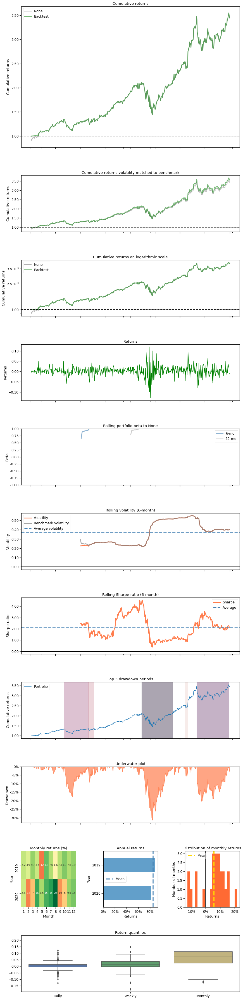

In [ ]:
print("==============Compare to AAPL itself buy-and-hold===========")
%matplotlib inline
BackTestPlot(account_value=df_account_value, 
             baseline_ticker = 'AAPL',
             baseline_start = '2019-01-01',
             baseline_end = '2021-01-01')

<a id='6.3'></a>
## 7.3 Baseline Stats

In [ ]:
print("==============Get Baseline Stats===========")
baesline_perf_stats=BaselineStats('AAPL')

==============Get Baseline Stats===========
[*********************100%***********************]  1 of 1 completed
Shape of DataFrame:  (483, 7)
Annual return          0.800630
Cumulative returns     2.087191
Annual volatility      0.382201
Sharpe ratio           1.735128
Calmar ratio           2.547565
Stability              0.930285
Max drawdown          -0.314273
Omega ratio            1.387241
Sortino ratio          2.572655
Skew                        NaN
Kurtosis                    NaN
Tail ratio             1.081315
Daily value at risk   -0.045521
Alpha                  0.000000
Beta                   1.000000
dtype: float64


In [ ]:
print("==============Get Baseline Stats===========")
baesline_perf_stats=BaselineStats('^GSPC')

==============Get Baseline Stats===========
[*********************100%***********************]  1 of 1 completed
Shape of DataFrame:  (483, 7)
Annual return          0.210804
Cumulative returns     0.442863
Annual volatility      0.264385
Sharpe ratio           0.858377
Calmar ratio           0.621384
Stability              0.467075
Max drawdown          -0.339250
Omega ratio            1.200929
Sortino ratio          1.183069
Skew                        NaN
Kurtosis                    NaN
Tail ratio             0.726400
Daily value at risk   -0.032409
Alpha                  0.000000
Beta                   1.000000
dtype: float64


<a id='6.4'></a>
## 7.4 Compare to Stock Market Index

==============Compare to S&P 500===========
annual return:  98.50882005689301
sharpe ratio:  1.8721562790475017
[*********************100%***********************]  1 of 1 completed
Shape of DataFrame:  (483, 7)


Start date,2019-01-03
End date,2020-11-30
Total months,22
,Backtest
Annual return,80.433%
Cumulative returns,209.212%
Annual volatility,37.022%
Sharpe ratio,1.78
Calmar ratio,2.56
Stability,0.93
Max drawdown,-31.422%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,31.42,2020-02-12,2020-03-23,2020-06-05,83
1,20.37,2020-09-01,2020-09-18,NaT,NaN
2,17.84,2019-05-03,2019-06-03,2019-07-31,64
3,9.24,2019-07-31,2019-08-05,2019-08-21,16
4,5.84,2020-07-20,2020-07-24,2020-07-31,10


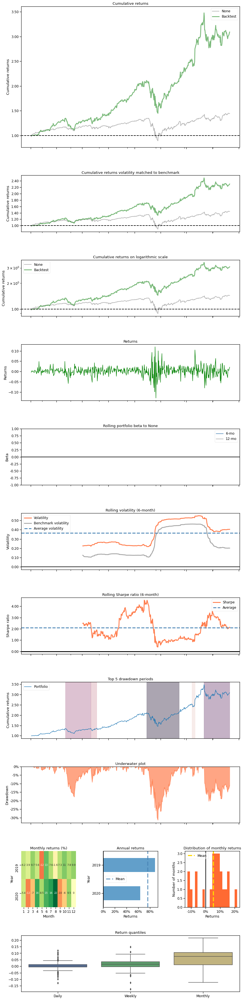

In [ ]:
print("==============Compare to S&P 500===========")
%matplotlib inline
# S&P 500: ^GSPC
# Dow Jones Index: ^DJI
# NASDAQ 100: ^NDX
BackTestPlot(df_account_value, baseline_ticker = '^GSPC')